# Generative Adversarial Networks using PyTorch

Here, we implement a basic GAN model using PyTorch to generate handwritten digits.
***

## Import PyTorch packages

Ensure that you have the packages installed on your machine.  
If not, please install the following packages by running: `pip install [PACKAGE]` in your terminal, where [PACKAGE] are:  
torchvision, tensorboardx, jupyter, matplotlib, numpy 

In [11]:
# install packages on your laptop
# run in the terminal (mac): pip install torchvision tensorboardx jupyter matplotlib numpy

# import packages
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
import torchvision.transforms.functional as F

# record your training precess
from utils import Logger

# python packages
import numpy as np
import matplotlib.pyplot as plt

## Get dataset and perform ETL

1. Get MNIST dataset (handwritten digits) from PyTorch datasets
2. Transform the datasets into tensors and normalize them in range[-1,1]
3. Store them in a local directory './MNIST_dataset'
4. Load the dataset into a PyTorch DataLoader
    - define the batch size as 100 (train on 100 records and labels before making one model iteration)
    - set shuffle as True (shuffle the data for training and test split)
    - format it as a DataLoader to facilitate feeding of input and labels into the model

In [6]:
# get the mnist data
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5, .5, .5), (.5, .5, .5))
        ])
    out_dir = './MNIST_dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

Processing...
Done!


## Visualize example data records
Plot 5 examples of handwritten digits and their corresponding labels.

In [47]:
def plottensor(tensor,label):
    fig, ax = plt.subplots(figsize=(2, 2))
    img = F.to_pil_image(tensor)
    ax.imshow(np.asarray(img))
    ax.set_title(label)
    plt.show()

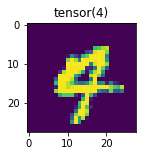

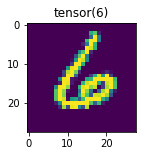

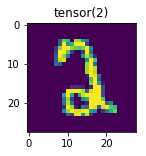

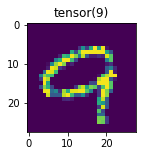

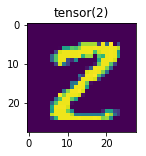

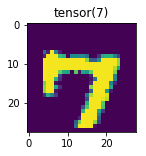

In [49]:
for batch_idx, (tensors, labels) in enumerate(data_loader):
    stop = 5
    for record_idx, tensor in enumerate(tensors):
        label = str(labels[record_idx])
        plottensor(tensor,label)
        if record_idx ==  stop:
            break
    break

## Define Tensor re-shaping functions
These functions will re-shape tensors between 2 forms:
1. flattened vector of shape 784 (1D-tensor for input into model)
2. square matrix of shape 1x28x28 (single channel / greyscale 28x28 pixels image)

In [50]:
# convert a flattened image into its 2-dimensional representation, 
# and another one that does the opposite.
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

## Discriminator Network

We will construct the discriminator network using PyTorch's neural network module (torch.nn.Module)

The Discriminator will be a 3 hidden layers multi-layer perceptron with the following structure:
        
### Hidden Layer 1 - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (784,) - 28x28 image flattened into a vector
        - Output: 1D-tensor (1084,)
        - Activation Function: Leaky ReLU
        - Regularization: Dropout

### Hidden Layer 2 - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (1084,)
        - Output: 1D-tensor (512,)
        - Activation Function: Leaky ReLU
        - Regularization: Dropout

### Hidden Layer 3 - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (512)
        - Output: 1D-tensor (256)
        - Activation Function: Leaky ReLU
        - Regularization: Dropout

### Output Layer - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (256)
        - Output: 1D-tensor (1) - output indicating probability of image being Real or Fake
        - Activation Function: Sigmoid - squash into a Binary Variable 0 or 1

In [51]:
# build 3 hidden layer nn for discriminator
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

## Generator Network

We will construct the generator network using PyTorch's neural network module (torch.nn.Module)

The Generator will be a 3 hidden layers multi-layers perceptron with the following structure:
        
### Hidden Layer 1 - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (100,) - noise vector
        - Output: 1D-tensor (256,)
        - Activation Function: Leaky ReLU

### Hidden Layer 2 - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (256,)
        - Output: 1D-tensor (512,)
        - Activation Function: Leaky ReLU

### Hidden Layer 3 - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (512,)
        - Output: 1D-tensor (1024)
        - Activation Function: Leaky ReLU

### Output Layer - Fully Connected: linear NN with W and b
        - Input: 1D-tensor (1024,)
        - Output: 1D-tensor (784,) - 28x28 image flattened into a vector
        - Activation Function: TanH - to ensure value range of each pixel is [-1,1]

In [52]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x


## Define noise-generating function
This function will generate a 1D-tensor of shape (100,) randomly sampled from a gaussian distribution.  
The noise vector will be used as input for the Generator.

In [53]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

## Load models, define optimizer and loss functions

1. We will load our models by creating an object from the DiscriminatorNet and GeneratorNet classes we have defined before.
2. We select the Adam optimizer as our optimization algorithm for both deep learning models.
3. We select the Binary Cross Entropy as our loss function.

In [54]:
# load your model
discriminator = DiscriminatorNet()
generator = GeneratorNet()

# set loss function
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)
loss = nn.BCELoss()

## Define functions for ground-truth labels
Here we will define two functions for generating a vector of either all 1s or all 0s.  
They will be used as the groud-truth labels for the discriminator.  
Real images will be labled as 1s and fake images as 0s

In [55]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

## Training the Discriminator

To train the discriminator, we will go through the following steps:

1. Reset gradients (necessary to reset the gradient at each iteration as PyTorch accumulates the gradient)
2. Train the discriminator on real data
    - Make a prediction on the probability of samples being real data
    - calculate the loss from 100 samples of real data
    - compute the gradients by backpropagation using the backward() function
3. Train the discriminator on fake data
    - Make a prediction on the probability of samples being real data
    - calculate the loss from 100 samples of fake data
    - compute the gradients by backpropagation using the backward() function
4. Update the weights of Discriminator using the gradients from the 2 previous steps and the optimizer
5. Return the loss, predictions for logging purposes

In [56]:
# train discriminator
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

## Training the Generator

To train the discriminator, we will go through the following steps:

1. Reset gradients (necessary to reset the gradient at each iteration as PyTorch accumulates the gradient)
2. Sample noise vectors and generate fake images using the Generator
3. Use the Discriminator to a prediction on the probability of samples being real data
    - calculate the loss from 100 samples of fake data
    - compute the gradients by backpropagation using the backward() function
4. Update the weights of Generator using the gradients from the 2 previous steps and the optimizer
5. Return the loss for logging purposes

In [57]:
# train generator
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

# Logger, samples and epoch

Here we will define 3 things:
1. The number of generated image samples that the script will spit out after every batch of training, so we can keep track of the progress.
2. The logger instance that will print out the training progress as well as the loss and prediction accuracy of the Generator and Discriminator.
3. The number of Epochs (the number of complete forward and backward pass of all the training examples).

In [58]:
num_test_samples = 16
test_noise = noise(num_test_samples)

# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200

## Main block of code to train GAN

For each epoch of 200 epochs:
    For each batch of 100 examples in the training dataset:
        1. Train the Discriminator
            a. Transform the batch of 100 examples into a 1D-tensors of shape (784,)
            b. Detach the Generator so the gradients are not calculated for the Generator
            c. Train the Discriminator first using a combination of real and fake data
        2. Train the Generator
            a. Generate a batch of 100 fake examples by inputting the noise vectors into the Generator
            b. Train the Generator using the fake data on the Discriminator
        3. For every 100 batches of training, print the following:
            a. Current epoch number, batch number
            b. Discriminator and Generator loss
            c. Prediction of Discriminator on real and fake examples (between [0,1])

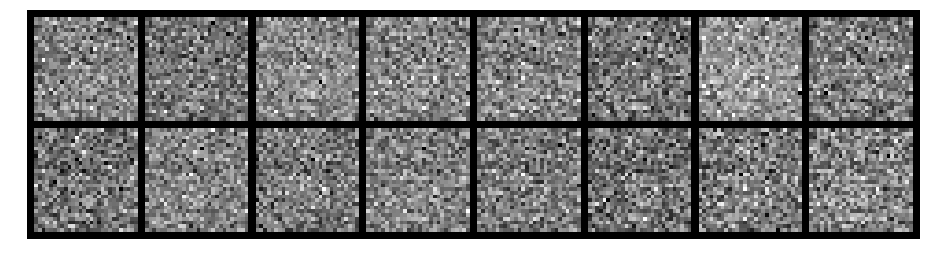

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3650, Generator Loss: 0.6886
D(x): 0.5134, D(G(z)): 0.5024


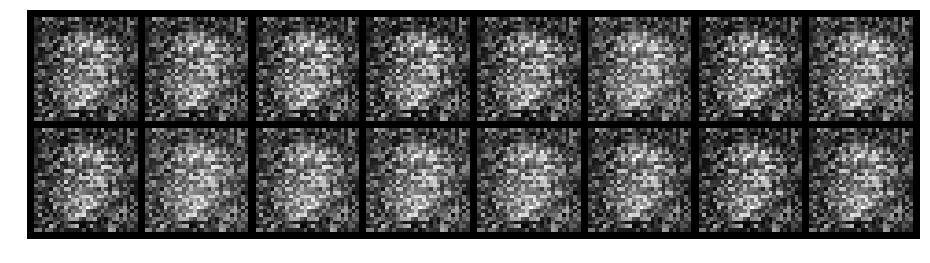

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.6922, Generator Loss: 1.1378
D(x): 0.6500, D(G(z)): 0.6103


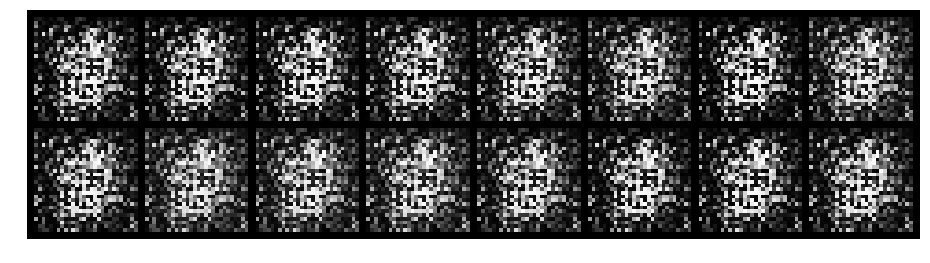

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.4514, Generator Loss: 2.6990
D(x): 0.9118, D(G(z)): 0.2593


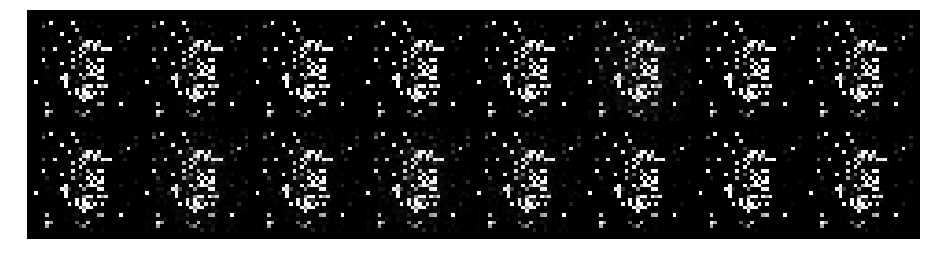

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0537, Generator Loss: 6.6428
D(x): 0.9895, D(G(z)): 0.0399


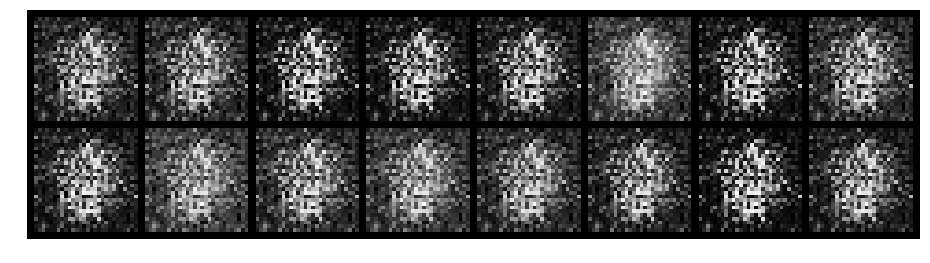

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 3.3515, Generator Loss: 2.5289
D(x): 0.5871, D(G(z)): 0.8309


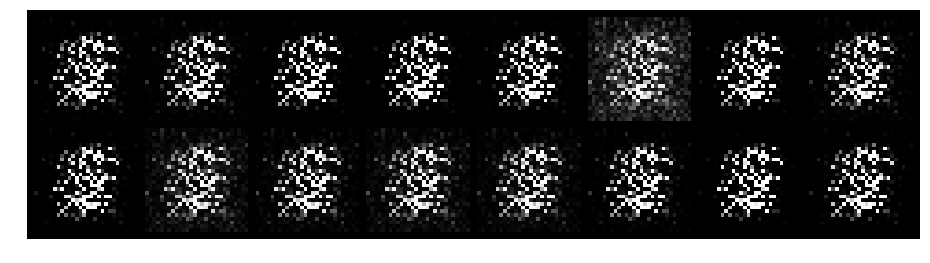

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.2778, Generator Loss: 4.2808
D(x): 0.8967, D(G(z)): 0.1092


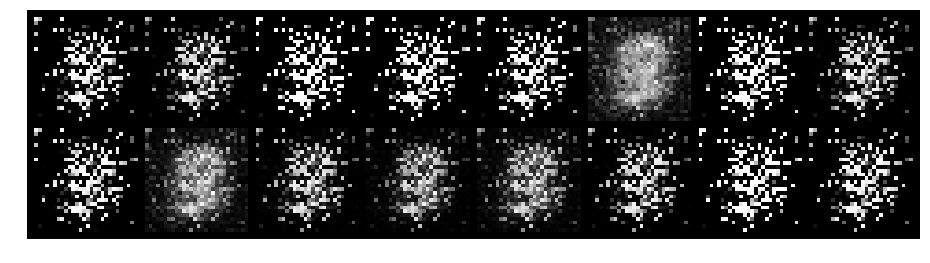

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.7356, Generator Loss: 8.7662
D(x): 0.8764, D(G(z)): 0.2693


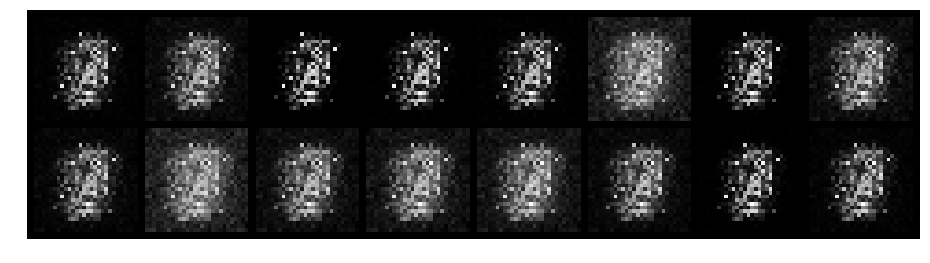

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.5527, Generator Loss: 1.3334
D(x): 0.5810, D(G(z)): 0.5241


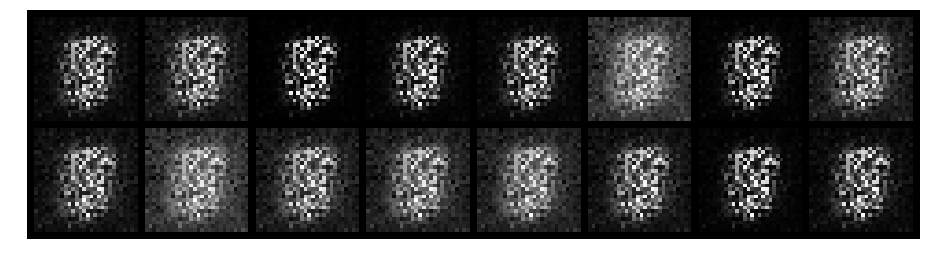

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.8938, Generator Loss: 2.0439
D(x): 0.7069, D(G(z)): 0.3056


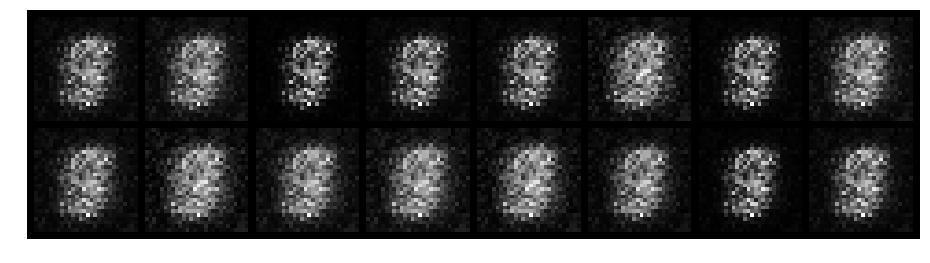

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.1749, Generator Loss: 1.6655
D(x): 0.5796, D(G(z)): 0.3296


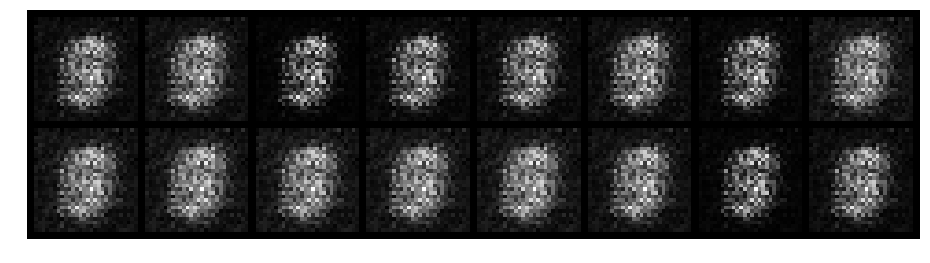

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.6147, Generator Loss: 0.6570
D(x): 0.5486, D(G(z)): 0.5892


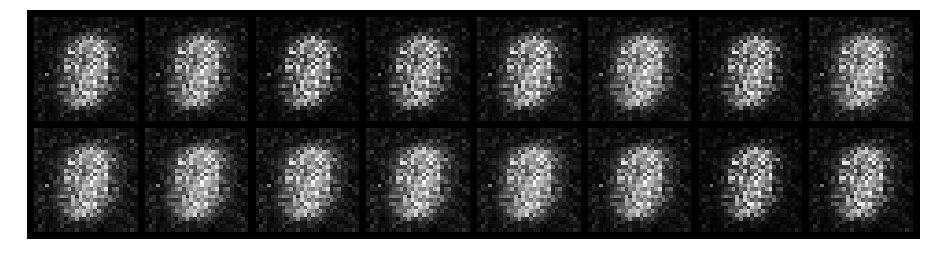

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.7961, Generator Loss: 1.9638
D(x): 0.8236, D(G(z)): 0.3801


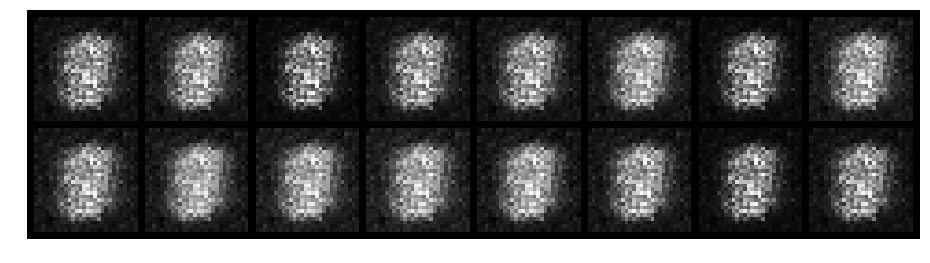

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.7062, Generator Loss: 1.7227
D(x): 0.7504, D(G(z)): 0.2878


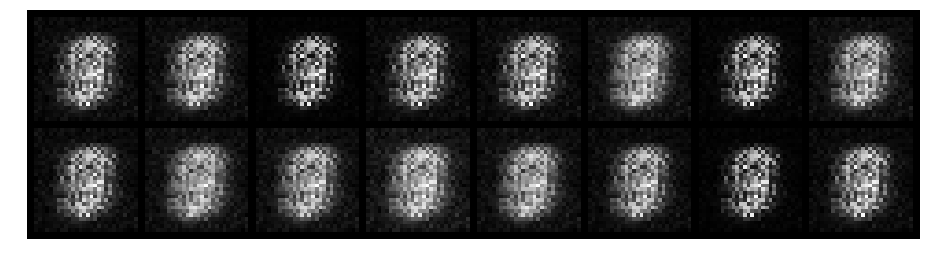

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.3659, Generator Loss: 2.9193
D(x): 0.8885, D(G(z)): 0.1467


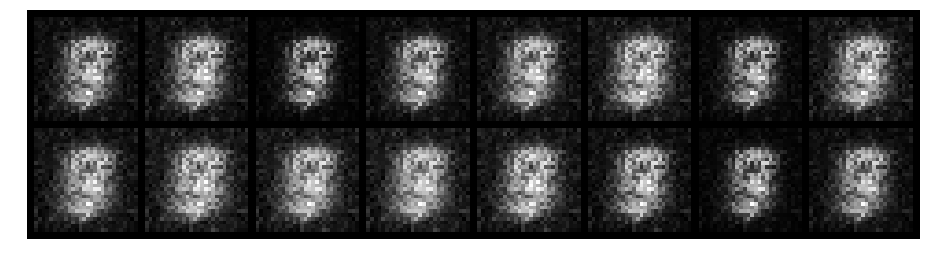

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.4055, Generator Loss: 4.0609
D(x): 0.8493, D(G(z)): 0.1233


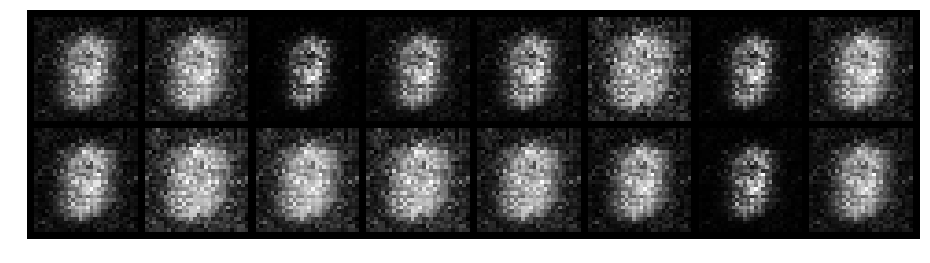

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.2357, Generator Loss: 3.9002
D(x): 0.9565, D(G(z)): 0.1495


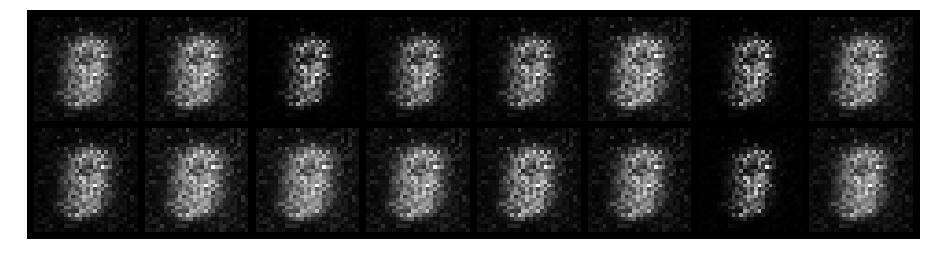

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.5793, Generator Loss: 3.3953
D(x): 0.9640, D(G(z)): 0.3255


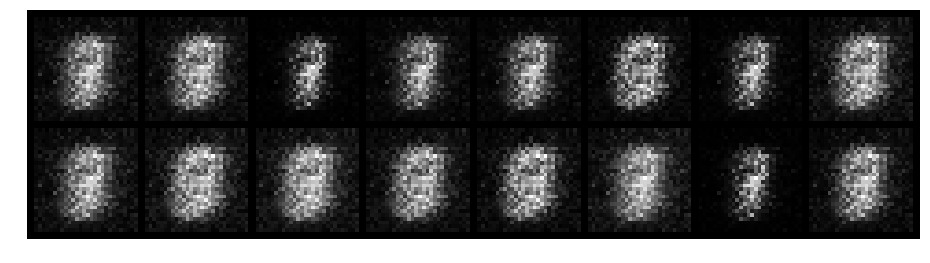

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.5102, Generator Loss: 2.6073
D(x): 0.8226, D(G(z)): 0.1346


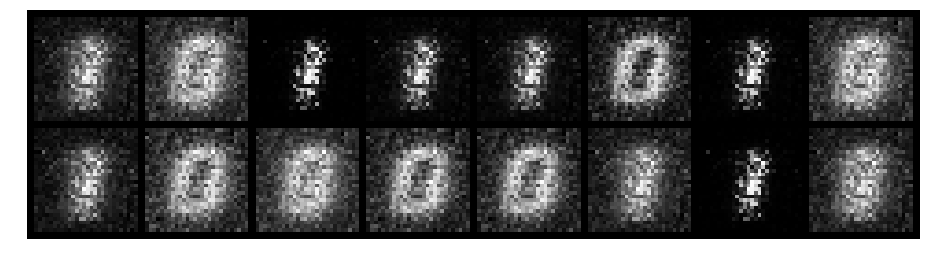

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.2755, Generator Loss: 3.6036
D(x): 0.8858, D(G(z)): 0.0694


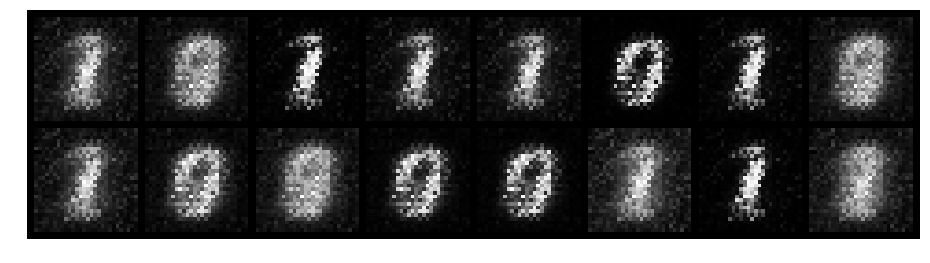

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.2808, Generator Loss: 3.5973
D(x): 0.9417, D(G(z)): 0.1353


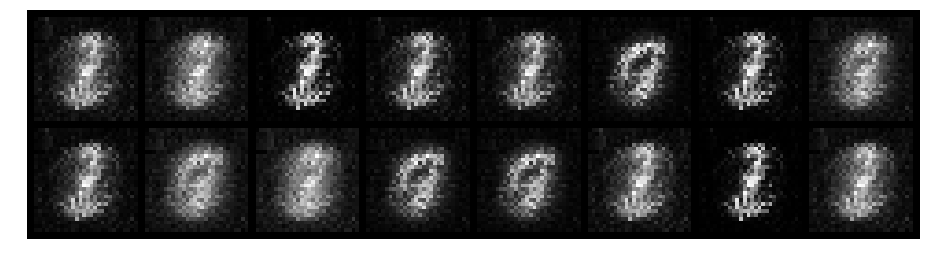

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.6705, Generator Loss: 3.0462
D(x): 0.9351, D(G(z)): 0.3059


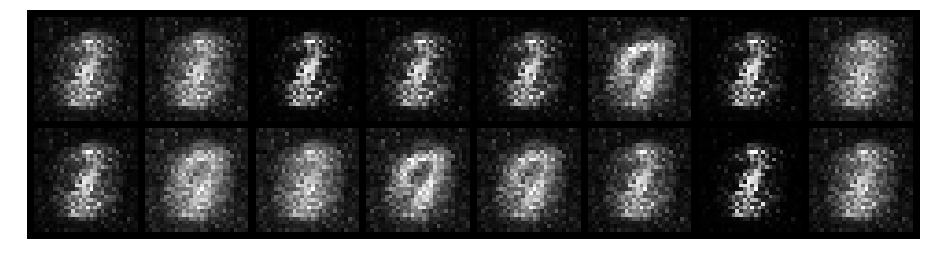

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.1941, Generator Loss: 3.4257
D(x): 0.9678, D(G(z)): 0.1265


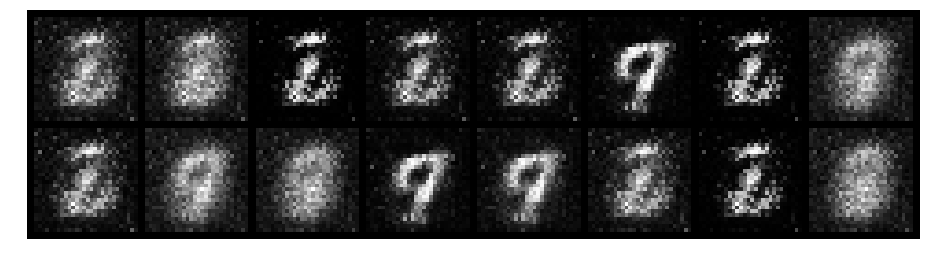

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.1841, Generator Loss: 4.1394
D(x): 0.9532, D(G(z)): 0.0709


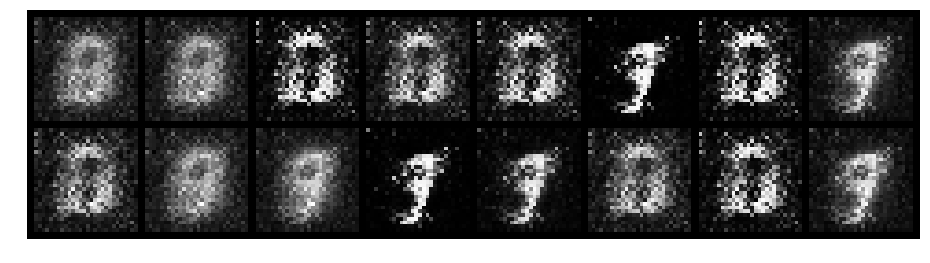

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.2681, Generator Loss: 5.6318
D(x): 0.8911, D(G(z)): 0.0580


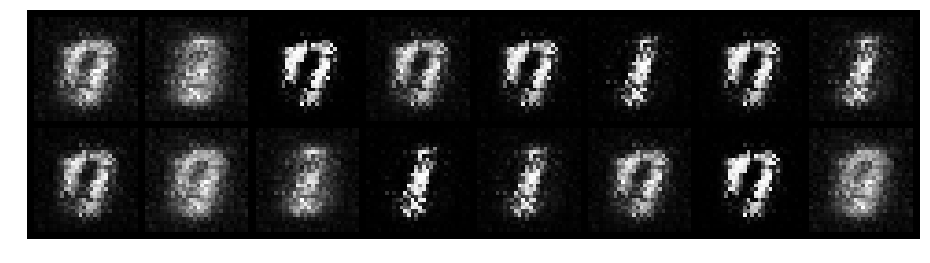

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.6668, Generator Loss: 2.8314
D(x): 0.7999, D(G(z)): 0.1053


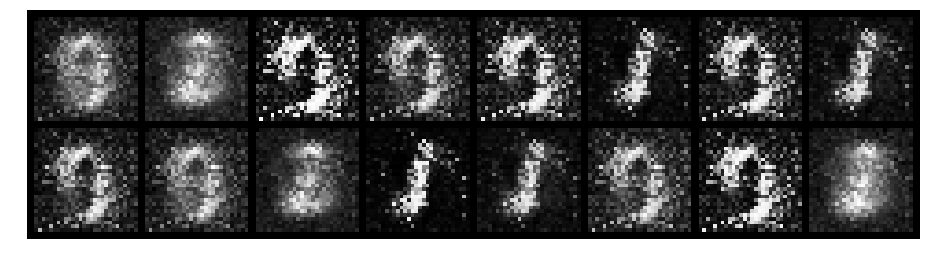

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.3455, Generator Loss: 3.1654
D(x): 0.9472, D(G(z)): 0.1878


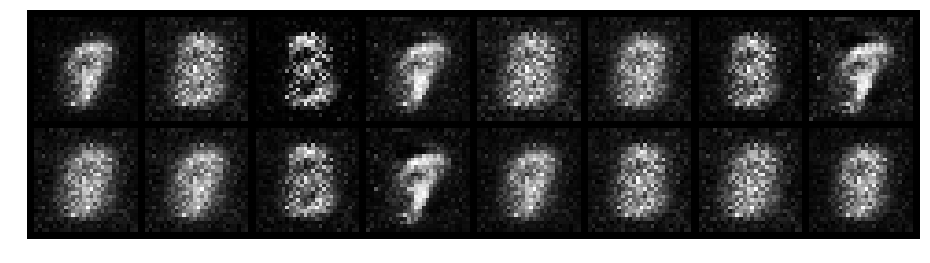

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.2407, Generator Loss: 2.8976
D(x): 0.9516, D(G(z)): 0.0995


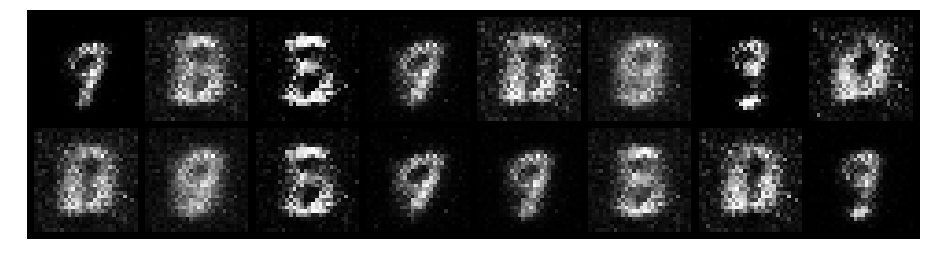

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.3478, Generator Loss: 4.2425
D(x): 0.8739, D(G(z)): 0.0722


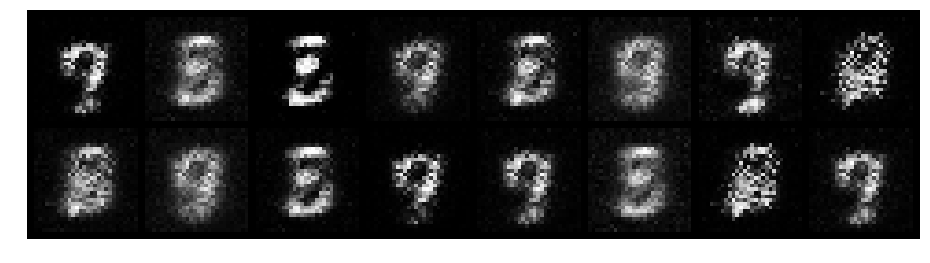

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.5644, Generator Loss: 3.6147
D(x): 0.7983, D(G(z)): 0.0973


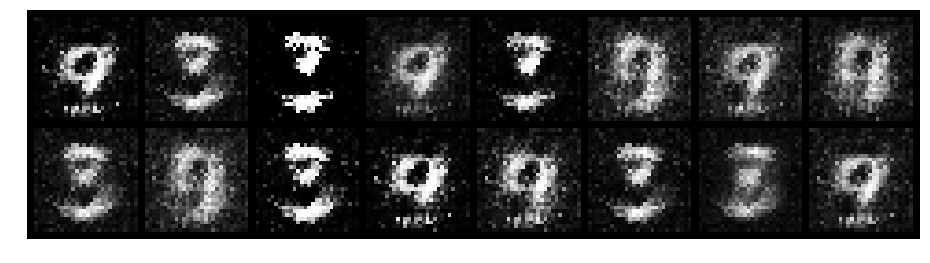

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.2335, Generator Loss: 4.5974
D(x): 0.9258, D(G(z)): 0.0957


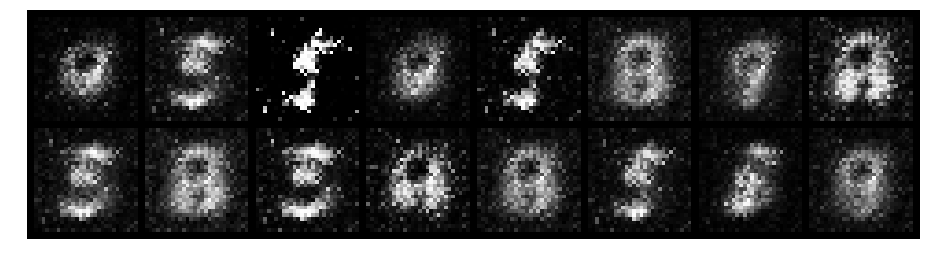

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.1693, Generator Loss: 3.4795
D(x): 0.9437, D(G(z)): 0.0841


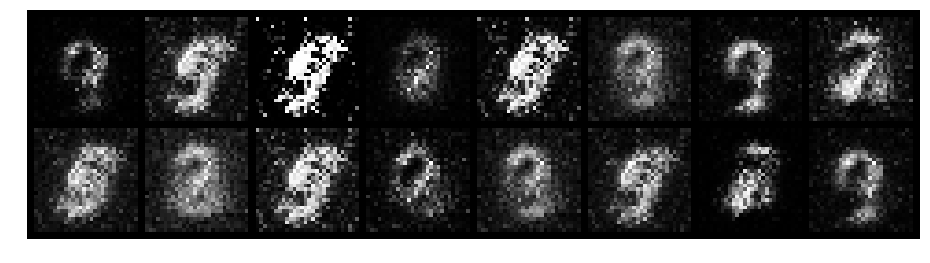

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.4165, Generator Loss: 4.5518
D(x): 0.8758, D(G(z)): 0.1300


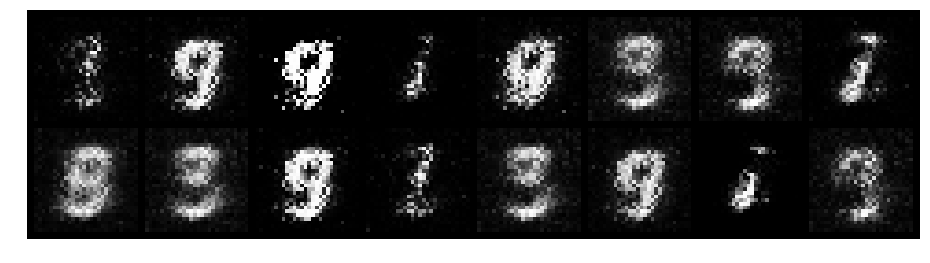

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.2625, Generator Loss: 3.9282
D(x): 0.9126, D(G(z)): 0.0977


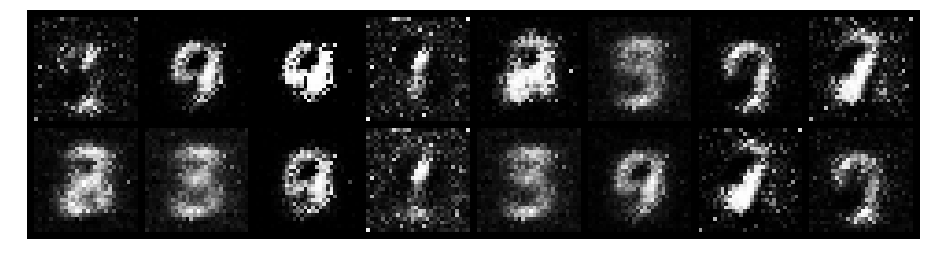

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.4230, Generator Loss: 3.4876
D(x): 0.9112, D(G(z)): 0.1399


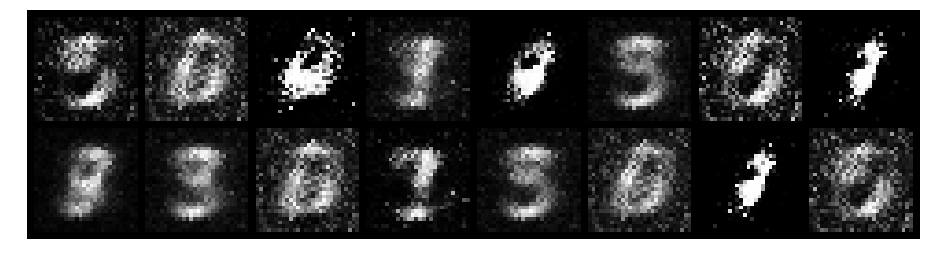

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.7773, Generator Loss: 2.3281
D(x): 0.6992, D(G(z)): 0.1727


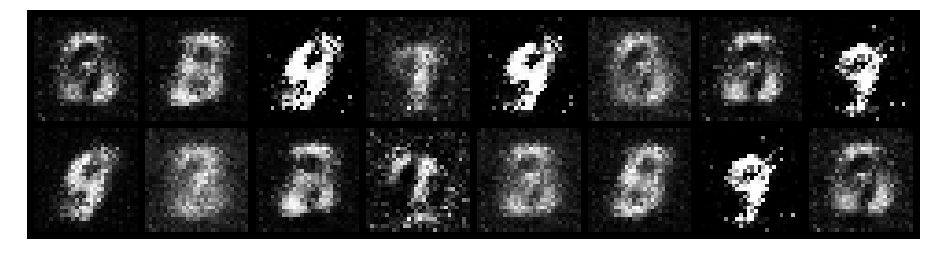

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.7046, Generator Loss: 2.6435
D(x): 0.7869, D(G(z)): 0.1601


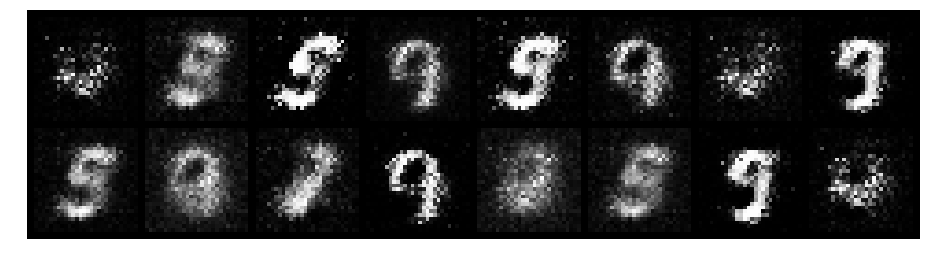

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.6284, Generator Loss: 2.4077
D(x): 0.7765, D(G(z)): 0.1456


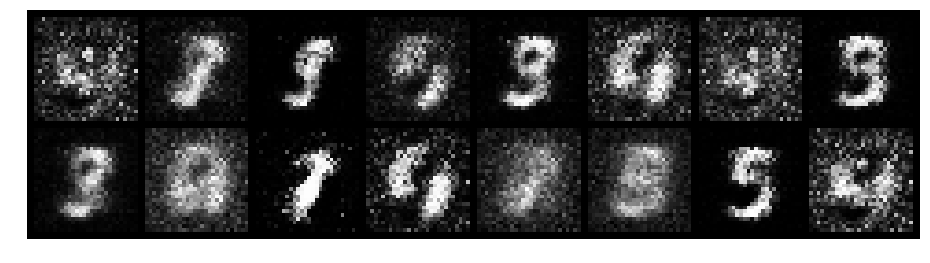

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.1823, Generator Loss: 3.5381
D(x): 0.9499, D(G(z)): 0.0952


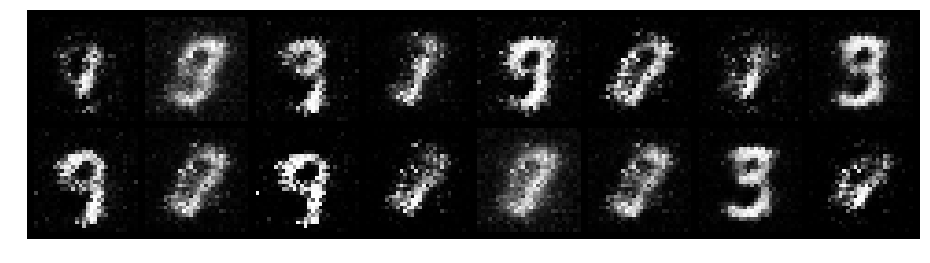

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.6371, Generator Loss: 2.2598
D(x): 0.8090, D(G(z)): 0.1289


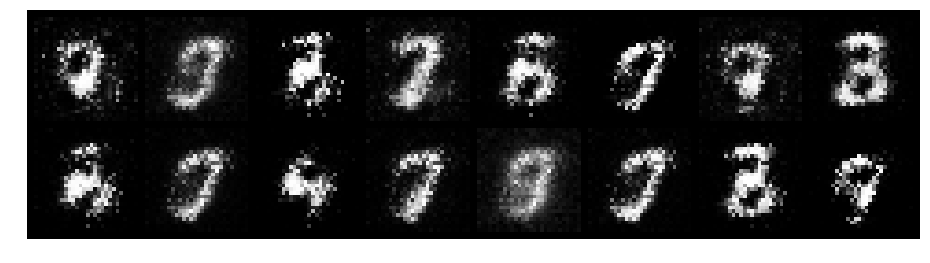

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.4402, Generator Loss: 4.0496
D(x): 0.8178, D(G(z)): 0.0458


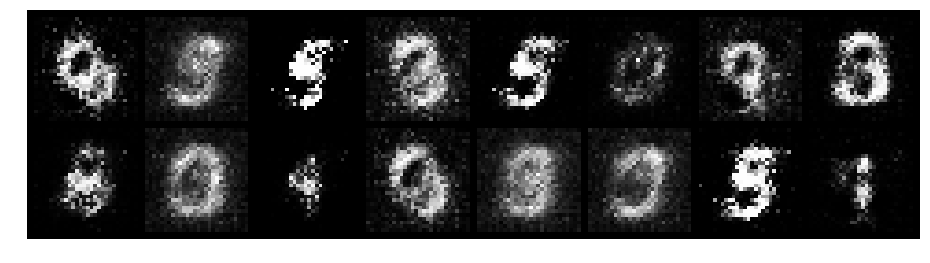

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.5991, Generator Loss: 2.5665
D(x): 0.8742, D(G(z)): 0.2646


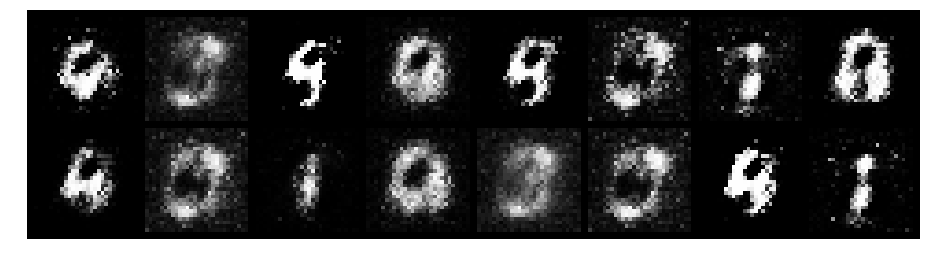

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5159, Generator Loss: 3.2182
D(x): 0.8736, D(G(z)): 0.1513


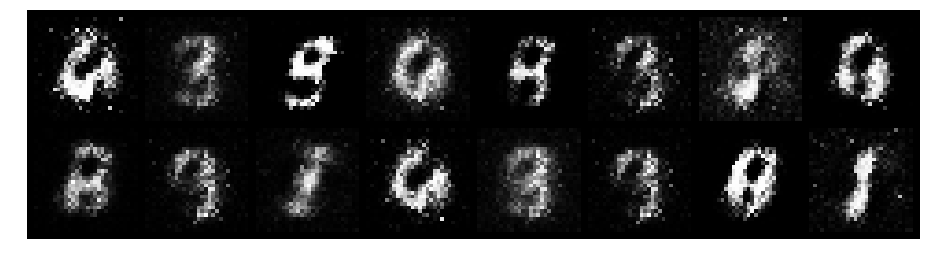

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.6613, Generator Loss: 3.6546
D(x): 0.7532, D(G(z)): 0.0783


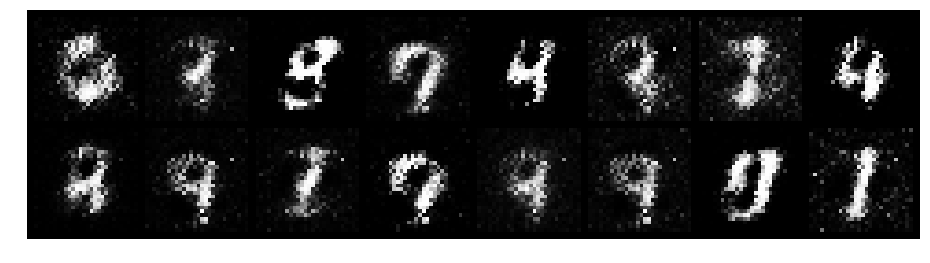

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.3978, Generator Loss: 2.9748
D(x): 0.8412, D(G(z)): 0.0887


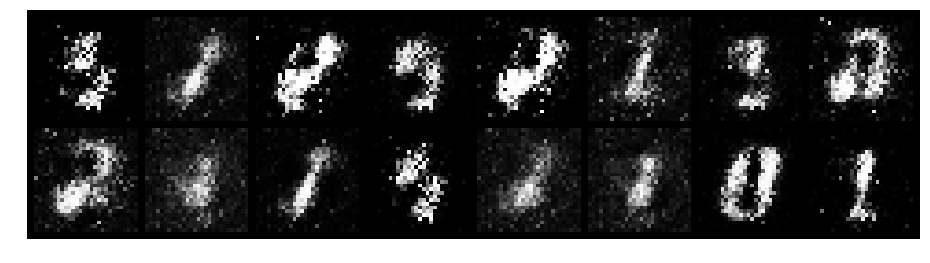

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.4635, Generator Loss: 2.9651
D(x): 0.8211, D(G(z)): 0.1155


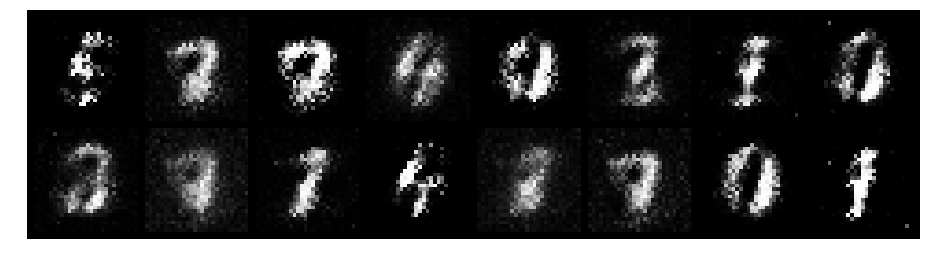

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.2299, Generator Loss: 3.5201
D(x): 0.9236, D(G(z)): 0.0817


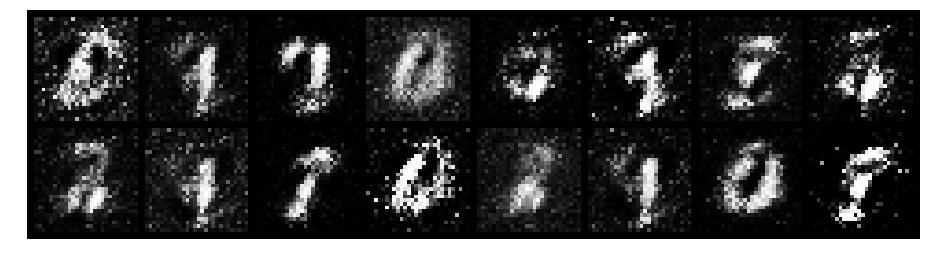

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.5844, Generator Loss: 3.3014
D(x): 0.8038, D(G(z)): 0.1382


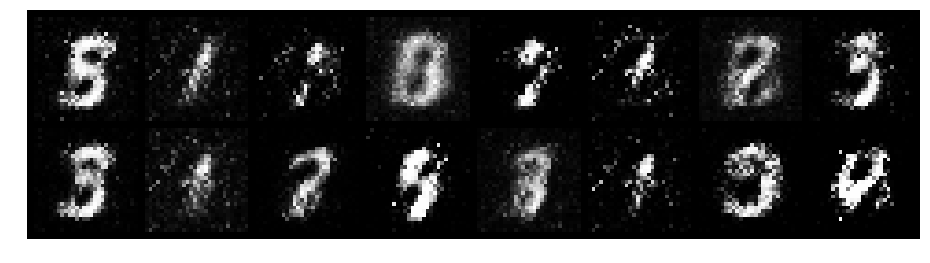

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.6076, Generator Loss: 3.7814
D(x): 0.8050, D(G(z)): 0.1617


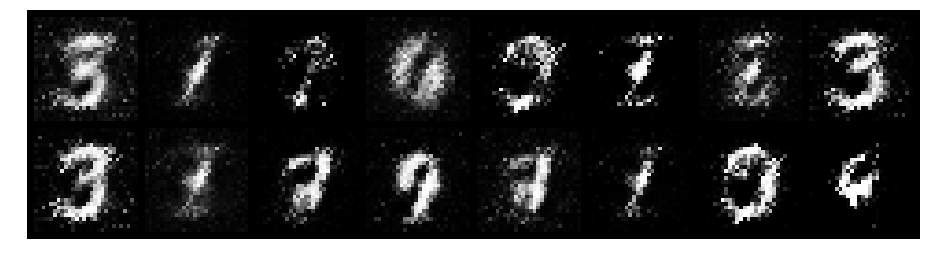

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4593, Generator Loss: 3.4076
D(x): 0.8243, D(G(z)): 0.0921


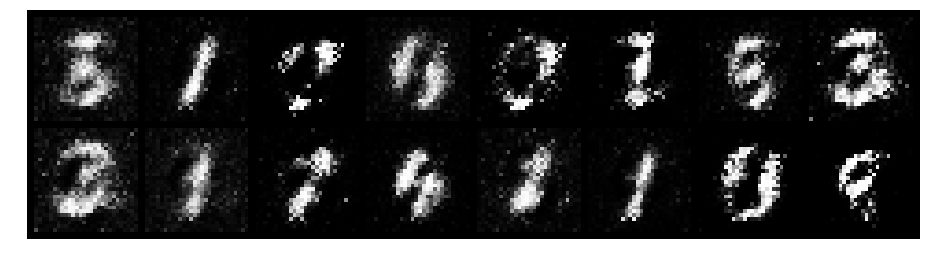

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5003, Generator Loss: 2.6474
D(x): 0.8829, D(G(z)): 0.1828


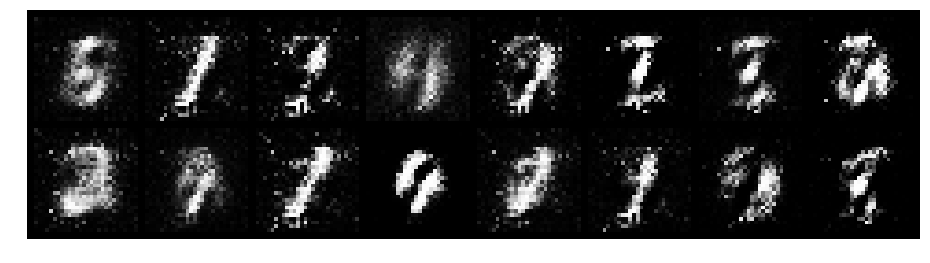

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.6029, Generator Loss: 2.3509
D(x): 0.8325, D(G(z)): 0.2070


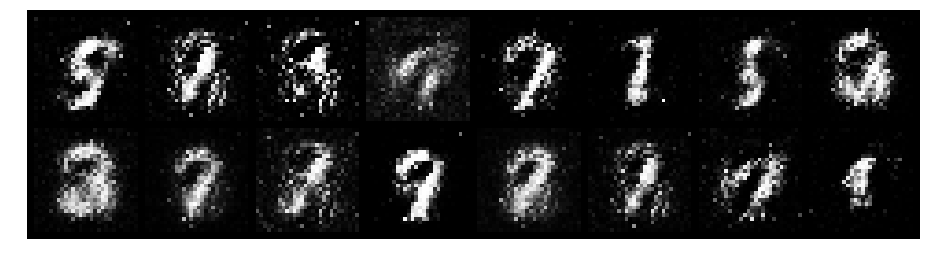

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.8539, Generator Loss: 2.0565
D(x): 0.7707, D(G(z)): 0.2844


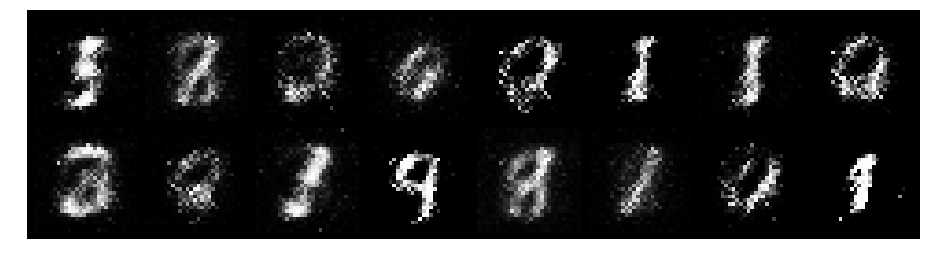

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.3964, Generator Loss: 2.9063
D(x): 0.8490, D(G(z)): 0.1040


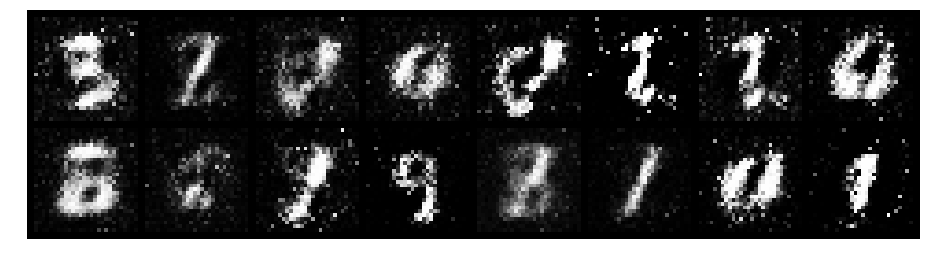

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5122, Generator Loss: 2.5406
D(x): 0.8044, D(G(z)): 0.1515


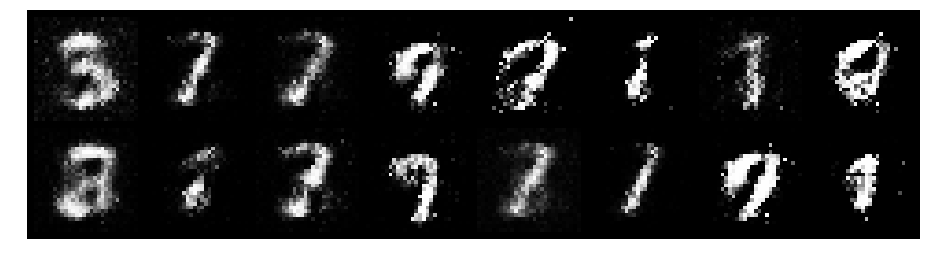

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.4625, Generator Loss: 2.8040
D(x): 0.8540, D(G(z)): 0.1658


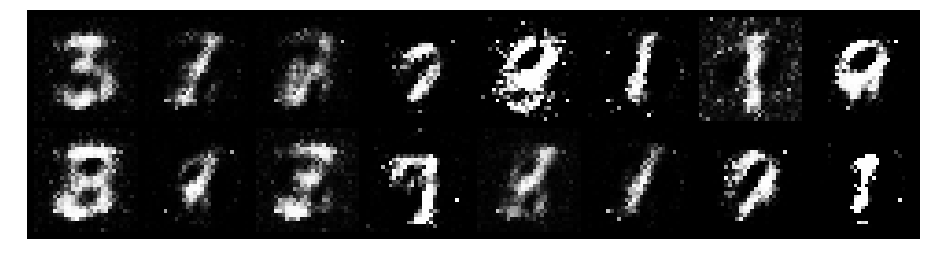

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.9419, Generator Loss: 2.9357
D(x): 0.7210, D(G(z)): 0.1940


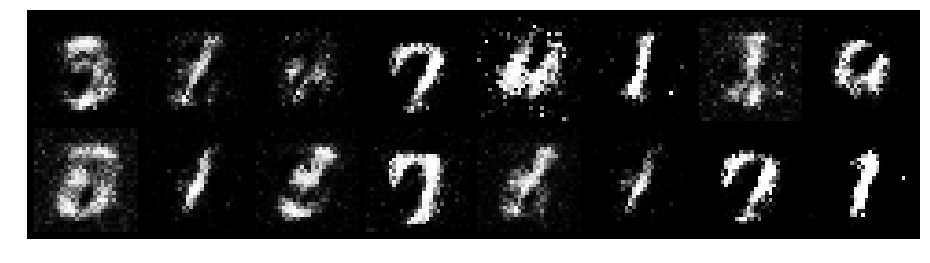

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.6492, Generator Loss: 2.5658
D(x): 0.8216, D(G(z)): 0.1866


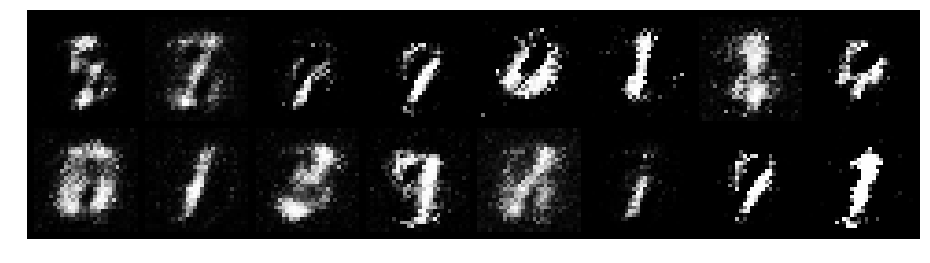

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.5526, Generator Loss: 2.8507
D(x): 0.8419, D(G(z)): 0.2081


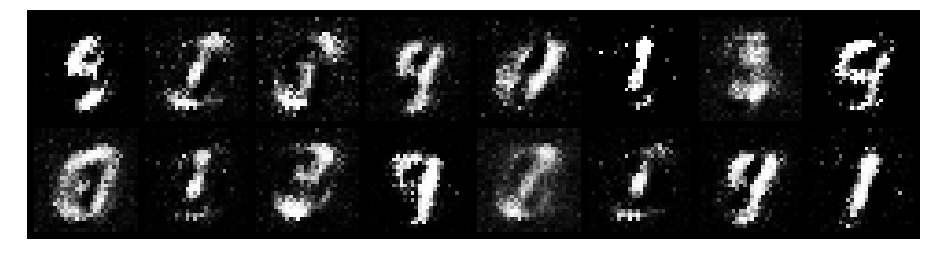

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.6634, Generator Loss: 2.1959
D(x): 0.7764, D(G(z)): 0.2032


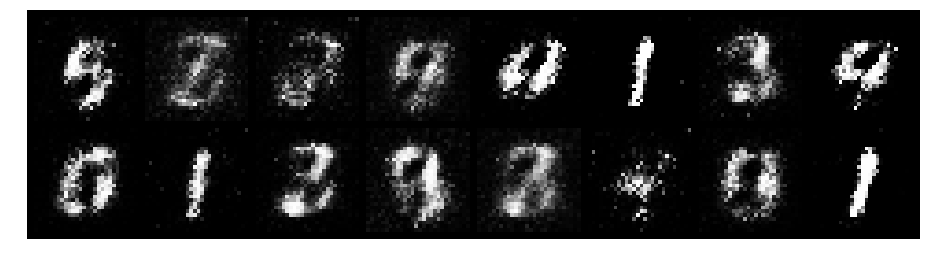

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.5534, Generator Loss: 2.1591
D(x): 0.8004, D(G(z)): 0.1390


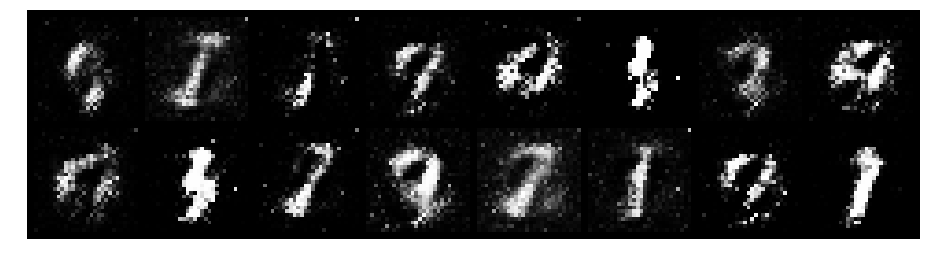

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.7567, Generator Loss: 2.1090
D(x): 0.6909, D(G(z)): 0.1620


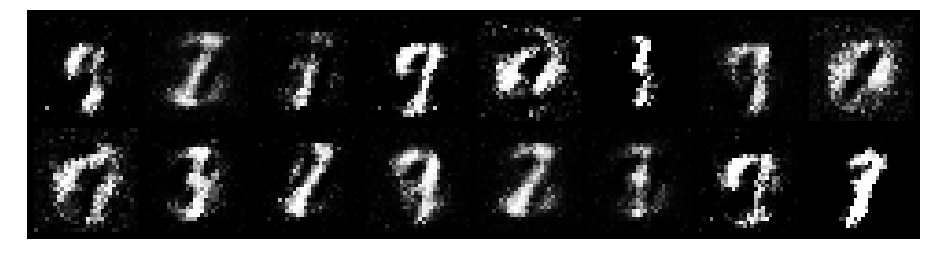

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.7904, Generator Loss: 2.8951
D(x): 0.7499, D(G(z)): 0.1888


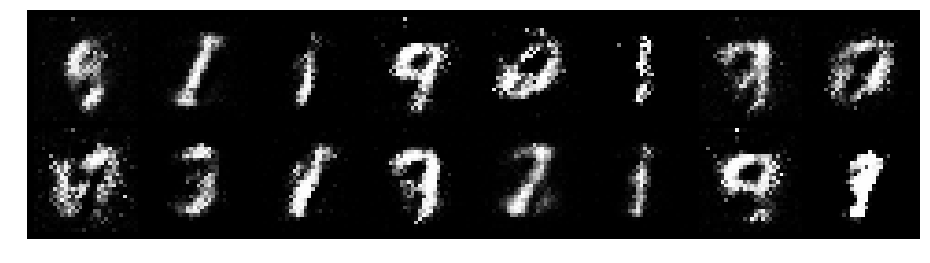

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7380, Generator Loss: 2.2217
D(x): 0.8211, D(G(z)): 0.2572


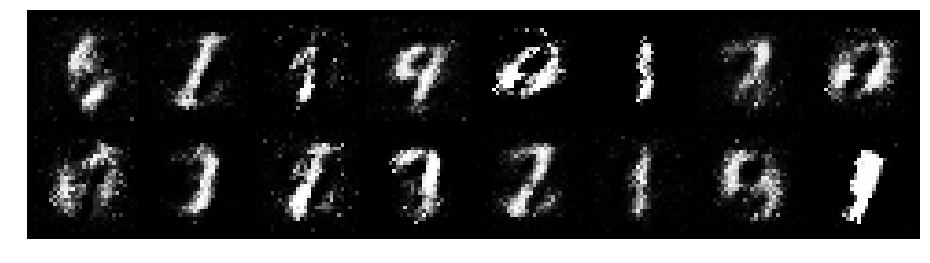

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5067, Generator Loss: 2.6234
D(x): 0.8329, D(G(z)): 0.1471


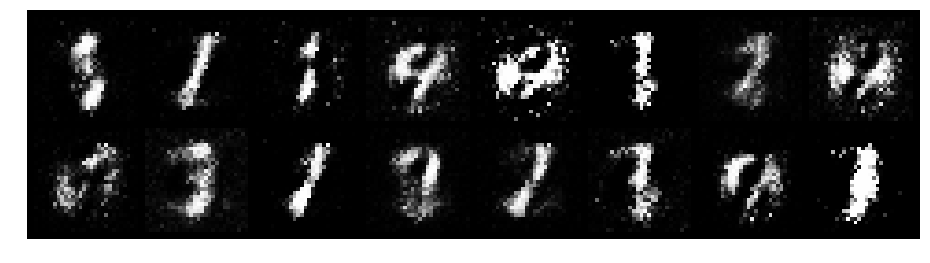

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.3640, Generator Loss: 3.7087
D(x): 0.9139, D(G(z)): 0.1613


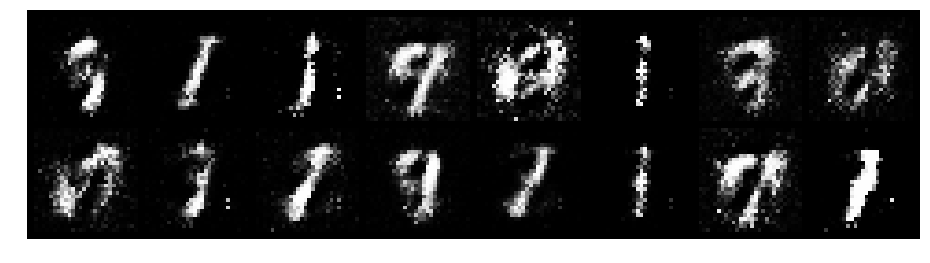

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.5076, Generator Loss: 2.6126
D(x): 0.8558, D(G(z)): 0.1798


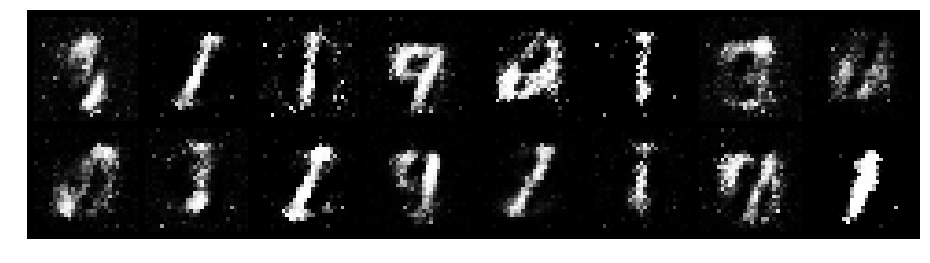

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.4701, Generator Loss: 2.2678
D(x): 0.8770, D(G(z)): 0.1900


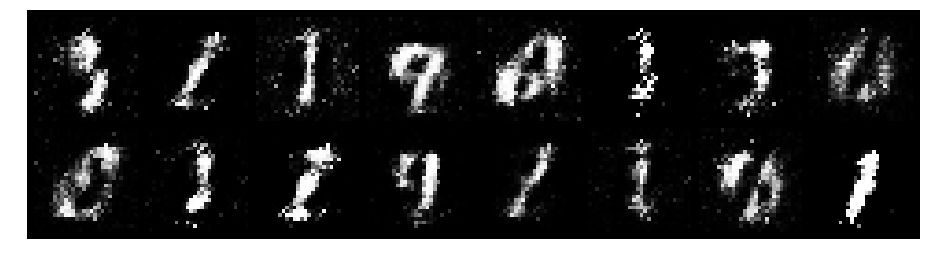

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.5720, Generator Loss: 2.4748
D(x): 0.8100, D(G(z)): 0.1744


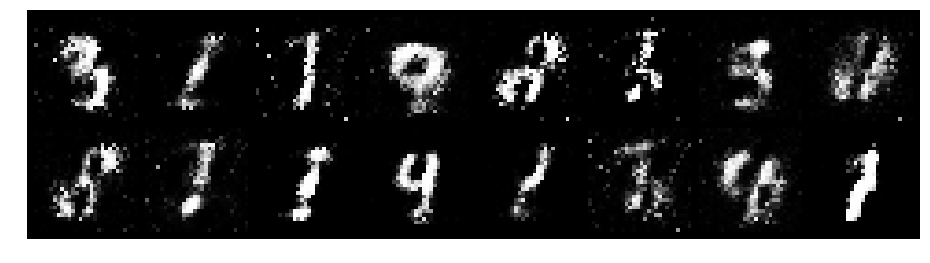

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8204, Generator Loss: 2.2535
D(x): 0.7597, D(G(z)): 0.2422


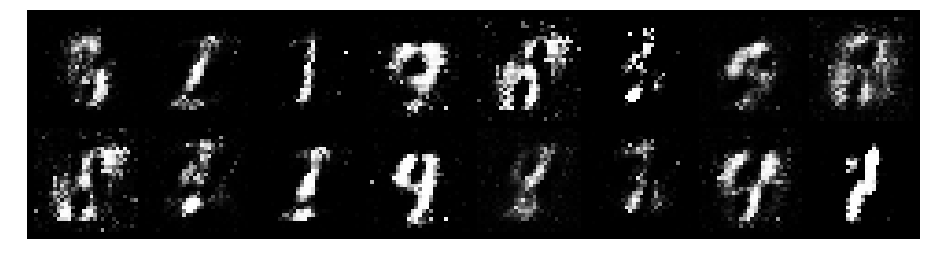

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.5448, Generator Loss: 3.2847
D(x): 0.7788, D(G(z)): 0.0968


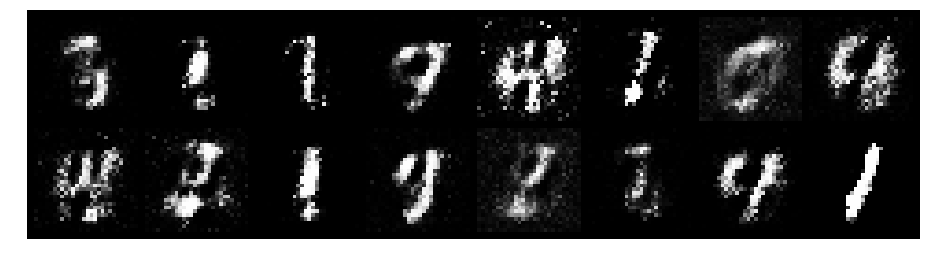

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.5838, Generator Loss: 2.2116
D(x): 0.7802, D(G(z)): 0.1558


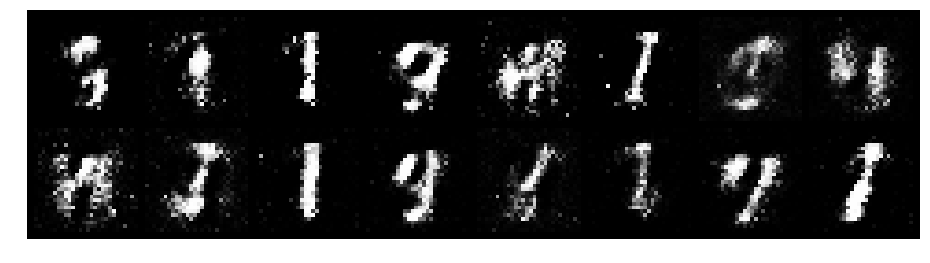

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.5608, Generator Loss: 2.5903
D(x): 0.8065, D(G(z)): 0.1559


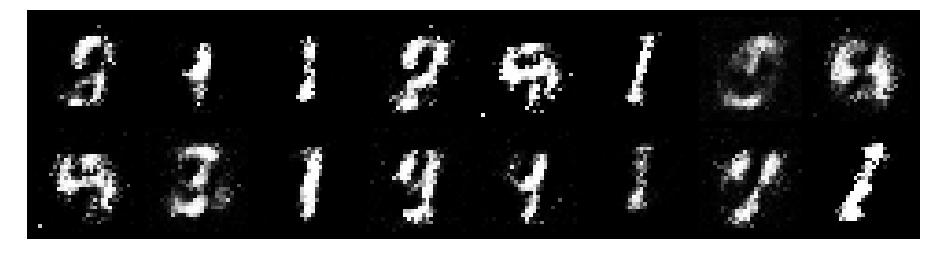

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.5936, Generator Loss: 2.8999
D(x): 0.8289, D(G(z)): 0.1931


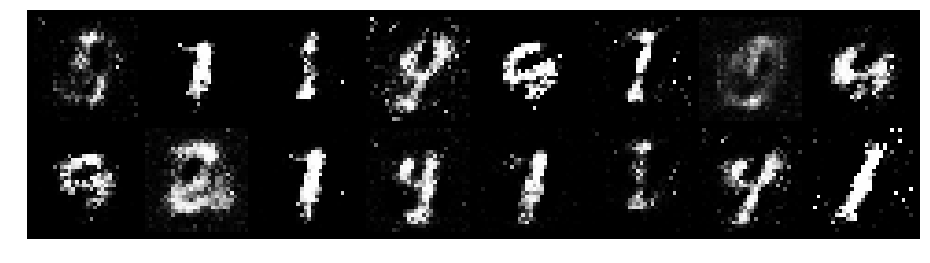

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.4067, Generator Loss: 2.6599
D(x): 0.8508, D(G(z)): 0.1213


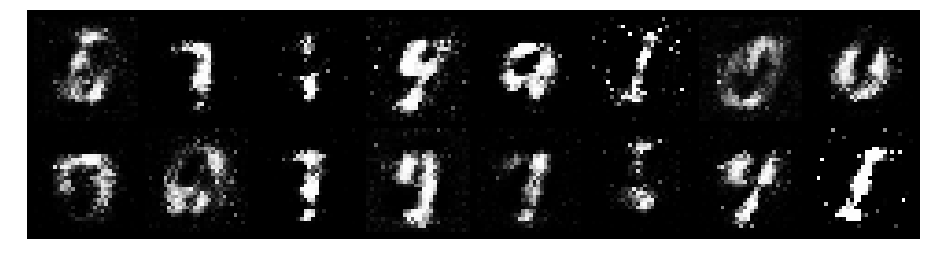

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.8947, Generator Loss: 2.5643
D(x): 0.7704, D(G(z)): 0.3027


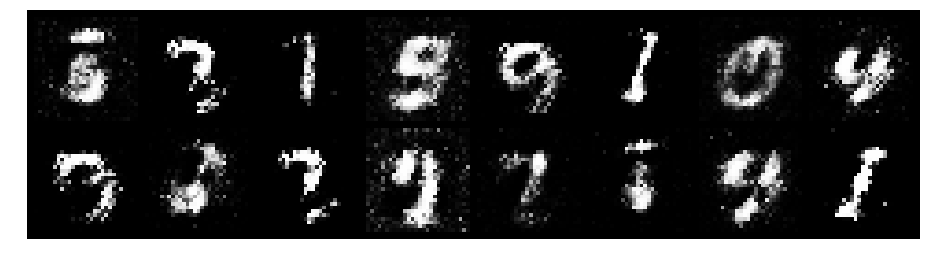

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.5823, Generator Loss: 2.9561
D(x): 0.7822, D(G(z)): 0.1395


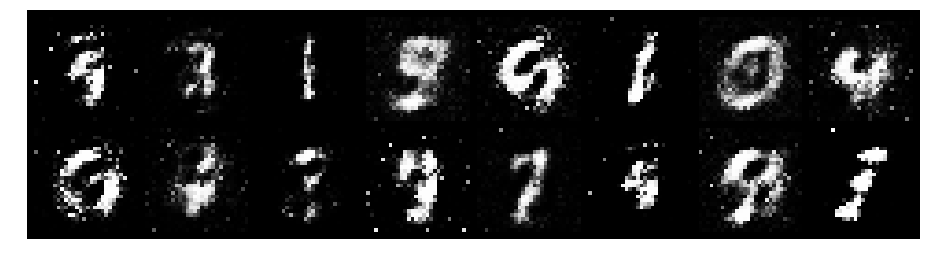

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.6592, Generator Loss: 2.5105
D(x): 0.7199, D(G(z)): 0.1415


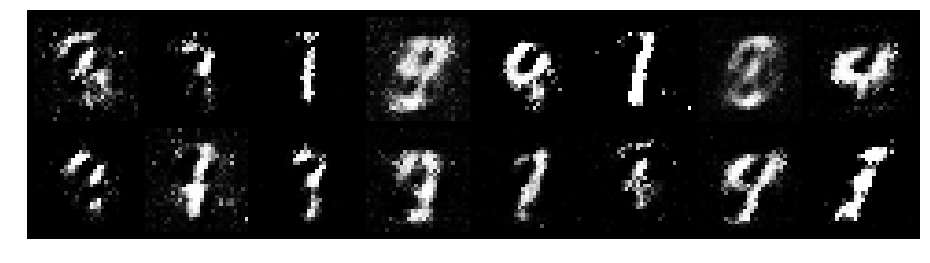

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.4916, Generator Loss: 3.1080
D(x): 0.8450, D(G(z)): 0.1835


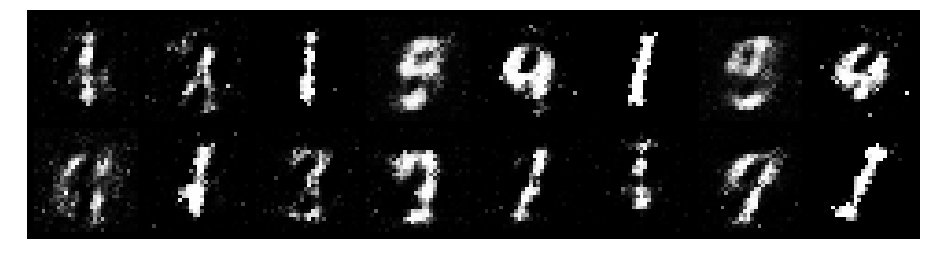

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.4952, Generator Loss: 2.7272
D(x): 0.8712, D(G(z)): 0.2183


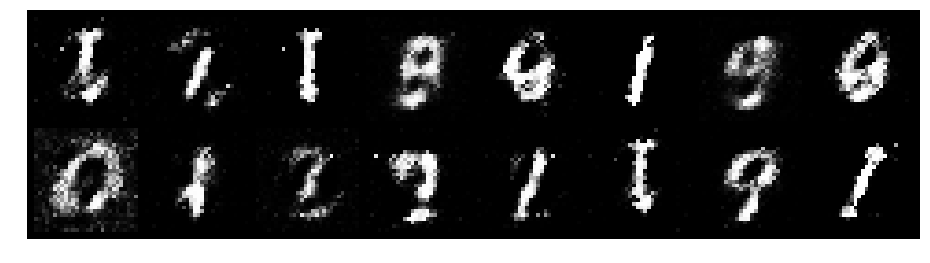

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.5024, Generator Loss: 2.5154
D(x): 0.8224, D(G(z)): 0.1340


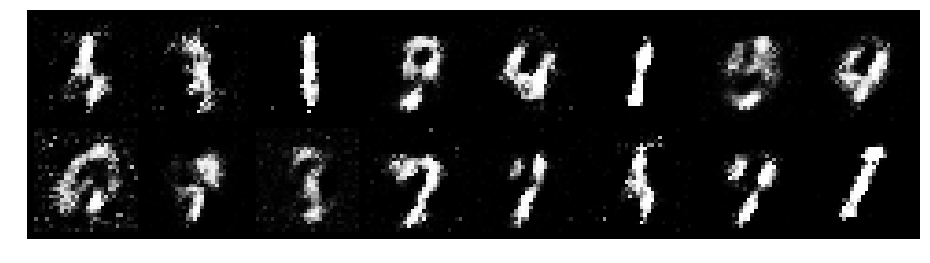

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.5800, Generator Loss: 2.4192
D(x): 0.7947, D(G(z)): 0.1603


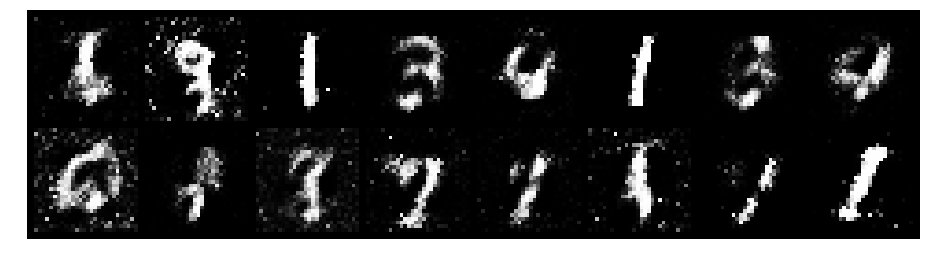

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6861, Generator Loss: 2.3755
D(x): 0.8354, D(G(z)): 0.2641


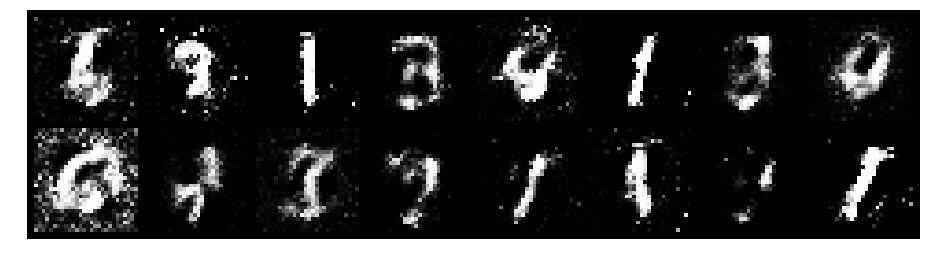

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 1.1033, Generator Loss: 1.9494
D(x): 0.6763, D(G(z)): 0.2170


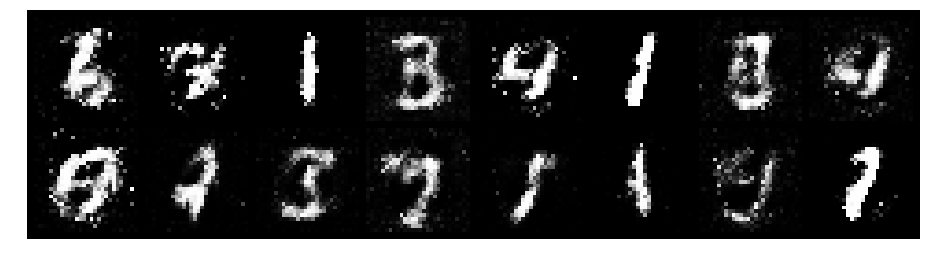

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.7782, Generator Loss: 1.8981
D(x): 0.7266, D(G(z)): 0.2160


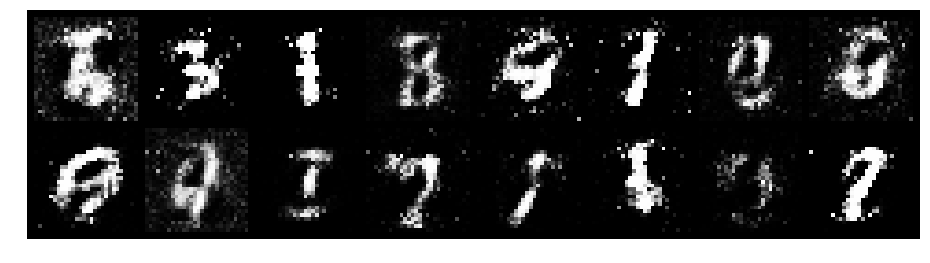

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7616, Generator Loss: 1.8394
D(x): 0.7585, D(G(z)): 0.2529


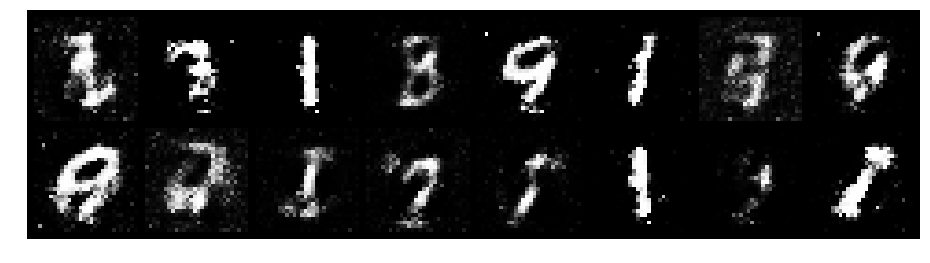

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.7405, Generator Loss: 2.6999
D(x): 0.7315, D(G(z)): 0.1862


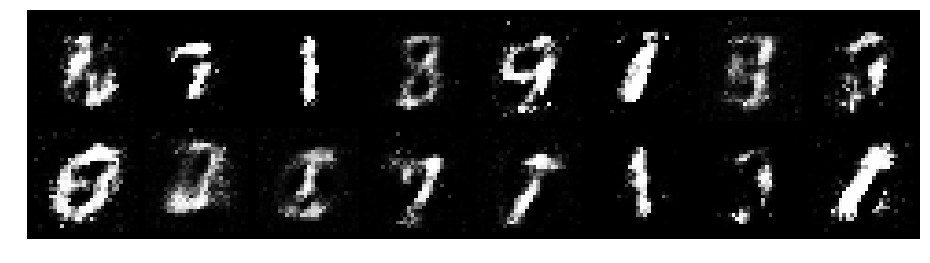

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.6541, Generator Loss: 2.6833
D(x): 0.8060, D(G(z)): 0.2243


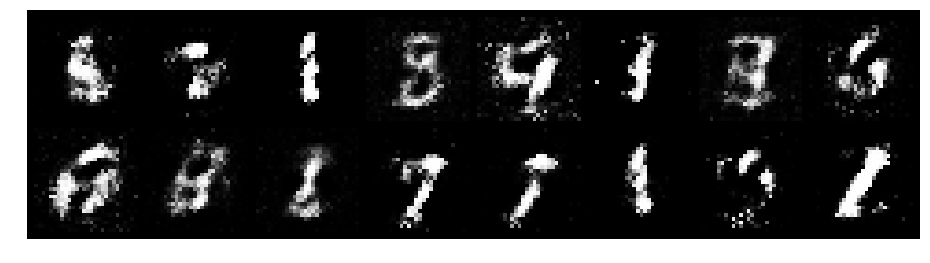

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.6754, Generator Loss: 1.9340
D(x): 0.8153, D(G(z)): 0.2531


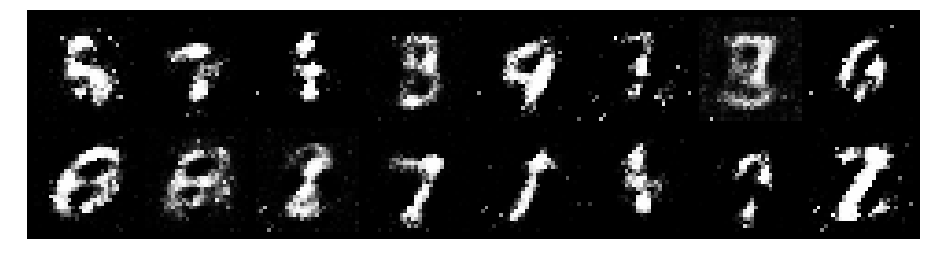

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8944, Generator Loss: 1.6544
D(x): 0.7379, D(G(z)): 0.2983


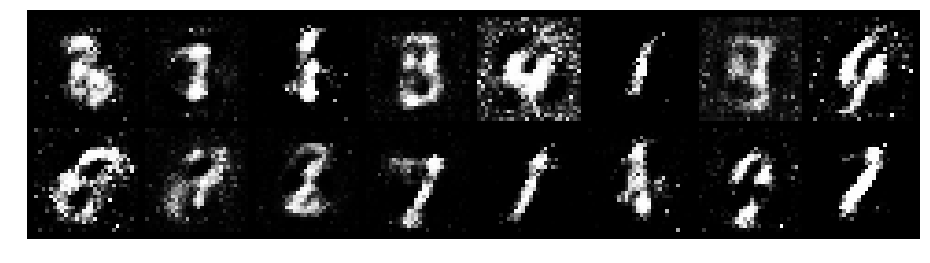

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.8756, Generator Loss: 1.5028
D(x): 0.7346, D(G(z)): 0.3424


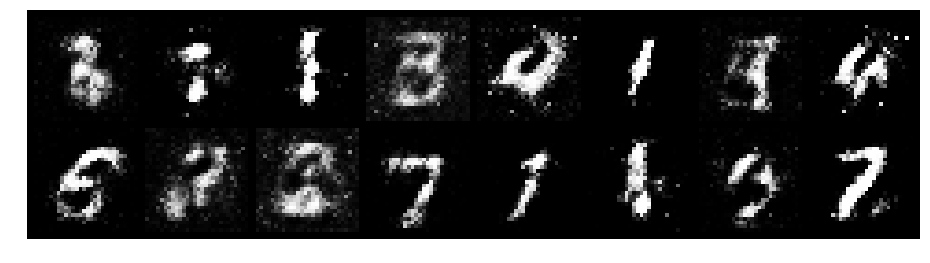

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.9325, Generator Loss: 1.3197
D(x): 0.7112, D(G(z)): 0.3046


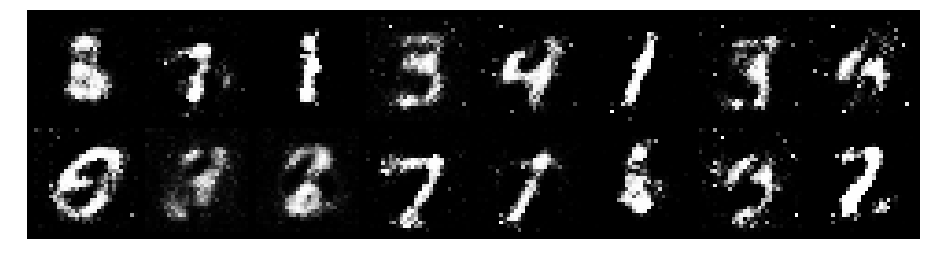

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.8808, Generator Loss: 1.7557
D(x): 0.6920, D(G(z)): 0.2508


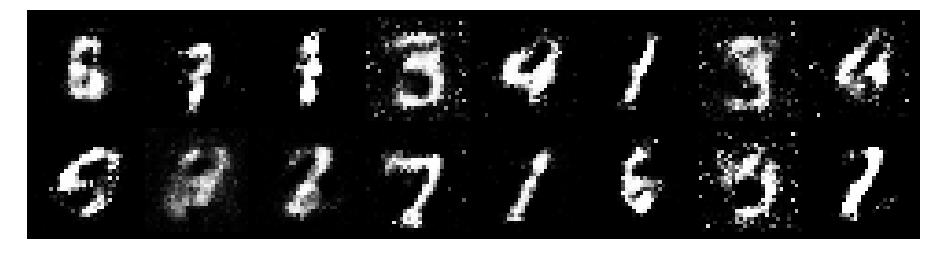

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.8092, Generator Loss: 2.2222
D(x): 0.7509, D(G(z)): 0.2673


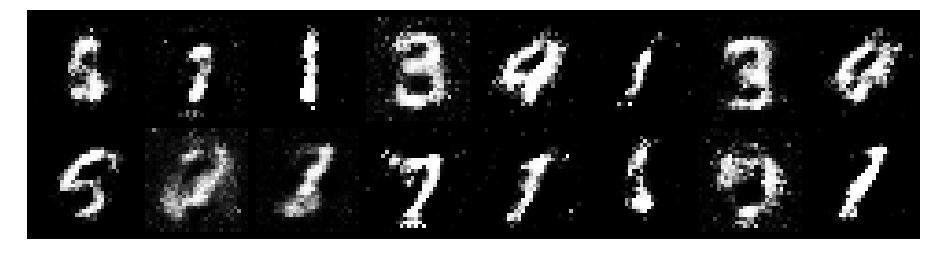

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.6657, Generator Loss: 2.0683
D(x): 0.8157, D(G(z)): 0.2290


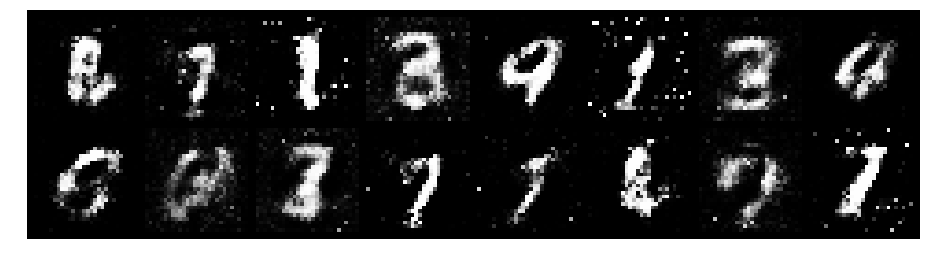

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.6630, Generator Loss: 2.2535
D(x): 0.7492, D(G(z)): 0.1919


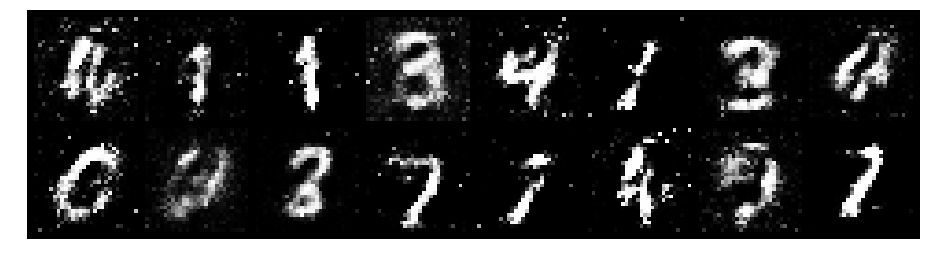

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7777, Generator Loss: 1.8971
D(x): 0.8263, D(G(z)): 0.2966


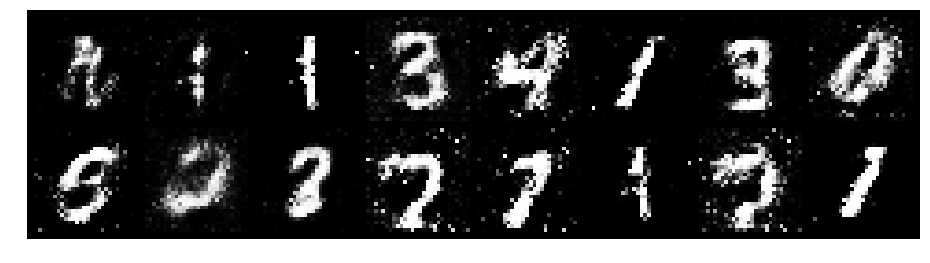

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.7384, Generator Loss: 2.3642
D(x): 0.7563, D(G(z)): 0.2619


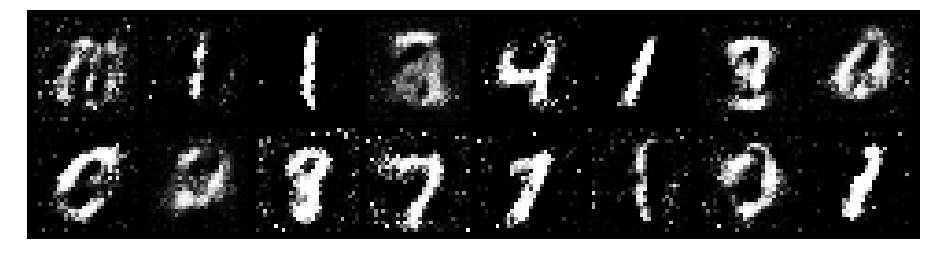

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8934, Generator Loss: 1.8659
D(x): 0.6977, D(G(z)): 0.2398


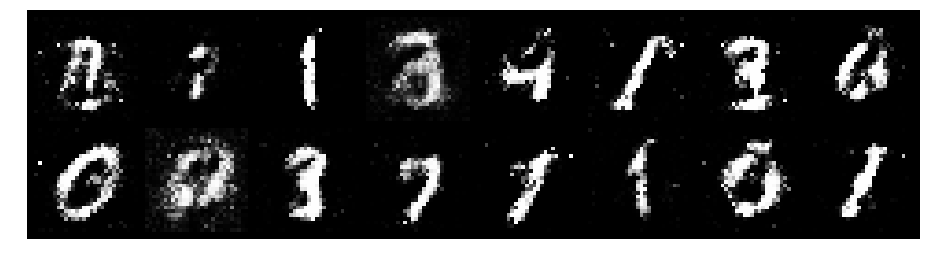

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7567, Generator Loss: 2.4798
D(x): 0.7250, D(G(z)): 0.1591


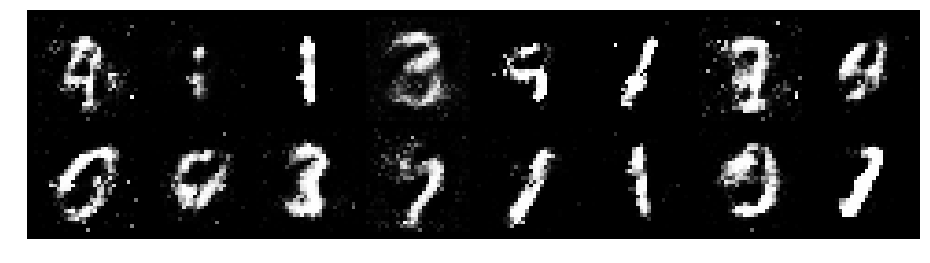

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.8305, Generator Loss: 1.7713
D(x): 0.7731, D(G(z)): 0.2505


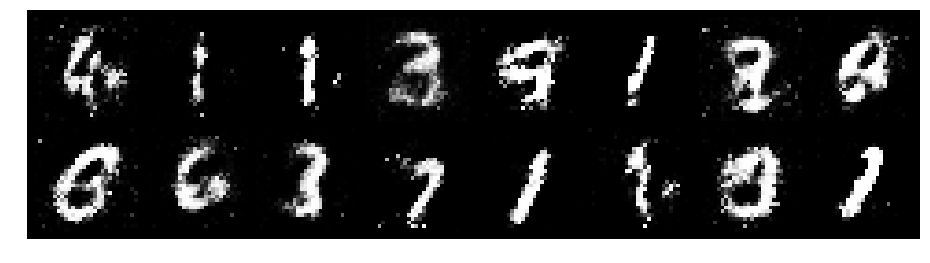

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 1.1381, Generator Loss: 1.4608
D(x): 0.6052, D(G(z)): 0.3380


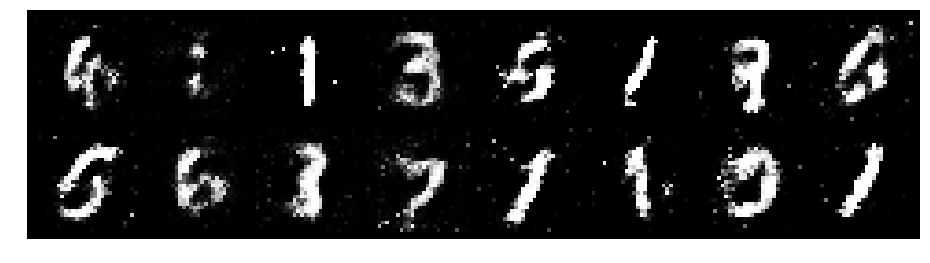

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8971, Generator Loss: 1.4120
D(x): 0.7119, D(G(z)): 0.2952


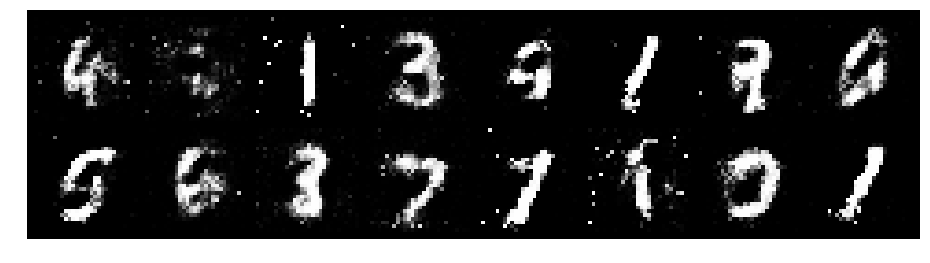

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.9773, Generator Loss: 1.4518
D(x): 0.6916, D(G(z)): 0.2788


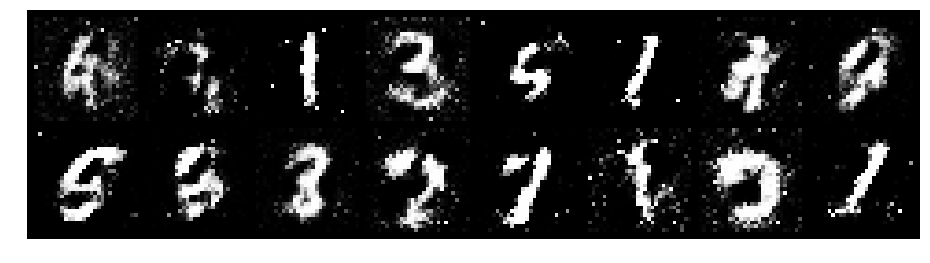

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.7777, Generator Loss: 1.7591
D(x): 0.7321, D(G(z)): 0.2232


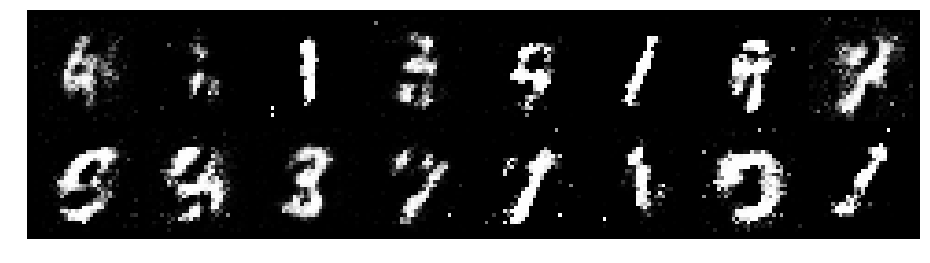

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.8926, Generator Loss: 1.6282
D(x): 0.7113, D(G(z)): 0.3006


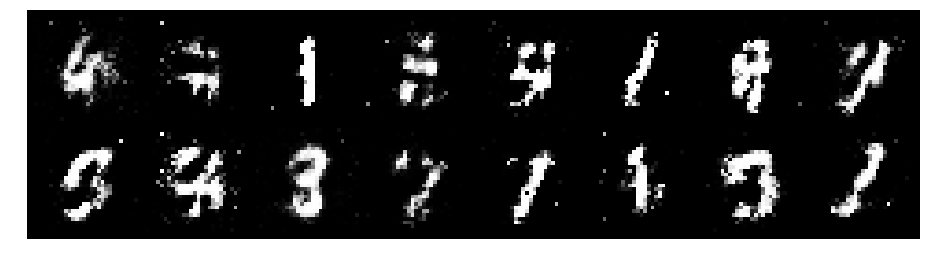

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.7705, Generator Loss: 2.0495
D(x): 0.7299, D(G(z)): 0.2390


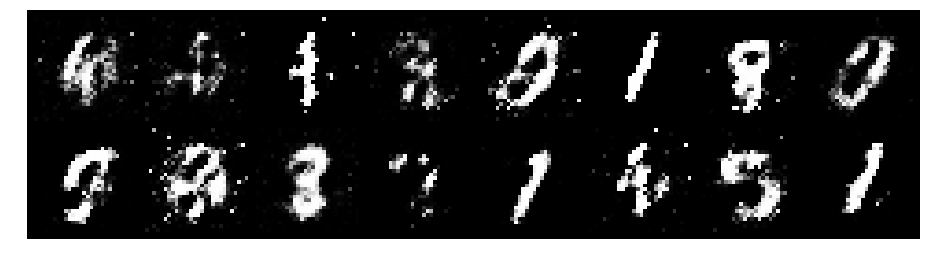

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.7775, Generator Loss: 1.6995
D(x): 0.7321, D(G(z)): 0.2688


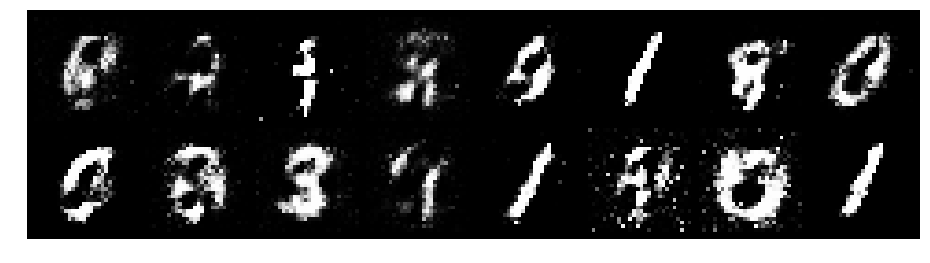

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 1.0202, Generator Loss: 1.2399
D(x): 0.6222, D(G(z)): 0.2734


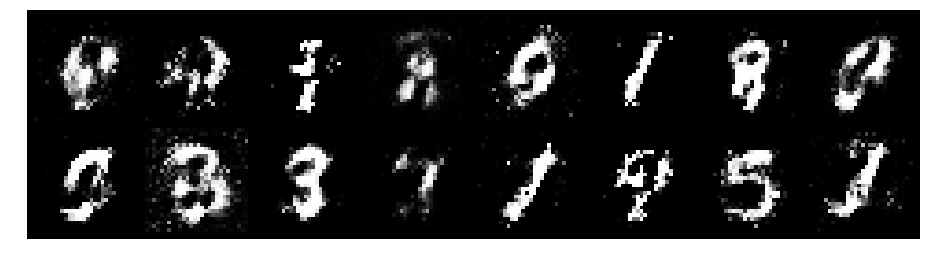

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.7581, Generator Loss: 1.9753
D(x): 0.7016, D(G(z)): 0.1994


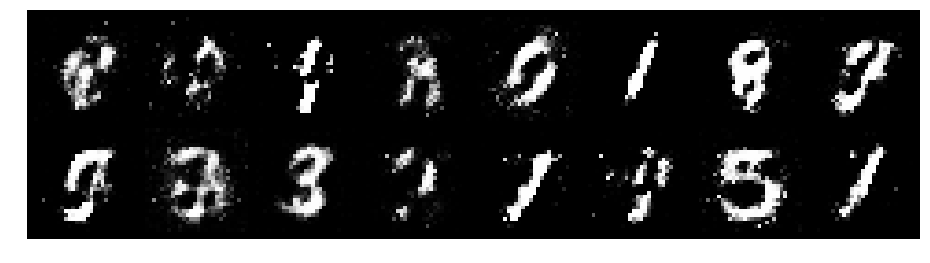

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9049, Generator Loss: 1.7924
D(x): 0.7119, D(G(z)): 0.2889


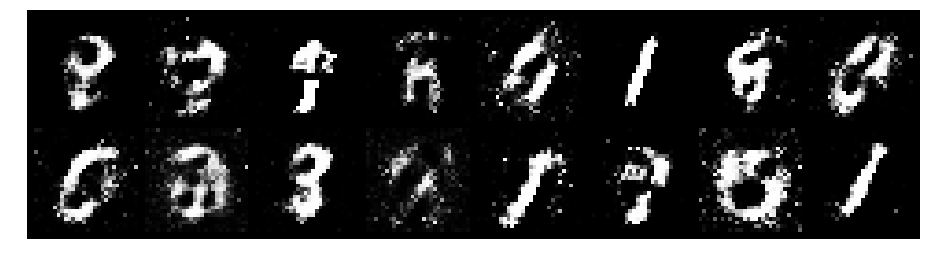

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8565, Generator Loss: 1.6825
D(x): 0.6671, D(G(z)): 0.2323


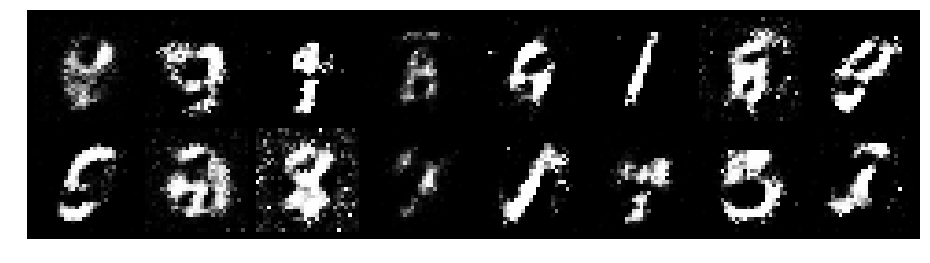

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8940, Generator Loss: 2.0299
D(x): 0.7192, D(G(z)): 0.3023


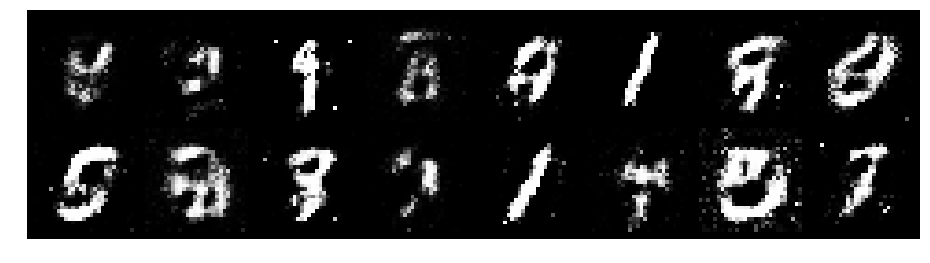

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.9460, Generator Loss: 1.7163
D(x): 0.7014, D(G(z)): 0.2664


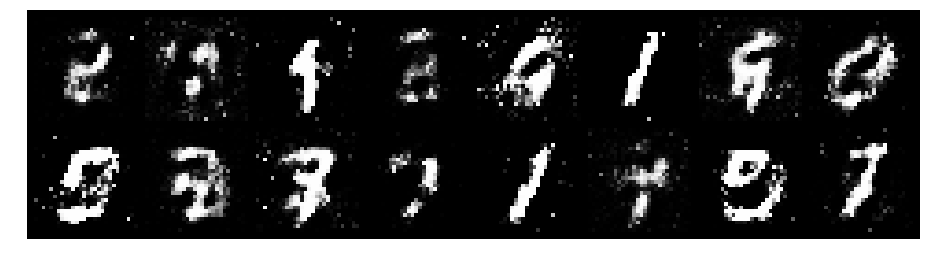

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.7266, Generator Loss: 2.0777
D(x): 0.7399, D(G(z)): 0.2475


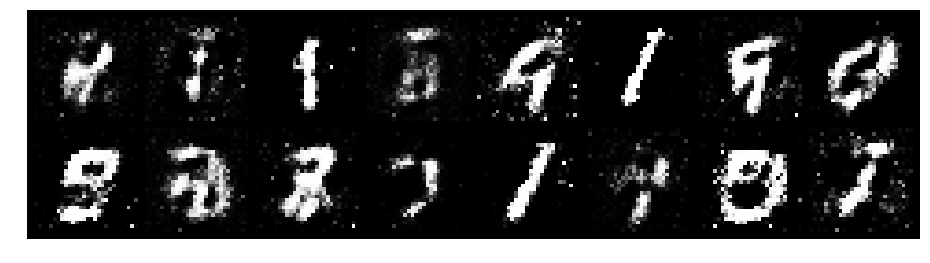

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7533, Generator Loss: 1.6727
D(x): 0.7699, D(G(z)): 0.3036


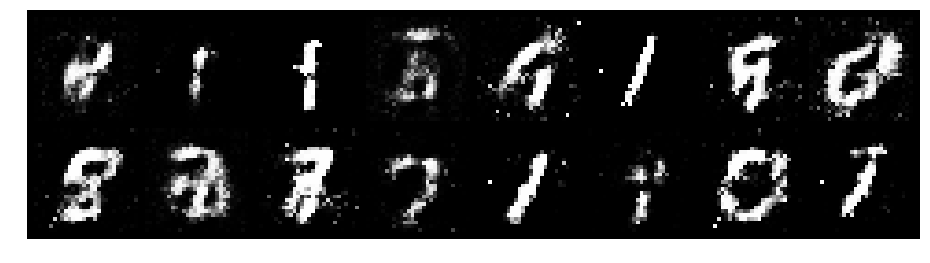

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.8636, Generator Loss: 1.9136
D(x): 0.7564, D(G(z)): 0.3152


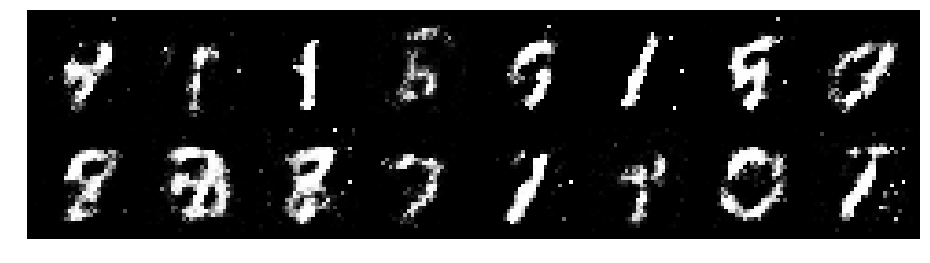

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8426, Generator Loss: 1.5779
D(x): 0.7614, D(G(z)): 0.3015


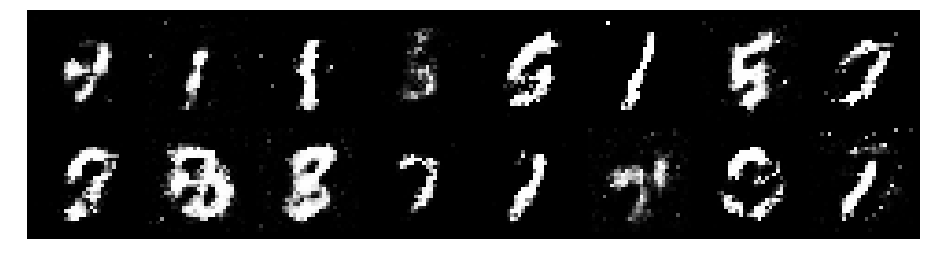

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7689, Generator Loss: 1.5032
D(x): 0.7987, D(G(z)): 0.3438


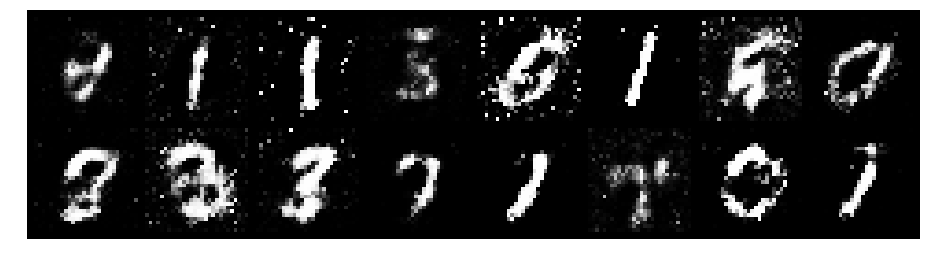

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.9700, Generator Loss: 1.4104
D(x): 0.7247, D(G(z)): 0.3438


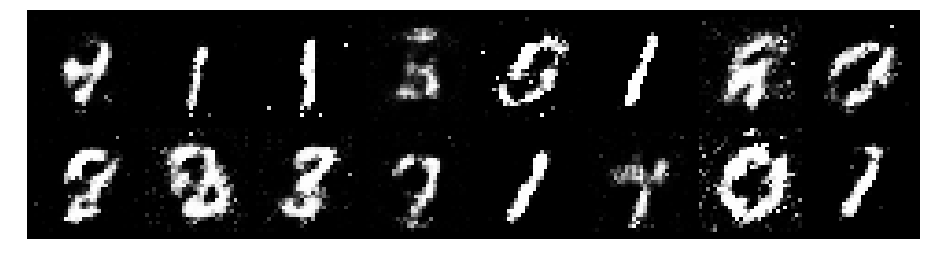

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.9247, Generator Loss: 1.9958
D(x): 0.6297, D(G(z)): 0.2045


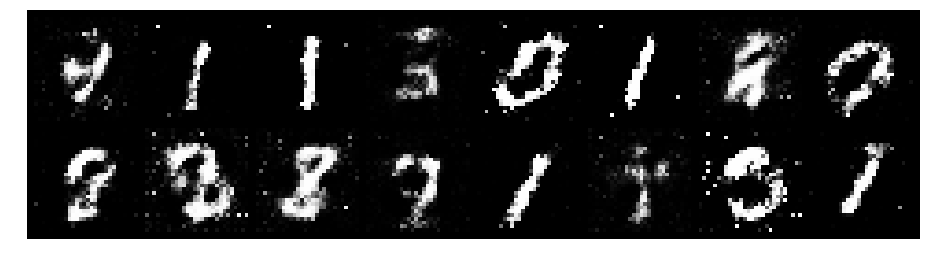

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.6877, Generator Loss: 1.7658
D(x): 0.7804, D(G(z)): 0.2652


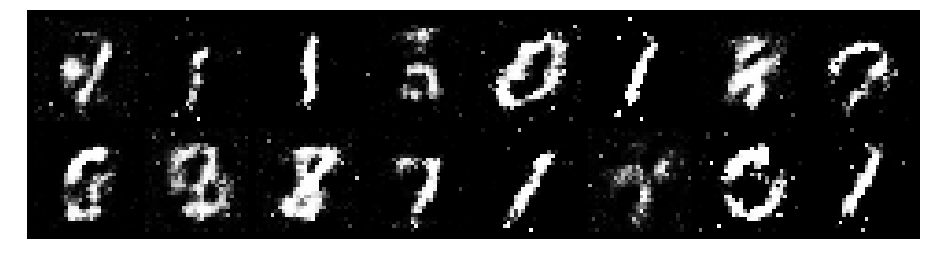

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 1.0914, Generator Loss: 1.2159
D(x): 0.7817, D(G(z)): 0.4738


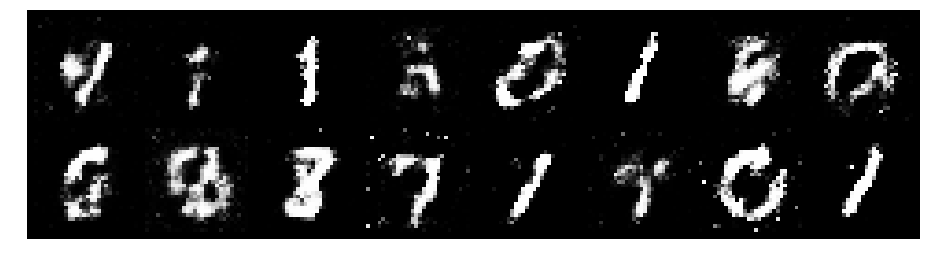

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 1.0659, Generator Loss: 1.8769
D(x): 0.6114, D(G(z)): 0.2789


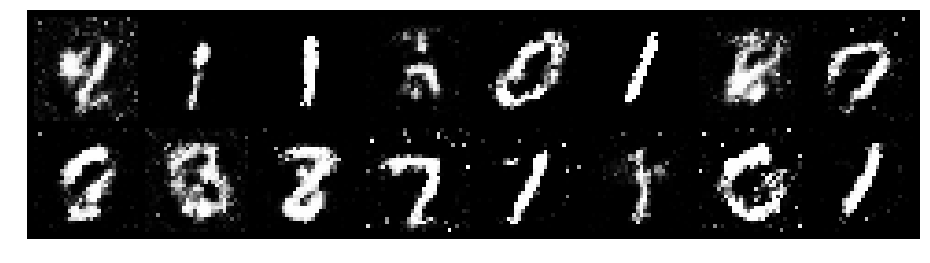

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.9883, Generator Loss: 1.2700
D(x): 0.7427, D(G(z)): 0.3794


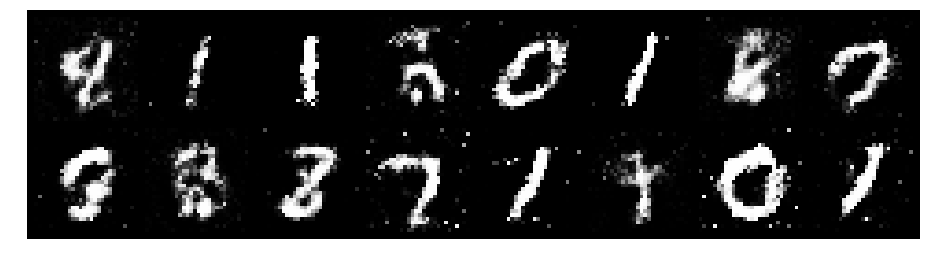

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9041, Generator Loss: 1.5058
D(x): 0.6907, D(G(z)): 0.2637


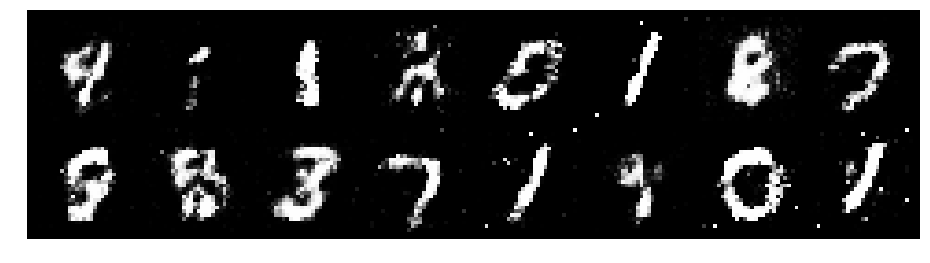

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.7826, Generator Loss: 1.8526
D(x): 0.7991, D(G(z)): 0.2916


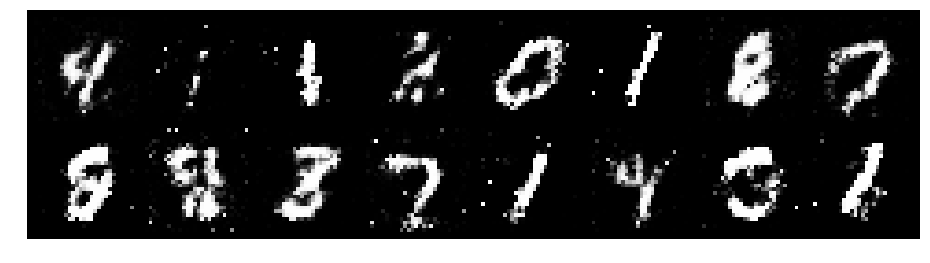

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.7236, Generator Loss: 1.8883
D(x): 0.8081, D(G(z)): 0.2704


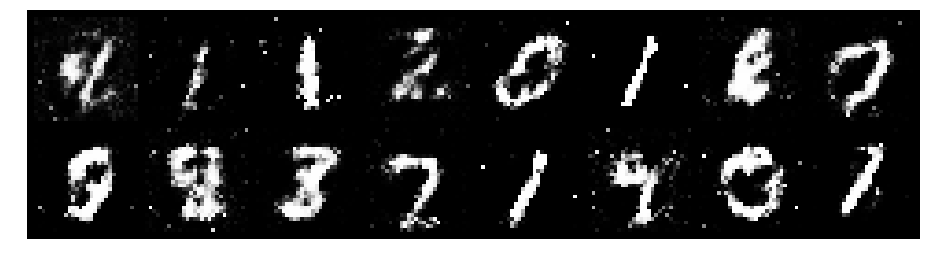

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.7701, Generator Loss: 1.8377
D(x): 0.7964, D(G(z)): 0.2903


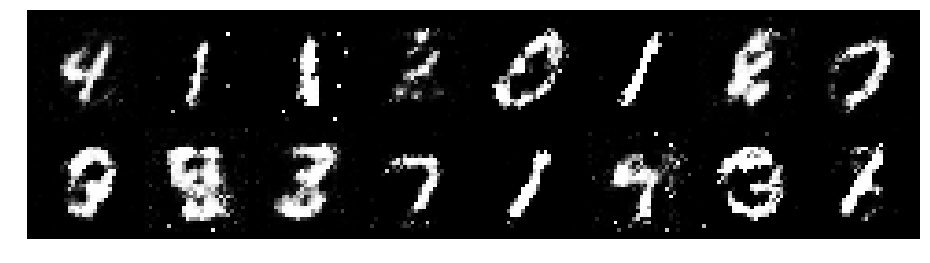

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.8176, Generator Loss: 1.7318
D(x): 0.7101, D(G(z)): 0.2417


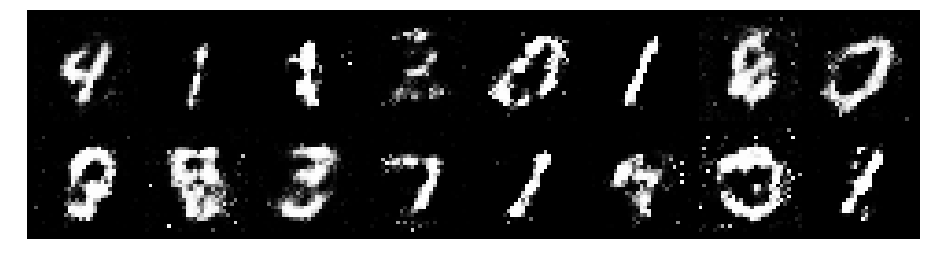

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8559, Generator Loss: 1.8649
D(x): 0.7233, D(G(z)): 0.2749


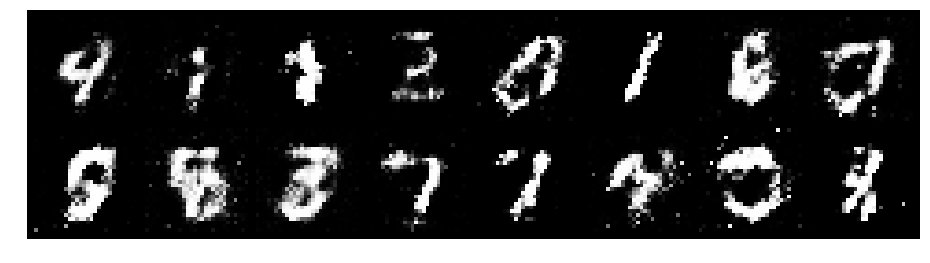

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.7231, Generator Loss: 1.7204
D(x): 0.7598, D(G(z)): 0.2468


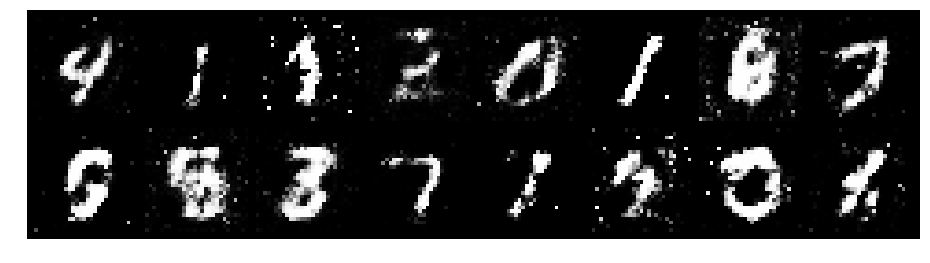

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8271, Generator Loss: 1.9669
D(x): 0.7357, D(G(z)): 0.2979


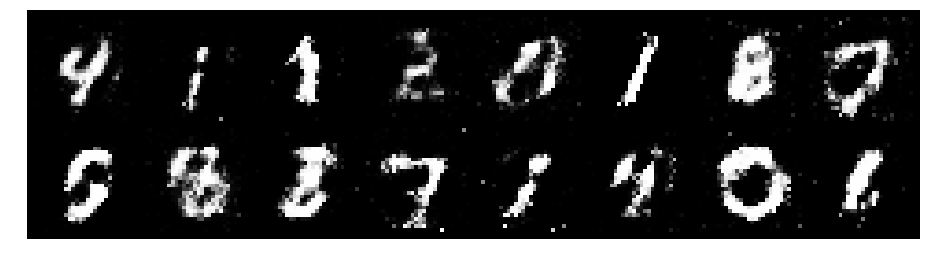

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0667, Generator Loss: 1.1540
D(x): 0.8485, D(G(z)): 0.4704


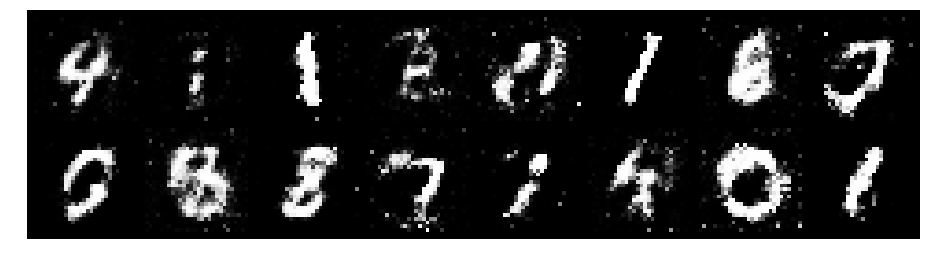

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 1.1681, Generator Loss: 1.2125
D(x): 0.6037, D(G(z)): 0.3090


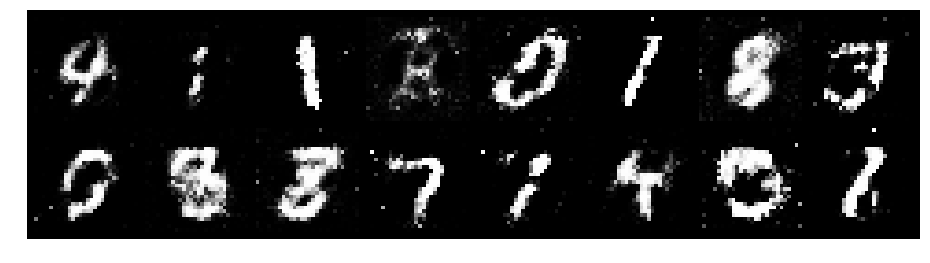

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0149, Generator Loss: 1.7043
D(x): 0.7647, D(G(z)): 0.3678


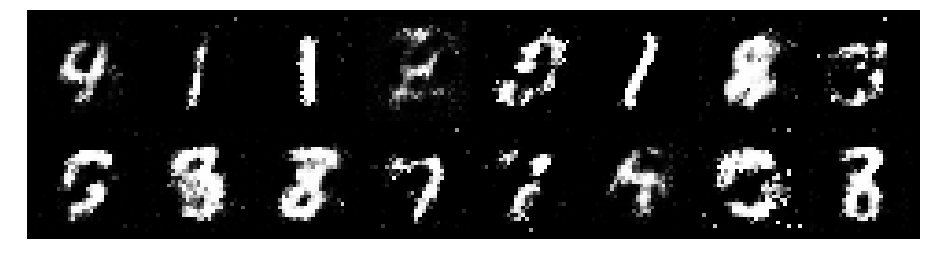

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9111, Generator Loss: 1.9168
D(x): 0.7284, D(G(z)): 0.3146


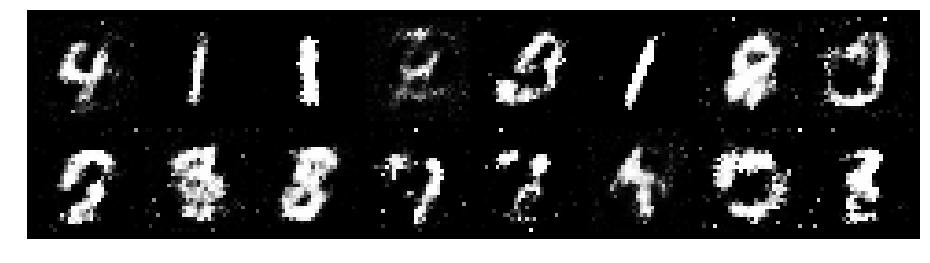

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.6866, Generator Loss: 1.7923
D(x): 0.7781, D(G(z)): 0.2823


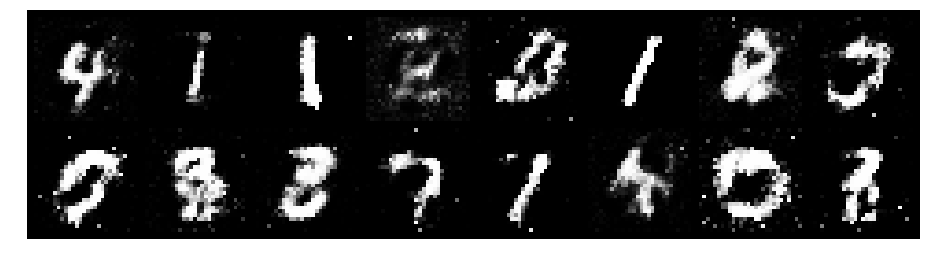

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8637, Generator Loss: 1.9550
D(x): 0.7105, D(G(z)): 0.2790


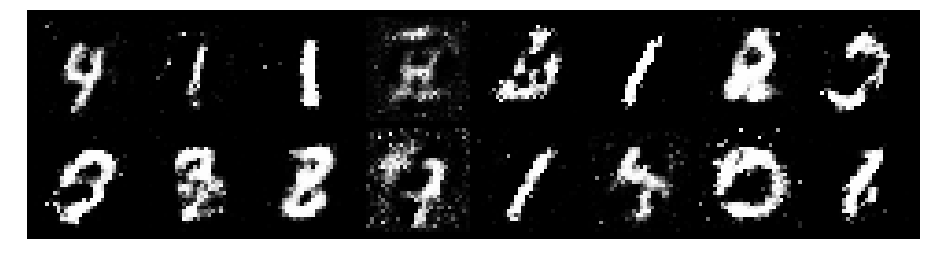

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8337, Generator Loss: 1.4802
D(x): 0.6585, D(G(z)): 0.2489


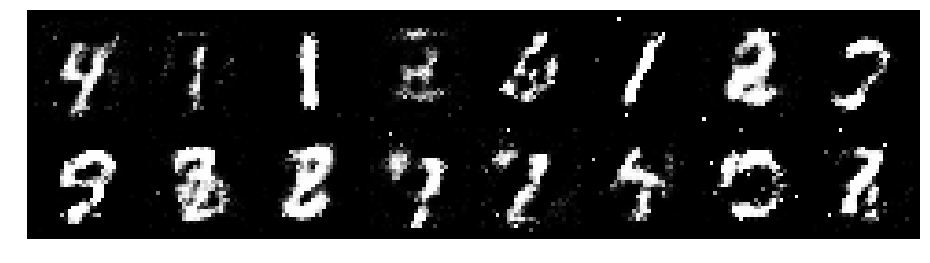

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.8127, Generator Loss: 1.3621
D(x): 0.7364, D(G(z)): 0.3173


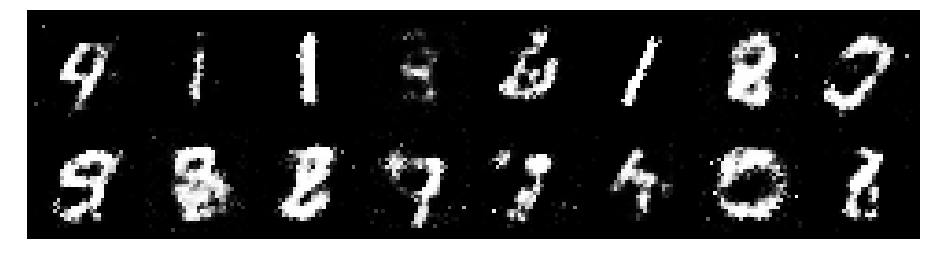

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 1.0006, Generator Loss: 1.5726
D(x): 0.6818, D(G(z)): 0.3191


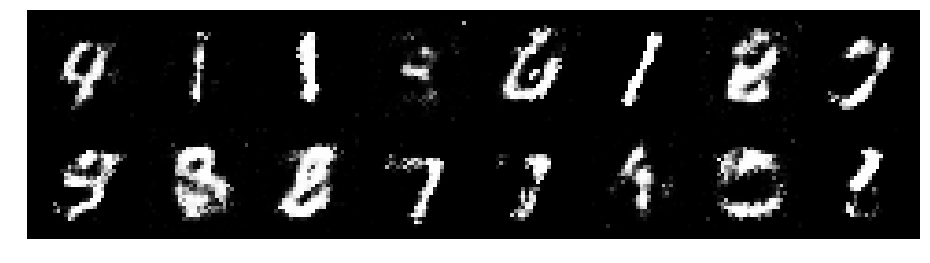

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.8901, Generator Loss: 1.2438
D(x): 0.6787, D(G(z)): 0.3094


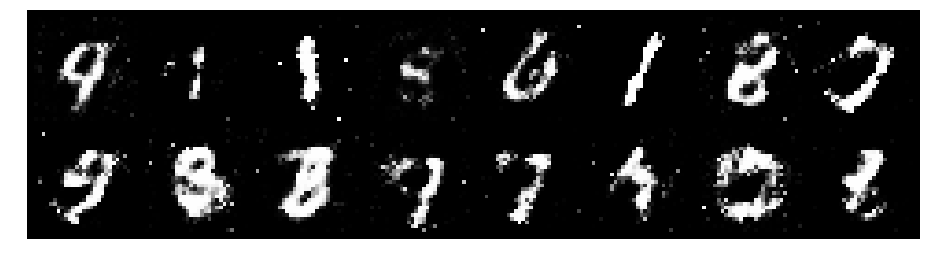

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8744, Generator Loss: 1.3479
D(x): 0.6999, D(G(z)): 0.3166


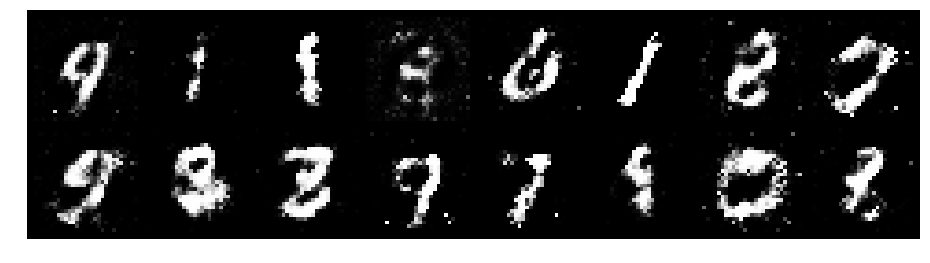

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.7845, Generator Loss: 1.5069
D(x): 0.7583, D(G(z)): 0.3107


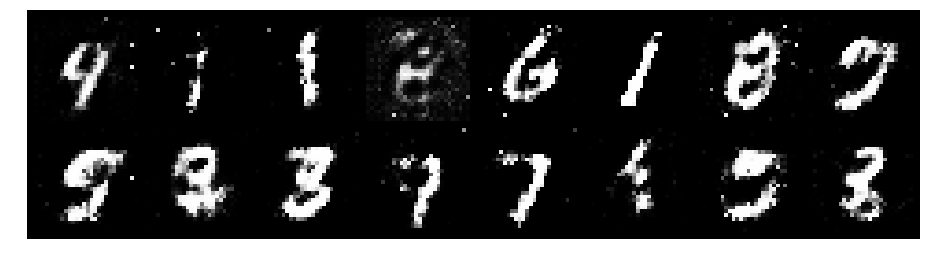

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 1.1314, Generator Loss: 1.5902
D(x): 0.5961, D(G(z)): 0.3131


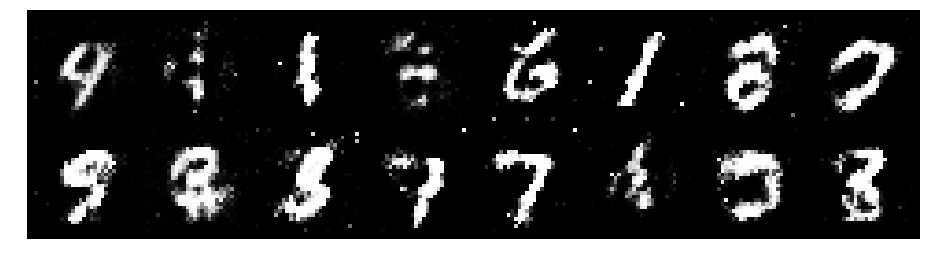

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.9079, Generator Loss: 1.4269
D(x): 0.6748, D(G(z)): 0.3097


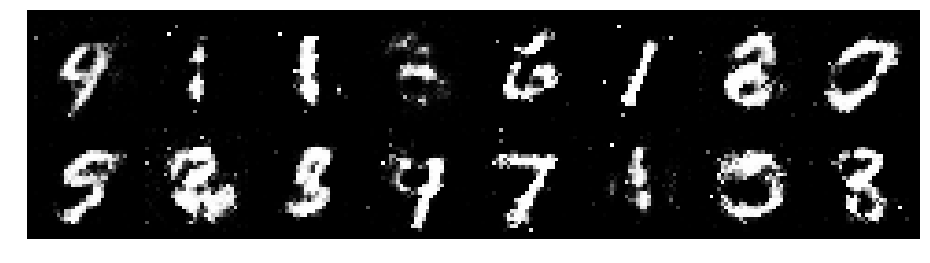

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.8942, Generator Loss: 1.3252
D(x): 0.6514, D(G(z)): 0.2829


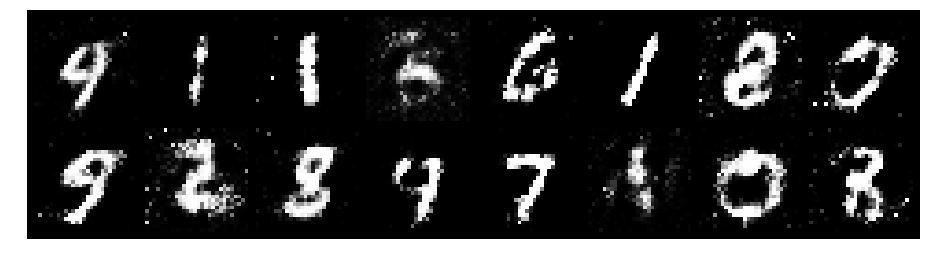

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8821, Generator Loss: 1.5704
D(x): 0.7532, D(G(z)): 0.3404


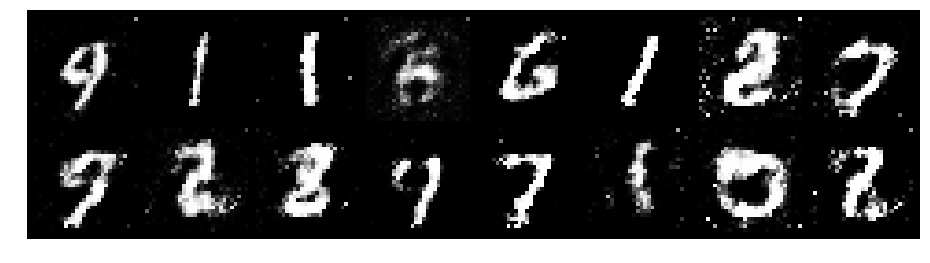

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.0207, Generator Loss: 1.7229
D(x): 0.7015, D(G(z)): 0.3072


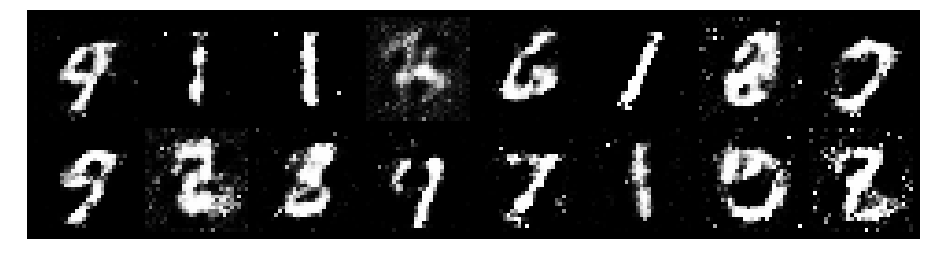

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.8556, Generator Loss: 1.4360
D(x): 0.7637, D(G(z)): 0.3241


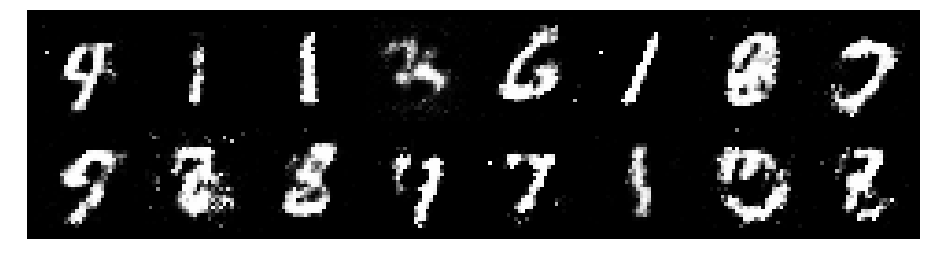

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.9462, Generator Loss: 2.0224
D(x): 0.7139, D(G(z)): 0.2745


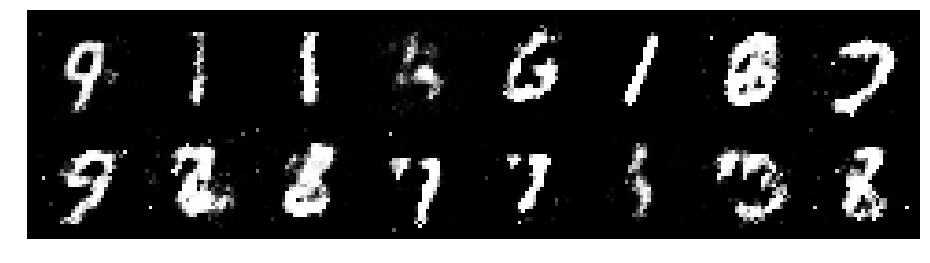

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9277, Generator Loss: 1.4590
D(x): 0.7523, D(G(z)): 0.3563


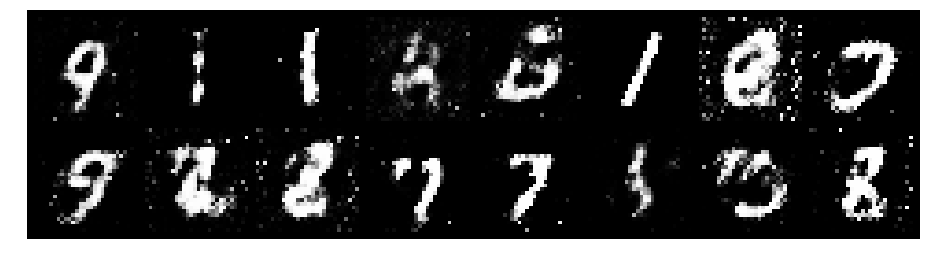

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.8449, Generator Loss: 1.9807
D(x): 0.7017, D(G(z)): 0.2696


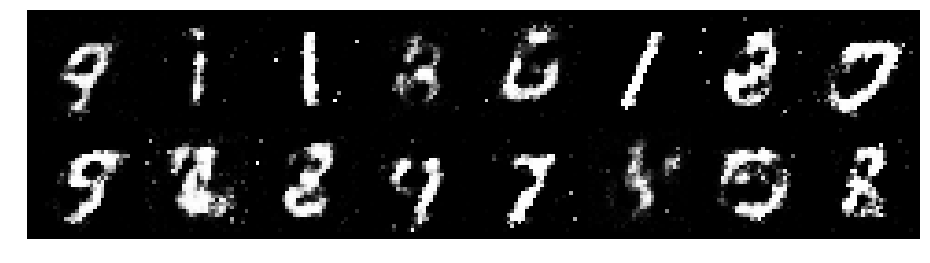

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0661, Generator Loss: 1.4506
D(x): 0.5944, D(G(z)): 0.2783


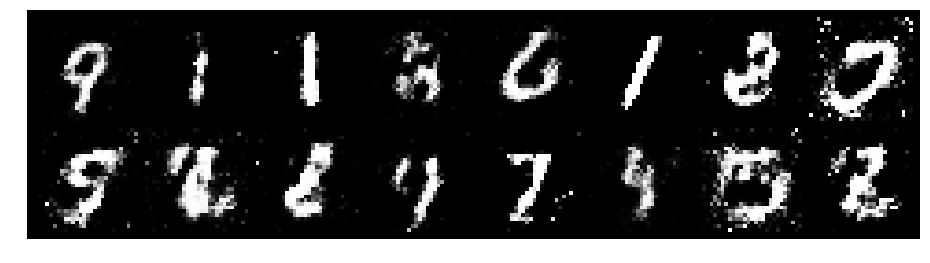

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8390, Generator Loss: 1.2696
D(x): 0.6983, D(G(z)): 0.3055


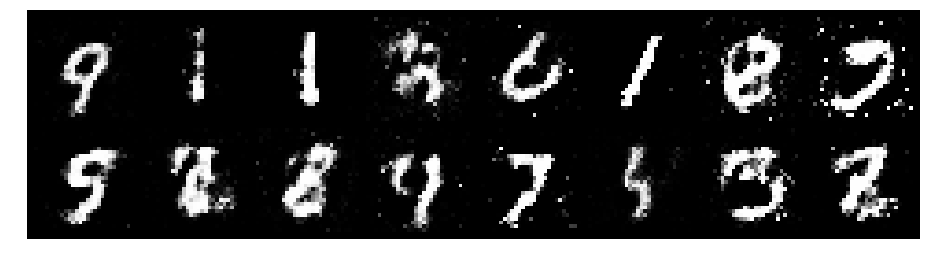

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.8518, Generator Loss: 1.4578
D(x): 0.6835, D(G(z)): 0.2648


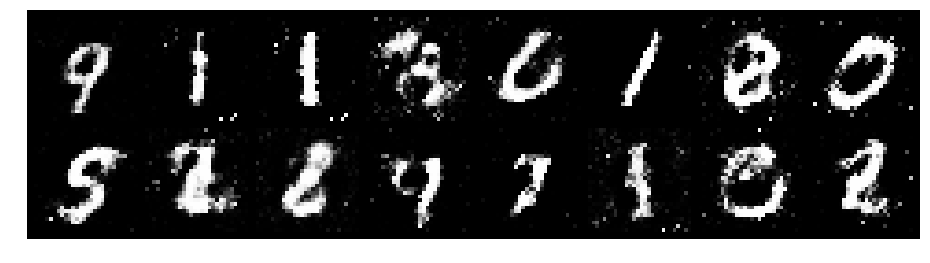

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.0079, Generator Loss: 1.6478
D(x): 0.6729, D(G(z)): 0.3056


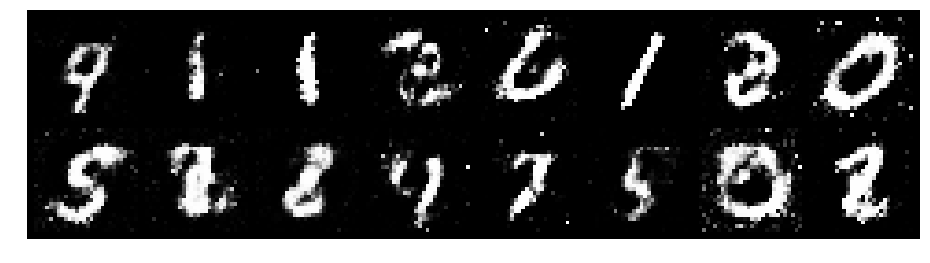

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.1254, Generator Loss: 1.2904
D(x): 0.6070, D(G(z)): 0.3407


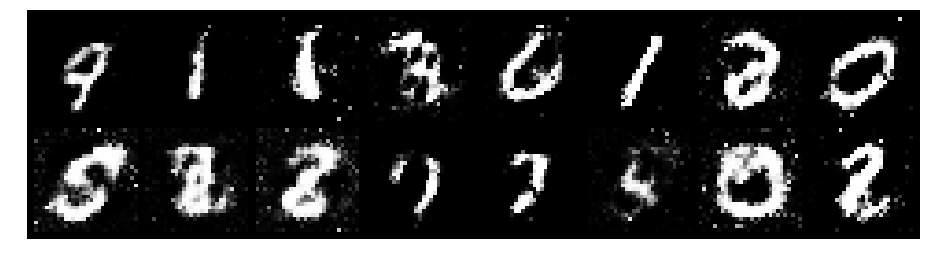

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.2056, Generator Loss: 1.2840
D(x): 0.6362, D(G(z)): 0.3591


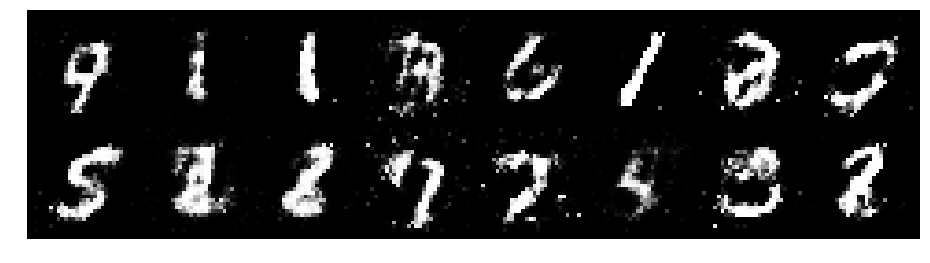

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.8679, Generator Loss: 1.0496
D(x): 0.7168, D(G(z)): 0.3320


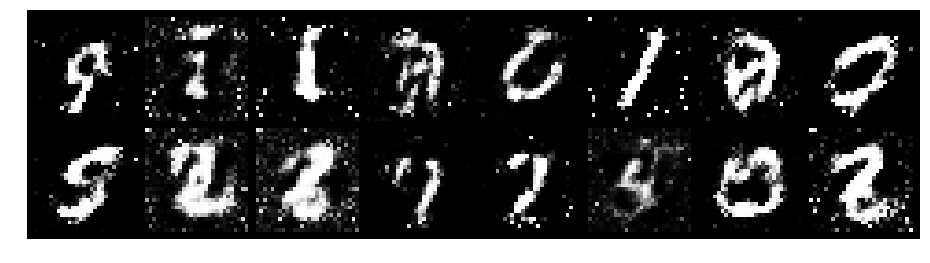

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.8961, Generator Loss: 1.9731
D(x): 0.7554, D(G(z)): 0.3305


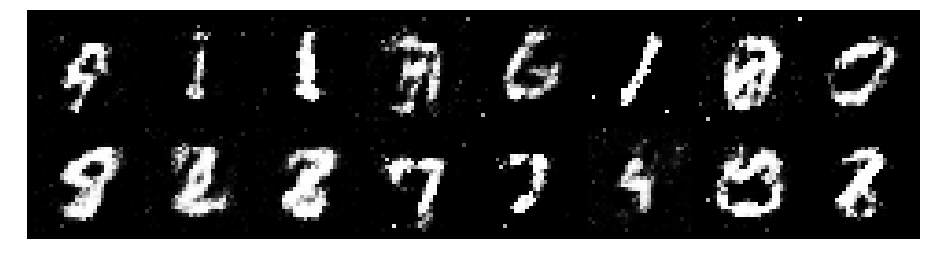

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.9444, Generator Loss: 1.3022
D(x): 0.7044, D(G(z)): 0.3668


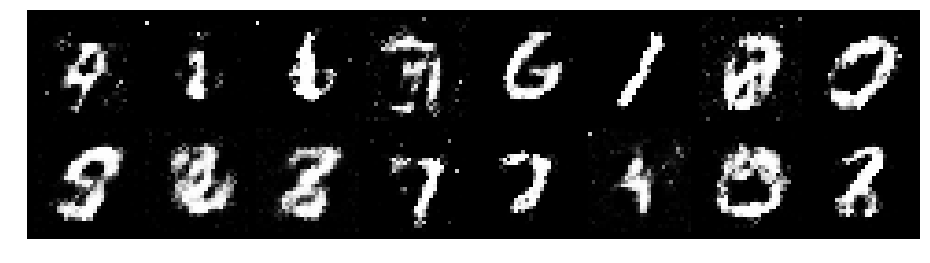

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9045, Generator Loss: 1.5286
D(x): 0.6587, D(G(z)): 0.2803


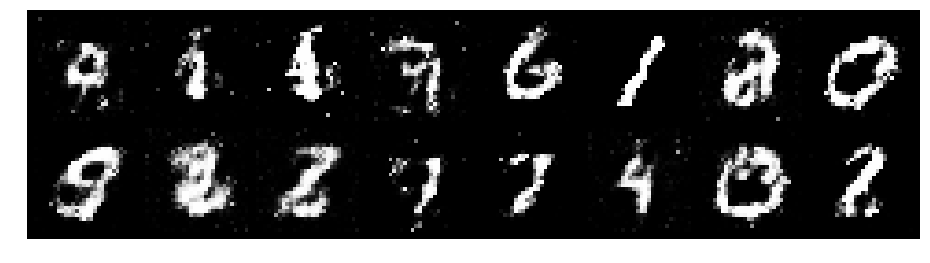

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9605, Generator Loss: 1.5483
D(x): 0.6908, D(G(z)): 0.3233


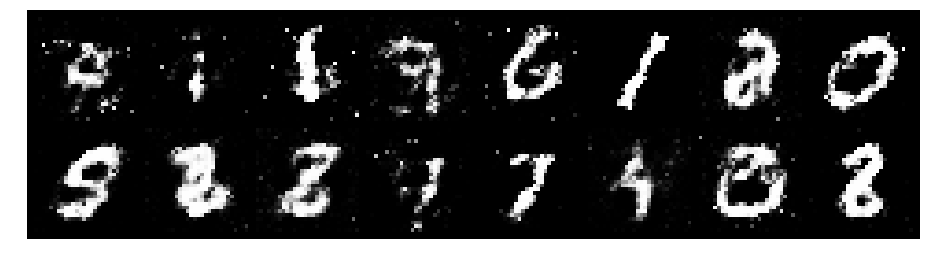

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8505, Generator Loss: 1.6242
D(x): 0.7544, D(G(z)): 0.3218


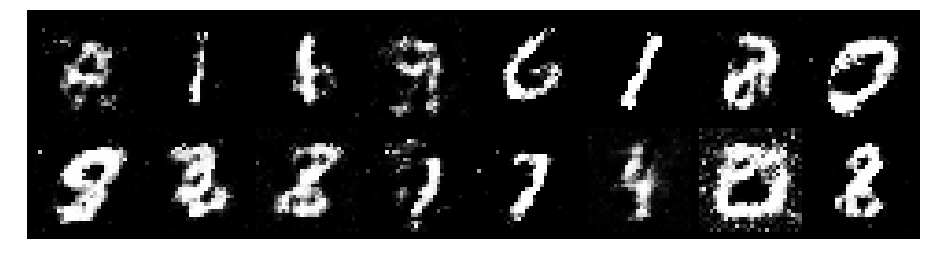

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8261, Generator Loss: 1.2657
D(x): 0.8086, D(G(z)): 0.3484


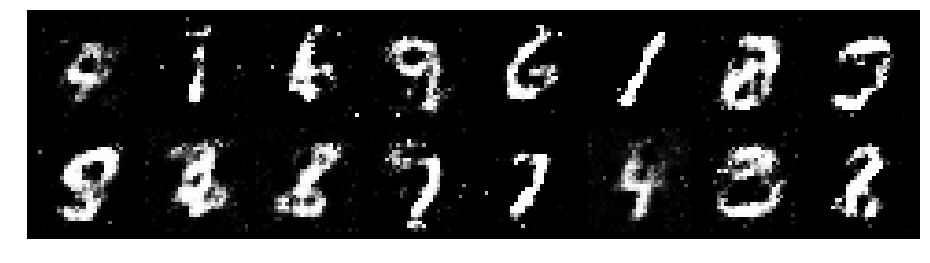

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.9430, Generator Loss: 1.6635
D(x): 0.7069, D(G(z)): 0.3196


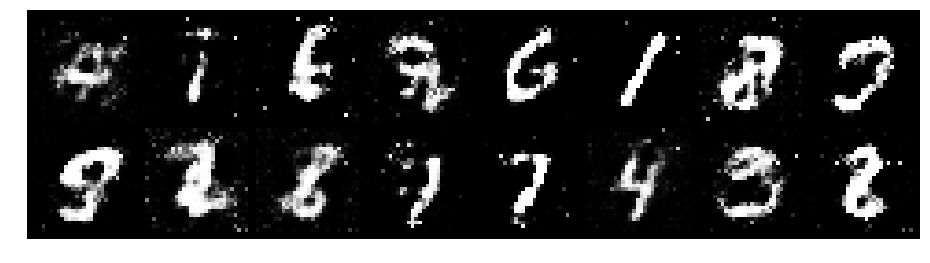

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0661, Generator Loss: 1.2554
D(x): 0.6689, D(G(z)): 0.3651


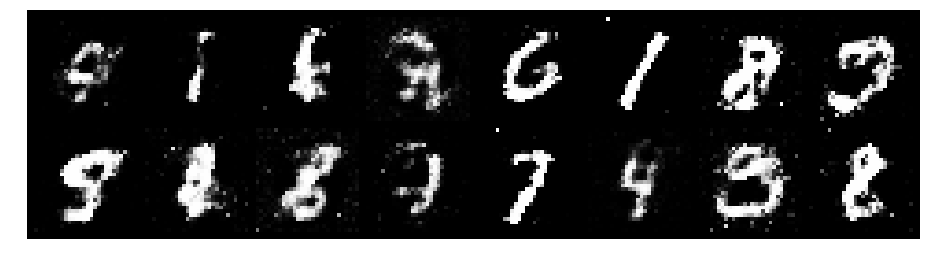

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.2713, Generator Loss: 1.1713
D(x): 0.6705, D(G(z)): 0.4561


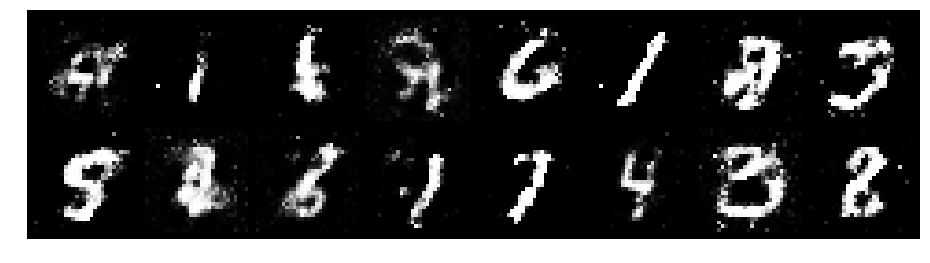

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.1270, Generator Loss: 1.3853
D(x): 0.6963, D(G(z)): 0.4381


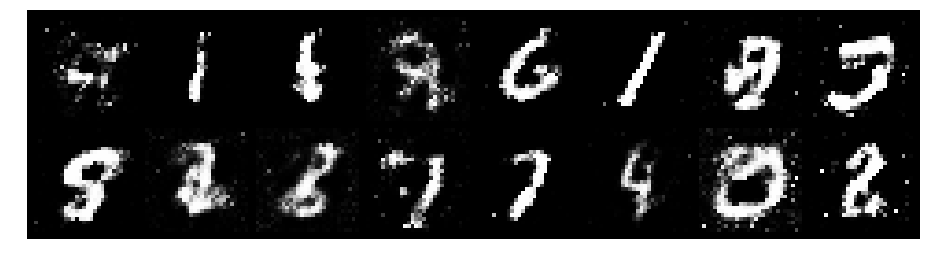

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.9702, Generator Loss: 1.5878
D(x): 0.6745, D(G(z)): 0.3122


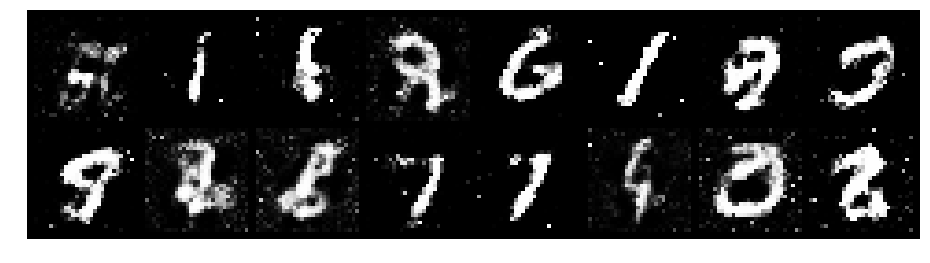

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 1.2144, Generator Loss: 1.0771
D(x): 0.6705, D(G(z)): 0.4461


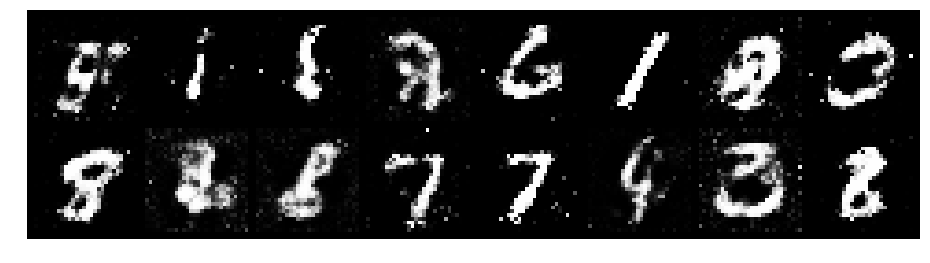

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.2030, Generator Loss: 1.0774
D(x): 0.6134, D(G(z)): 0.4139


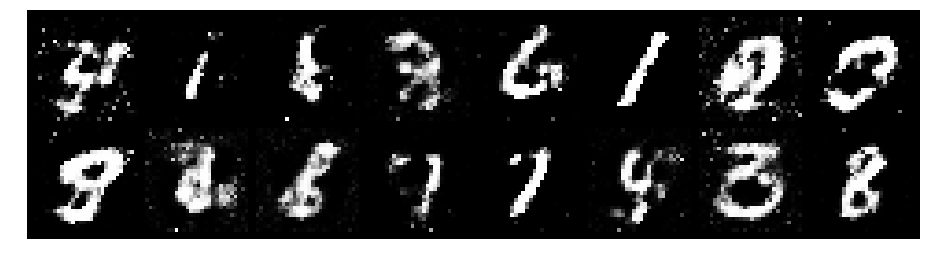

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.1301, Generator Loss: 1.3678
D(x): 0.5465, D(G(z)): 0.2759


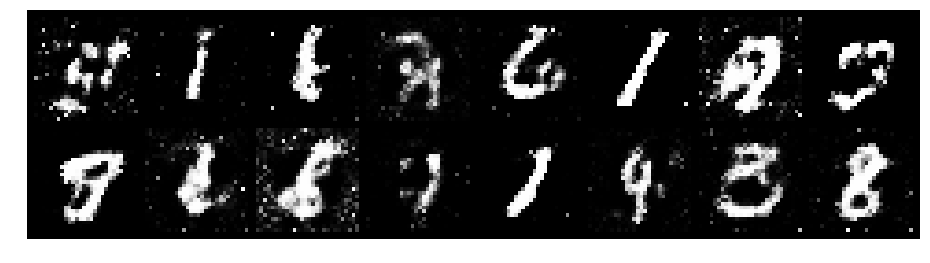

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1509, Generator Loss: 1.1775
D(x): 0.6711, D(G(z)): 0.4139


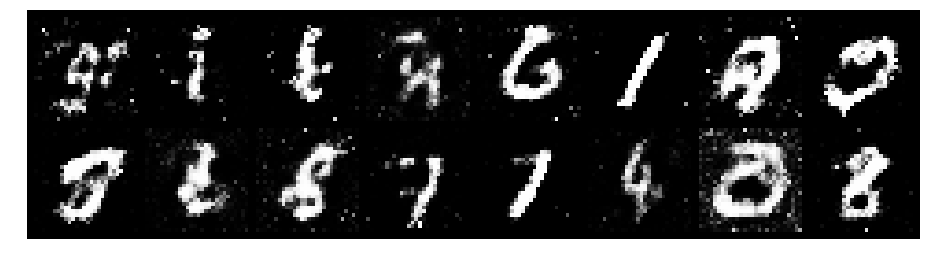

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8835, Generator Loss: 1.2939
D(x): 0.7036, D(G(z)): 0.3049


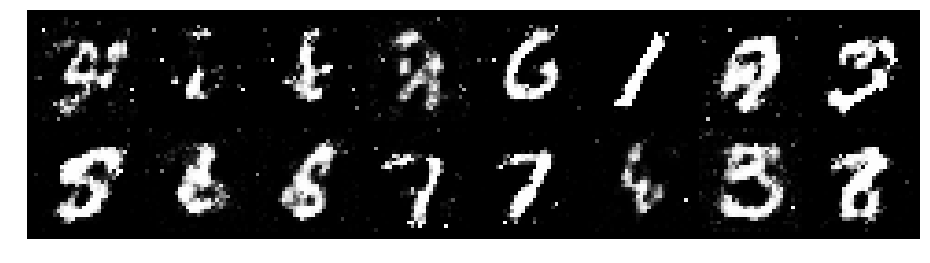

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9300, Generator Loss: 1.3708
D(x): 0.7292, D(G(z)): 0.3658


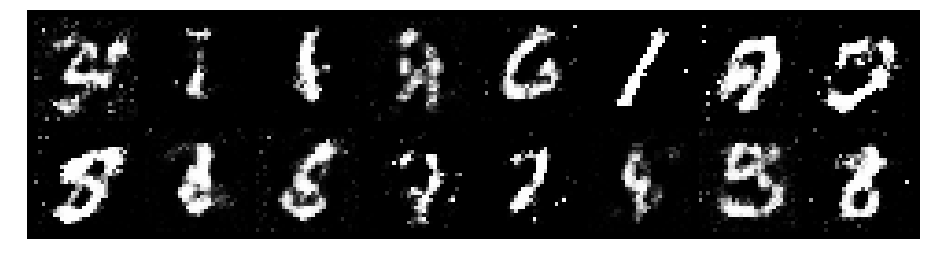

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.8324, Generator Loss: 1.2715
D(x): 0.7090, D(G(z)): 0.2959


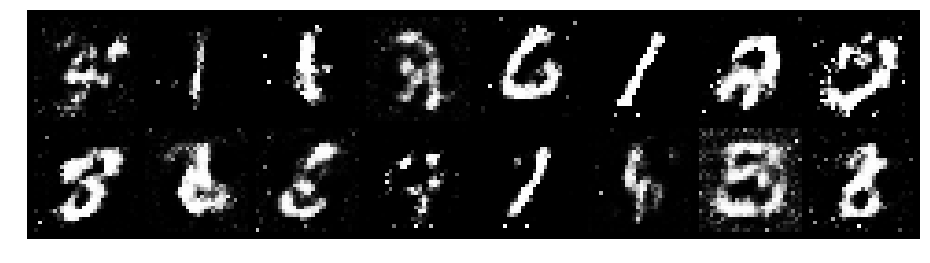

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.0701, Generator Loss: 1.3933
D(x): 0.7261, D(G(z)): 0.4178


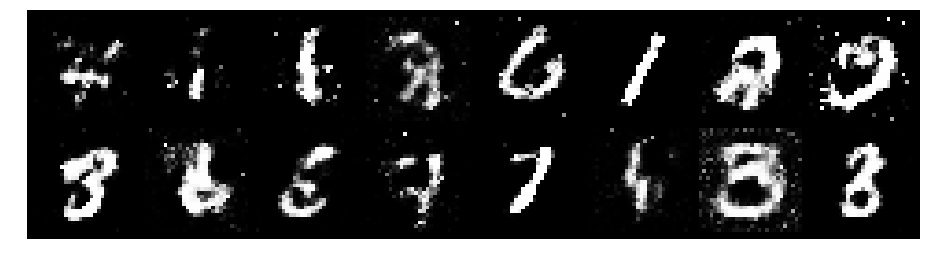

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.9382, Generator Loss: 1.3188
D(x): 0.7350, D(G(z)): 0.3342


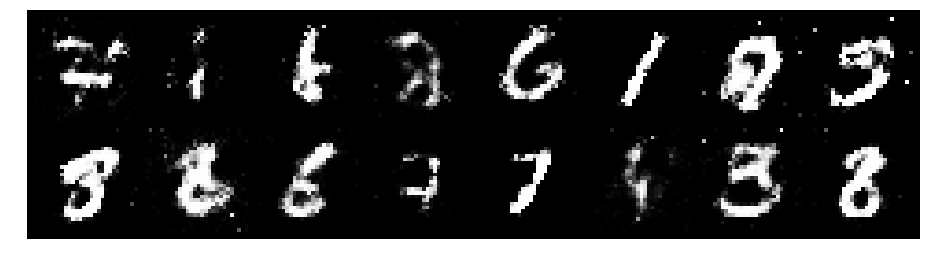

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.0163, Generator Loss: 1.2475
D(x): 0.6214, D(G(z)): 0.2860


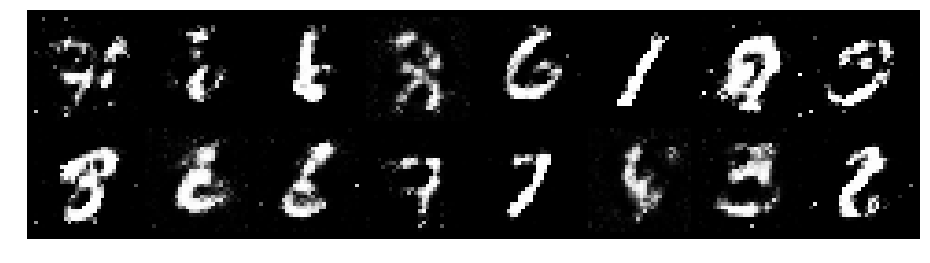

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 1.1910, Generator Loss: 0.9244
D(x): 0.6699, D(G(z)): 0.4393


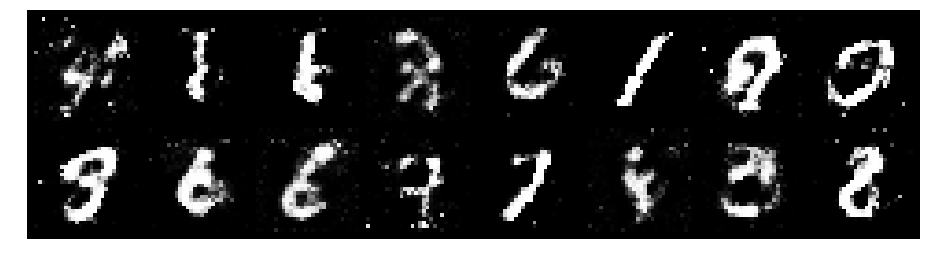

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.0386, Generator Loss: 1.3743
D(x): 0.6233, D(G(z)): 0.2738


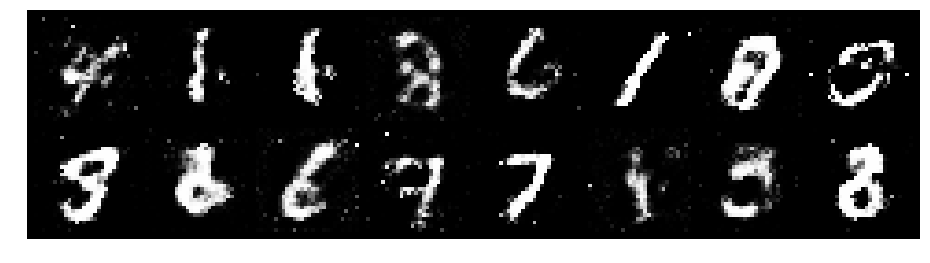

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0739, Generator Loss: 1.3154
D(x): 0.5817, D(G(z)): 0.2889


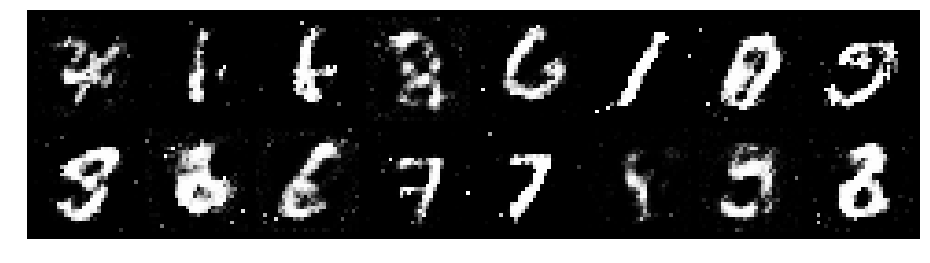

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.2351, Generator Loss: 1.4346
D(x): 0.5949, D(G(z)): 0.3771


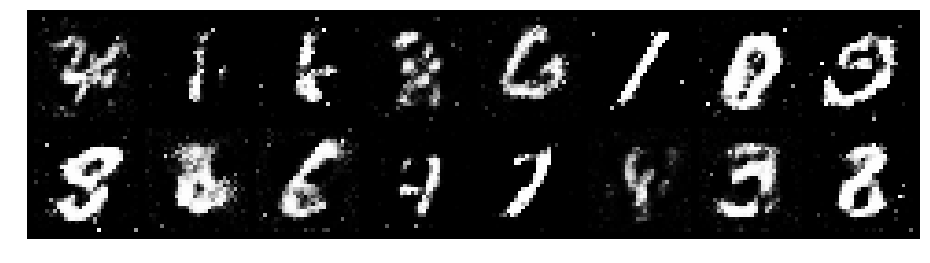

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.9340, Generator Loss: 1.1203
D(x): 0.6810, D(G(z)): 0.3355


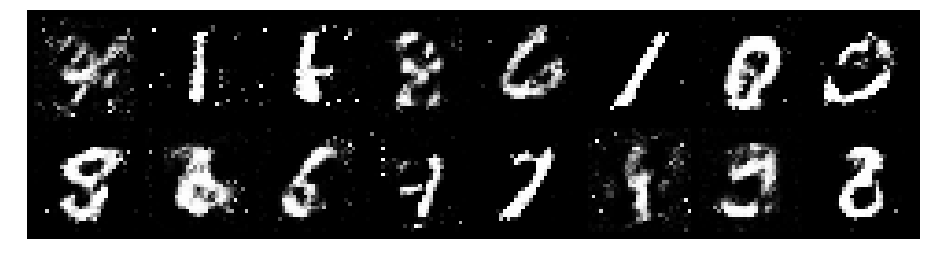

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9683, Generator Loss: 1.3174
D(x): 0.6204, D(G(z)): 0.2883


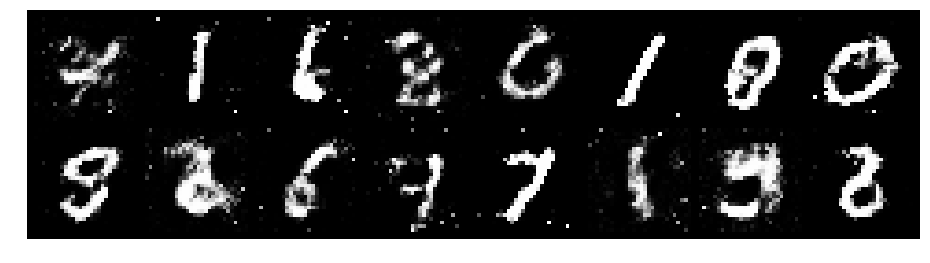

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.0634, Generator Loss: 1.3676
D(x): 0.6891, D(G(z)): 0.3727


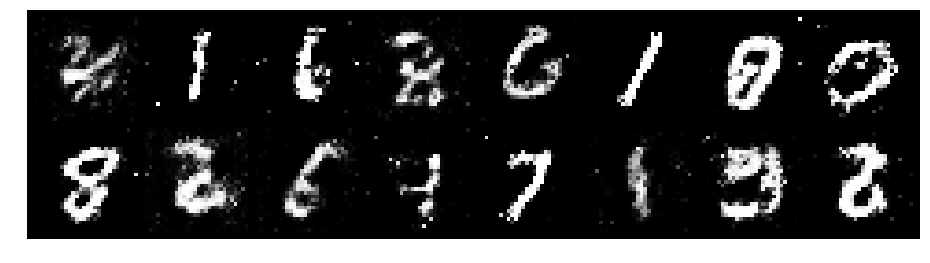

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.2217, Generator Loss: 0.9520
D(x): 0.7260, D(G(z)): 0.5048


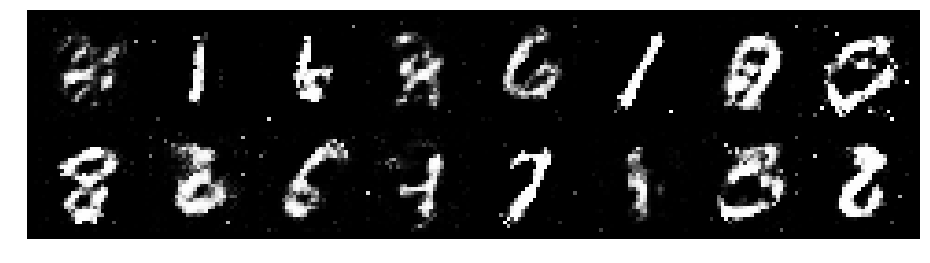

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.6768, Generator Loss: 1.7719
D(x): 0.7590, D(G(z)): 0.2558


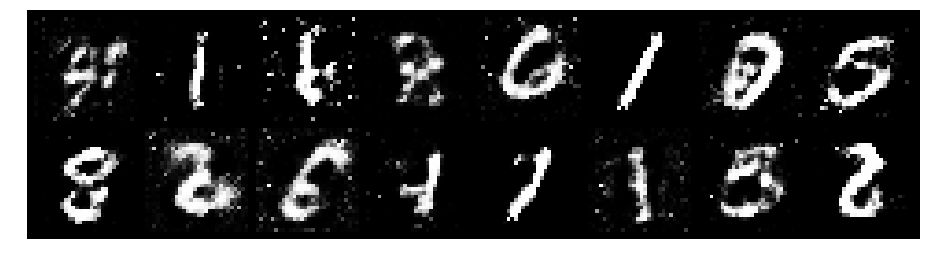

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.4261, Generator Loss: 1.2199
D(x): 0.6753, D(G(z)): 0.5158


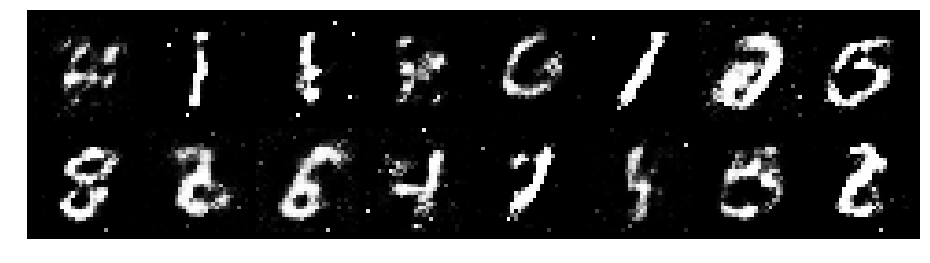

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9252, Generator Loss: 1.3331
D(x): 0.7837, D(G(z)): 0.3908


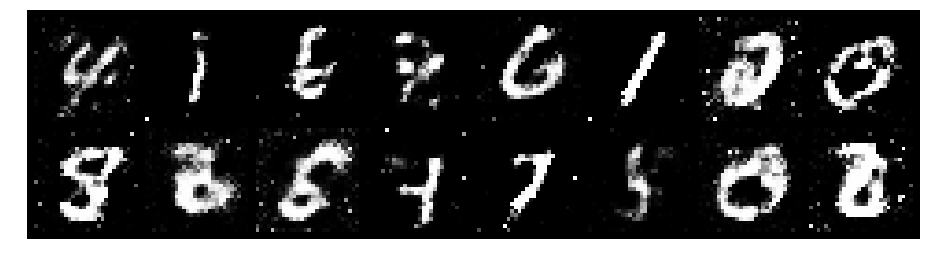

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9914, Generator Loss: 1.5388
D(x): 0.6709, D(G(z)): 0.3261


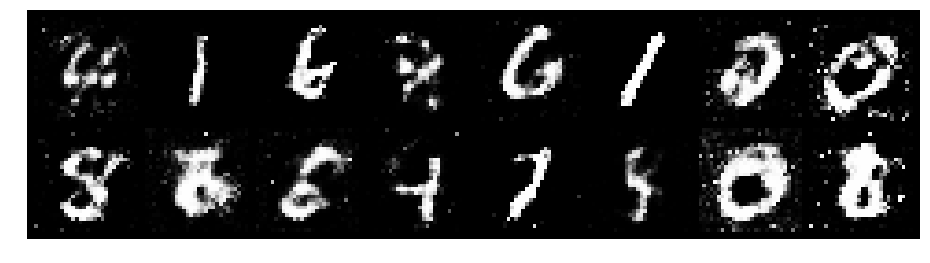

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0744, Generator Loss: 1.3964
D(x): 0.6786, D(G(z)): 0.3878


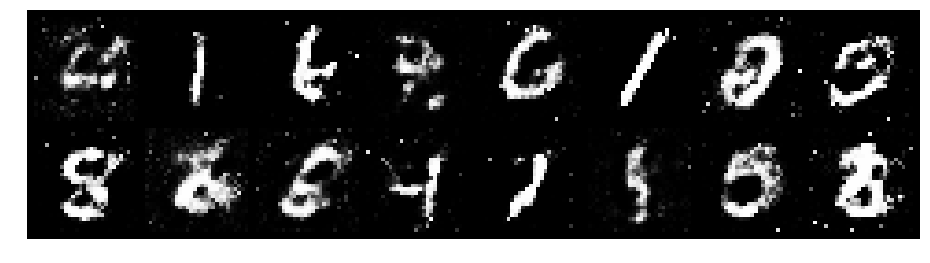

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.1978, Generator Loss: 1.2200
D(x): 0.6670, D(G(z)): 0.4327


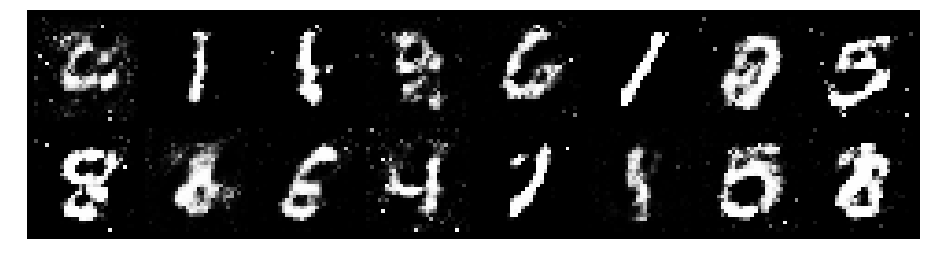

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9822, Generator Loss: 1.1946
D(x): 0.7307, D(G(z)): 0.4133


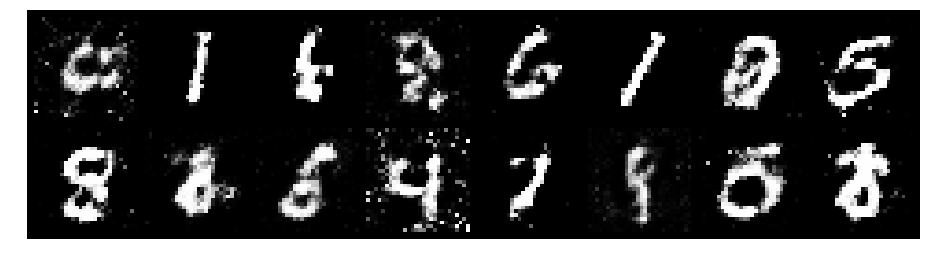

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0399, Generator Loss: 1.3409
D(x): 0.7129, D(G(z)): 0.3893


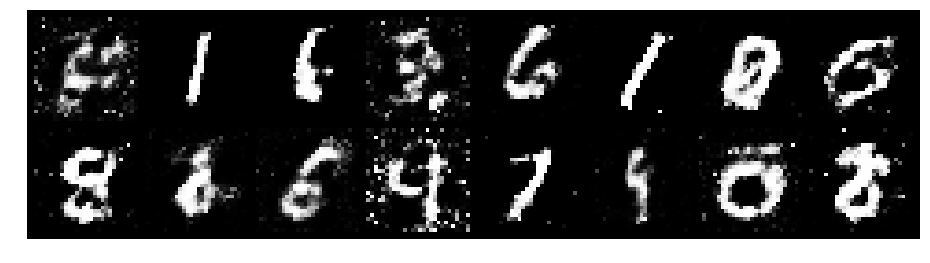

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.9077, Generator Loss: 1.3993
D(x): 0.7425, D(G(z)): 0.3511


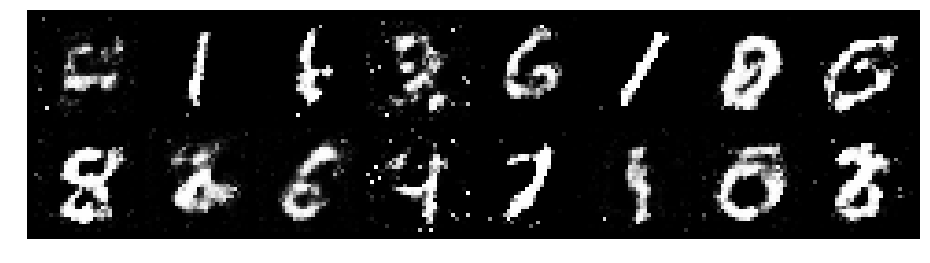

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.1394, Generator Loss: 1.4962
D(x): 0.7239, D(G(z)): 0.4265


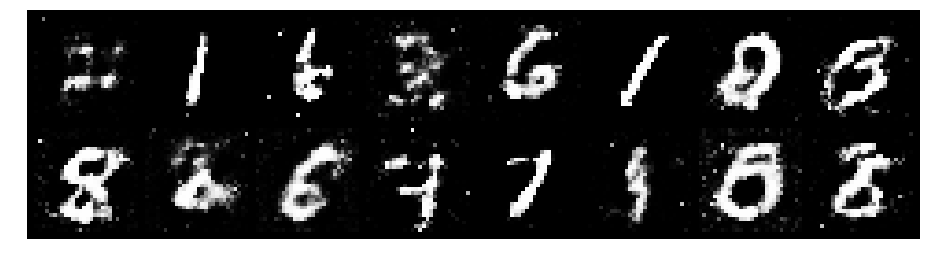

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1065, Generator Loss: 1.5280
D(x): 0.5976, D(G(z)): 0.2874


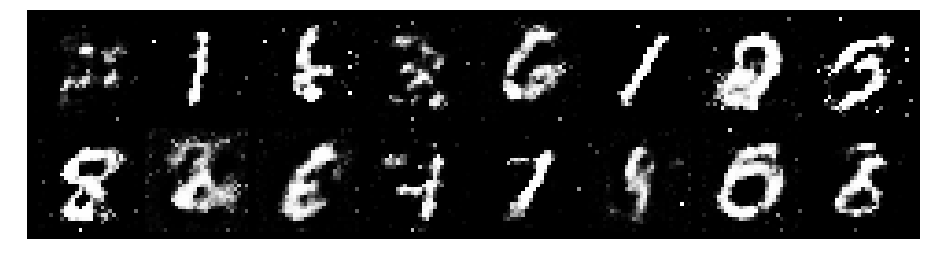

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.1646, Generator Loss: 1.5661
D(x): 0.6146, D(G(z)): 0.3401


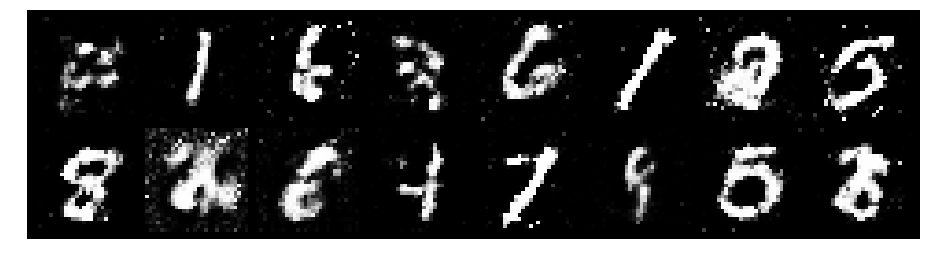

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 0.8186, Generator Loss: 1.4880
D(x): 0.7014, D(G(z)): 0.2916


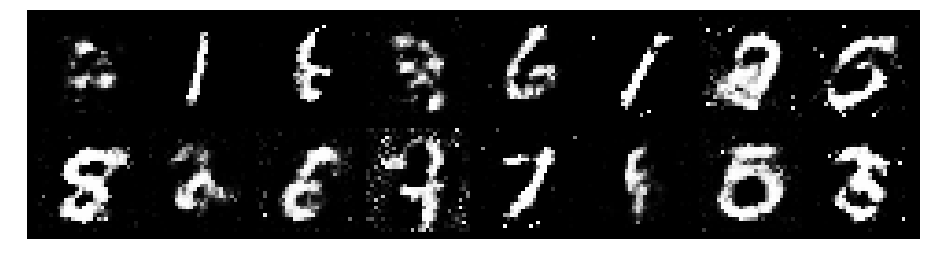

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 0.9827, Generator Loss: 1.2778
D(x): 0.6801, D(G(z)): 0.3492


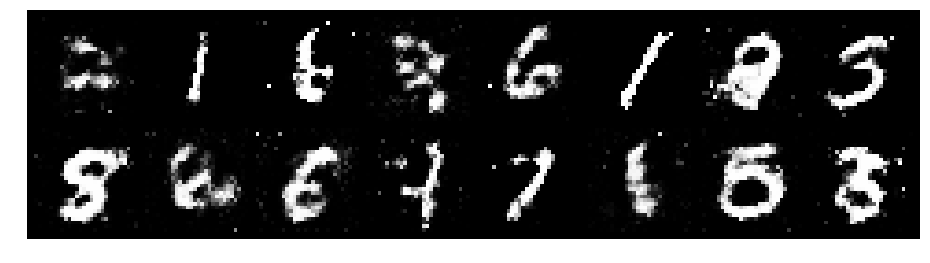

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0135, Generator Loss: 1.5820
D(x): 0.5637, D(G(z)): 0.2336


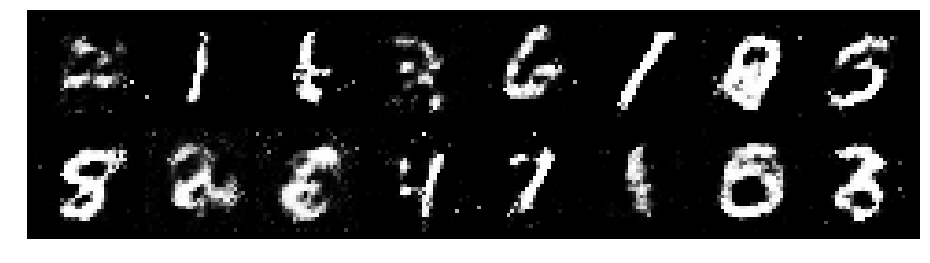

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.9245, Generator Loss: 1.3354
D(x): 0.6417, D(G(z)): 0.2884


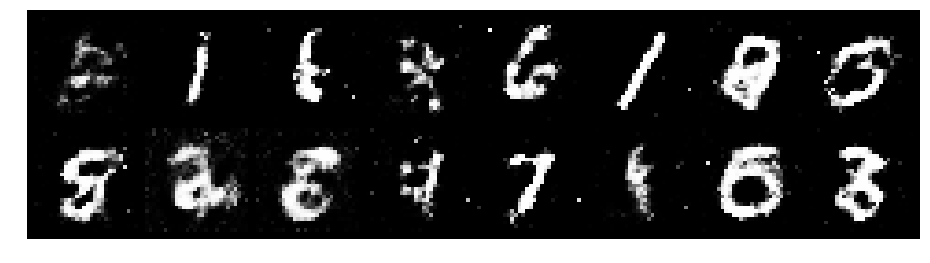

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.0249, Generator Loss: 1.3761
D(x): 0.6206, D(G(z)): 0.2824


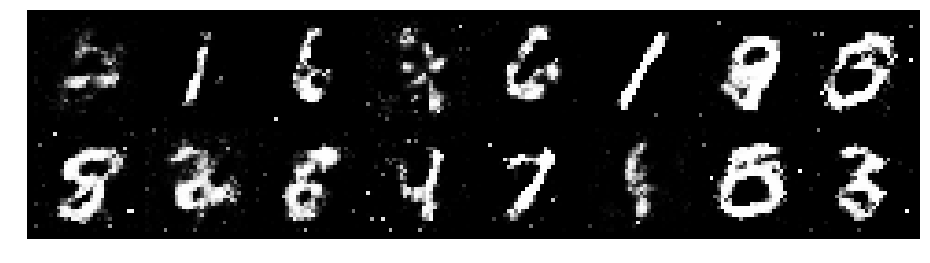

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.9624, Generator Loss: 1.6137
D(x): 0.6201, D(G(z)): 0.3009


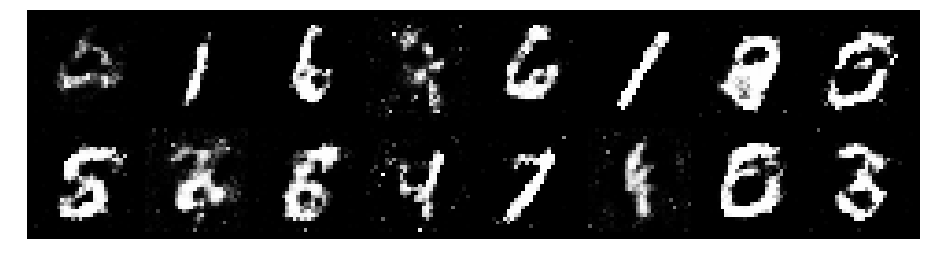

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.8418, Generator Loss: 1.7306
D(x): 0.7295, D(G(z)): 0.3147


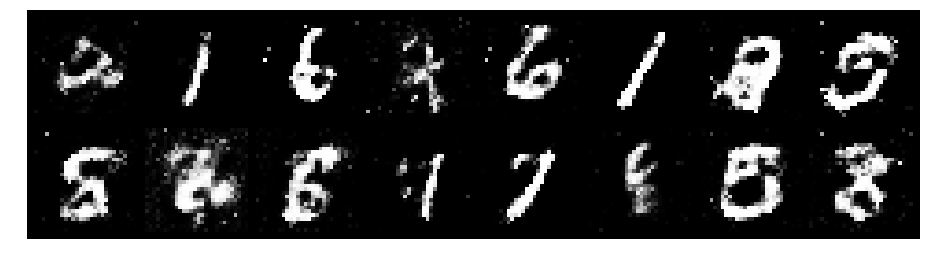

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.7282, Generator Loss: 1.7678
D(x): 0.7605, D(G(z)): 0.2767


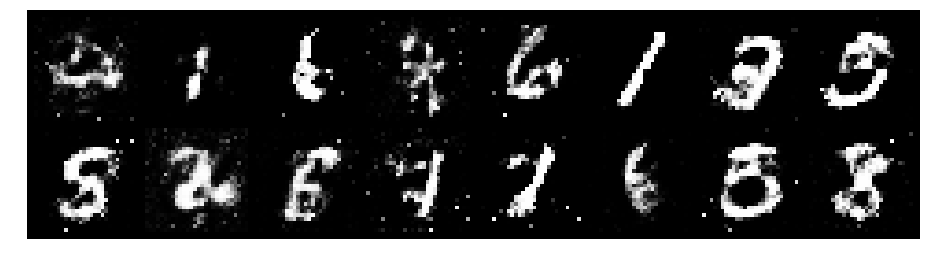

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9809, Generator Loss: 1.0555
D(x): 0.6896, D(G(z)): 0.3660


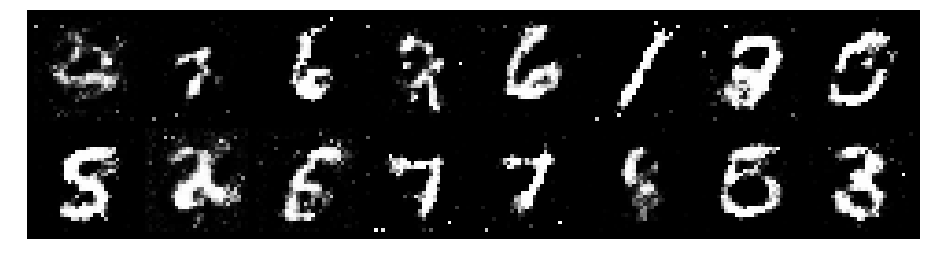

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.1102, Generator Loss: 1.1890
D(x): 0.5726, D(G(z)): 0.3758


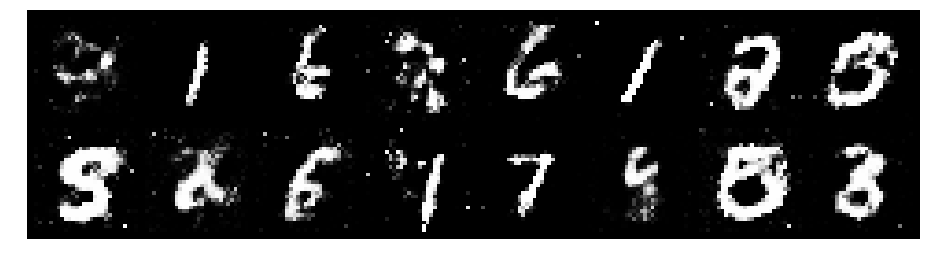

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.9780, Generator Loss: 1.3876
D(x): 0.6741, D(G(z)): 0.3474


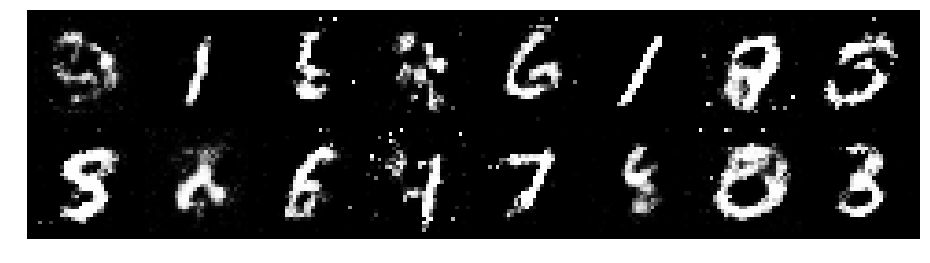

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 0.9966, Generator Loss: 1.2183
D(x): 0.6919, D(G(z)): 0.3826


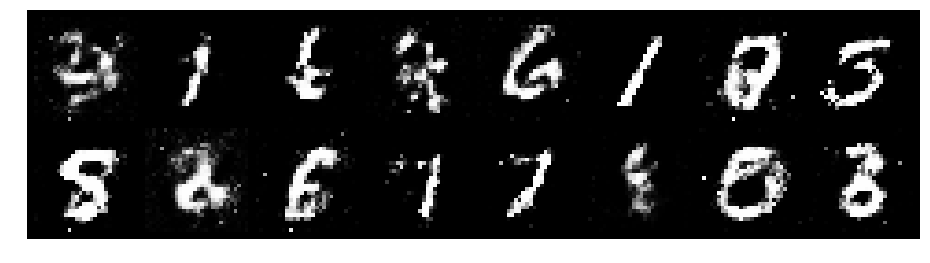

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.9622, Generator Loss: 1.3560
D(x): 0.6462, D(G(z)): 0.3217


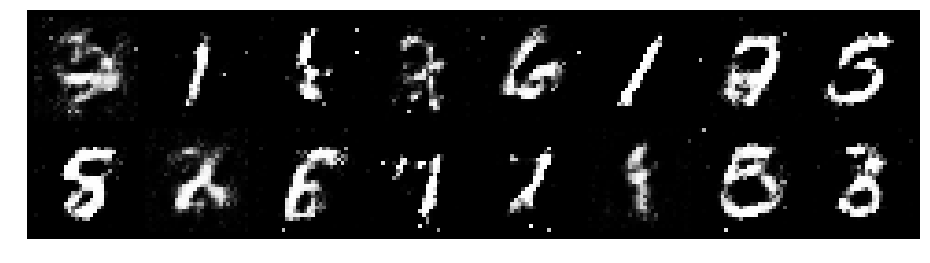

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0552, Generator Loss: 1.1509
D(x): 0.6312, D(G(z)): 0.3376


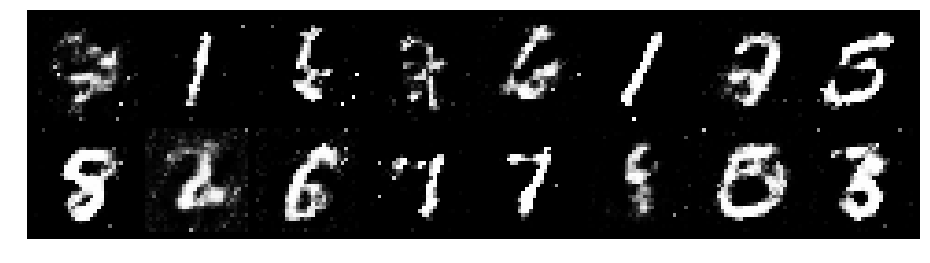

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.1410, Generator Loss: 1.4487
D(x): 0.6342, D(G(z)): 0.3477


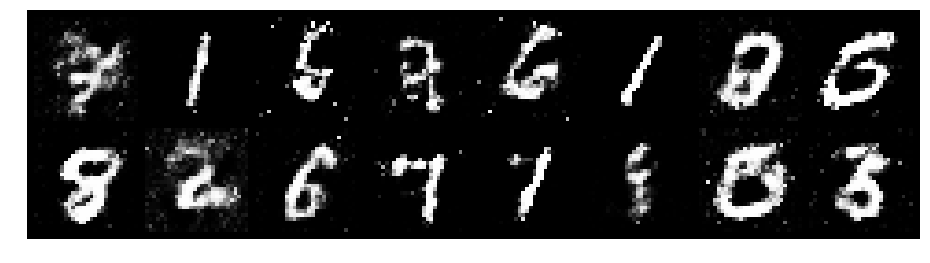

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0672, Generator Loss: 1.1057
D(x): 0.6824, D(G(z)): 0.4180


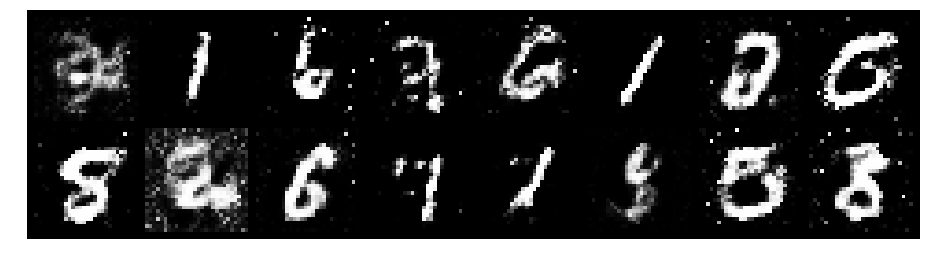

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.1649, Generator Loss: 0.9908
D(x): 0.6094, D(G(z)): 0.4074


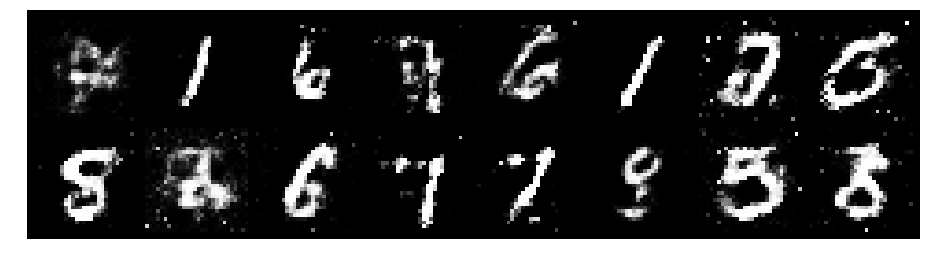

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.9609, Generator Loss: 1.2690
D(x): 0.6684, D(G(z)): 0.3550


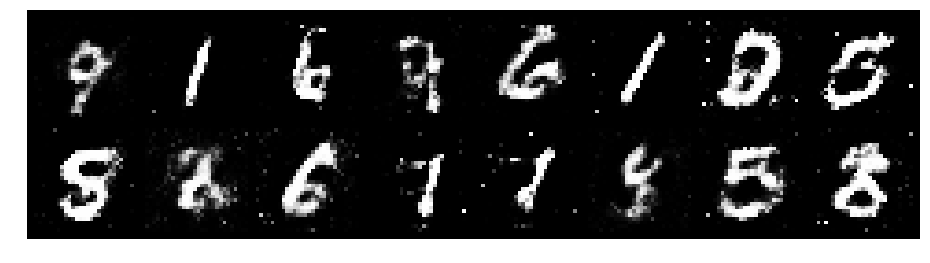

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0293, Generator Loss: 1.4620
D(x): 0.5821, D(G(z)): 0.2615


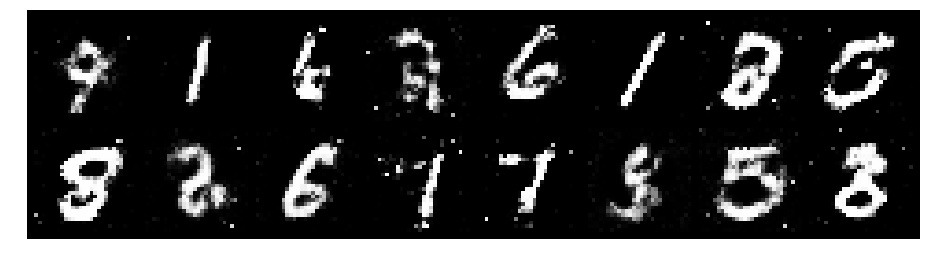

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0548, Generator Loss: 1.3918
D(x): 0.5890, D(G(z)): 0.3051


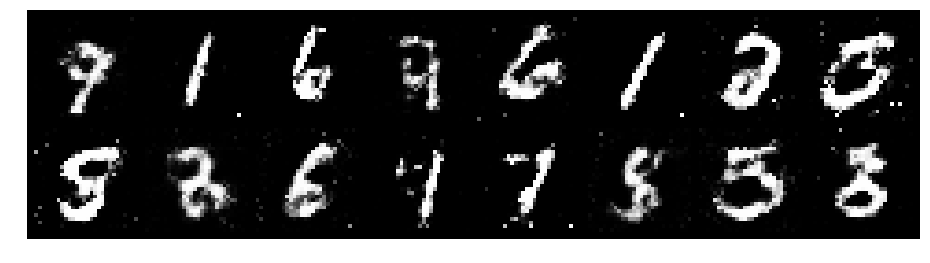

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0109, Generator Loss: 1.3737
D(x): 0.6639, D(G(z)): 0.3646


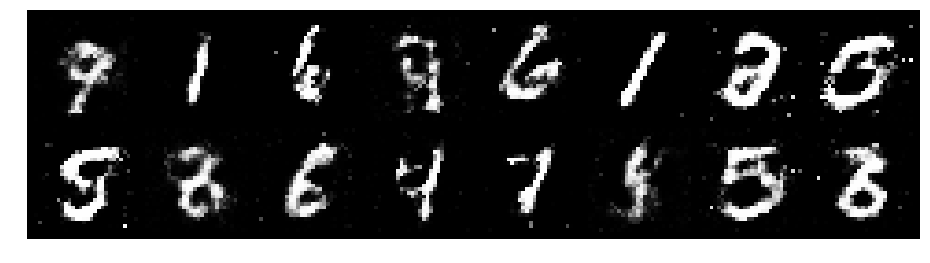

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0833, Generator Loss: 1.1904
D(x): 0.6324, D(G(z)): 0.3417


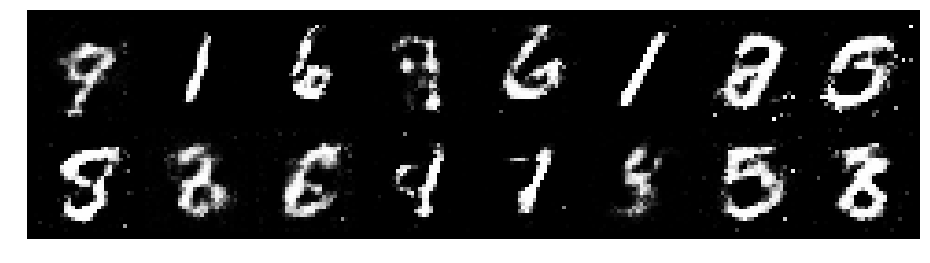

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0188, Generator Loss: 1.2842
D(x): 0.6880, D(G(z)): 0.3834


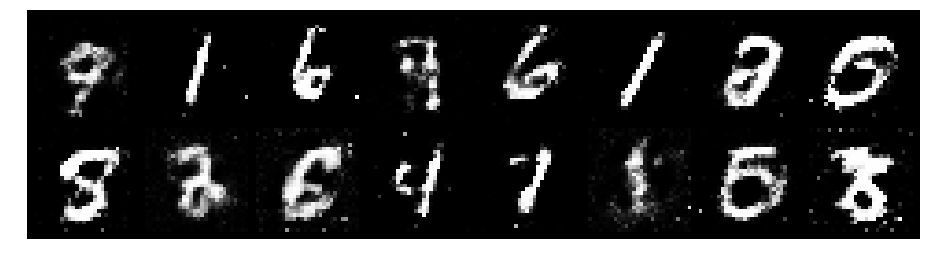

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 0.9568, Generator Loss: 1.4405
D(x): 0.6975, D(G(z)): 0.3518


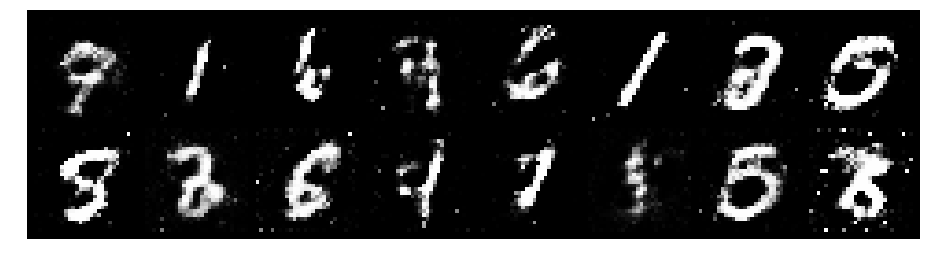

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 0.9555, Generator Loss: 1.1260
D(x): 0.6486, D(G(z)): 0.3411


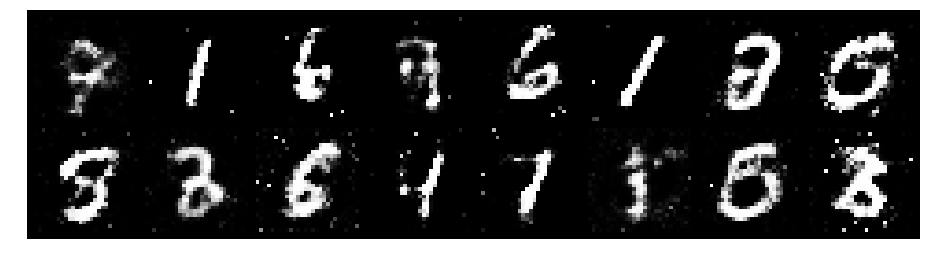

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0546, Generator Loss: 1.2365
D(x): 0.6549, D(G(z)): 0.3670


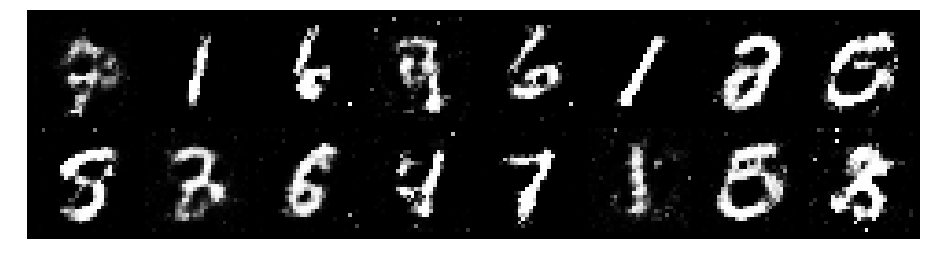

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1519, Generator Loss: 1.3963
D(x): 0.5875, D(G(z)): 0.3356


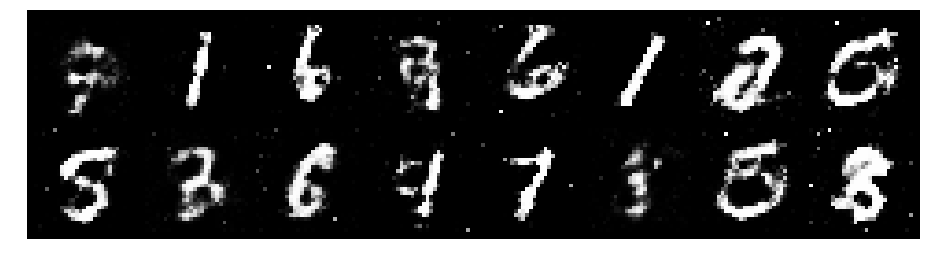

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1834, Generator Loss: 1.2434
D(x): 0.5447, D(G(z)): 0.3143


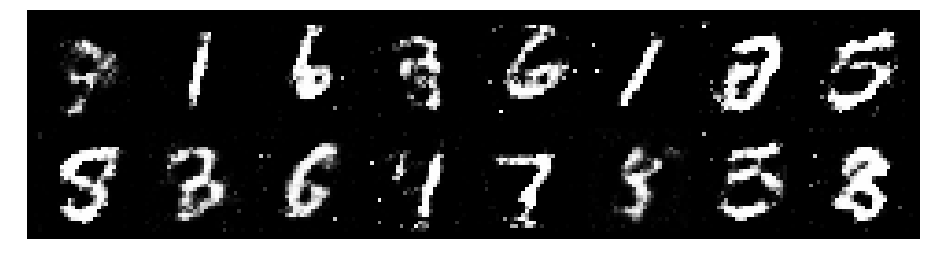

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1162, Generator Loss: 1.1615
D(x): 0.6157, D(G(z)): 0.3578


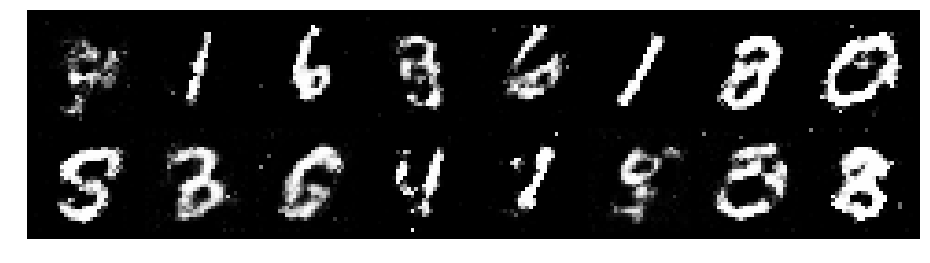

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.1197, Generator Loss: 1.3829
D(x): 0.6335, D(G(z)): 0.3727


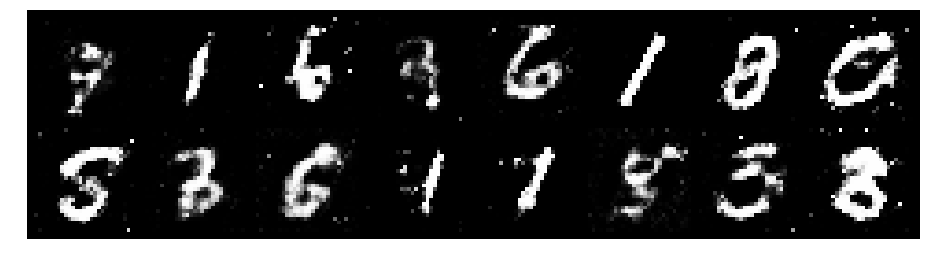

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 0.9916, Generator Loss: 1.1766
D(x): 0.6385, D(G(z)): 0.3299


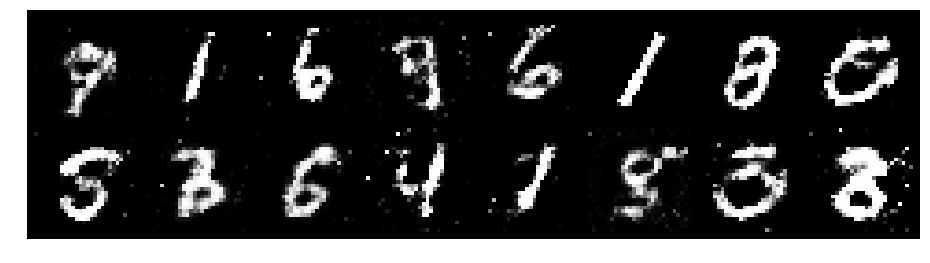

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1423, Generator Loss: 1.6512
D(x): 0.5959, D(G(z)): 0.3415


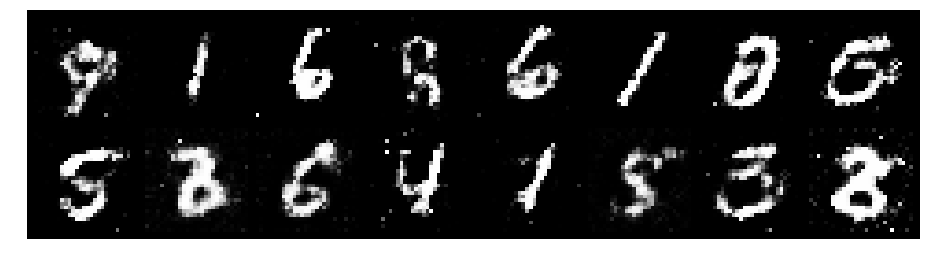

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.0195, Generator Loss: 1.2862
D(x): 0.6861, D(G(z)): 0.3971


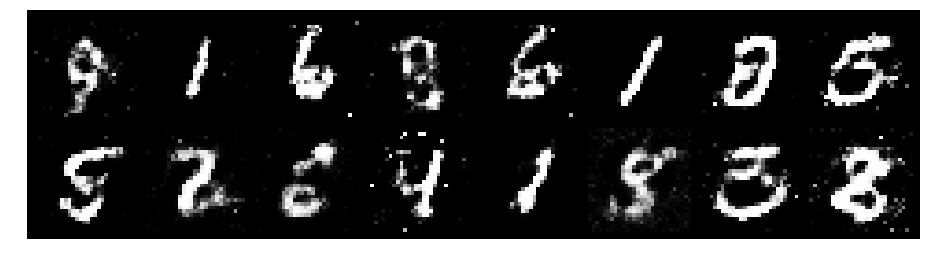

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.2120, Generator Loss: 1.0472
D(x): 0.6015, D(G(z)): 0.3852


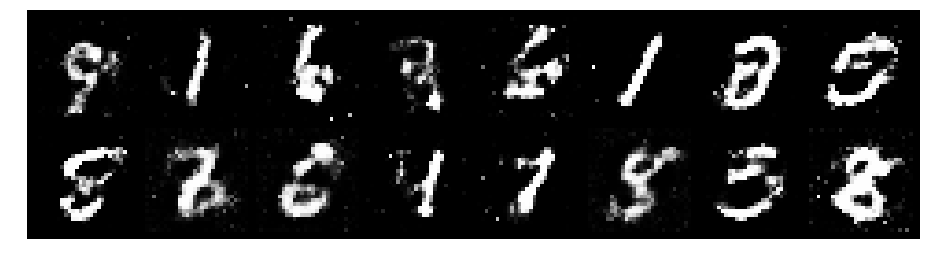

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1219, Generator Loss: 1.1298
D(x): 0.5917, D(G(z)): 0.3538


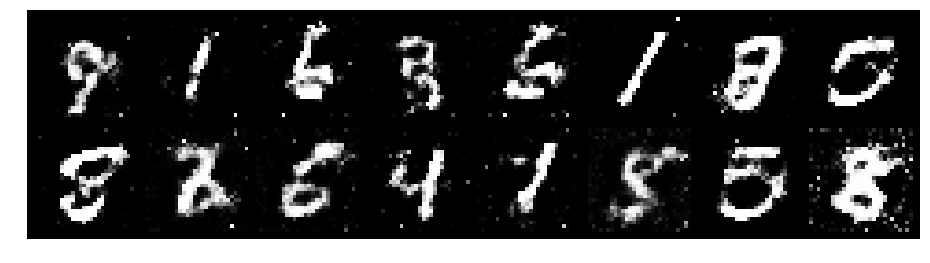

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0426, Generator Loss: 1.0826
D(x): 0.6874, D(G(z)): 0.4024


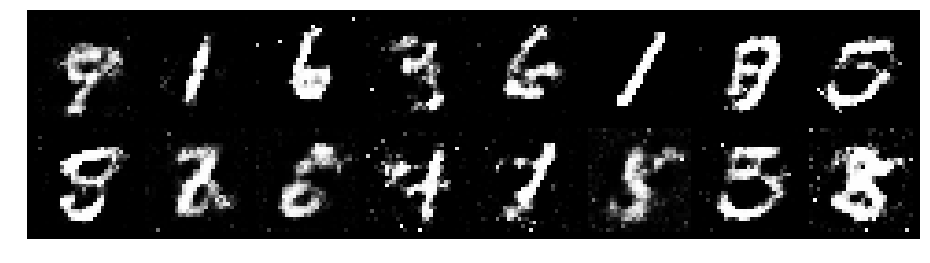

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 0.9972, Generator Loss: 1.4392
D(x): 0.6242, D(G(z)): 0.3087


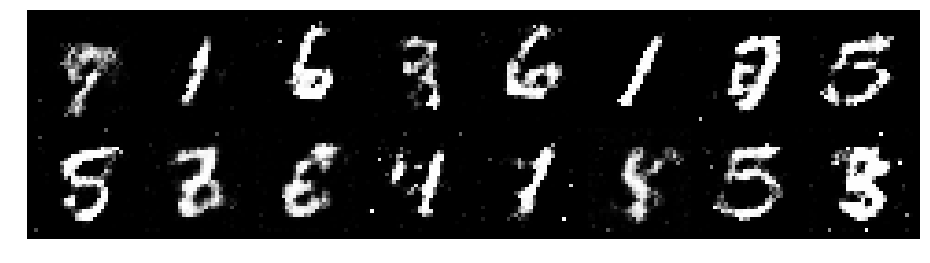

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.8740, Generator Loss: 1.8227
D(x): 0.7098, D(G(z)): 0.3073


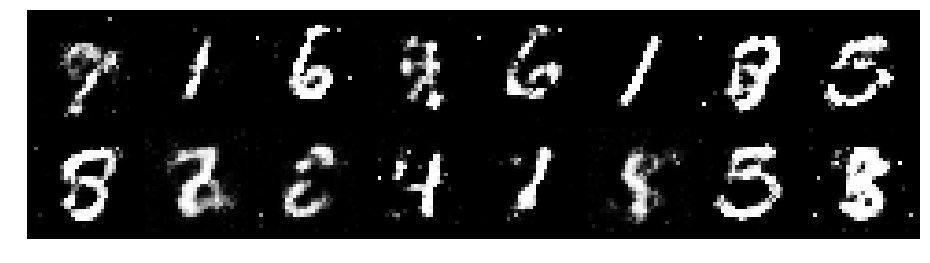

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.0410, Generator Loss: 1.5907
D(x): 0.6147, D(G(z)): 0.2783


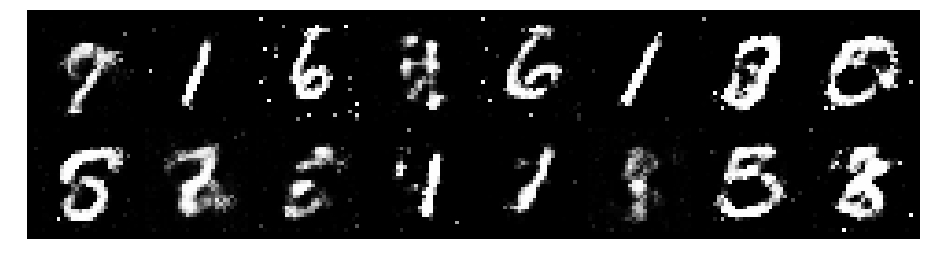

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.0886, Generator Loss: 1.3200
D(x): 0.6390, D(G(z)): 0.3659


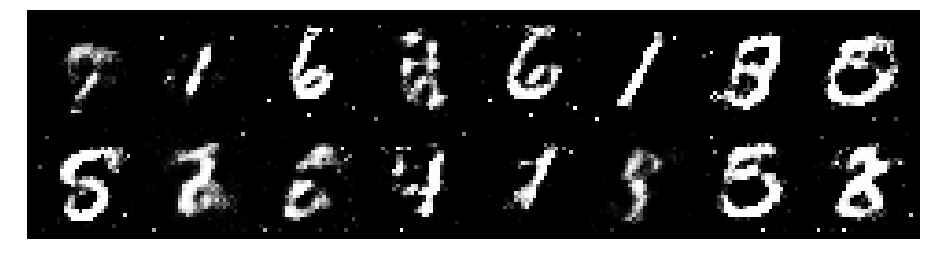

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0062, Generator Loss: 1.6560
D(x): 0.6631, D(G(z)): 0.3356


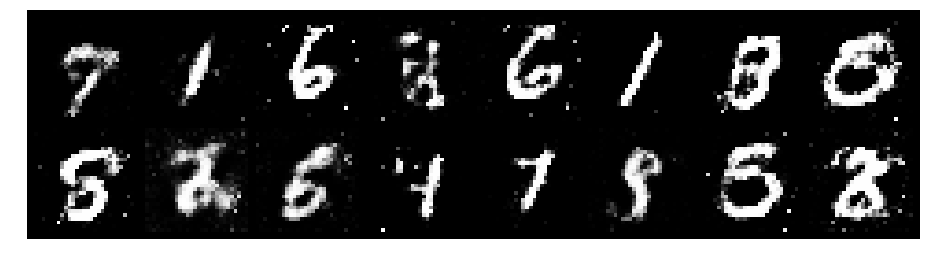

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 0.9903, Generator Loss: 1.0752
D(x): 0.6617, D(G(z)): 0.3471


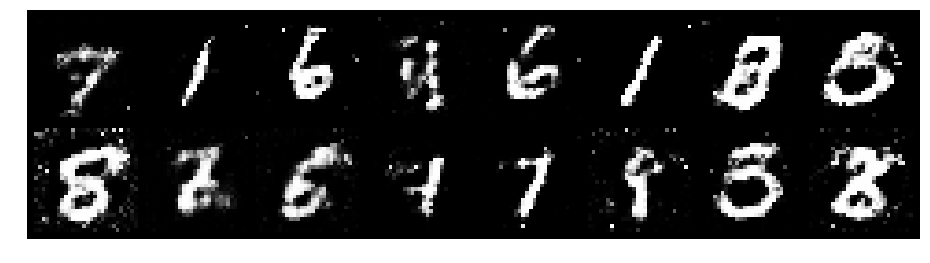

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.1415, Generator Loss: 1.2791
D(x): 0.6132, D(G(z)): 0.3713


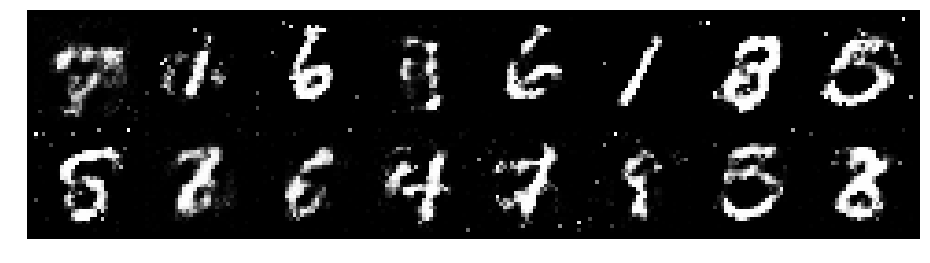

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1401, Generator Loss: 0.9283
D(x): 0.6190, D(G(z)): 0.4003


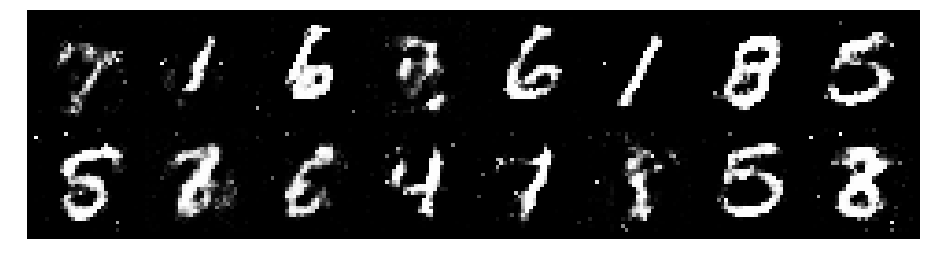

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1540, Generator Loss: 1.8927
D(x): 0.6419, D(G(z)): 0.3647


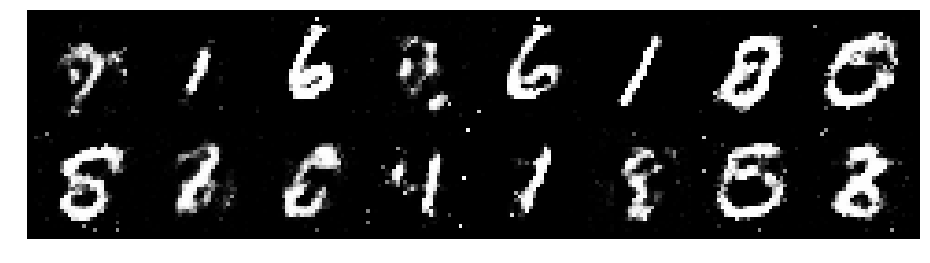

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 0.8988, Generator Loss: 1.1960
D(x): 0.7048, D(G(z)): 0.3326


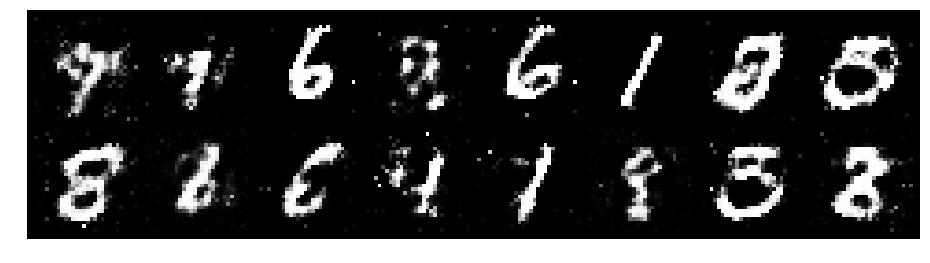

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.2146, Generator Loss: 1.0237
D(x): 0.7094, D(G(z)): 0.4432


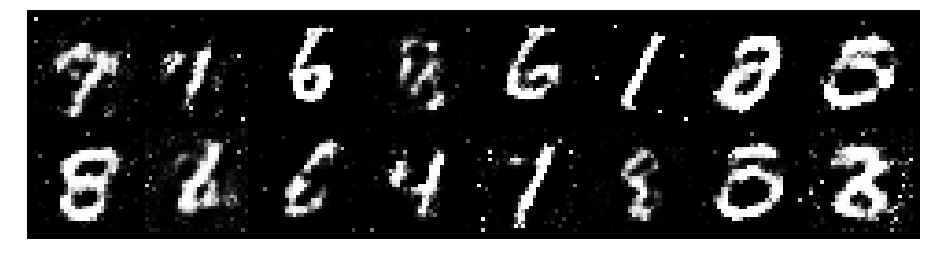

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1711, Generator Loss: 1.3088
D(x): 0.6490, D(G(z)): 0.4149


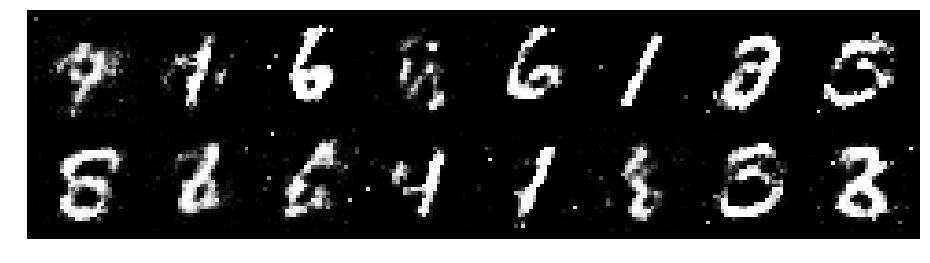

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.1741, Generator Loss: 1.2964
D(x): 0.5811, D(G(z)): 0.3286


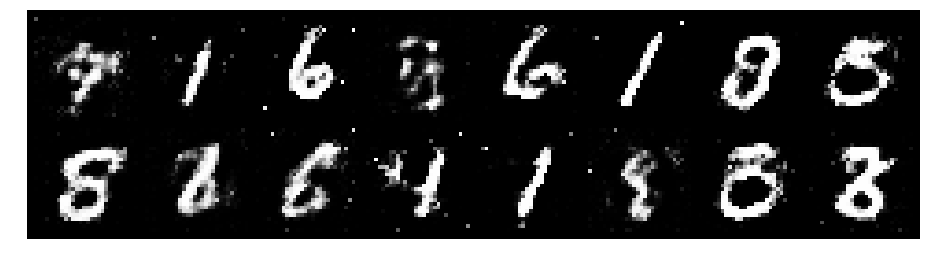

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1333, Generator Loss: 1.2268
D(x): 0.6167, D(G(z)): 0.3615


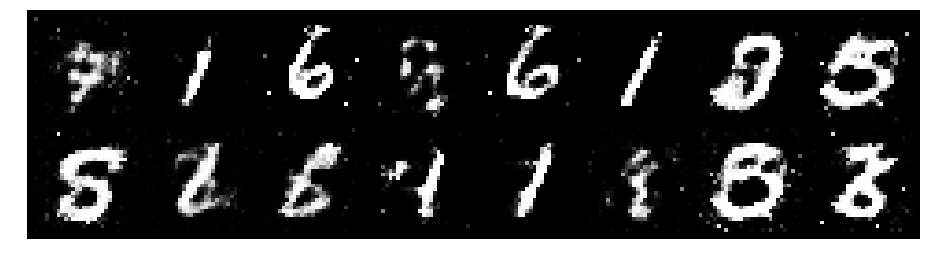

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1989, Generator Loss: 1.0424
D(x): 0.6837, D(G(z)): 0.4647


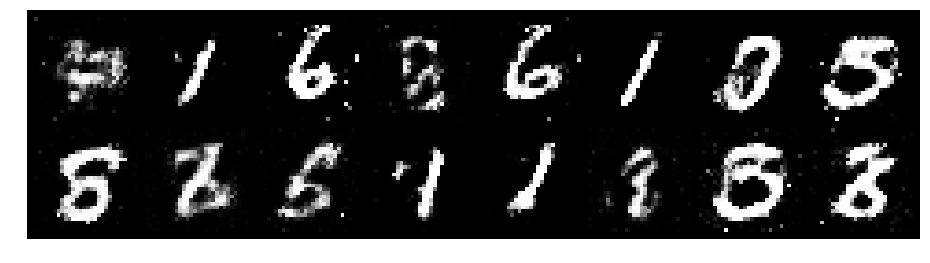

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.2007, Generator Loss: 1.3743
D(x): 0.5422, D(G(z)): 0.3050


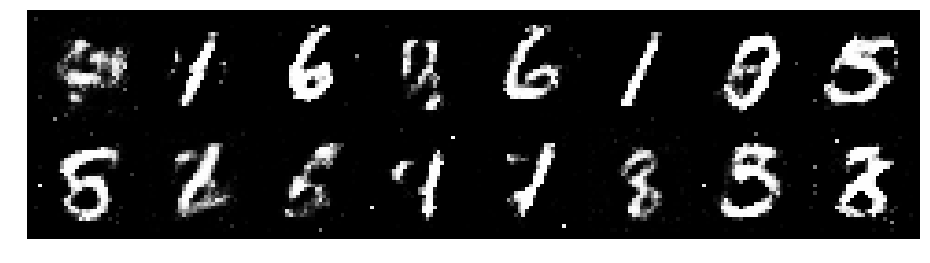

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.2007, Generator Loss: 1.1018
D(x): 0.5824, D(G(z)): 0.3687


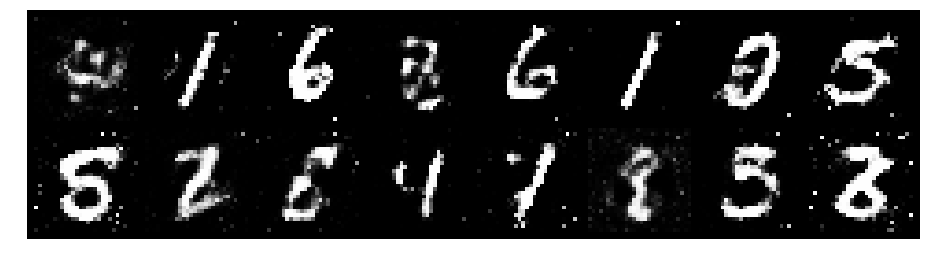

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.0663, Generator Loss: 1.1742
D(x): 0.6610, D(G(z)): 0.3800


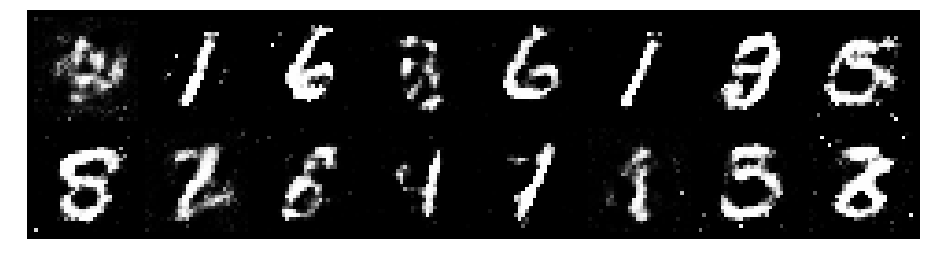

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.0992, Generator Loss: 1.1868
D(x): 0.6342, D(G(z)): 0.3779


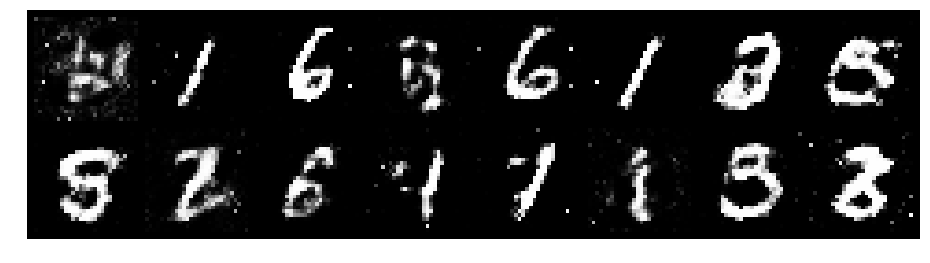

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0708, Generator Loss: 1.0202
D(x): 0.6758, D(G(z)): 0.3942


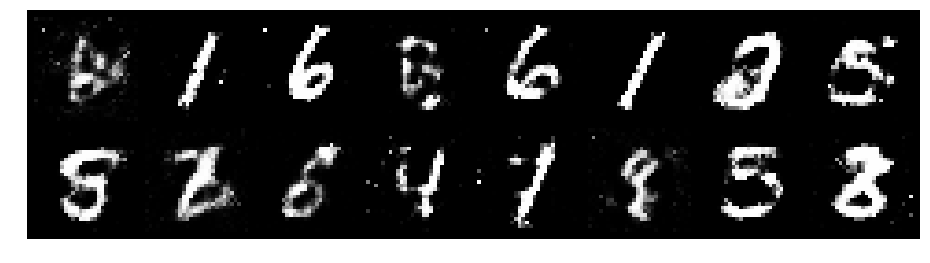

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 0.9279, Generator Loss: 1.0605
D(x): 0.6610, D(G(z)): 0.3205


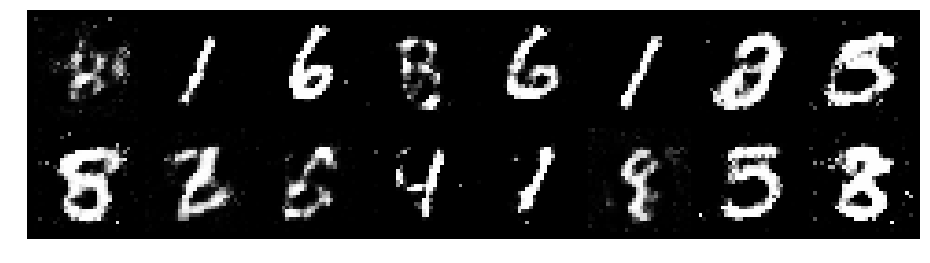

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0532, Generator Loss: 1.1476
D(x): 0.6235, D(G(z)): 0.3397


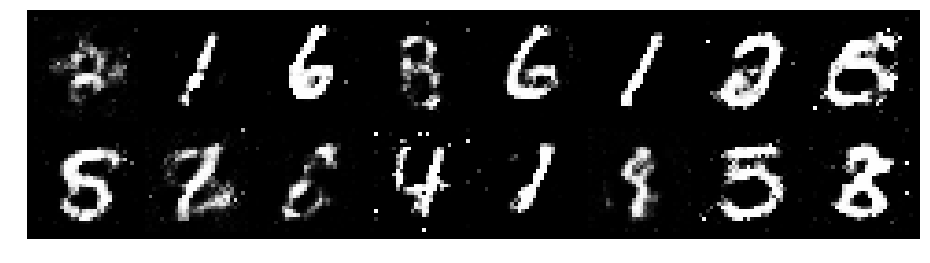

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.1400, Generator Loss: 1.1502
D(x): 0.6076, D(G(z)): 0.3989


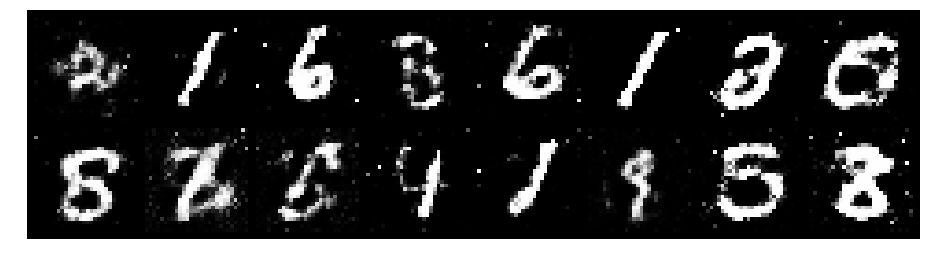

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0717, Generator Loss: 1.2091
D(x): 0.6817, D(G(z)): 0.4013


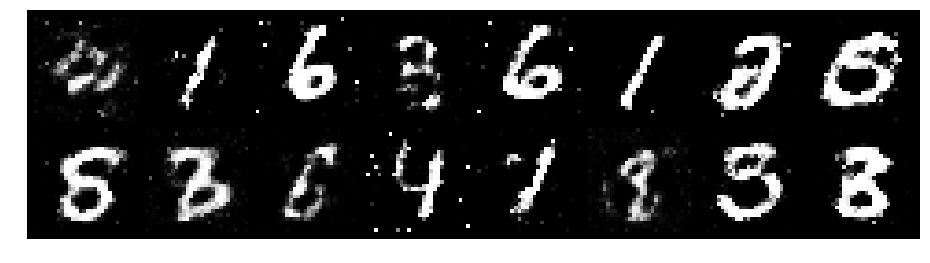

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.2025, Generator Loss: 1.1136
D(x): 0.5841, D(G(z)): 0.4008


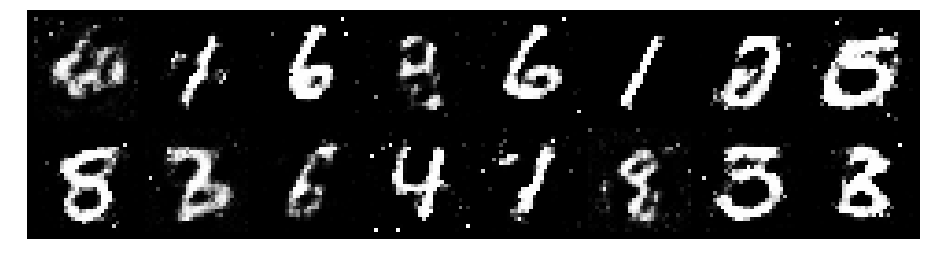

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.0359, Generator Loss: 1.1186
D(x): 0.5826, D(G(z)): 0.3178


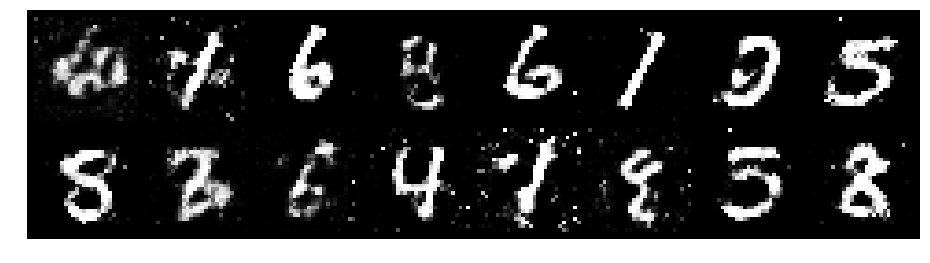

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0498, Generator Loss: 1.0538
D(x): 0.6022, D(G(z)): 0.3480


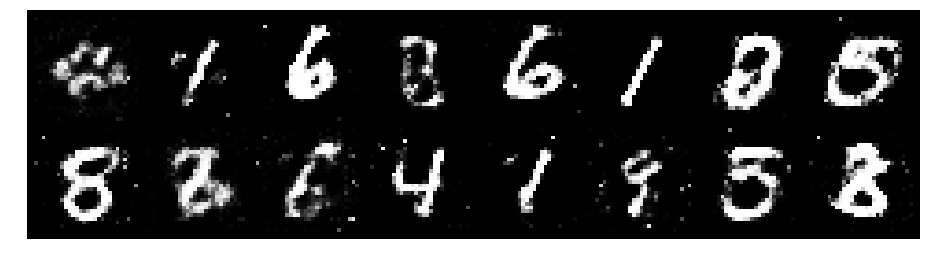

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.0844, Generator Loss: 1.4258
D(x): 0.6101, D(G(z)): 0.3525


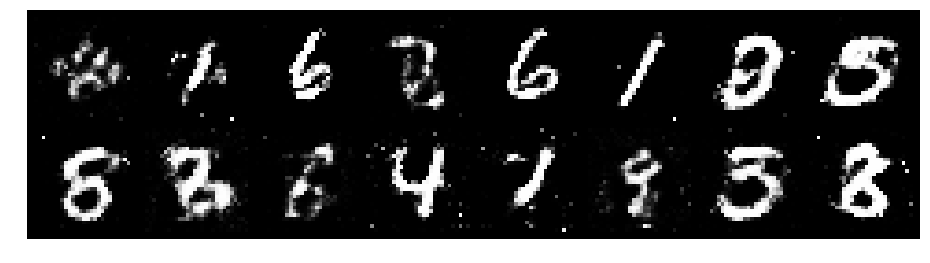

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.0251, Generator Loss: 1.3503
D(x): 0.6745, D(G(z)): 0.3758


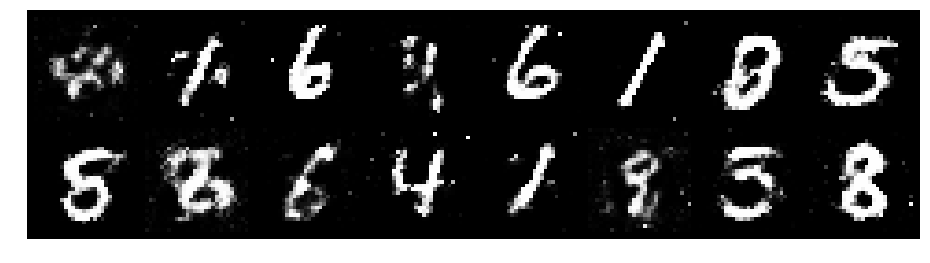

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1347, Generator Loss: 1.0282
D(x): 0.6161, D(G(z)): 0.4167


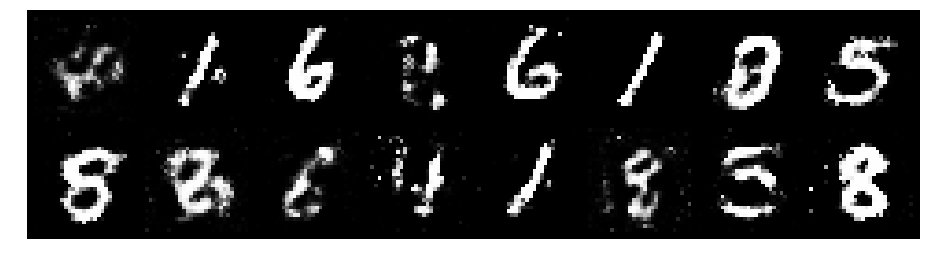

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1304, Generator Loss: 0.9529
D(x): 0.6224, D(G(z)): 0.4155


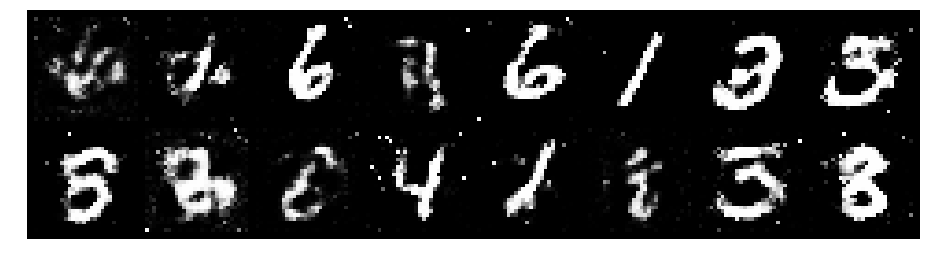

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1319, Generator Loss: 1.0665
D(x): 0.6049, D(G(z)): 0.3881


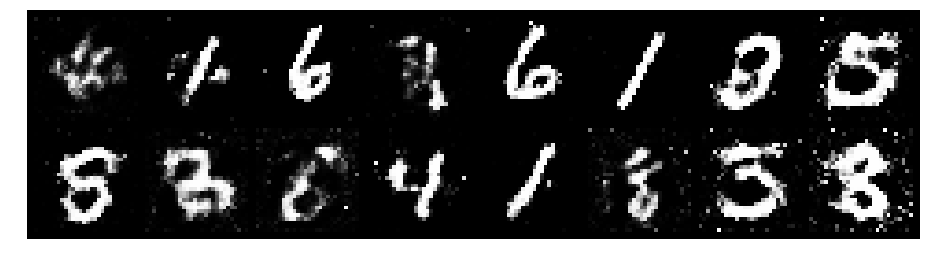

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2417, Generator Loss: 0.8366
D(x): 0.5961, D(G(z)): 0.4478


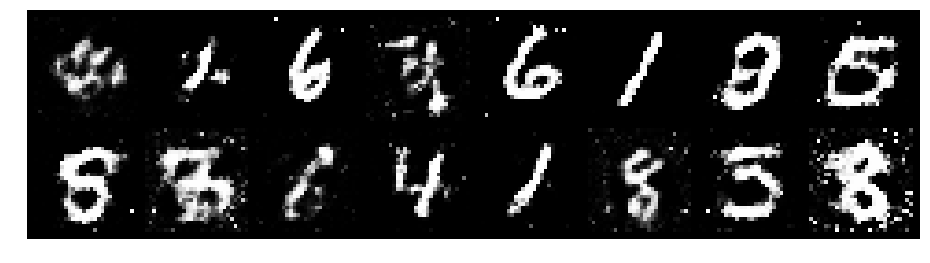

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2907, Generator Loss: 0.8049
D(x): 0.6586, D(G(z)): 0.5045


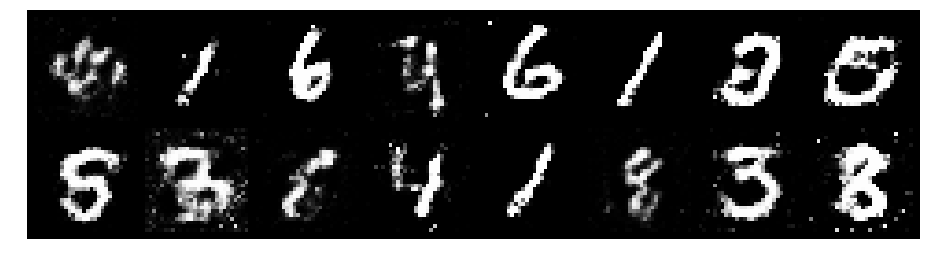

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.0991, Generator Loss: 1.0588
D(x): 0.6939, D(G(z)): 0.4419


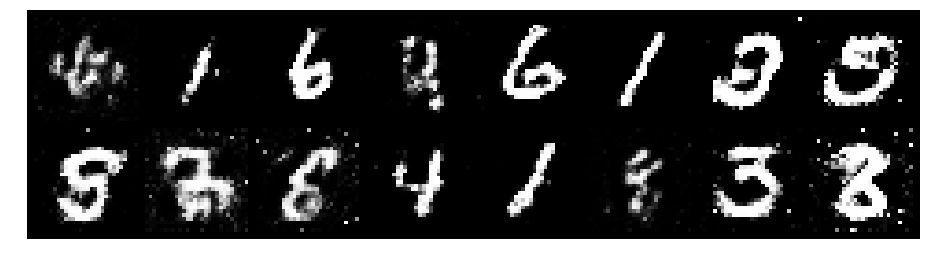

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1289, Generator Loss: 0.9836
D(x): 0.6468, D(G(z)): 0.4477


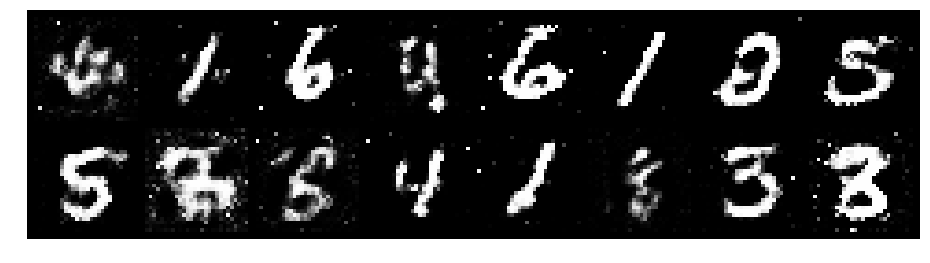

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.2607, Generator Loss: 1.0131
D(x): 0.5481, D(G(z)): 0.3948


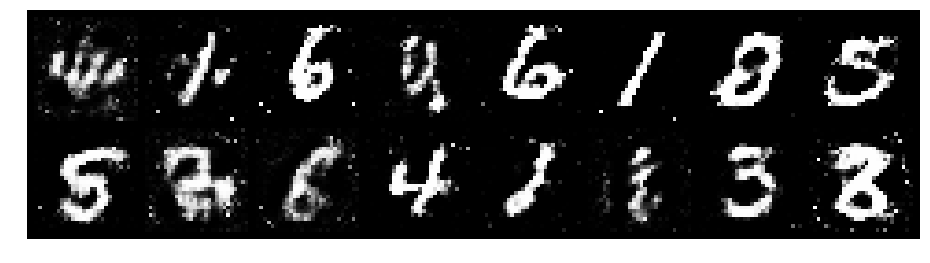

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.2284, Generator Loss: 1.0014
D(x): 0.5572, D(G(z)): 0.4143


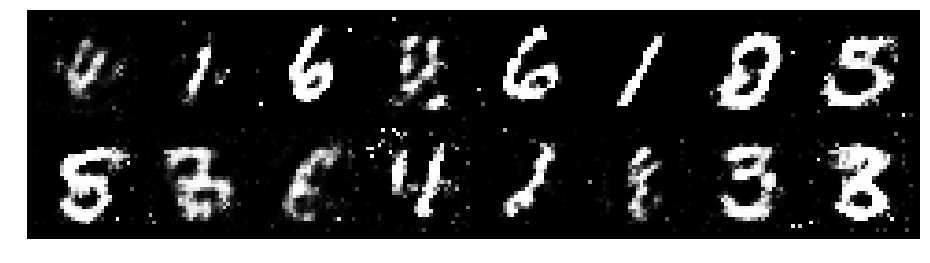

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.1477, Generator Loss: 1.1168
D(x): 0.5797, D(G(z)): 0.3702


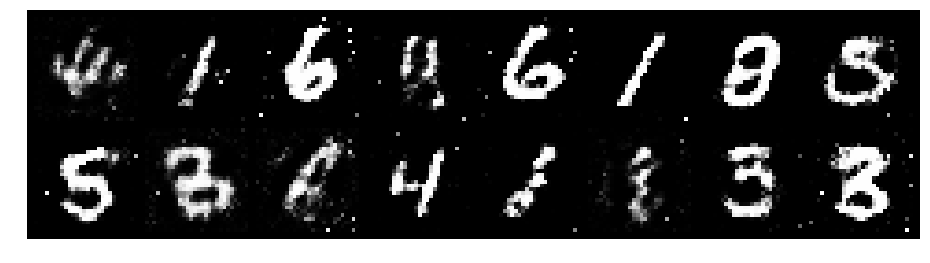

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1755, Generator Loss: 1.3741
D(x): 0.6225, D(G(z)): 0.3786


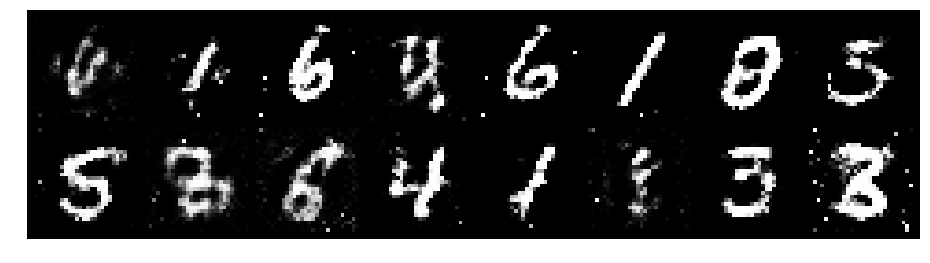

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1667, Generator Loss: 1.1741
D(x): 0.6088, D(G(z)): 0.4254


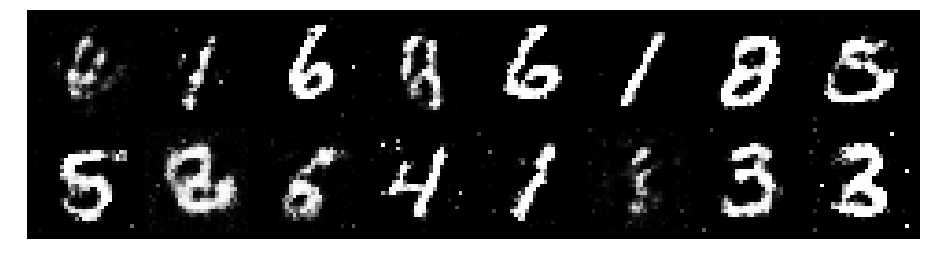

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.2081, Generator Loss: 0.8773
D(x): 0.5560, D(G(z)): 0.3877


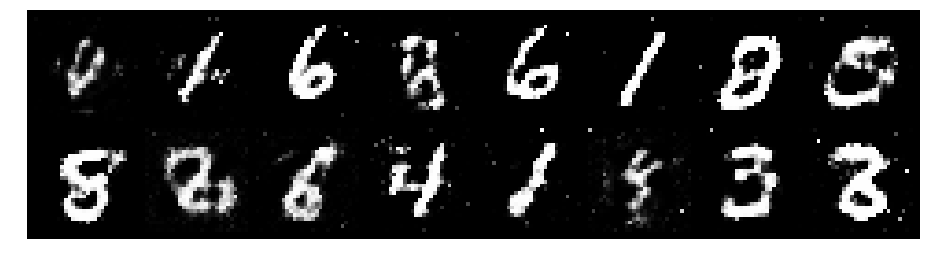

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2169, Generator Loss: 1.0897
D(x): 0.6073, D(G(z)): 0.4150


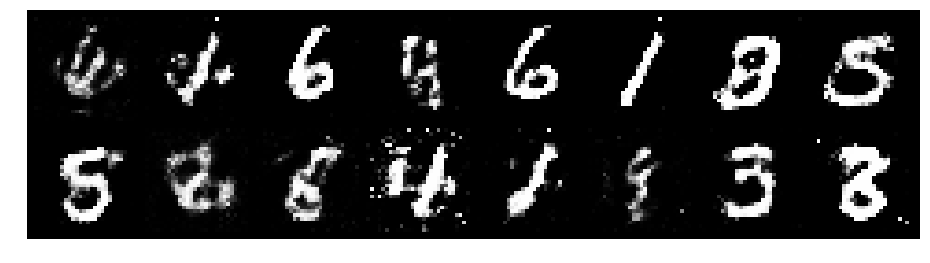

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0464, Generator Loss: 1.0115
D(x): 0.6129, D(G(z)): 0.3512


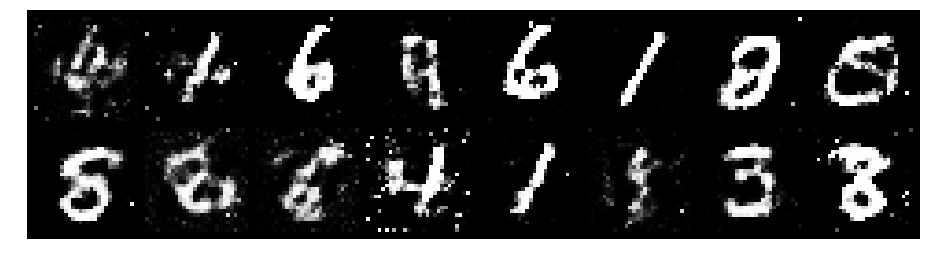

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0182, Generator Loss: 1.2221
D(x): 0.6907, D(G(z)): 0.3904


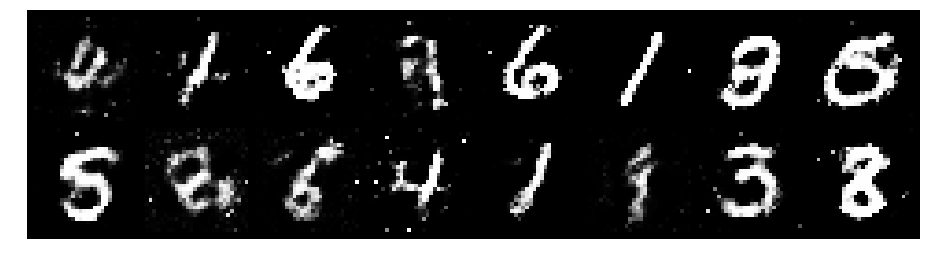

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.0641, Generator Loss: 1.2996
D(x): 0.6435, D(G(z)): 0.3605


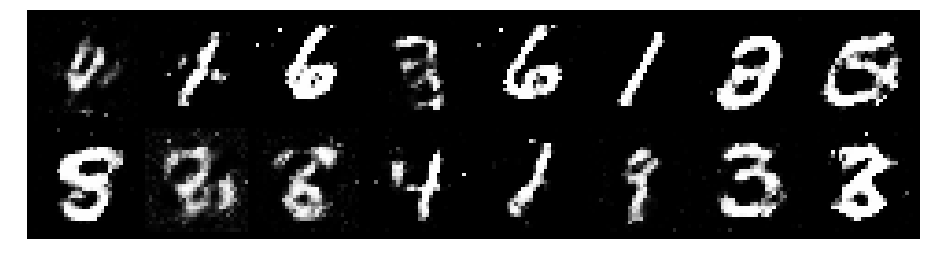

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 0.9841, Generator Loss: 1.3301
D(x): 0.5947, D(G(z)): 0.2764


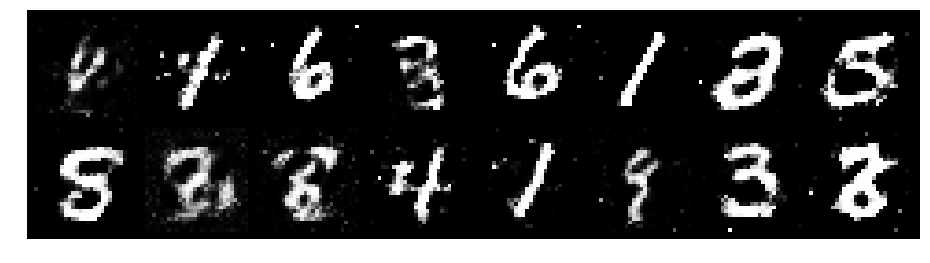

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1380, Generator Loss: 1.2045
D(x): 0.6678, D(G(z)): 0.4308


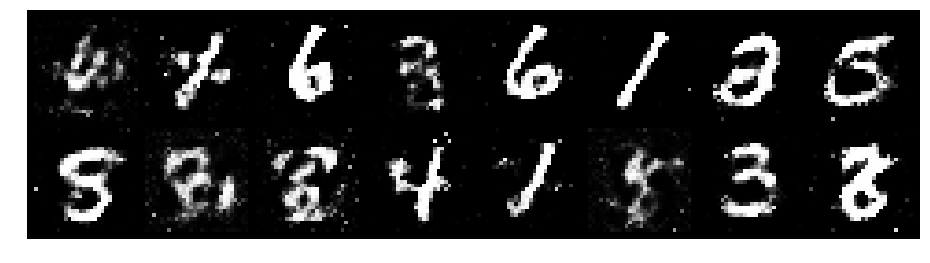

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1970, Generator Loss: 1.1818
D(x): 0.6551, D(G(z)): 0.4359


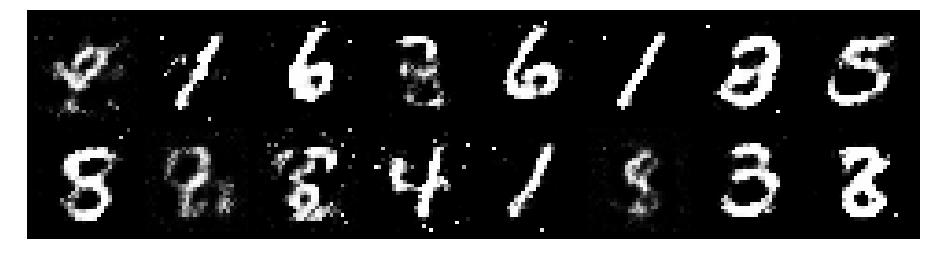

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.0186, Generator Loss: 1.1515
D(x): 0.6103, D(G(z)): 0.3188


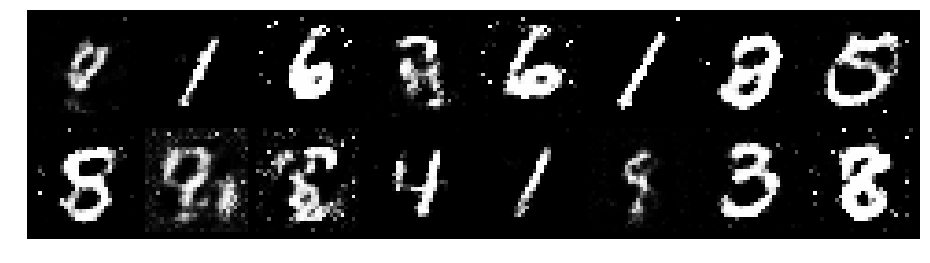

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.0352, Generator Loss: 1.1244
D(x): 0.6328, D(G(z)): 0.3508


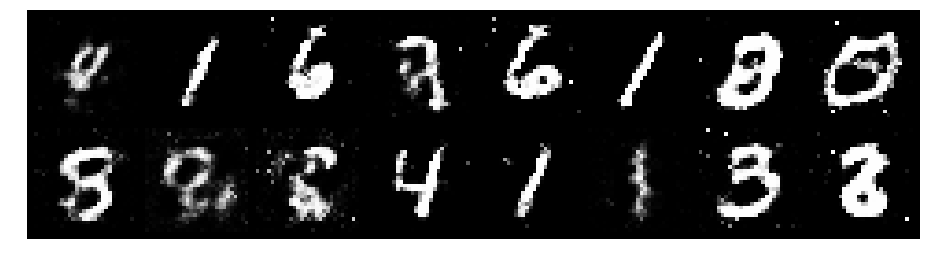

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1142, Generator Loss: 1.0774
D(x): 0.6349, D(G(z)): 0.3622


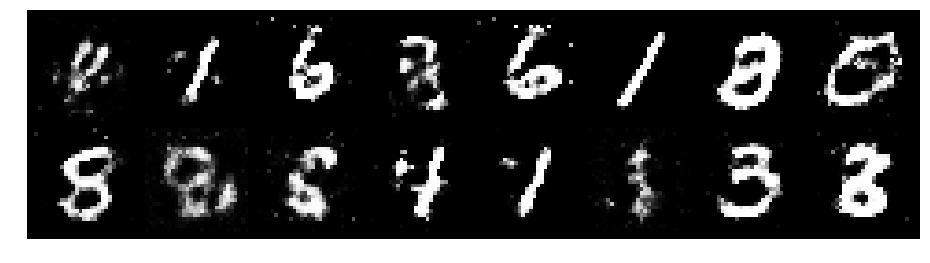

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0596, Generator Loss: 1.4654
D(x): 0.6319, D(G(z)): 0.3517


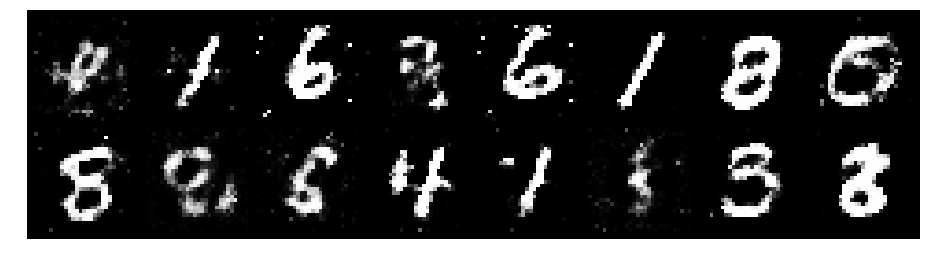

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.0134, Generator Loss: 1.4606
D(x): 0.6676, D(G(z)): 0.3869


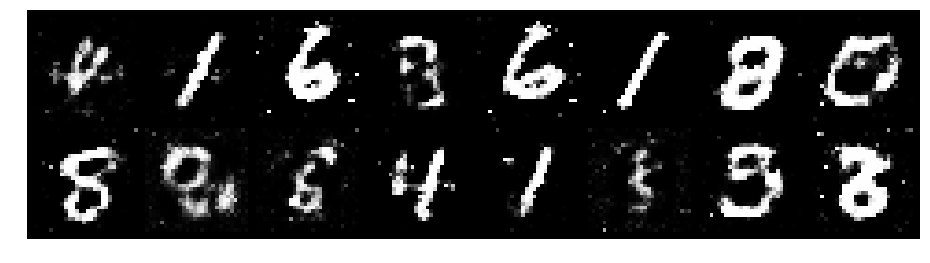

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0949, Generator Loss: 1.0849
D(x): 0.6114, D(G(z)): 0.3715


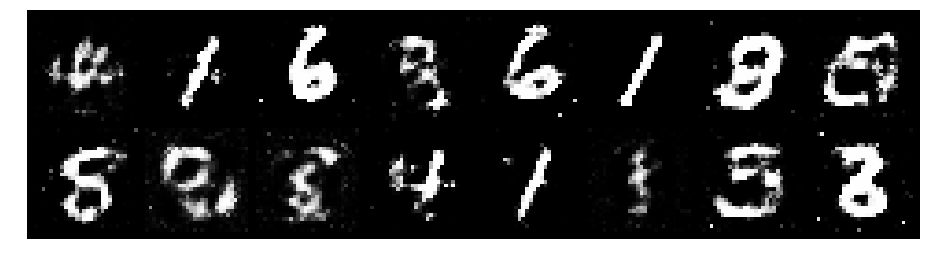

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0912, Generator Loss: 1.2220
D(x): 0.6419, D(G(z)): 0.3756


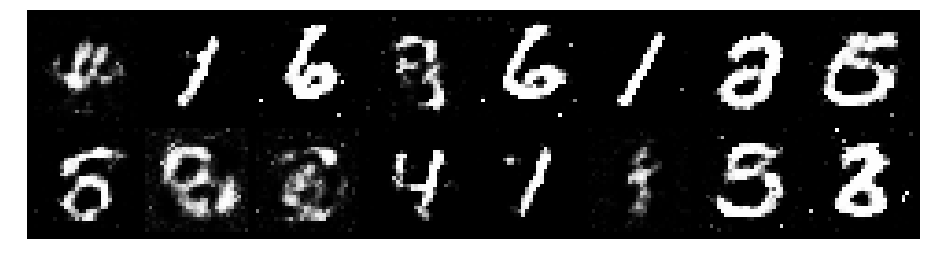

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2860, Generator Loss: 1.0566
D(x): 0.5614, D(G(z)): 0.4100


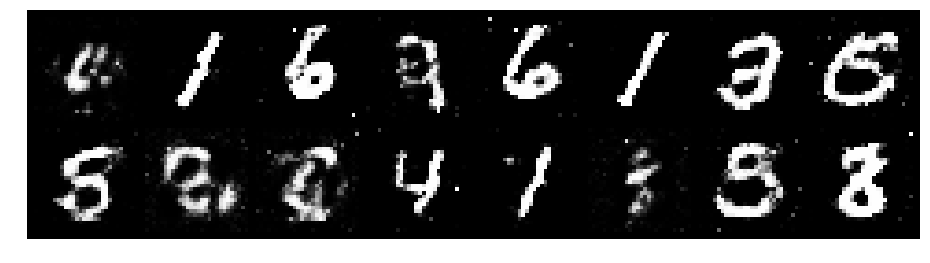

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.2018, Generator Loss: 0.9483
D(x): 0.5610, D(G(z)): 0.3727


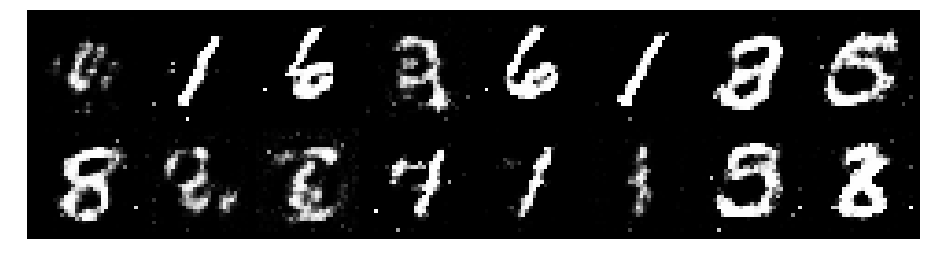

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1544, Generator Loss: 0.9606
D(x): 0.6459, D(G(z)): 0.4592


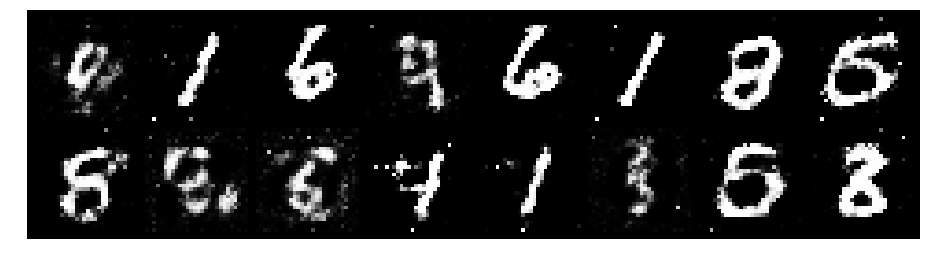

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1239, Generator Loss: 1.0644
D(x): 0.6338, D(G(z)): 0.4063


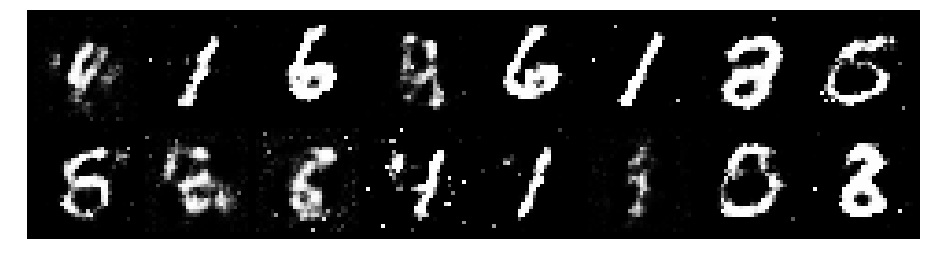

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1017, Generator Loss: 0.9963
D(x): 0.6746, D(G(z)): 0.4486


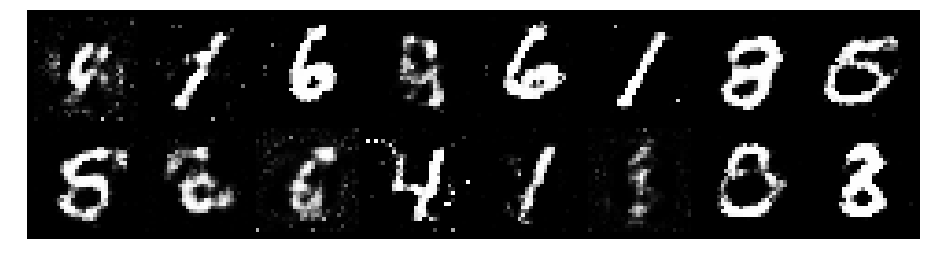

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.3531, Generator Loss: 0.9413
D(x): 0.5574, D(G(z)): 0.4464


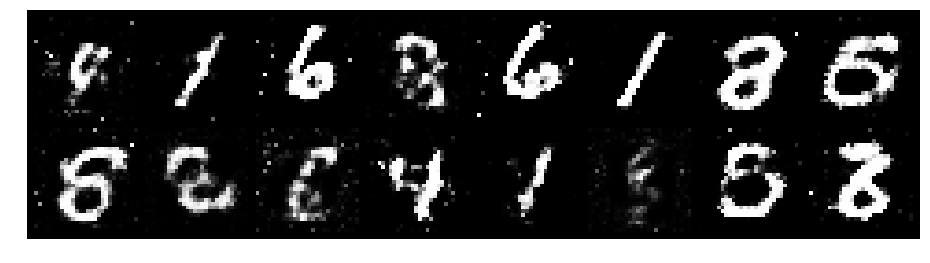

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.0453, Generator Loss: 1.3193
D(x): 0.6161, D(G(z)): 0.3263


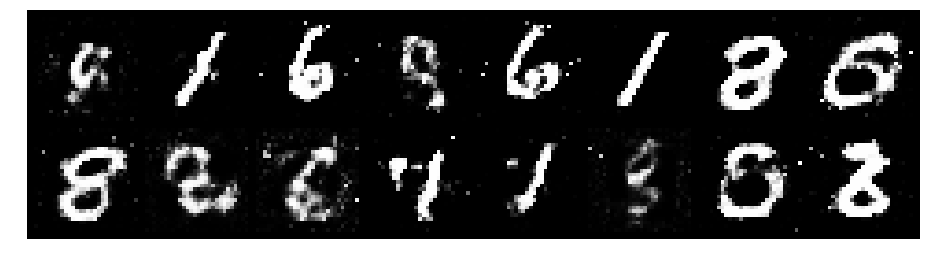

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1568, Generator Loss: 1.0657
D(x): 0.6080, D(G(z)): 0.3992


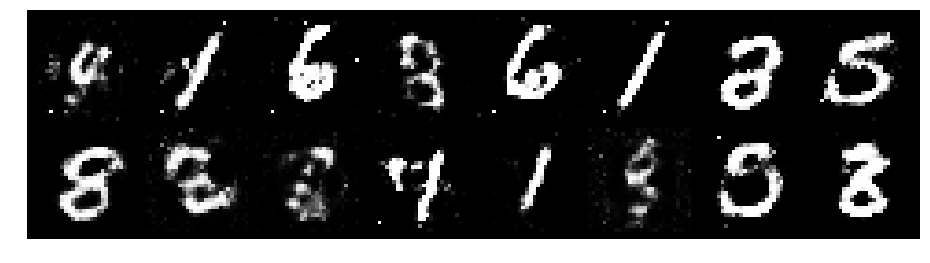

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.0151, Generator Loss: 1.0703
D(x): 0.6238, D(G(z)): 0.3335


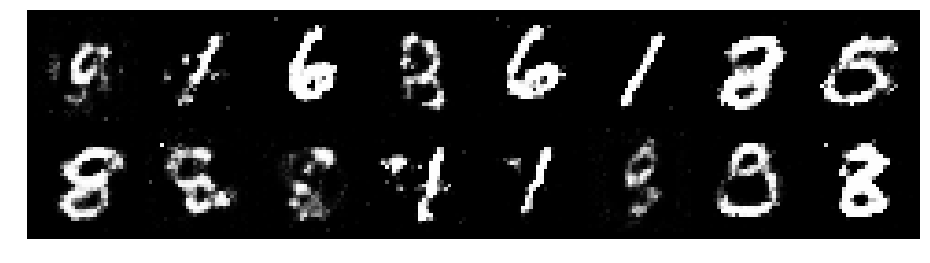

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0516, Generator Loss: 1.2058
D(x): 0.6267, D(G(z)): 0.3576


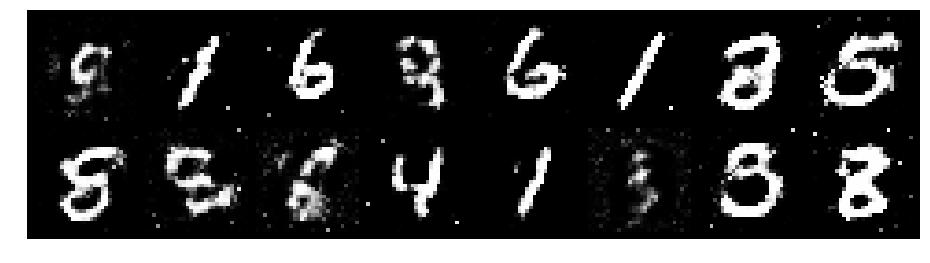

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 0.8916, Generator Loss: 1.4002
D(x): 0.6761, D(G(z)): 0.3210


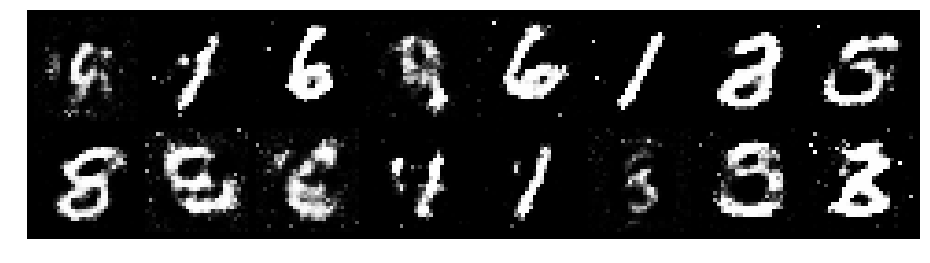

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 0.9442, Generator Loss: 1.5038
D(x): 0.6544, D(G(z)): 0.3133


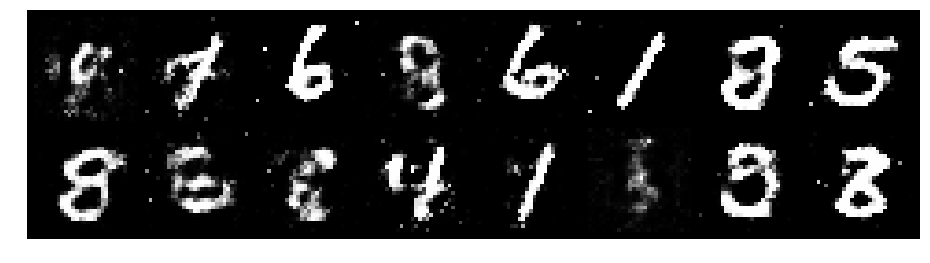

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1976, Generator Loss: 1.1161
D(x): 0.5699, D(G(z)): 0.3828


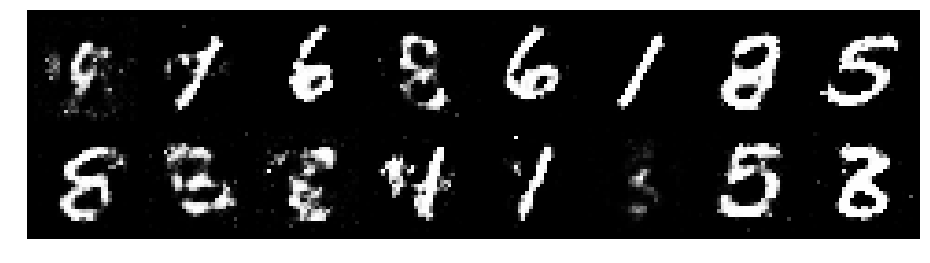

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1039, Generator Loss: 1.1591
D(x): 0.6042, D(G(z)): 0.3838


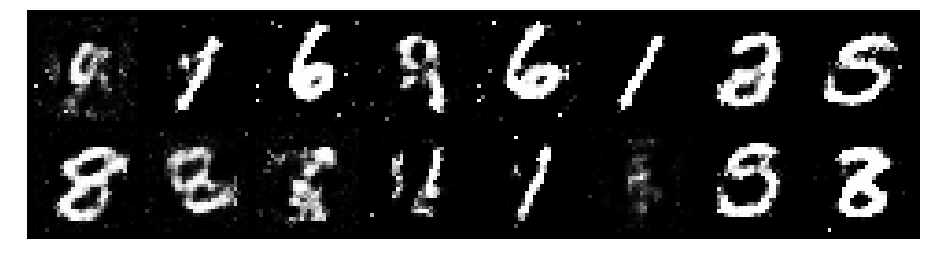

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.0350, Generator Loss: 1.2482
D(x): 0.6518, D(G(z)): 0.3818


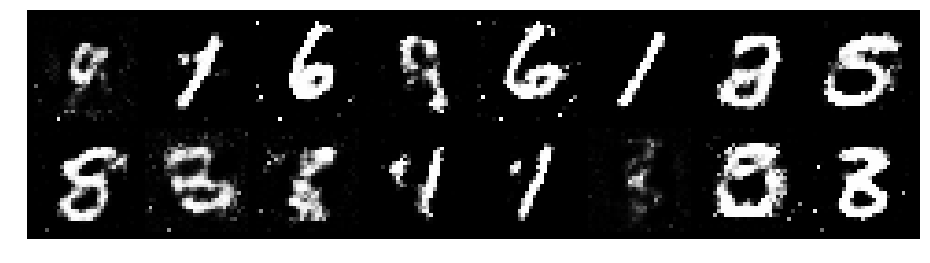

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1193, Generator Loss: 1.0263
D(x): 0.5896, D(G(z)): 0.3995


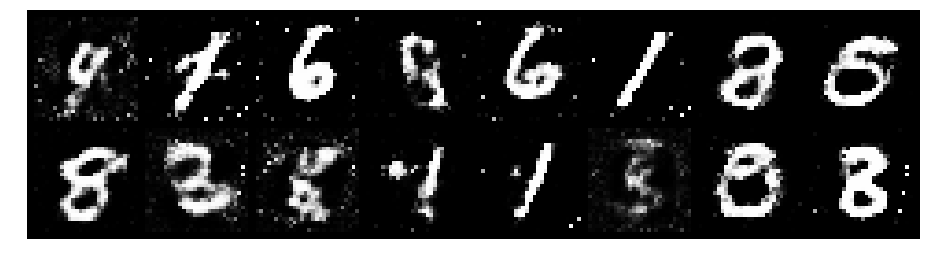

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1358, Generator Loss: 1.2697
D(x): 0.5847, D(G(z)): 0.3856


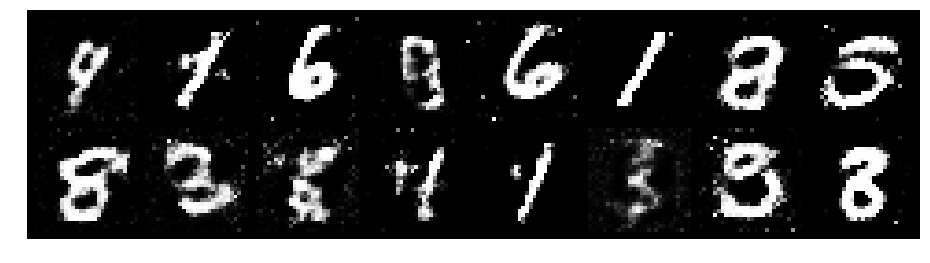

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.2697, Generator Loss: 0.8626
D(x): 0.6258, D(G(z)): 0.4763


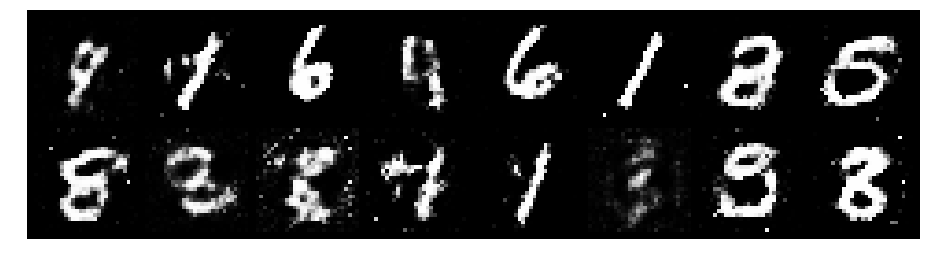

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1955, Generator Loss: 0.9509
D(x): 0.6654, D(G(z)): 0.4598


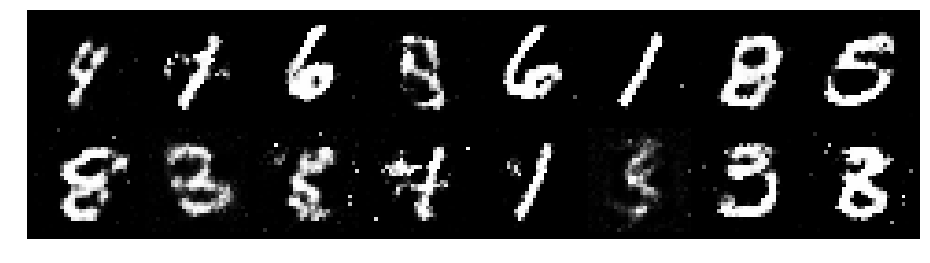

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2060, Generator Loss: 1.1802
D(x): 0.5798, D(G(z)): 0.4111


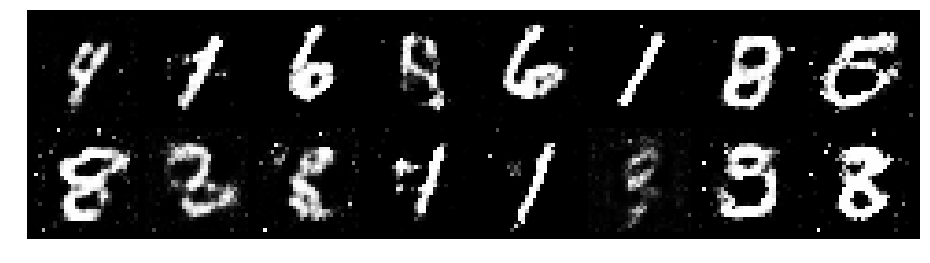

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1748, Generator Loss: 0.9294
D(x): 0.6010, D(G(z)): 0.4207


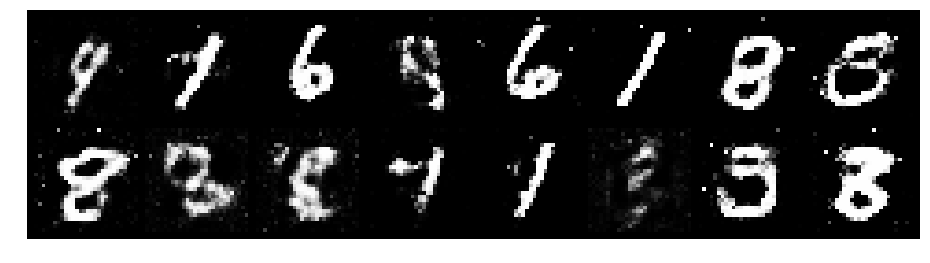

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1487, Generator Loss: 1.0398
D(x): 0.5914, D(G(z)): 0.3827


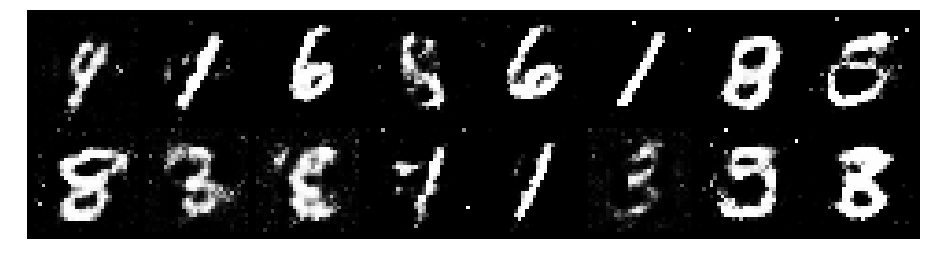

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1625, Generator Loss: 1.0584
D(x): 0.5324, D(G(z)): 0.3459


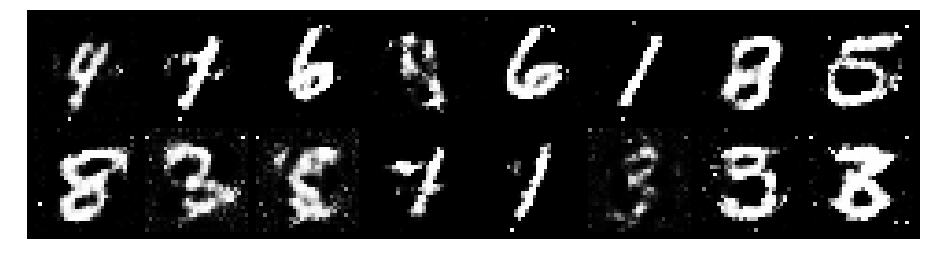

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.0831, Generator Loss: 1.1154
D(x): 0.6387, D(G(z)): 0.3851


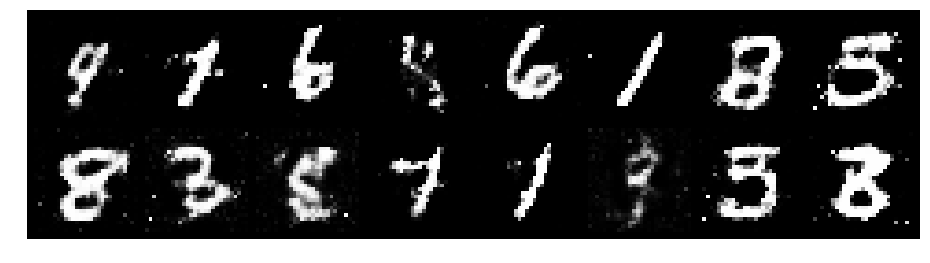

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.0702, Generator Loss: 1.1576
D(x): 0.6207, D(G(z)): 0.3761


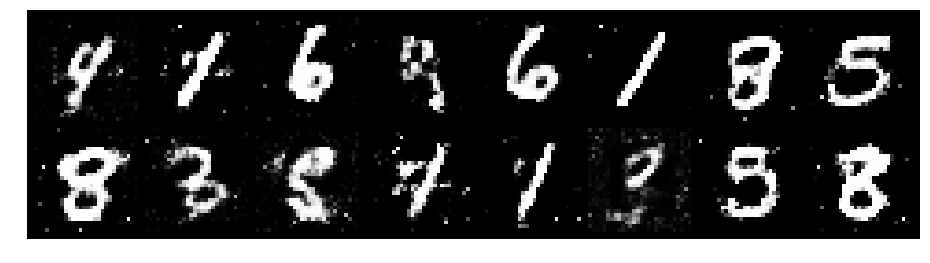

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1220, Generator Loss: 1.1254
D(x): 0.6189, D(G(z)): 0.4045


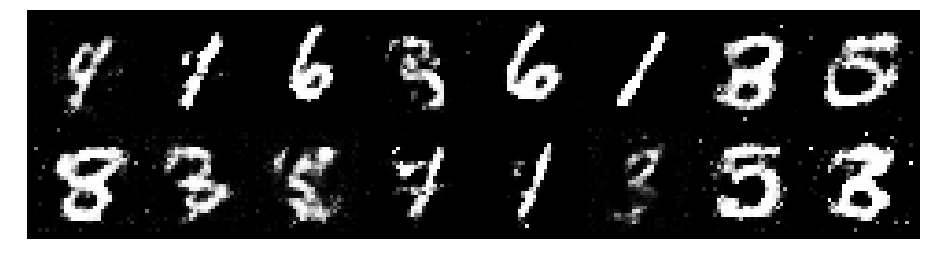

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2374, Generator Loss: 0.9483
D(x): 0.6042, D(G(z)): 0.4685


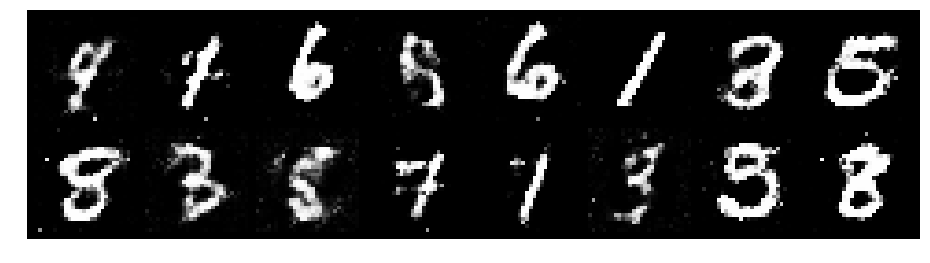

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1908, Generator Loss: 1.0141
D(x): 0.5456, D(G(z)): 0.3801


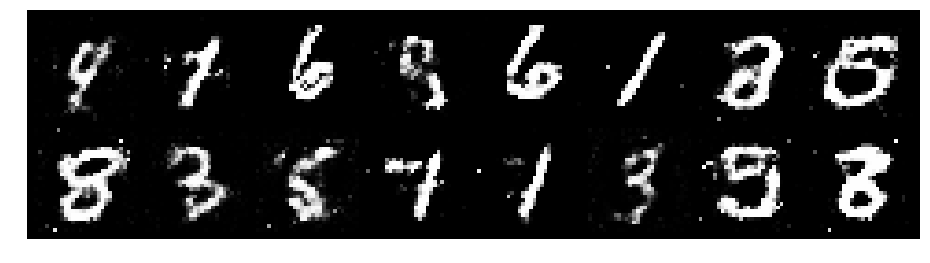

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0609, Generator Loss: 1.0776
D(x): 0.6469, D(G(z)): 0.3861


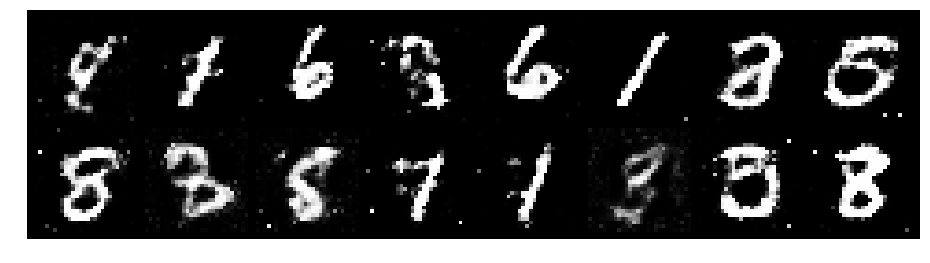

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.1482, Generator Loss: 0.9285
D(x): 0.5888, D(G(z)): 0.4215


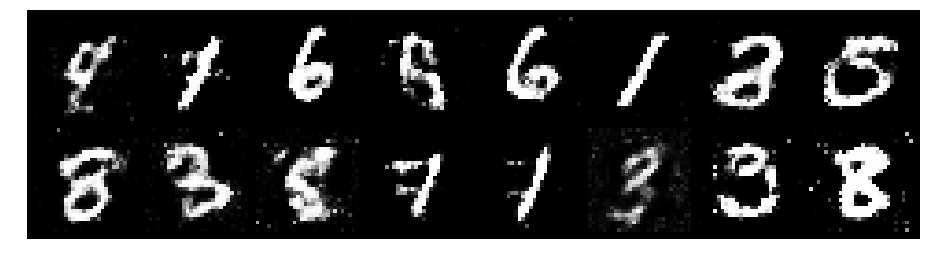

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.0823, Generator Loss: 1.1074
D(x): 0.6021, D(G(z)): 0.3547


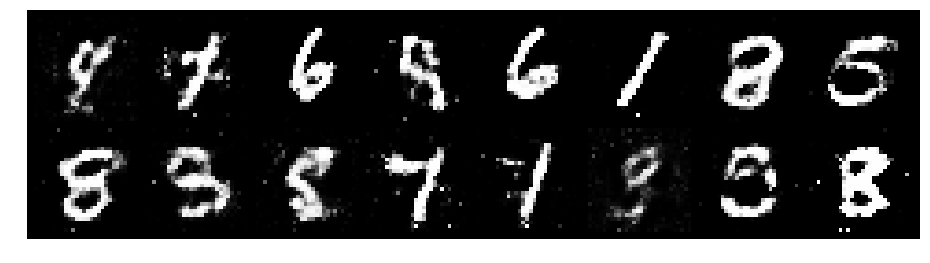

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1083, Generator Loss: 1.1650
D(x): 0.5945, D(G(z)): 0.3753


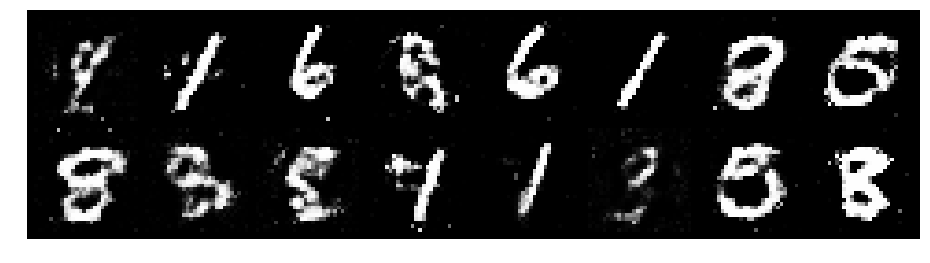

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.0792, Generator Loss: 0.9617
D(x): 0.6129, D(G(z)): 0.3981


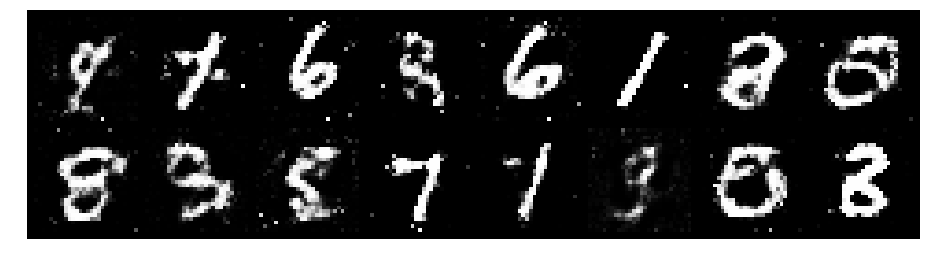

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2648, Generator Loss: 1.0355
D(x): 0.5459, D(G(z)): 0.4097


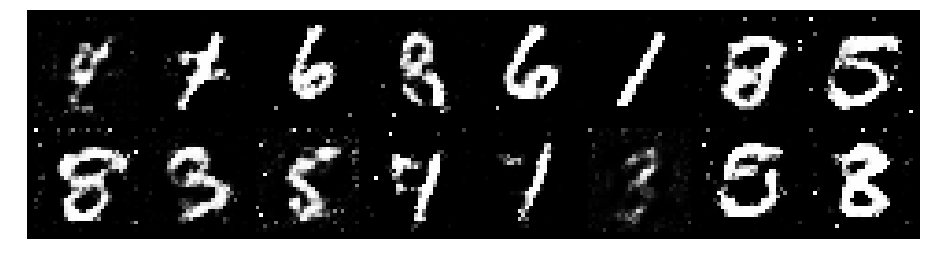

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.2819, Generator Loss: 0.8280
D(x): 0.5397, D(G(z)): 0.4390


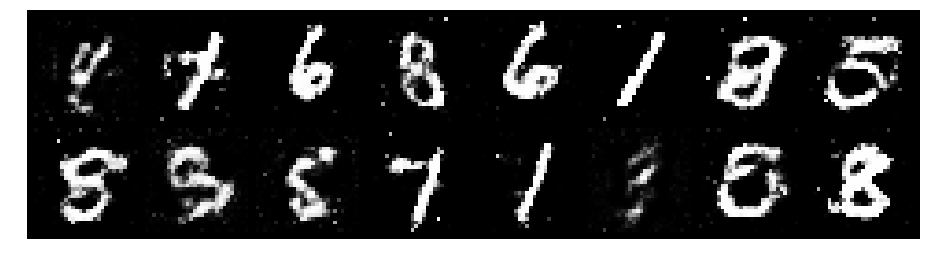

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1058, Generator Loss: 1.0005
D(x): 0.5932, D(G(z)): 0.3790


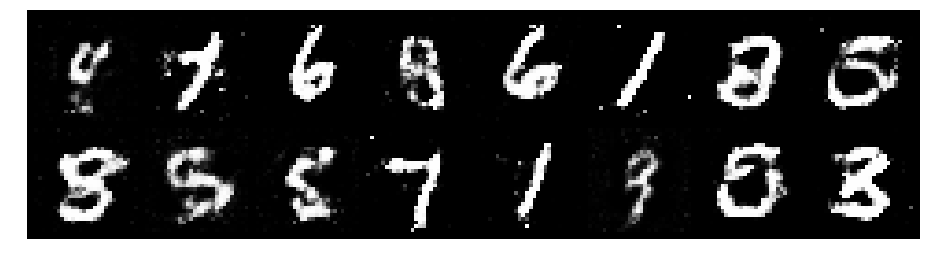

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2609, Generator Loss: 0.9462
D(x): 0.6104, D(G(z)): 0.4707


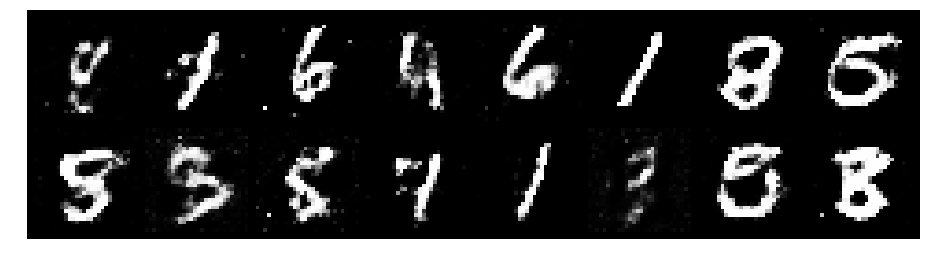

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2096, Generator Loss: 0.7928
D(x): 0.6617, D(G(z)): 0.5039


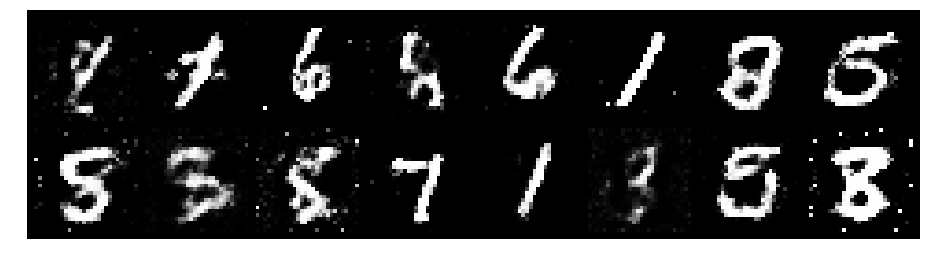

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2568, Generator Loss: 1.1019
D(x): 0.5428, D(G(z)): 0.3984


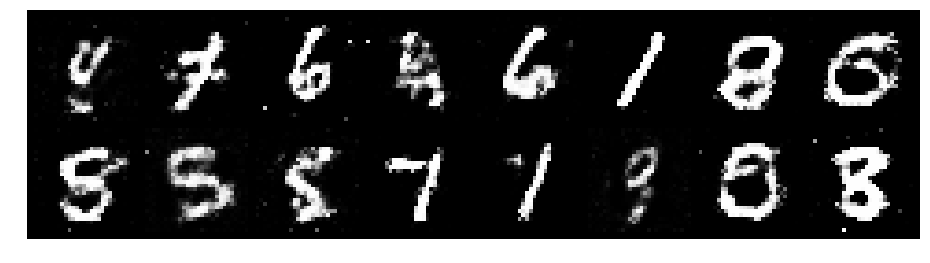

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1510, Generator Loss: 1.2548
D(x): 0.6413, D(G(z)): 0.3738


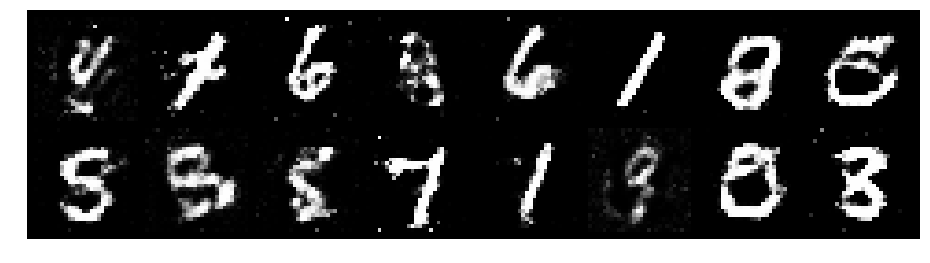

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.0358, Generator Loss: 1.2354
D(x): 0.5584, D(G(z)): 0.3010


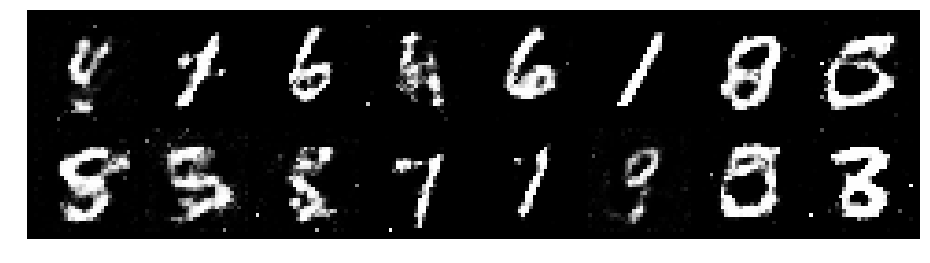

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1055, Generator Loss: 1.0499
D(x): 0.6223, D(G(z)): 0.3992


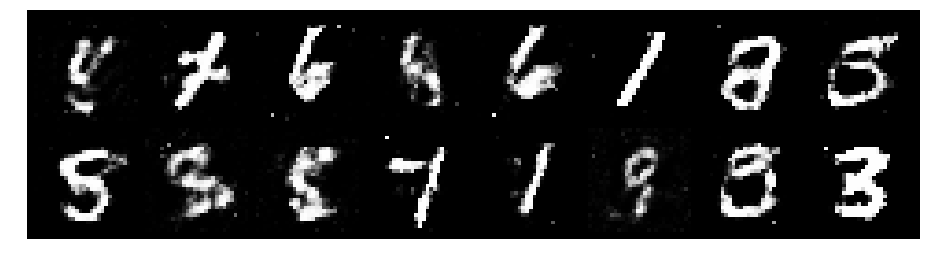

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.0323, Generator Loss: 1.2438
D(x): 0.5878, D(G(z)): 0.3106


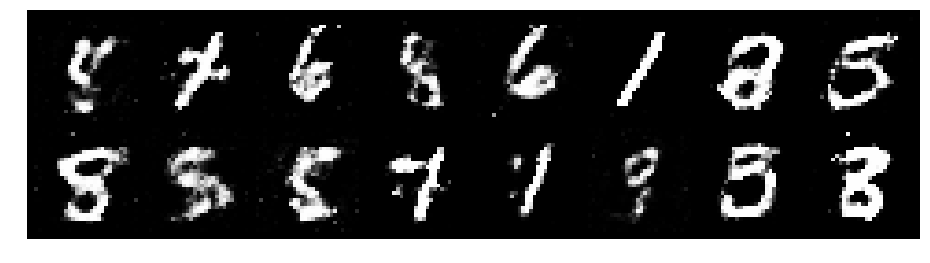

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.0441, Generator Loss: 1.3168
D(x): 0.6829, D(G(z)): 0.3974


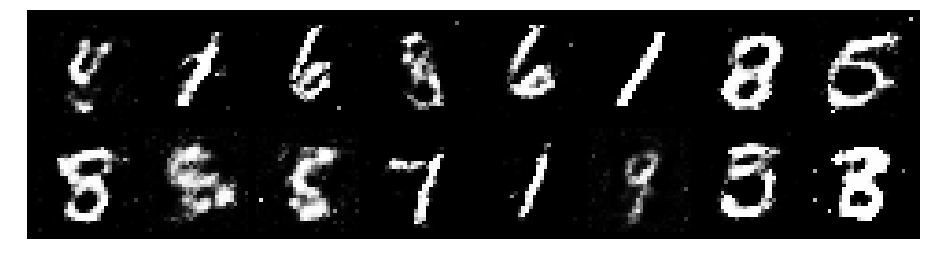

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2031, Generator Loss: 1.0726
D(x): 0.5998, D(G(z)): 0.4162


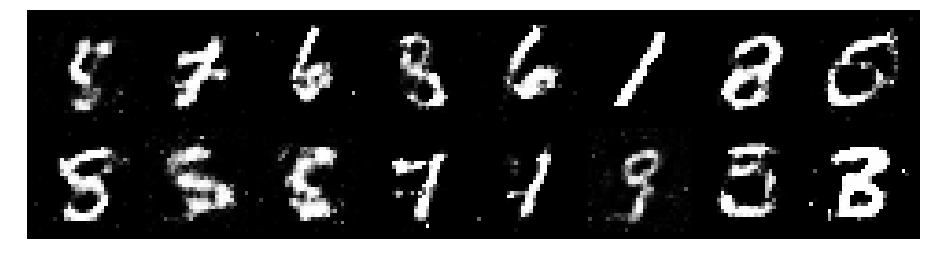

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2499, Generator Loss: 0.9305
D(x): 0.5620, D(G(z)): 0.4279


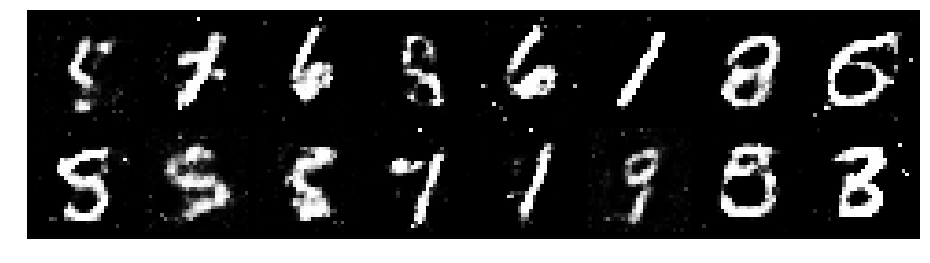

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2629, Generator Loss: 0.8294
D(x): 0.5562, D(G(z)): 0.4377


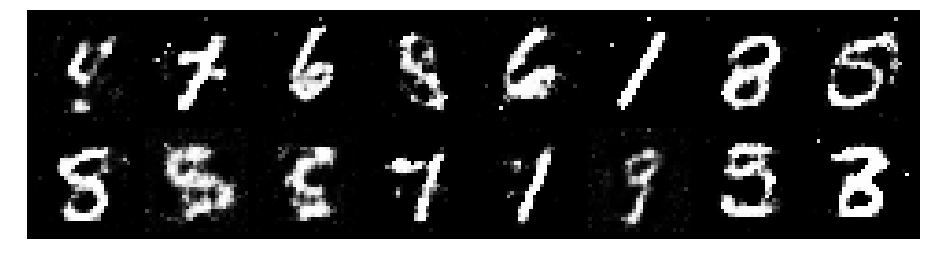

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.1157, Generator Loss: 1.0525
D(x): 0.5990, D(G(z)): 0.3797


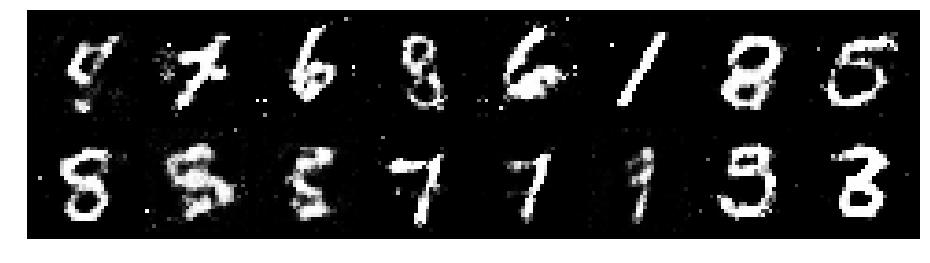

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1798, Generator Loss: 1.2415
D(x): 0.5766, D(G(z)): 0.3864


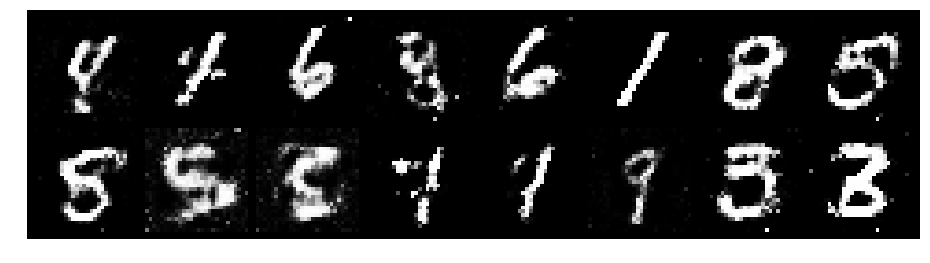

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.0467, Generator Loss: 1.0800
D(x): 0.6337, D(G(z)): 0.3695


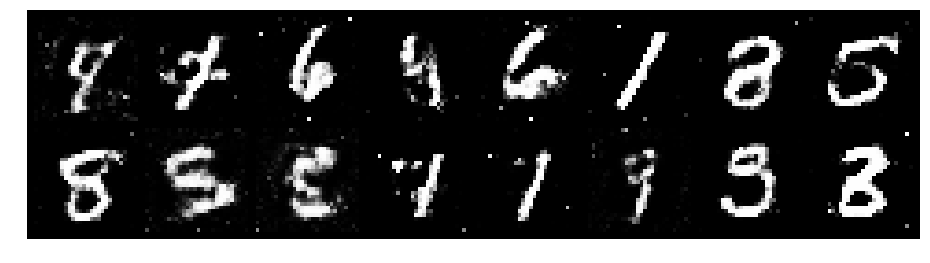

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0966, Generator Loss: 1.4072
D(x): 0.6182, D(G(z)): 0.3727


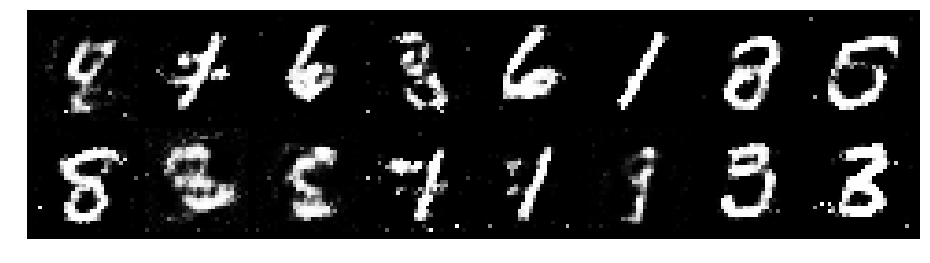

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.0662, Generator Loss: 1.1326
D(x): 0.6129, D(G(z)): 0.3813


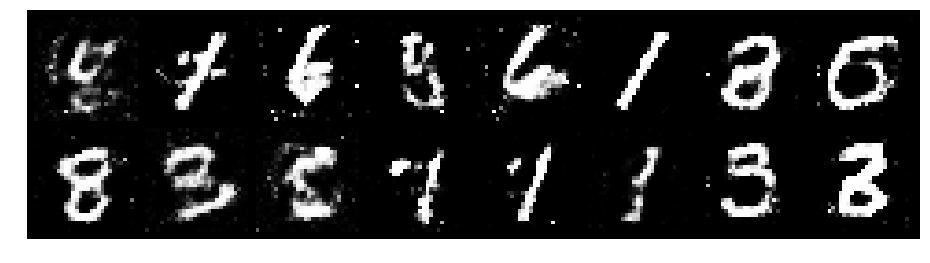

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1478, Generator Loss: 1.0517
D(x): 0.5813, D(G(z)): 0.3816


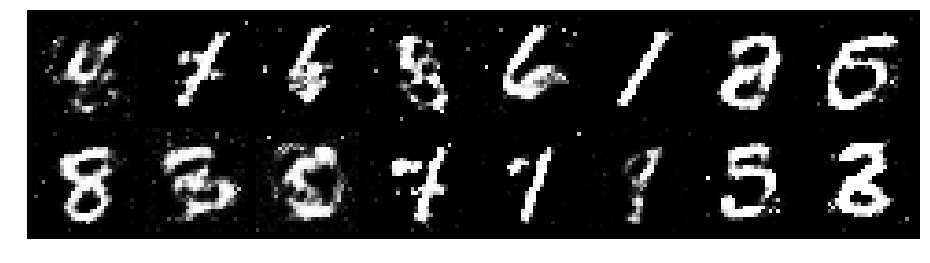

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1764, Generator Loss: 1.0449
D(x): 0.5685, D(G(z)): 0.3883


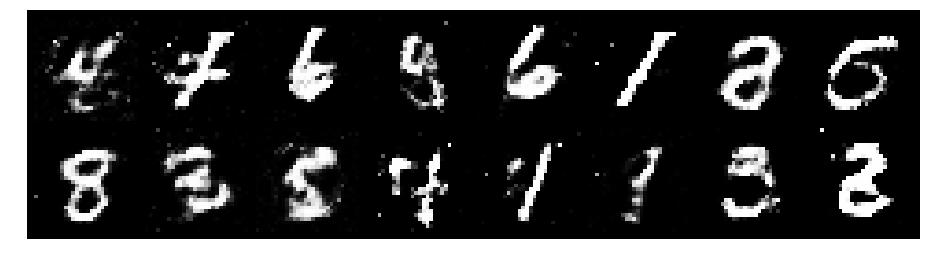

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2478, Generator Loss: 0.9656
D(x): 0.5633, D(G(z)): 0.4219


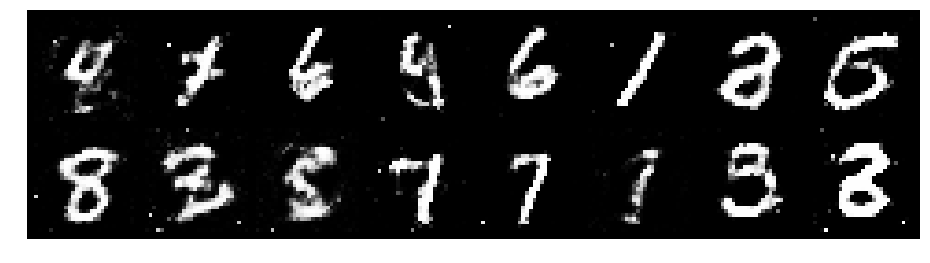

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1687, Generator Loss: 1.0975
D(x): 0.5673, D(G(z)): 0.3616


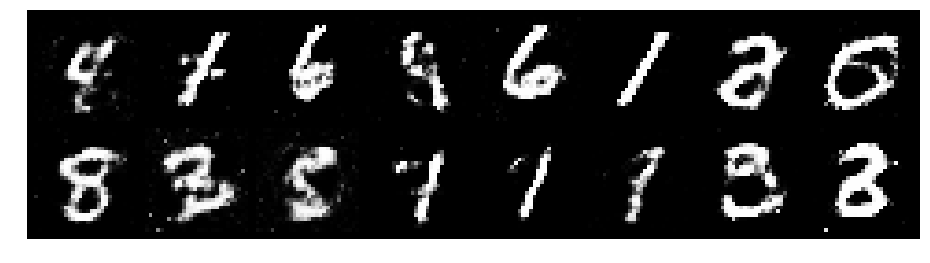

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1120, Generator Loss: 1.4020
D(x): 0.5726, D(G(z)): 0.3405


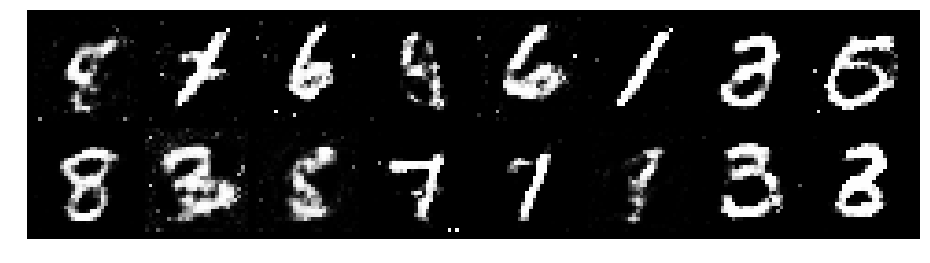

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.0830, Generator Loss: 1.1038
D(x): 0.6963, D(G(z)): 0.4084


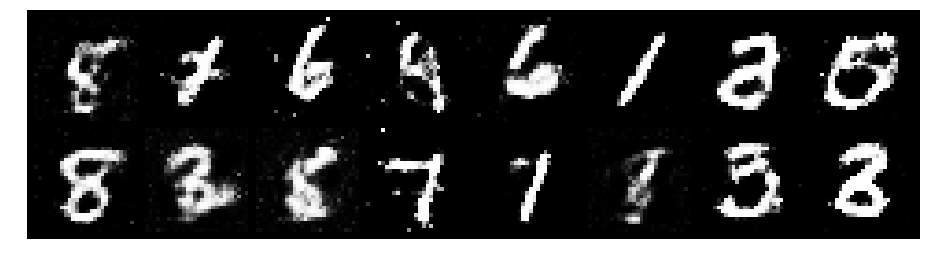

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.3250, Generator Loss: 0.8786
D(x): 0.6187, D(G(z)): 0.4732


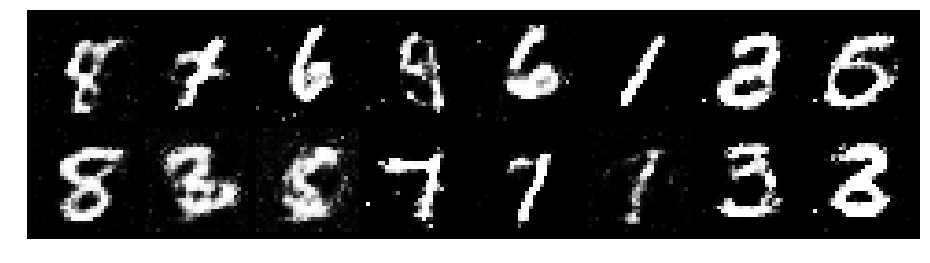

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1247, Generator Loss: 1.1174
D(x): 0.6383, D(G(z)): 0.4152


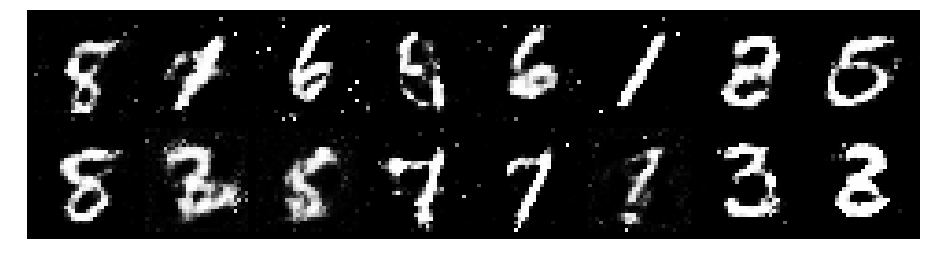

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1212, Generator Loss: 0.8792
D(x): 0.5876, D(G(z)): 0.3976


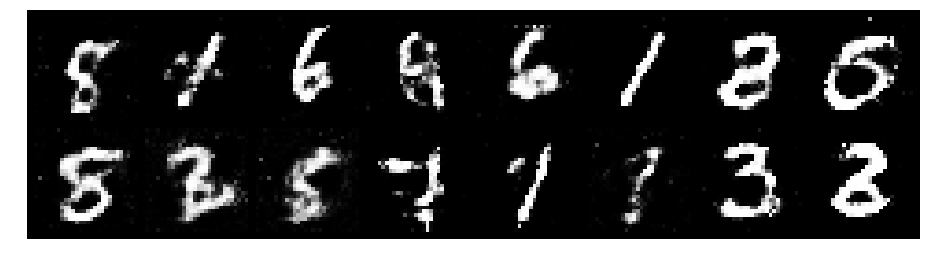

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1885, Generator Loss: 1.0485
D(x): 0.5893, D(G(z)): 0.4003


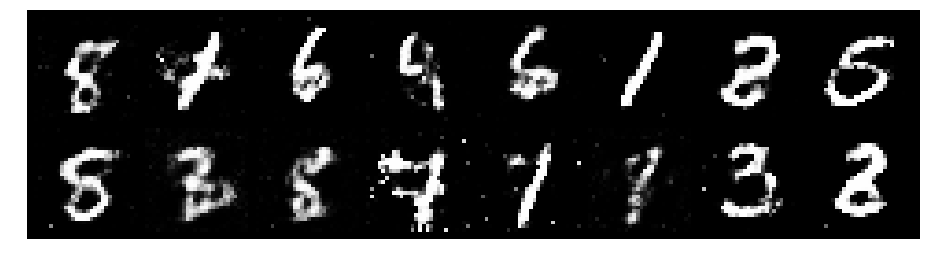

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1837, Generator Loss: 1.1275
D(x): 0.5262, D(G(z)): 0.3219


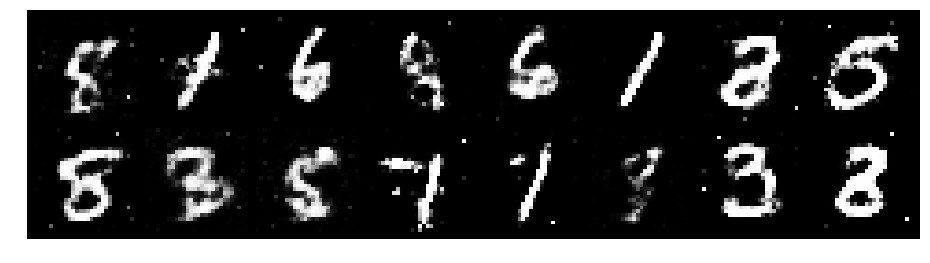

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.3775, Generator Loss: 1.0819
D(x): 0.5634, D(G(z)): 0.4491


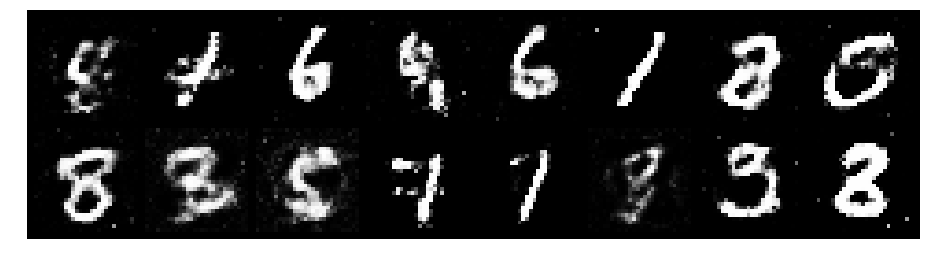

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.1969, Generator Loss: 0.9571
D(x): 0.5871, D(G(z)): 0.4308


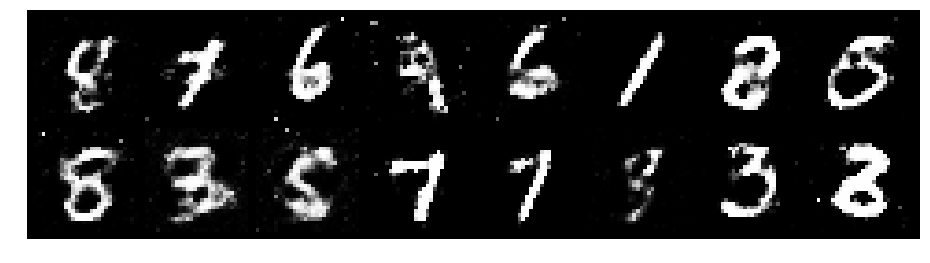

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.3228, Generator Loss: 1.0335
D(x): 0.4989, D(G(z)): 0.4012


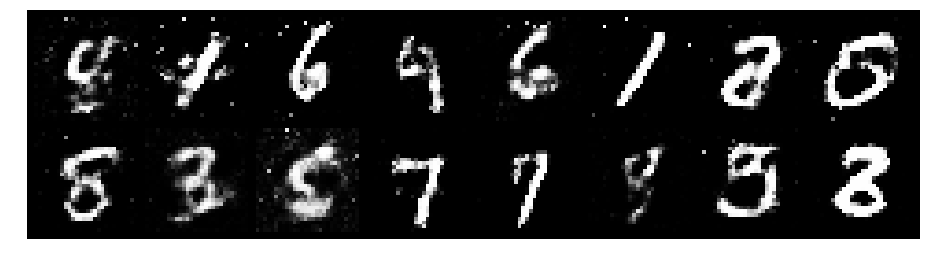

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.2477, Generator Loss: 0.8723
D(x): 0.5968, D(G(z)): 0.4441


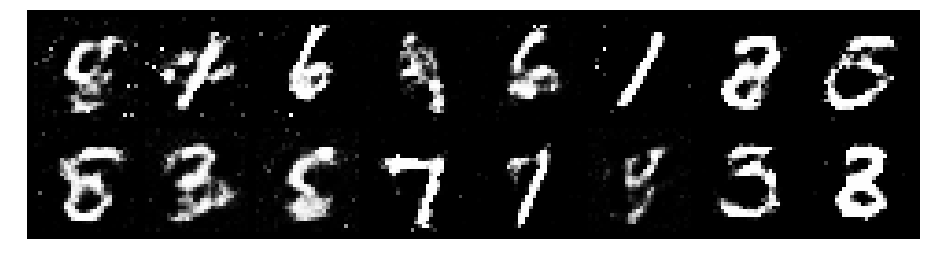

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1524, Generator Loss: 1.0303
D(x): 0.5954, D(G(z)): 0.3900


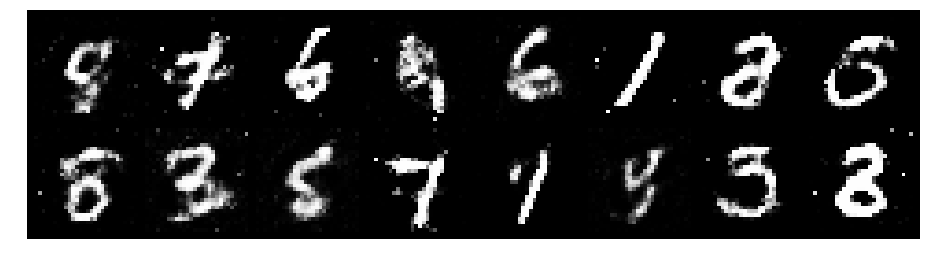

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1586, Generator Loss: 1.0853
D(x): 0.5913, D(G(z)): 0.3749


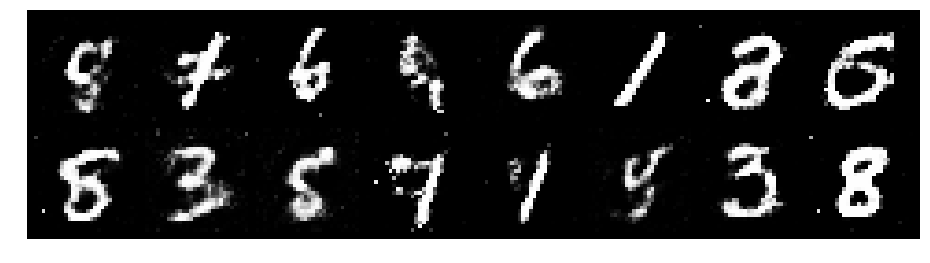

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1311, Generator Loss: 1.1646
D(x): 0.5629, D(G(z)): 0.3489


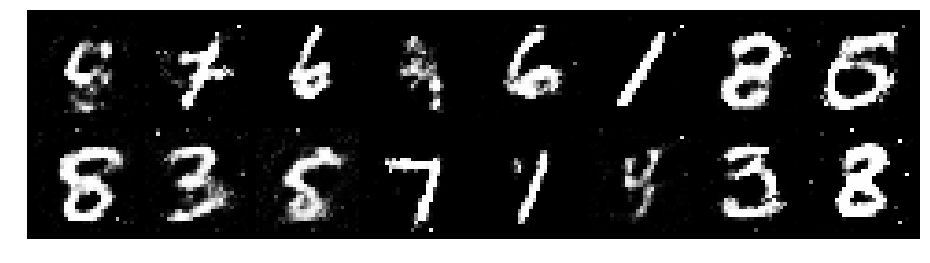

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1243, Generator Loss: 1.0886
D(x): 0.6280, D(G(z)): 0.4127


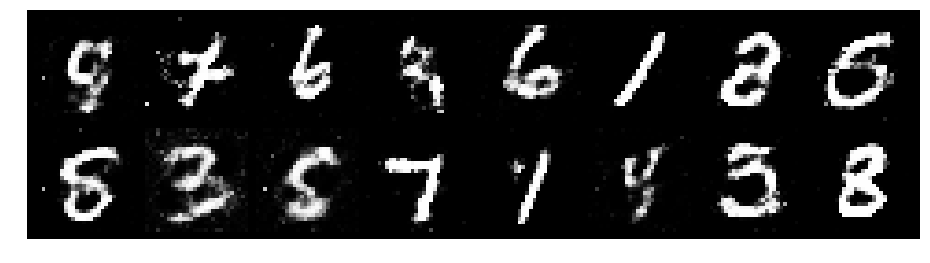

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1376, Generator Loss: 0.9593
D(x): 0.6088, D(G(z)): 0.4053


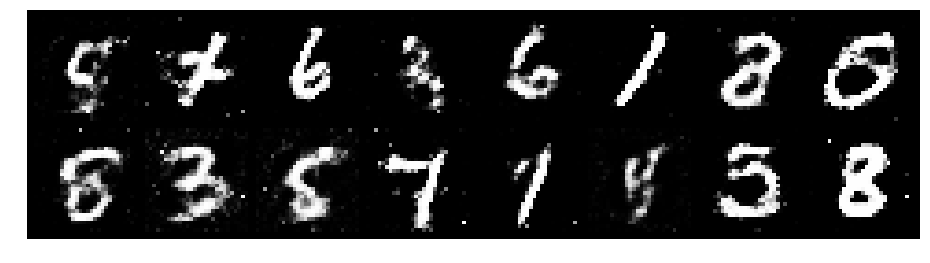

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.0473, Generator Loss: 1.1652
D(x): 0.6245, D(G(z)): 0.3619


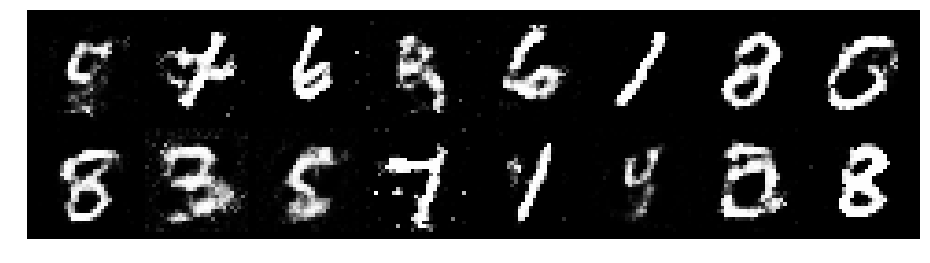

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.0531, Generator Loss: 1.1294
D(x): 0.6274, D(G(z)): 0.3686


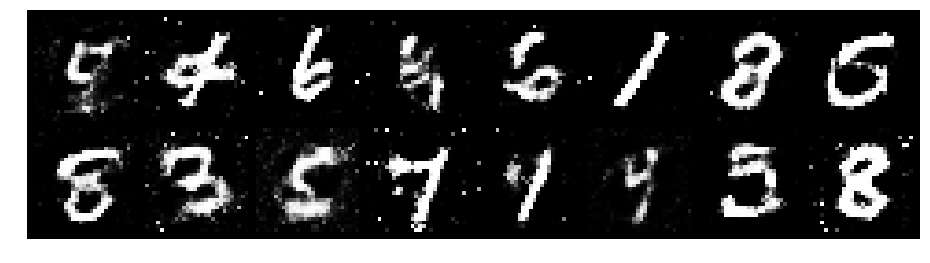

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1593, Generator Loss: 0.8486
D(x): 0.5955, D(G(z)): 0.4297


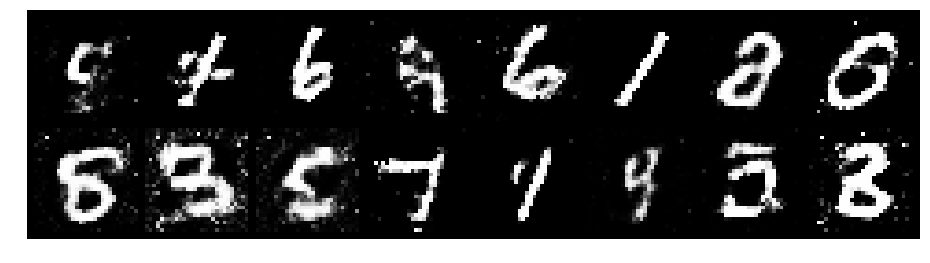

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2520, Generator Loss: 0.8082
D(x): 0.5860, D(G(z)): 0.4812


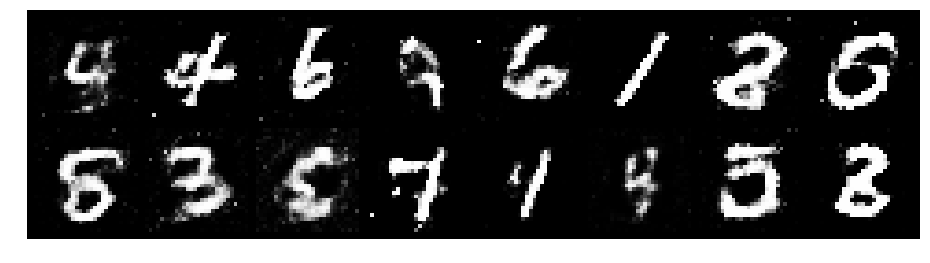

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.3114, Generator Loss: 0.8643
D(x): 0.6085, D(G(z)): 0.4878


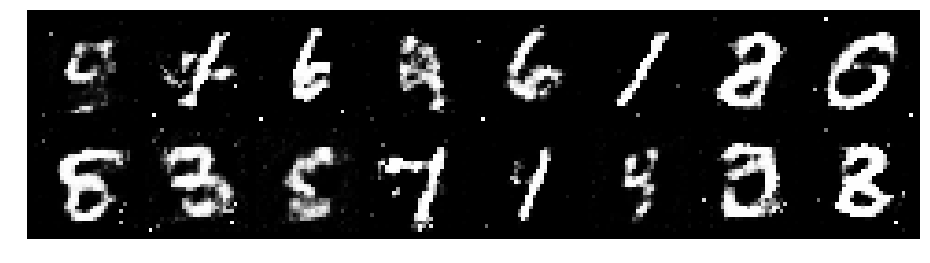

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2056, Generator Loss: 1.1390
D(x): 0.5679, D(G(z)): 0.3909


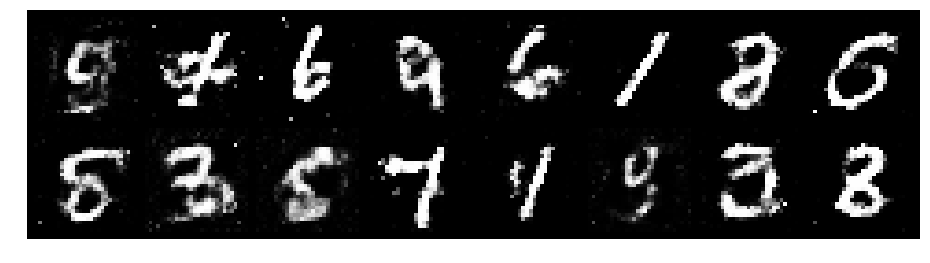

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 0.9917, Generator Loss: 1.3372
D(x): 0.6129, D(G(z)): 0.3117


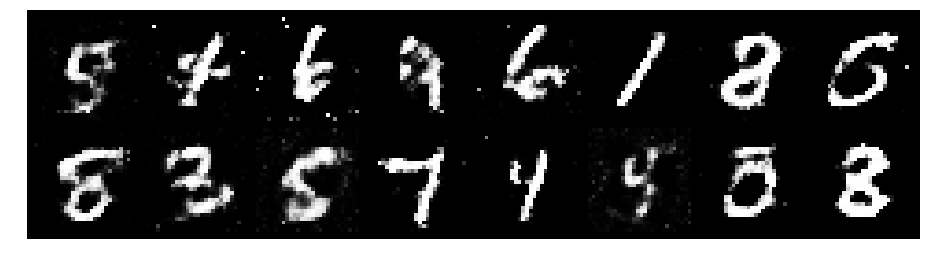

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1714, Generator Loss: 1.1410
D(x): 0.5557, D(G(z)): 0.3722


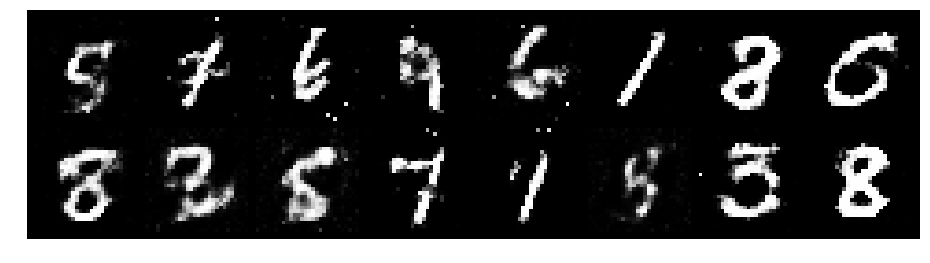

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2184, Generator Loss: 0.9518
D(x): 0.5572, D(G(z)): 0.4173


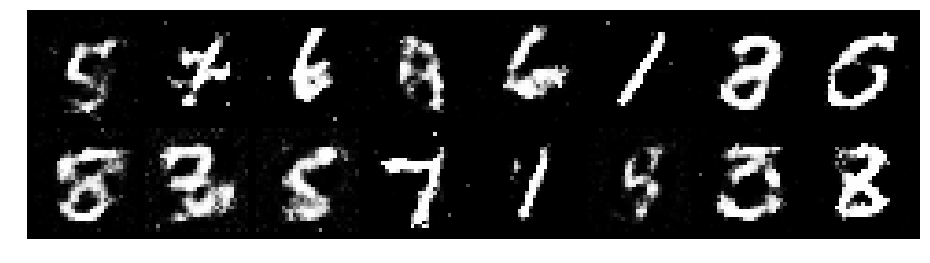

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.0591, Generator Loss: 1.0090
D(x): 0.6210, D(G(z)): 0.3849


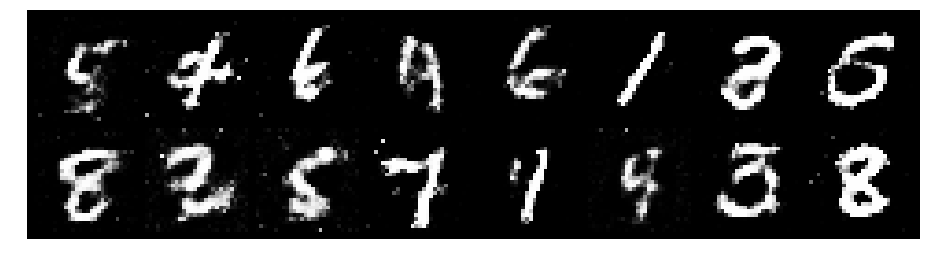

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.0810, Generator Loss: 1.0124
D(x): 0.6245, D(G(z)): 0.3910


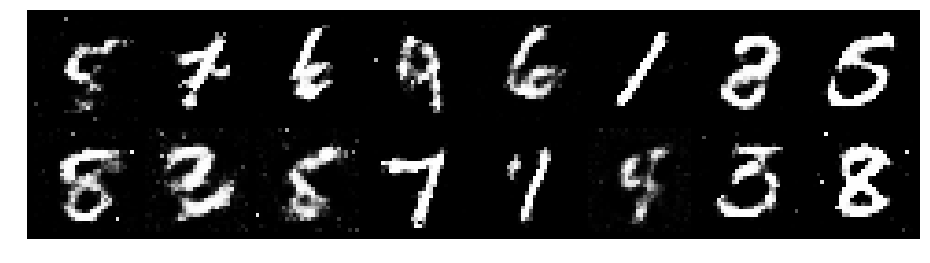

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1133, Generator Loss: 1.3436
D(x): 0.6486, D(G(z)): 0.4093


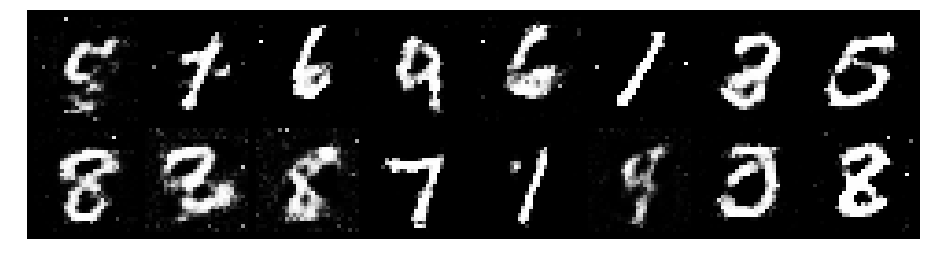

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2177, Generator Loss: 1.1583
D(x): 0.5982, D(G(z)): 0.3932


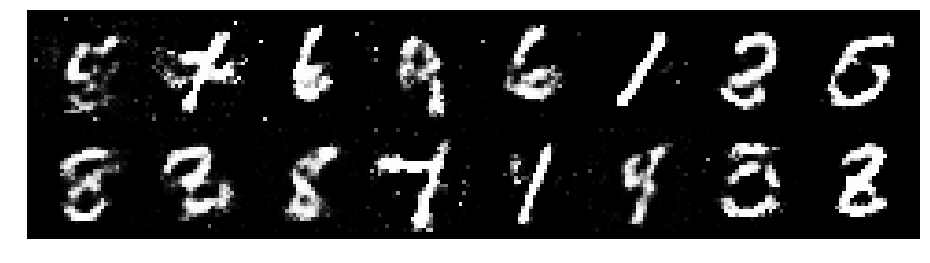

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2610, Generator Loss: 0.9832
D(x): 0.5859, D(G(z)): 0.4454


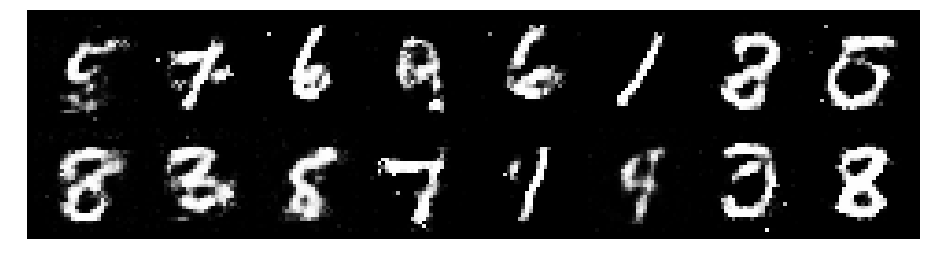

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1466, Generator Loss: 1.0722
D(x): 0.6068, D(G(z)): 0.3786


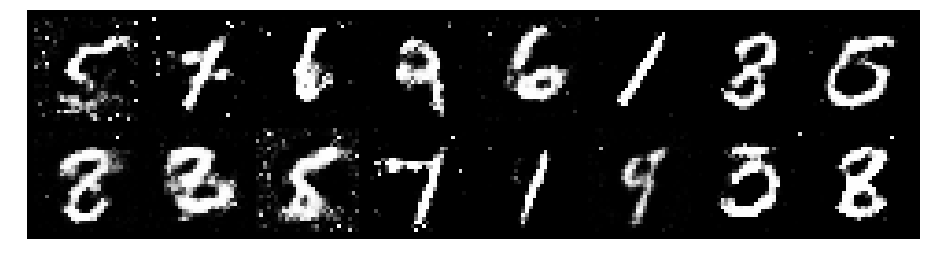

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.0406, Generator Loss: 1.2708
D(x): 0.6251, D(G(z)): 0.3621


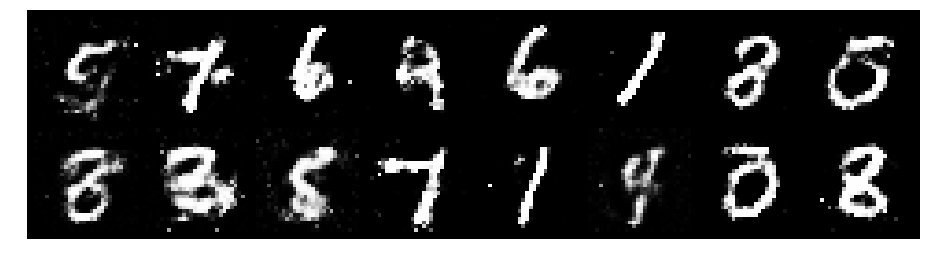

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1504, Generator Loss: 0.9461
D(x): 0.6222, D(G(z)): 0.4322


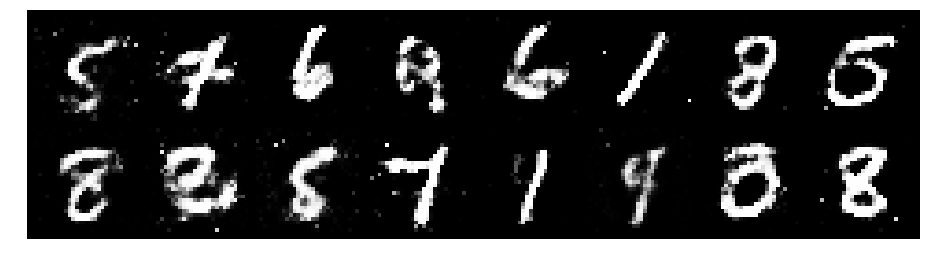

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1079, Generator Loss: 0.9827
D(x): 0.5975, D(G(z)): 0.3767


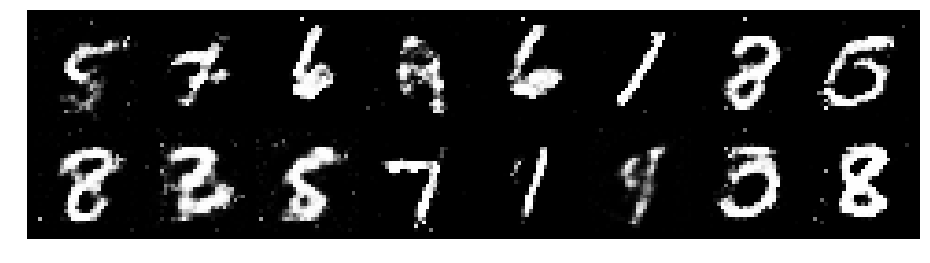

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.3072, Generator Loss: 0.9625
D(x): 0.6161, D(G(z)): 0.4902


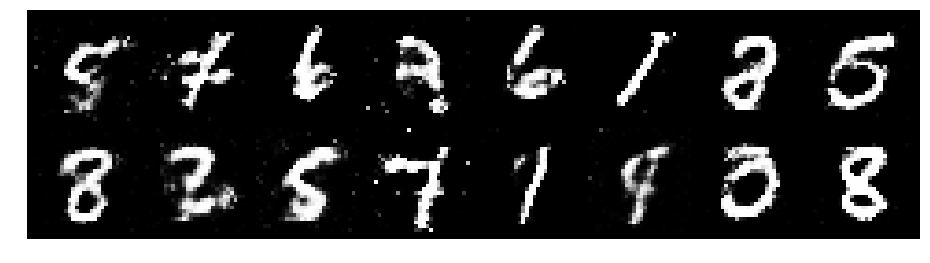

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2425, Generator Loss: 1.0150
D(x): 0.5639, D(G(z)): 0.4265


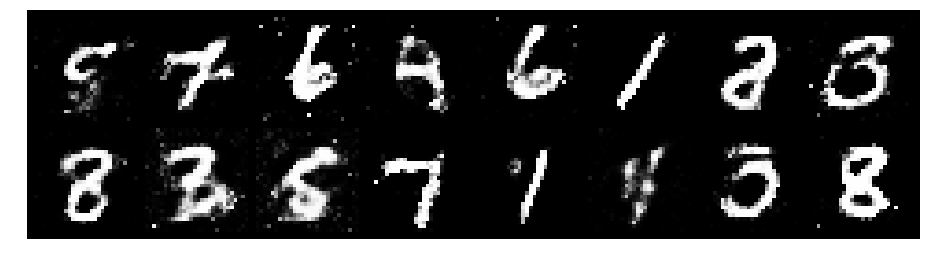

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.0096, Generator Loss: 1.1983
D(x): 0.6532, D(G(z)): 0.3812


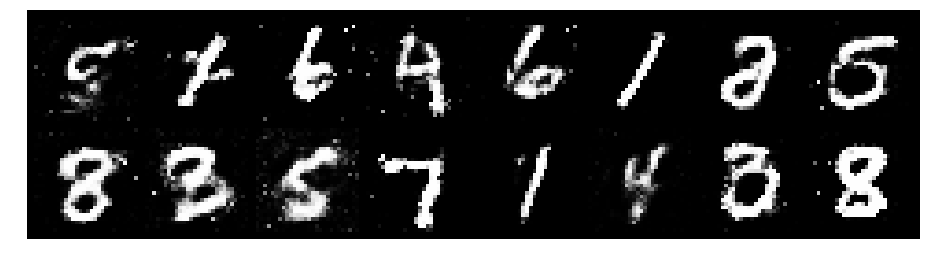

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1207, Generator Loss: 1.2519
D(x): 0.5846, D(G(z)): 0.3530


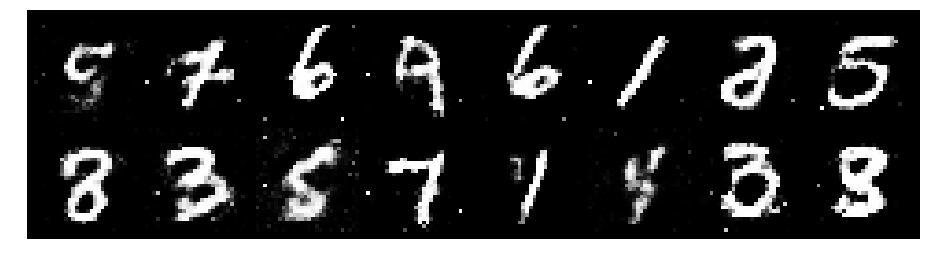

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.0769, Generator Loss: 0.9909
D(x): 0.6506, D(G(z)): 0.4070


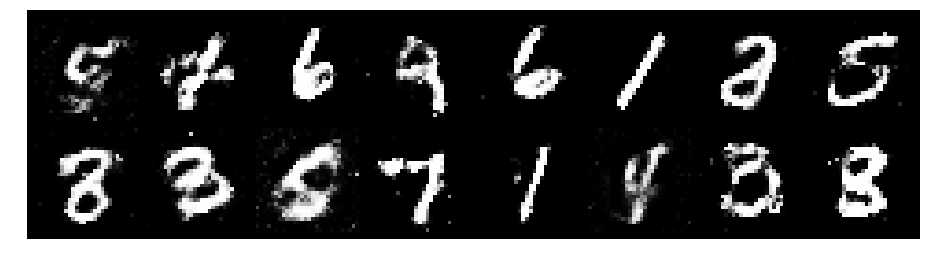

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2125, Generator Loss: 1.0880
D(x): 0.6100, D(G(z)): 0.4297


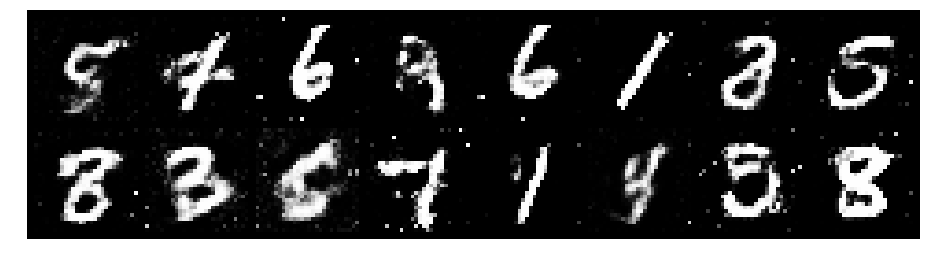

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2694, Generator Loss: 0.9594
D(x): 0.5750, D(G(z)): 0.4524


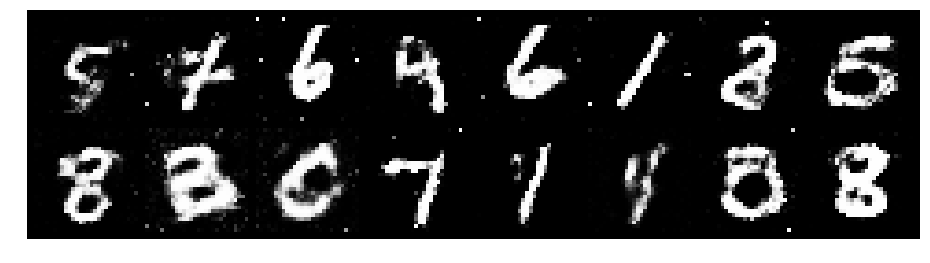

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2271, Generator Loss: 0.8396
D(x): 0.5501, D(G(z)): 0.4337


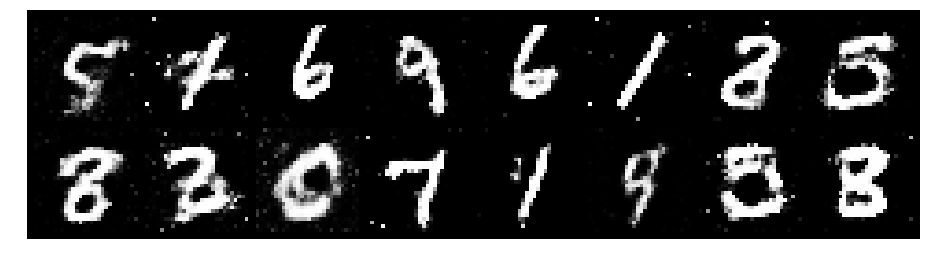

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1621, Generator Loss: 0.7989
D(x): 0.5630, D(G(z)): 0.3744


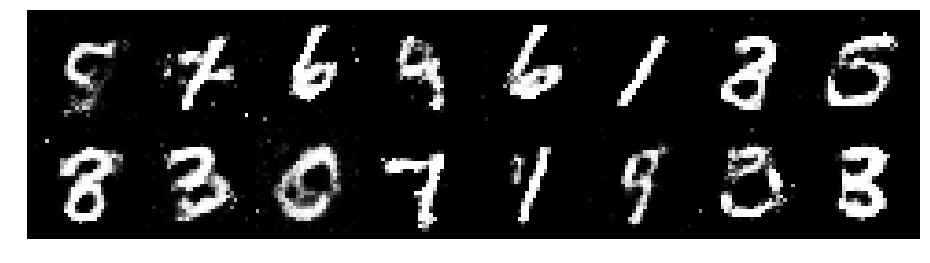

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2144, Generator Loss: 1.0423
D(x): 0.5912, D(G(z)): 0.3983


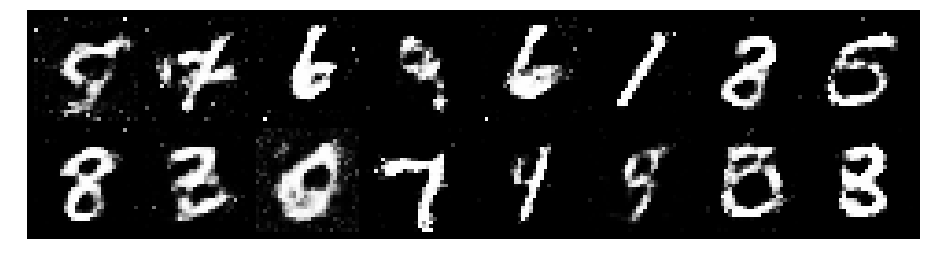

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.1266, Generator Loss: 0.9192
D(x): 0.6691, D(G(z)): 0.4460


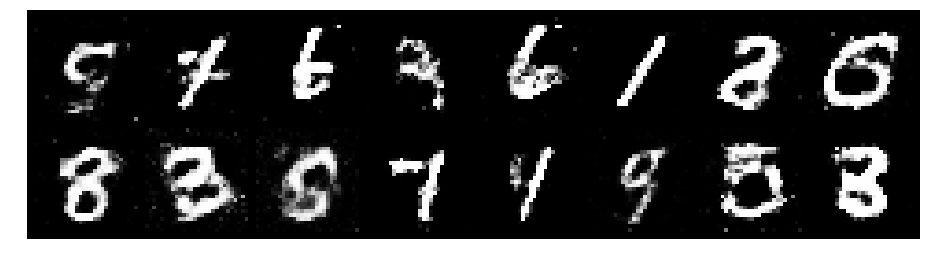

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2166, Generator Loss: 0.8349
D(x): 0.5697, D(G(z)): 0.4315


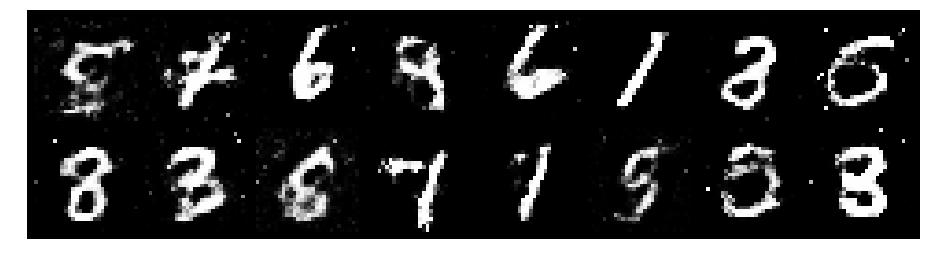

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2510, Generator Loss: 0.9709
D(x): 0.5870, D(G(z)): 0.4390


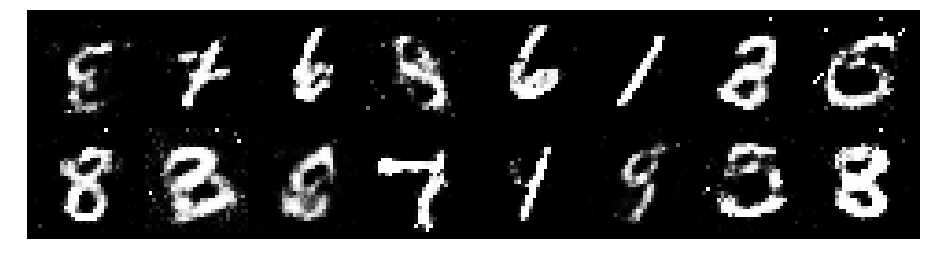

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.1944, Generator Loss: 0.8464
D(x): 0.5793, D(G(z)): 0.4266


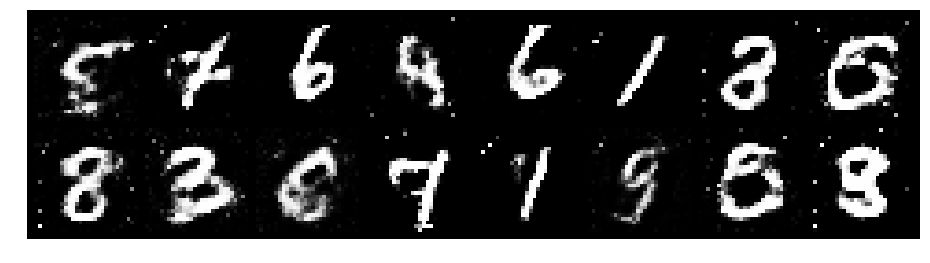

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2787, Generator Loss: 1.0456
D(x): 0.5776, D(G(z)): 0.4504


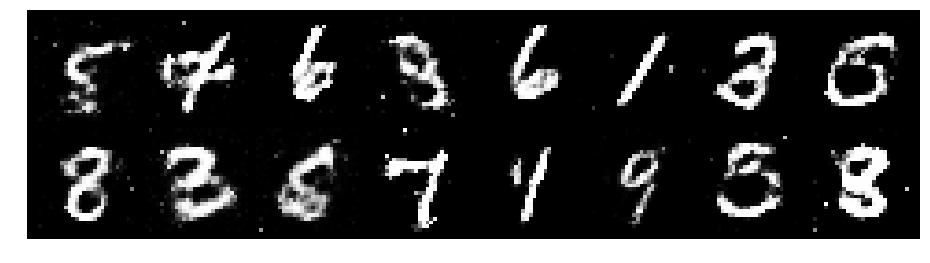

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1735, Generator Loss: 1.0205
D(x): 0.6314, D(G(z)): 0.4449


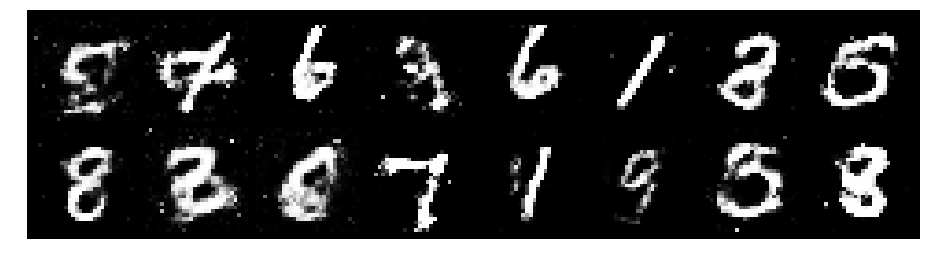

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1457, Generator Loss: 0.9494
D(x): 0.6091, D(G(z)): 0.4025


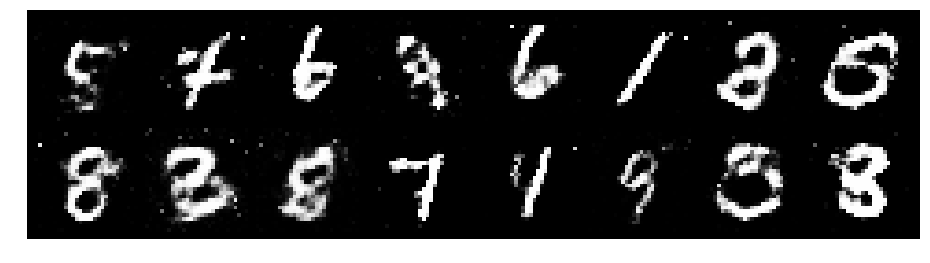

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.0865, Generator Loss: 1.1038
D(x): 0.5702, D(G(z)): 0.3604


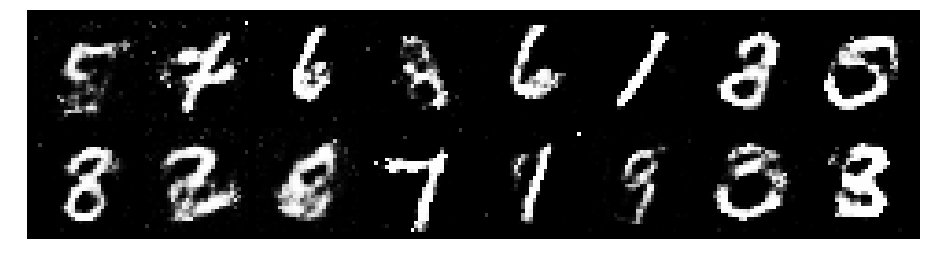

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2348, Generator Loss: 0.9998
D(x): 0.5474, D(G(z)): 0.4174


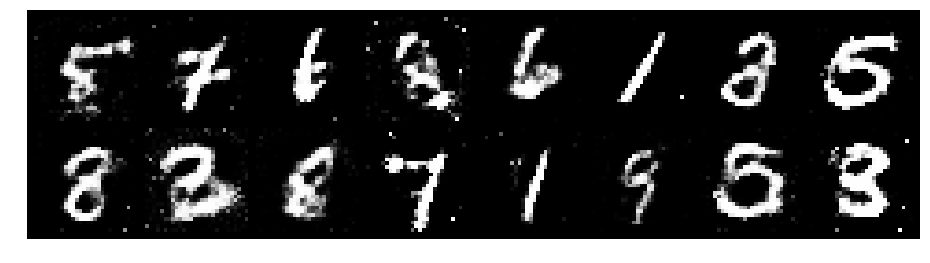

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2725, Generator Loss: 0.9410
D(x): 0.5646, D(G(z)): 0.4516


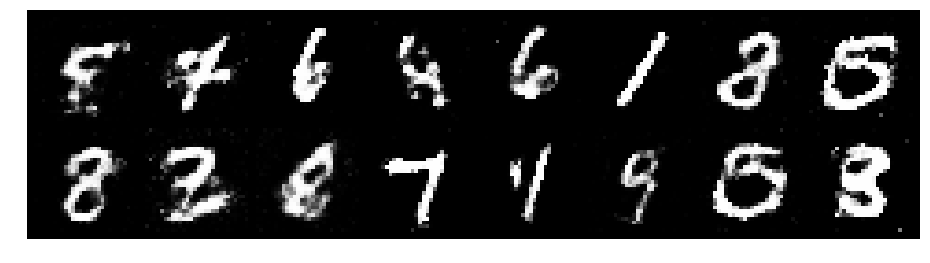

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.3968, Generator Loss: 0.8509
D(x): 0.5662, D(G(z)): 0.4844


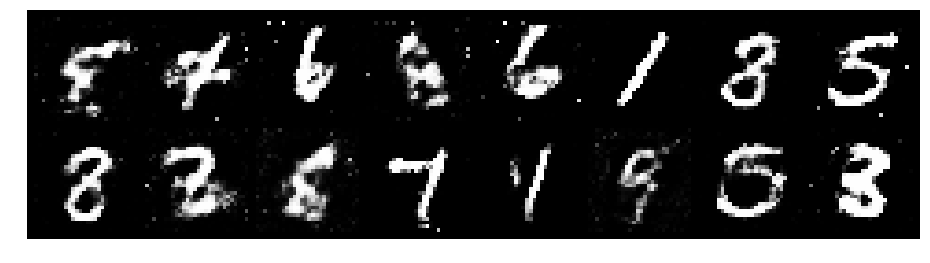

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2063, Generator Loss: 1.1087
D(x): 0.5818, D(G(z)): 0.4088


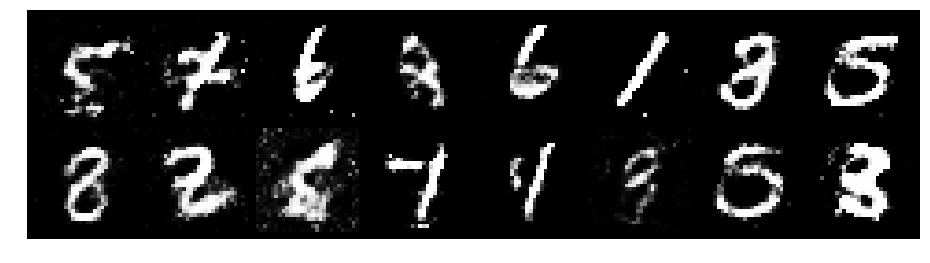

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2875, Generator Loss: 0.9710
D(x): 0.5427, D(G(z)): 0.3862


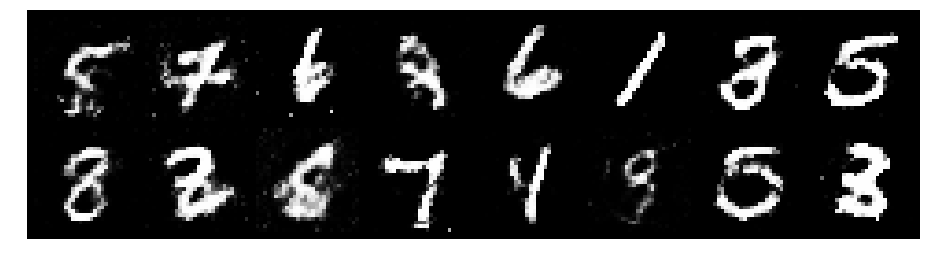

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1381, Generator Loss: 1.2529
D(x): 0.6206, D(G(z)): 0.4025


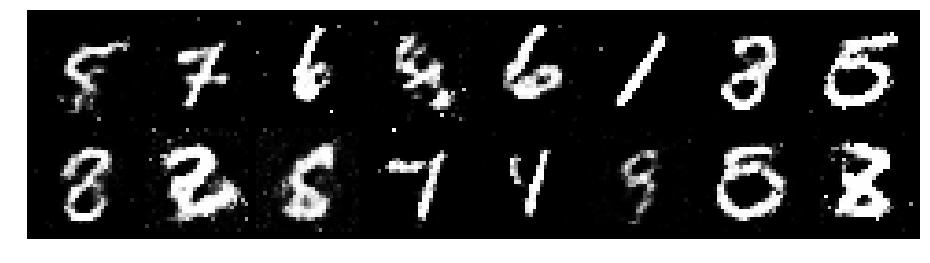

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1843, Generator Loss: 1.0866
D(x): 0.5437, D(G(z)): 0.3670


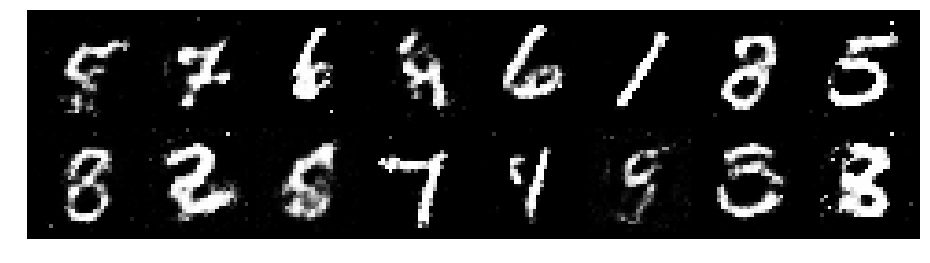

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2090, Generator Loss: 0.8674
D(x): 0.5620, D(G(z)): 0.4048


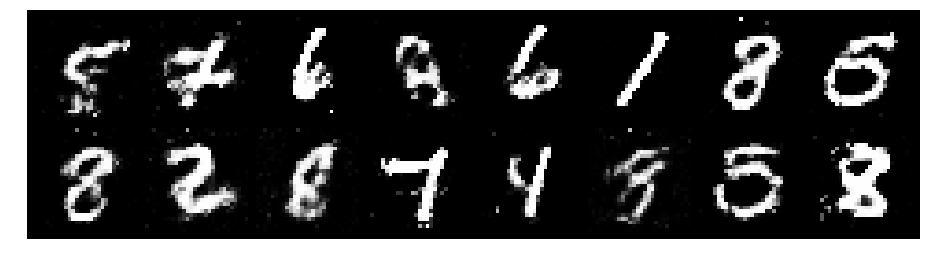

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2539, Generator Loss: 1.0149
D(x): 0.5254, D(G(z)): 0.4065


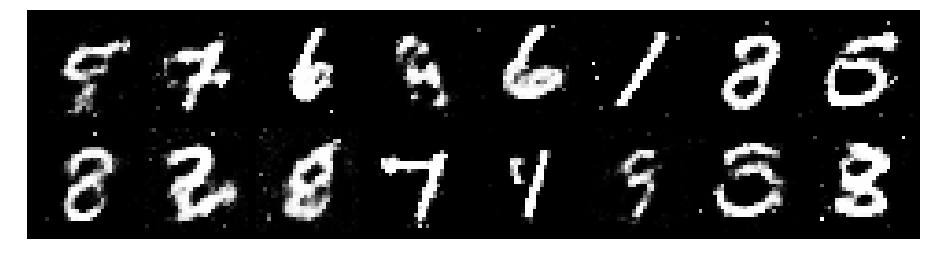

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.3108, Generator Loss: 0.9386
D(x): 0.5905, D(G(z)): 0.4518


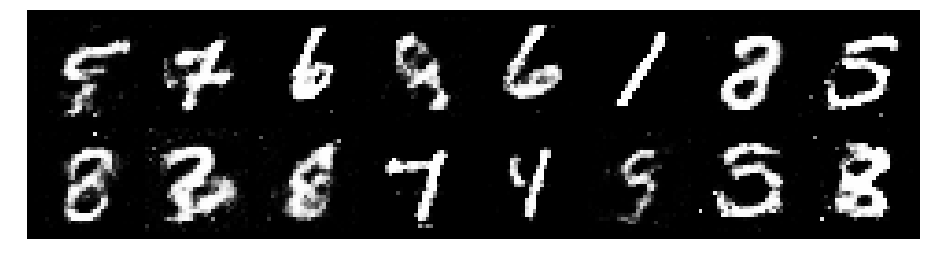

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1264, Generator Loss: 1.0704
D(x): 0.5989, D(G(z)): 0.3664


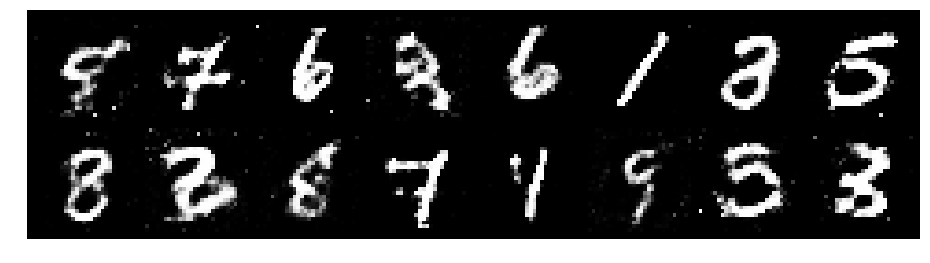

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.1641, Generator Loss: 0.9650
D(x): 0.5860, D(G(z)): 0.4023


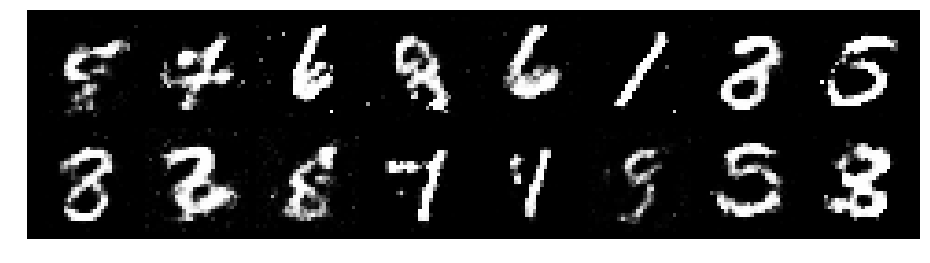

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.1531, Generator Loss: 1.1546
D(x): 0.5978, D(G(z)): 0.3755


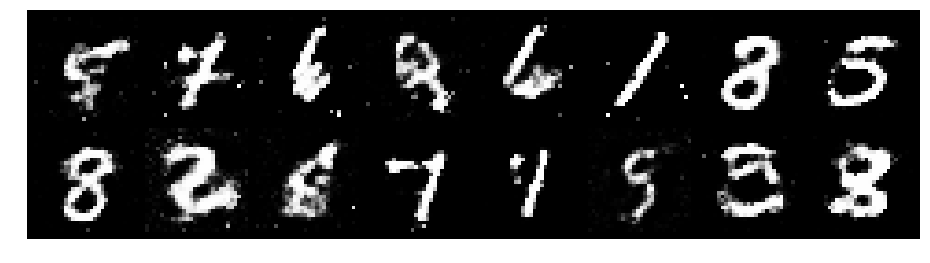

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.0459, Generator Loss: 1.1506
D(x): 0.5829, D(G(z)): 0.3293


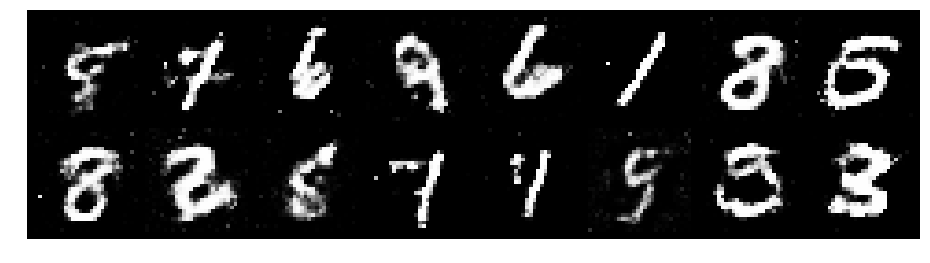

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9647
D(x): 0.5570, D(G(z)): 0.4141


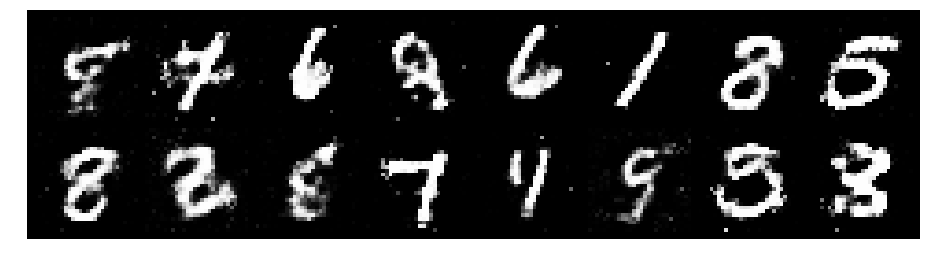

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.3367, Generator Loss: 0.9514
D(x): 0.5762, D(G(z)): 0.4646


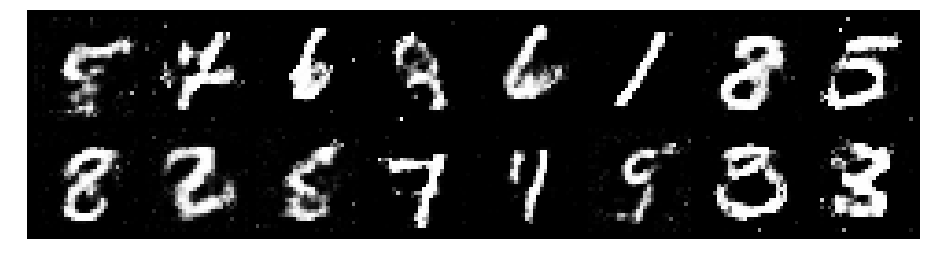

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.2432, Generator Loss: 0.8669
D(x): 0.5639, D(G(z)): 0.4259


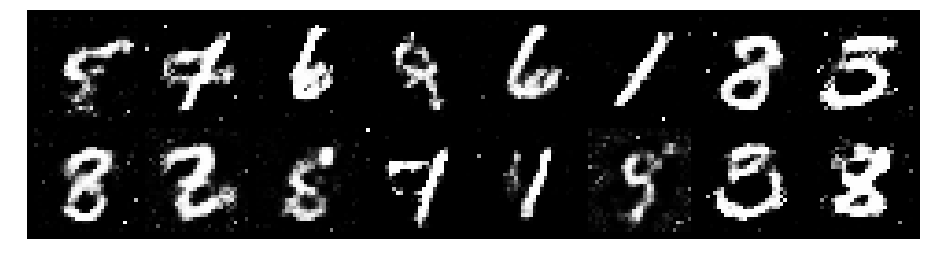

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1408, Generator Loss: 0.9274
D(x): 0.5590, D(G(z)): 0.3838


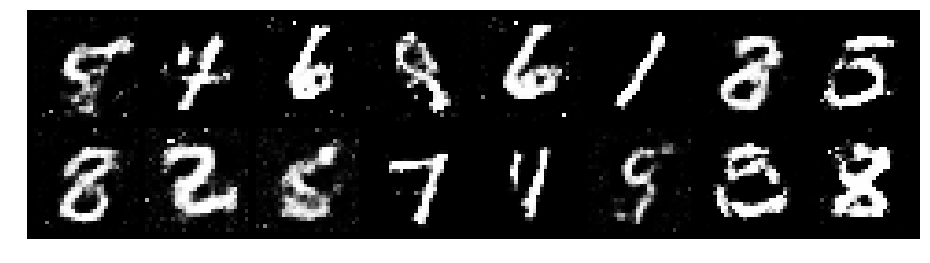

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1968, Generator Loss: 1.0134
D(x): 0.5538, D(G(z)): 0.4028


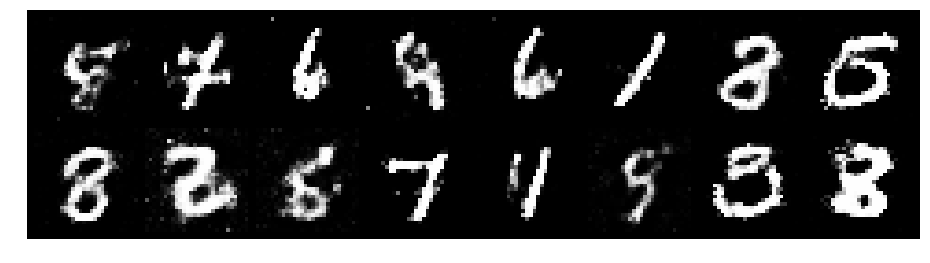

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1145, Generator Loss: 0.9483
D(x): 0.5965, D(G(z)): 0.4181


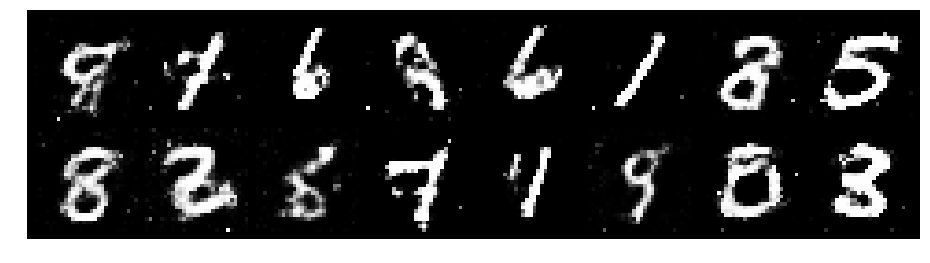

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2804, Generator Loss: 1.0117
D(x): 0.5592, D(G(z)): 0.4423


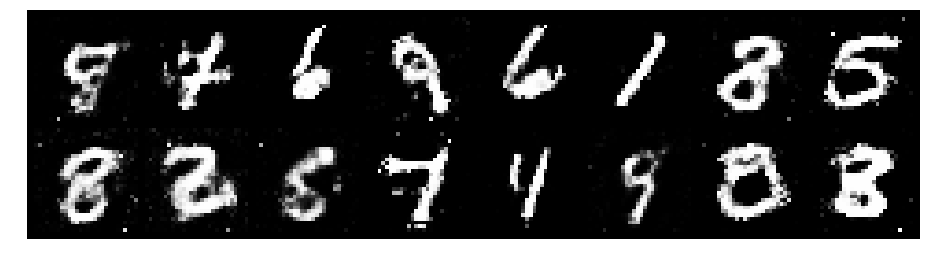

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1607, Generator Loss: 0.9385
D(x): 0.5834, D(G(z)): 0.3995


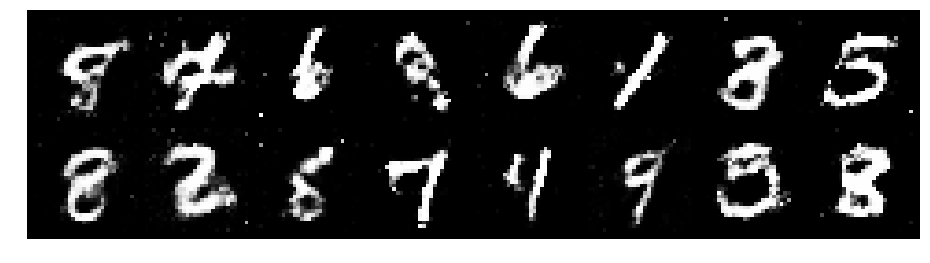

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2161, Generator Loss: 1.1294
D(x): 0.6157, D(G(z)): 0.4350


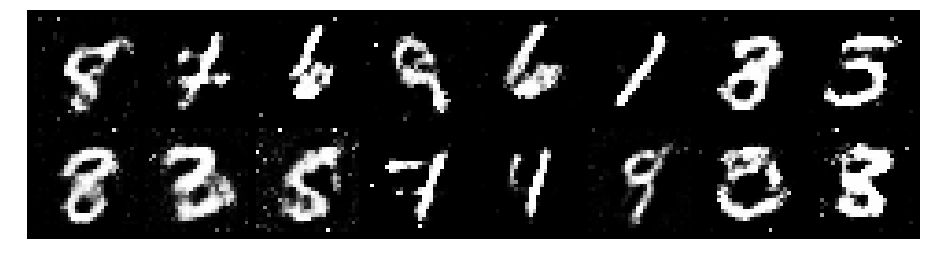

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.1940, Generator Loss: 0.9521
D(x): 0.6231, D(G(z)): 0.4510


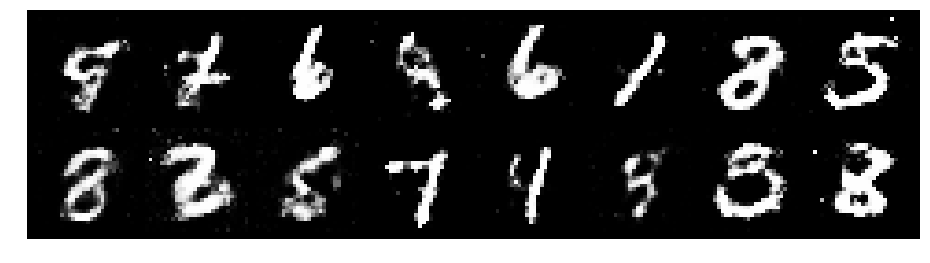

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1396, Generator Loss: 1.2531
D(x): 0.6119, D(G(z)): 0.3983


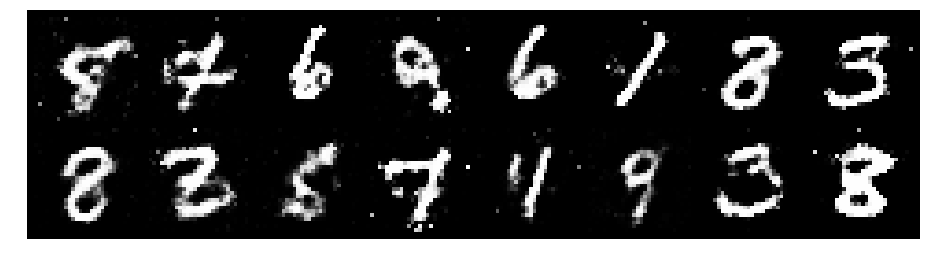

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.0784, Generator Loss: 1.3434
D(x): 0.6118, D(G(z)): 0.3572


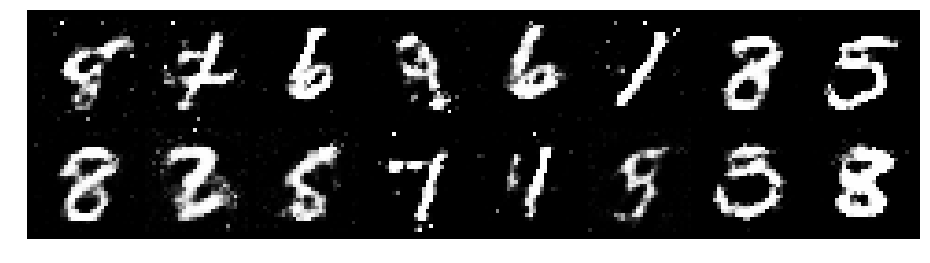

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2148, Generator Loss: 1.0926
D(x): 0.5868, D(G(z)): 0.4279


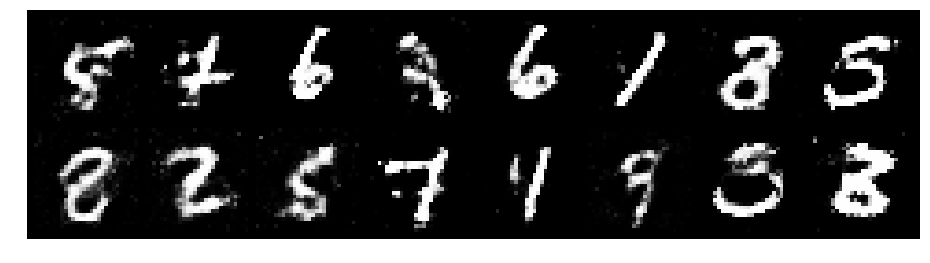

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1766, Generator Loss: 1.0423
D(x): 0.5523, D(G(z)): 0.3525


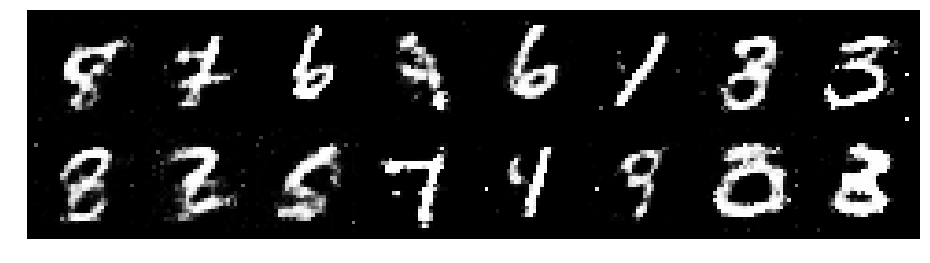

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2634, Generator Loss: 0.8213
D(x): 0.5514, D(G(z)): 0.4365


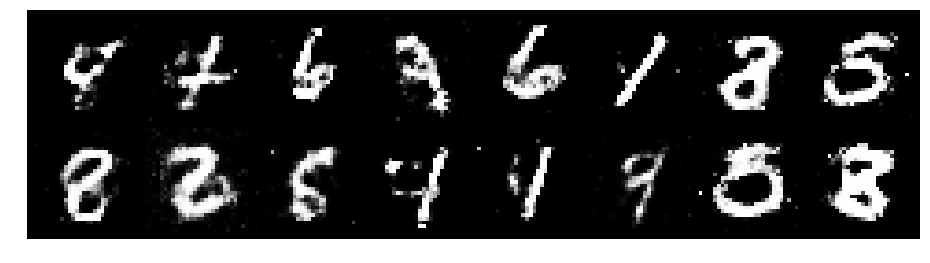

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.3048, Generator Loss: 0.9200
D(x): 0.5826, D(G(z)): 0.4773


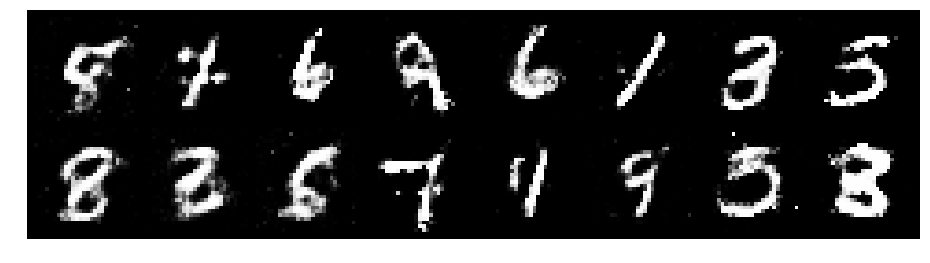

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.3833, Generator Loss: 0.8922
D(x): 0.5404, D(G(z)): 0.4716


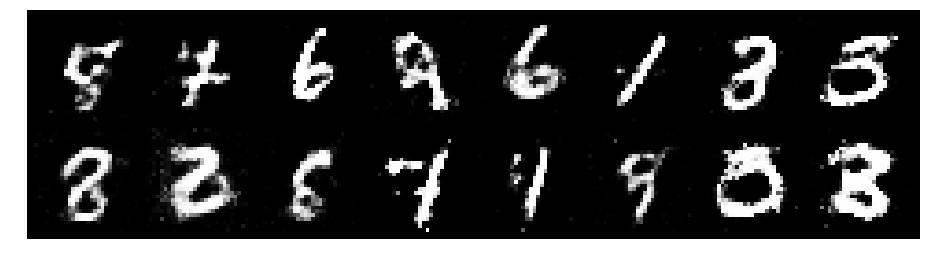

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2895, Generator Loss: 0.8418
D(x): 0.5936, D(G(z)): 0.4676


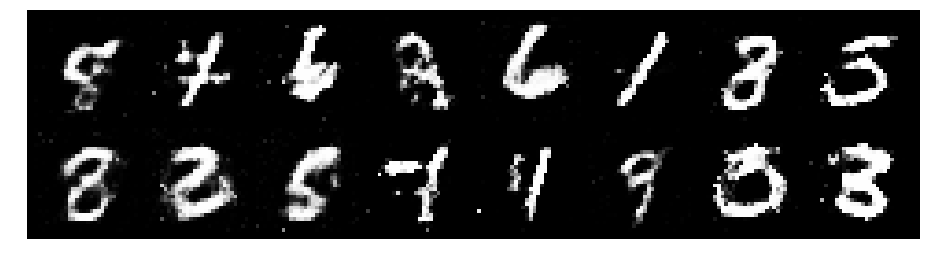

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1699, Generator Loss: 0.9535
D(x): 0.6025, D(G(z)): 0.4112


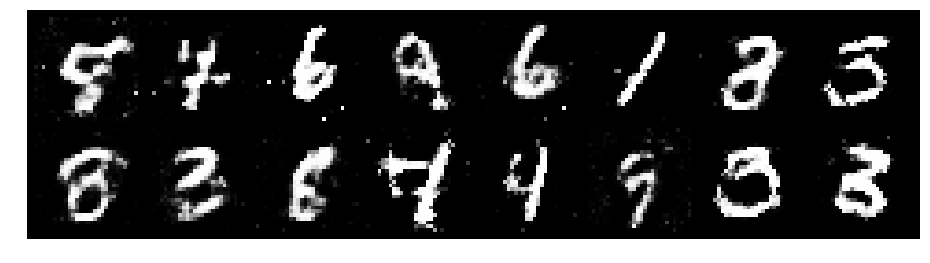

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2354, Generator Loss: 1.1471
D(x): 0.5812, D(G(z)): 0.4097


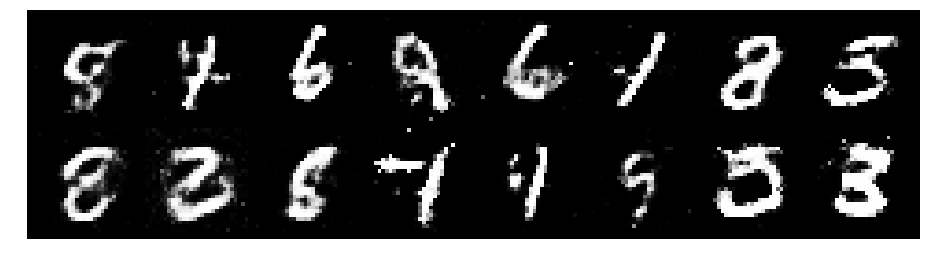

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2626, Generator Loss: 0.9607
D(x): 0.5745, D(G(z)): 0.4348


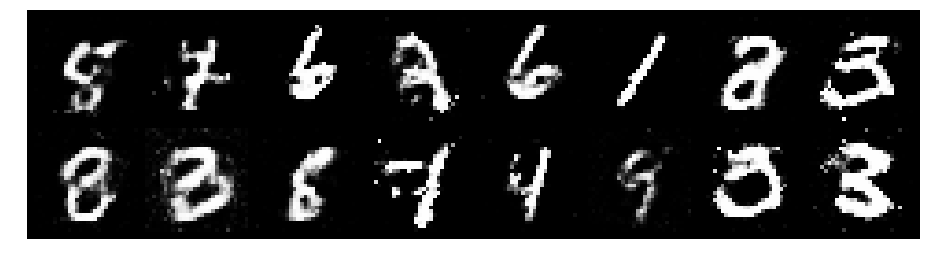

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.1084, Generator Loss: 1.2009
D(x): 0.5979, D(G(z)): 0.3580


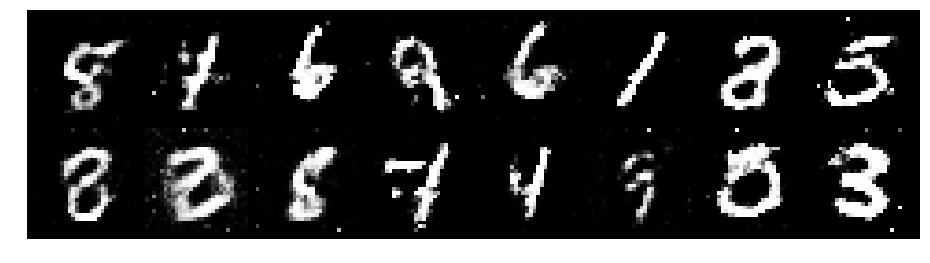

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2337, Generator Loss: 1.1538
D(x): 0.5509, D(G(z)): 0.3911


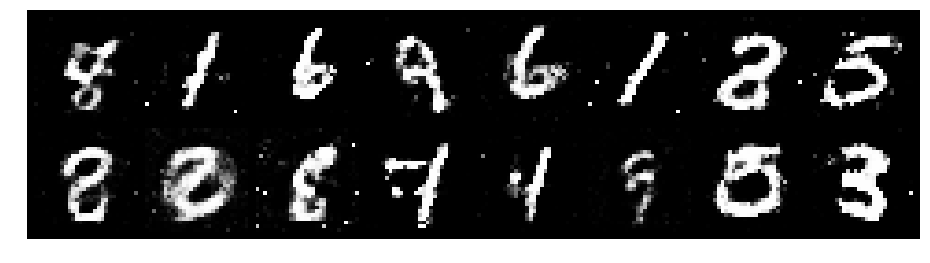

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1206, Generator Loss: 1.0905
D(x): 0.5915, D(G(z)): 0.3709


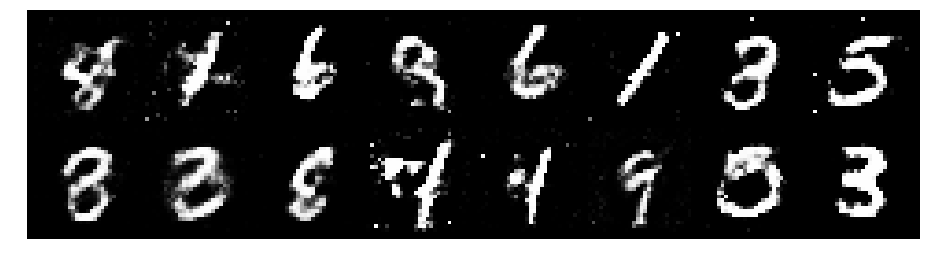

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2727, Generator Loss: 0.8894
D(x): 0.5699, D(G(z)): 0.4567


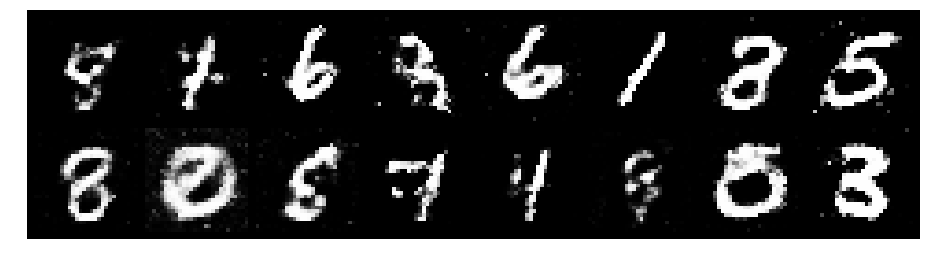

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.0468, Generator Loss: 0.9772
D(x): 0.6215, D(G(z)): 0.3618


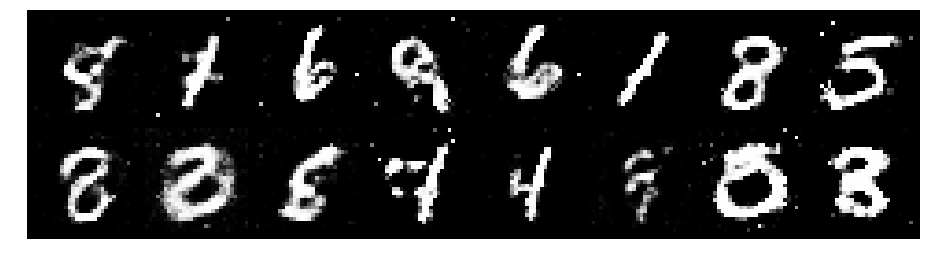

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.1498, Generator Loss: 1.0418
D(x): 0.6221, D(G(z)): 0.4166


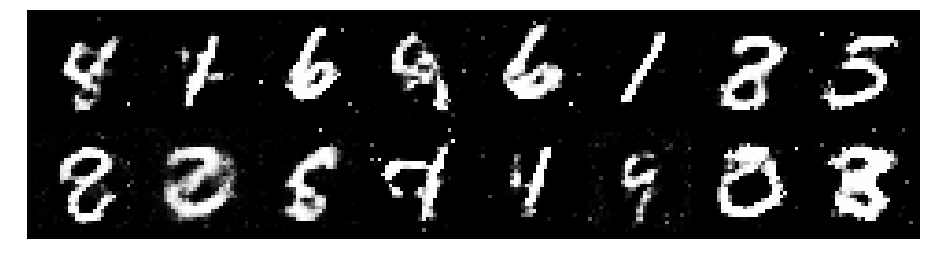

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.3625, Generator Loss: 1.0359
D(x): 0.5157, D(G(z)): 0.4214


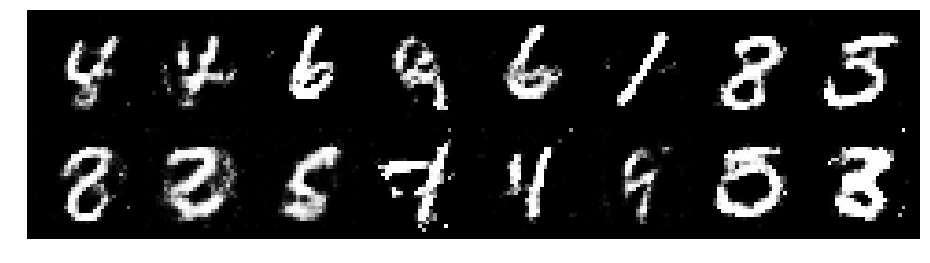

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2600, Generator Loss: 0.8786
D(x): 0.6175, D(G(z)): 0.4805


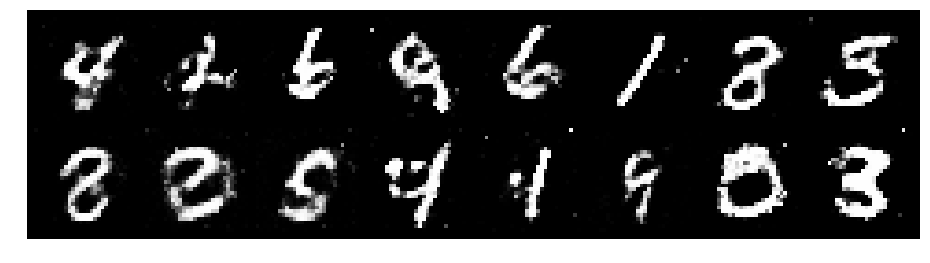

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2699, Generator Loss: 0.8552
D(x): 0.5714, D(G(z)): 0.4396


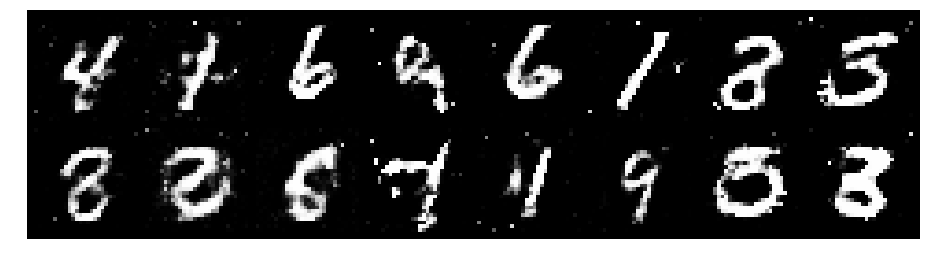

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.0823, Generator Loss: 1.3304
D(x): 0.6126, D(G(z)): 0.3759


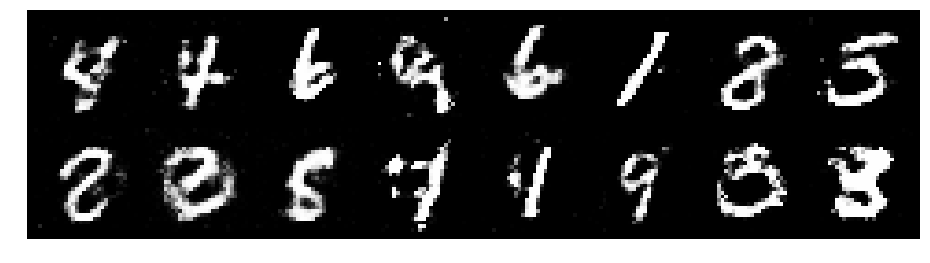

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.1904, Generator Loss: 1.1031
D(x): 0.6212, D(G(z)): 0.4178


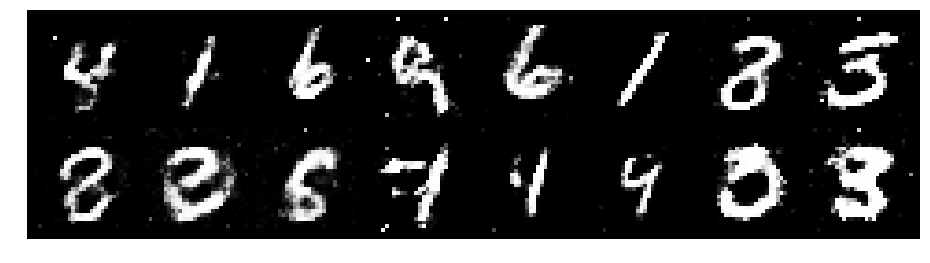

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1141, Generator Loss: 1.0035
D(x): 0.6010, D(G(z)): 0.3907


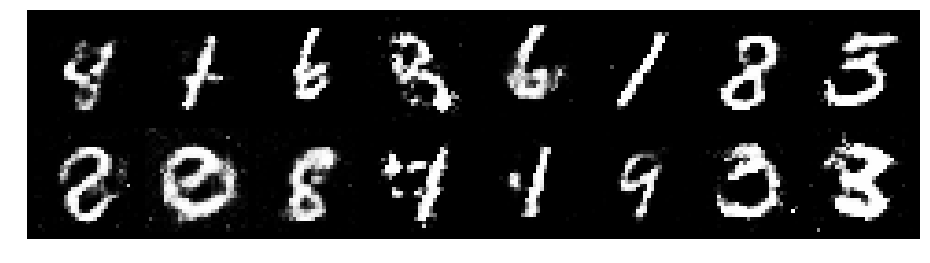

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2326, Generator Loss: 1.1209
D(x): 0.6454, D(G(z)): 0.4644


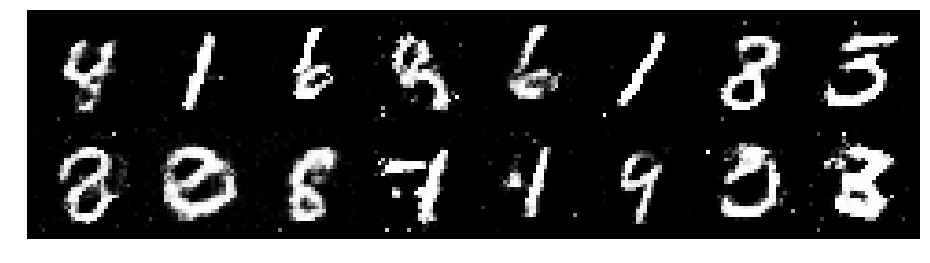

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2624, Generator Loss: 0.9429
D(x): 0.6041, D(G(z)): 0.4342


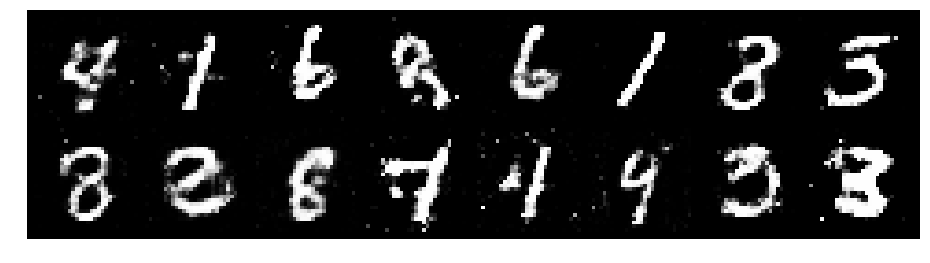

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.3298, Generator Loss: 1.0498
D(x): 0.5880, D(G(z)): 0.4593


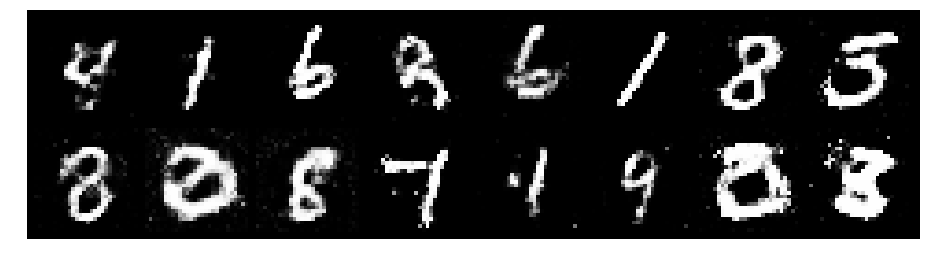

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2695, Generator Loss: 1.0283
D(x): 0.5666, D(G(z)): 0.4125


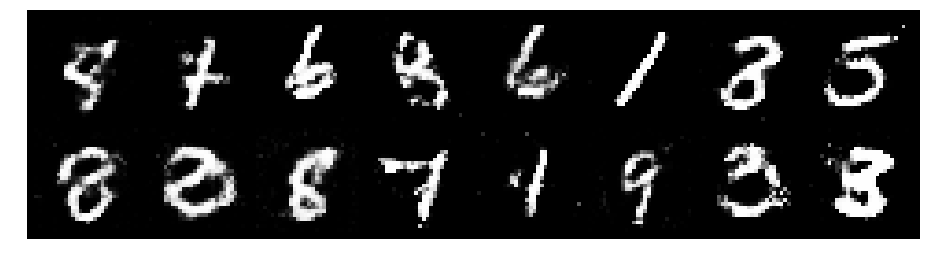

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.1802, Generator Loss: 1.4849
D(x): 0.6340, D(G(z)): 0.3858


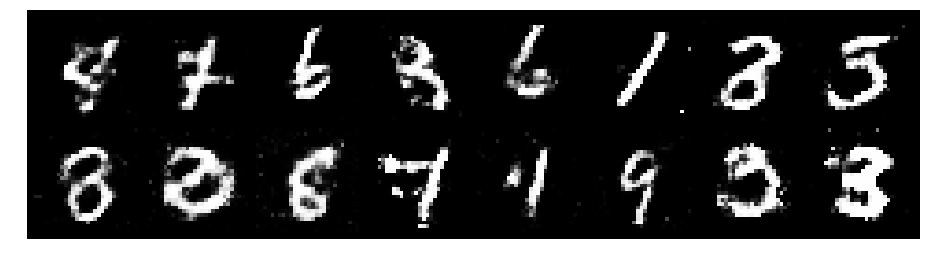

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.3514, Generator Loss: 1.0429
D(x): 0.5407, D(G(z)): 0.4351


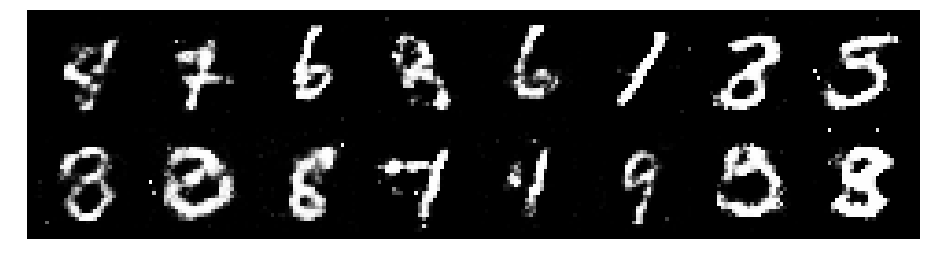

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1573, Generator Loss: 1.0490
D(x): 0.5789, D(G(z)): 0.3906


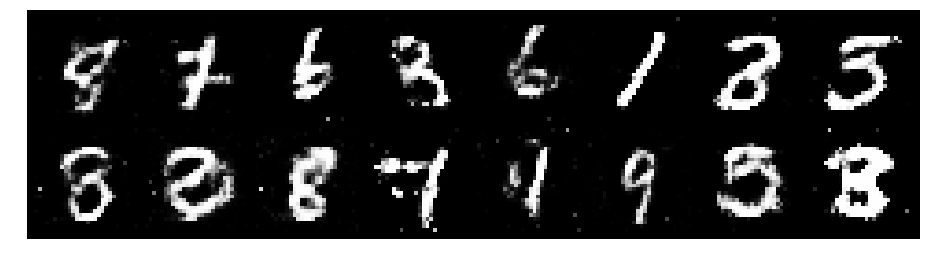

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.1724, Generator Loss: 0.9816
D(x): 0.5992, D(G(z)): 0.3986


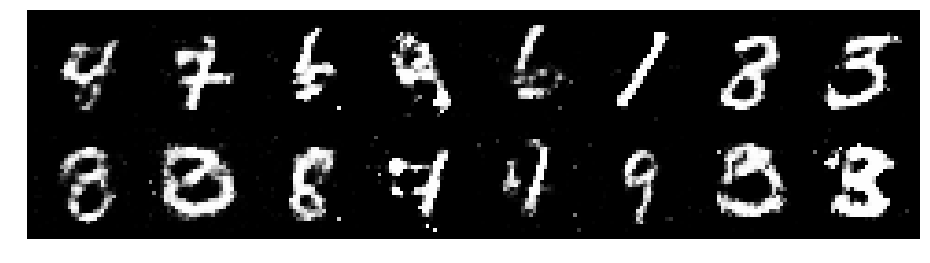

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2036, Generator Loss: 1.2040
D(x): 0.5522, D(G(z)): 0.3850


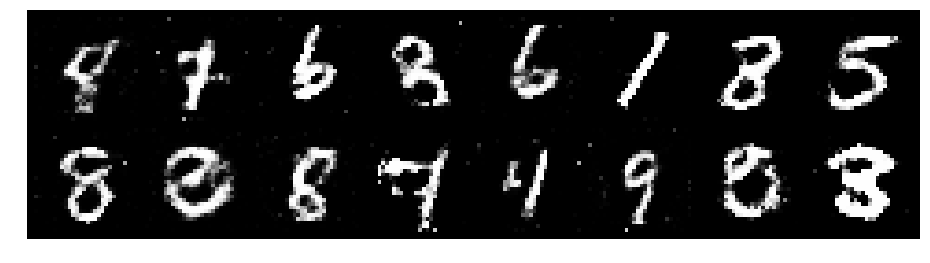

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2365, Generator Loss: 1.0199
D(x): 0.5570, D(G(z)): 0.4081


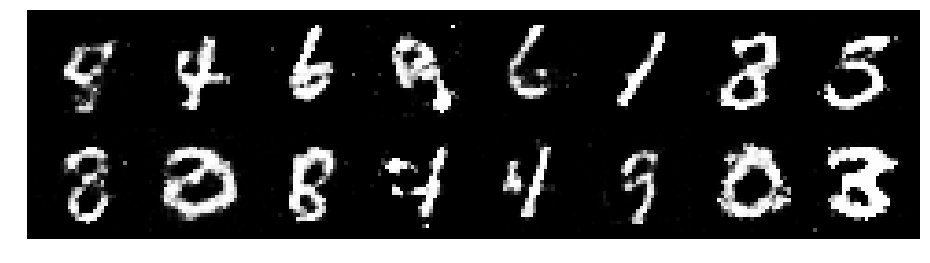

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2142, Generator Loss: 0.8689
D(x): 0.5690, D(G(z)): 0.4216


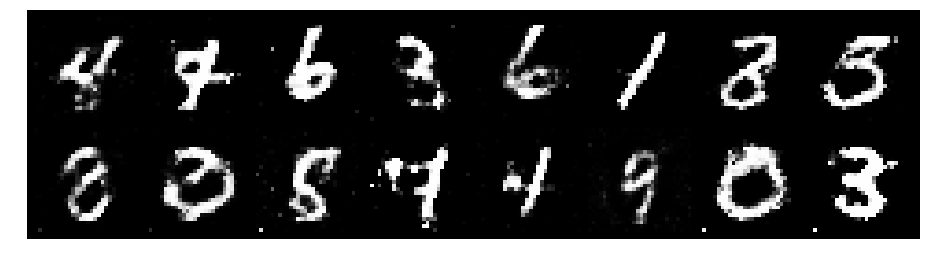

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2872, Generator Loss: 1.0564
D(x): 0.5871, D(G(z)): 0.4475


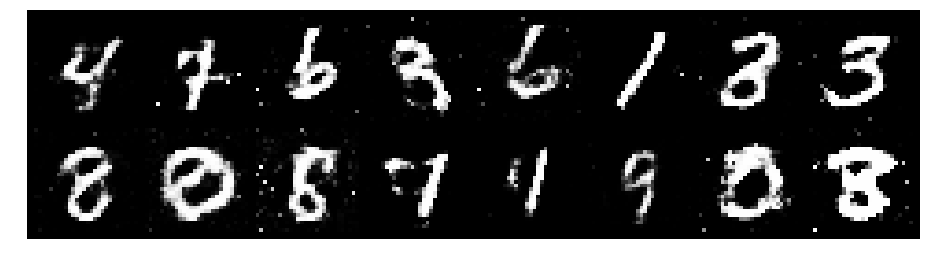

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.9724
D(x): 0.5811, D(G(z)): 0.4430


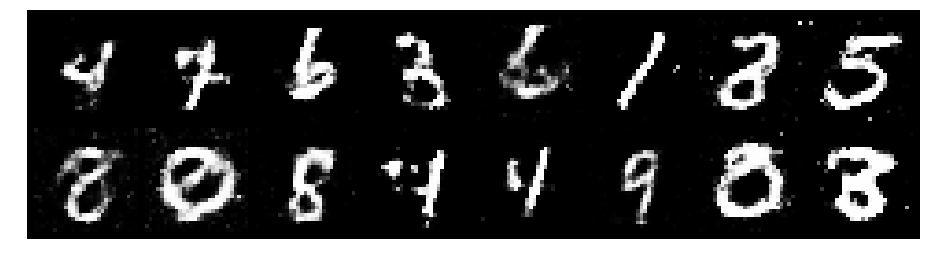

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2527, Generator Loss: 0.9423
D(x): 0.5416, D(G(z)): 0.4114


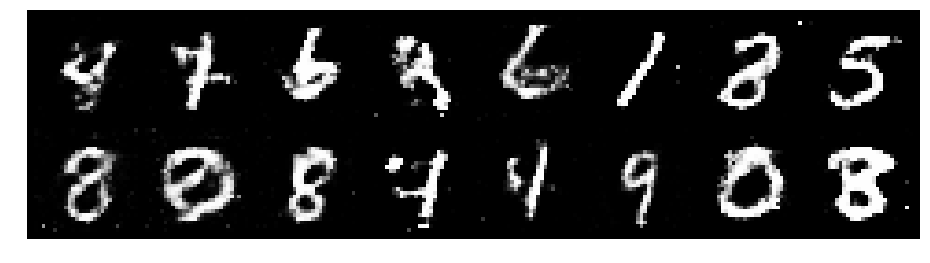

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2149, Generator Loss: 1.1409
D(x): 0.5590, D(G(z)): 0.4015


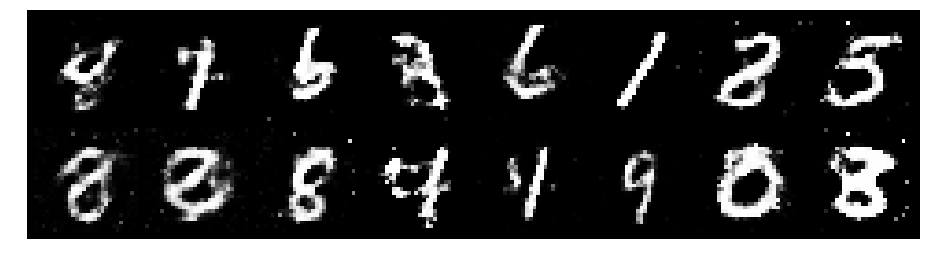

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2733, Generator Loss: 0.9247
D(x): 0.5981, D(G(z)): 0.4707


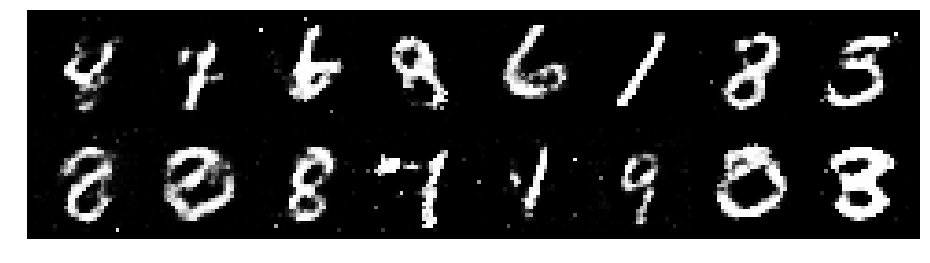

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.3050, Generator Loss: 0.9700
D(x): 0.5828, D(G(z)): 0.4407


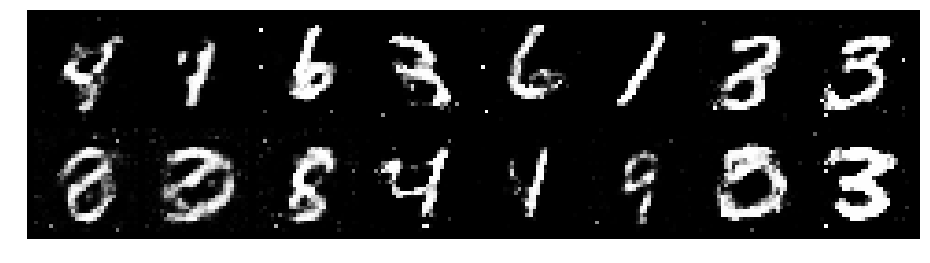

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2296, Generator Loss: 0.9944
D(x): 0.6038, D(G(z)): 0.4426


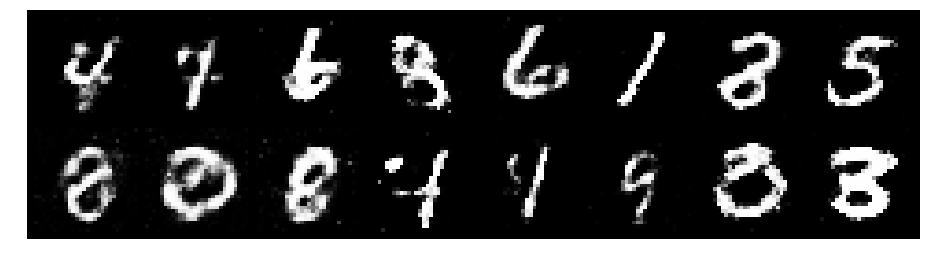

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2223, Generator Loss: 1.0523
D(x): 0.5990, D(G(z)): 0.4518


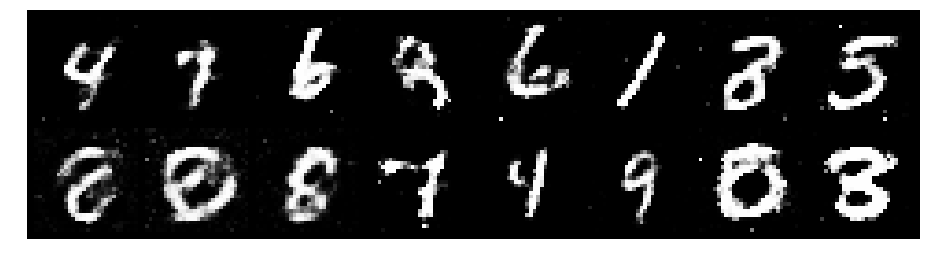

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.2975, Generator Loss: 0.9503
D(x): 0.5710, D(G(z)): 0.4465


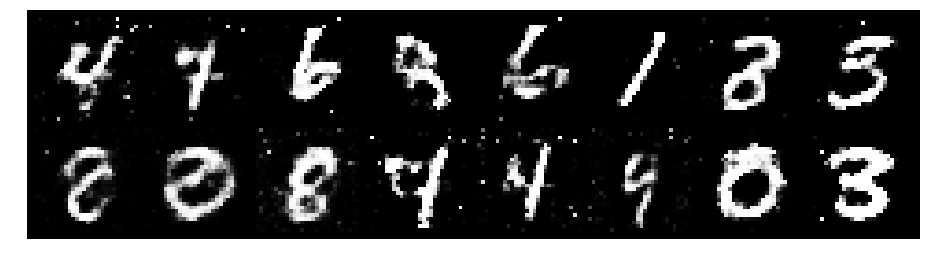

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1967, Generator Loss: 1.0094
D(x): 0.6207, D(G(z)): 0.4376


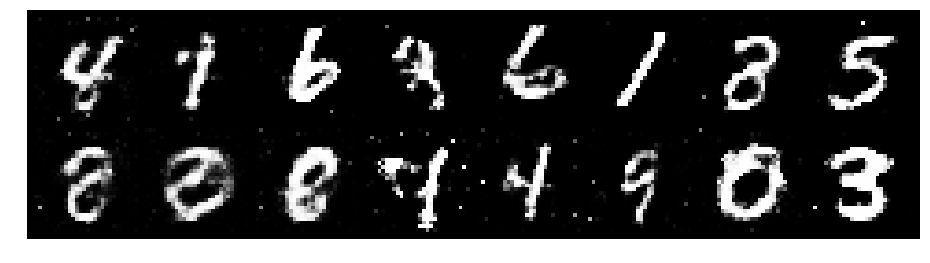

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.3525, Generator Loss: 0.8643
D(x): 0.5308, D(G(z)): 0.4694


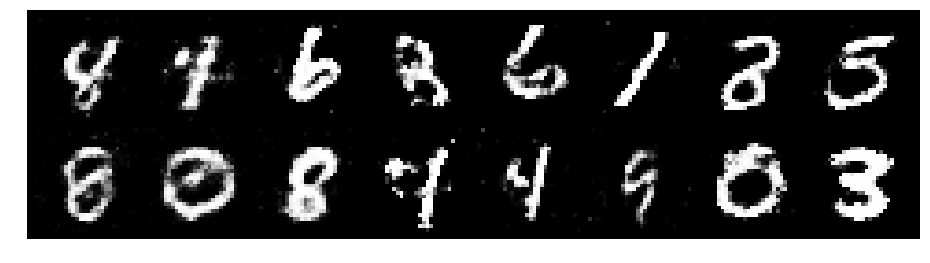

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2751, Generator Loss: 0.8621
D(x): 0.5554, D(G(z)): 0.4517


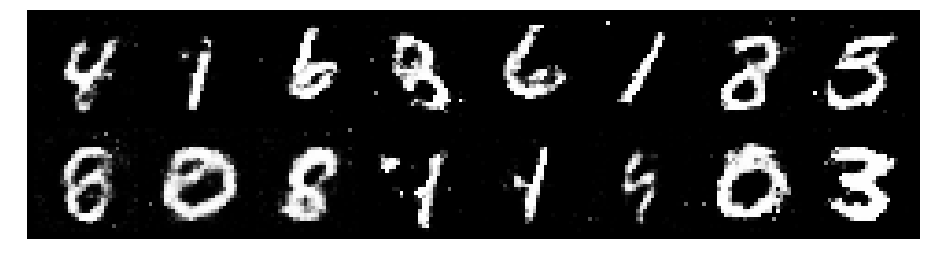

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2078, Generator Loss: 0.8585
D(x): 0.5876, D(G(z)): 0.4236


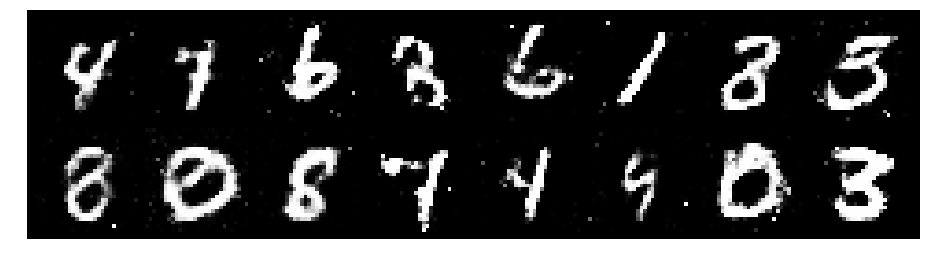

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2985, Generator Loss: 0.9512
D(x): 0.5515, D(G(z)): 0.4524


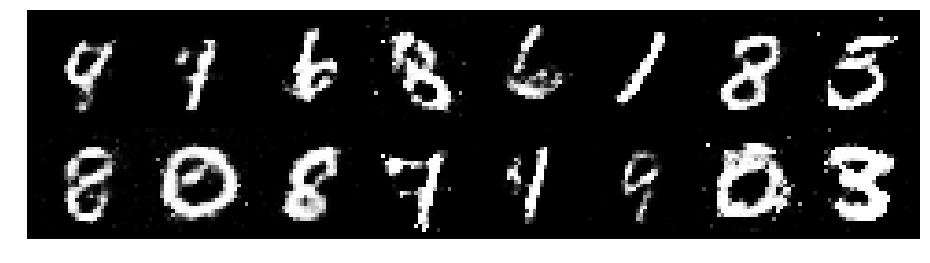

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.2858, Generator Loss: 1.0183
D(x): 0.5779, D(G(z)): 0.4384


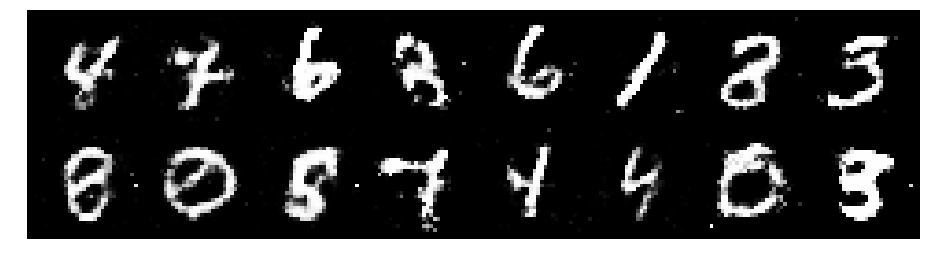

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.1777, Generator Loss: 0.9569
D(x): 0.5929, D(G(z)): 0.4226


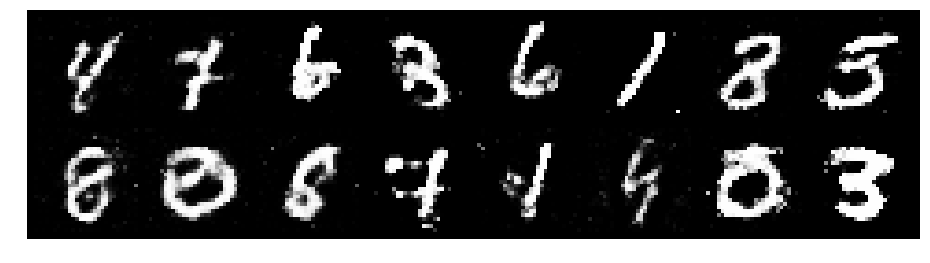

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3330, Generator Loss: 0.7934
D(x): 0.5509, D(G(z)): 0.4807


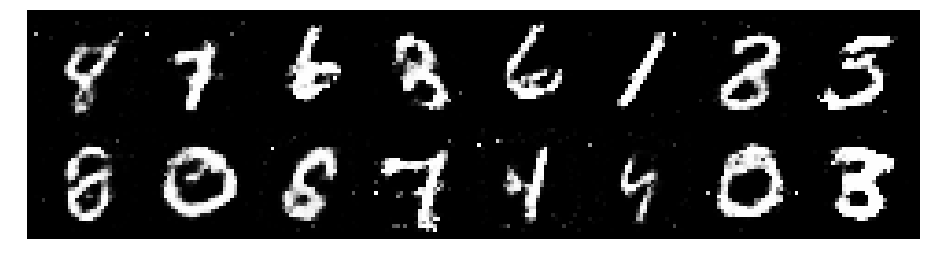

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2585, Generator Loss: 0.7991
D(x): 0.5903, D(G(z)): 0.4664


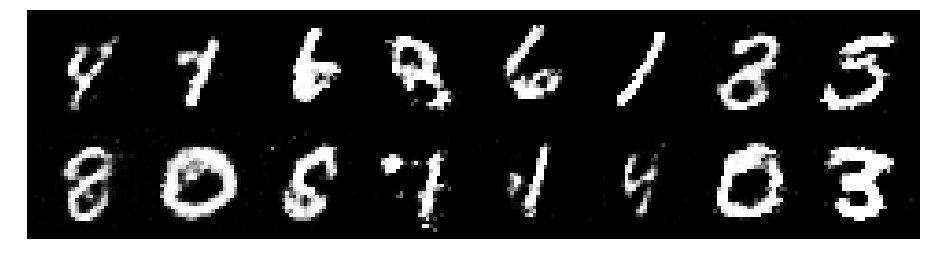

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.3091, Generator Loss: 1.1552
D(x): 0.5892, D(G(z)): 0.4140


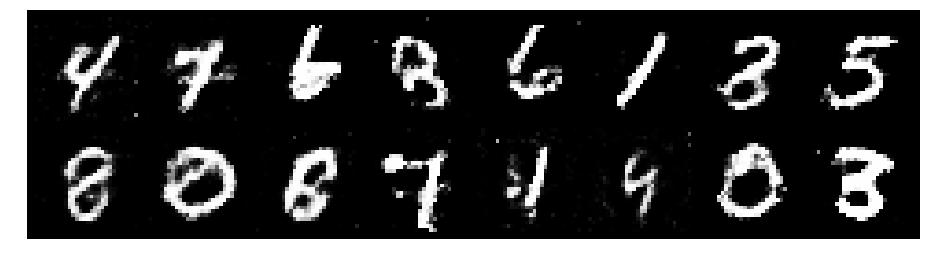

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.3141, Generator Loss: 0.9491
D(x): 0.5863, D(G(z)): 0.4498


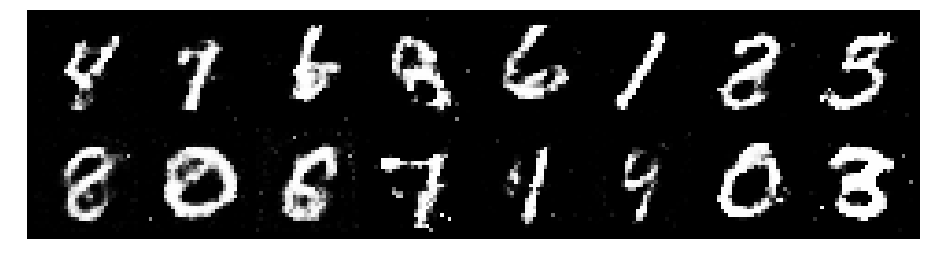

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.1223, Generator Loss: 1.0614
D(x): 0.5822, D(G(z)): 0.3854


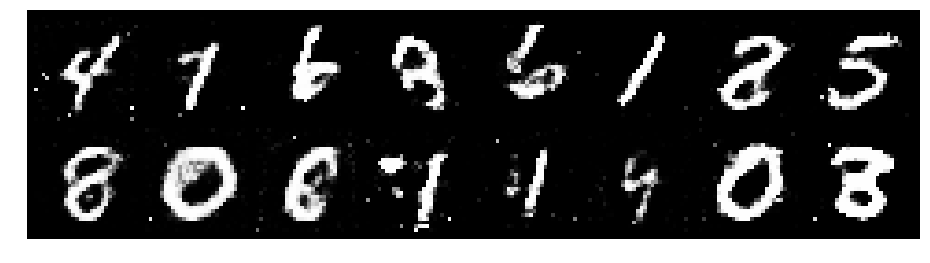

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2548, Generator Loss: 0.9600
D(x): 0.5600, D(G(z)): 0.4178


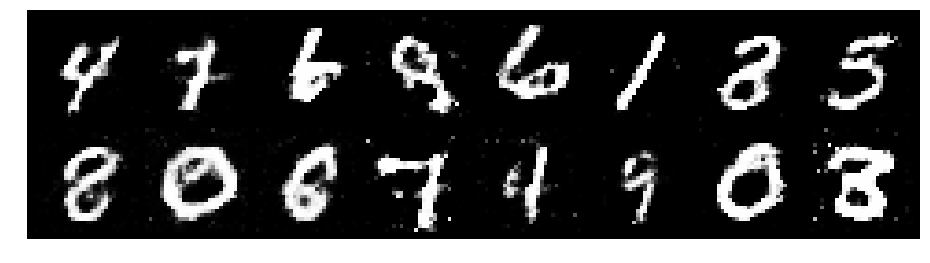

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2683, Generator Loss: 1.1212
D(x): 0.5444, D(G(z)): 0.3954


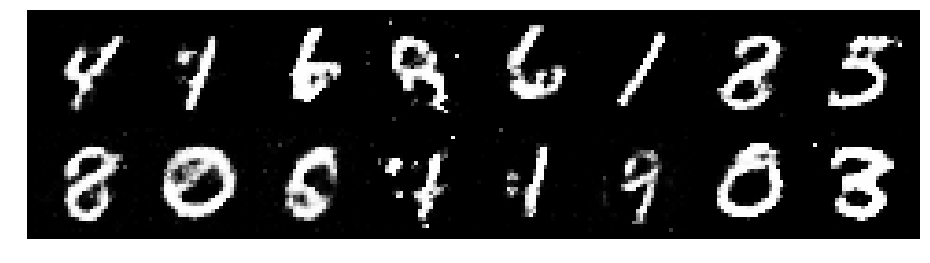

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9177
D(x): 0.5663, D(G(z)): 0.4171


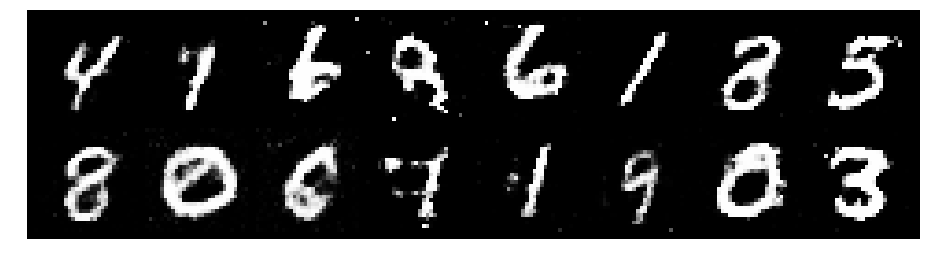

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1128, Generator Loss: 1.0180
D(x): 0.5724, D(G(z)): 0.3608


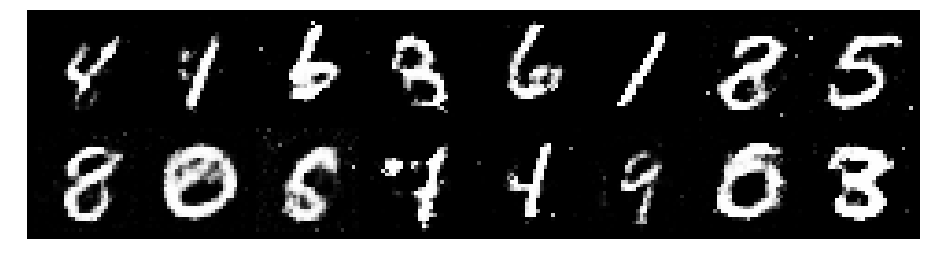

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2934, Generator Loss: 1.0092
D(x): 0.6105, D(G(z)): 0.4540


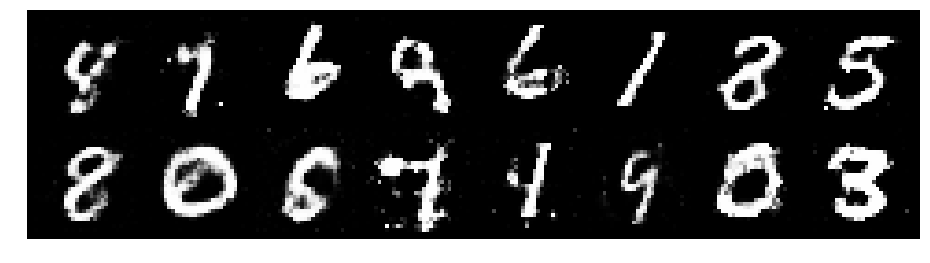

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.1699, Generator Loss: 1.0390
D(x): 0.6365, D(G(z)): 0.4089


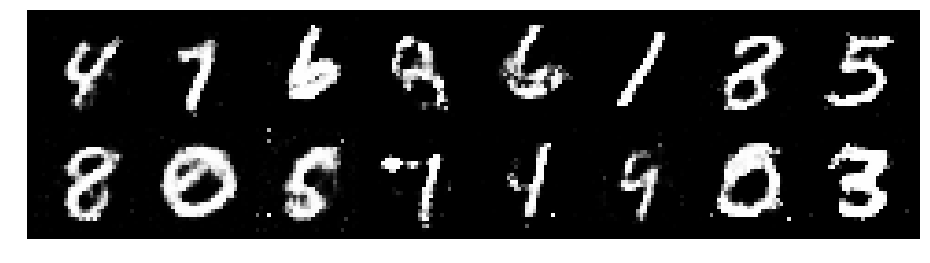

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1541, Generator Loss: 1.0950
D(x): 0.6106, D(G(z)): 0.3729


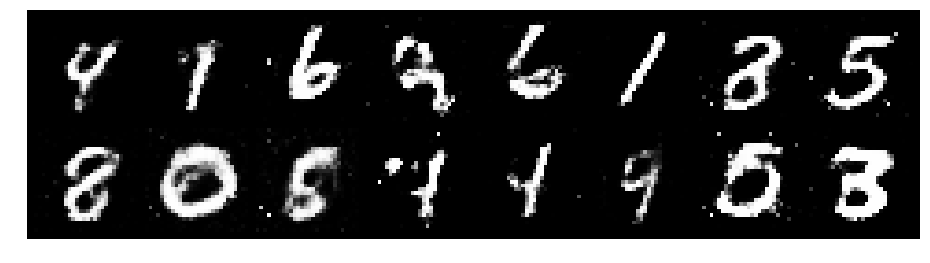

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1443, Generator Loss: 0.9351
D(x): 0.5990, D(G(z)): 0.4180


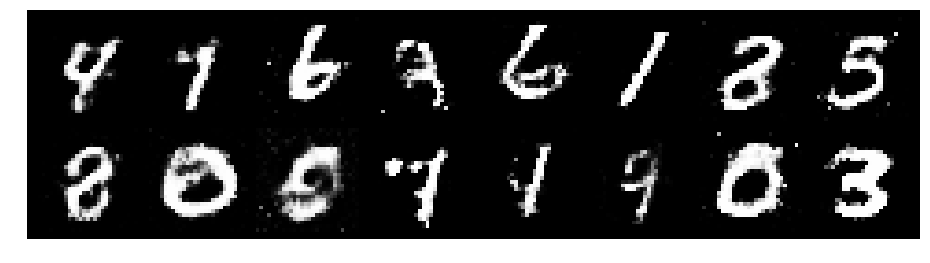

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1557, Generator Loss: 0.9469
D(x): 0.5806, D(G(z)): 0.4139


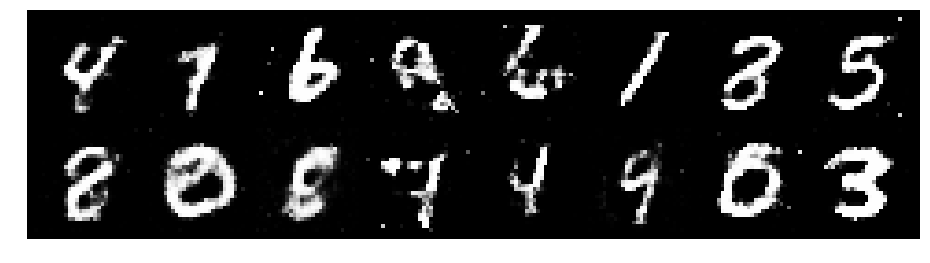

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.3232, Generator Loss: 0.9102
D(x): 0.5497, D(G(z)): 0.4513


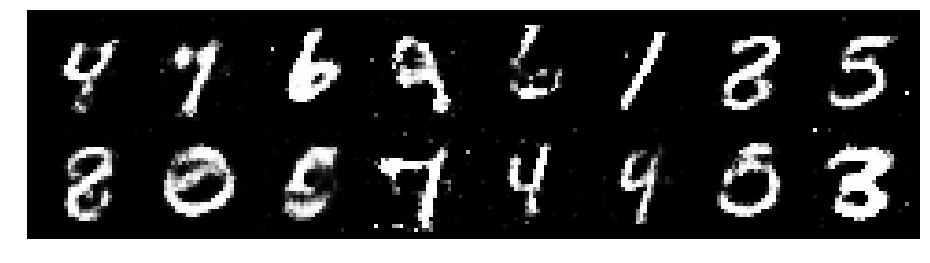

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.1797, Generator Loss: 0.9528
D(x): 0.5607, D(G(z)): 0.3925


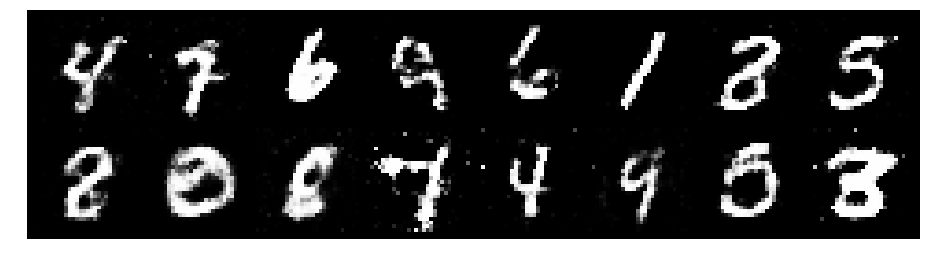

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2839, Generator Loss: 1.0101
D(x): 0.5814, D(G(z)): 0.4262


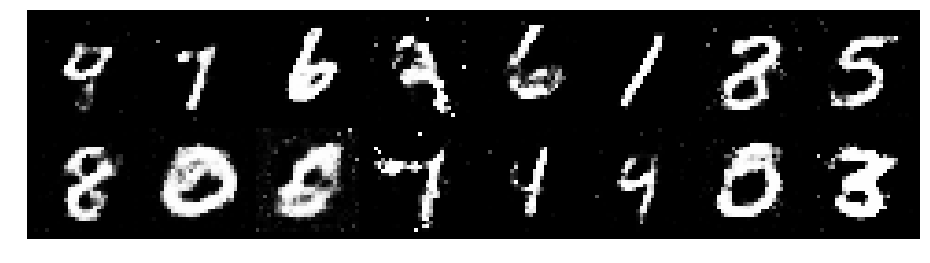

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.1173, Generator Loss: 1.1084
D(x): 0.5610, D(G(z)): 0.3572


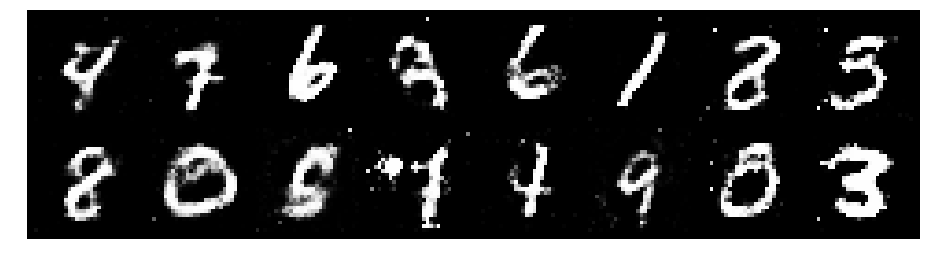

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2194, Generator Loss: 1.1950
D(x): 0.5493, D(G(z)): 0.4021


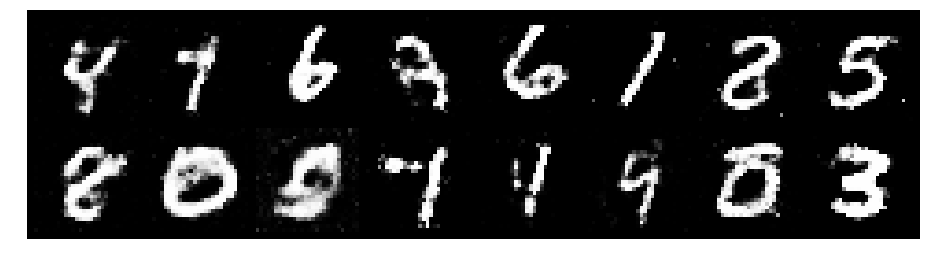

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1622, Generator Loss: 1.0024
D(x): 0.5692, D(G(z)): 0.3935


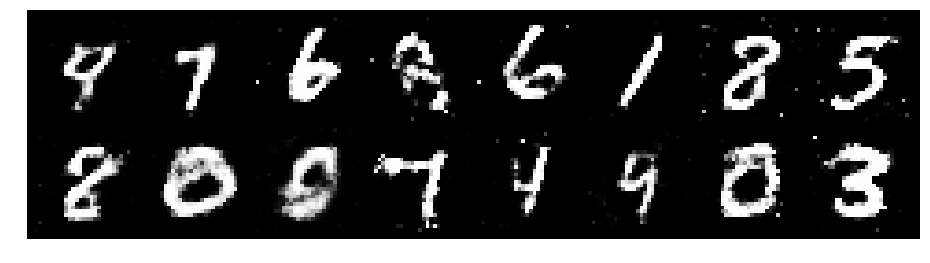

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2349, Generator Loss: 0.7386
D(x): 0.5874, D(G(z)): 0.4609


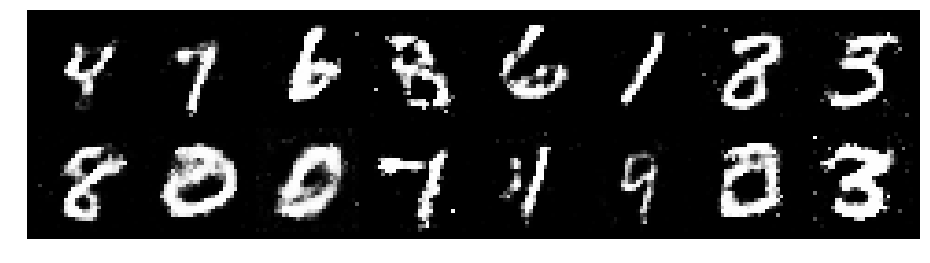

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1374, Generator Loss: 0.9399
D(x): 0.5736, D(G(z)): 0.3888


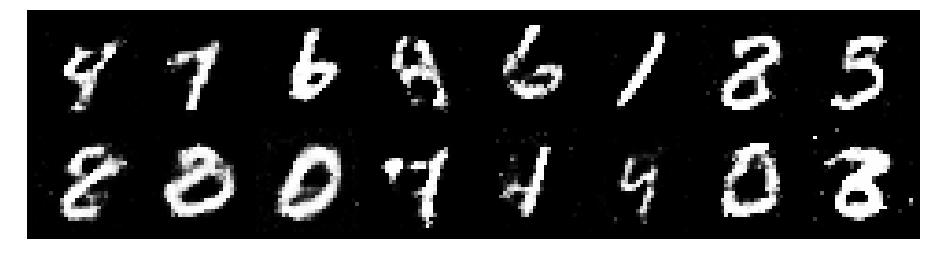

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2688, Generator Loss: 1.0718
D(x): 0.5593, D(G(z)): 0.3969


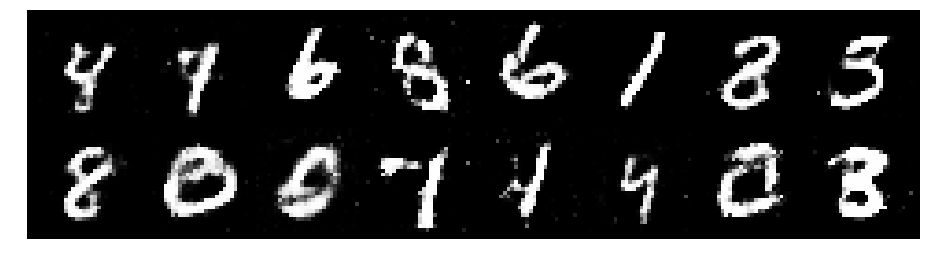

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1580, Generator Loss: 1.0612
D(x): 0.5906, D(G(z)): 0.3947


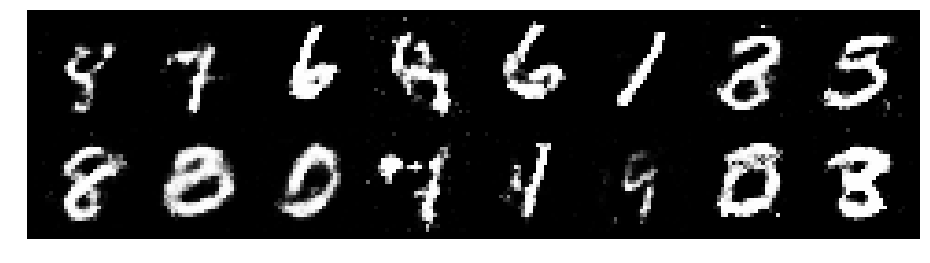

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2105, Generator Loss: 0.8981
D(x): 0.6041, D(G(z)): 0.4541


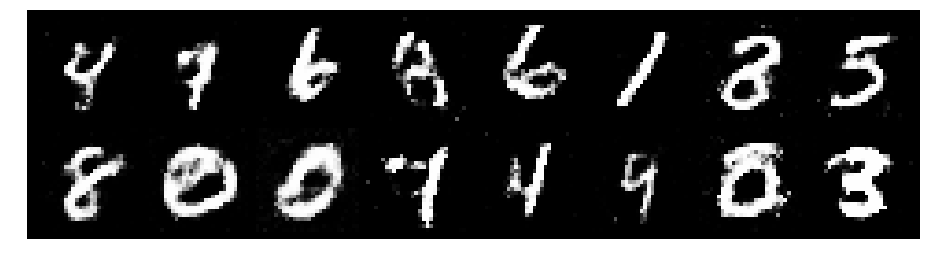

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1133, Generator Loss: 0.9905
D(x): 0.6255, D(G(z)): 0.4040


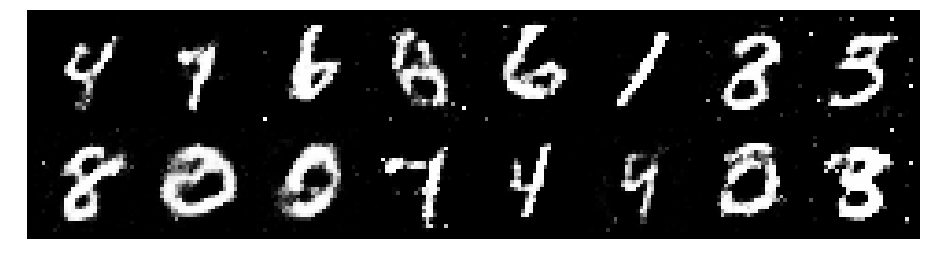

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.3563, Generator Loss: 0.8982
D(x): 0.5648, D(G(z)): 0.4719


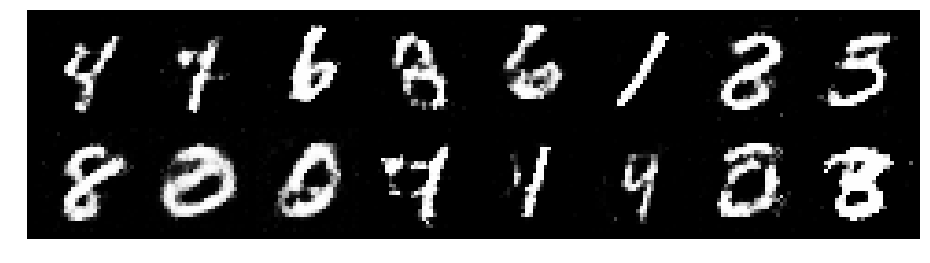

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2216, Generator Loss: 0.8074
D(x): 0.6160, D(G(z)): 0.4804


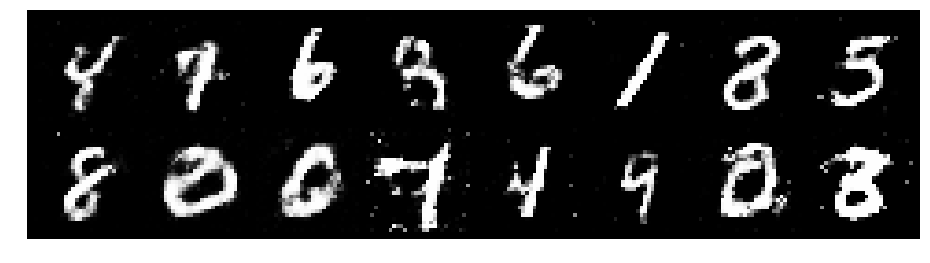

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2063, Generator Loss: 1.2379
D(x): 0.5908, D(G(z)): 0.3948


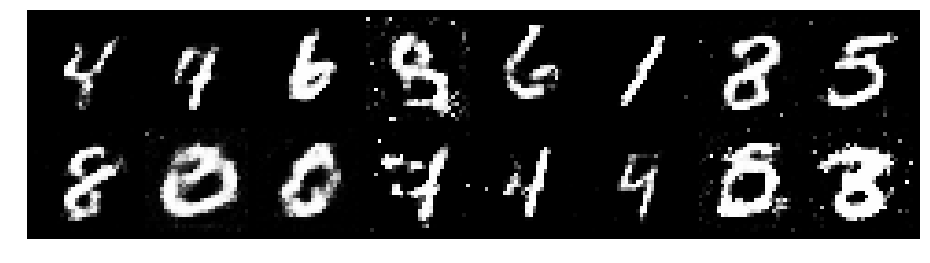

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.4137, Generator Loss: 1.0537
D(x): 0.4793, D(G(z)): 0.4041


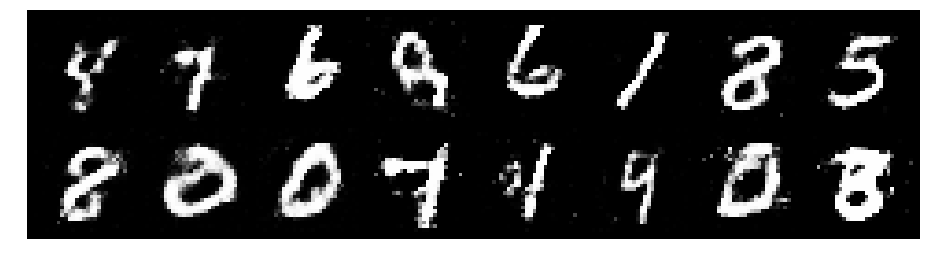

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.2648, Generator Loss: 0.8893
D(x): 0.5707, D(G(z)): 0.4540


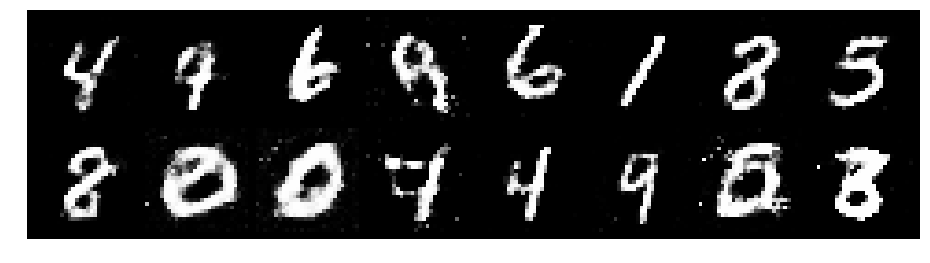

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.3635, Generator Loss: 0.9676
D(x): 0.5558, D(G(z)): 0.4574


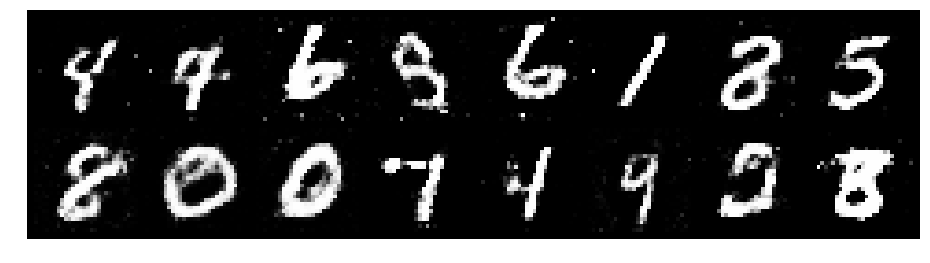

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2746, Generator Loss: 0.9900
D(x): 0.5862, D(G(z)): 0.4455


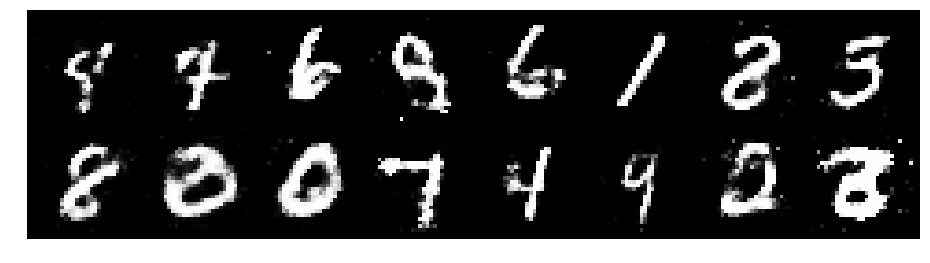

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2185, Generator Loss: 0.9920
D(x): 0.5434, D(G(z)): 0.3814


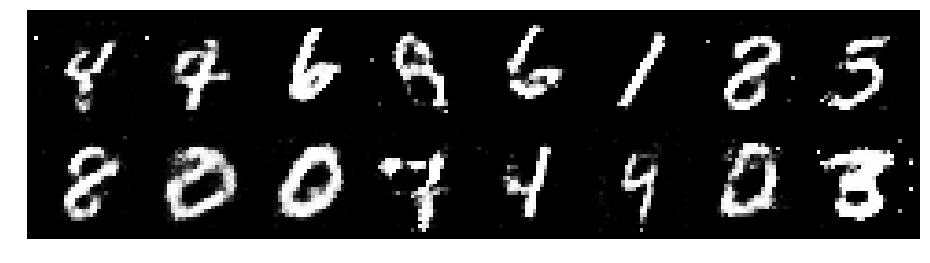

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.0982, Generator Loss: 1.0300
D(x): 0.6095, D(G(z)): 0.4056


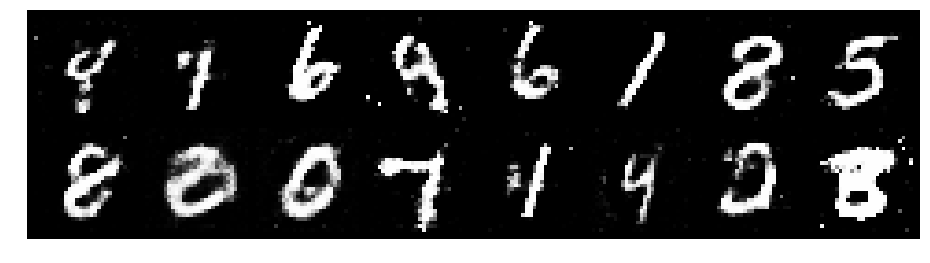

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.1368, Generator Loss: 0.8891
D(x): 0.5830, D(G(z)): 0.4002


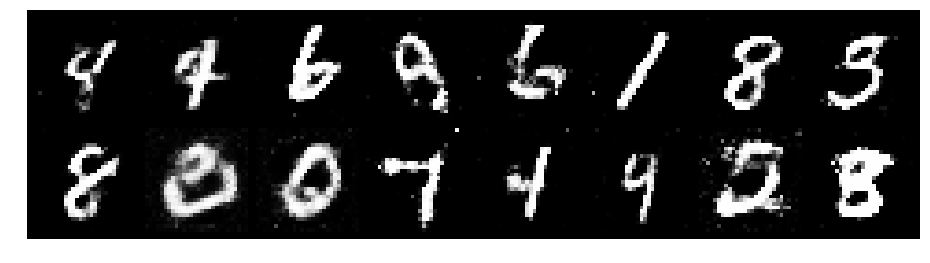

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.3068, Generator Loss: 0.8522
D(x): 0.5705, D(G(z)): 0.4493


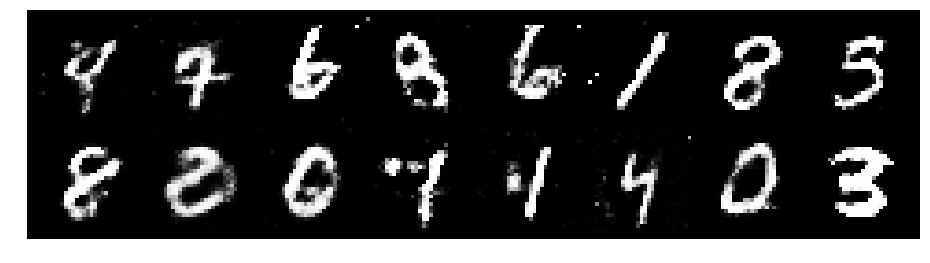

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2113, Generator Loss: 1.0761
D(x): 0.5894, D(G(z)): 0.4146


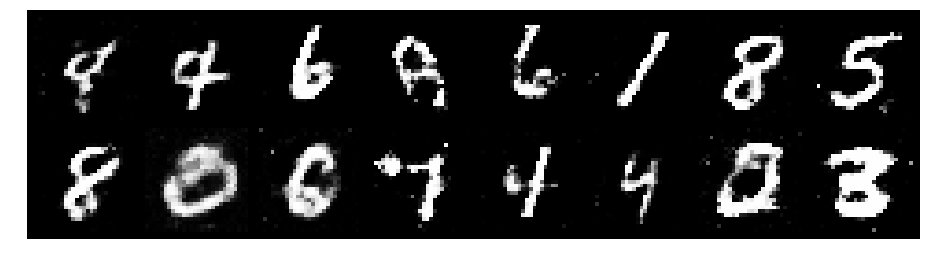

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.3242, Generator Loss: 0.9151
D(x): 0.5455, D(G(z)): 0.4546


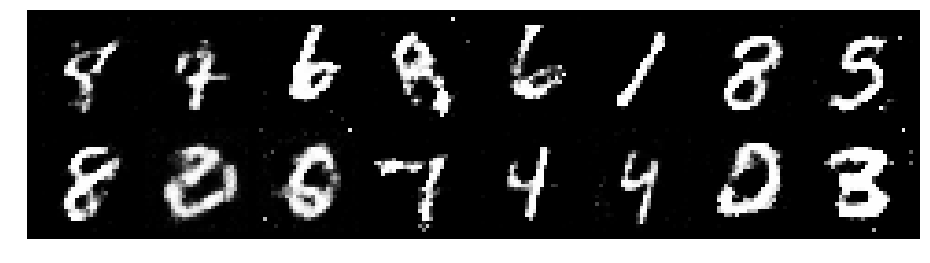

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.3623, Generator Loss: 0.9370
D(x): 0.5484, D(G(z)): 0.4601


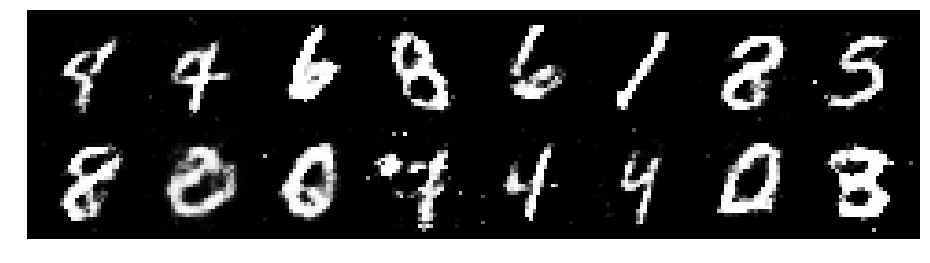

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2580, Generator Loss: 0.9387
D(x): 0.5724, D(G(z)): 0.4214


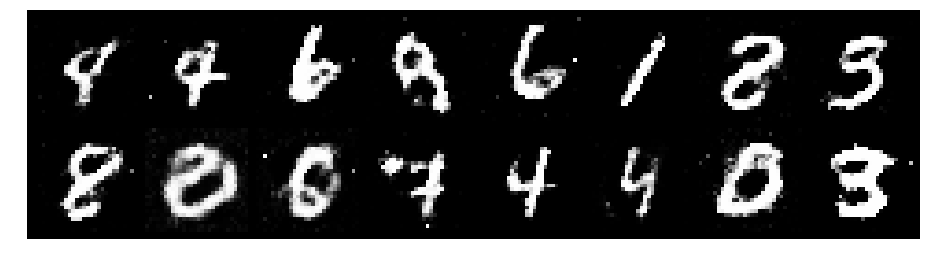

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2569, Generator Loss: 0.8938
D(x): 0.5948, D(G(z)): 0.4537


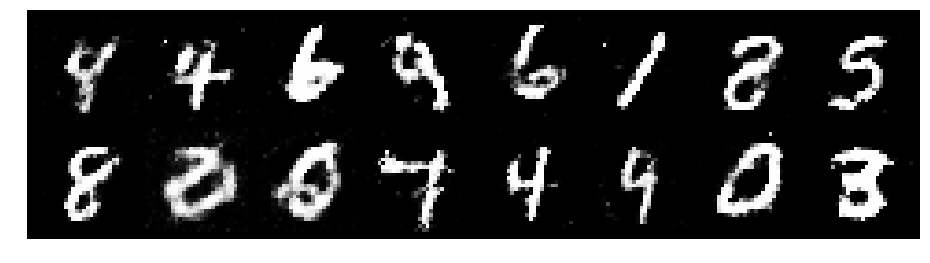

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2368, Generator Loss: 0.8192
D(x): 0.5668, D(G(z)): 0.4495


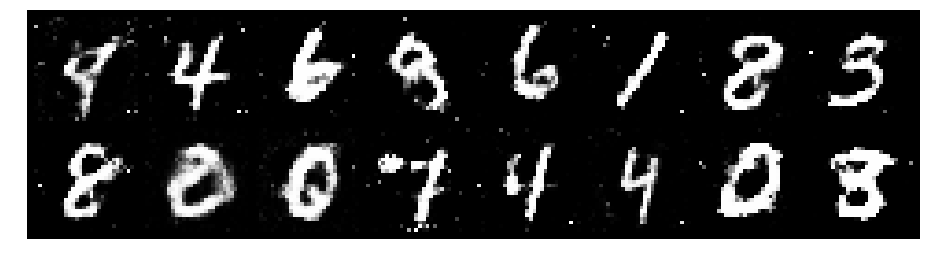

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2848, Generator Loss: 0.9585
D(x): 0.5696, D(G(z)): 0.4509


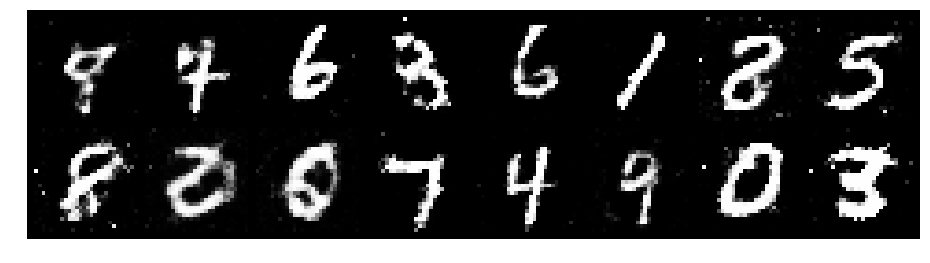

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2339, Generator Loss: 0.8406
D(x): 0.5588, D(G(z)): 0.4400


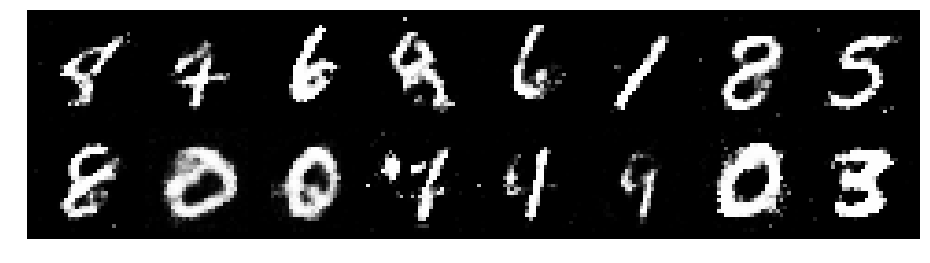

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1625, Generator Loss: 0.7912
D(x): 0.6141, D(G(z)): 0.4568


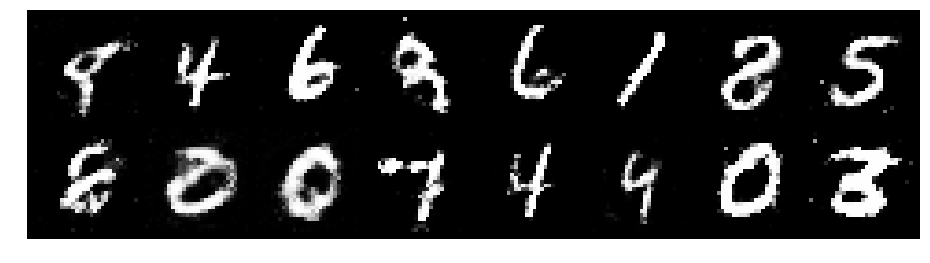

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2606, Generator Loss: 1.0478
D(x): 0.5928, D(G(z)): 0.4661


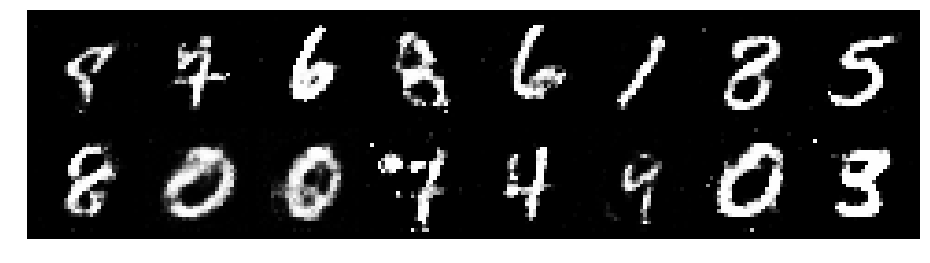

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2810, Generator Loss: 0.8555
D(x): 0.5683, D(G(z)): 0.4490


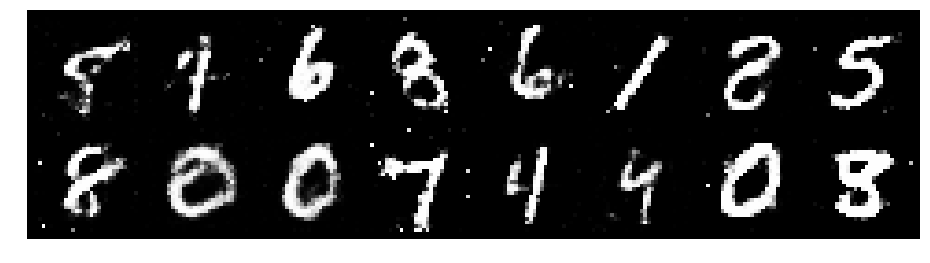

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2894, Generator Loss: 0.9470
D(x): 0.5242, D(G(z)): 0.4313


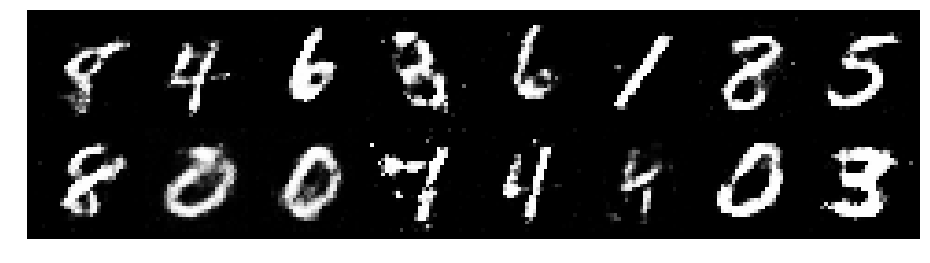

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2517, Generator Loss: 0.8436
D(x): 0.6625, D(G(z)): 0.5051


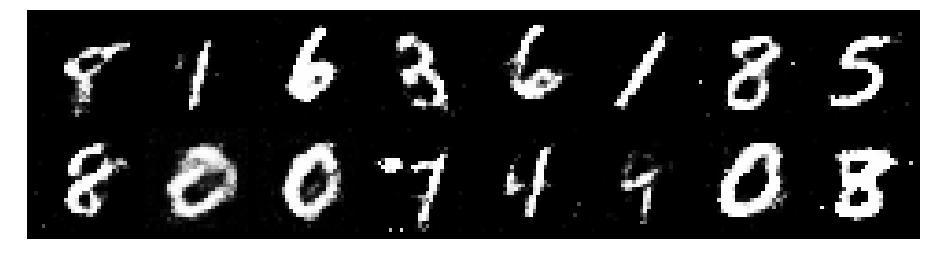

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2538, Generator Loss: 0.9826
D(x): 0.5732, D(G(z)): 0.4141


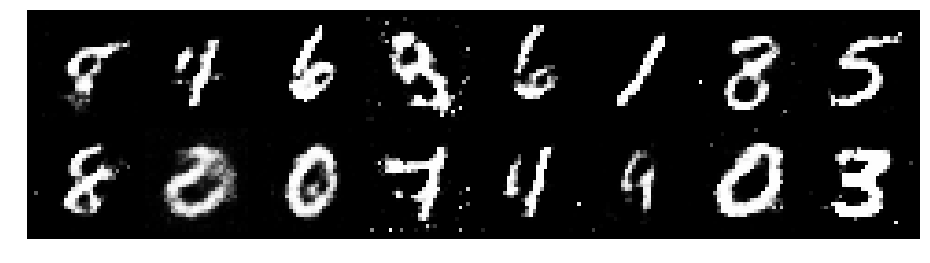

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2257, Generator Loss: 0.8582
D(x): 0.5338, D(G(z)): 0.4028


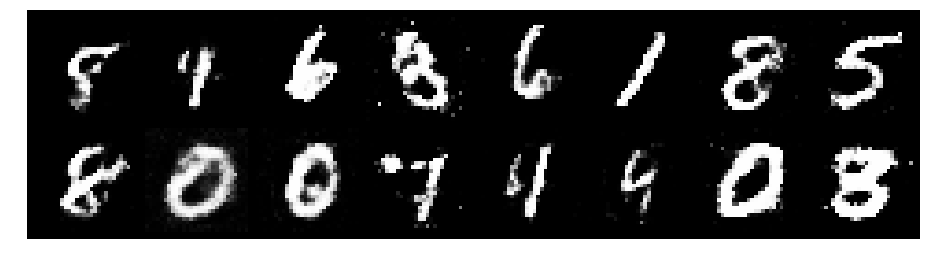

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2161, Generator Loss: 0.8102
D(x): 0.5612, D(G(z)): 0.4488


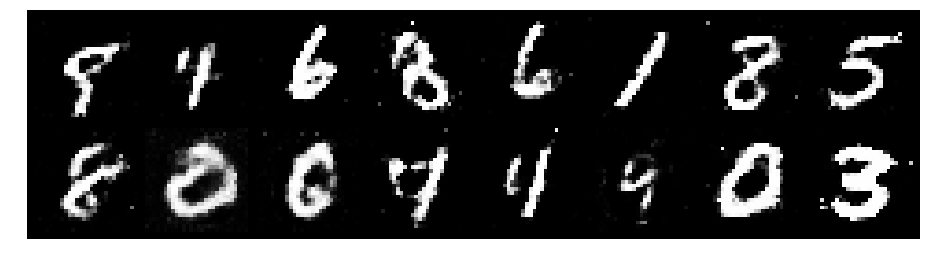

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2657, Generator Loss: 0.9751
D(x): 0.5545, D(G(z)): 0.3992


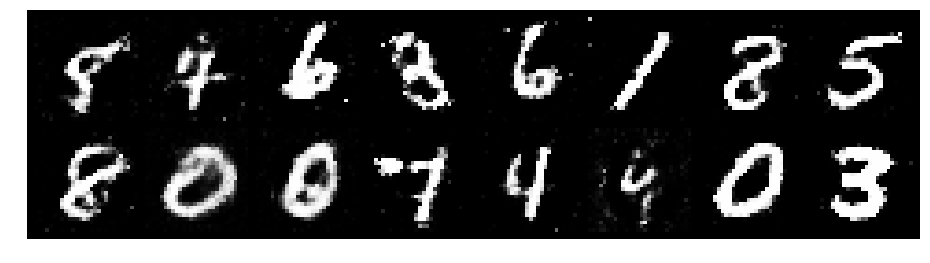

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2739, Generator Loss: 0.8389
D(x): 0.5726, D(G(z)): 0.4545


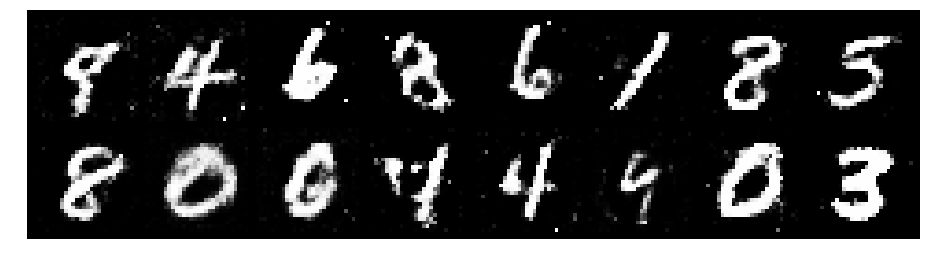

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.1641, Generator Loss: 1.0499
D(x): 0.6246, D(G(z)): 0.4309


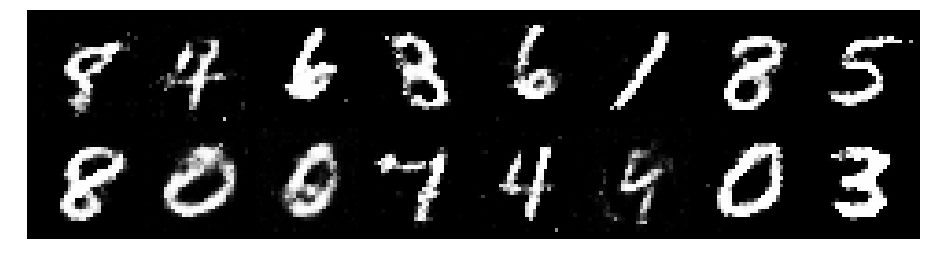

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1901, Generator Loss: 1.1357
D(x): 0.5797, D(G(z)): 0.4047


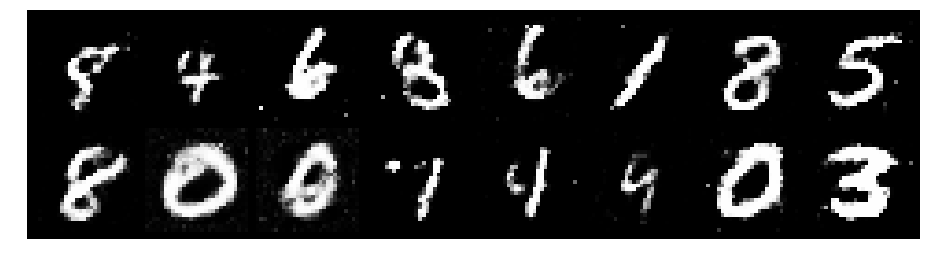

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.2803, Generator Loss: 1.0047
D(x): 0.5147, D(G(z)): 0.4201


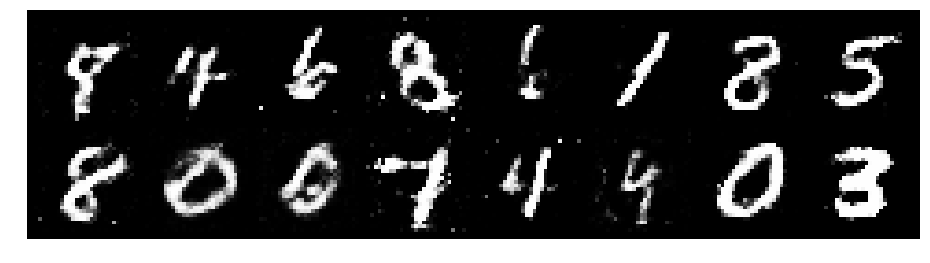

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2134, Generator Loss: 1.0816
D(x): 0.5664, D(G(z)): 0.4060


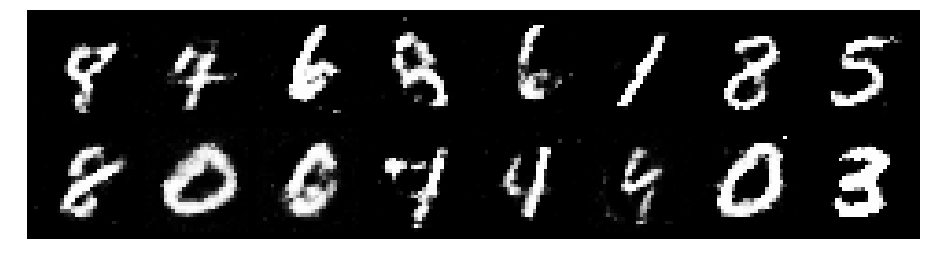

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.3511, Generator Loss: 0.7820
D(x): 0.6005, D(G(z)): 0.5097


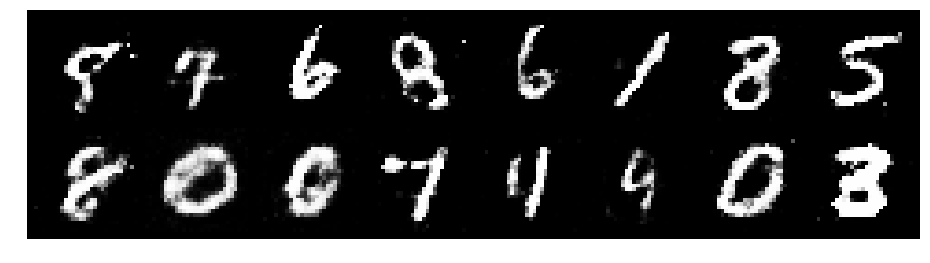

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.3256, Generator Loss: 0.9037
D(x): 0.5495, D(G(z)): 0.4446


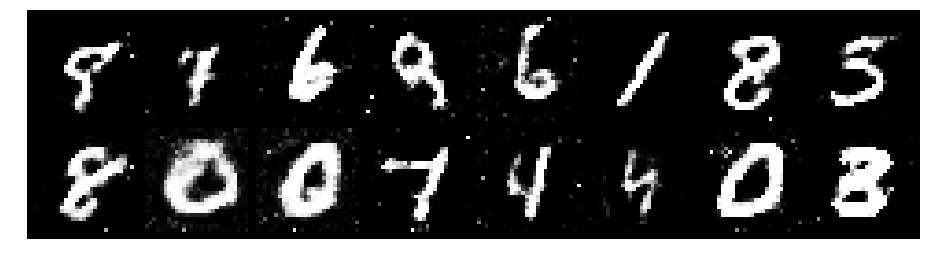

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2497, Generator Loss: 0.9270
D(x): 0.5660, D(G(z)): 0.4285


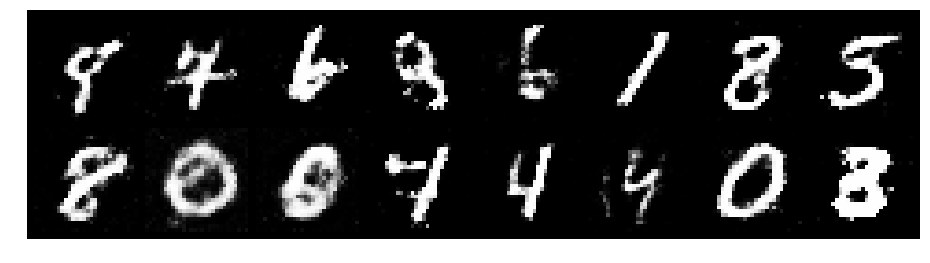

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.3524, Generator Loss: 0.8160
D(x): 0.5208, D(G(z)): 0.4570


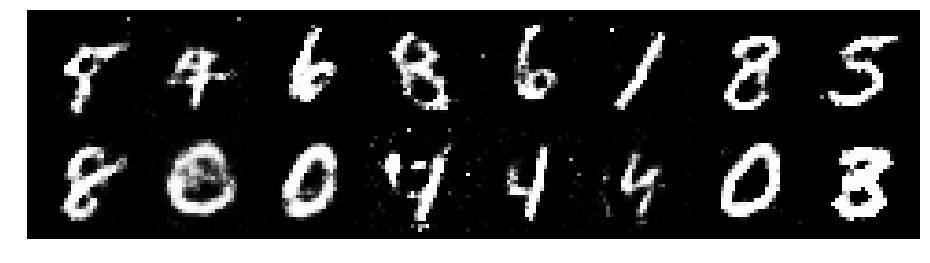

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2401, Generator Loss: 0.8816
D(x): 0.5679, D(G(z)): 0.4444


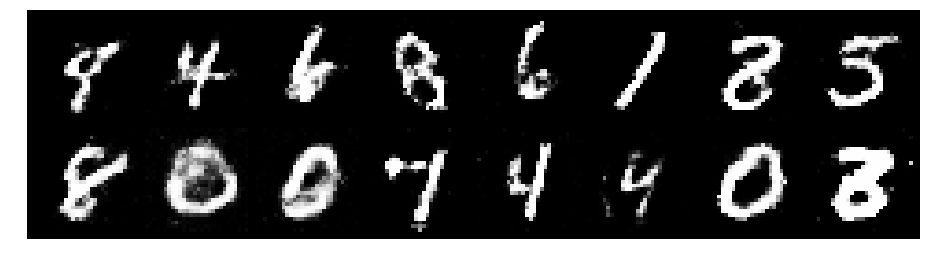

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.2989, Generator Loss: 0.9495
D(x): 0.5622, D(G(z)): 0.4675


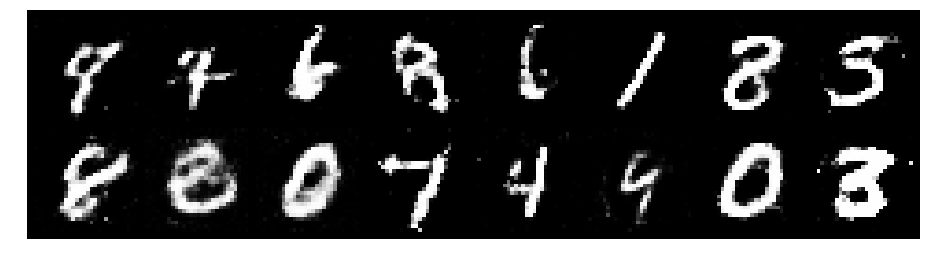

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2165, Generator Loss: 1.0343
D(x): 0.6218, D(G(z)): 0.4528


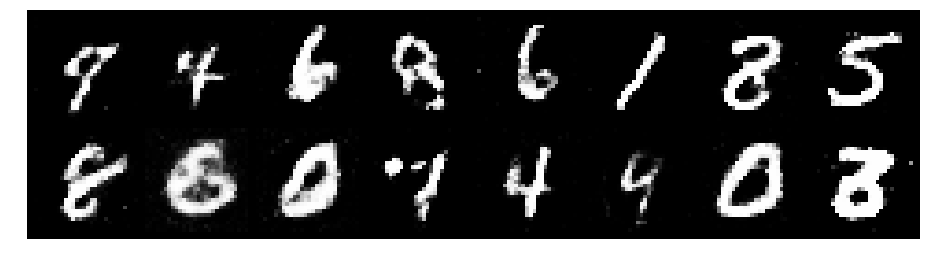

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2039, Generator Loss: 1.0632
D(x): 0.6160, D(G(z)): 0.4381


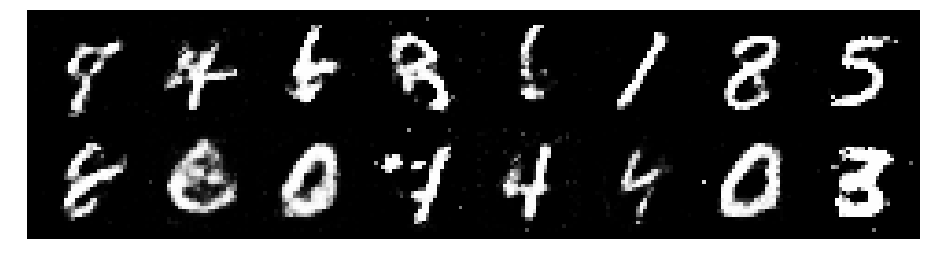

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1382, Generator Loss: 0.8604
D(x): 0.6218, D(G(z)): 0.4315


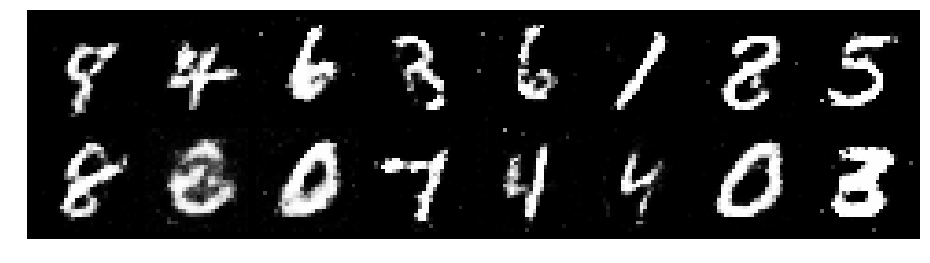

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.3178, Generator Loss: 1.0039
D(x): 0.4949, D(G(z)): 0.4006


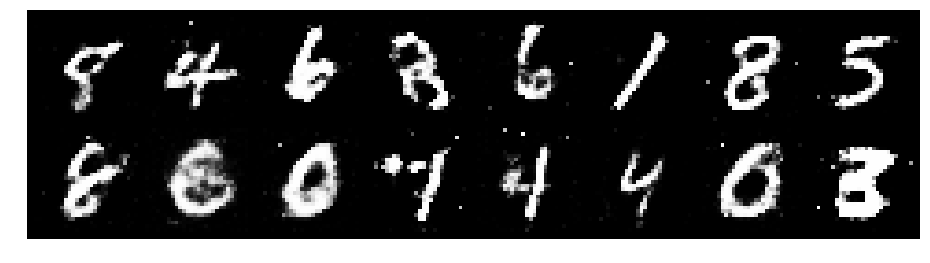

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.3547, Generator Loss: 1.0715
D(x): 0.5114, D(G(z)): 0.4152


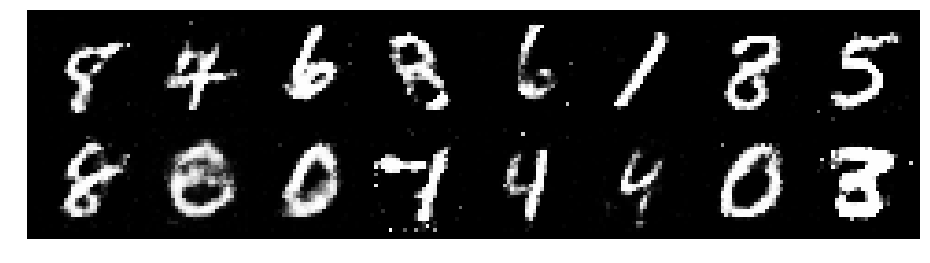

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1854, Generator Loss: 0.9509
D(x): 0.5854, D(G(z)): 0.4038


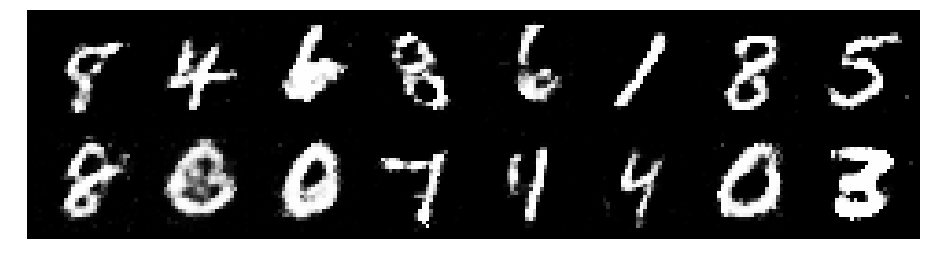

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.4368, Generator Loss: 0.8040
D(x): 0.5569, D(G(z)): 0.5073


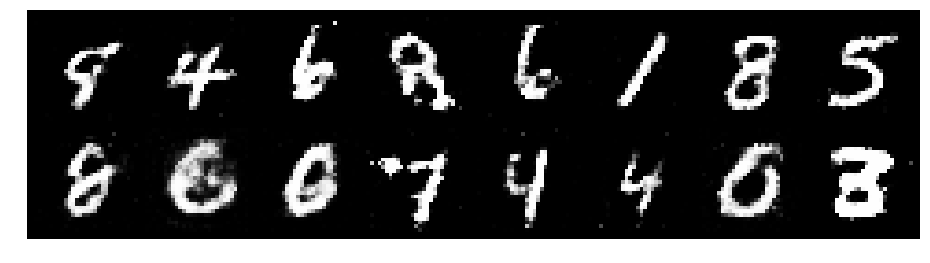

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8642
D(x): 0.5581, D(G(z)): 0.4251


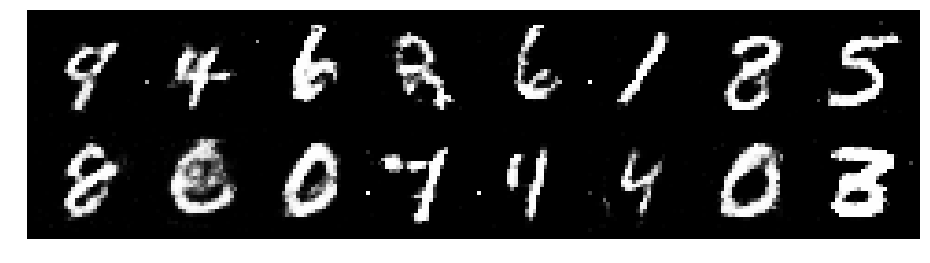

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2943, Generator Loss: 1.3137
D(x): 0.5669, D(G(z)): 0.4175


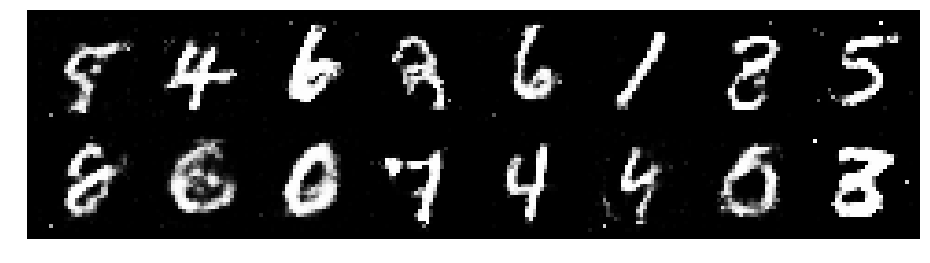

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.3538, Generator Loss: 1.0457
D(x): 0.5534, D(G(z)): 0.4684


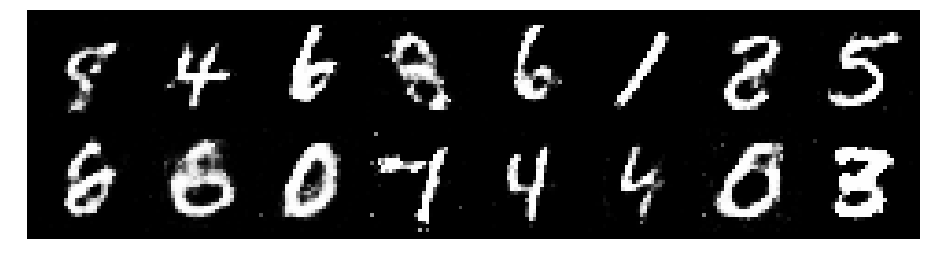

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.4072, Generator Loss: 1.1415
D(x): 0.4441, D(G(z)): 0.3699


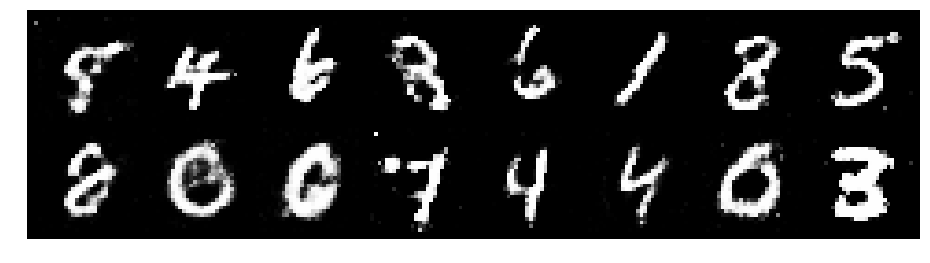

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2662, Generator Loss: 0.9434
D(x): 0.5752, D(G(z)): 0.4484


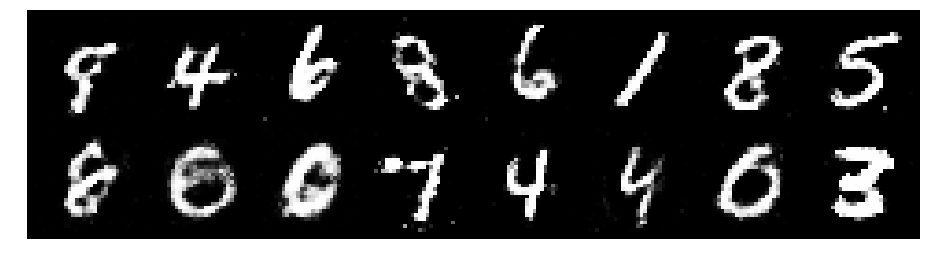

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2877, Generator Loss: 0.8929
D(x): 0.5477, D(G(z)): 0.4298


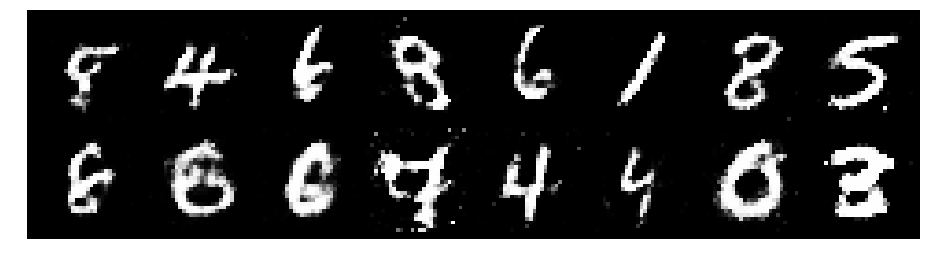

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3080, Generator Loss: 0.7071
D(x): 0.5983, D(G(z)): 0.4923


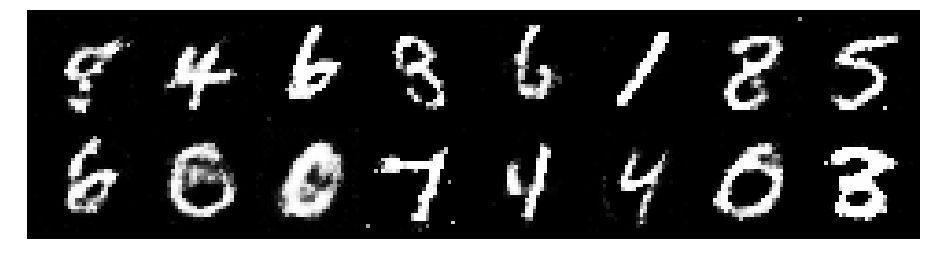

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.3588, Generator Loss: 1.0037
D(x): 0.5262, D(G(z)): 0.4388


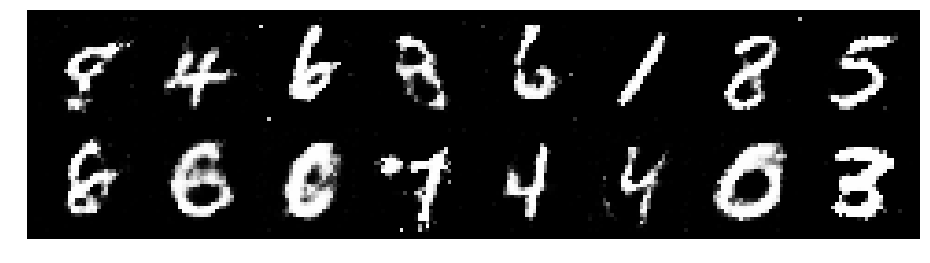

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3204, Generator Loss: 0.9312
D(x): 0.5485, D(G(z)): 0.4423


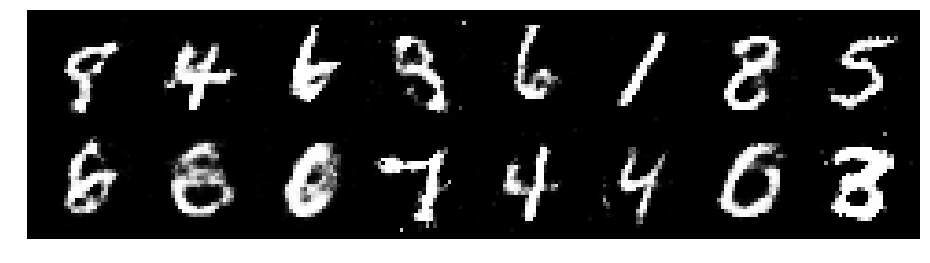

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2826, Generator Loss: 0.8178
D(x): 0.5923, D(G(z)): 0.4599


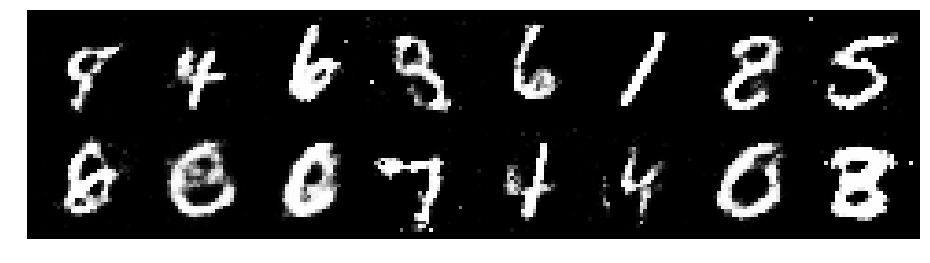

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.3467, Generator Loss: 1.0327
D(x): 0.4917, D(G(z)): 0.4041


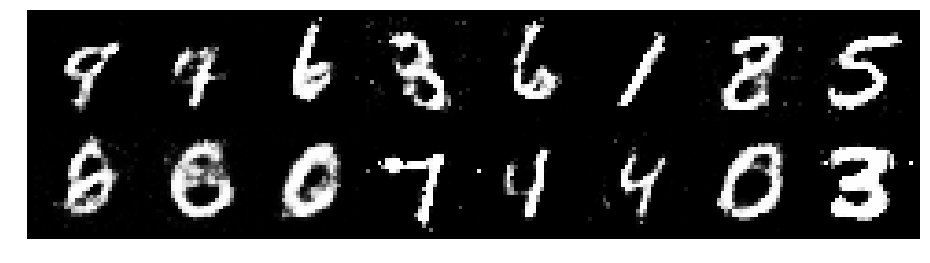

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3034, Generator Loss: 0.9271
D(x): 0.5077, D(G(z)): 0.4074


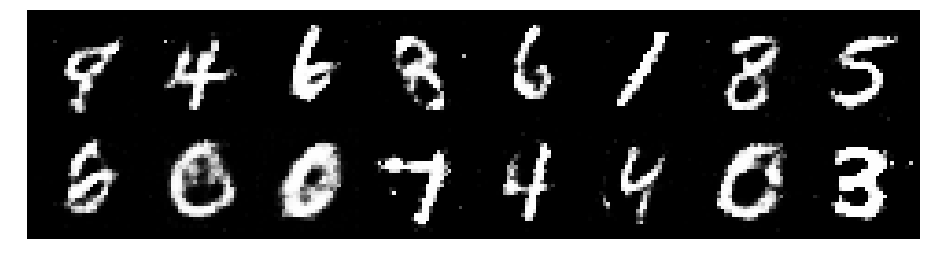

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2872, Generator Loss: 0.8092
D(x): 0.5983, D(G(z)): 0.4669


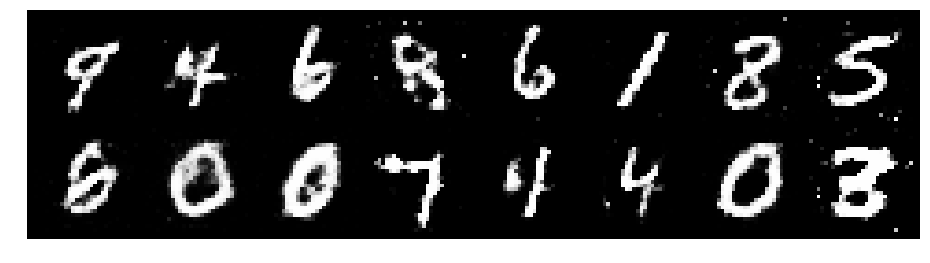

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2660, Generator Loss: 0.8654
D(x): 0.5804, D(G(z)): 0.4409


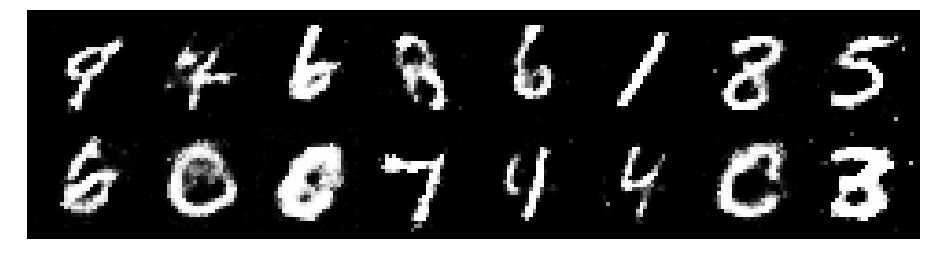

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1943, Generator Loss: 1.0125
D(x): 0.6119, D(G(z)): 0.4178


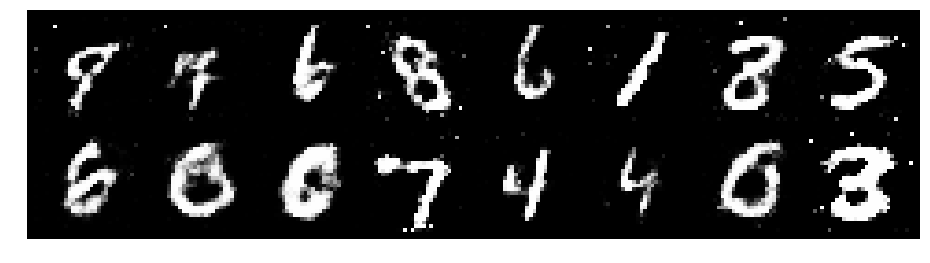

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2317, Generator Loss: 0.8144
D(x): 0.5734, D(G(z)): 0.4577


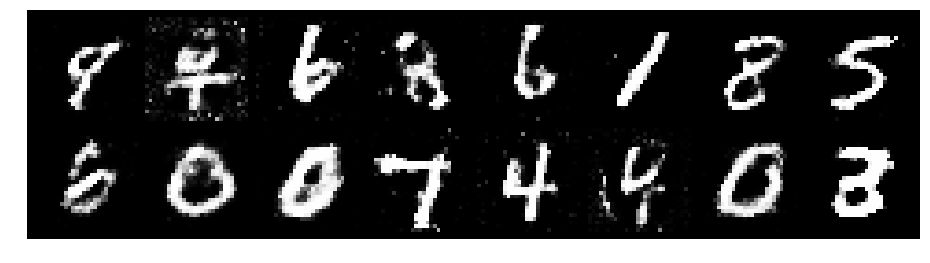

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.3303, Generator Loss: 0.8229
D(x): 0.5710, D(G(z)): 0.4852


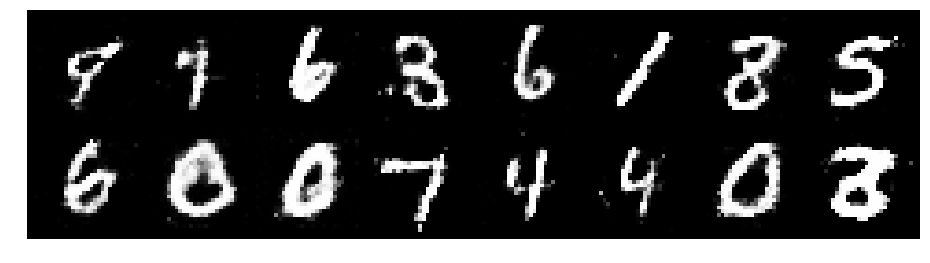

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2493, Generator Loss: 0.8348
D(x): 0.5558, D(G(z)): 0.4463


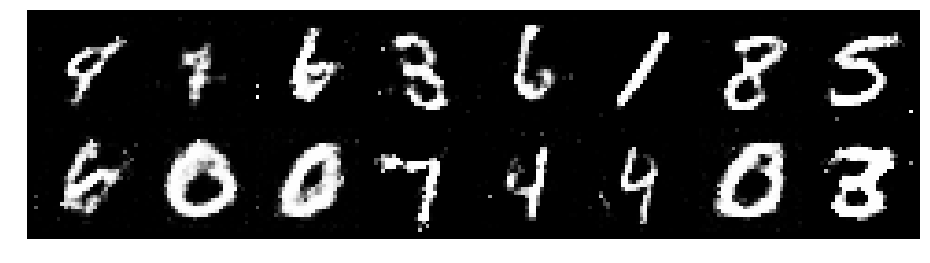

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.1933, Generator Loss: 0.8676
D(x): 0.5820, D(G(z)): 0.4404


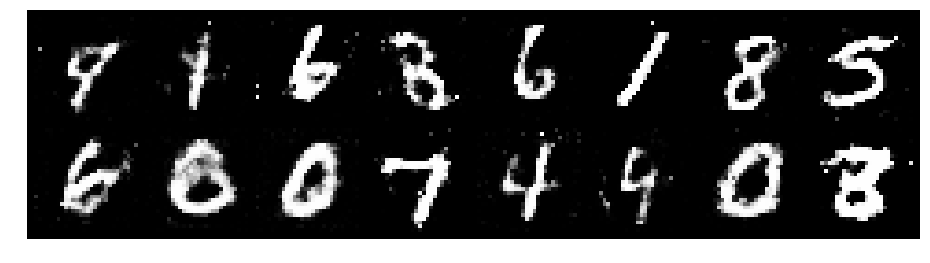

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2669, Generator Loss: 0.8250
D(x): 0.5776, D(G(z)): 0.4715


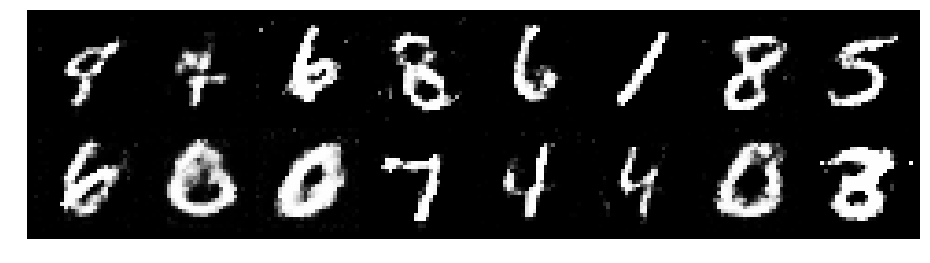

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.1362, Generator Loss: 1.1838
D(x): 0.5987, D(G(z)): 0.3837


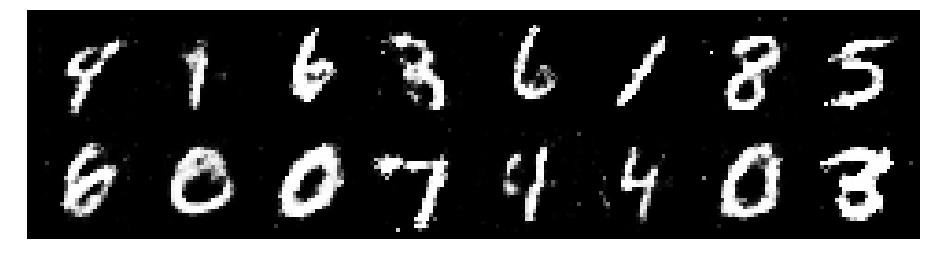

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2190, Generator Loss: 0.9332
D(x): 0.6304, D(G(z)): 0.4857


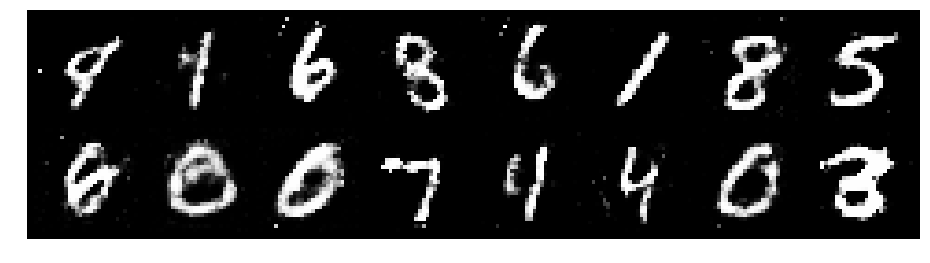

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2409, Generator Loss: 0.8359
D(x): 0.5701, D(G(z)): 0.4525


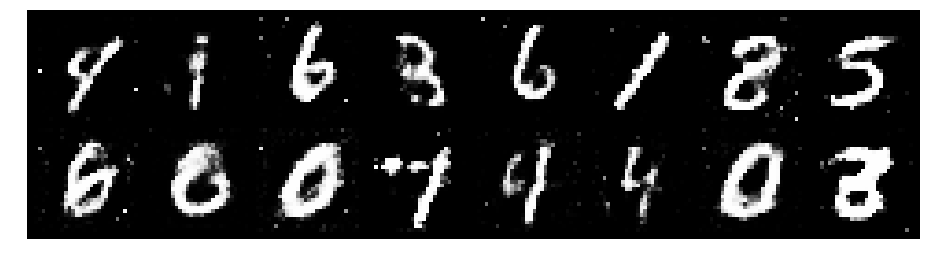

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.1651, Generator Loss: 0.9552
D(x): 0.5744, D(G(z)): 0.4067


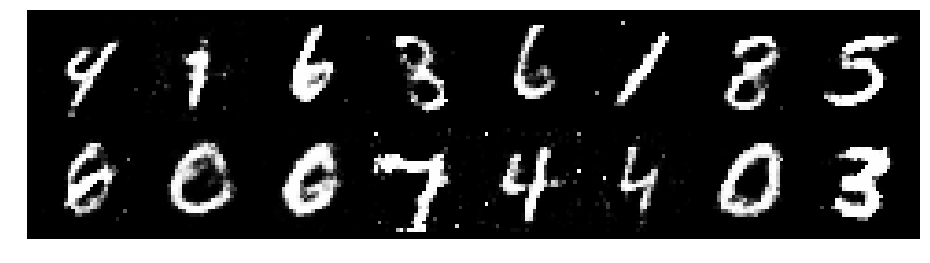

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.1233, Generator Loss: 1.0724
D(x): 0.5820, D(G(z)): 0.3769


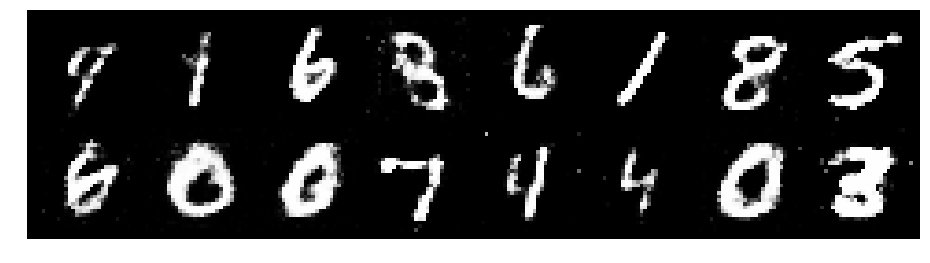

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.4121, Generator Loss: 0.9625
D(x): 0.4779, D(G(z)): 0.4144


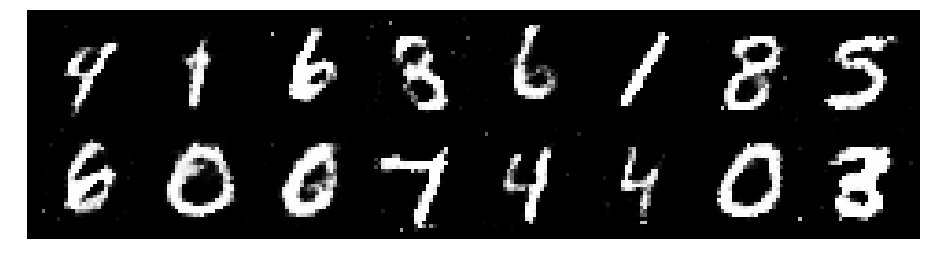

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2251, Generator Loss: 1.0442
D(x): 0.5483, D(G(z)): 0.3788


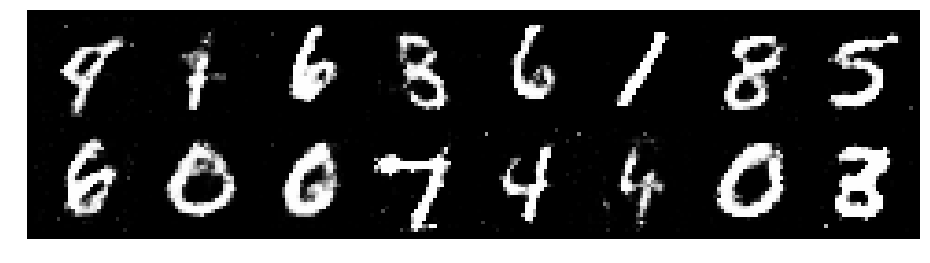

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2614, Generator Loss: 0.9386
D(x): 0.5456, D(G(z)): 0.4143


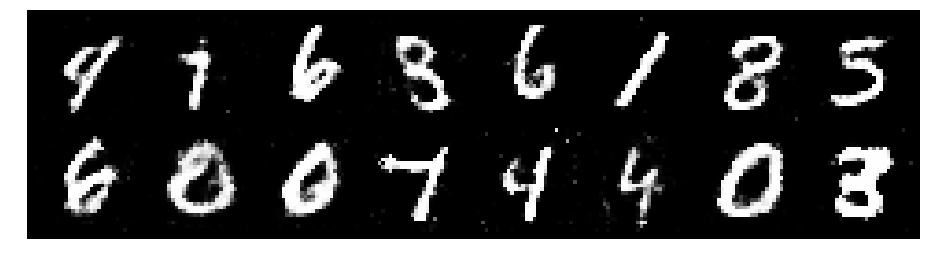

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.1765, Generator Loss: 0.9434
D(x): 0.5926, D(G(z)): 0.4056


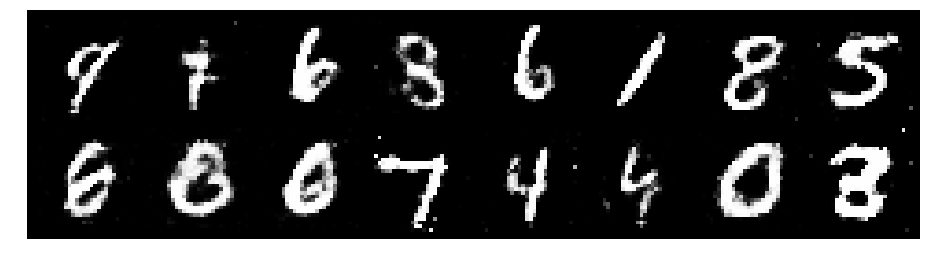

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.1179, Generator Loss: 1.0787
D(x): 0.6041, D(G(z)): 0.3985


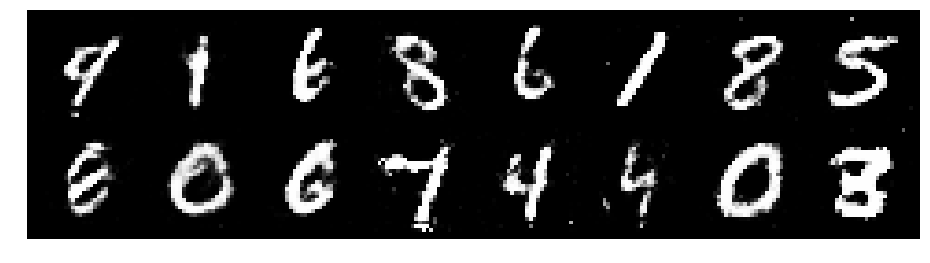

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2367, Generator Loss: 0.8590
D(x): 0.5894, D(G(z)): 0.4525


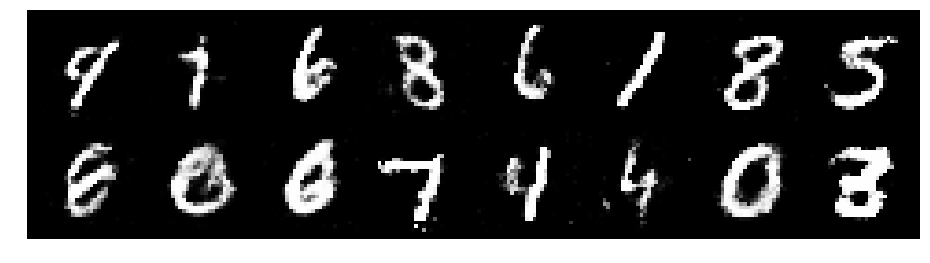

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2789, Generator Loss: 0.8212
D(x): 0.5550, D(G(z)): 0.4564


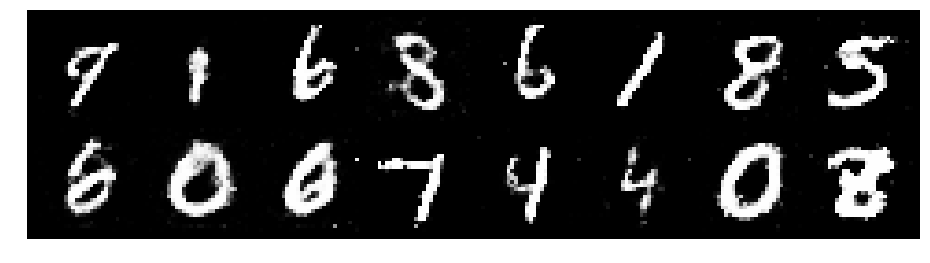

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.1704, Generator Loss: 1.0367
D(x): 0.5657, D(G(z)): 0.3942


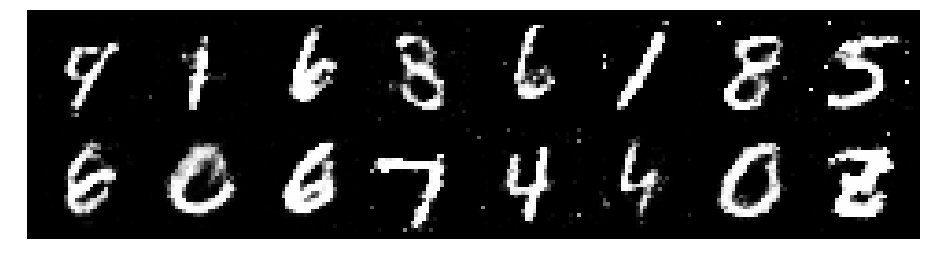

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.1407, Generator Loss: 0.9612
D(x): 0.6464, D(G(z)): 0.4390


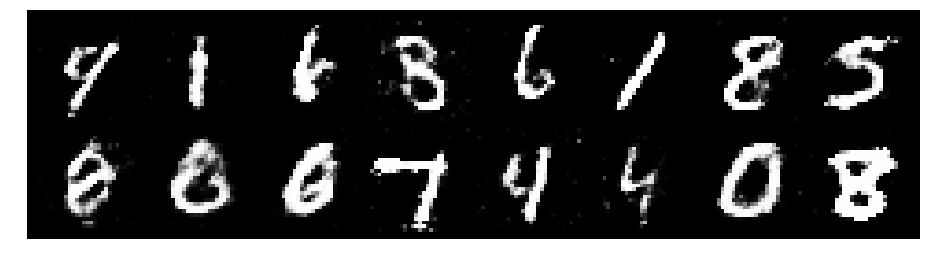

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.3540, Generator Loss: 0.8972
D(x): 0.5349, D(G(z)): 0.4364


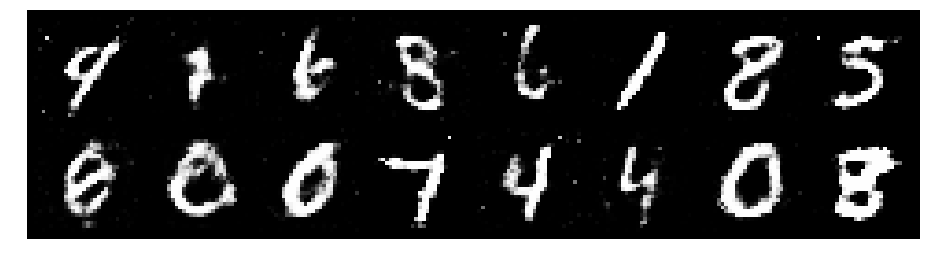

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2988, Generator Loss: 0.8118
D(x): 0.5863, D(G(z)): 0.4482


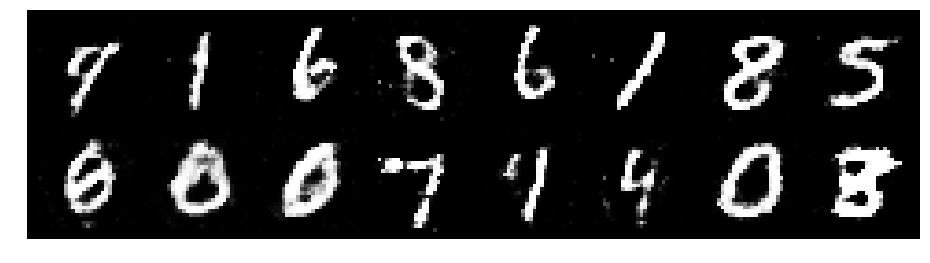

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2466, Generator Loss: 1.0094
D(x): 0.5713, D(G(z)): 0.4149


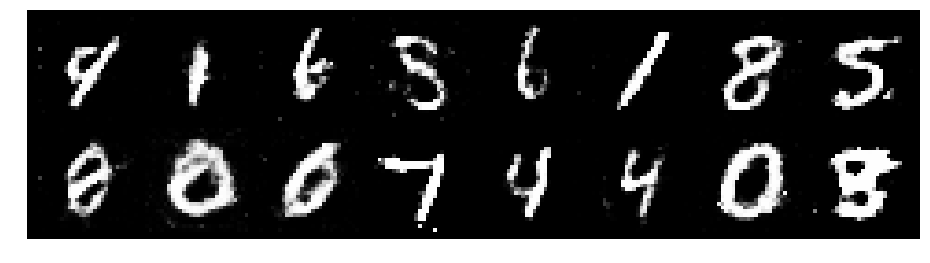

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2350, Generator Loss: 1.0688
D(x): 0.5061, D(G(z)): 0.3534


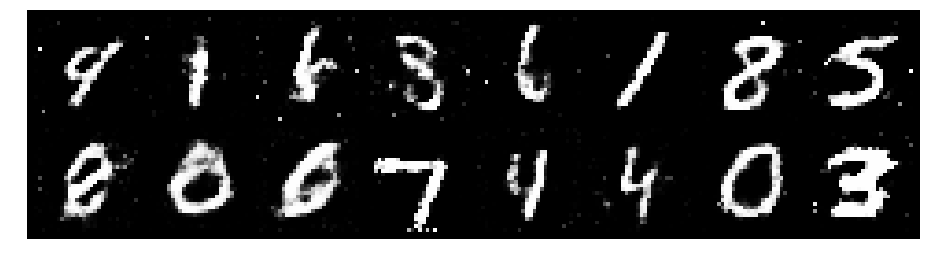

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.1657, Generator Loss: 1.2011
D(x): 0.5907, D(G(z)): 0.3928


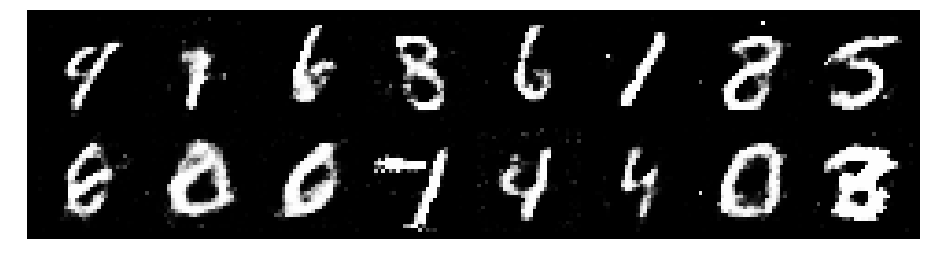

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.3292, Generator Loss: 0.9617
D(x): 0.6104, D(G(z)): 0.4867


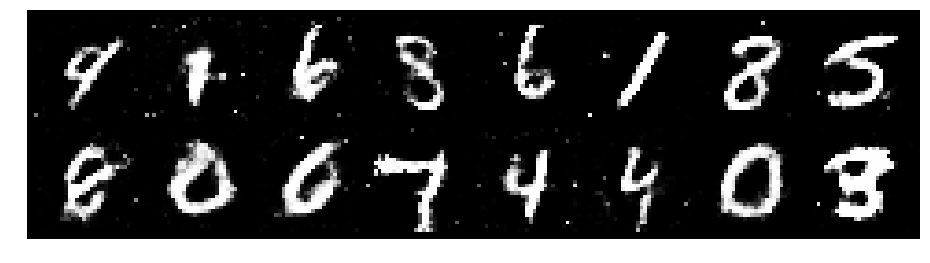

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1681, Generator Loss: 1.2054
D(x): 0.5917, D(G(z)): 0.3840


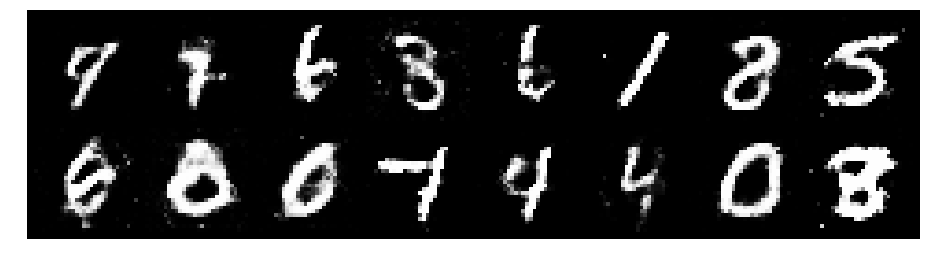

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2839, Generator Loss: 0.8805
D(x): 0.5454, D(G(z)): 0.4168


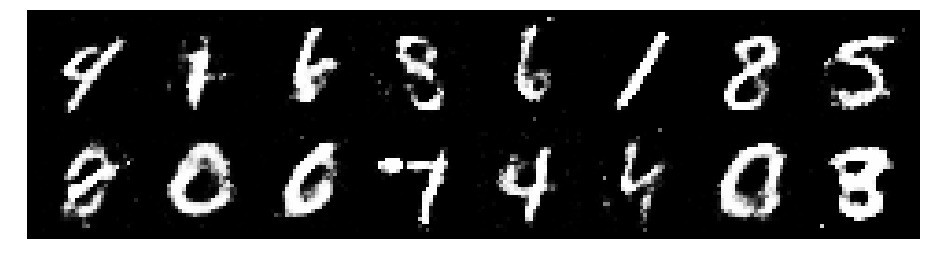

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.1745, Generator Loss: 0.8744
D(x): 0.6387, D(G(z)): 0.4732


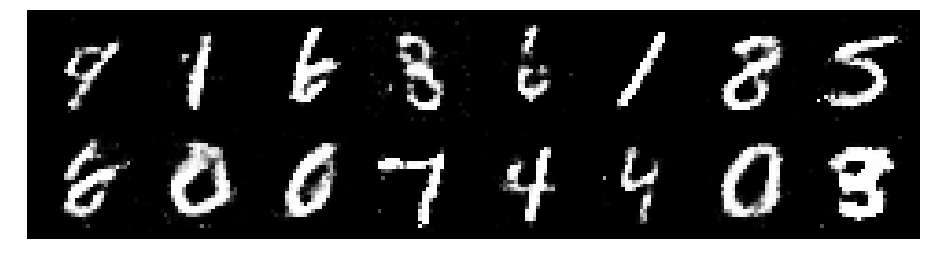

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.1954, Generator Loss: 1.0572
D(x): 0.6453, D(G(z)): 0.4631


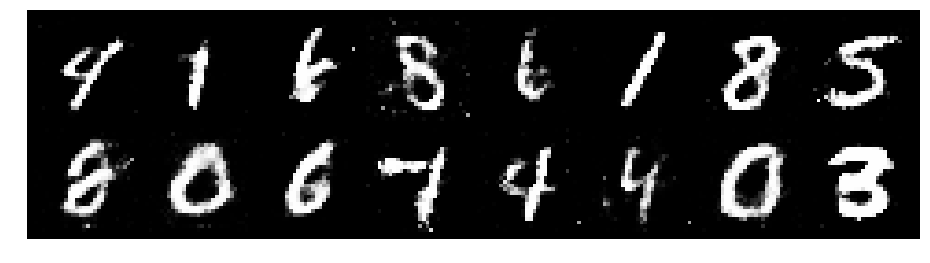

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.2551, Generator Loss: 0.9676
D(x): 0.5265, D(G(z)): 0.4038


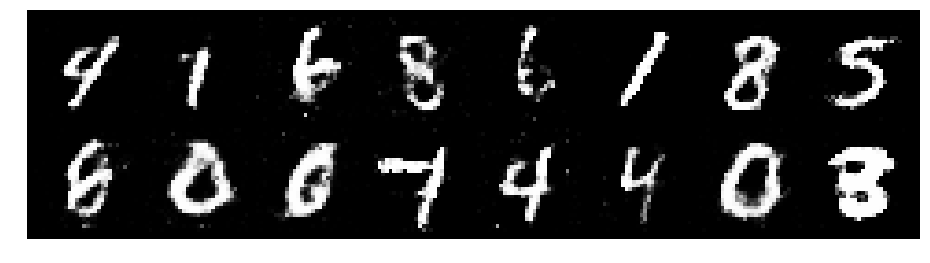

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.1661, Generator Loss: 0.9641
D(x): 0.6120, D(G(z)): 0.4353


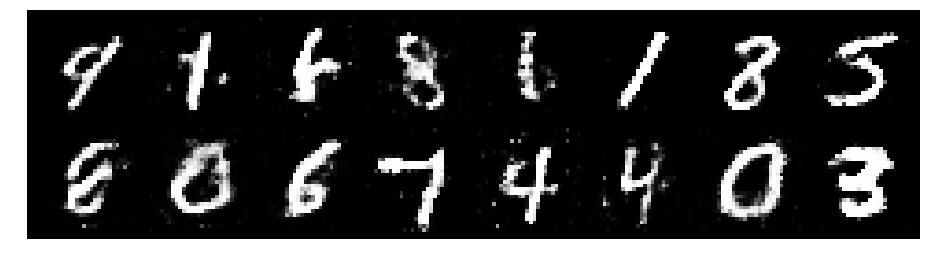

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2160, Generator Loss: 0.7786
D(x): 0.5696, D(G(z)): 0.4453


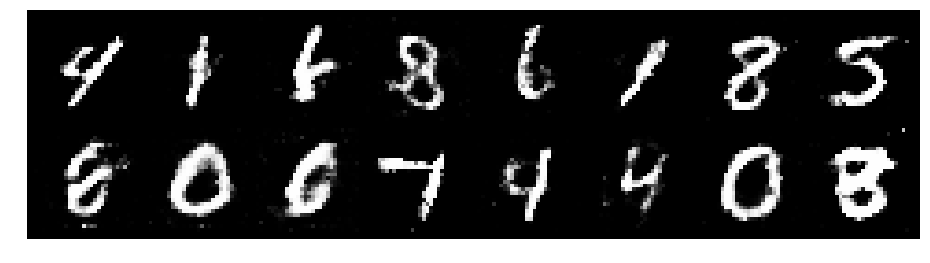

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2450, Generator Loss: 0.8115
D(x): 0.5645, D(G(z)): 0.4543


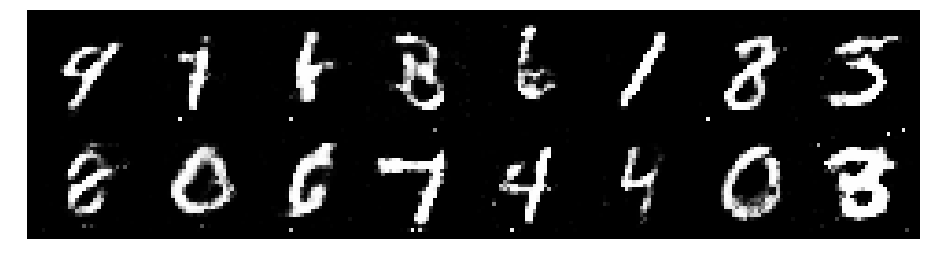

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.1752, Generator Loss: 0.8715
D(x): 0.5720, D(G(z)): 0.4208


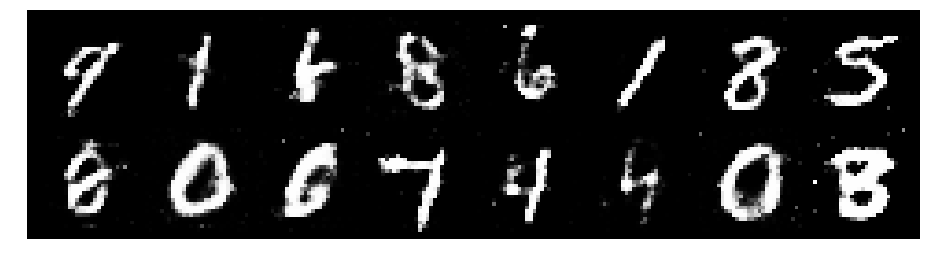

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2797, Generator Loss: 0.8367
D(x): 0.5313, D(G(z)): 0.4271


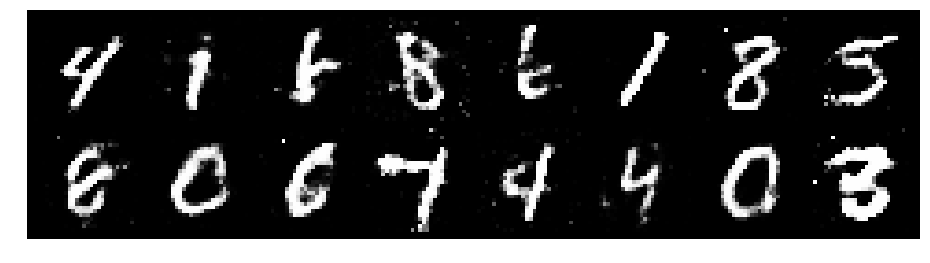

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.1840, Generator Loss: 0.9080
D(x): 0.5713, D(G(z)): 0.4296


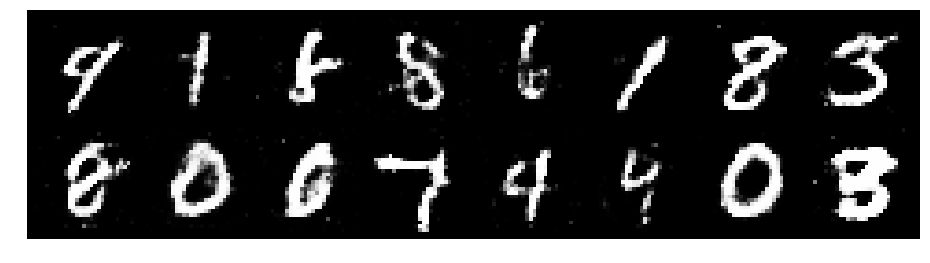

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2884, Generator Loss: 1.0240
D(x): 0.5474, D(G(z)): 0.4329


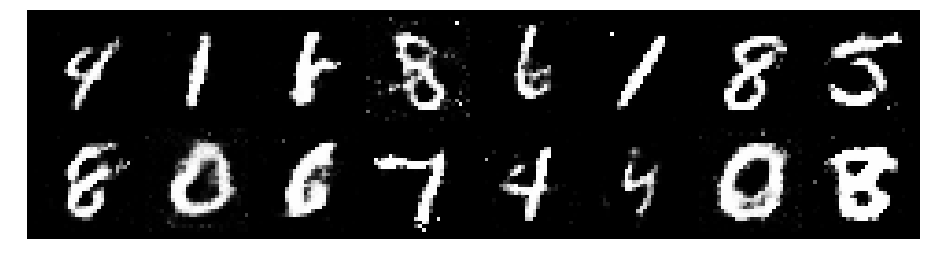

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3294, Generator Loss: 0.9907
D(x): 0.5269, D(G(z)): 0.4368


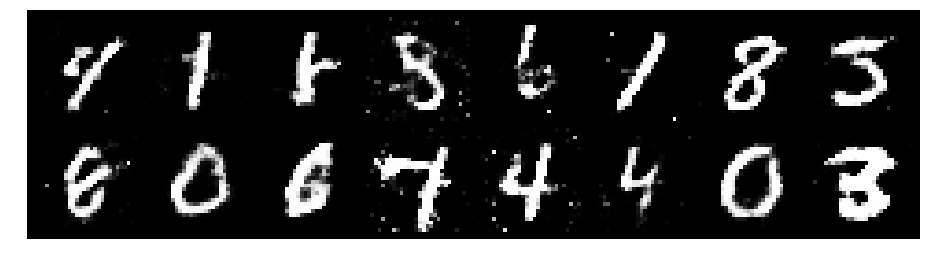

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.1971, Generator Loss: 1.0335
D(x): 0.5828, D(G(z)): 0.4131


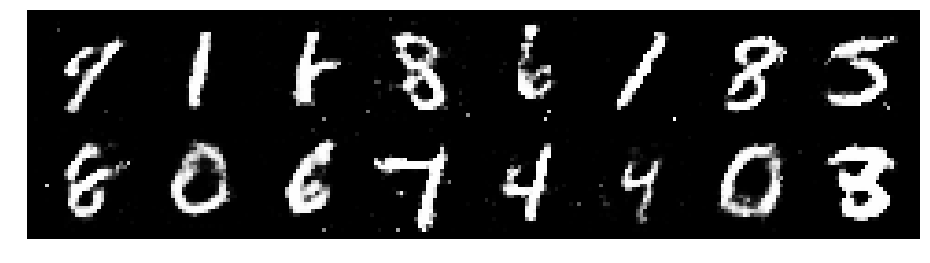

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2184, Generator Loss: 0.9112
D(x): 0.5478, D(G(z)): 0.4130


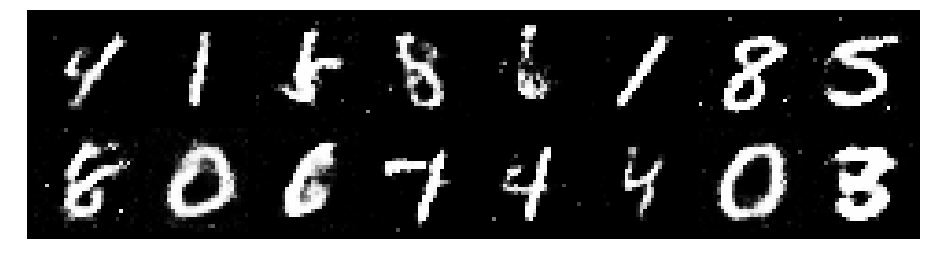

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2258, Generator Loss: 0.8145
D(x): 0.5782, D(G(z)): 0.4560


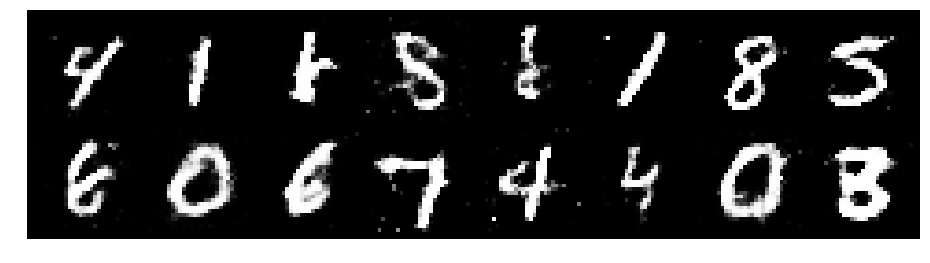

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2232, Generator Loss: 0.7005
D(x): 0.6425, D(G(z)): 0.5003


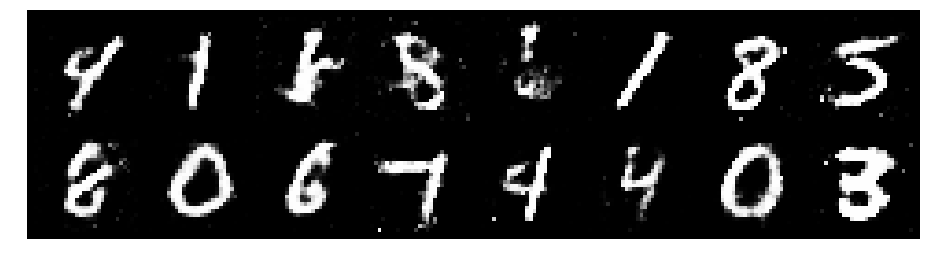

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.1939, Generator Loss: 1.0337
D(x): 0.5453, D(G(z)): 0.3919


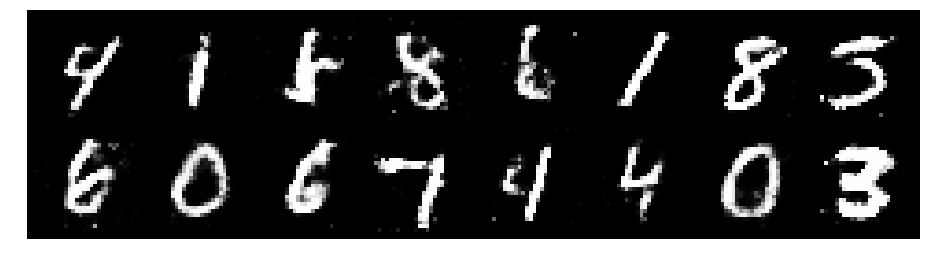

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.3310, Generator Loss: 0.9559
D(x): 0.5404, D(G(z)): 0.4375


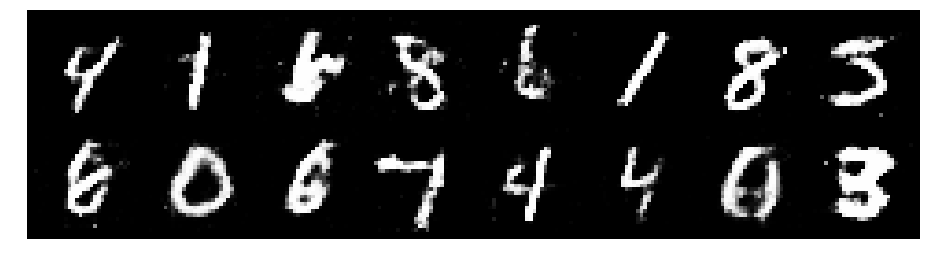

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2515, Generator Loss: 0.8900
D(x): 0.5636, D(G(z)): 0.4387


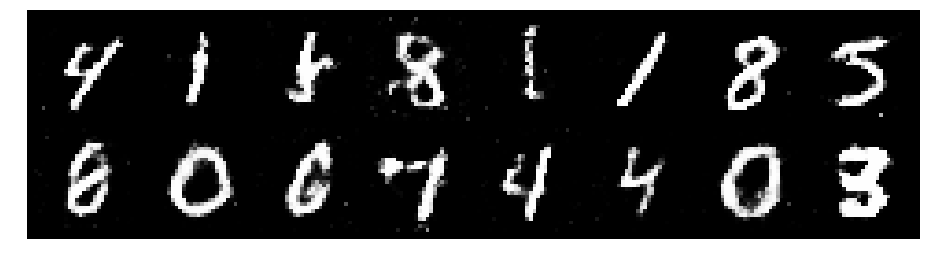

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2620, Generator Loss: 0.9123
D(x): 0.5657, D(G(z)): 0.4439


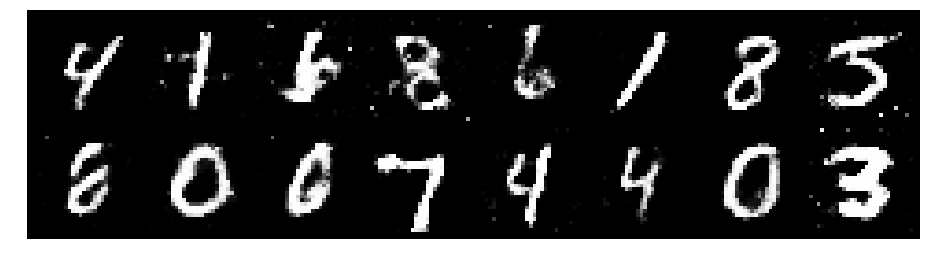

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.3177, Generator Loss: 0.8934
D(x): 0.5336, D(G(z)): 0.4443


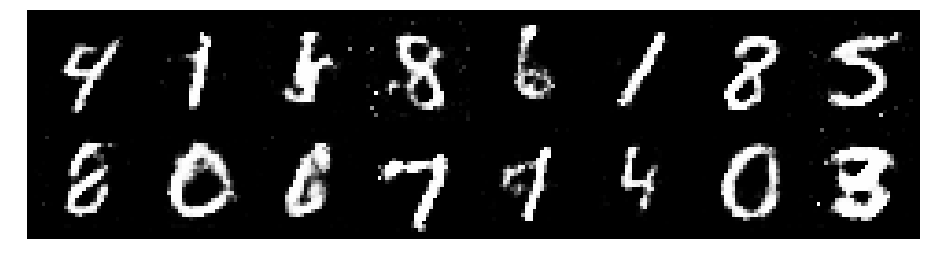

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.1542, Generator Loss: 0.9847
D(x): 0.5933, D(G(z)): 0.4056


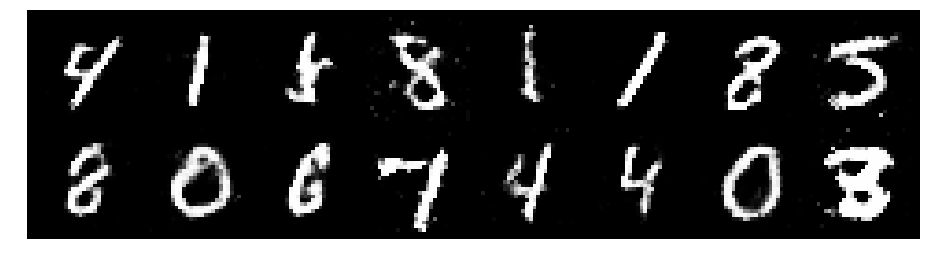

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.1910, Generator Loss: 1.1703
D(x): 0.5892, D(G(z)): 0.3978


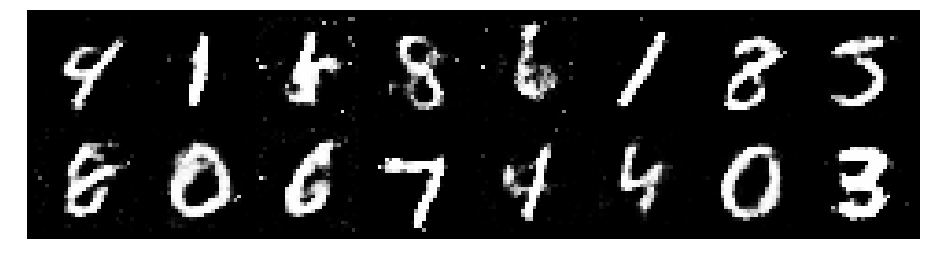

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2516, Generator Loss: 1.2220
D(x): 0.5589, D(G(z)): 0.3907


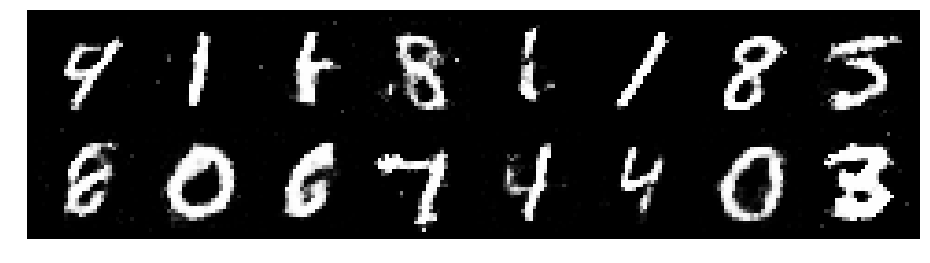

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3509, Generator Loss: 0.8914
D(x): 0.5246, D(G(z)): 0.4396


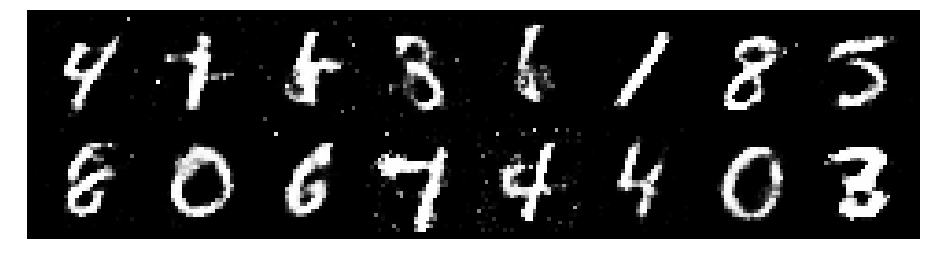

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2473, Generator Loss: 1.0350
D(x): 0.5489, D(G(z)): 0.3962


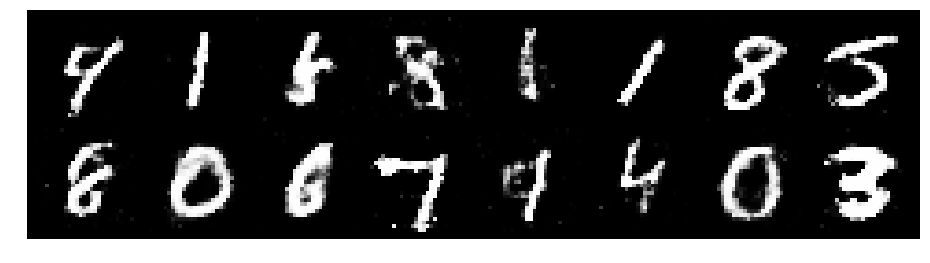

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2080, Generator Loss: 1.0662
D(x): 0.6125, D(G(z)): 0.4434


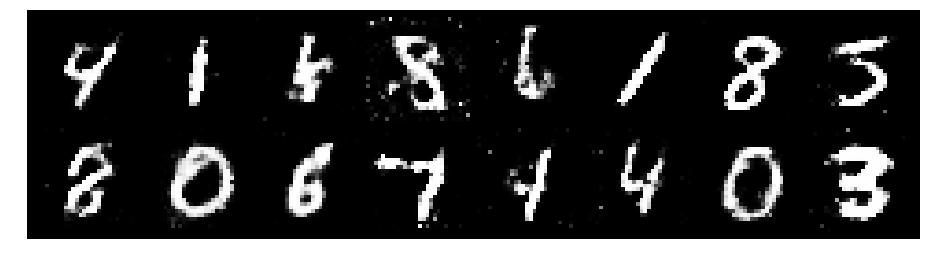

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.1772, Generator Loss: 0.8687
D(x): 0.5778, D(G(z)): 0.4271


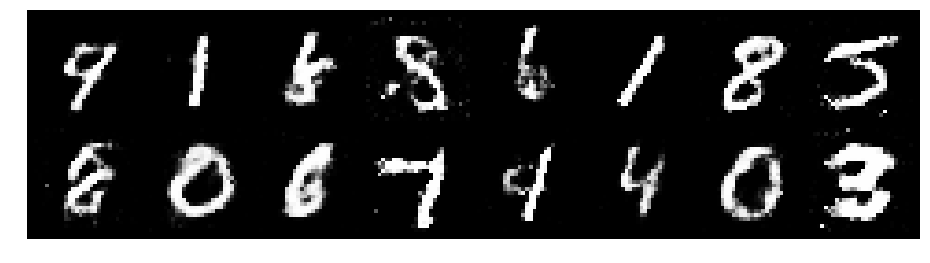

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2449, Generator Loss: 0.9363
D(x): 0.5654, D(G(z)): 0.4371


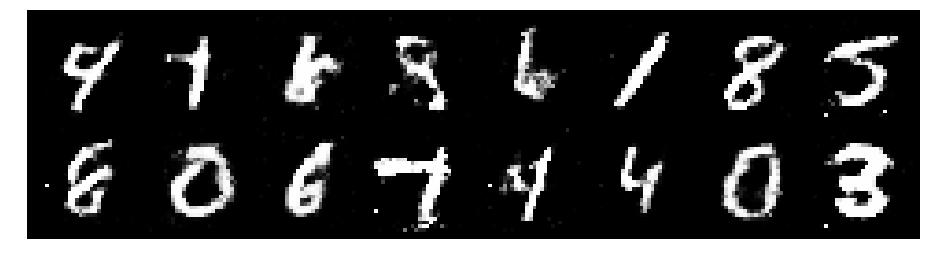

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.1067, Generator Loss: 1.0004
D(x): 0.5687, D(G(z)): 0.3677


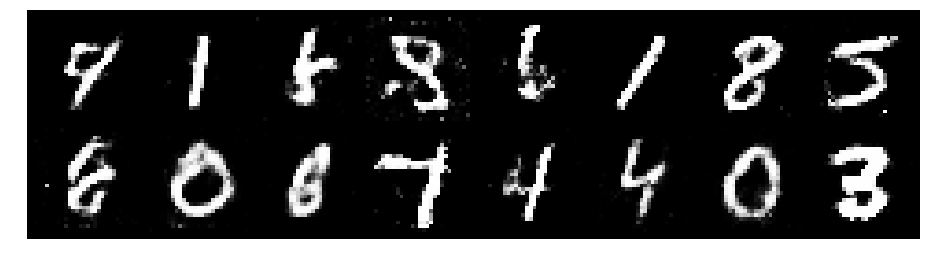

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2321, Generator Loss: 1.0573
D(x): 0.5492, D(G(z)): 0.4103


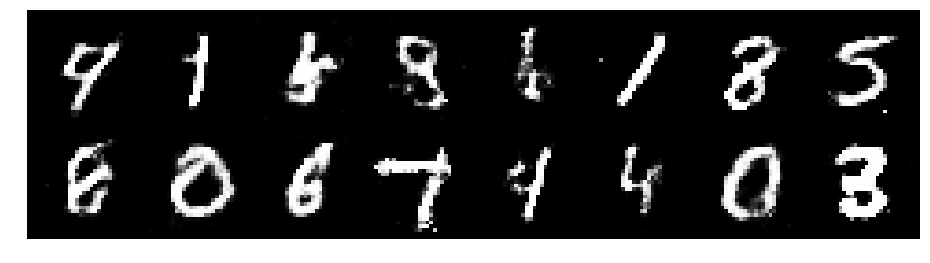

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2110, Generator Loss: 0.9396
D(x): 0.6226, D(G(z)): 0.4666


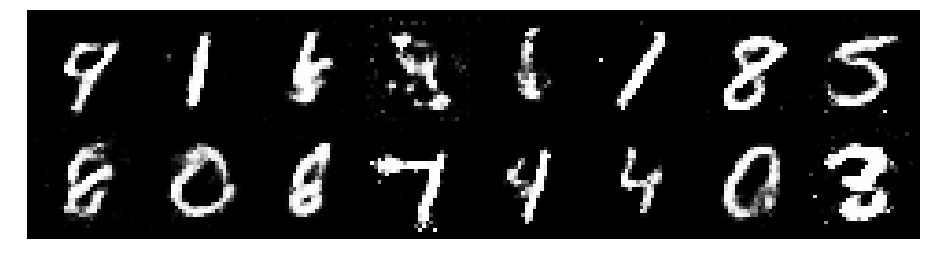

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2141, Generator Loss: 0.9849
D(x): 0.5407, D(G(z)): 0.4171


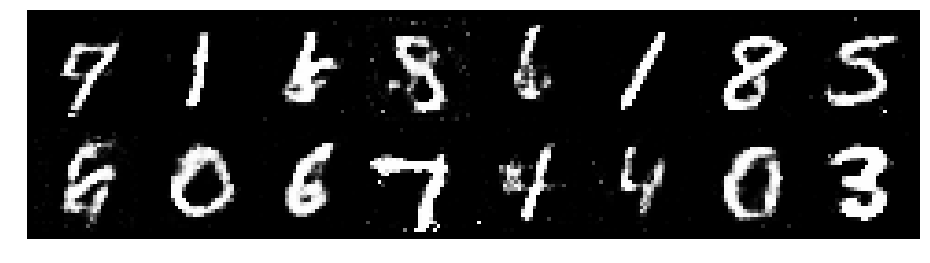

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.3135, Generator Loss: 0.8109
D(x): 0.5427, D(G(z)): 0.4719


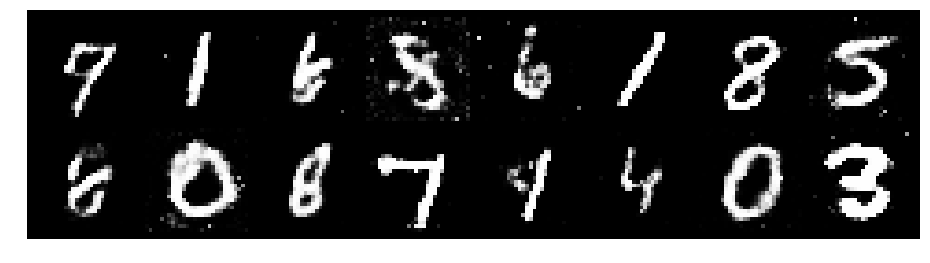

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8835
D(x): 0.5471, D(G(z)): 0.4247


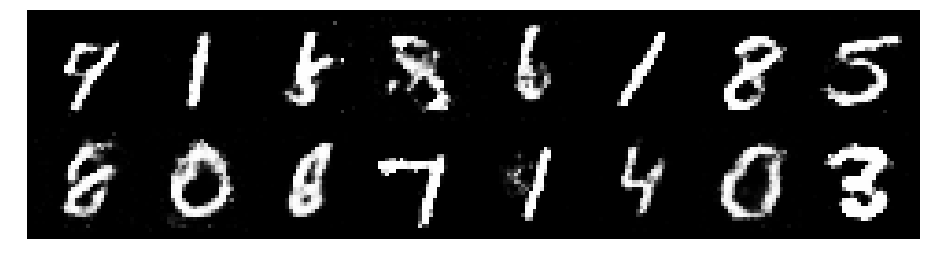

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.4007, Generator Loss: 0.9088
D(x): 0.5196, D(G(z)): 0.4526


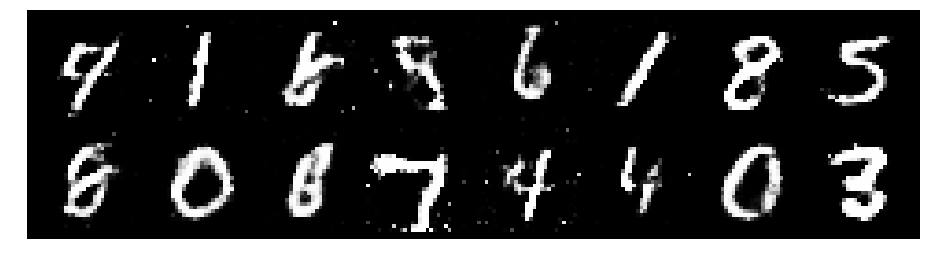

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2835, Generator Loss: 0.8172
D(x): 0.5567, D(G(z)): 0.4523


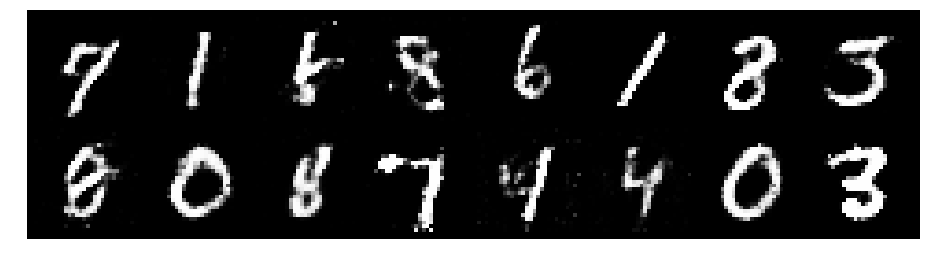

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3512, Generator Loss: 0.8188
D(x): 0.5346, D(G(z)): 0.4556


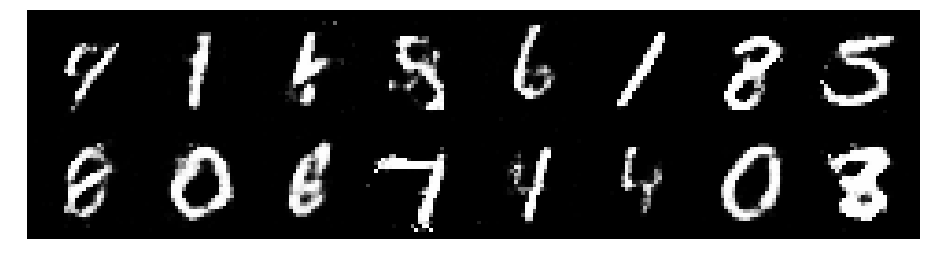

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3837, Generator Loss: 0.8670
D(x): 0.5344, D(G(z)): 0.4765


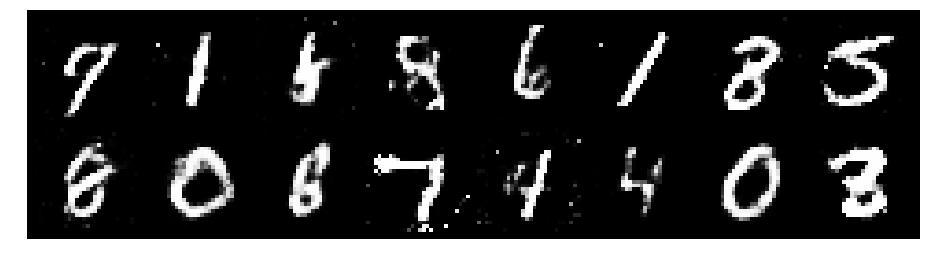

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2099, Generator Loss: 1.0071
D(x): 0.5833, D(G(z)): 0.4223


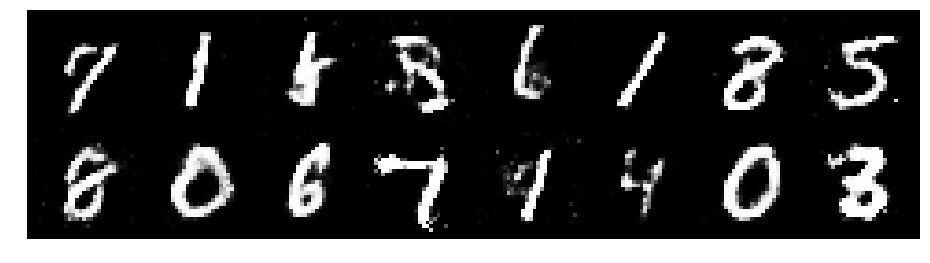

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2739, Generator Loss: 0.9184
D(x): 0.5559, D(G(z)): 0.4331


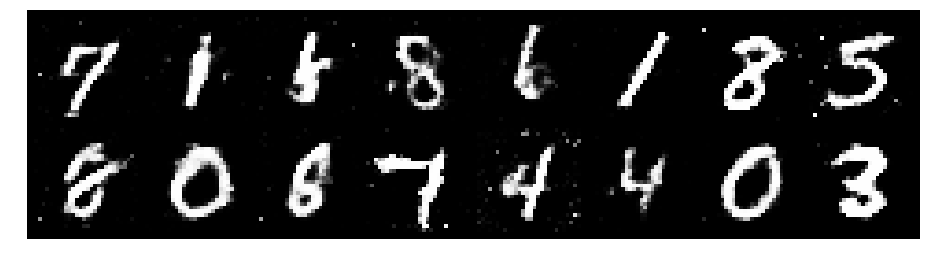

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2177, Generator Loss: 1.0665
D(x): 0.5578, D(G(z)): 0.4110


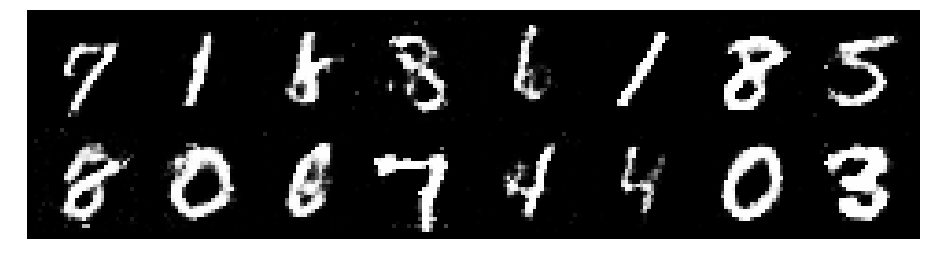

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2179, Generator Loss: 0.8585
D(x): 0.5605, D(G(z)): 0.4353


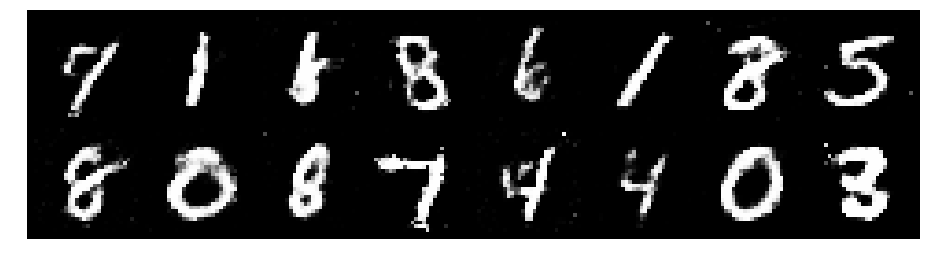

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2755, Generator Loss: 0.9180
D(x): 0.5446, D(G(z)): 0.4368


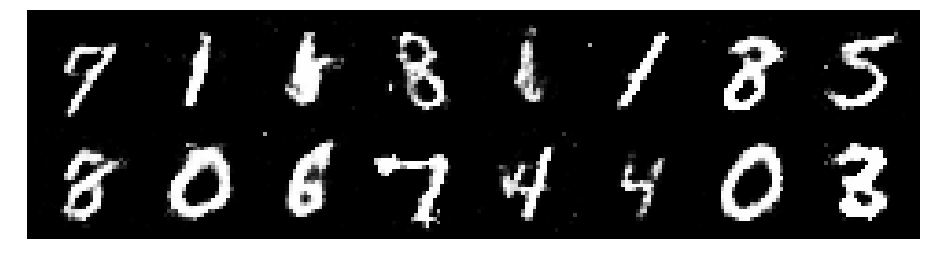

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8712
D(x): 0.5473, D(G(z)): 0.4534


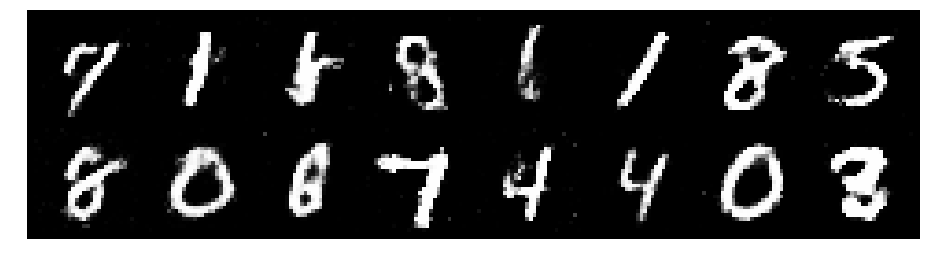

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.1353, Generator Loss: 1.0542
D(x): 0.5774, D(G(z)): 0.3797


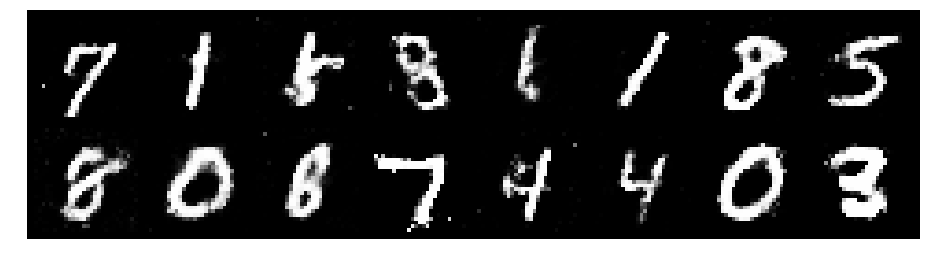

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2147, Generator Loss: 1.0115
D(x): 0.5374, D(G(z)): 0.3803


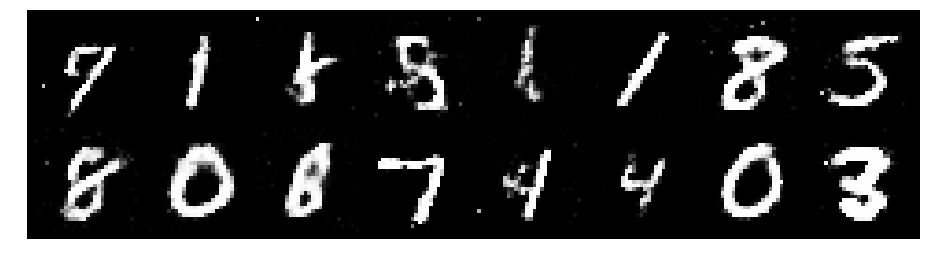

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3744, Generator Loss: 0.9801
D(x): 0.5279, D(G(z)): 0.4654


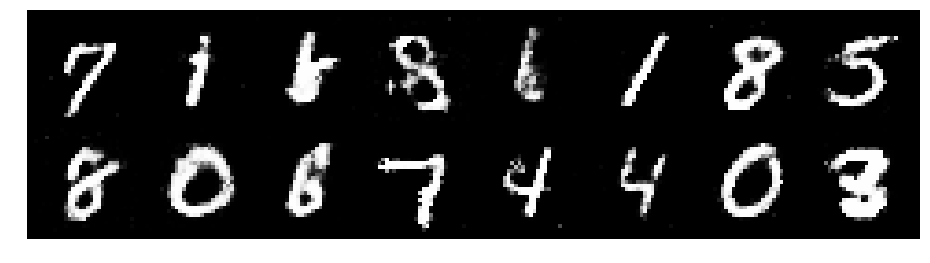

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3527, Generator Loss: 0.8086
D(x): 0.5311, D(G(z)): 0.4710


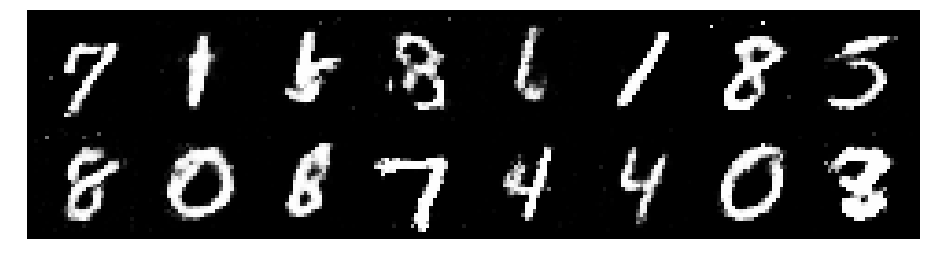

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2527, Generator Loss: 0.8773
D(x): 0.5745, D(G(z)): 0.4355


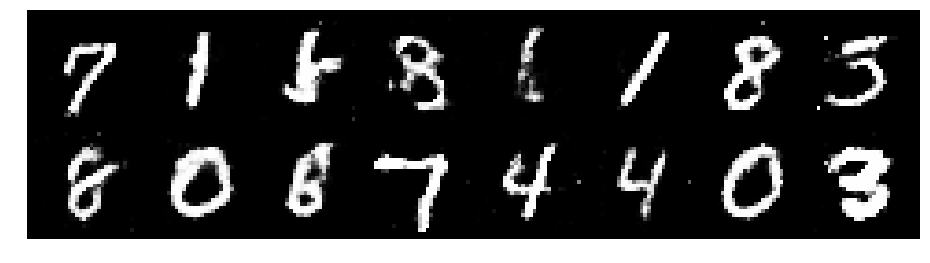

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.3371, Generator Loss: 0.8319
D(x): 0.5565, D(G(z)): 0.4704


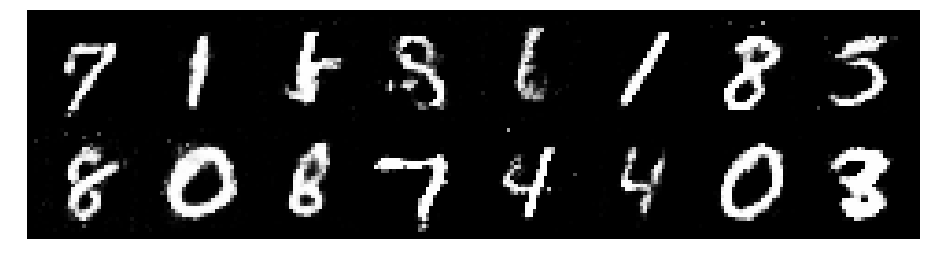

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.4119, Generator Loss: 0.7864
D(x): 0.5638, D(G(z)): 0.5088


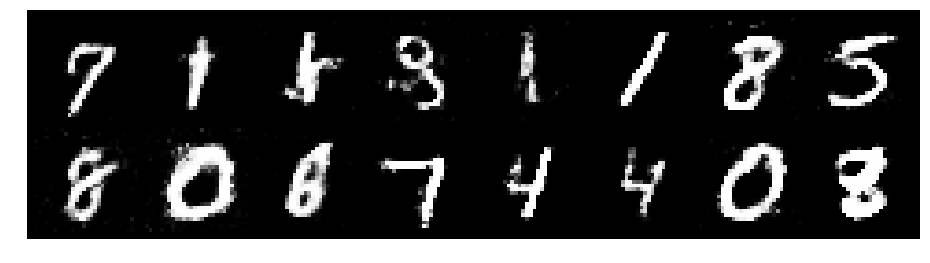

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.4259, Generator Loss: 0.8462
D(x): 0.5245, D(G(z)): 0.4592


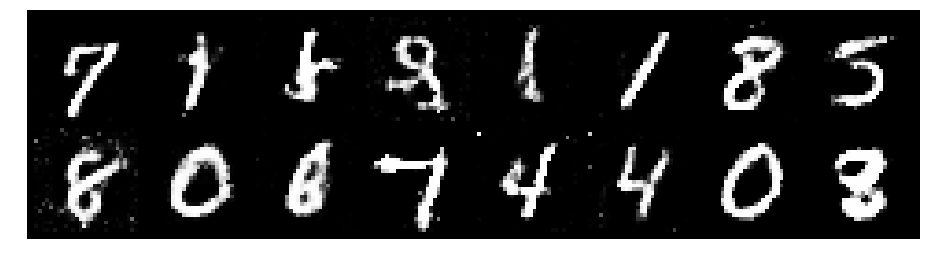

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.3002, Generator Loss: 1.0223
D(x): 0.5540, D(G(z)): 0.4065


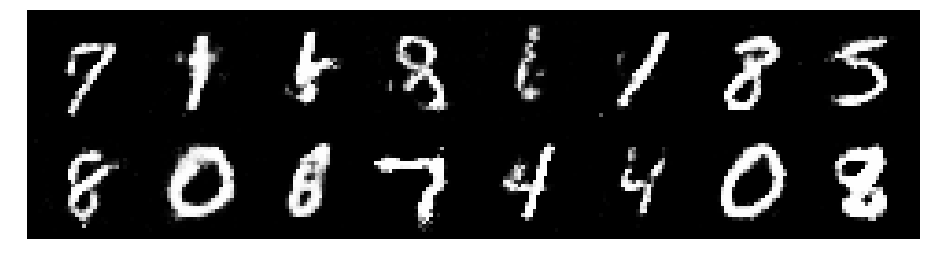

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2391, Generator Loss: 1.0235
D(x): 0.5458, D(G(z)): 0.4034


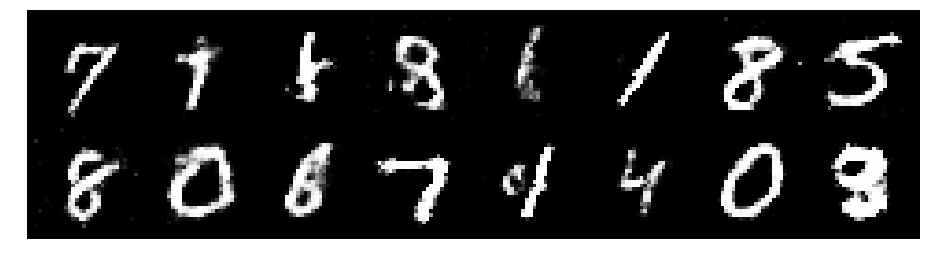

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2595, Generator Loss: 0.8575
D(x): 0.5842, D(G(z)): 0.4506


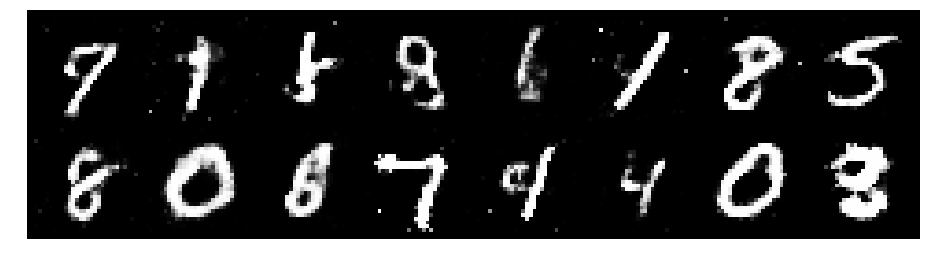

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2588, Generator Loss: 0.8270
D(x): 0.5769, D(G(z)): 0.4381


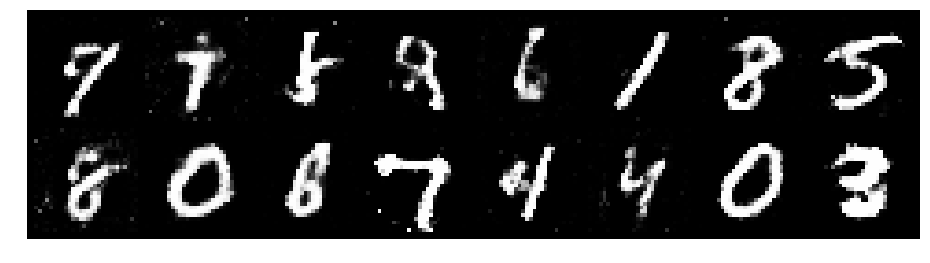

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2061, Generator Loss: 0.9681
D(x): 0.6131, D(G(z)): 0.4492


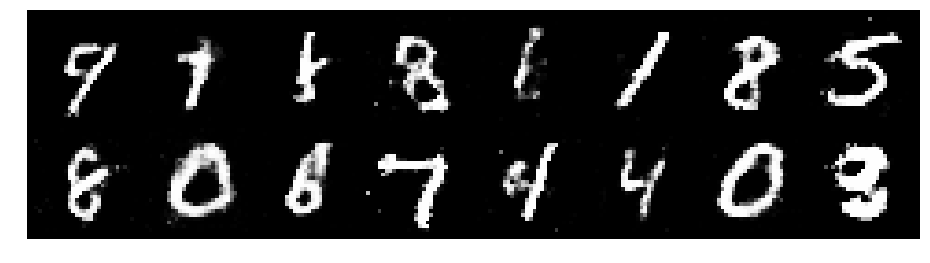

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2391, Generator Loss: 0.9201
D(x): 0.5498, D(G(z)): 0.4121


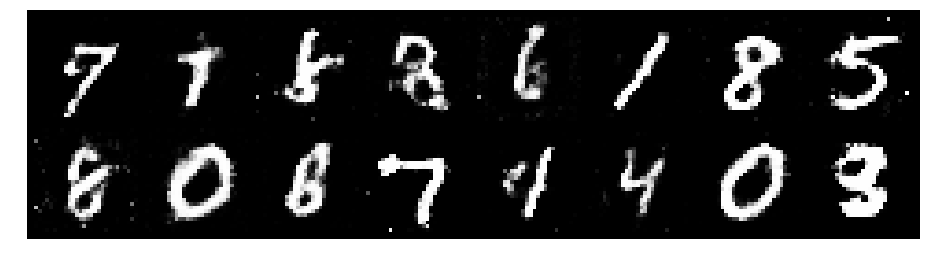

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2884, Generator Loss: 0.8341
D(x): 0.5635, D(G(z)): 0.4546


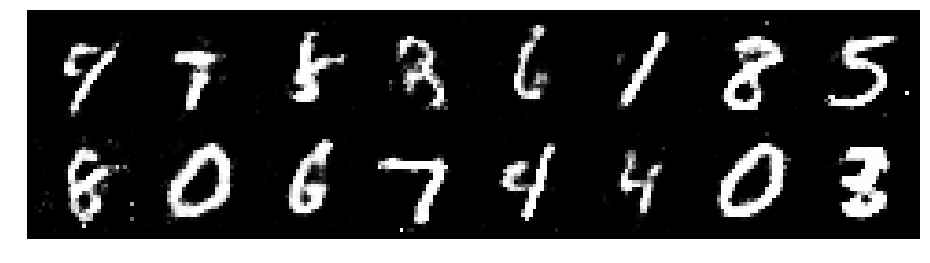

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3636, Generator Loss: 0.8867
D(x): 0.5812, D(G(z)): 0.4765


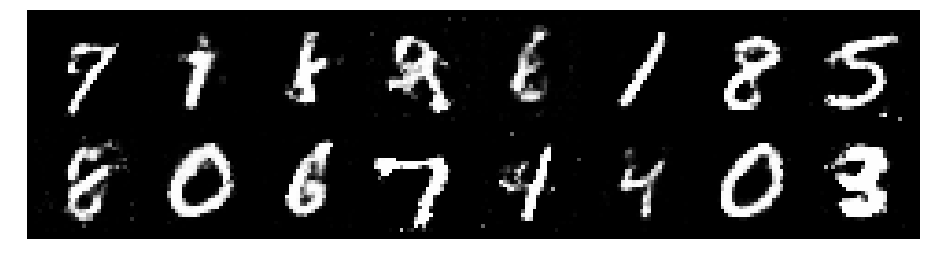

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2569, Generator Loss: 0.9409
D(x): 0.5619, D(G(z)): 0.4378


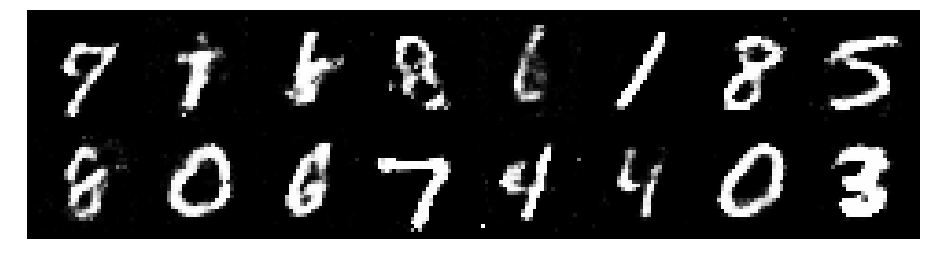

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2092, Generator Loss: 0.9477
D(x): 0.5721, D(G(z)): 0.4244


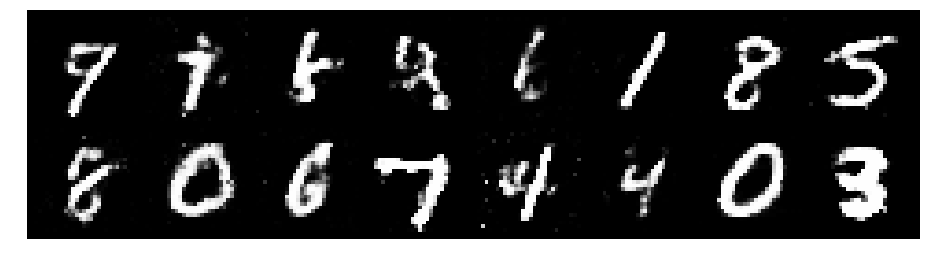

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3801, Generator Loss: 0.9407
D(x): 0.5725, D(G(z)): 0.4777


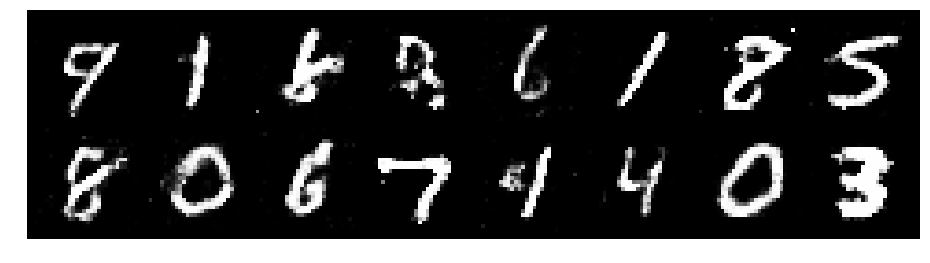

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.0786, Generator Loss: 1.1437
D(x): 0.5907, D(G(z)): 0.3675


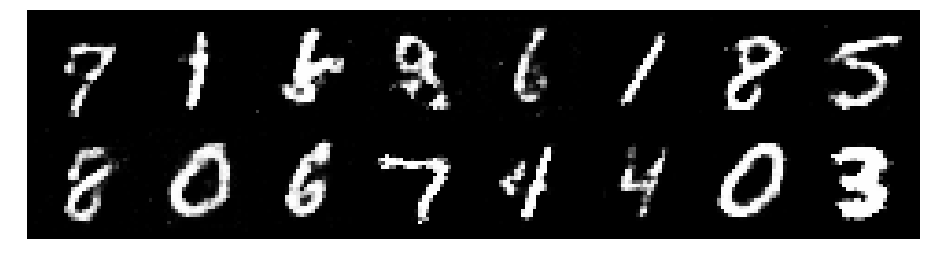

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2602, Generator Loss: 0.9495
D(x): 0.5681, D(G(z)): 0.4401


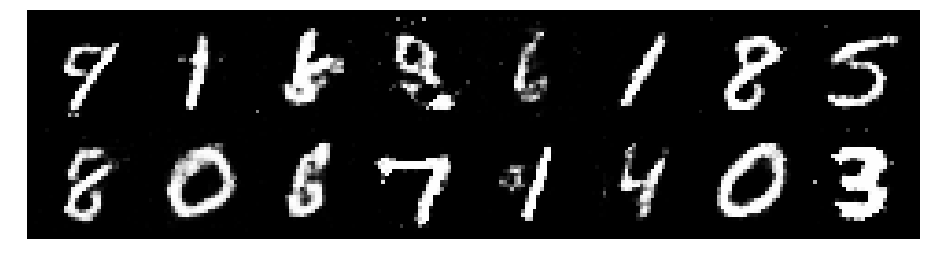

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2265, Generator Loss: 0.9078
D(x): 0.5483, D(G(z)): 0.4181


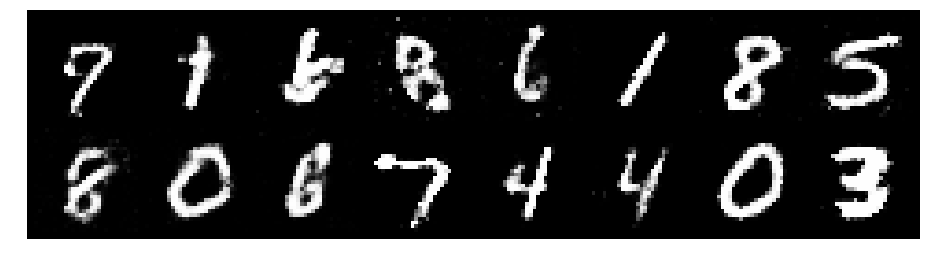

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2031, Generator Loss: 0.9229
D(x): 0.5413, D(G(z)): 0.3991


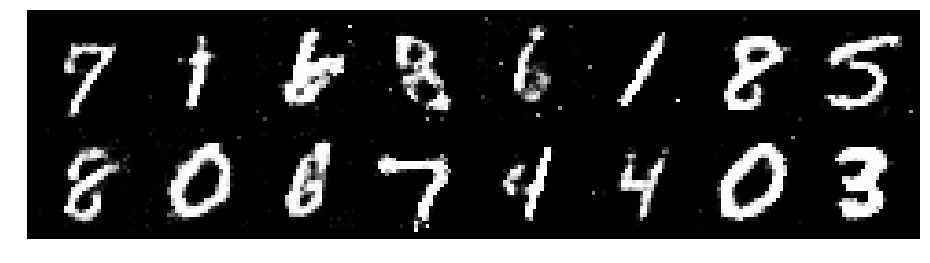

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.3128, Generator Loss: 1.0246
D(x): 0.5478, D(G(z)): 0.4472


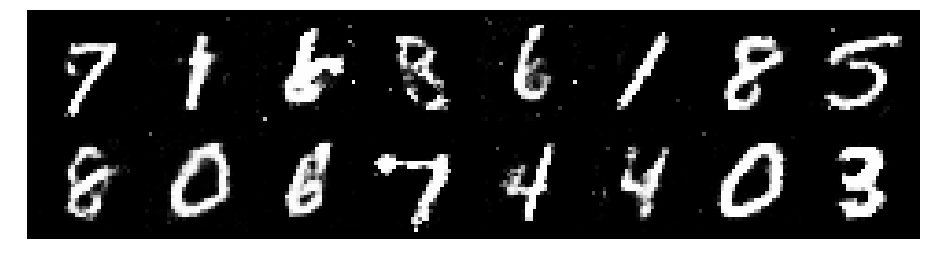

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.1222, Generator Loss: 0.9356
D(x): 0.6218, D(G(z)): 0.4144


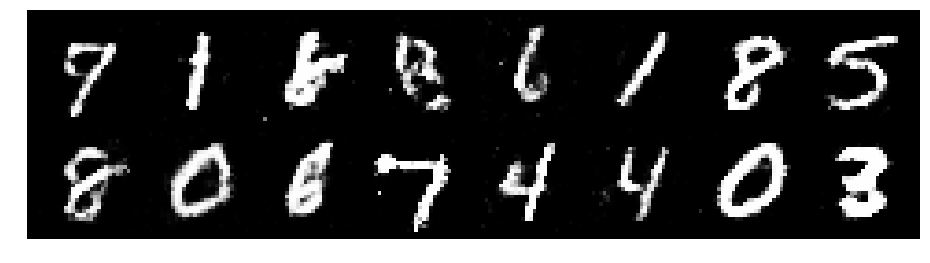

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.1289, Generator Loss: 0.9880
D(x): 0.5746, D(G(z)): 0.4027


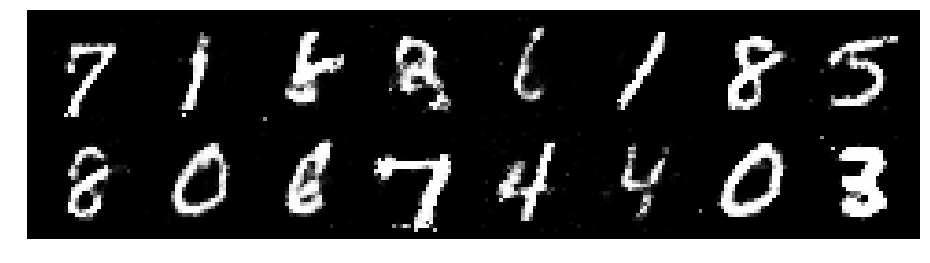

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.1875, Generator Loss: 0.9376
D(x): 0.5458, D(G(z)): 0.4048


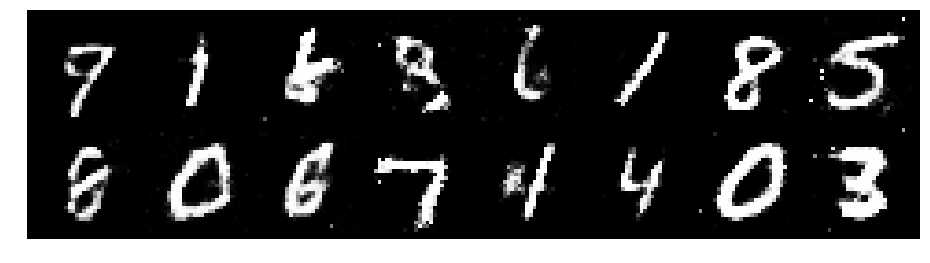

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2740, Generator Loss: 0.9814
D(x): 0.5701, D(G(z)): 0.4490


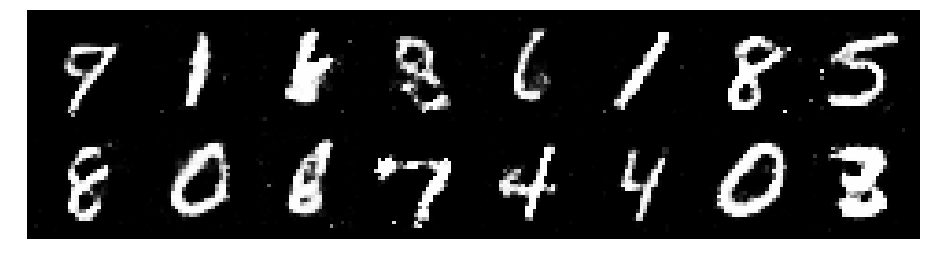

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2292, Generator Loss: 0.9445
D(x): 0.5500, D(G(z)): 0.4006


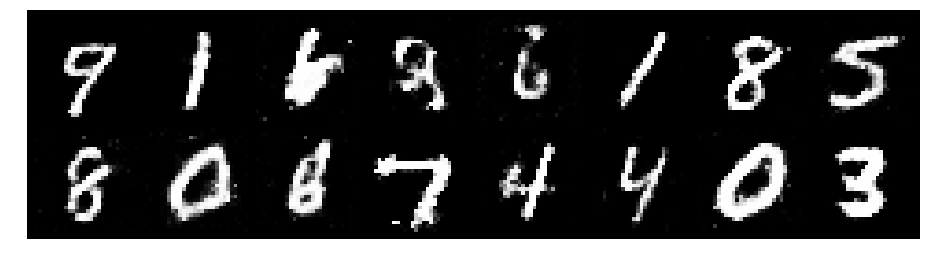

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.1862, Generator Loss: 0.9464
D(x): 0.5783, D(G(z)): 0.4209


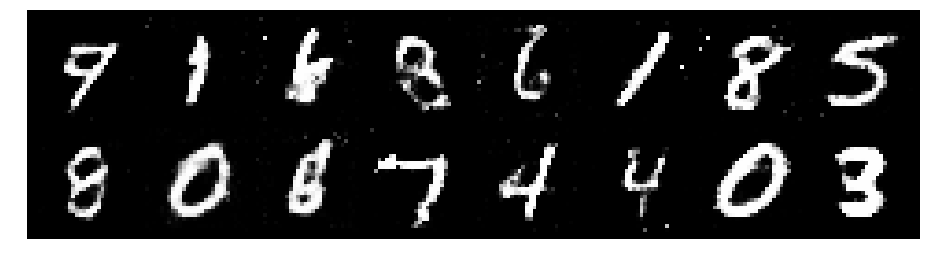

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.1954, Generator Loss: 1.0278
D(x): 0.5332, D(G(z)): 0.3876


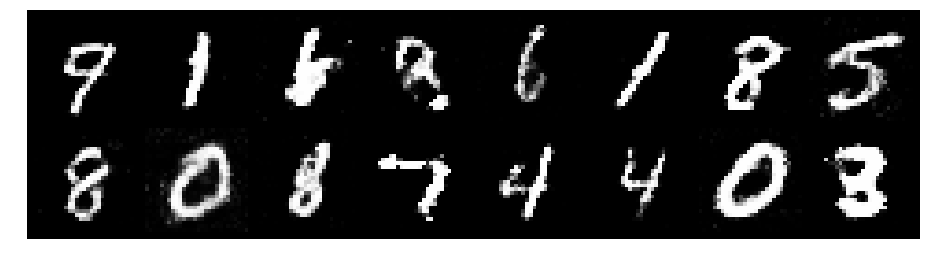

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2266, Generator Loss: 0.8925
D(x): 0.5719, D(G(z)): 0.4331


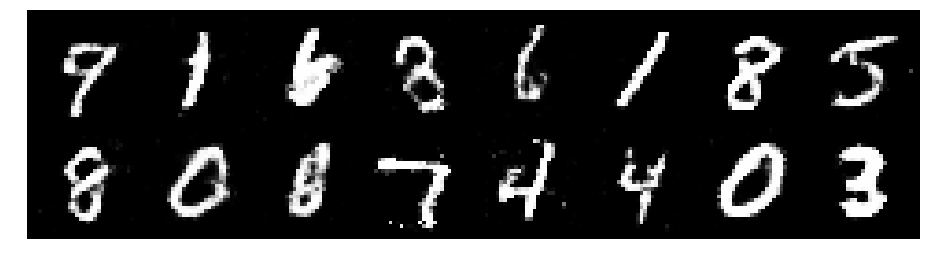

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.3084, Generator Loss: 0.7795
D(x): 0.5417, D(G(z)): 0.4822


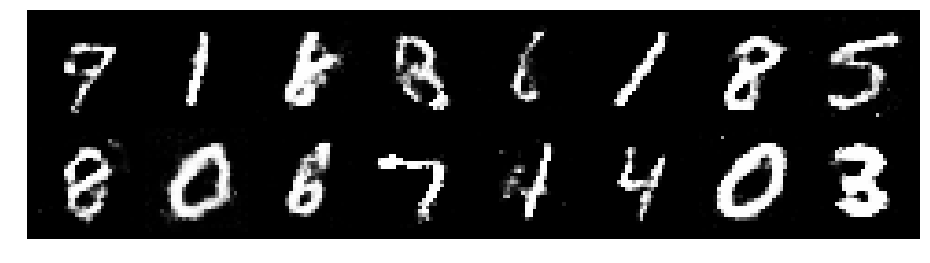

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.1821, Generator Loss: 0.8937
D(x): 0.5742, D(G(z)): 0.4394


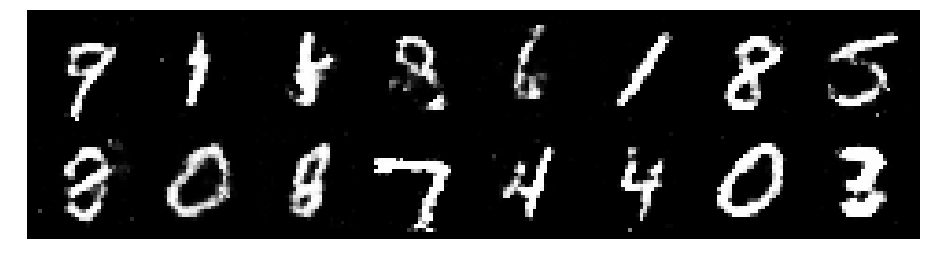

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2721, Generator Loss: 0.7799
D(x): 0.5635, D(G(z)): 0.4684


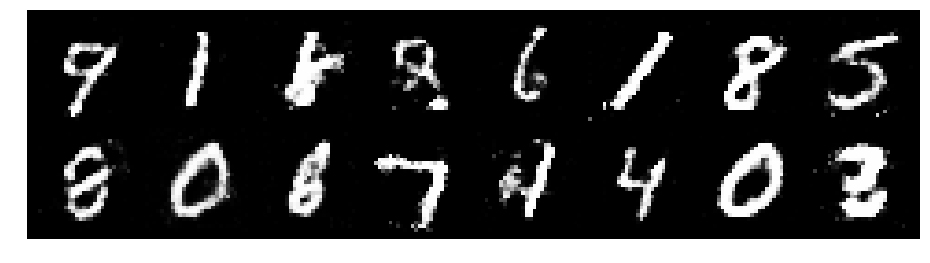

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.1100, Generator Loss: 0.9172
D(x): 0.5742, D(G(z)): 0.3765


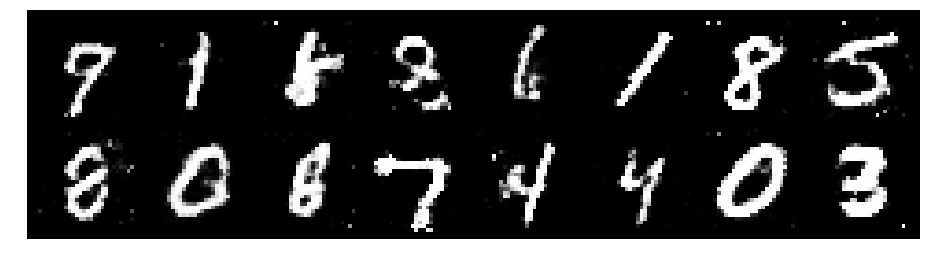

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.1890, Generator Loss: 0.8629
D(x): 0.6480, D(G(z)): 0.4659


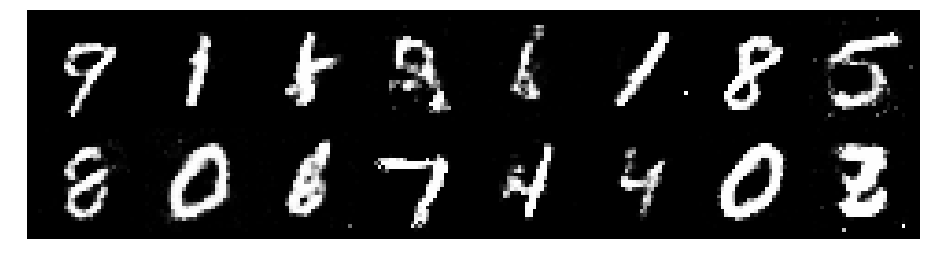

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2709, Generator Loss: 0.8781
D(x): 0.5940, D(G(z)): 0.4718


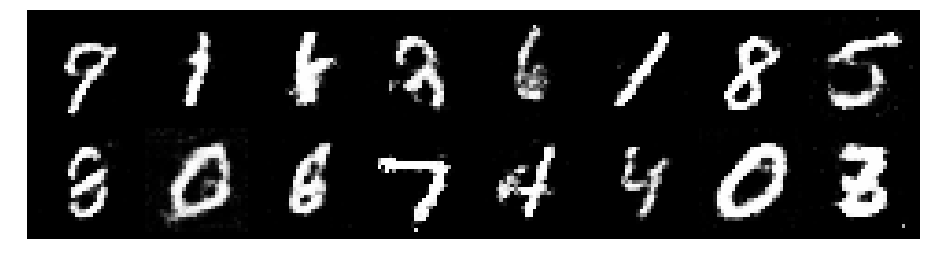

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2539, Generator Loss: 1.0006
D(x): 0.5348, D(G(z)): 0.4105


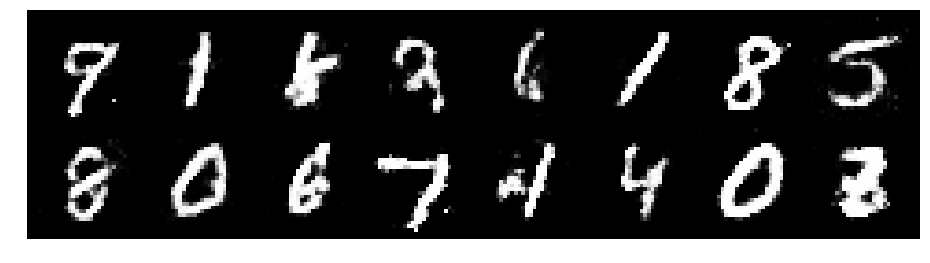

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2183, Generator Loss: 0.8562
D(x): 0.5462, D(G(z)): 0.4282


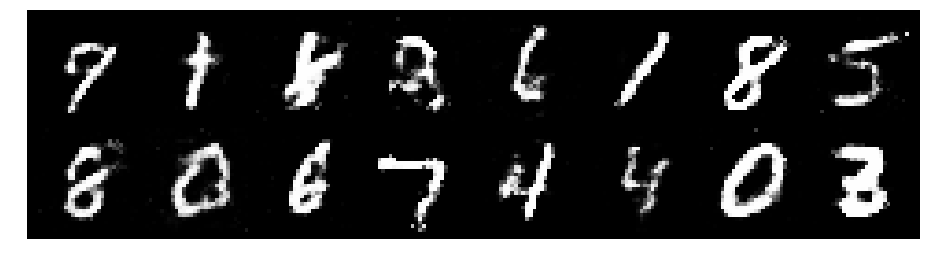

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3059, Generator Loss: 0.8195
D(x): 0.5292, D(G(z)): 0.4496


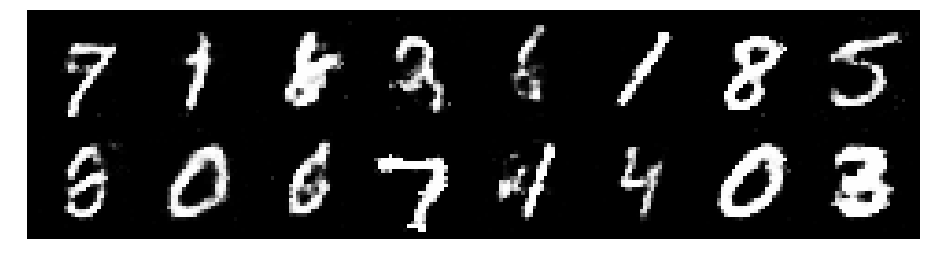

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3071, Generator Loss: 0.9592
D(x): 0.5529, D(G(z)): 0.4622


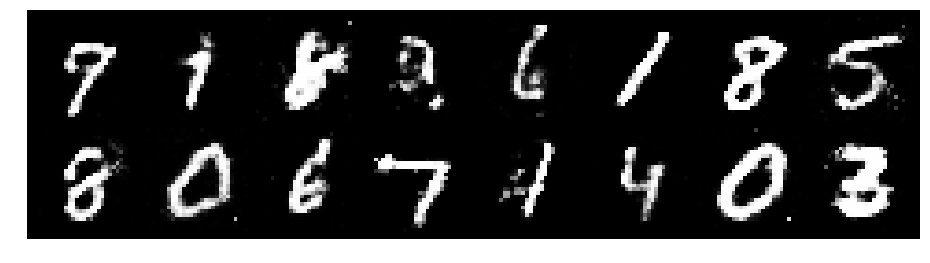

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.3206, Generator Loss: 0.8926
D(x): 0.5038, D(G(z)): 0.4143


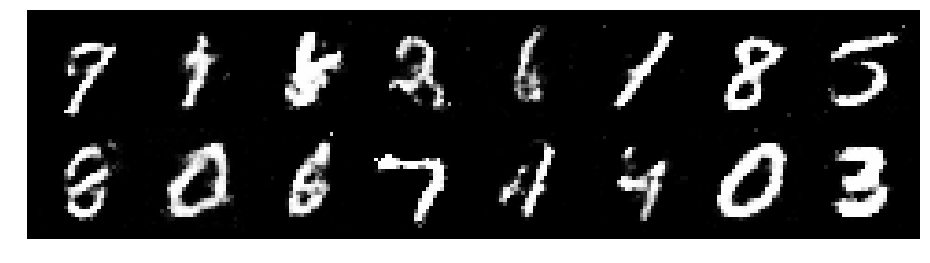

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2079, Generator Loss: 0.8946
D(x): 0.5657, D(G(z)): 0.4167


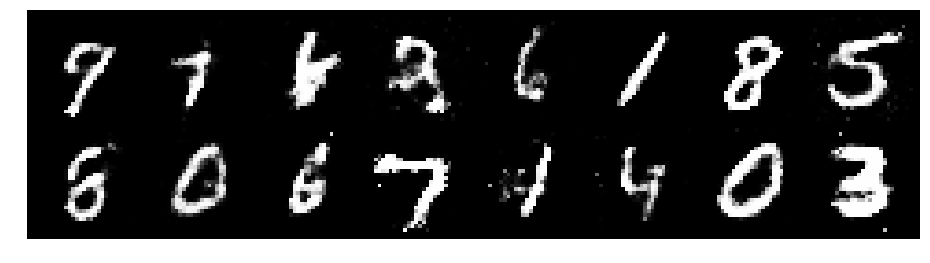

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2130, Generator Loss: 0.9235
D(x): 0.5764, D(G(z)): 0.4311


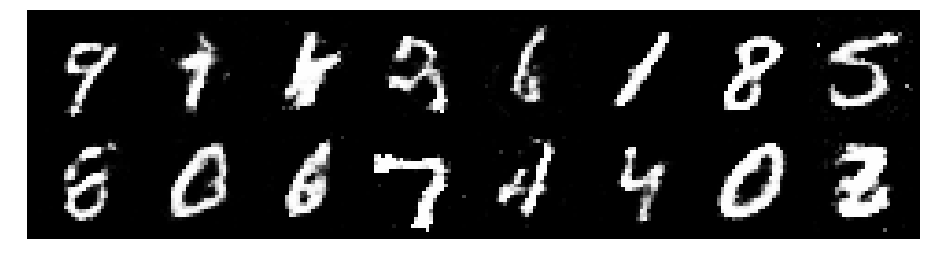

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2361, Generator Loss: 0.9309
D(x): 0.5744, D(G(z)): 0.4560


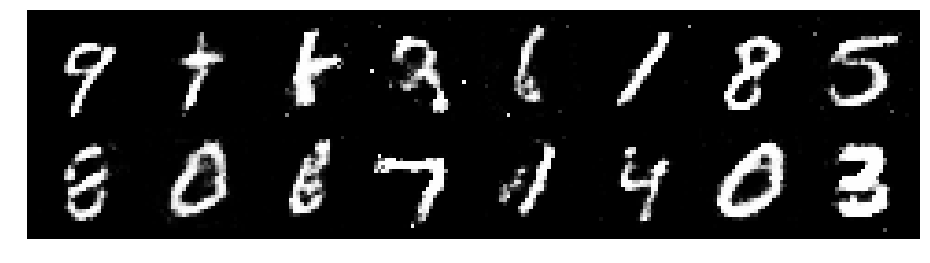

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.1744, Generator Loss: 0.9411
D(x): 0.6019, D(G(z)): 0.4355


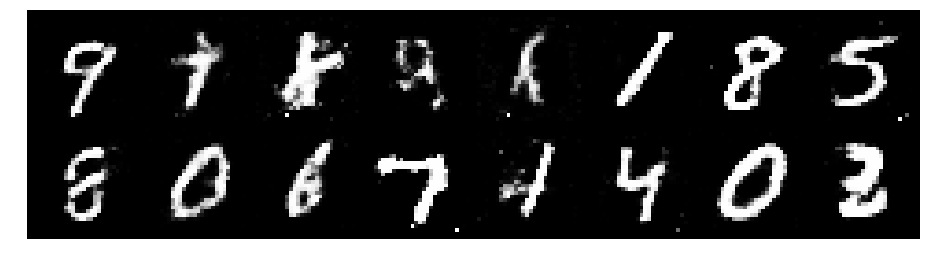

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2388, Generator Loss: 0.9748
D(x): 0.5242, D(G(z)): 0.3933


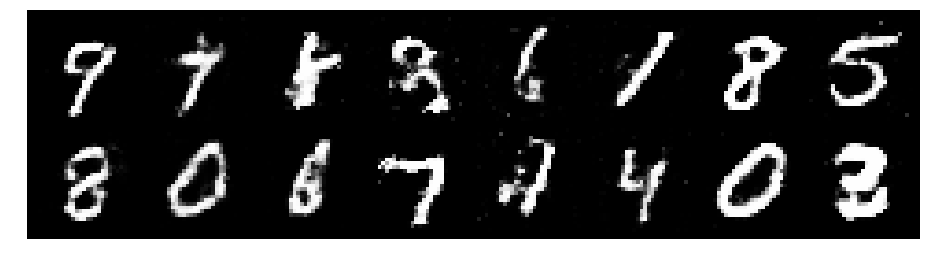

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.1475, Generator Loss: 0.9749
D(x): 0.5914, D(G(z)): 0.4057


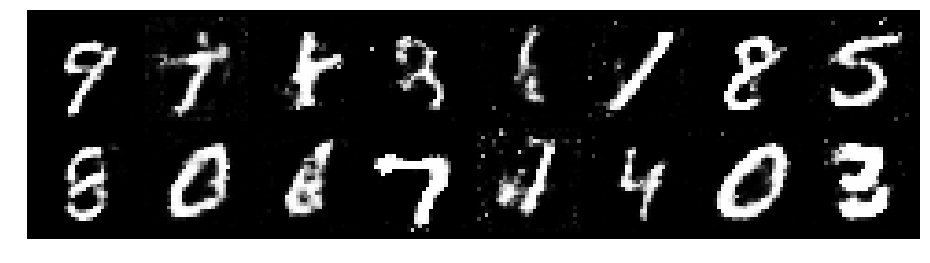

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3343, Generator Loss: 1.0843
D(x): 0.5177, D(G(z)): 0.4246


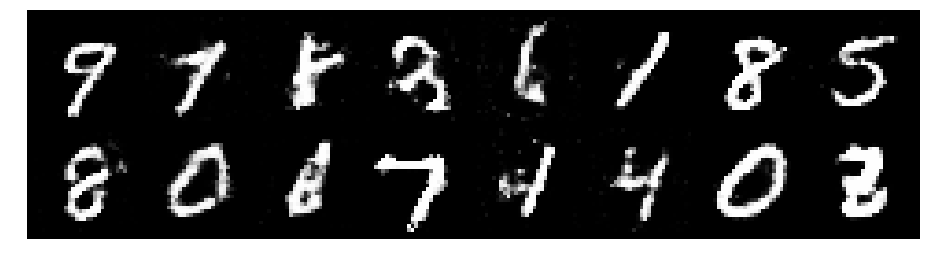

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.1614, Generator Loss: 1.0412
D(x): 0.6120, D(G(z)): 0.4163


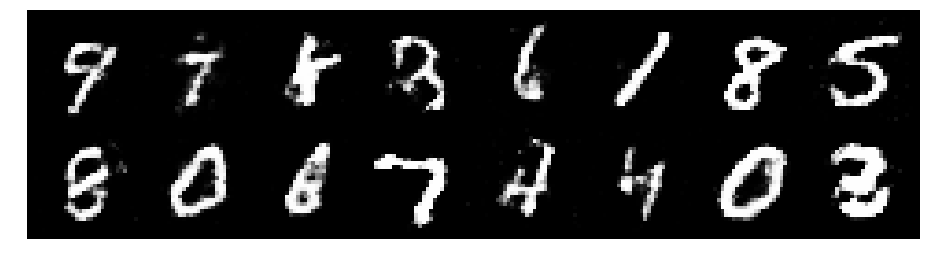

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2922, Generator Loss: 0.9606
D(x): 0.5899, D(G(z)): 0.4893


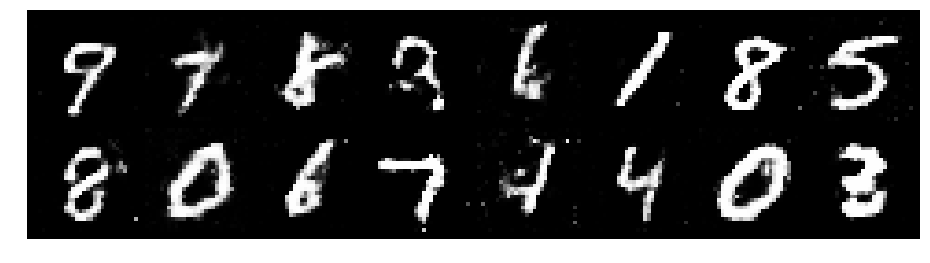

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2437, Generator Loss: 0.8495
D(x): 0.5681, D(G(z)): 0.4576


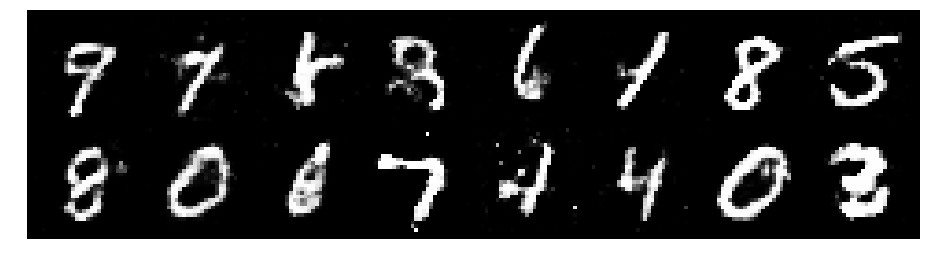

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2488, Generator Loss: 0.8583
D(x): 0.5424, D(G(z)): 0.4204


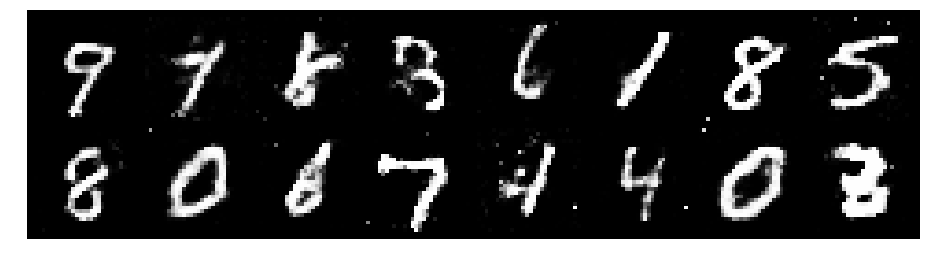

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1703, Generator Loss: 0.8613
D(x): 0.6091, D(G(z)): 0.4377


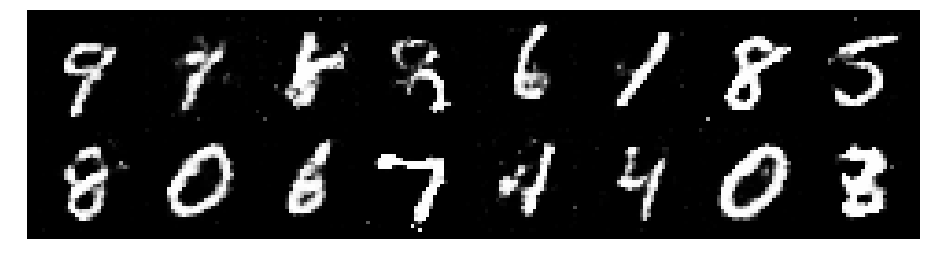

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.3107, Generator Loss: 0.8320
D(x): 0.5730, D(G(z)): 0.4646


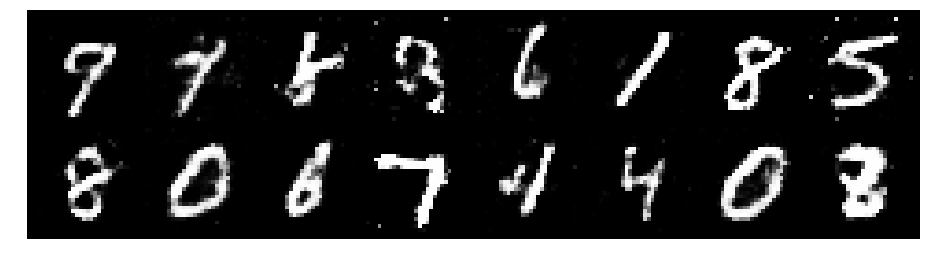

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2795, Generator Loss: 0.9557
D(x): 0.5599, D(G(z)): 0.4336


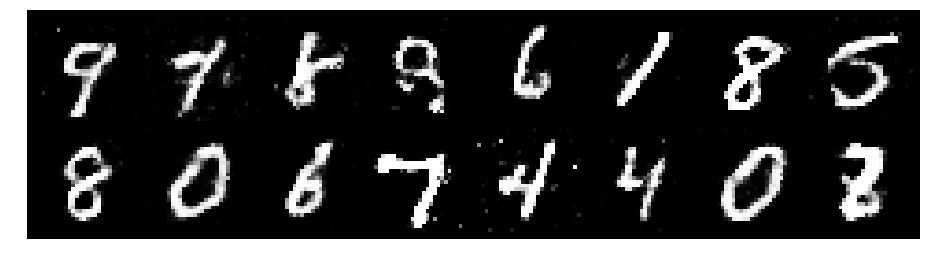

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.2629, Generator Loss: 0.9938
D(x): 0.5629, D(G(z)): 0.4448


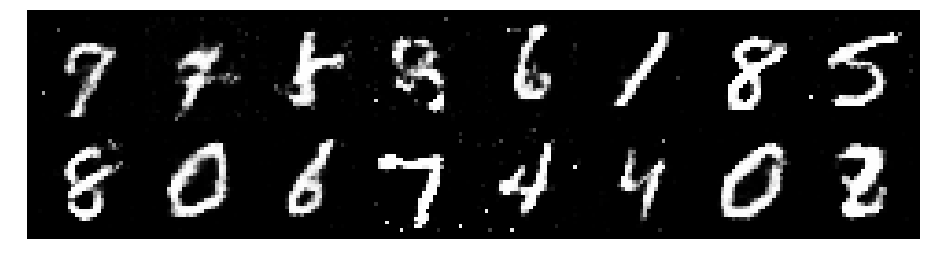

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2525, Generator Loss: 0.9485
D(x): 0.5357, D(G(z)): 0.4187


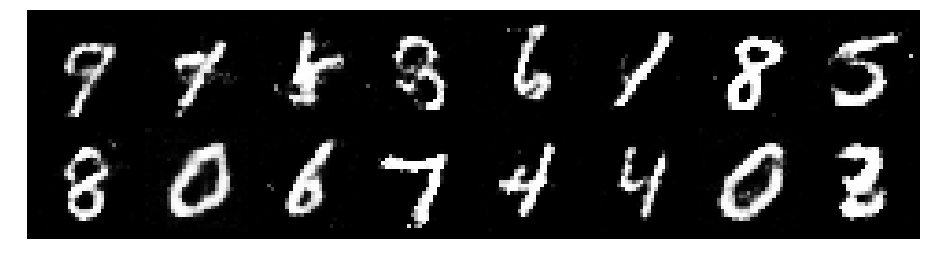

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.1842, Generator Loss: 1.0217
D(x): 0.5688, D(G(z)): 0.3874


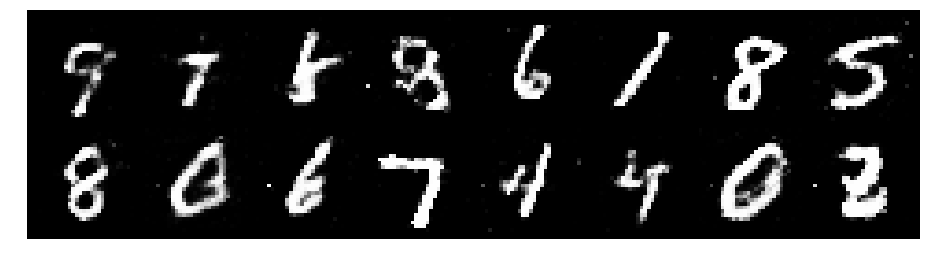

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2361, Generator Loss: 0.9980
D(x): 0.6073, D(G(z)): 0.4665


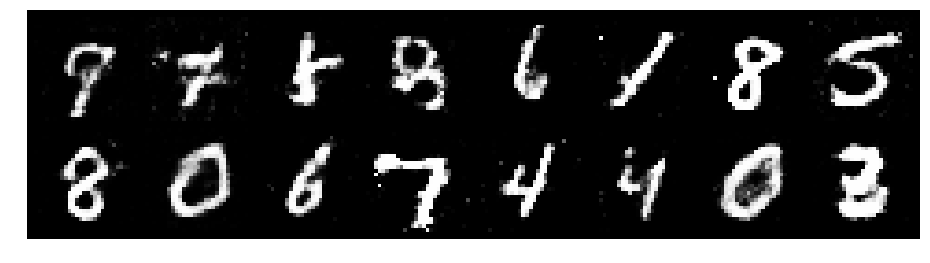

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.4306, Generator Loss: 0.9229
D(x): 0.5146, D(G(z)): 0.4663


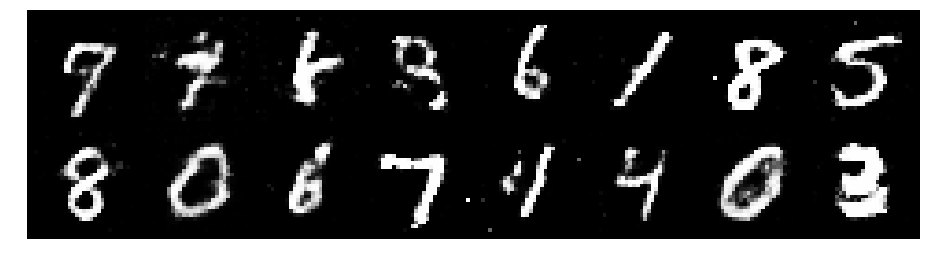

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2733, Generator Loss: 0.8894
D(x): 0.5953, D(G(z)): 0.4591


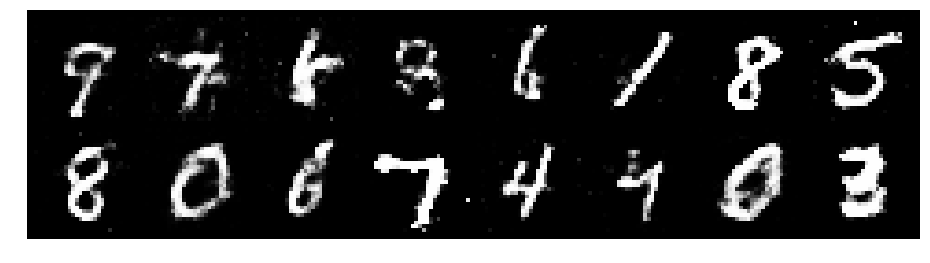

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2682, Generator Loss: 0.8018
D(x): 0.6210, D(G(z)): 0.4991


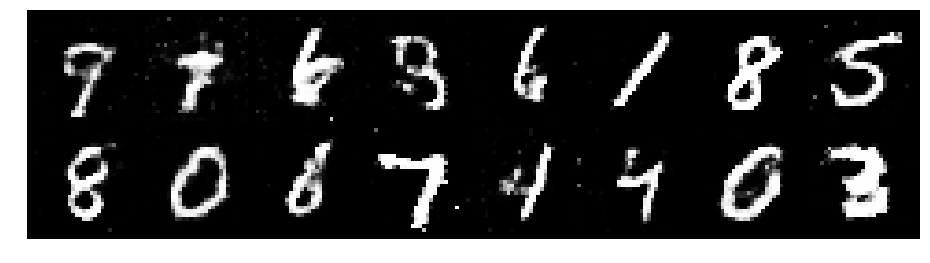

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2602, Generator Loss: 0.9256
D(x): 0.5557, D(G(z)): 0.4390


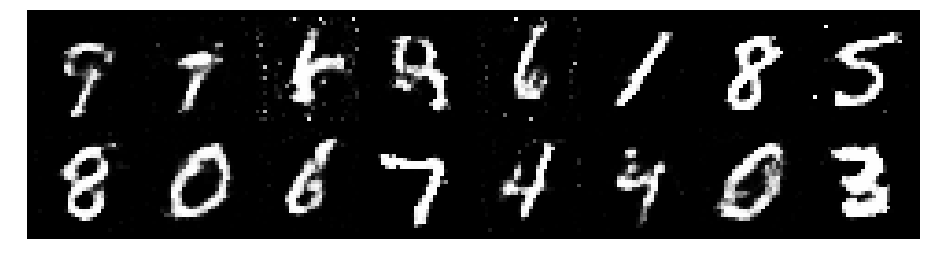

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3321, Generator Loss: 0.9574
D(x): 0.5946, D(G(z)): 0.4682


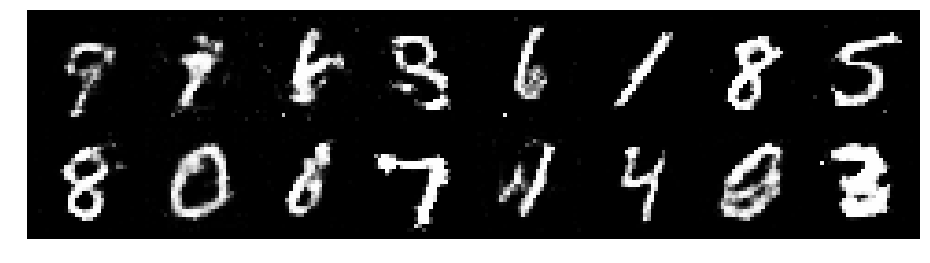

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.1060, Generator Loss: 1.0708
D(x): 0.6161, D(G(z)): 0.4021


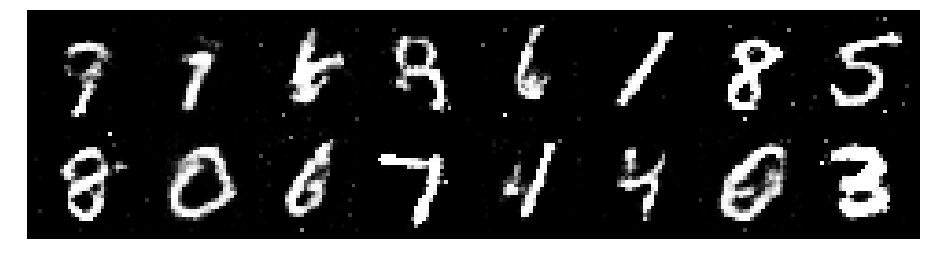

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.2792, Generator Loss: 0.8973
D(x): 0.5382, D(G(z)): 0.4546


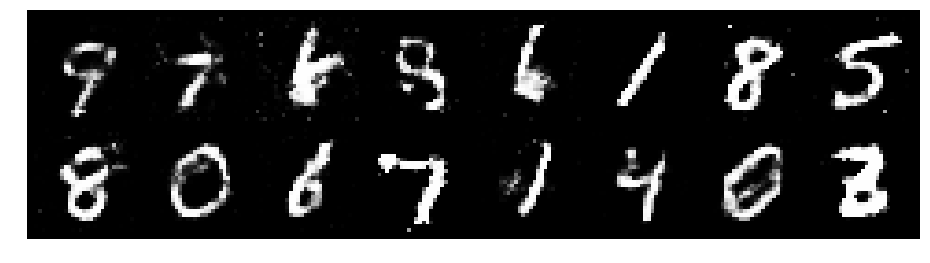

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2976, Generator Loss: 0.8585
D(x): 0.5368, D(G(z)): 0.4412


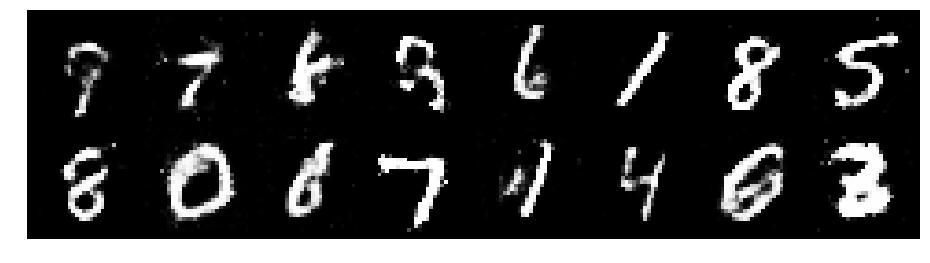

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2642, Generator Loss: 0.8557
D(x): 0.5325, D(G(z)): 0.4190


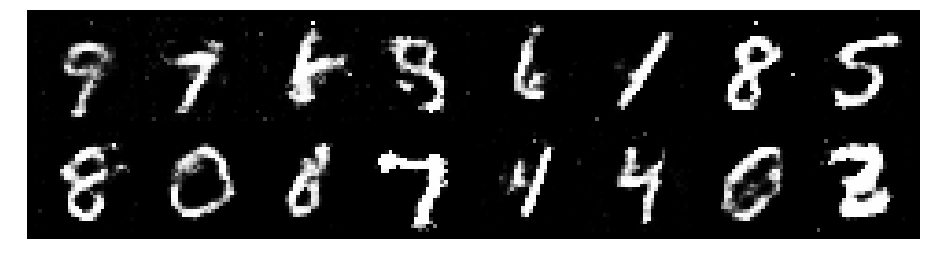

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9140
D(x): 0.5636, D(G(z)): 0.4172


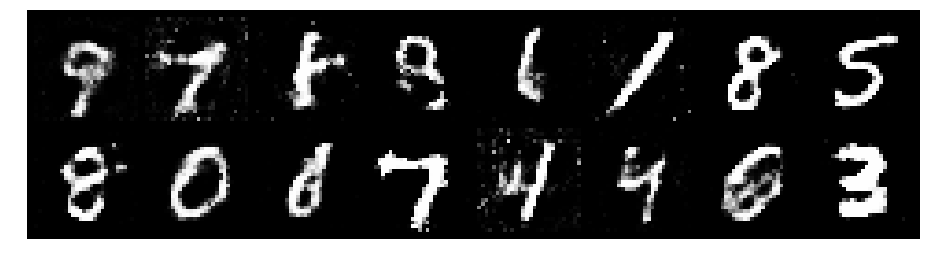

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.3595, Generator Loss: 0.8580
D(x): 0.5842, D(G(z)): 0.5079


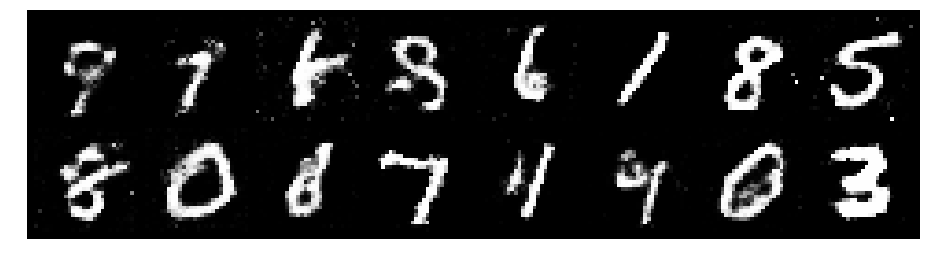

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2861, Generator Loss: 0.9758
D(x): 0.5524, D(G(z)): 0.4397


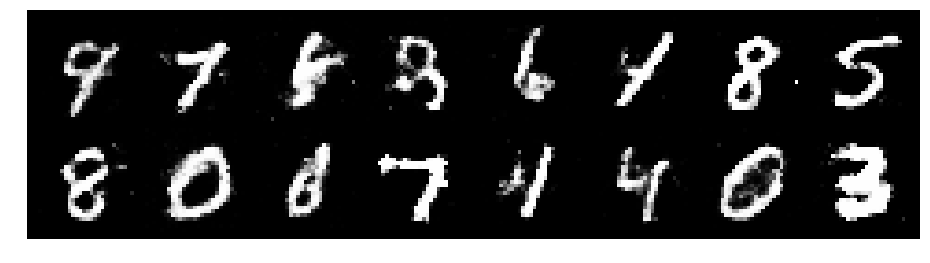

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2059, Generator Loss: 0.8879
D(x): 0.5611, D(G(z)): 0.4287


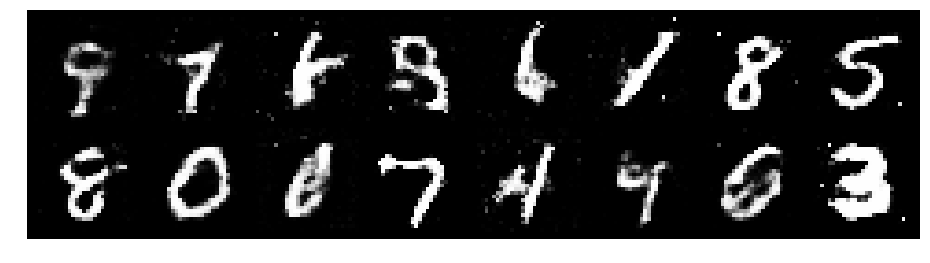

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.3515, Generator Loss: 0.7886
D(x): 0.5591, D(G(z)): 0.4823


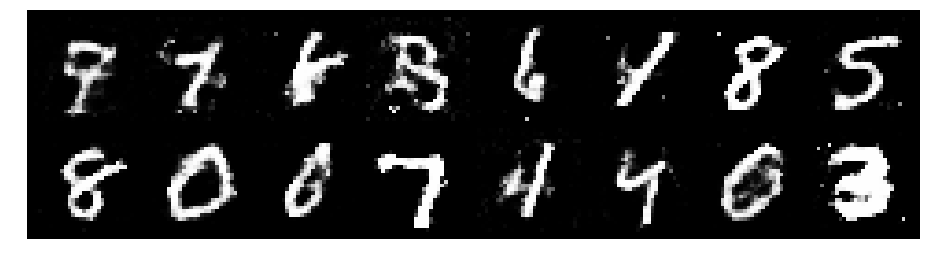

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.3278, Generator Loss: 0.9882
D(x): 0.5656, D(G(z)): 0.4202


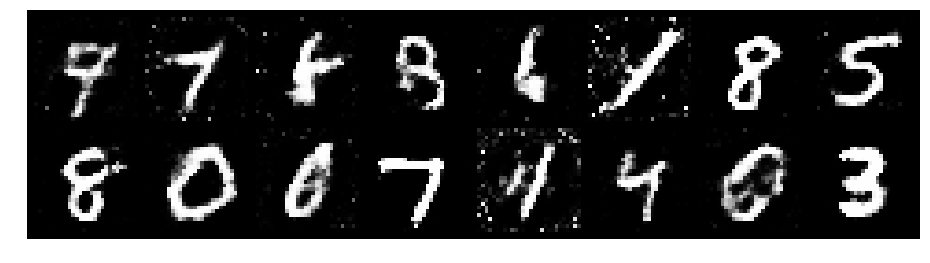

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2293, Generator Loss: 1.0174
D(x): 0.5531, D(G(z)): 0.4051


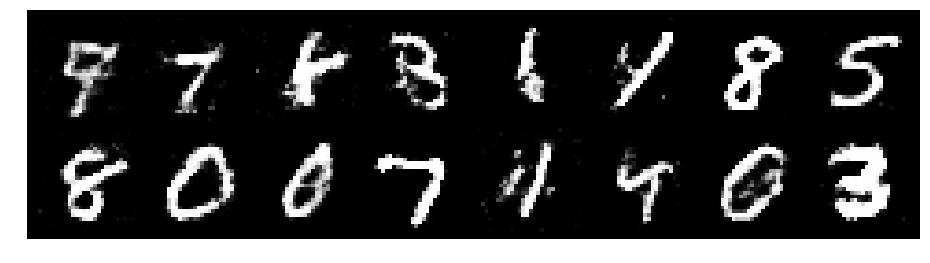

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3238, Generator Loss: 0.8199
D(x): 0.5583, D(G(z)): 0.4633


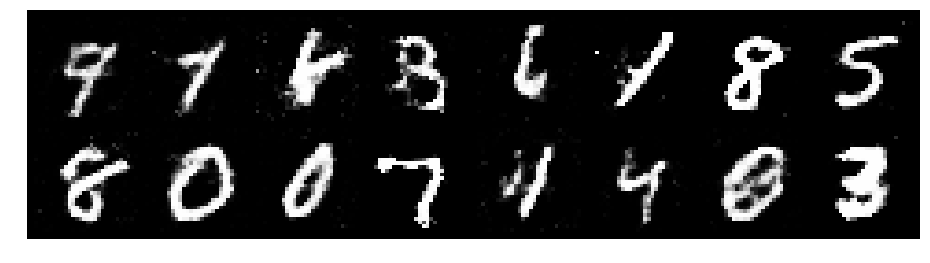

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2764, Generator Loss: 1.0664
D(x): 0.5303, D(G(z)): 0.4039


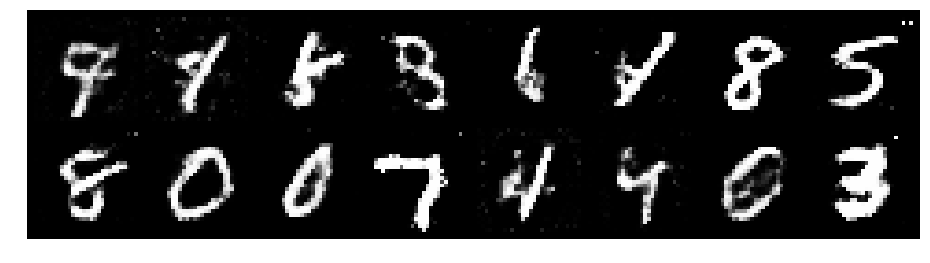

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2788, Generator Loss: 0.9844
D(x): 0.5177, D(G(z)): 0.4075


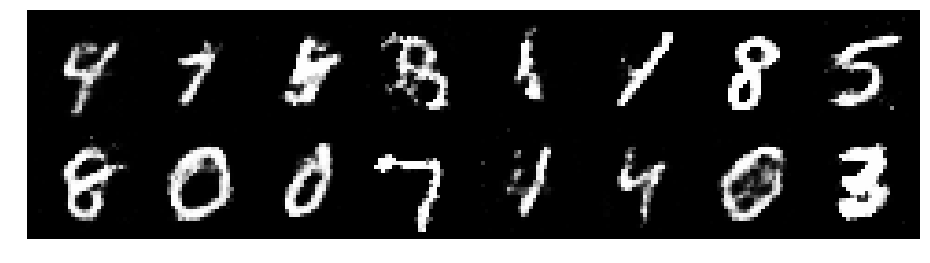

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2817, Generator Loss: 0.9423
D(x): 0.5597, D(G(z)): 0.4555


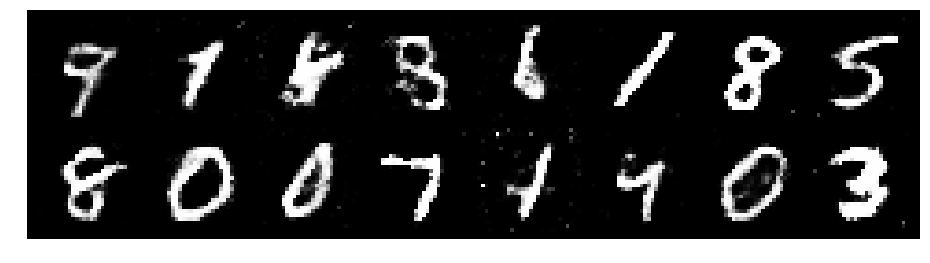

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.3061, Generator Loss: 0.8970
D(x): 0.5304, D(G(z)): 0.4458


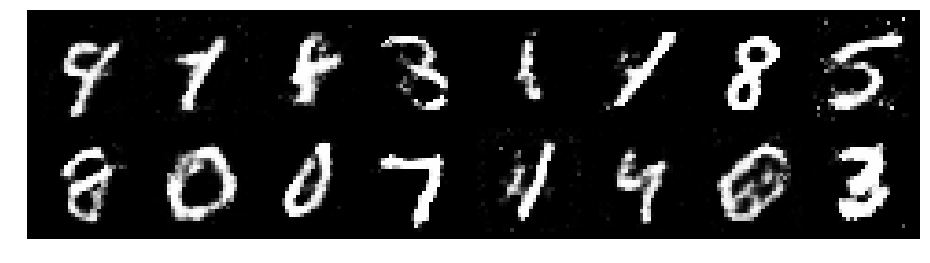

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.3546, Generator Loss: 0.9142
D(x): 0.5279, D(G(z)): 0.4360


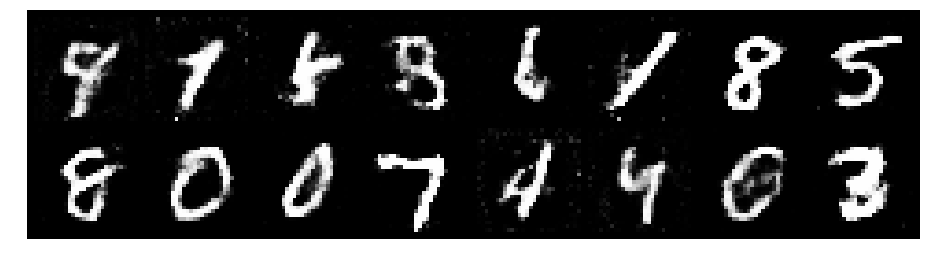

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2266, Generator Loss: 0.9008
D(x): 0.6054, D(G(z)): 0.4409


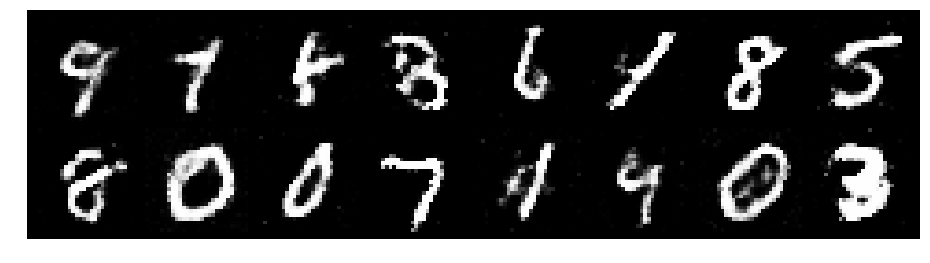

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8784
D(x): 0.5526, D(G(z)): 0.4400


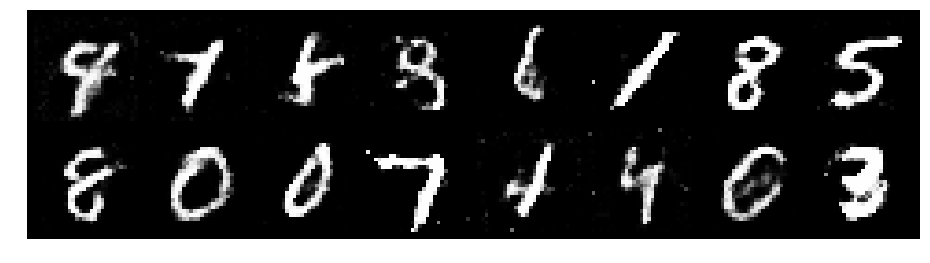

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.2285, Generator Loss: 0.9986
D(x): 0.5633, D(G(z)): 0.4088


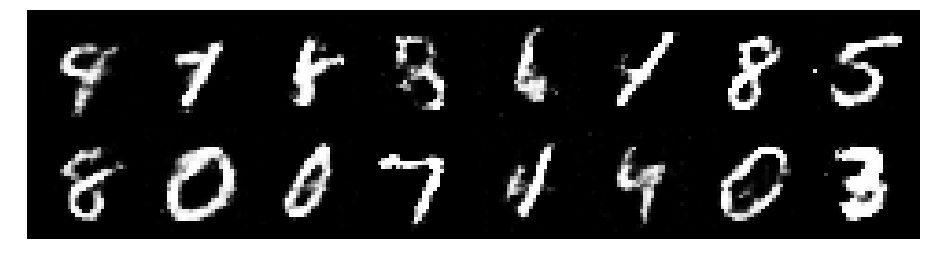

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2196, Generator Loss: 0.9974
D(x): 0.5667, D(G(z)): 0.4371


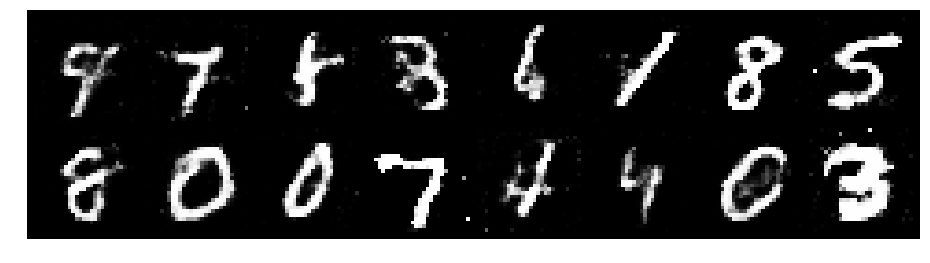

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2569, Generator Loss: 0.8957
D(x): 0.5324, D(G(z)): 0.4061


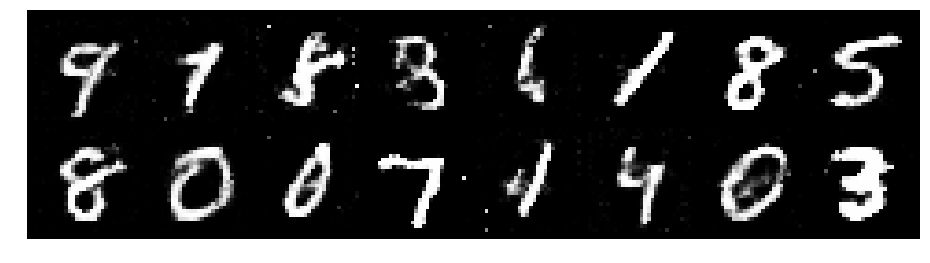

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.1656, Generator Loss: 0.9562
D(x): 0.5891, D(G(z)): 0.4312


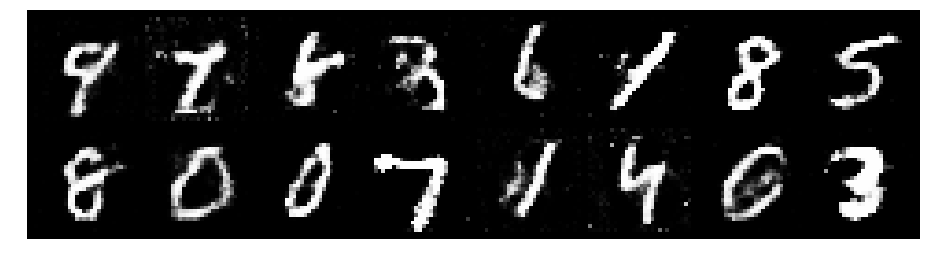

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2230, Generator Loss: 0.8981
D(x): 0.5522, D(G(z)): 0.4219


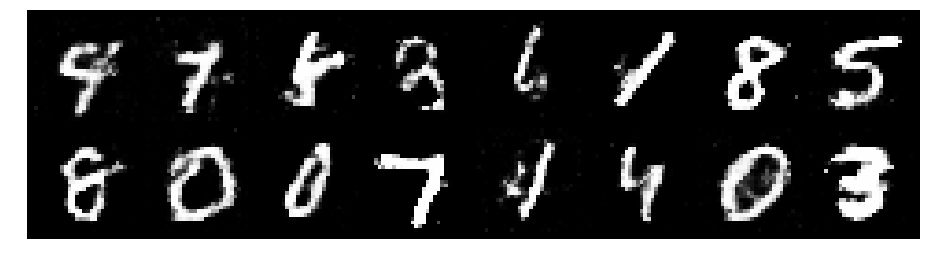

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.1879, Generator Loss: 0.9159
D(x): 0.5739, D(G(z)): 0.4320


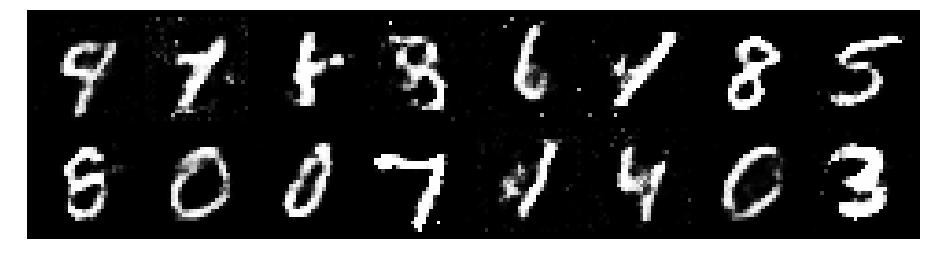

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2822, Generator Loss: 0.8197
D(x): 0.5620, D(G(z)): 0.4715


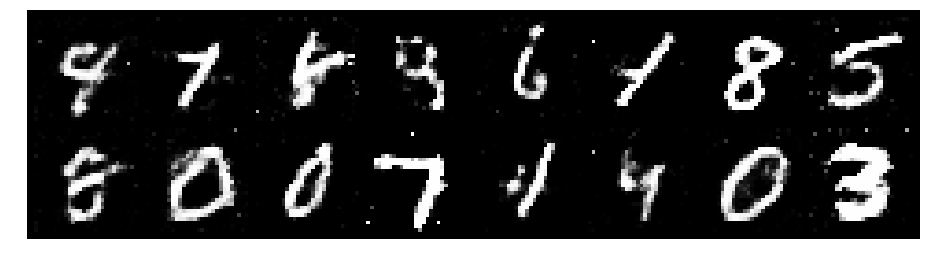

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2647, Generator Loss: 0.8112
D(x): 0.5739, D(G(z)): 0.4686


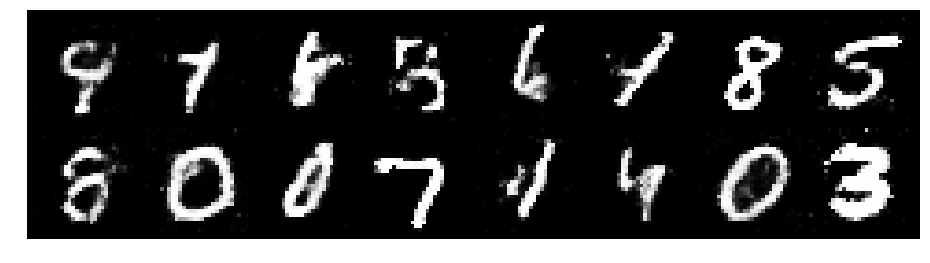

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2423, Generator Loss: 0.7808
D(x): 0.5441, D(G(z)): 0.4414


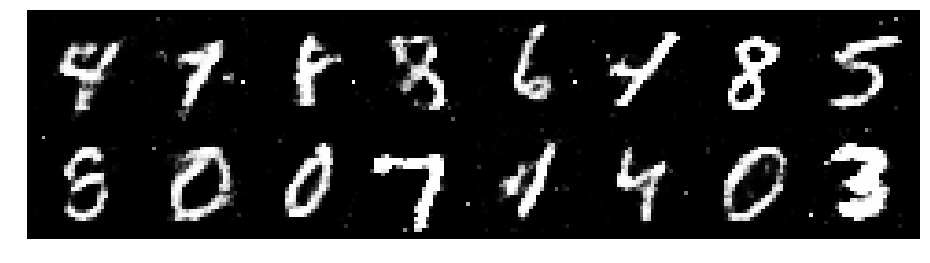

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.3418, Generator Loss: 0.9033
D(x): 0.5559, D(G(z)): 0.4754


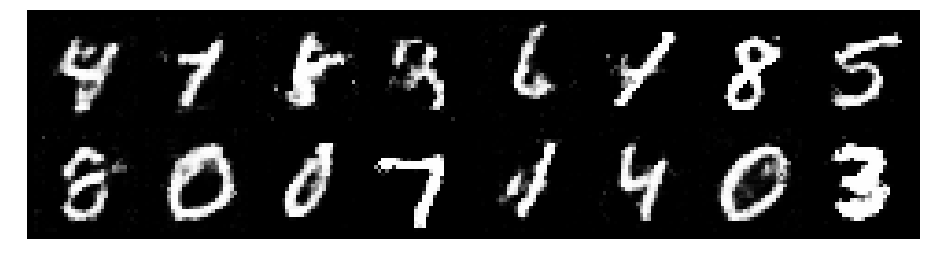

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3968, Generator Loss: 1.1072
D(x): 0.5483, D(G(z)): 0.4525


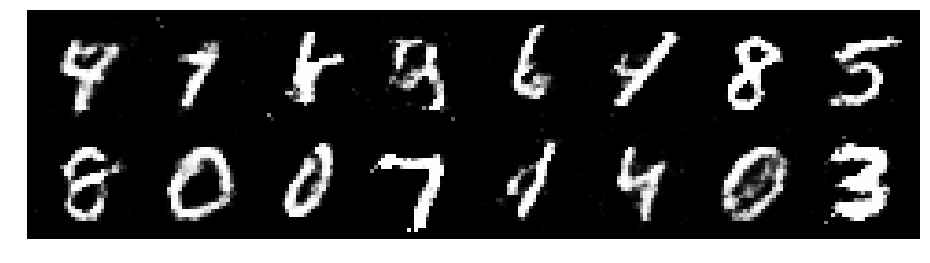

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2941, Generator Loss: 0.8574
D(x): 0.5771, D(G(z)): 0.4677


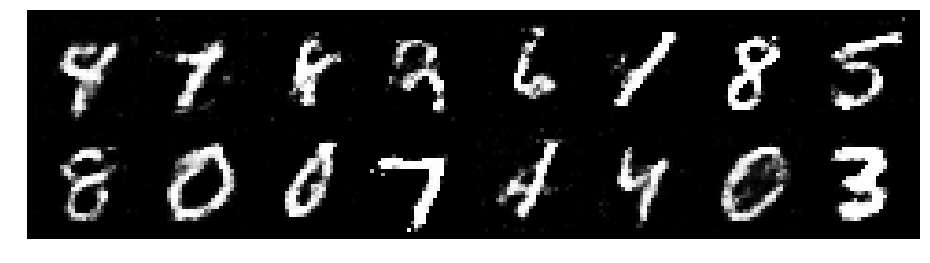

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2461, Generator Loss: 0.9693
D(x): 0.5920, D(G(z)): 0.4561


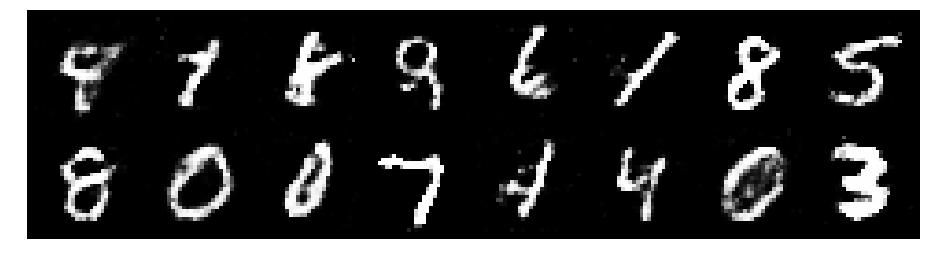

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2637, Generator Loss: 0.9769
D(x): 0.5285, D(G(z)): 0.4257


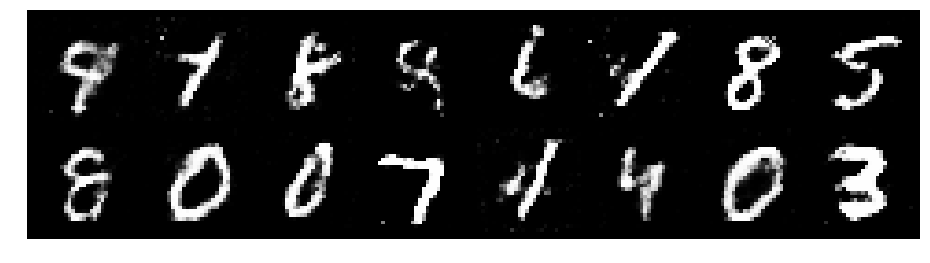

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2163, Generator Loss: 0.8673
D(x): 0.5767, D(G(z)): 0.4572


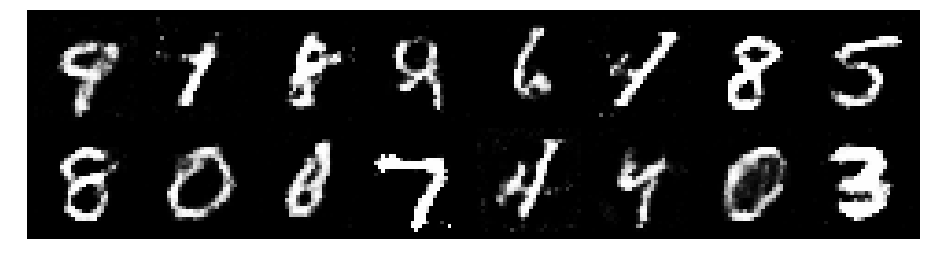

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.1949, Generator Loss: 0.9628
D(x): 0.5384, D(G(z)): 0.3876


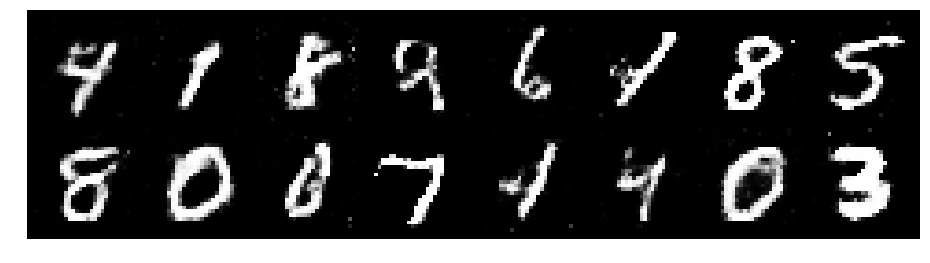

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2266, Generator Loss: 0.9289
D(x): 0.5848, D(G(z)): 0.4325


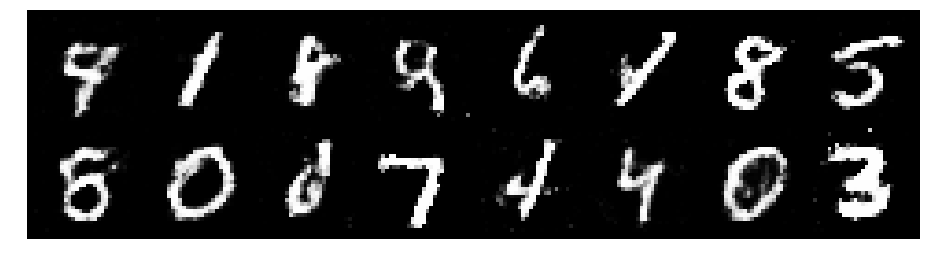

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2645, Generator Loss: 0.9916
D(x): 0.5485, D(G(z)): 0.4101


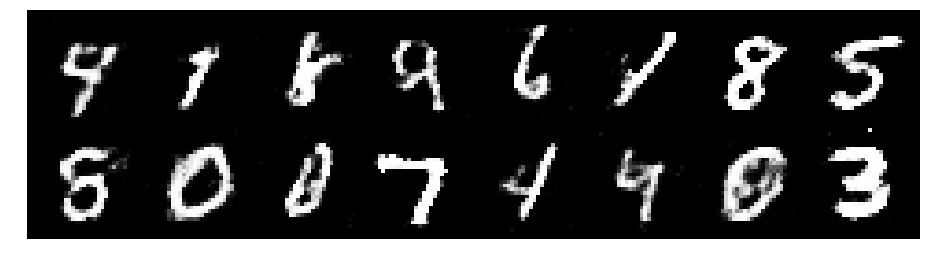

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2414, Generator Loss: 1.0876
D(x): 0.5645, D(G(z)): 0.3972


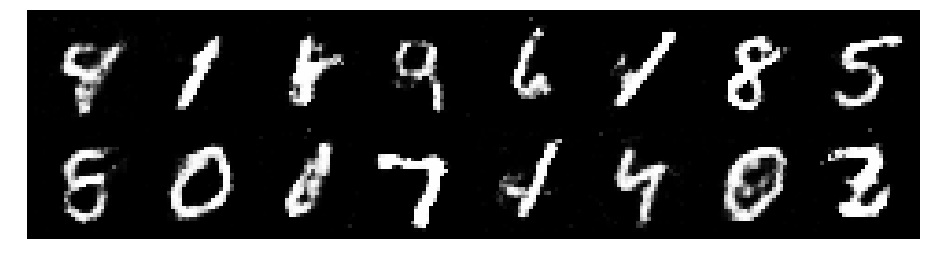

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.1713, Generator Loss: 0.9260
D(x): 0.5684, D(G(z)): 0.3877


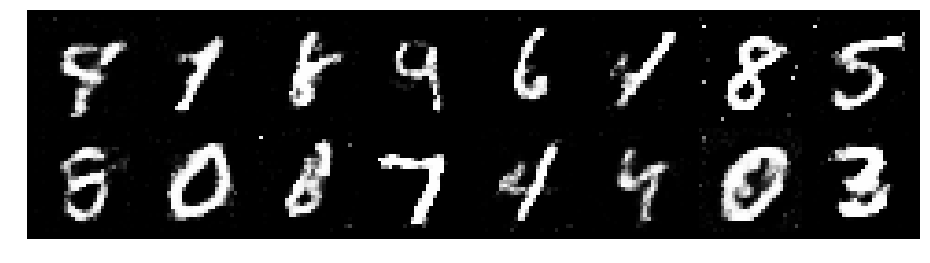

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2710, Generator Loss: 0.8860
D(x): 0.5551, D(G(z)): 0.4366


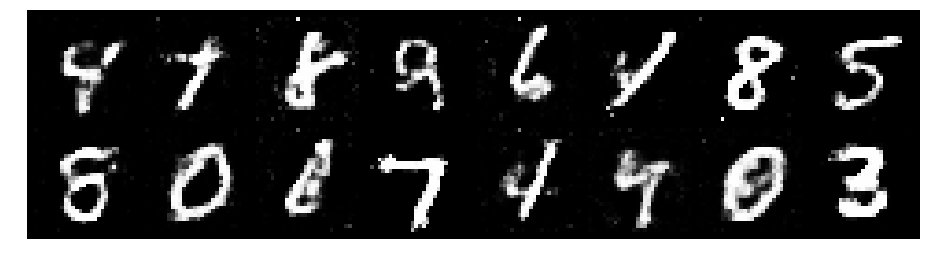

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.3003, Generator Loss: 0.8818
D(x): 0.5366, D(G(z)): 0.4546


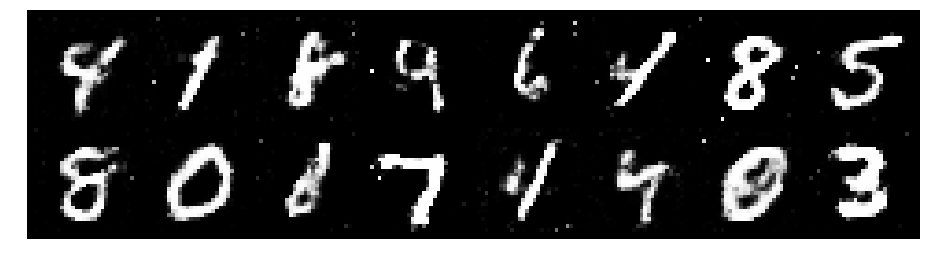

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.3219, Generator Loss: 0.9279
D(x): 0.5872, D(G(z)): 0.4890


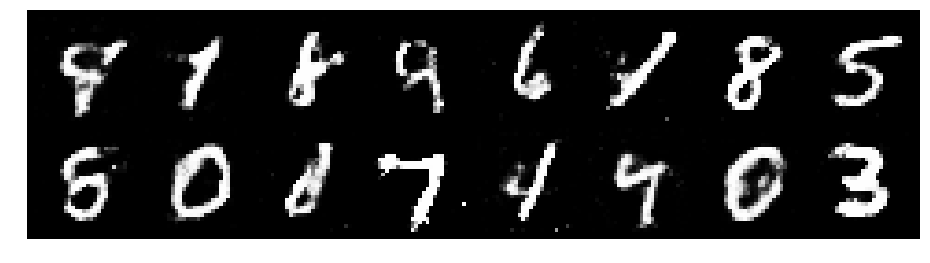

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3964, Generator Loss: 0.7439
D(x): 0.6280, D(G(z)): 0.5175


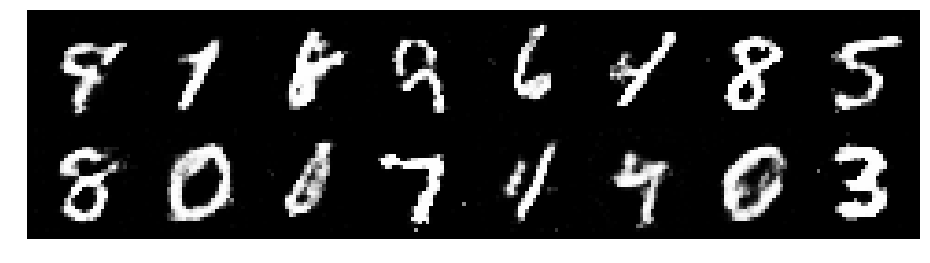

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3029, Generator Loss: 0.7080
D(x): 0.5712, D(G(z)): 0.4820


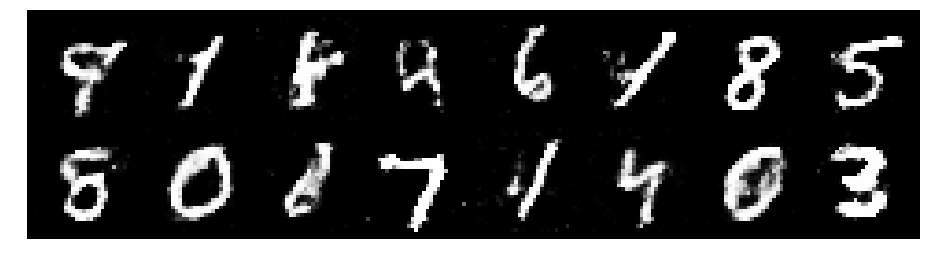

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2779, Generator Loss: 0.7967
D(x): 0.5648, D(G(z)): 0.4377


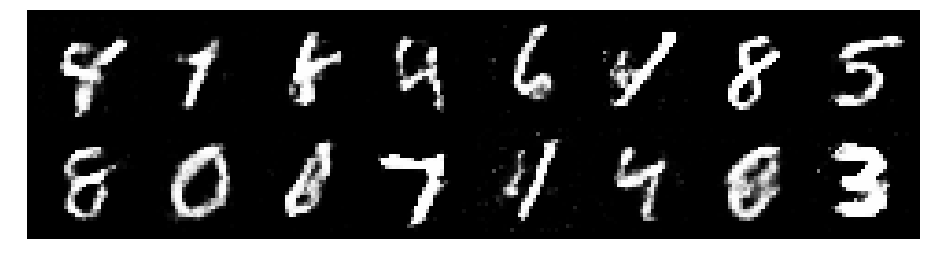

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.3205, Generator Loss: 0.8858
D(x): 0.5473, D(G(z)): 0.4462


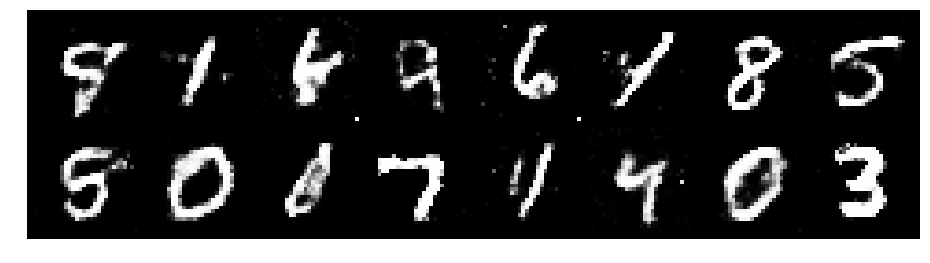

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3287, Generator Loss: 1.0006
D(x): 0.5000, D(G(z)): 0.4016


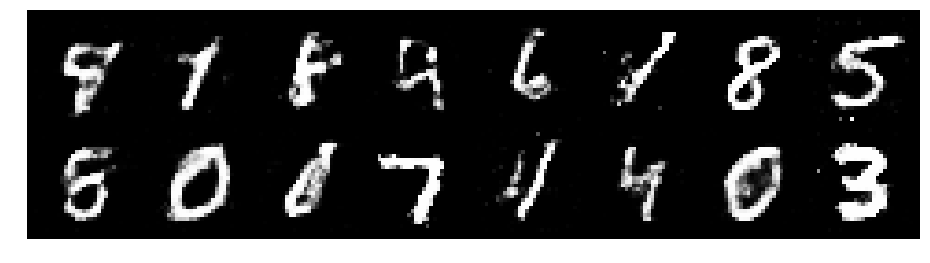

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3491, Generator Loss: 0.9077
D(x): 0.5359, D(G(z)): 0.4489


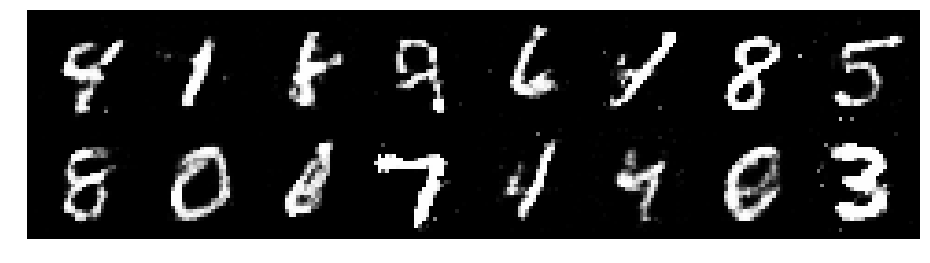

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.3690, Generator Loss: 0.9570
D(x): 0.5286, D(G(z)): 0.4591


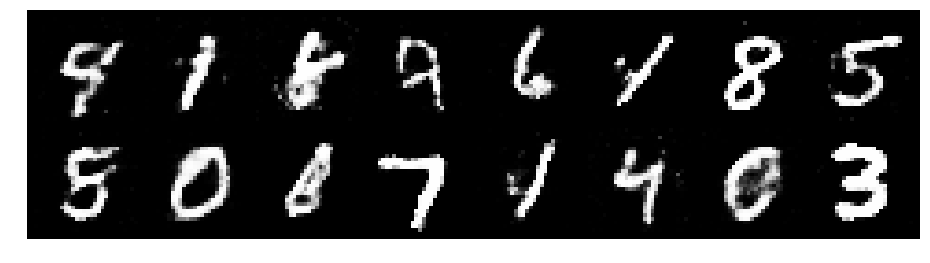

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2490, Generator Loss: 0.8949
D(x): 0.5660, D(G(z)): 0.4482


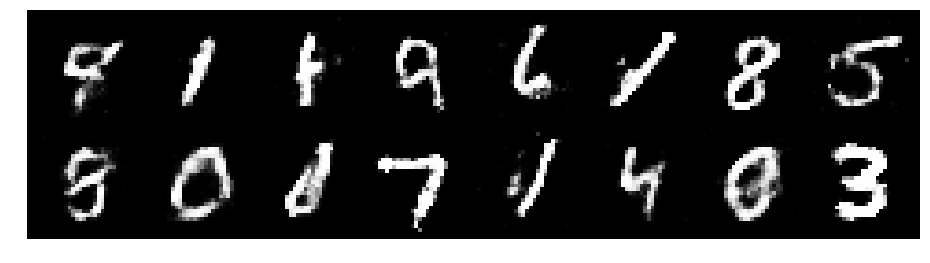

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2646, Generator Loss: 0.8615
D(x): 0.5374, D(G(z)): 0.4267


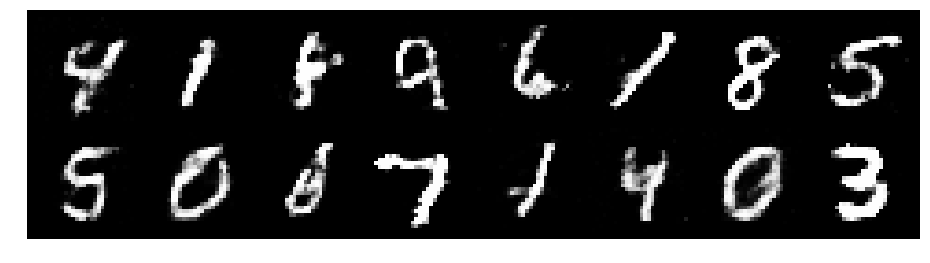

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3025, Generator Loss: 0.8022
D(x): 0.5654, D(G(z)): 0.4850


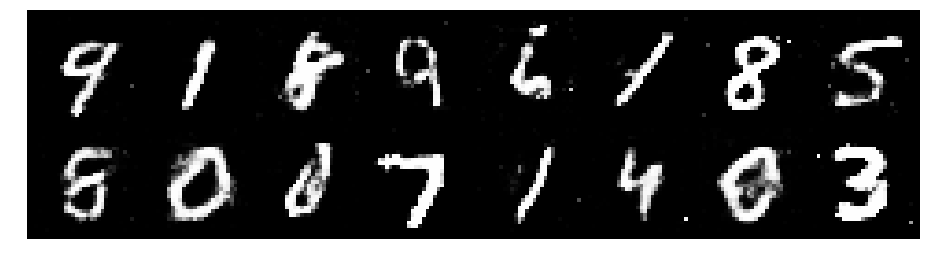

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.3085, Generator Loss: 0.8360
D(x): 0.5451, D(G(z)): 0.4570


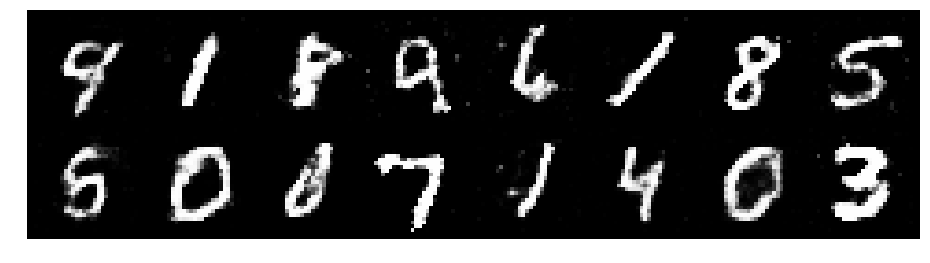

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.1155, Generator Loss: 0.8962
D(x): 0.6059, D(G(z)): 0.4095


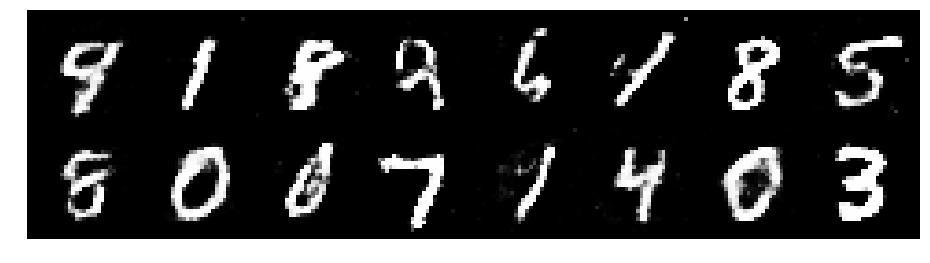

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.1357, Generator Loss: 0.8484
D(x): 0.6234, D(G(z)): 0.4334


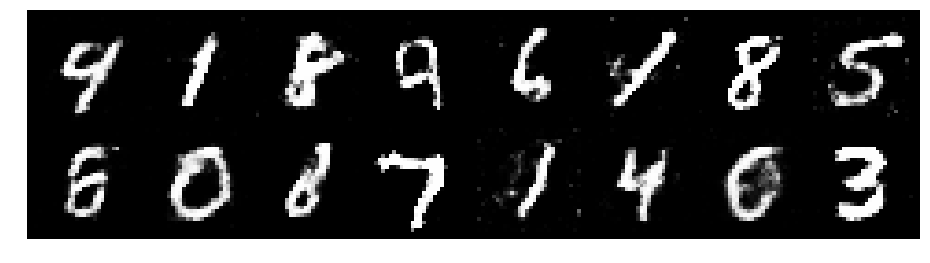

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.1397, Generator Loss: 1.1303
D(x): 0.5942, D(G(z)): 0.4040


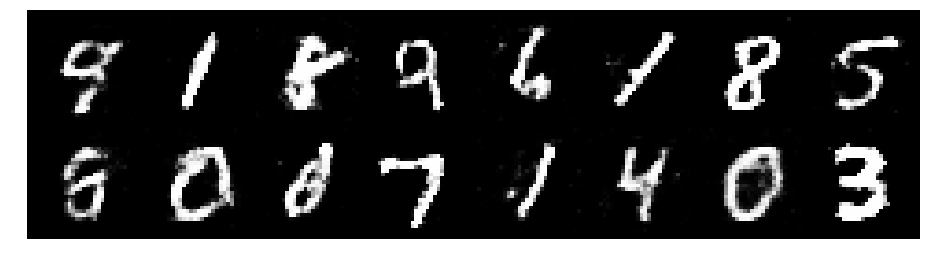

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2521, Generator Loss: 0.8376
D(x): 0.5527, D(G(z)): 0.4449


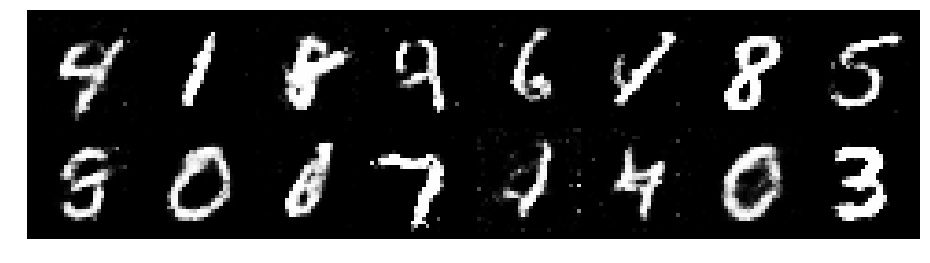

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2193, Generator Loss: 0.9748
D(x): 0.5561, D(G(z)): 0.4260


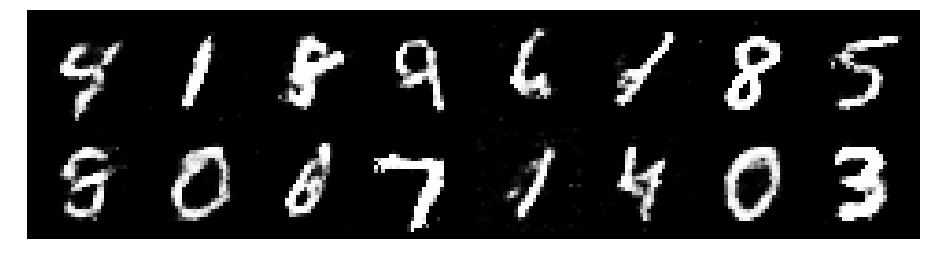

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.3957, Generator Loss: 0.8488
D(x): 0.5252, D(G(z)): 0.4744


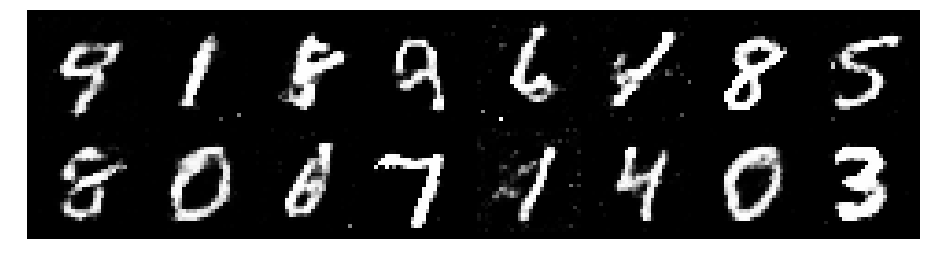

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8258
D(x): 0.5397, D(G(z)): 0.4173


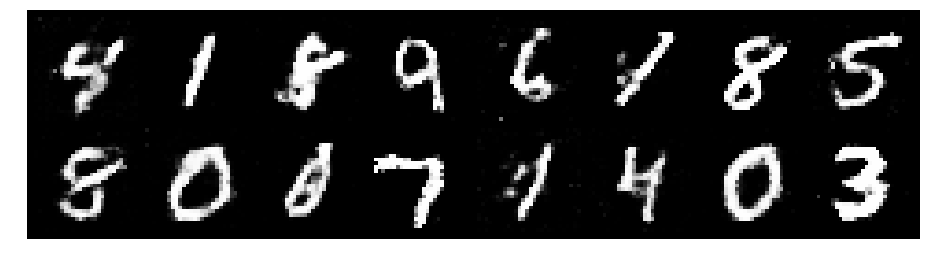

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2829, Generator Loss: 0.7777
D(x): 0.5894, D(G(z)): 0.4763


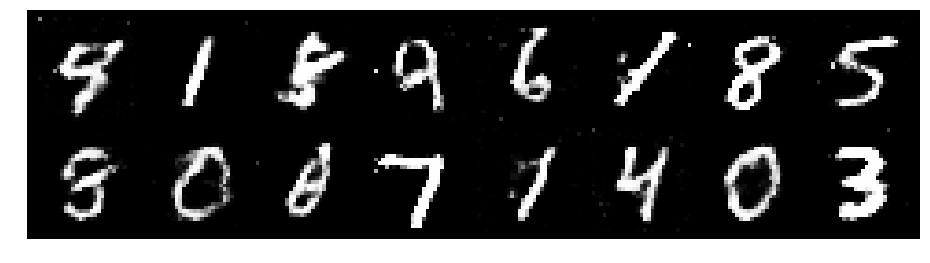

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2725, Generator Loss: 1.0440
D(x): 0.5625, D(G(z)): 0.4383


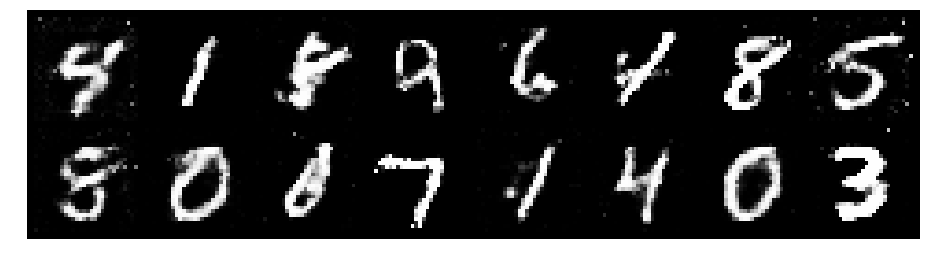

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2301, Generator Loss: 1.0049
D(x): 0.5800, D(G(z)): 0.4190


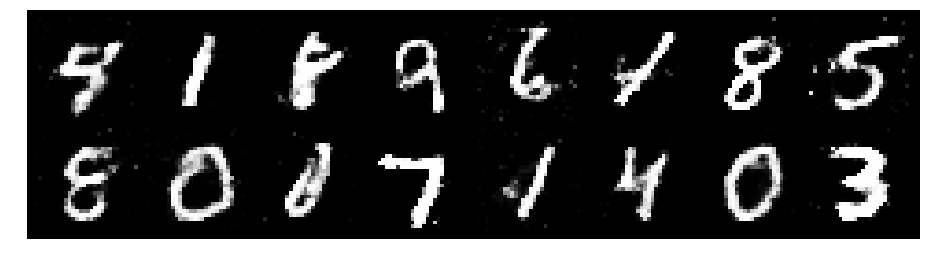

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.3033, Generator Loss: 0.9124
D(x): 0.5267, D(G(z)): 0.4363


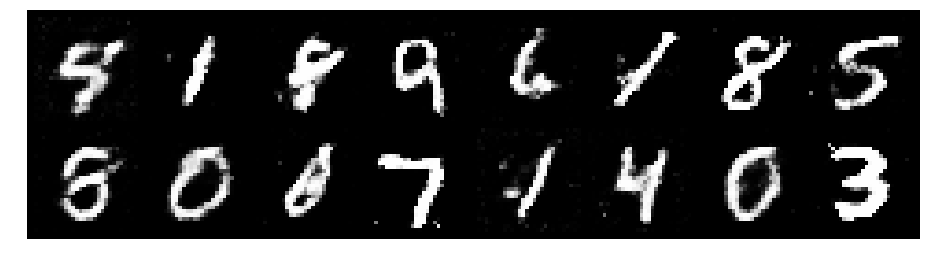

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8966
D(x): 0.5144, D(G(z)): 0.4195


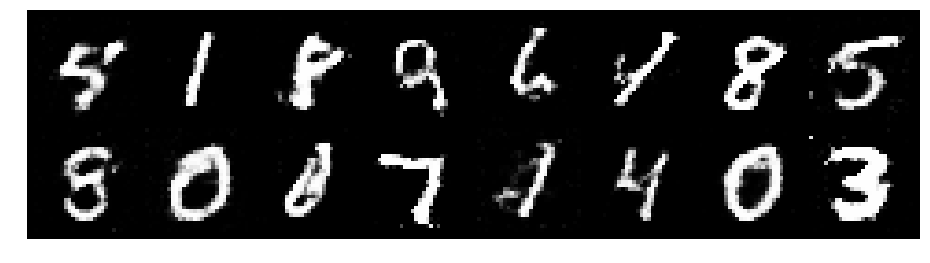

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.1631, Generator Loss: 0.9982
D(x): 0.5700, D(G(z)): 0.4031


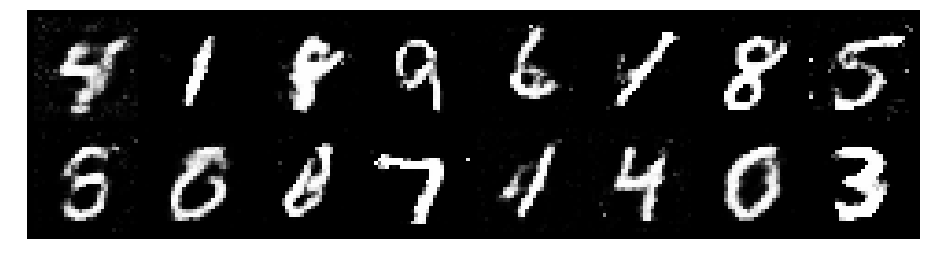

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.0850, Generator Loss: 1.1512
D(x): 0.5810, D(G(z)): 0.3504


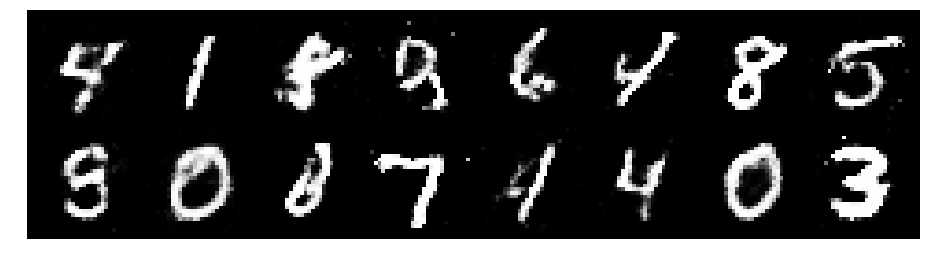

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9672
D(x): 0.5844, D(G(z)): 0.4357


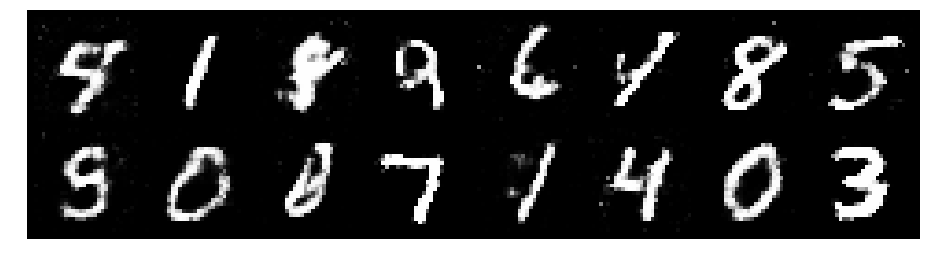

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2419, Generator Loss: 0.8418
D(x): 0.5481, D(G(z)): 0.4414


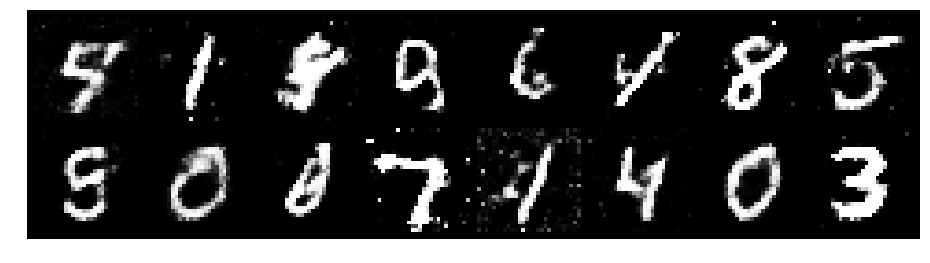

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3034, Generator Loss: 0.8195
D(x): 0.5696, D(G(z)): 0.4877


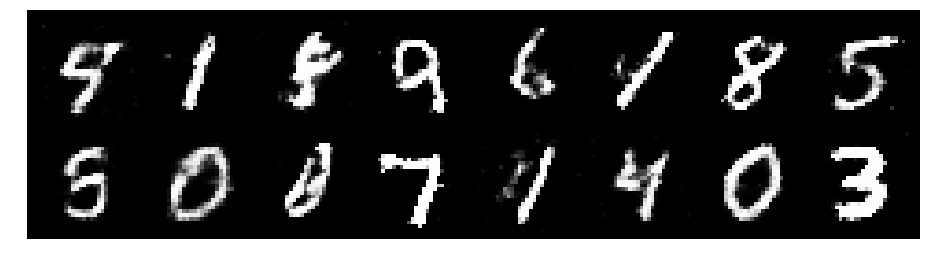

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3056, Generator Loss: 0.8985
D(x): 0.5455, D(G(z)): 0.4666


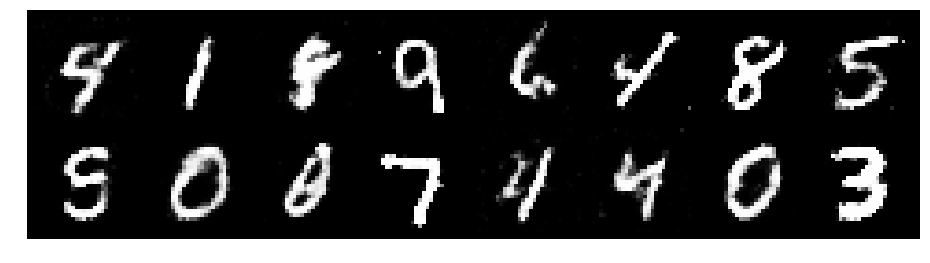

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2705, Generator Loss: 0.7596
D(x): 0.5369, D(G(z)): 0.4236


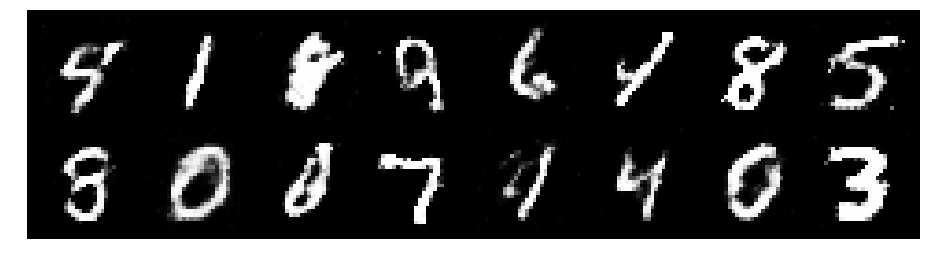

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2958, Generator Loss: 0.9035
D(x): 0.5377, D(G(z)): 0.4485


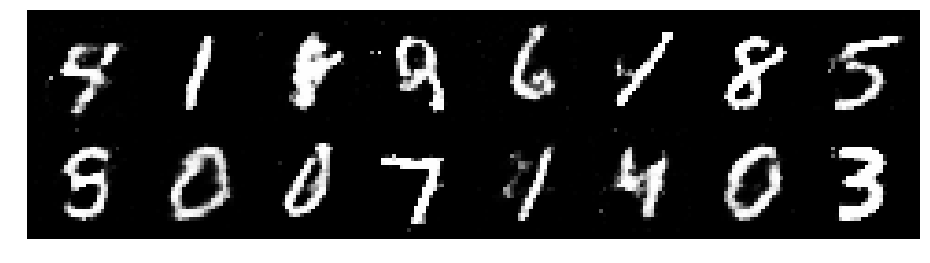

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2379, Generator Loss: 1.0415
D(x): 0.5544, D(G(z)): 0.4141


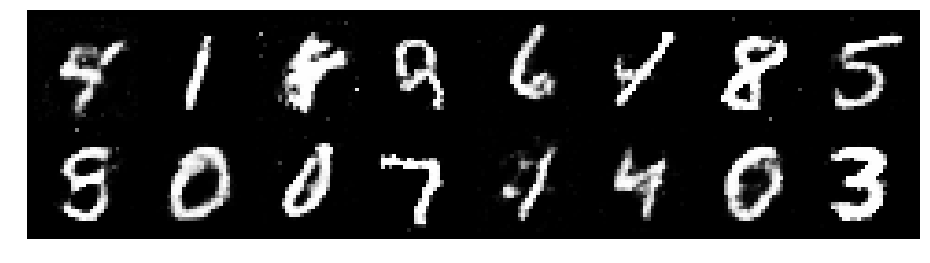

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2880, Generator Loss: 0.8872
D(x): 0.5590, D(G(z)): 0.4474


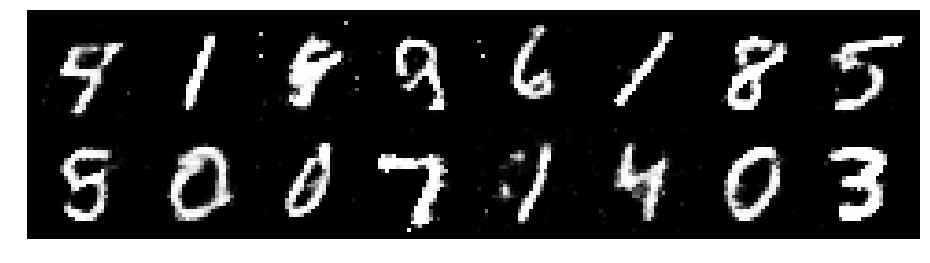

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.1245, Generator Loss: 1.0868
D(x): 0.5911, D(G(z)): 0.3986


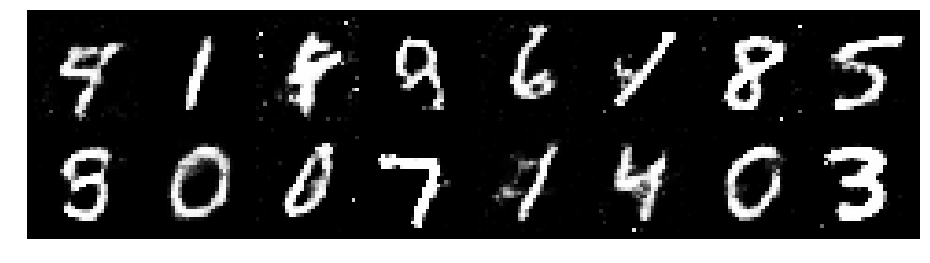

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2472, Generator Loss: 0.8597
D(x): 0.5581, D(G(z)): 0.4241


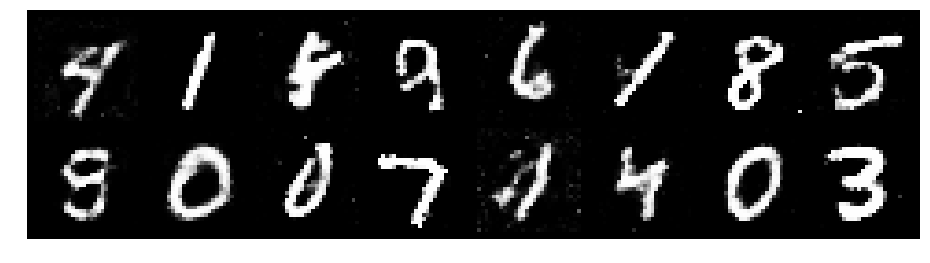

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2277, Generator Loss: 0.9680
D(x): 0.5487, D(G(z)): 0.4136


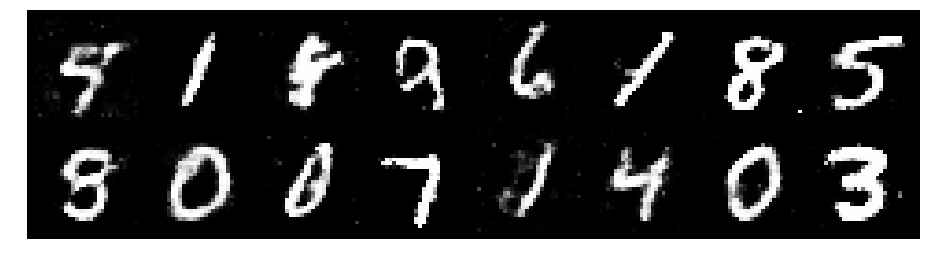

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2160, Generator Loss: 1.0173
D(x): 0.5734, D(G(z)): 0.4326


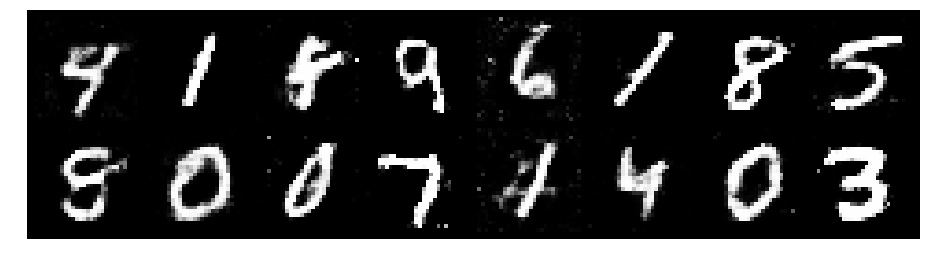

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.1982, Generator Loss: 1.0015
D(x): 0.6003, D(G(z)): 0.4256


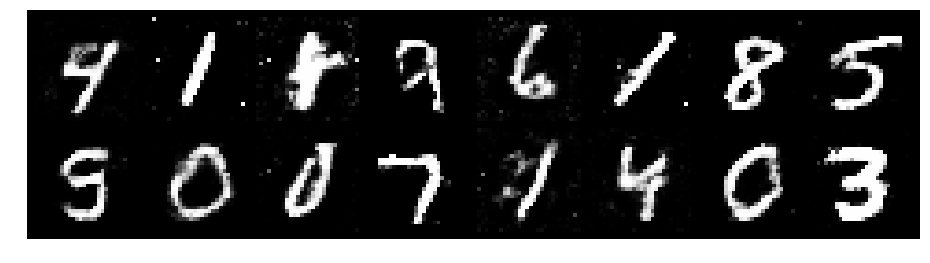

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.1795, Generator Loss: 0.9963
D(x): 0.5916, D(G(z)): 0.4198


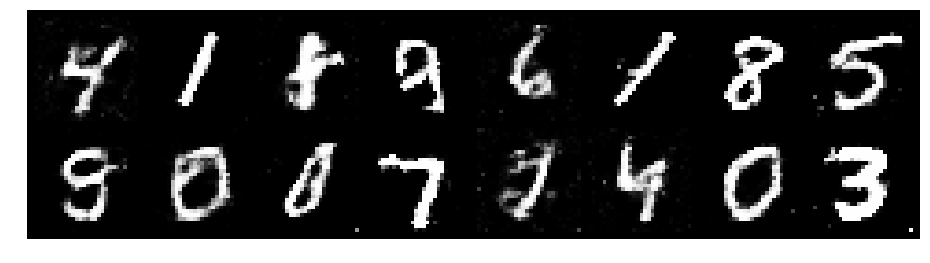

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2070, Generator Loss: 1.0667
D(x): 0.5805, D(G(z)): 0.4163


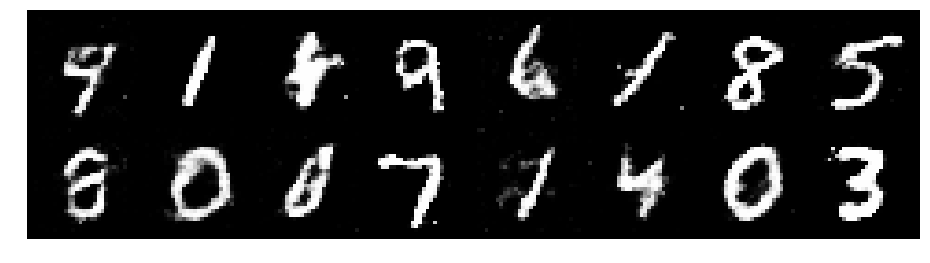

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2402, Generator Loss: 0.9588
D(x): 0.5523, D(G(z)): 0.4058


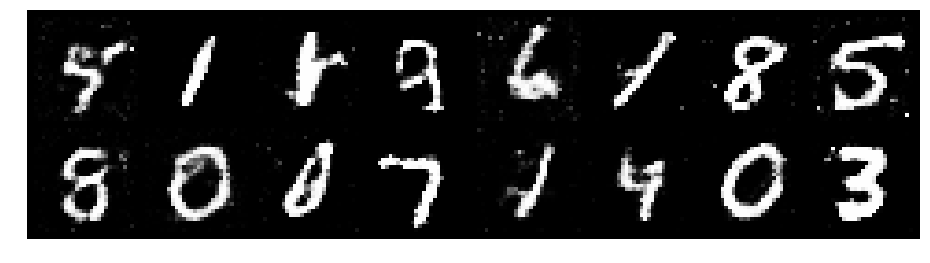

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.3760, Generator Loss: 0.9287
D(x): 0.5384, D(G(z)): 0.4603


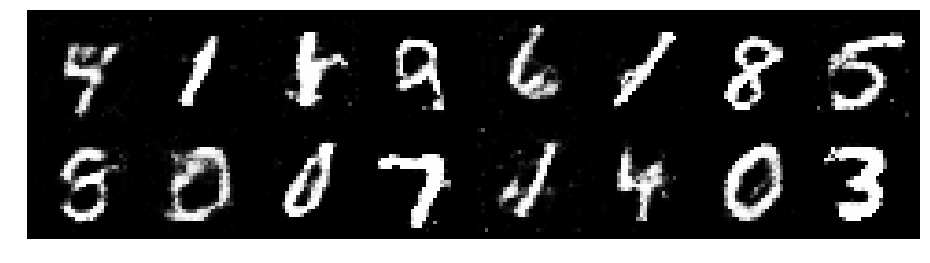

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3491, Generator Loss: 0.9130
D(x): 0.5114, D(G(z)): 0.4355


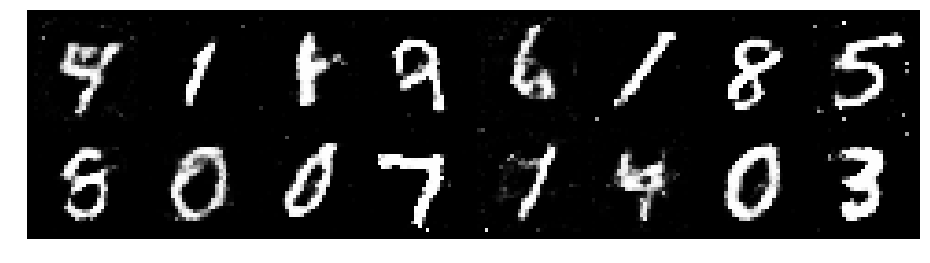

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3464, Generator Loss: 0.7351
D(x): 0.5477, D(G(z)): 0.4968


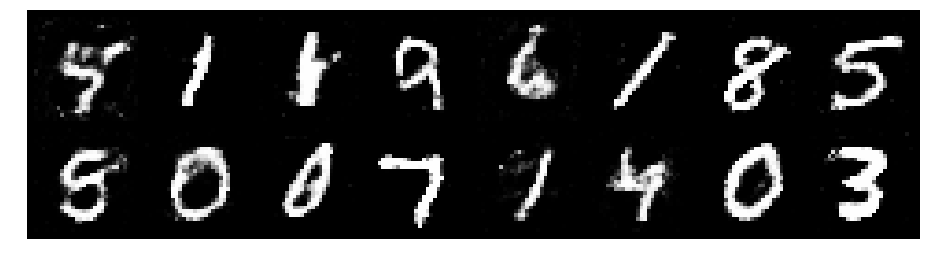

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2292, Generator Loss: 0.8583
D(x): 0.5772, D(G(z)): 0.4359


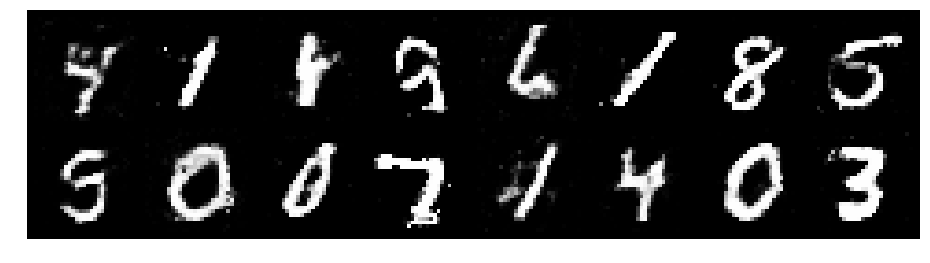

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2184, Generator Loss: 0.8688
D(x): 0.5735, D(G(z)): 0.4513


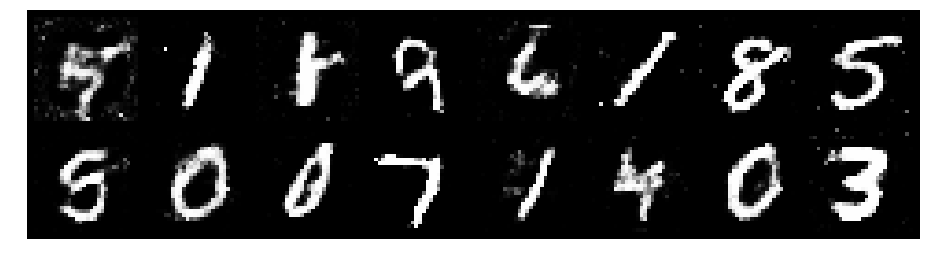

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.1851, Generator Loss: 0.9614
D(x): 0.6073, D(G(z)): 0.4499


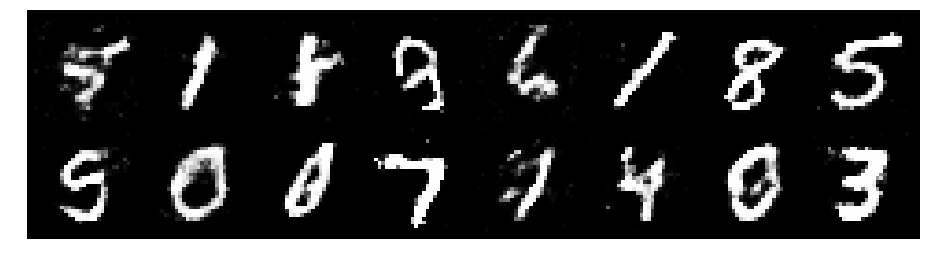

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.0994, Generator Loss: 1.2331
D(x): 0.5832, D(G(z)): 0.3635


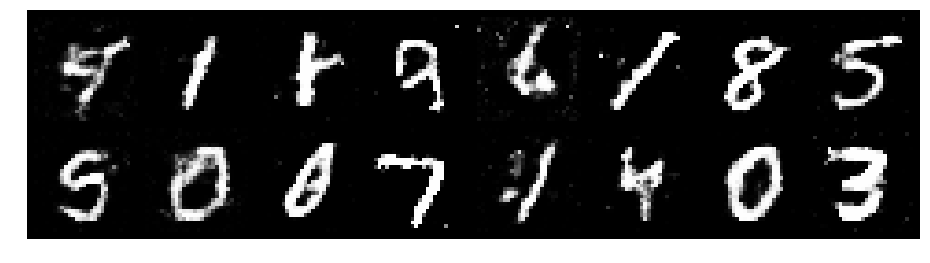

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3150, Generator Loss: 0.8346
D(x): 0.5261, D(G(z)): 0.4454


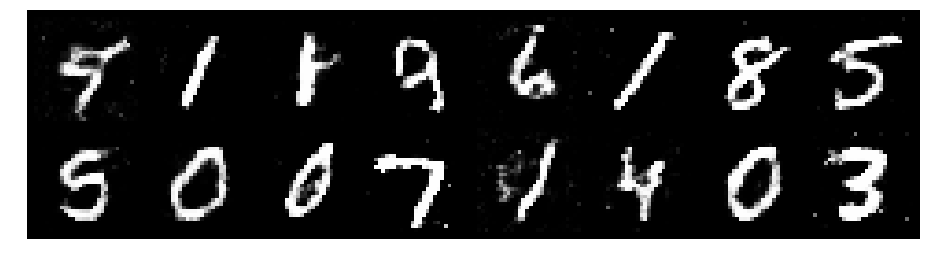

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2418, Generator Loss: 0.8405
D(x): 0.5283, D(G(z)): 0.4141


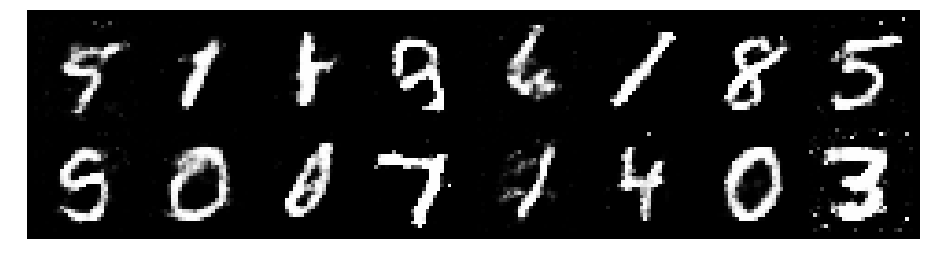

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.3502, Generator Loss: 0.9122
D(x): 0.5019, D(G(z)): 0.4219


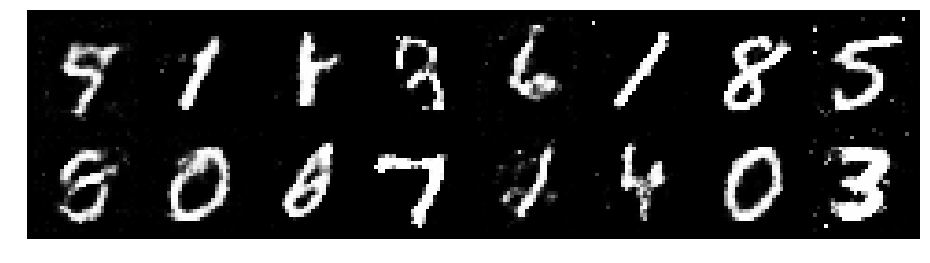

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2509, Generator Loss: 0.8504
D(x): 0.5543, D(G(z)): 0.4393


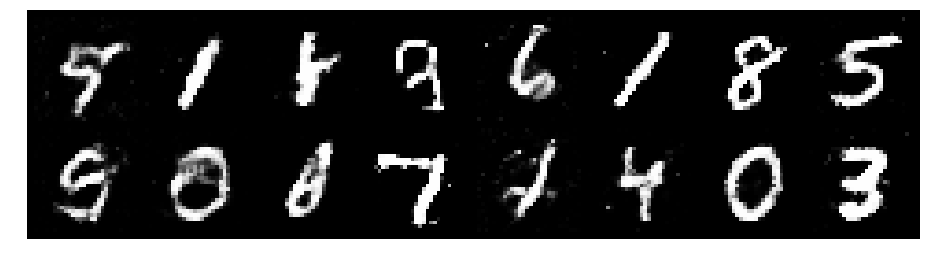

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3491, Generator Loss: 0.8199
D(x): 0.5553, D(G(z)): 0.4709


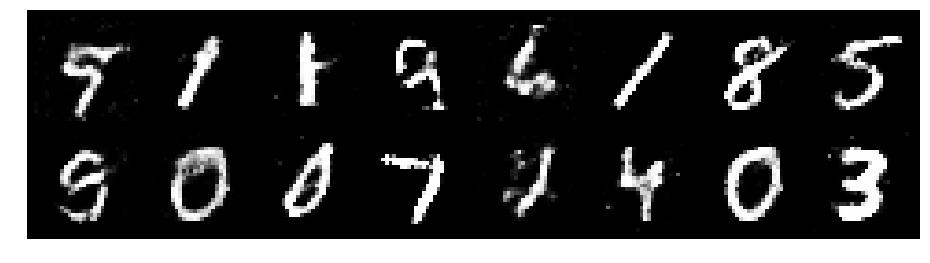

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.3794, Generator Loss: 0.8254
D(x): 0.4971, D(G(z)): 0.4515


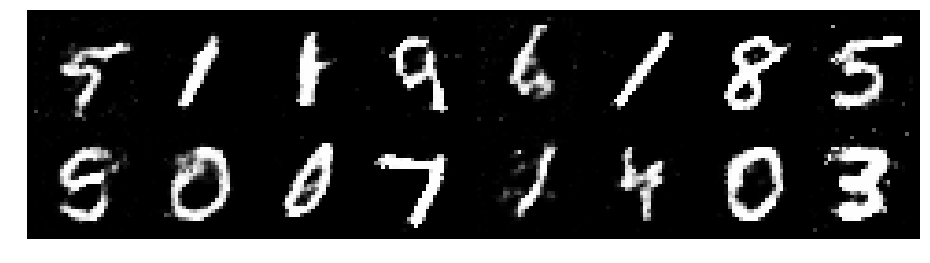

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2111, Generator Loss: 0.8151
D(x): 0.6006, D(G(z)): 0.4607


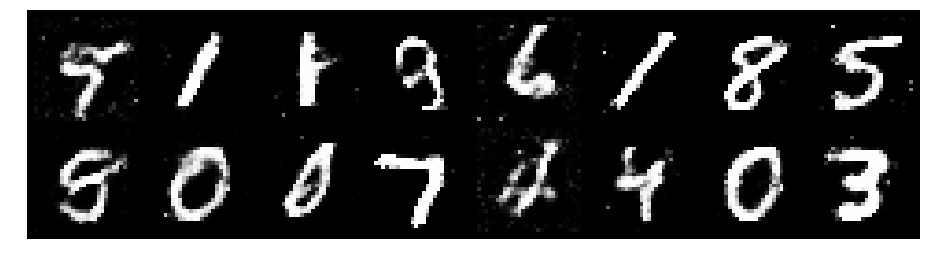

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.3111, Generator Loss: 0.9372
D(x): 0.5315, D(G(z)): 0.4299


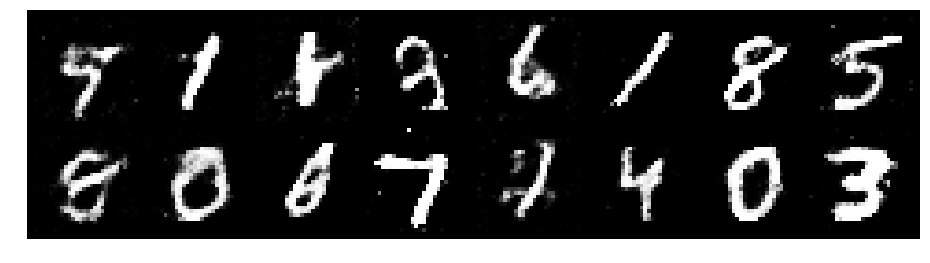

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2107, Generator Loss: 0.8525
D(x): 0.5673, D(G(z)): 0.4214


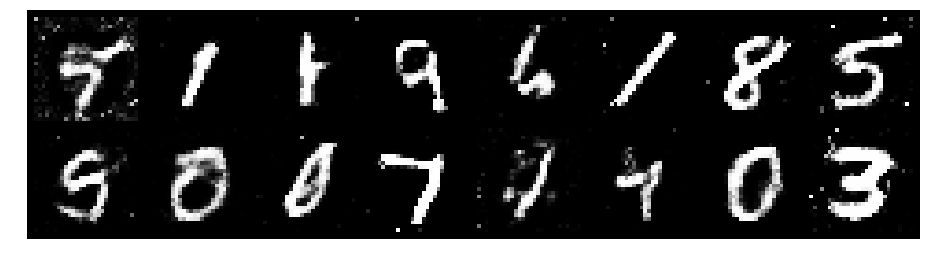

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2218, Generator Loss: 0.8474
D(x): 0.5600, D(G(z)): 0.4441


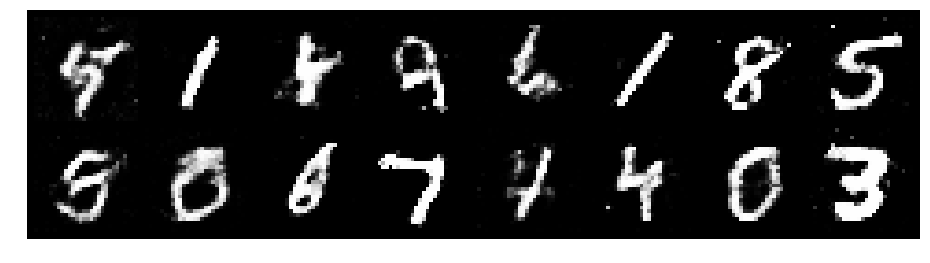

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.3378, Generator Loss: 0.7675
D(x): 0.5668, D(G(z)): 0.4980


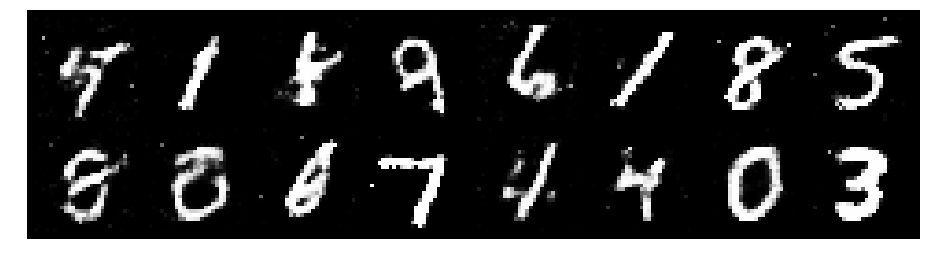

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3849, Generator Loss: 0.8973
D(x): 0.5391, D(G(z)): 0.4486


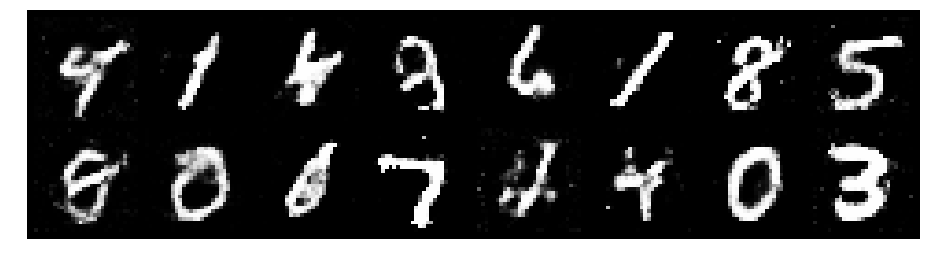

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2655, Generator Loss: 0.9502
D(x): 0.5887, D(G(z)): 0.4572


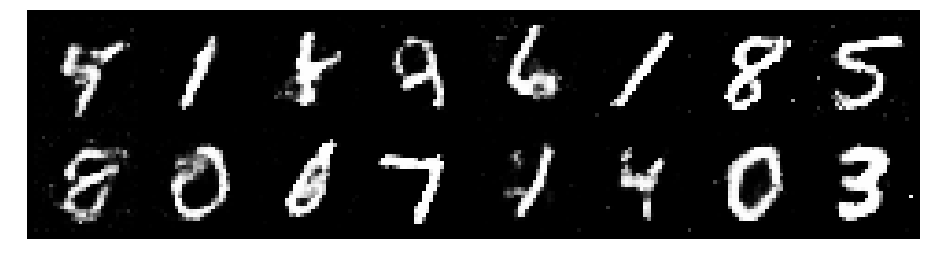

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8655
D(x): 0.5644, D(G(z)): 0.4167


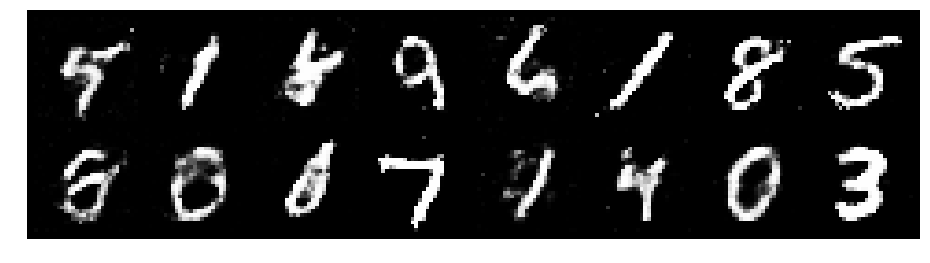

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.1522, Generator Loss: 0.9474
D(x): 0.5784, D(G(z)): 0.4144


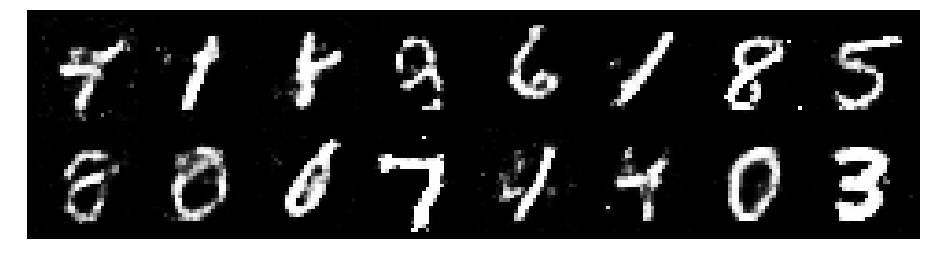

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.1921, Generator Loss: 0.9588
D(x): 0.6283, D(G(z)): 0.4656


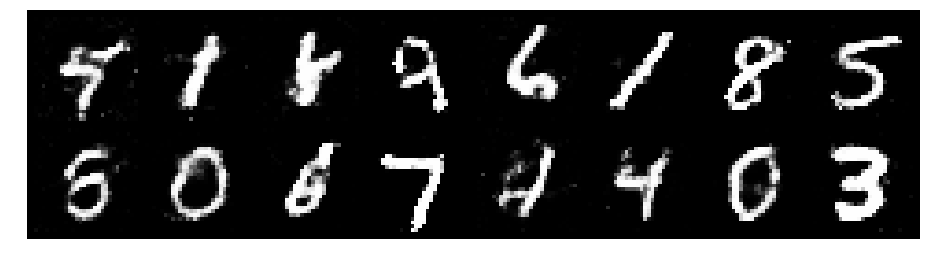

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.4030, Generator Loss: 0.7938
D(x): 0.5827, D(G(z)): 0.4946


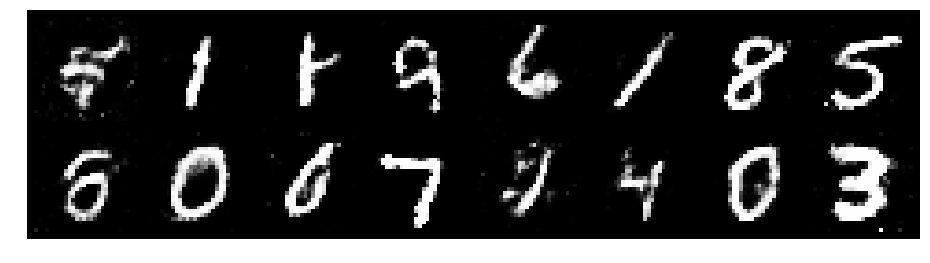

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.3268, Generator Loss: 0.8547
D(x): 0.5527, D(G(z)): 0.4564


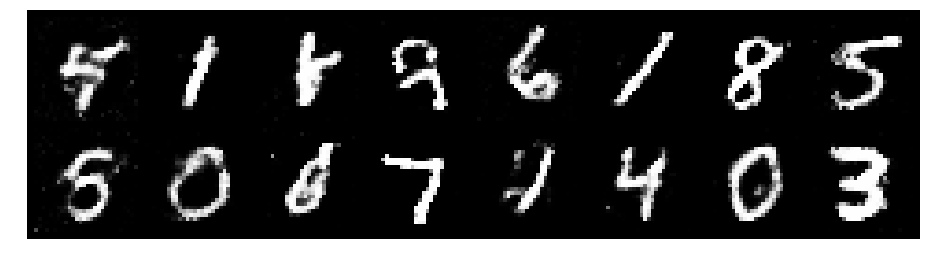

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3278, Generator Loss: 0.7896
D(x): 0.5225, D(G(z)): 0.4405


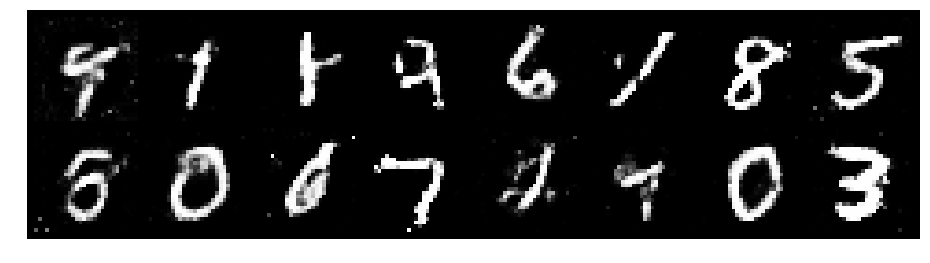

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2475, Generator Loss: 0.9231
D(x): 0.5644, D(G(z)): 0.4436


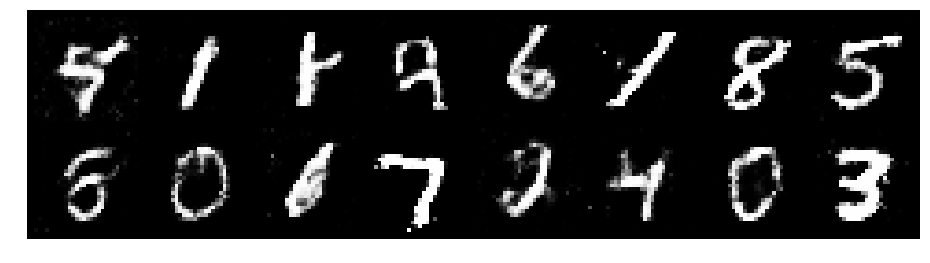

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2981, Generator Loss: 0.8776
D(x): 0.5108, D(G(z)): 0.4215


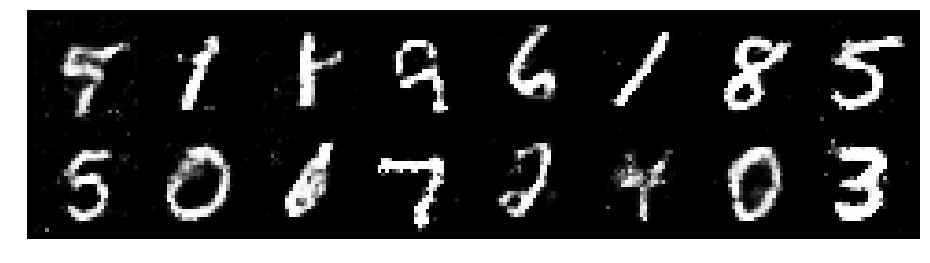

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.1636, Generator Loss: 0.8305
D(x): 0.5745, D(G(z)): 0.4256


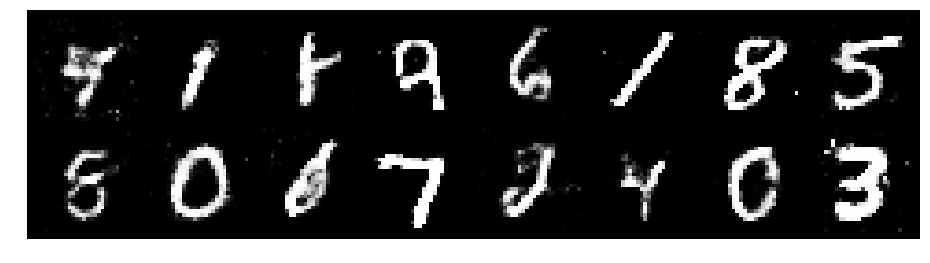

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2707, Generator Loss: 0.9056
D(x): 0.5715, D(G(z)): 0.4614


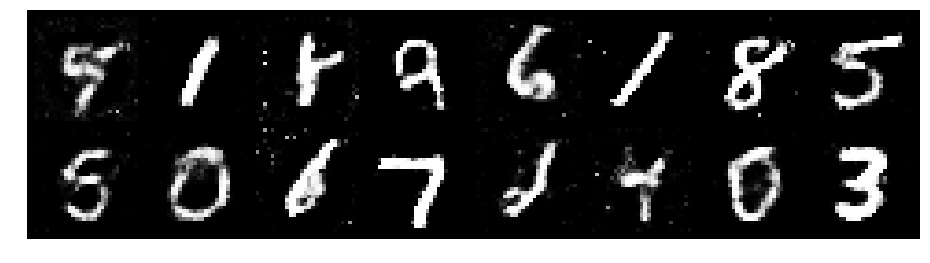

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3315, Generator Loss: 0.8634
D(x): 0.5436, D(G(z)): 0.4439


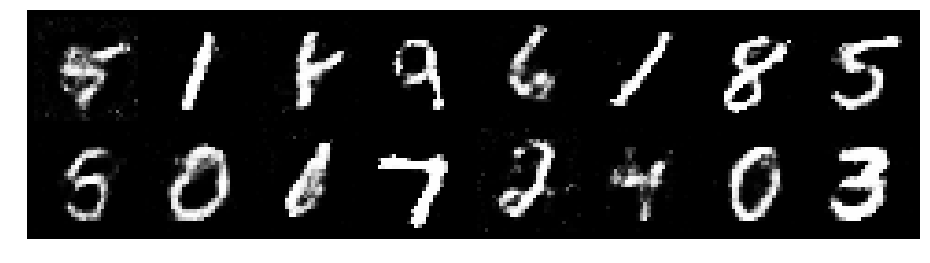

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3120, Generator Loss: 0.8383
D(x): 0.5494, D(G(z)): 0.4627


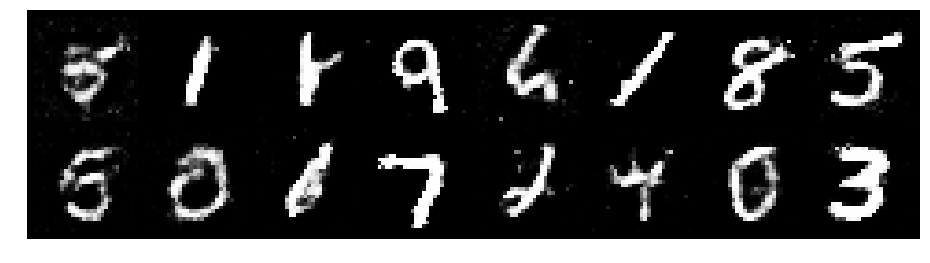

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2272, Generator Loss: 0.9287
D(x): 0.5870, D(G(z)): 0.4425


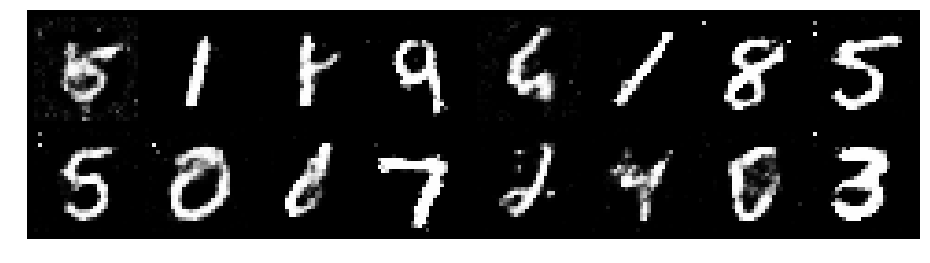

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.3194, Generator Loss: 0.8523
D(x): 0.5605, D(G(z)): 0.4836


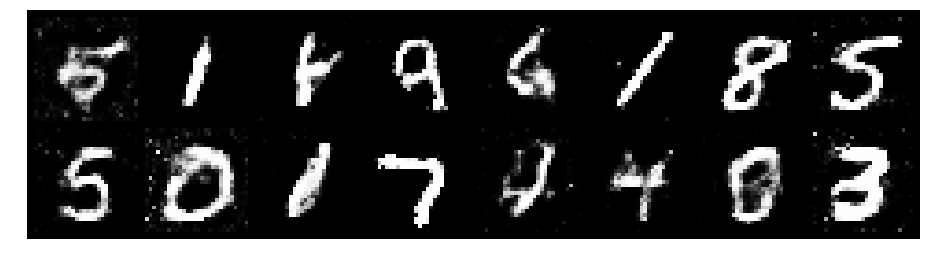

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2535, Generator Loss: 0.8430
D(x): 0.5440, D(G(z)): 0.4374


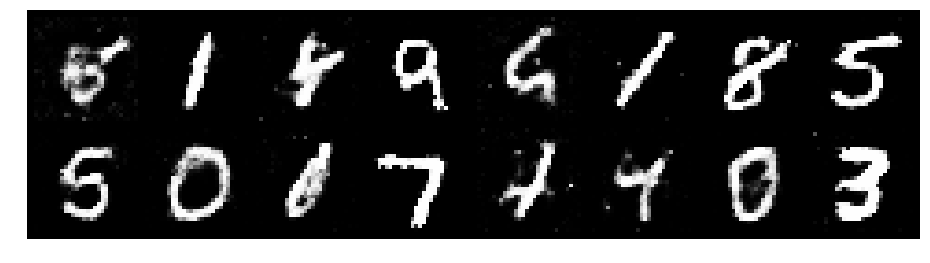

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2210, Generator Loss: 0.8612
D(x): 0.5730, D(G(z)): 0.4489


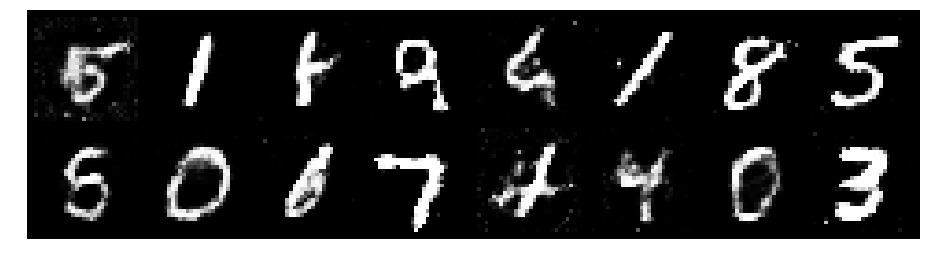

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2118, Generator Loss: 0.9245
D(x): 0.5698, D(G(z)): 0.4321


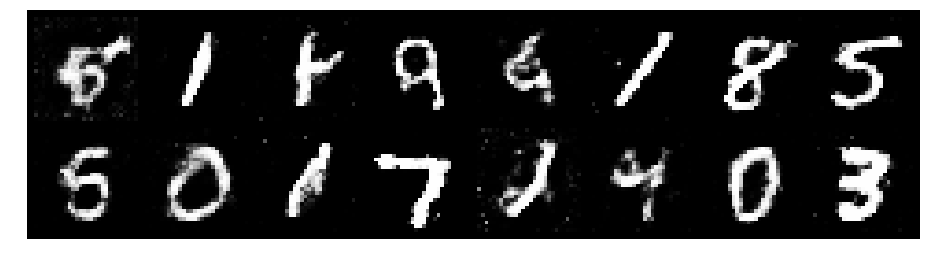

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3315, Generator Loss: 0.8626
D(x): 0.5263, D(G(z)): 0.4461


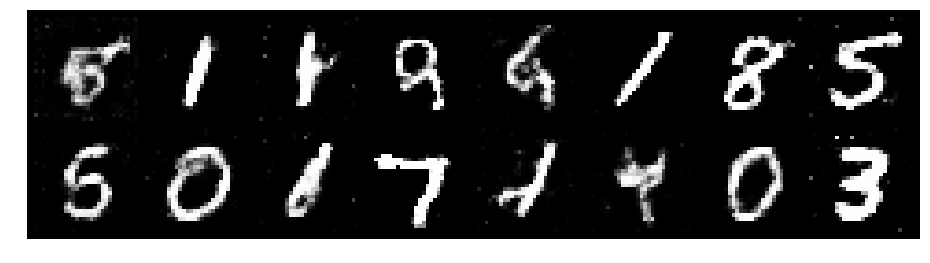

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.3253, Generator Loss: 0.7783
D(x): 0.5664, D(G(z)): 0.4817


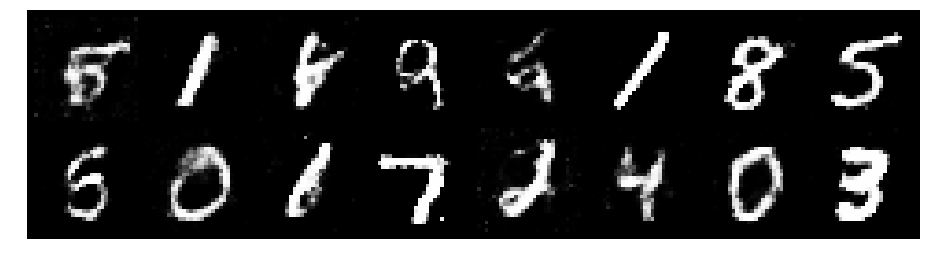

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.3694, Generator Loss: 0.8589
D(x): 0.5643, D(G(z)): 0.4947


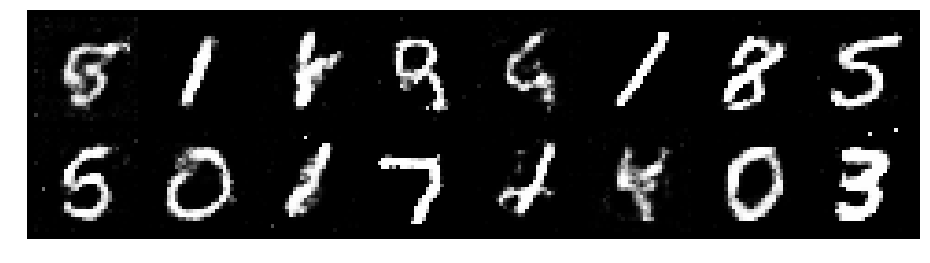

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2587, Generator Loss: 0.7488
D(x): 0.5659, D(G(z)): 0.4469


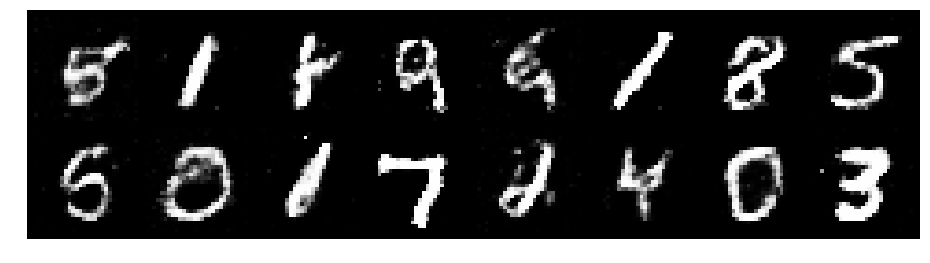

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.3170, Generator Loss: 0.7891
D(x): 0.5503, D(G(z)): 0.4671


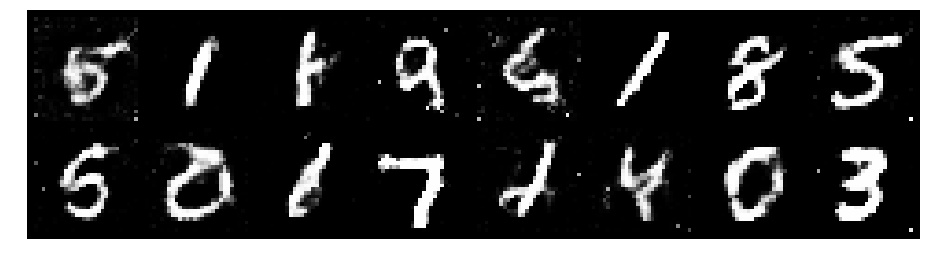

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2062, Generator Loss: 0.8815
D(x): 0.5499, D(G(z)): 0.4102


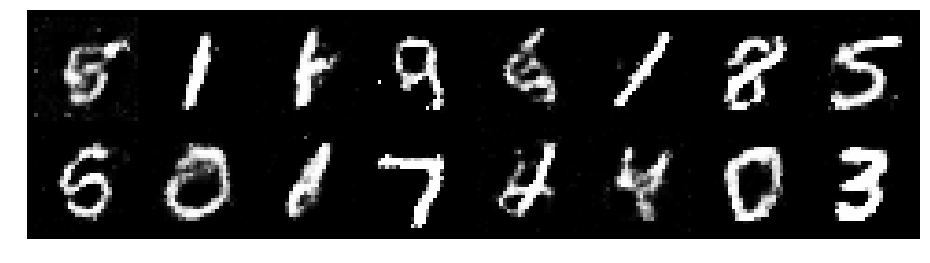

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2088, Generator Loss: 0.8211
D(x): 0.6021, D(G(z)): 0.4677


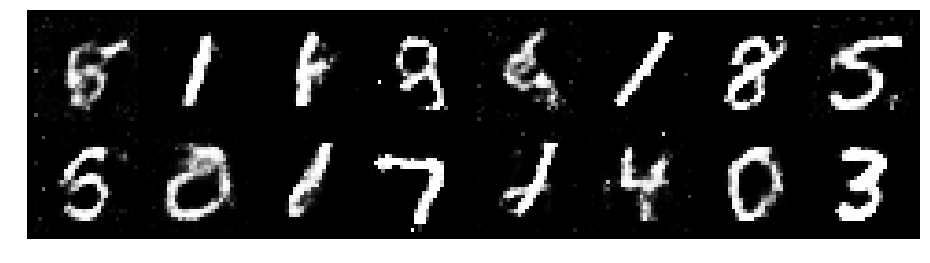

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3345, Generator Loss: 0.9115
D(x): 0.5359, D(G(z)): 0.4515


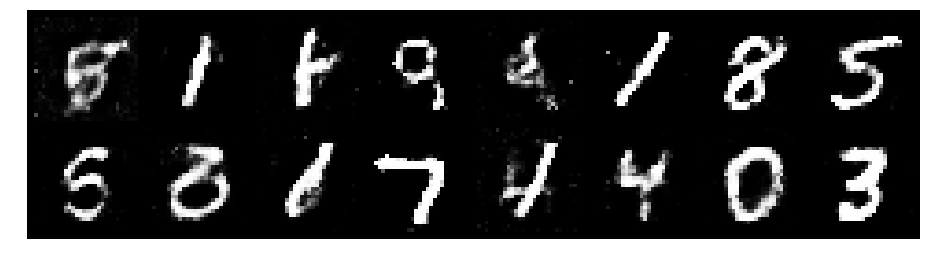

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2450, Generator Loss: 0.8477
D(x): 0.5638, D(G(z)): 0.4504


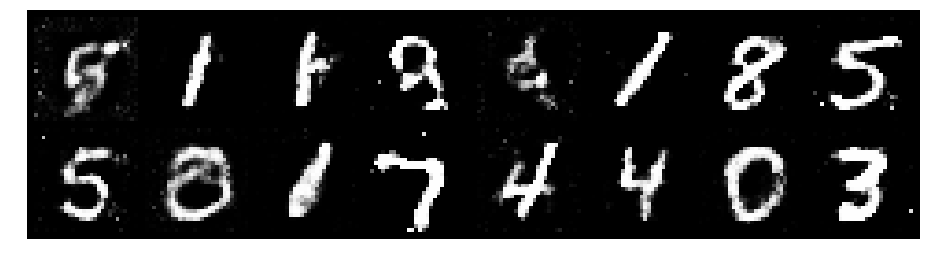

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.1770, Generator Loss: 0.9189
D(x): 0.5894, D(G(z)): 0.4307


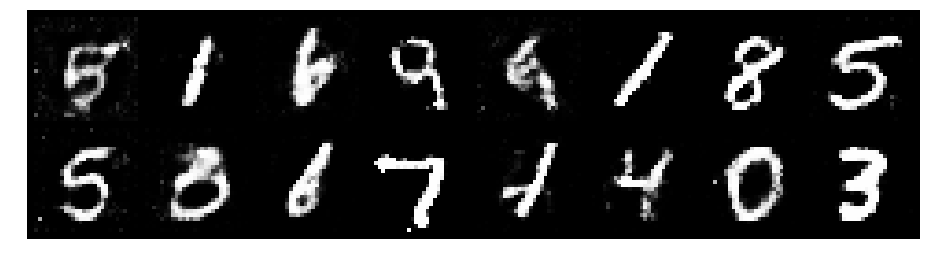

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.1732, Generator Loss: 1.0535
D(x): 0.5879, D(G(z)): 0.4149


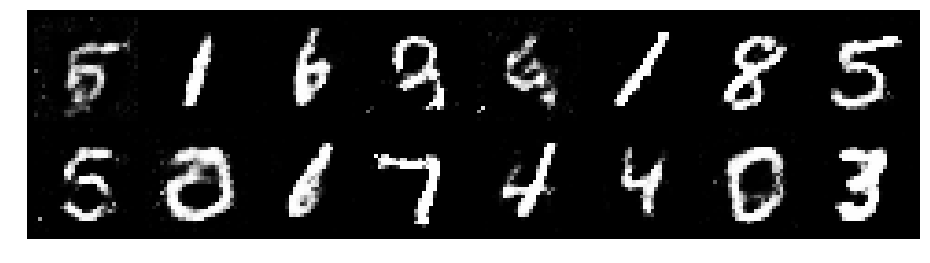

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.1849, Generator Loss: 1.1127
D(x): 0.5763, D(G(z)): 0.4149


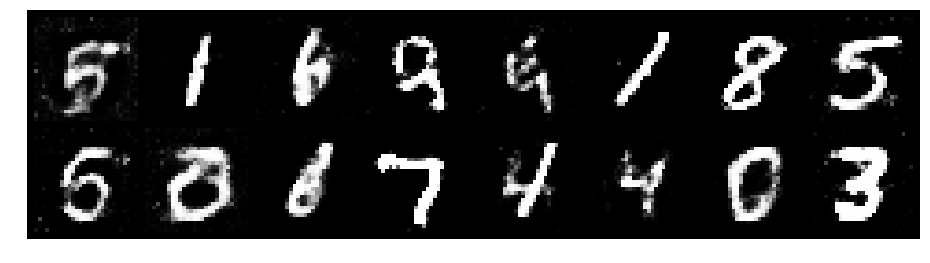

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.1833, Generator Loss: 0.9213
D(x): 0.6163, D(G(z)): 0.4279


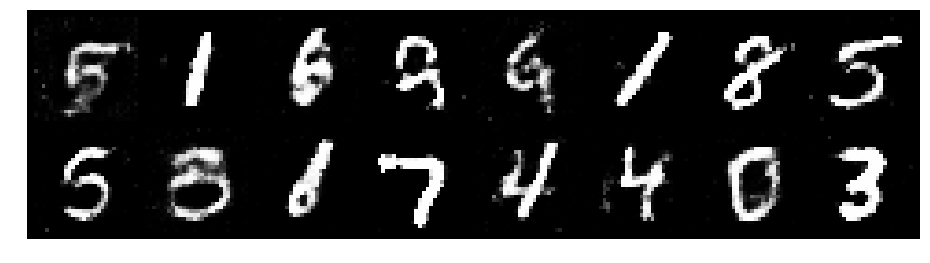

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8689
D(x): 0.5954, D(G(z)): 0.4456


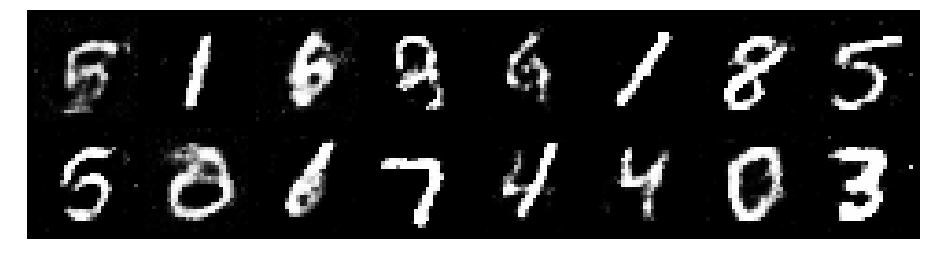

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8202
D(x): 0.5598, D(G(z)): 0.4748


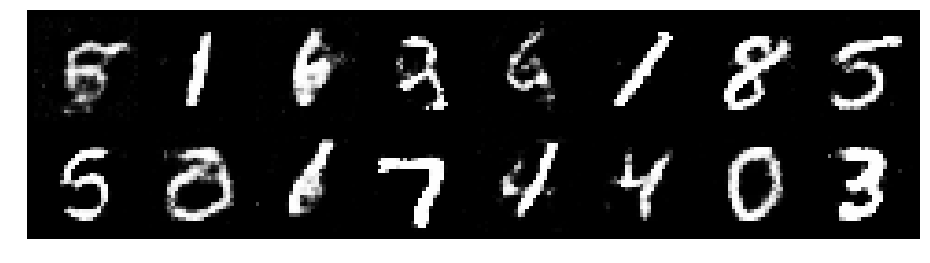

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3428, Generator Loss: 0.9186
D(x): 0.5348, D(G(z)): 0.4329


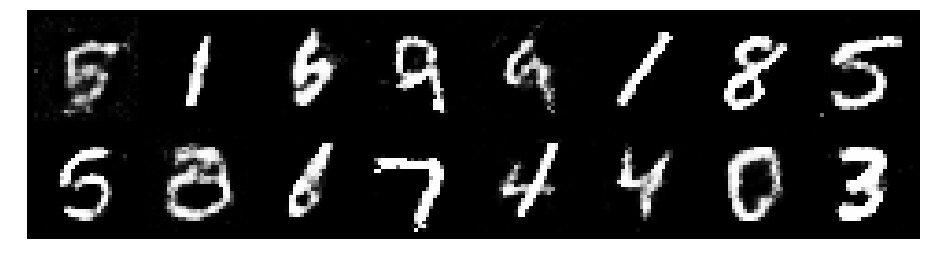

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.1558, Generator Loss: 0.9729
D(x): 0.5995, D(G(z)): 0.4228


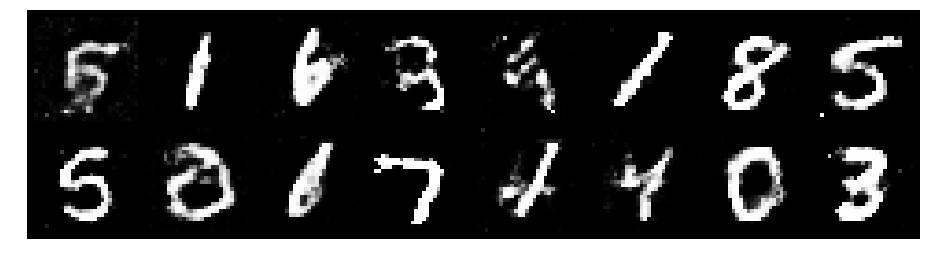

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.1534, Generator Loss: 0.9832
D(x): 0.5753, D(G(z)): 0.4042


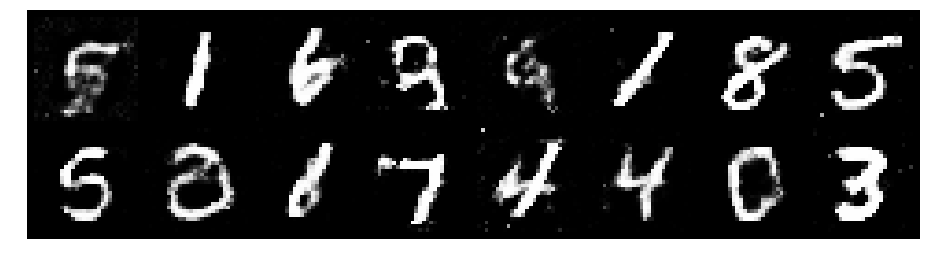

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.3783, Generator Loss: 0.9821
D(x): 0.5110, D(G(z)): 0.4478


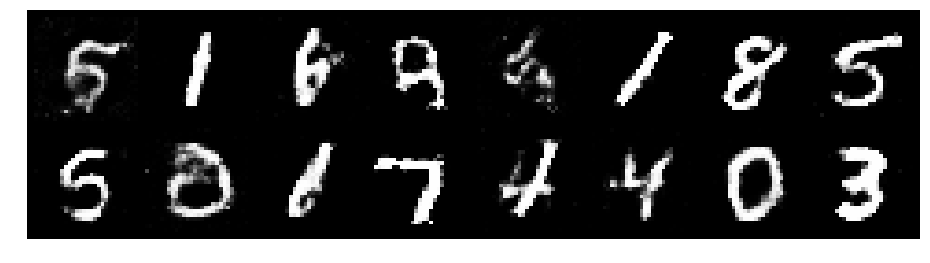

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2024, Generator Loss: 1.0298
D(x): 0.5952, D(G(z)): 0.4299


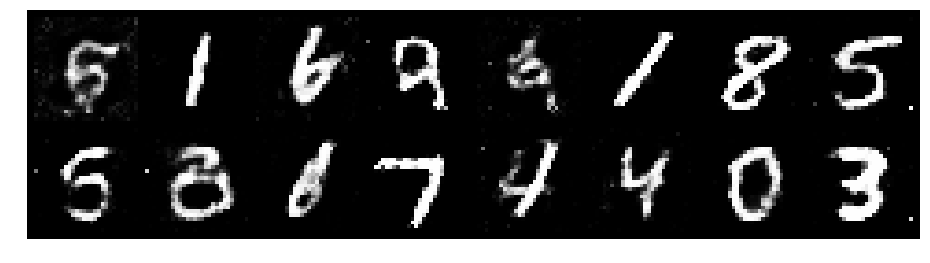

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.3265, Generator Loss: 0.8445
D(x): 0.5454, D(G(z)): 0.4378


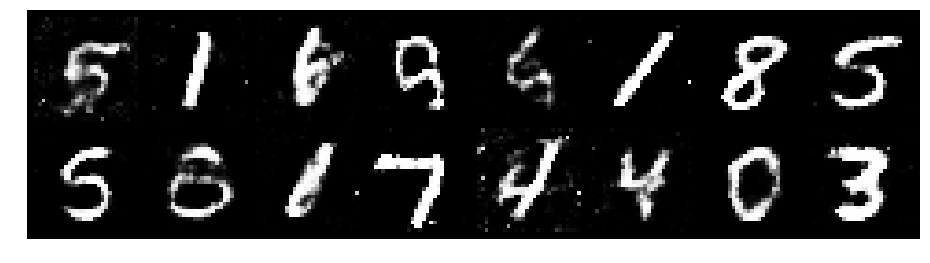

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.1836, Generator Loss: 0.9746
D(x): 0.5577, D(G(z)): 0.3963


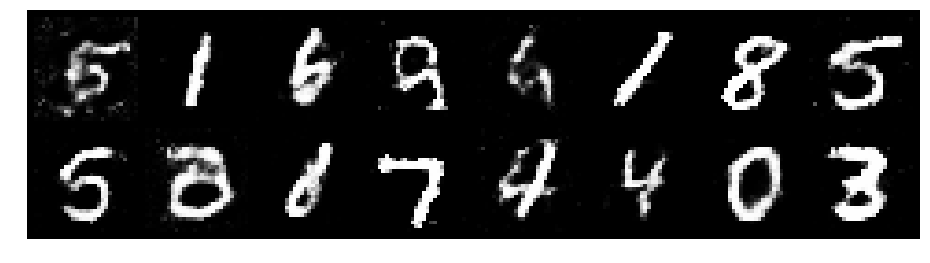

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2327, Generator Loss: 0.9896
D(x): 0.5720, D(G(z)): 0.4309


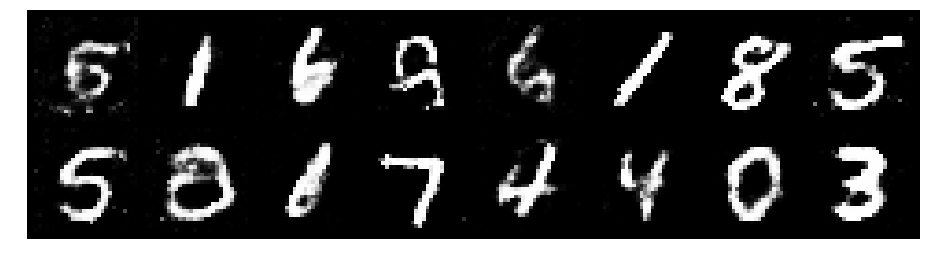

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.1701, Generator Loss: 1.1102
D(x): 0.5867, D(G(z)): 0.3999


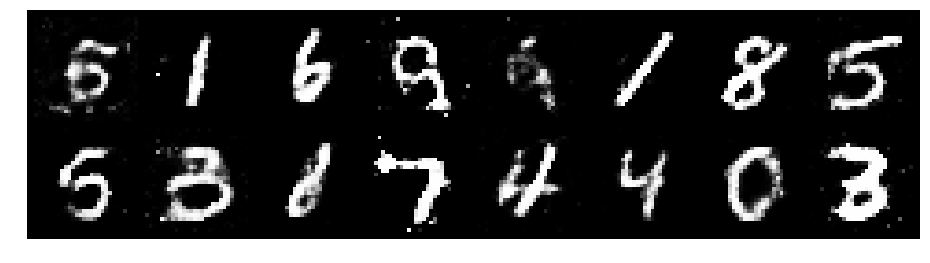

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2255, Generator Loss: 0.9248
D(x): 0.5706, D(G(z)): 0.4250


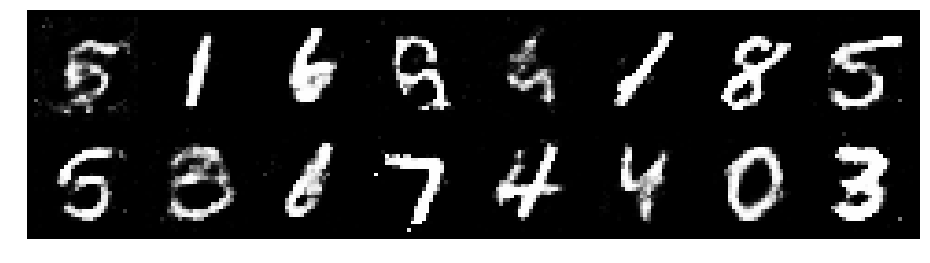

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3116, Generator Loss: 0.9200
D(x): 0.5611, D(G(z)): 0.4641


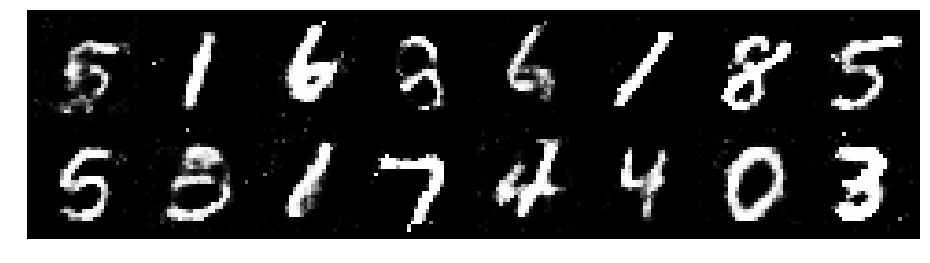

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3546, Generator Loss: 0.9427
D(x): 0.5579, D(G(z)): 0.4581


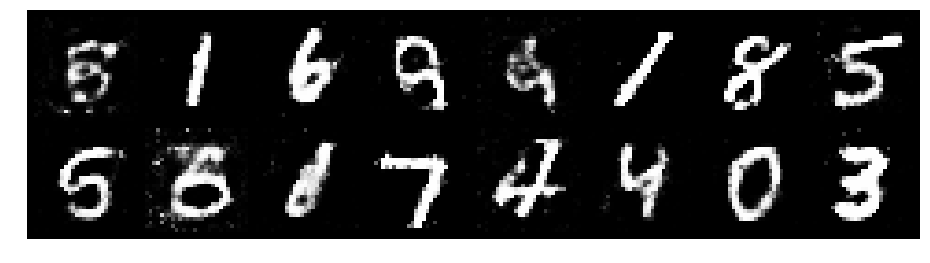

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2102, Generator Loss: 0.9541
D(x): 0.5811, D(G(z)): 0.4276


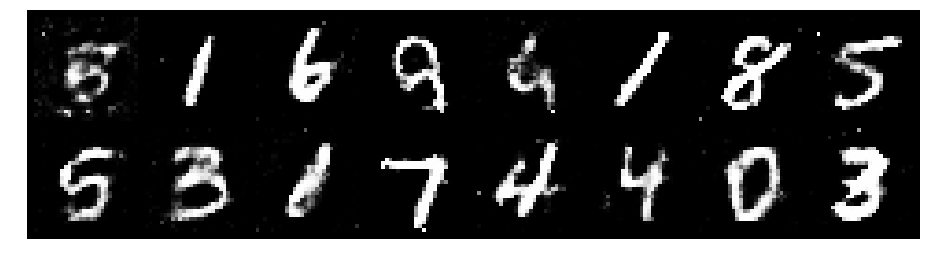

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2362, Generator Loss: 0.7863
D(x): 0.5622, D(G(z)): 0.4484


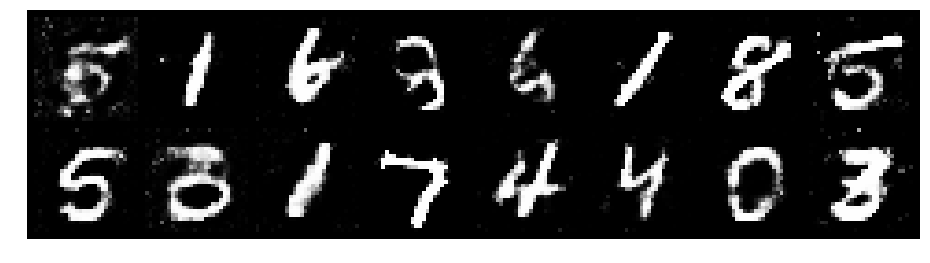

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2297, Generator Loss: 0.8727
D(x): 0.5776, D(G(z)): 0.4571


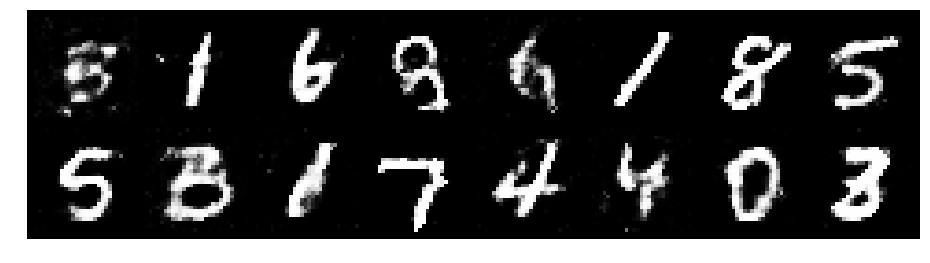

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2016, Generator Loss: 0.7634
D(x): 0.5817, D(G(z)): 0.4434


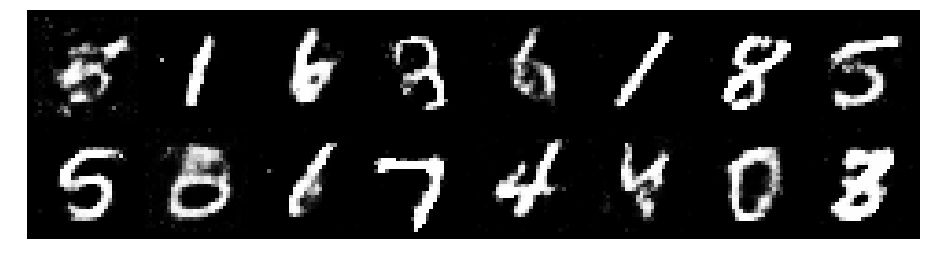

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2984, Generator Loss: 0.9354
D(x): 0.5564, D(G(z)): 0.4591


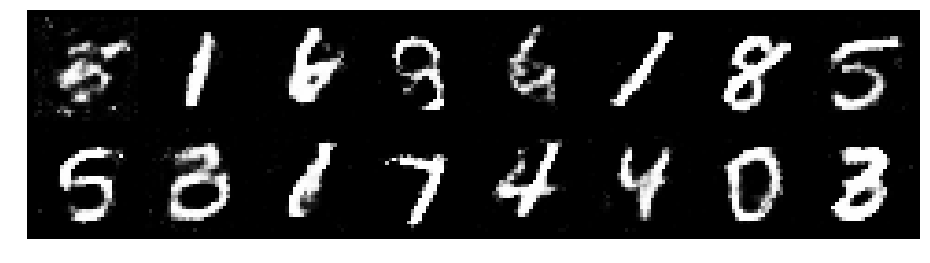

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2666, Generator Loss: 0.7877
D(x): 0.5453, D(G(z)): 0.4268


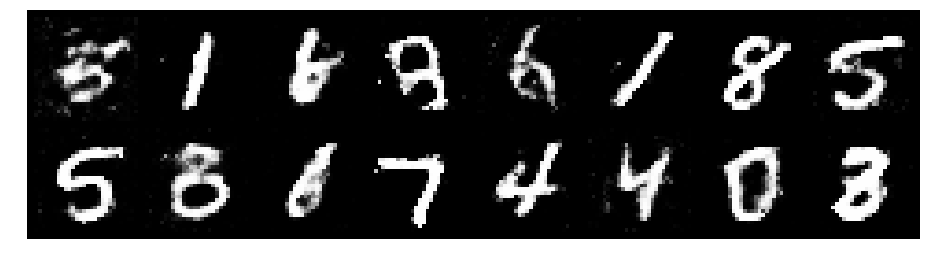

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.3856, Generator Loss: 0.8773
D(x): 0.5528, D(G(z)): 0.4811


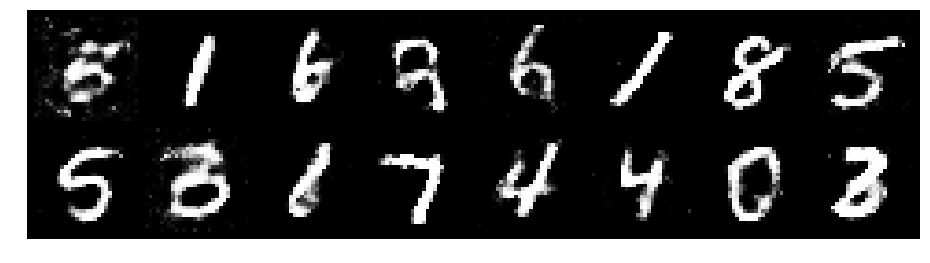

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3227, Generator Loss: 0.9221
D(x): 0.5486, D(G(z)): 0.4454


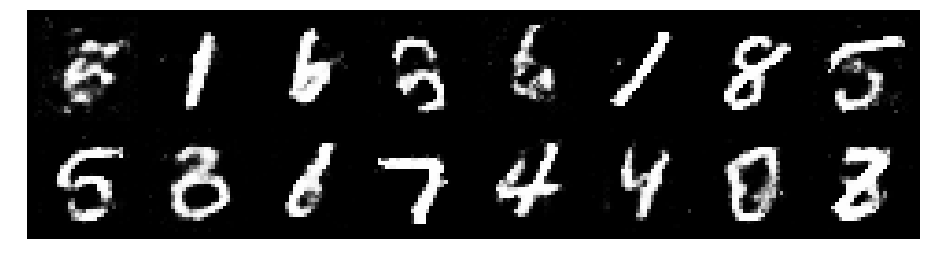

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.3290, Generator Loss: 0.8977
D(x): 0.5479, D(G(z)): 0.4699


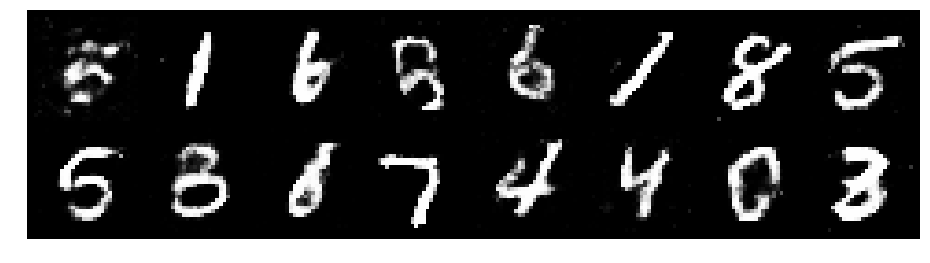

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2859, Generator Loss: 0.9634
D(x): 0.5521, D(G(z)): 0.4520


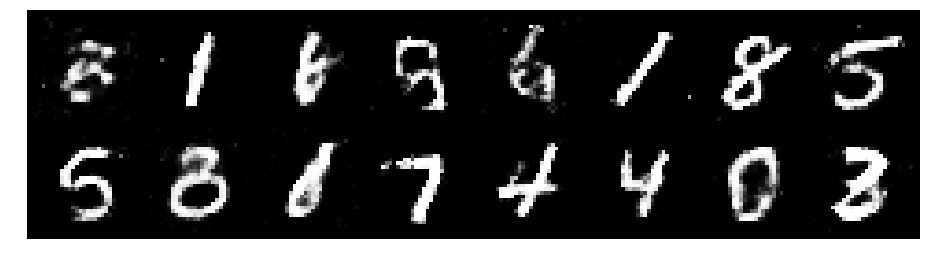

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2778, Generator Loss: 0.9048
D(x): 0.5459, D(G(z)): 0.4414


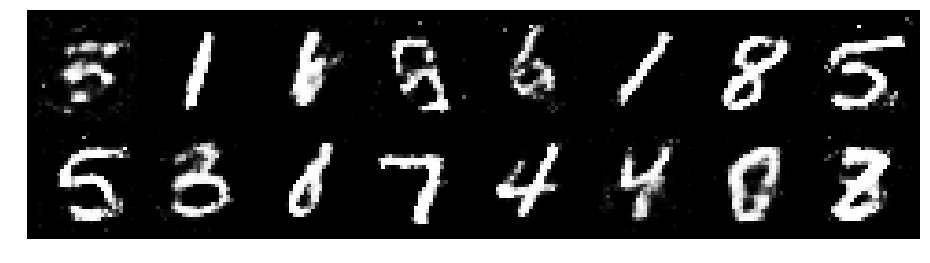

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2213, Generator Loss: 0.8839
D(x): 0.5699, D(G(z)): 0.4462


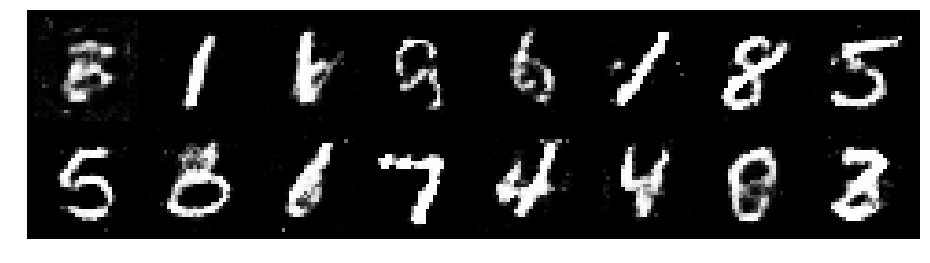

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.1682, Generator Loss: 0.9884
D(x): 0.5577, D(G(z)): 0.4025


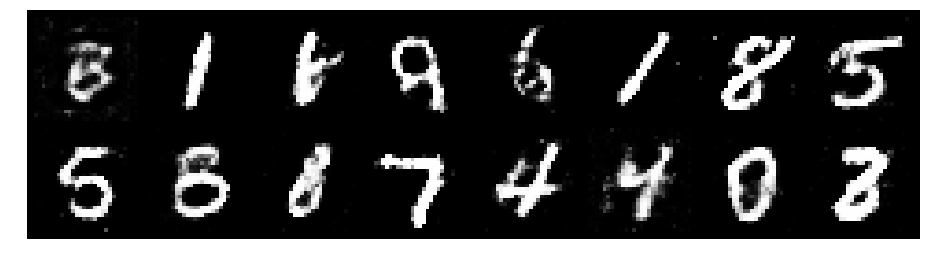

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.1744, Generator Loss: 0.9344
D(x): 0.5643, D(G(z)): 0.4024


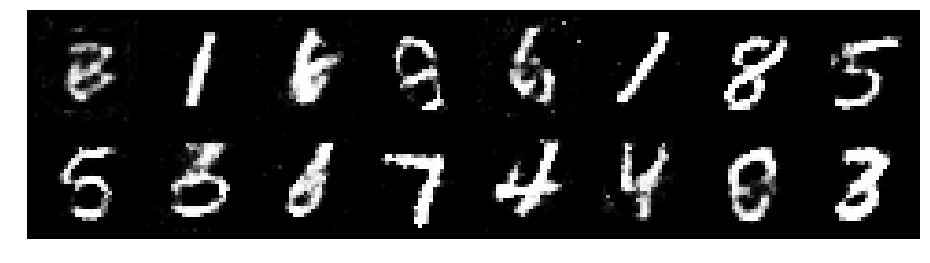

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1945, Generator Loss: 0.8418
D(x): 0.5666, D(G(z)): 0.4396


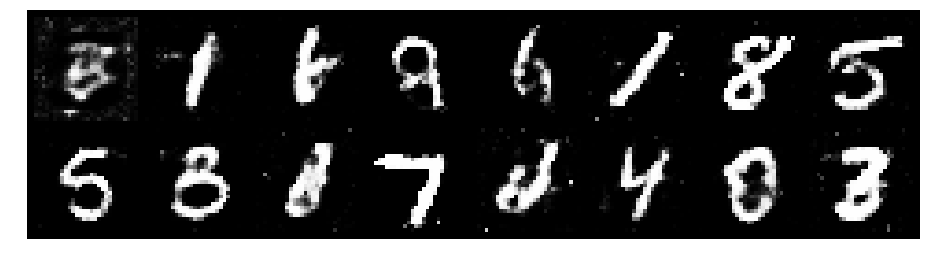

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2805, Generator Loss: 1.0620
D(x): 0.5401, D(G(z)): 0.4282


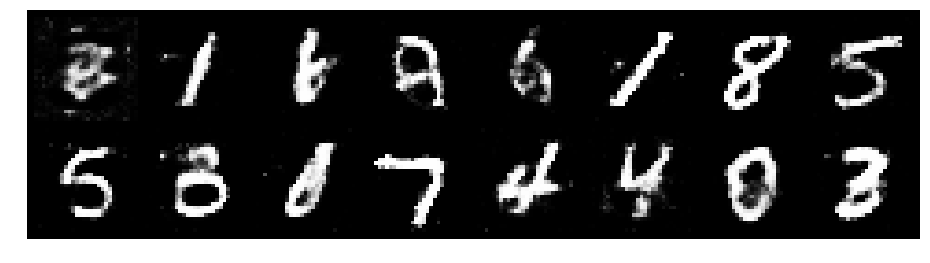

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.1961, Generator Loss: 0.8439
D(x): 0.5655, D(G(z)): 0.4279


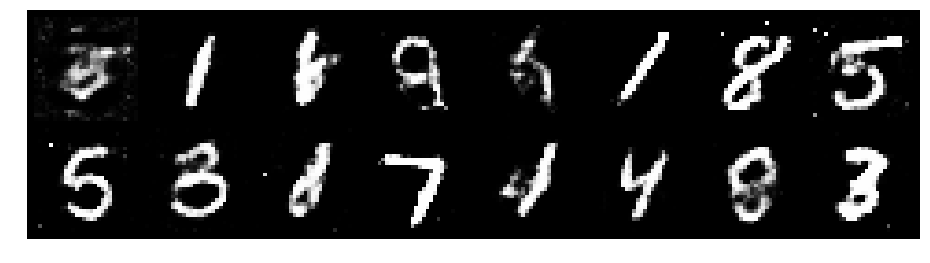

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3049, Generator Loss: 0.8635
D(x): 0.5283, D(G(z)): 0.4342


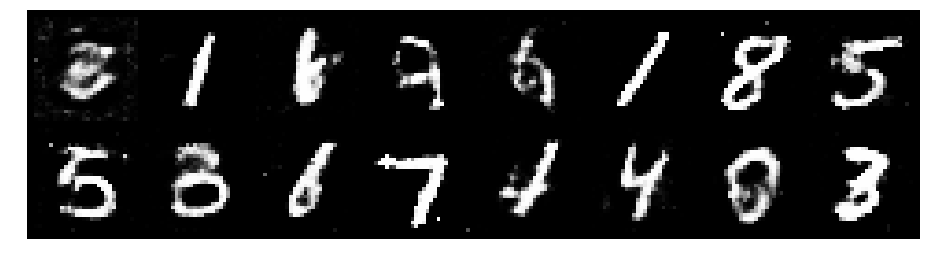

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2643, Generator Loss: 0.8951
D(x): 0.5620, D(G(z)): 0.4390


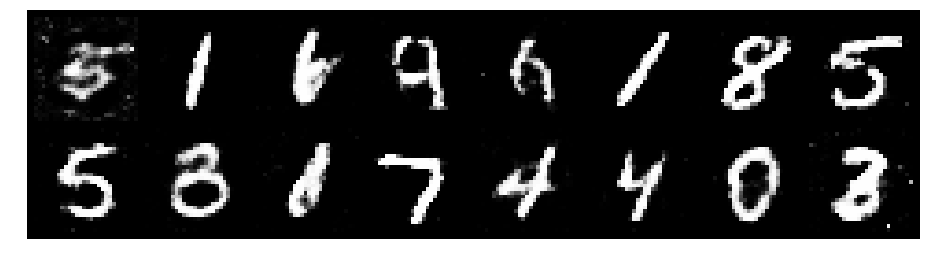

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9243
D(x): 0.5965, D(G(z)): 0.4694


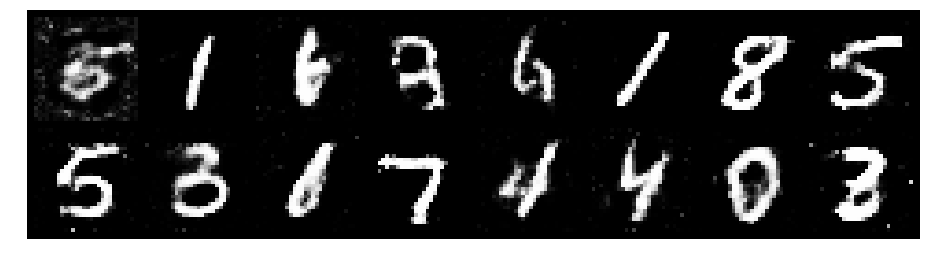

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.1285, Generator Loss: 1.0292
D(x): 0.5830, D(G(z)): 0.3907


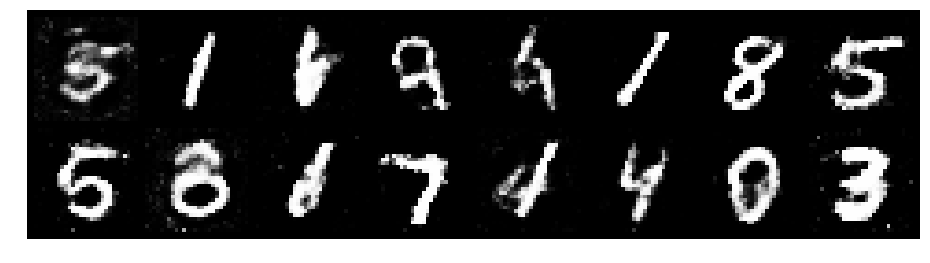

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.1684, Generator Loss: 0.9190
D(x): 0.5833, D(G(z)): 0.4295


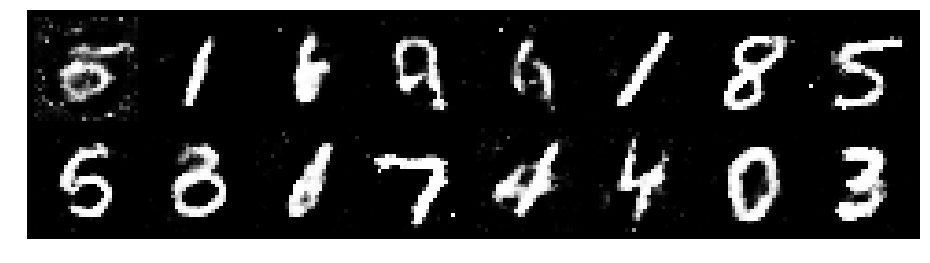

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2917, Generator Loss: 0.8545
D(x): 0.5241, D(G(z)): 0.4324


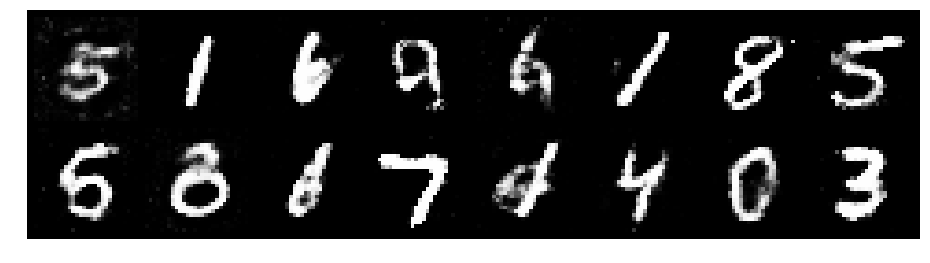

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8488
D(x): 0.5696, D(G(z)): 0.4595


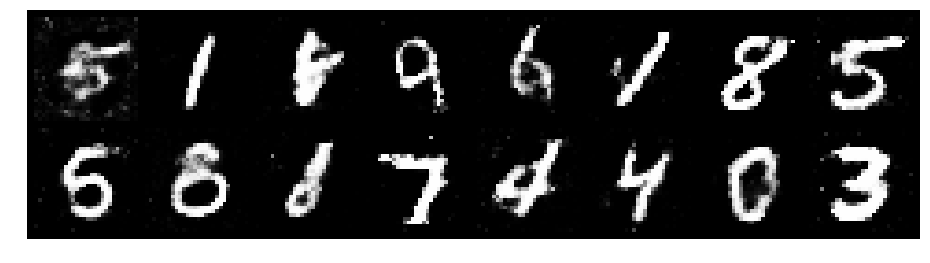

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.0998, Generator Loss: 0.9025
D(x): 0.6142, D(G(z)): 0.4061


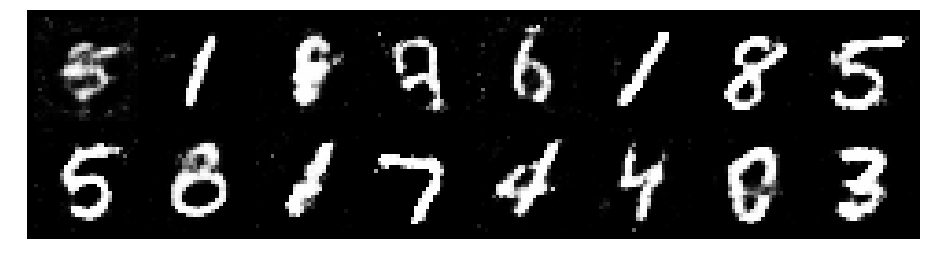

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2834, Generator Loss: 0.7781
D(x): 0.5636, D(G(z)): 0.4548


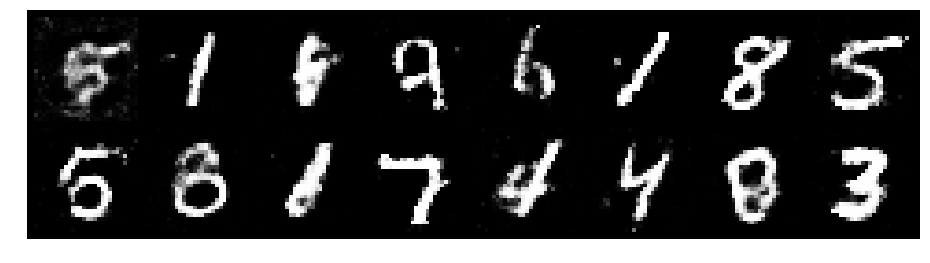

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2062, Generator Loss: 0.8529
D(x): 0.5696, D(G(z)): 0.4274


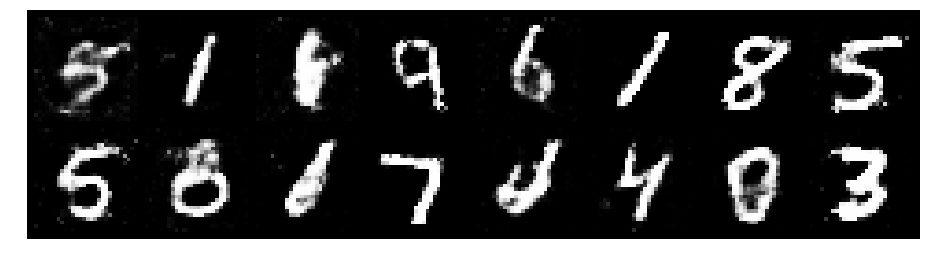

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2034, Generator Loss: 0.7963
D(x): 0.5910, D(G(z)): 0.4503


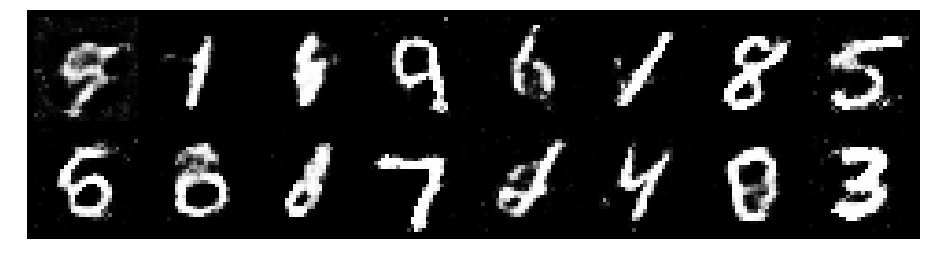

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2985, Generator Loss: 1.0144
D(x): 0.5677, D(G(z)): 0.4343


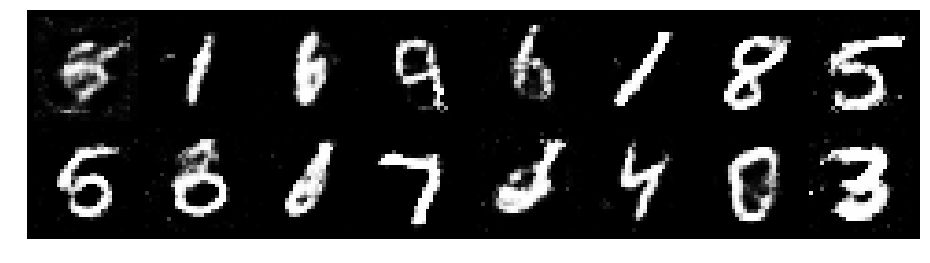

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.3631, Generator Loss: 0.8570
D(x): 0.5482, D(G(z)): 0.4622


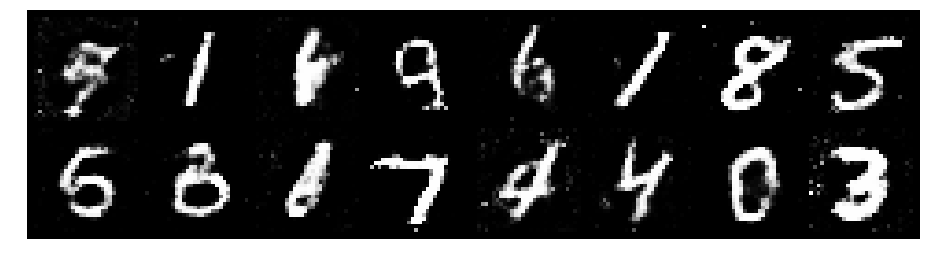

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3551, Generator Loss: 0.8274
D(x): 0.5398, D(G(z)): 0.4833


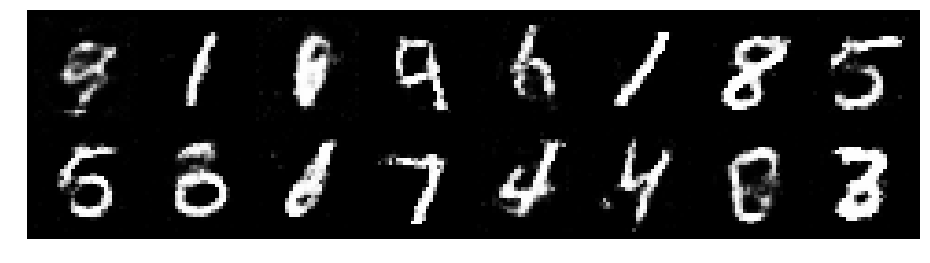

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2244, Generator Loss: 1.0394
D(x): 0.5241, D(G(z)): 0.3869


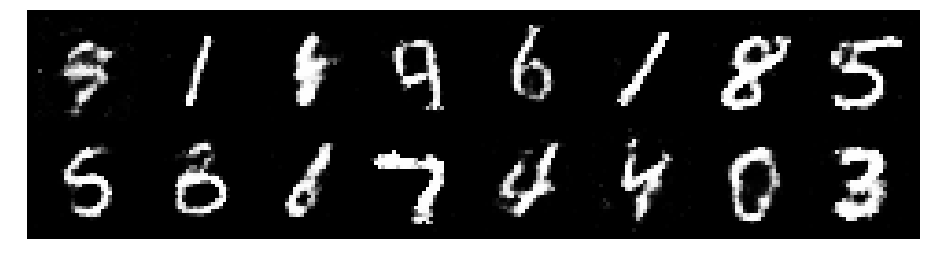

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.1930, Generator Loss: 0.9324
D(x): 0.5348, D(G(z)): 0.3828


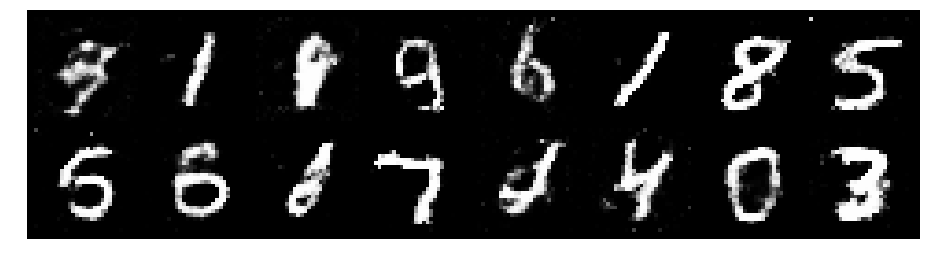

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2137, Generator Loss: 0.8950
D(x): 0.5677, D(G(z)): 0.4511


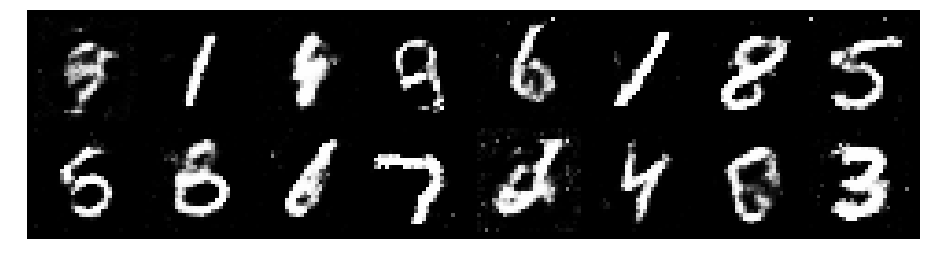

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3432, Generator Loss: 0.8407
D(x): 0.5019, D(G(z)): 0.4429


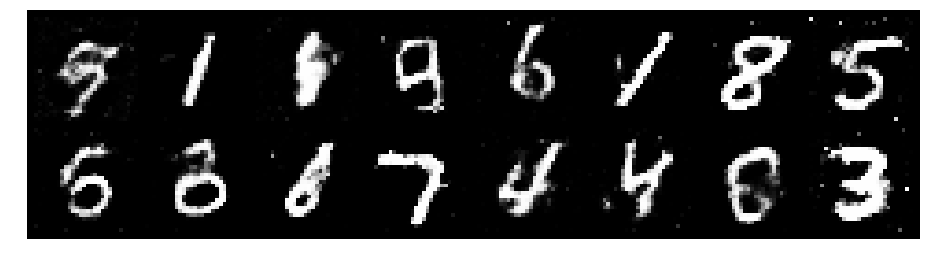

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3383, Generator Loss: 0.9987
D(x): 0.5019, D(G(z)): 0.4149


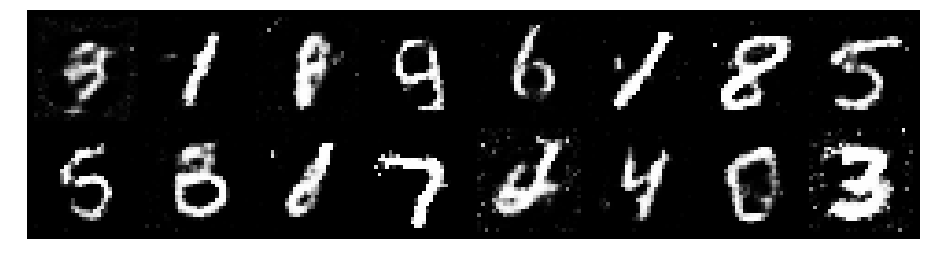

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.3283, Generator Loss: 0.8817
D(x): 0.5518, D(G(z)): 0.4549


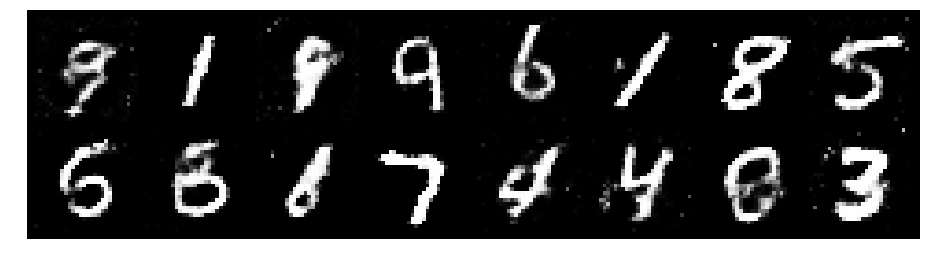

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3632, Generator Loss: 1.1020
D(x): 0.5485, D(G(z)): 0.4380


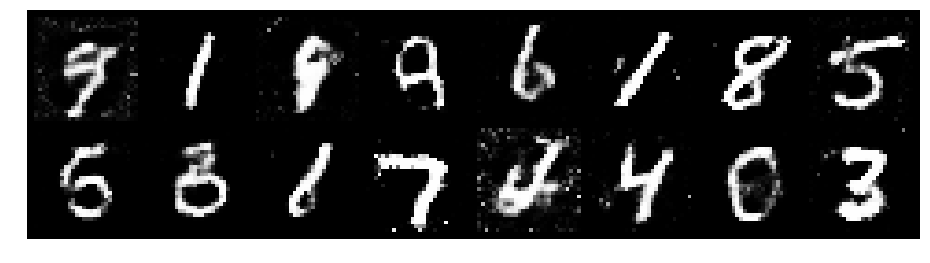

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.3338, Generator Loss: 0.9263
D(x): 0.5278, D(G(z)): 0.4458


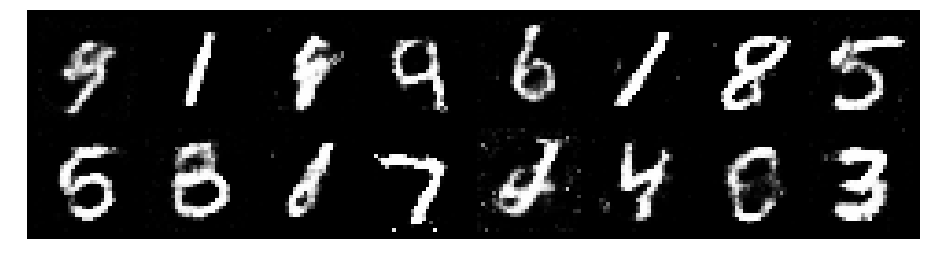

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8900
D(x): 0.5635, D(G(z)): 0.4684


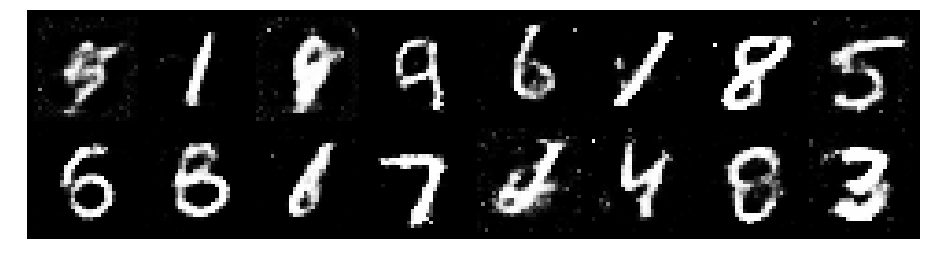

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.3954, Generator Loss: 0.7793
D(x): 0.4974, D(G(z)): 0.4559


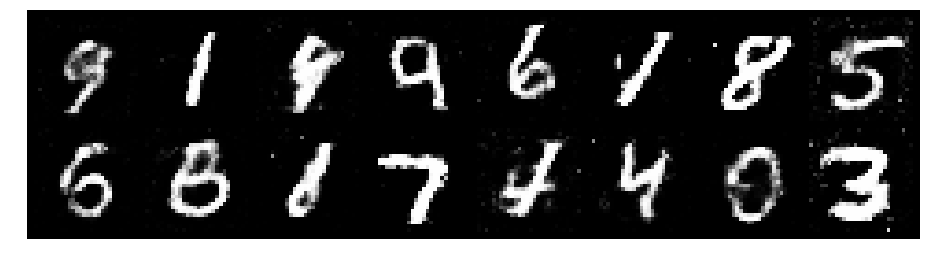

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3294, Generator Loss: 0.8401
D(x): 0.5835, D(G(z)): 0.4767


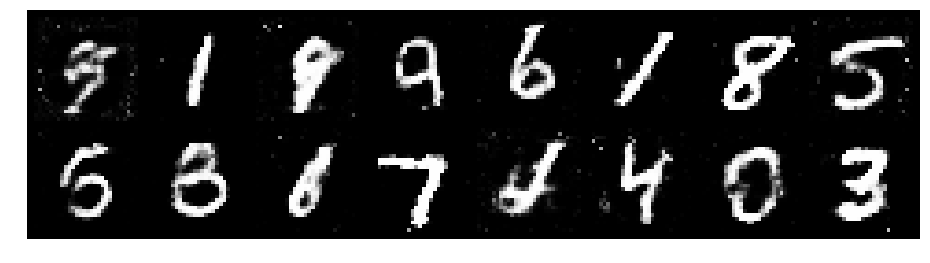

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.3755, Generator Loss: 0.7700
D(x): 0.5702, D(G(z)): 0.4986


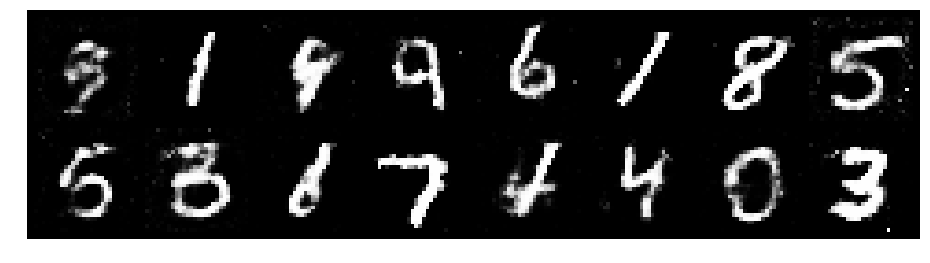

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3862, Generator Loss: 1.0367
D(x): 0.5752, D(G(z)): 0.4614


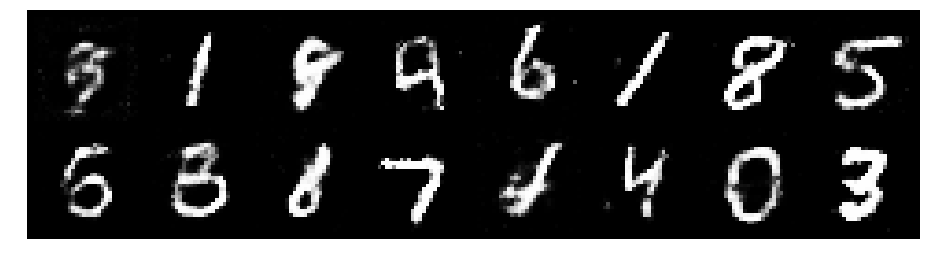

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.4361, Generator Loss: 0.8545
D(x): 0.5397, D(G(z)): 0.4840


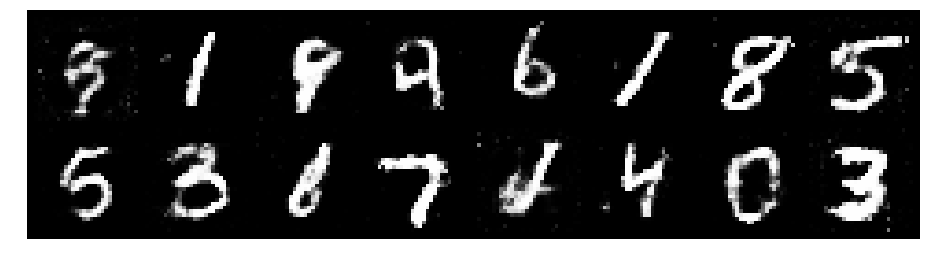

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.0662, Generator Loss: 0.9749
D(x): 0.5973, D(G(z)): 0.3845


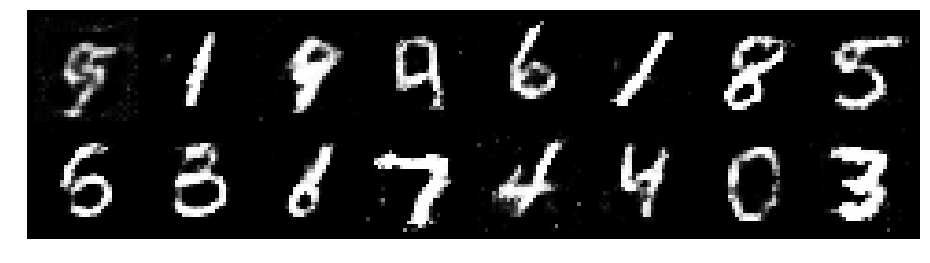

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.1897, Generator Loss: 0.8281
D(x): 0.5931, D(G(z)): 0.4350


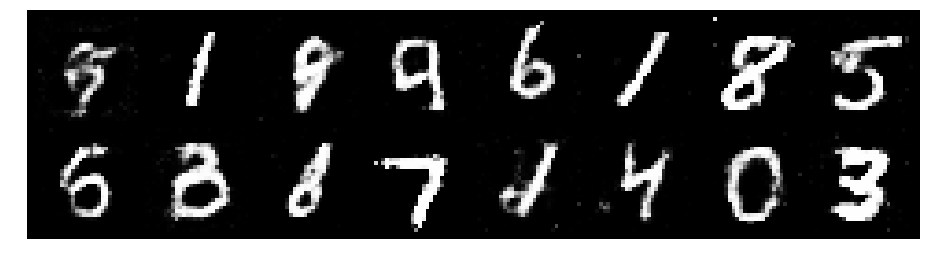

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2526, Generator Loss: 0.9950
D(x): 0.5715, D(G(z)): 0.4618


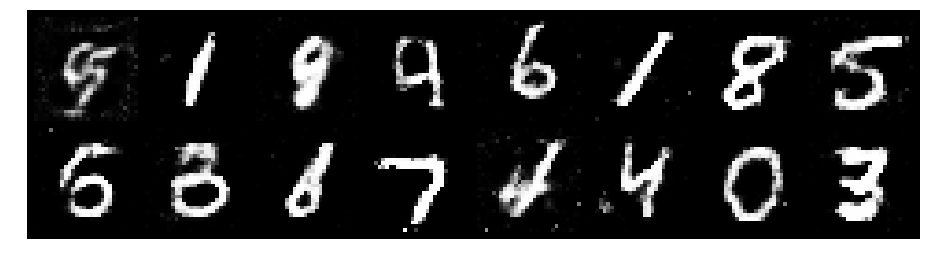

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2712, Generator Loss: 0.9160
D(x): 0.5636, D(G(z)): 0.4513


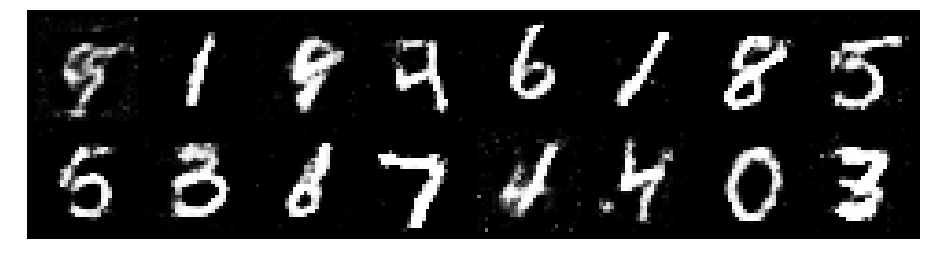

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3296, Generator Loss: 0.8875
D(x): 0.5383, D(G(z)): 0.4562


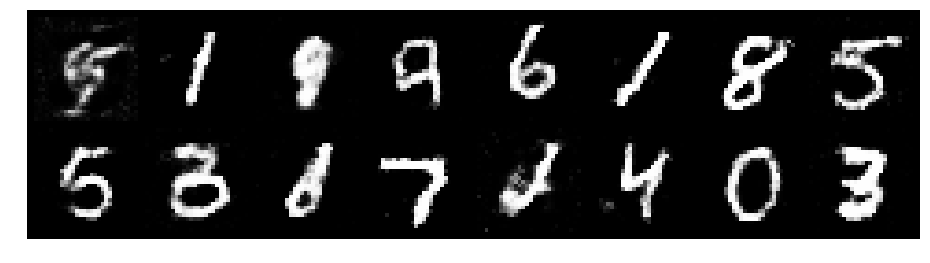

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.2463, Generator Loss: 0.9443
D(x): 0.5583, D(G(z)): 0.4178


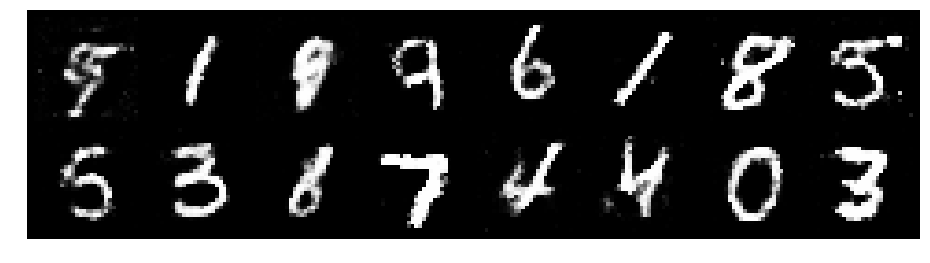

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3245, Generator Loss: 0.9248
D(x): 0.5131, D(G(z)): 0.4296


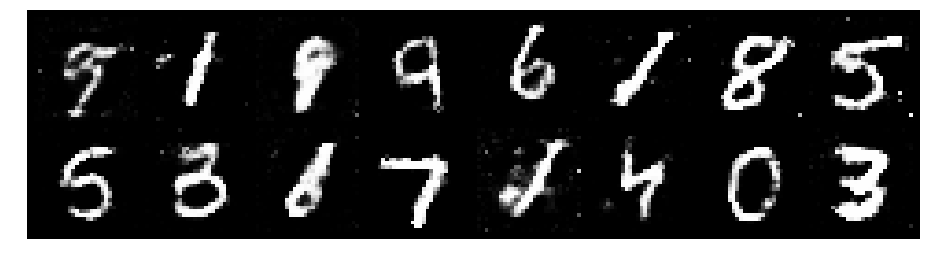

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2935, Generator Loss: 1.0580
D(x): 0.5418, D(G(z)): 0.4265


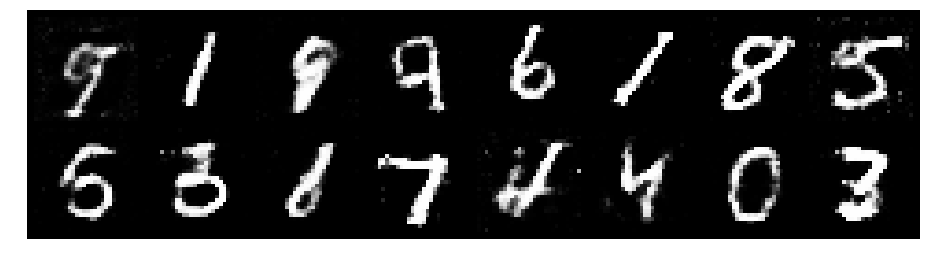

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.1630, Generator Loss: 0.8962
D(x): 0.6065, D(G(z)): 0.4345


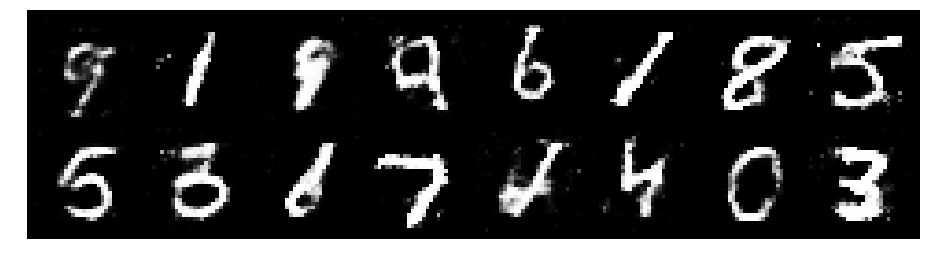

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.1936, Generator Loss: 1.0674
D(x): 0.5640, D(G(z)): 0.3976


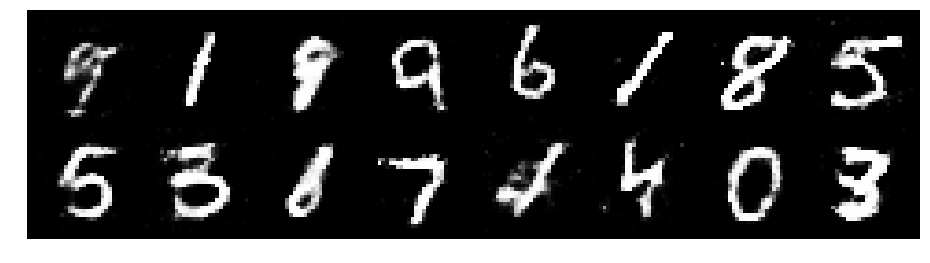

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2531, Generator Loss: 0.9152
D(x): 0.5245, D(G(z)): 0.3971


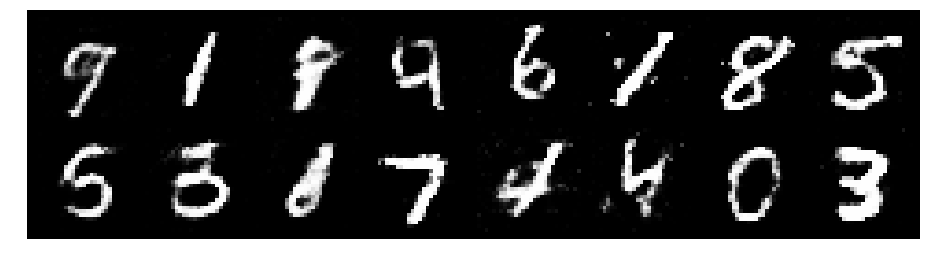

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.3135, Generator Loss: 0.9714
D(x): 0.5503, D(G(z)): 0.4513


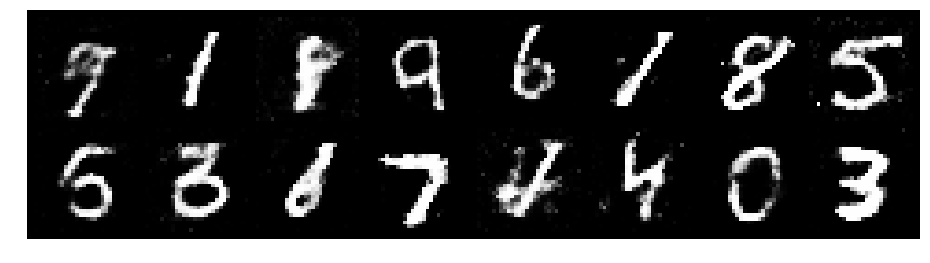

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2147, Generator Loss: 0.9324
D(x): 0.5403, D(G(z)): 0.4030


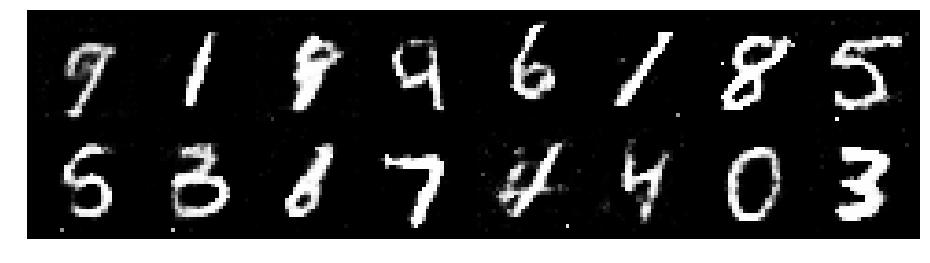

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2382, Generator Loss: 0.9394
D(x): 0.5707, D(G(z)): 0.4165


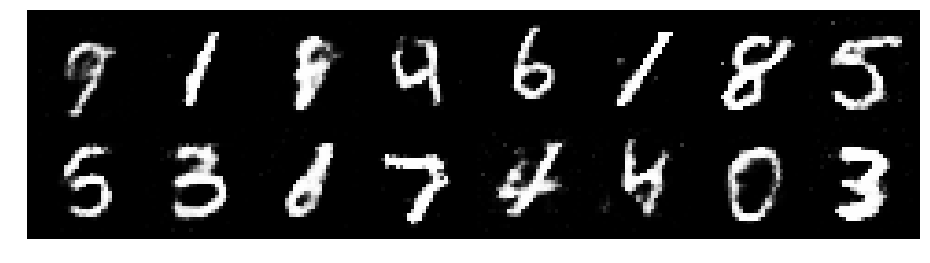

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3711, Generator Loss: 0.8752
D(x): 0.5653, D(G(z)): 0.4797


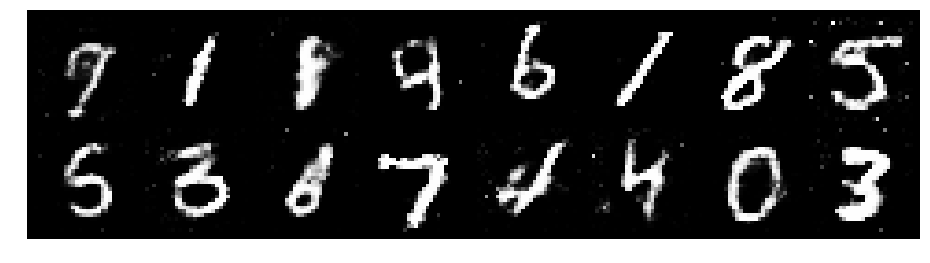

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.3522, Generator Loss: 0.9153
D(x): 0.5312, D(G(z)): 0.4710


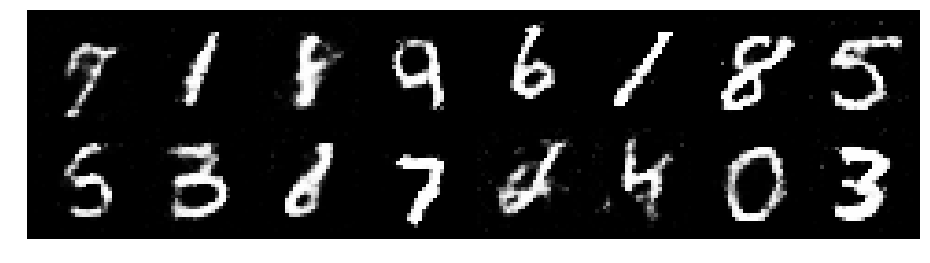

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.3062, Generator Loss: 0.8667
D(x): 0.5545, D(G(z)): 0.4588


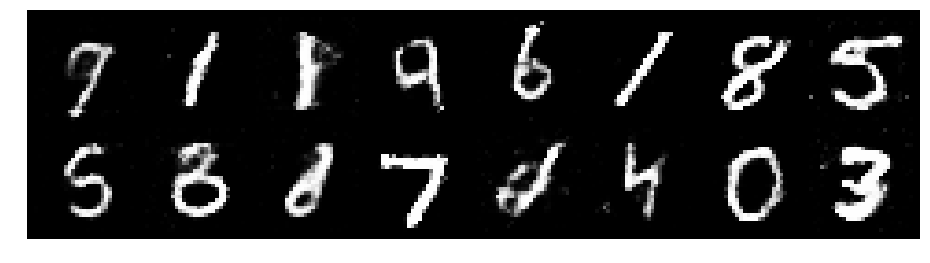

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3386, Generator Loss: 0.9149
D(x): 0.5406, D(G(z)): 0.4440


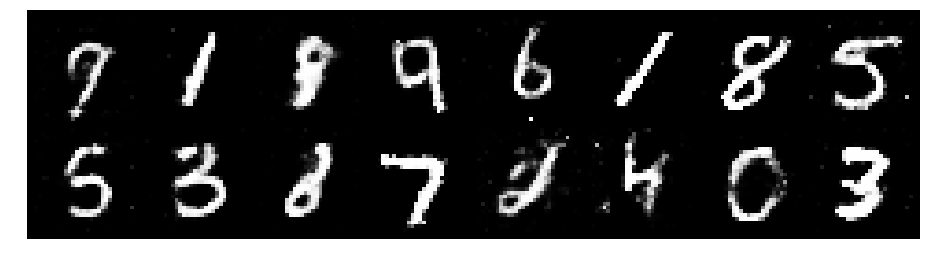

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2611, Generator Loss: 0.8805
D(x): 0.5510, D(G(z)): 0.4506


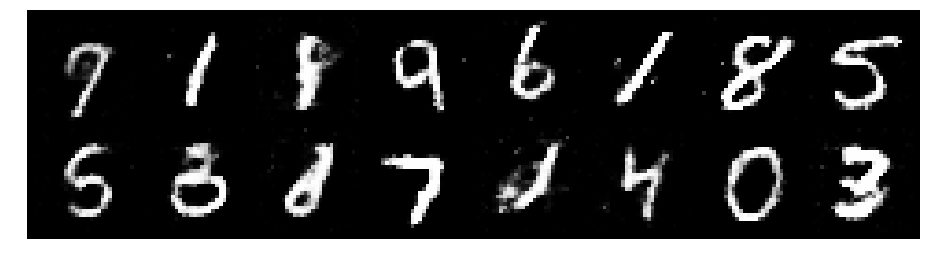

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8245
D(x): 0.5815, D(G(z)): 0.4648


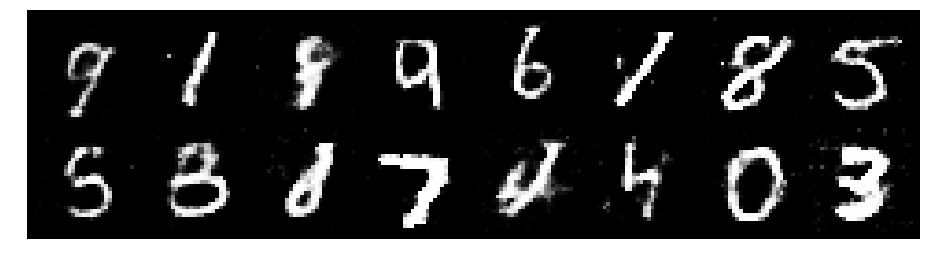

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2494, Generator Loss: 0.8368
D(x): 0.5844, D(G(z)): 0.4516


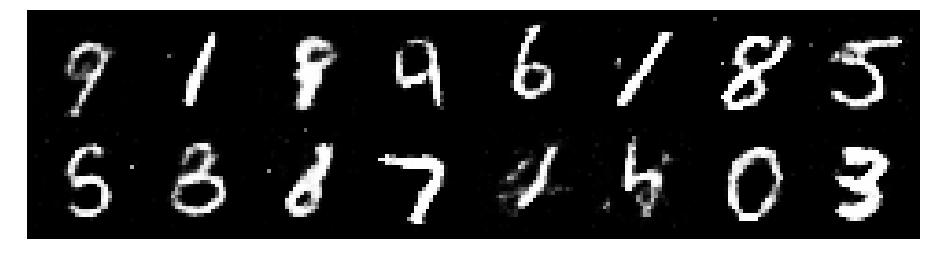

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9452
D(x): 0.5389, D(G(z)): 0.4217


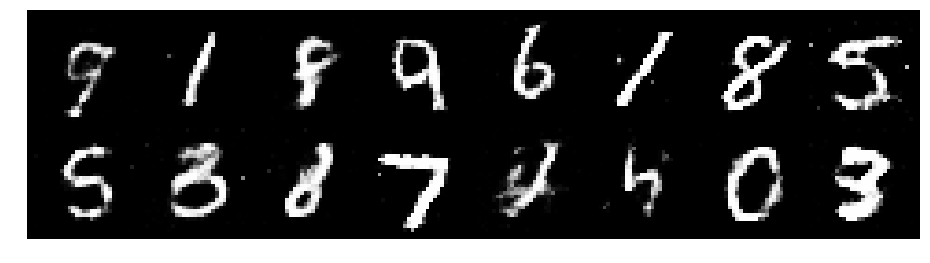

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3604, Generator Loss: 0.8349
D(x): 0.5029, D(G(z)): 0.4322


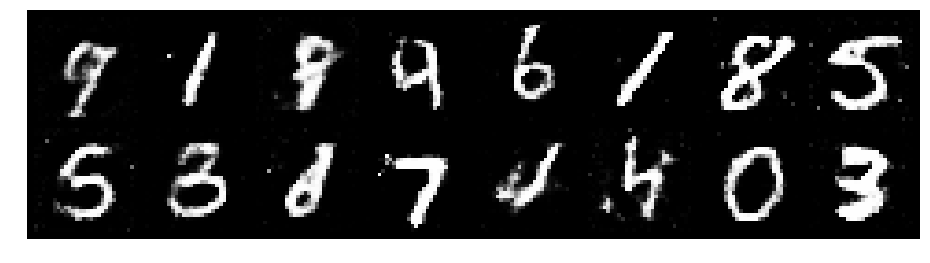

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2407, Generator Loss: 0.8931
D(x): 0.5513, D(G(z)): 0.4280


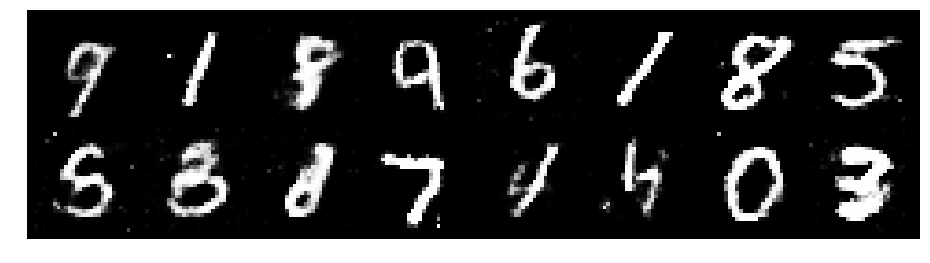

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2979, Generator Loss: 0.7753
D(x): 0.5732, D(G(z)): 0.4600


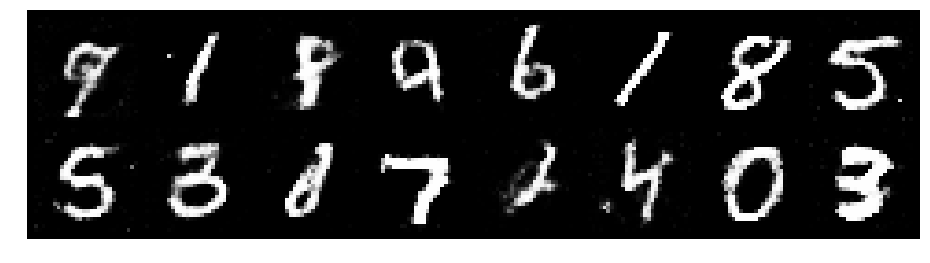

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.3101, Generator Loss: 0.8184
D(x): 0.5643, D(G(z)): 0.4716


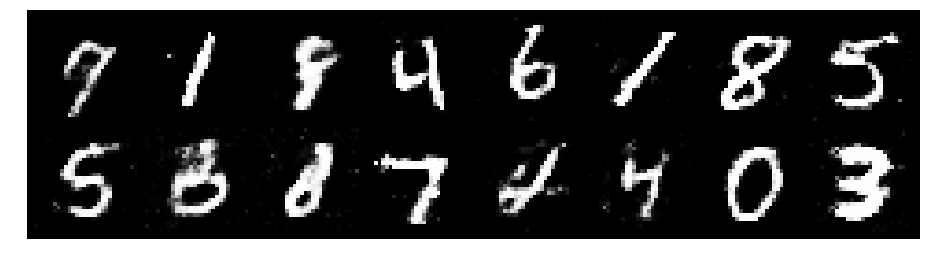

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2049, Generator Loss: 0.8197
D(x): 0.5584, D(G(z)): 0.4220


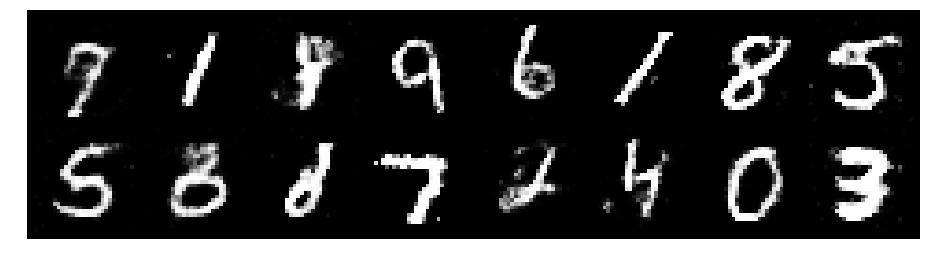

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.1873, Generator Loss: 0.9055
D(x): 0.5565, D(G(z)): 0.4241


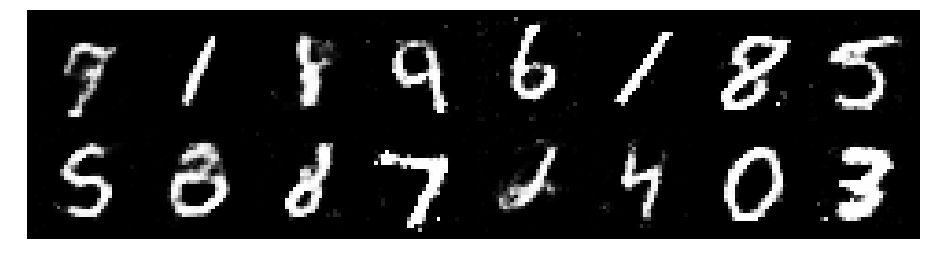

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2366, Generator Loss: 0.8964
D(x): 0.5454, D(G(z)): 0.4136


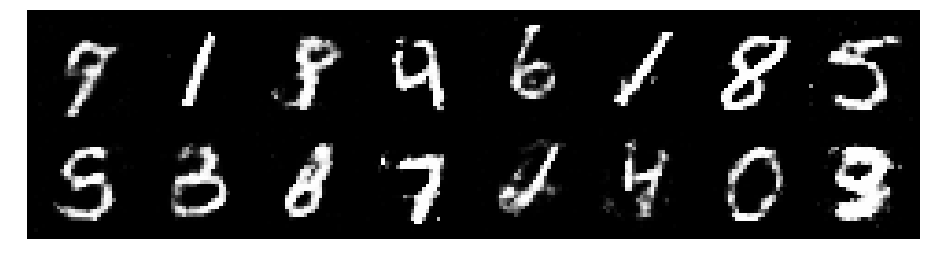

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2733, Generator Loss: 0.8293
D(x): 0.5420, D(G(z)): 0.4568


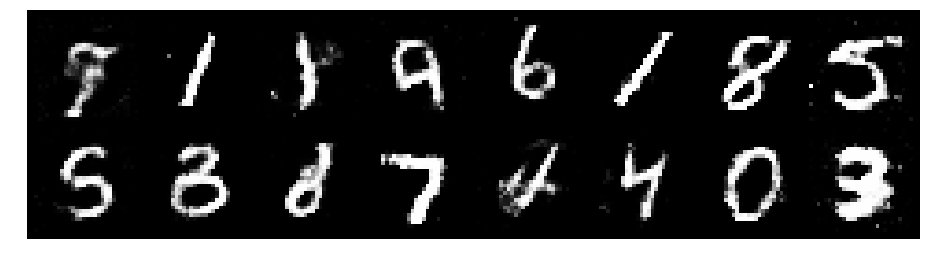

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2774, Generator Loss: 0.8724
D(x): 0.5196, D(G(z)): 0.4360


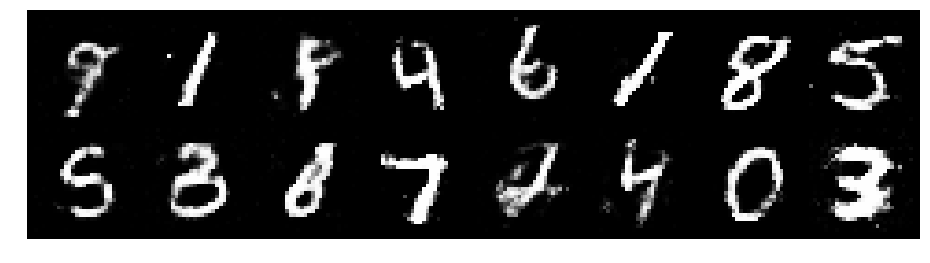

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2465, Generator Loss: 0.8303
D(x): 0.5592, D(G(z)): 0.4408


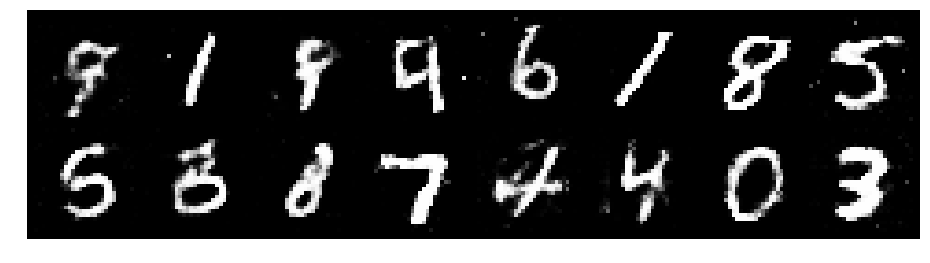

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.3193, Generator Loss: 1.0002
D(x): 0.5283, D(G(z)): 0.4412


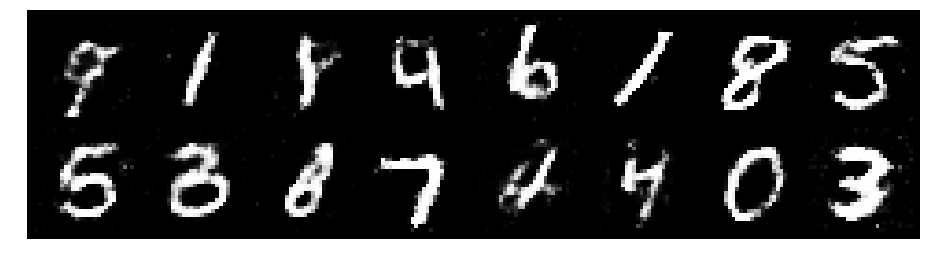

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3160, Generator Loss: 0.8302
D(x): 0.5767, D(G(z)): 0.4830


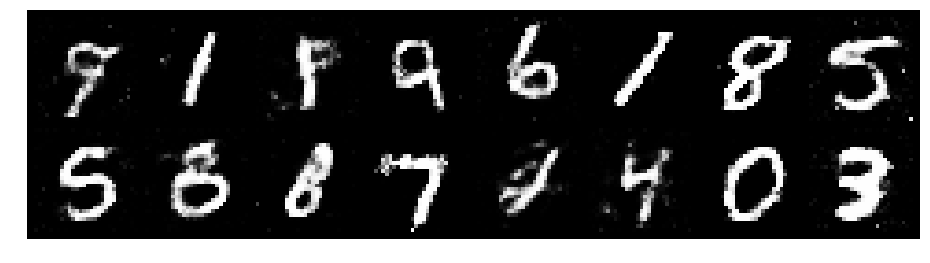

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.2791, Generator Loss: 0.7627
D(x): 0.5808, D(G(z)): 0.4750


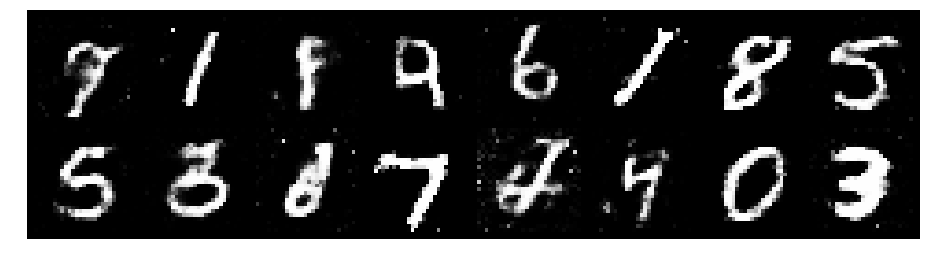

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2740, Generator Loss: 0.9474
D(x): 0.5650, D(G(z)): 0.4445


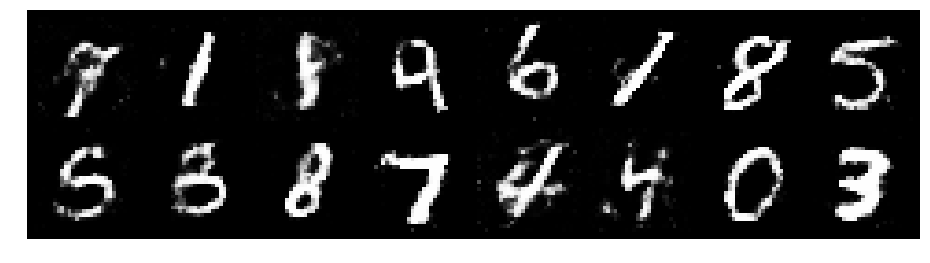

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.1676, Generator Loss: 0.9269
D(x): 0.5645, D(G(z)): 0.4052


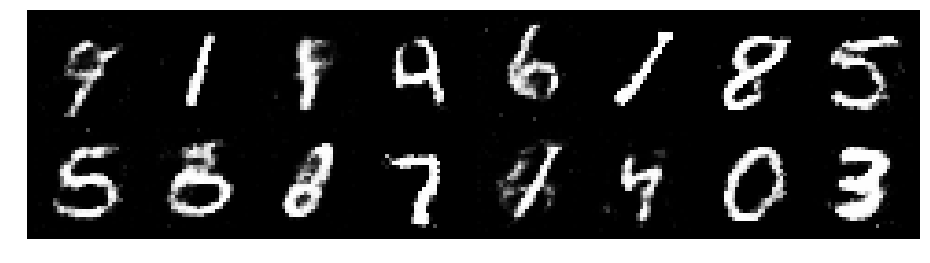

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.2434, Generator Loss: 0.9319
D(x): 0.5424, D(G(z)): 0.4214


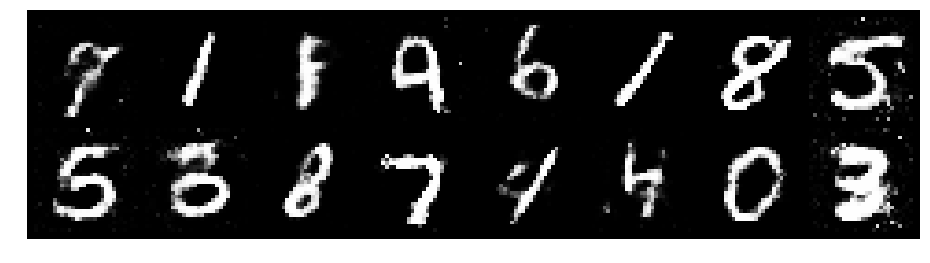

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2065, Generator Loss: 0.9599
D(x): 0.5733, D(G(z)): 0.4325


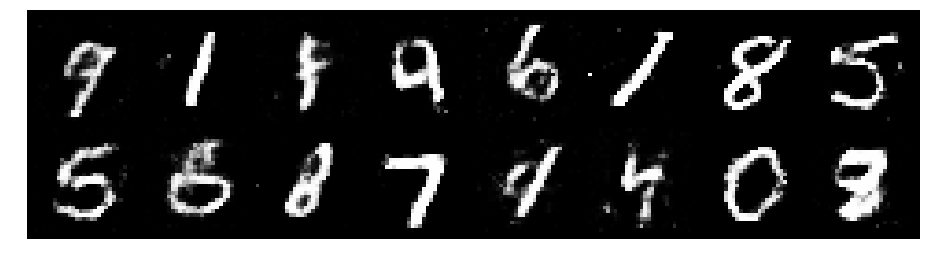

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.3260, Generator Loss: 0.8480
D(x): 0.5522, D(G(z)): 0.4698


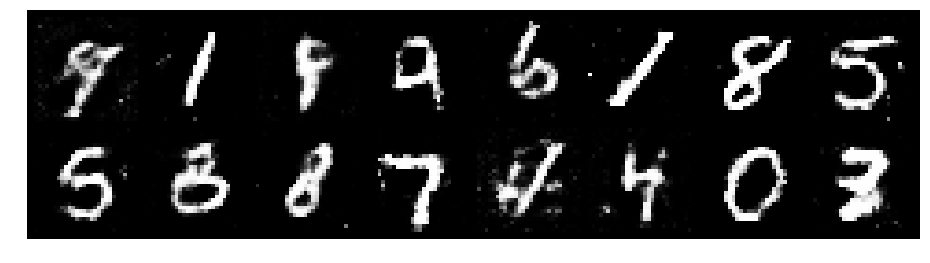

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.3214, Generator Loss: 0.8128
D(x): 0.5134, D(G(z)): 0.4373


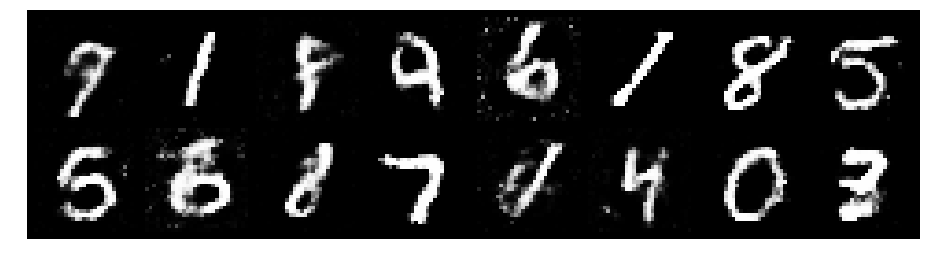

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.3512, Generator Loss: 0.7572
D(x): 0.5384, D(G(z)): 0.4772


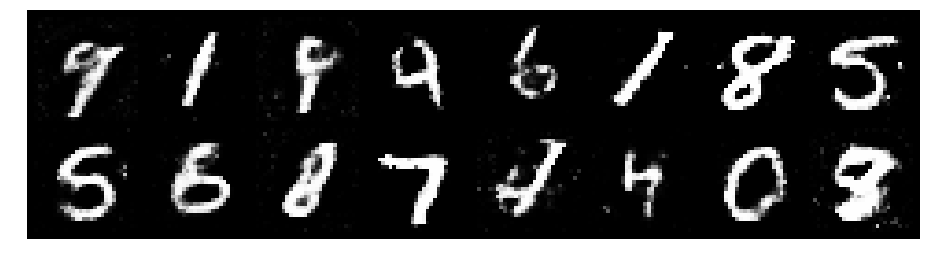

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2287, Generator Loss: 0.9863
D(x): 0.6147, D(G(z)): 0.4535


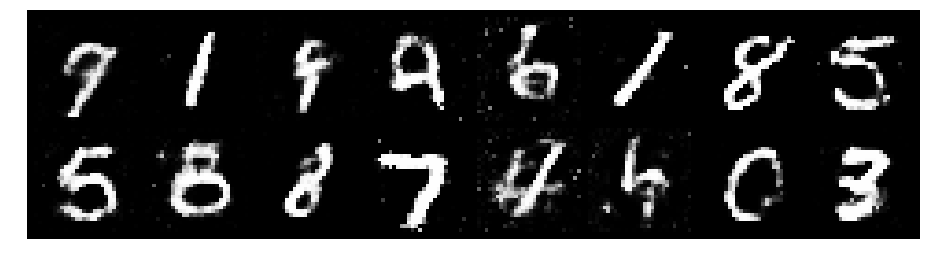

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2700, Generator Loss: 0.9756
D(x): 0.5642, D(G(z)): 0.4563


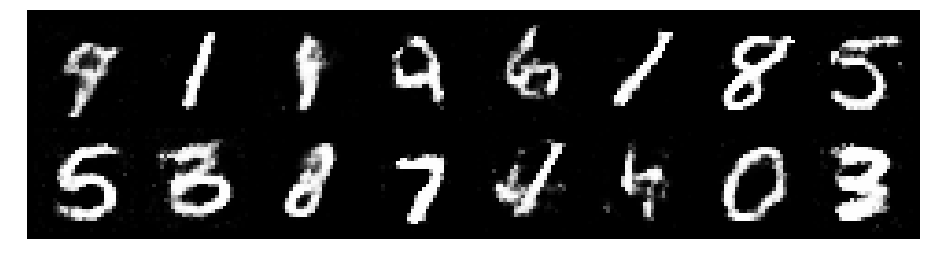

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.1837, Generator Loss: 0.9798
D(x): 0.5756, D(G(z)): 0.3966


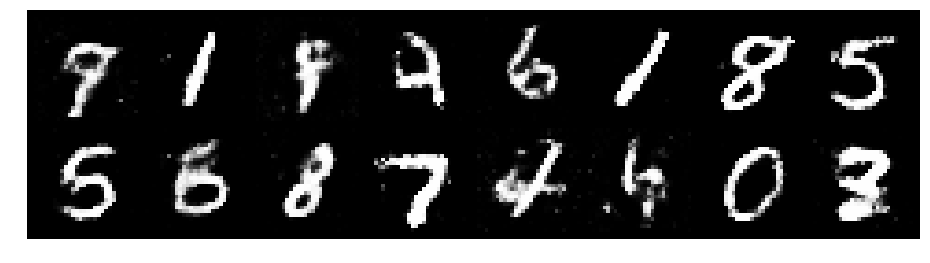

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9175
D(x): 0.5556, D(G(z)): 0.4357


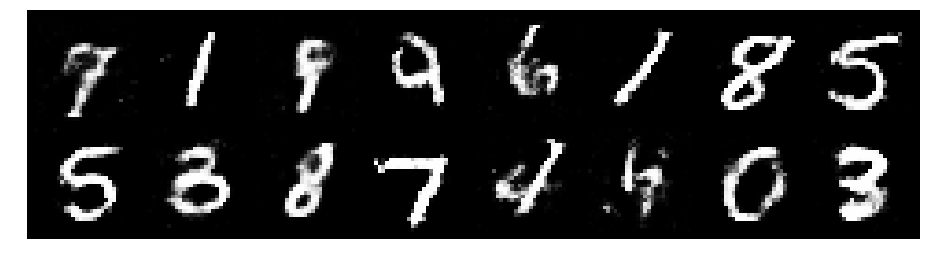

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2093, Generator Loss: 0.8752
D(x): 0.6163, D(G(z)): 0.4665


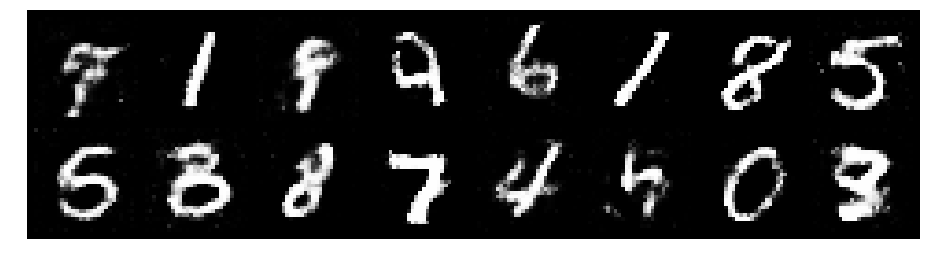

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3559, Generator Loss: 0.7640
D(x): 0.5411, D(G(z)): 0.4817


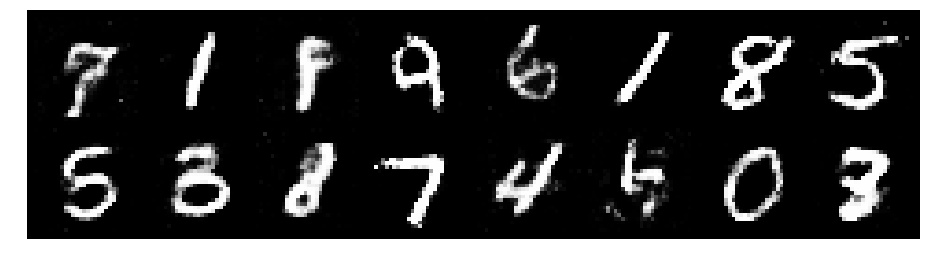

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.4547, Generator Loss: 0.7624
D(x): 0.5269, D(G(z)): 0.5031


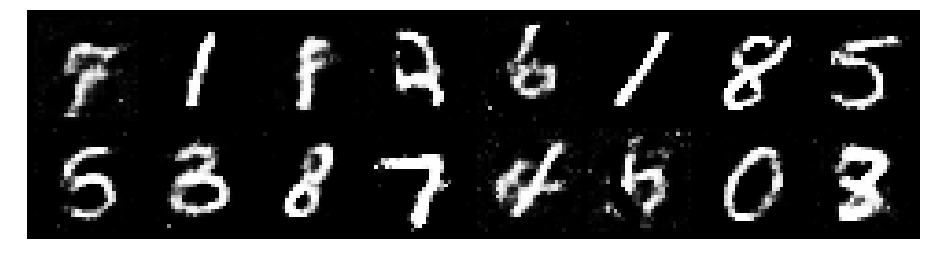

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.3169, Generator Loss: 0.7809
D(x): 0.5561, D(G(z)): 0.4651


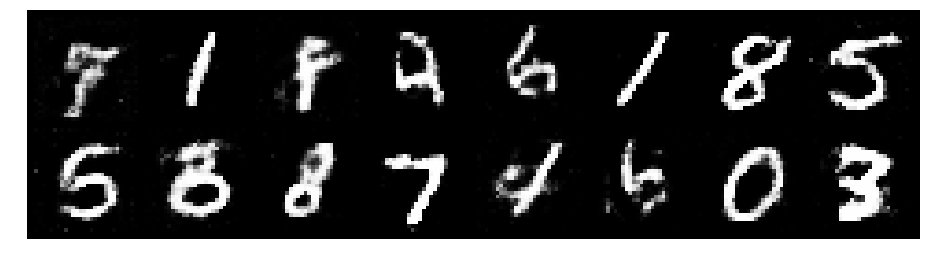

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3906, Generator Loss: 0.7840
D(x): 0.5102, D(G(z)): 0.4792


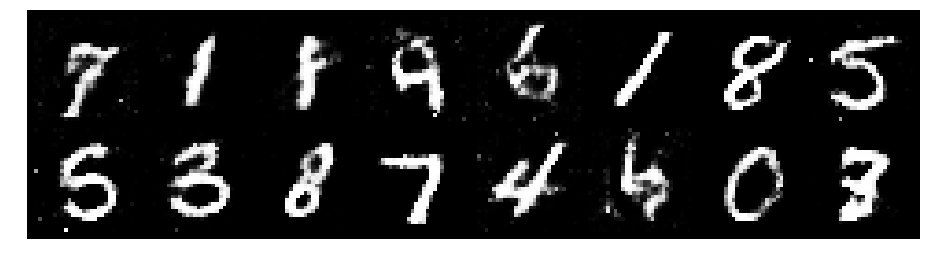

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3604, Generator Loss: 0.7349
D(x): 0.5147, D(G(z)): 0.4713


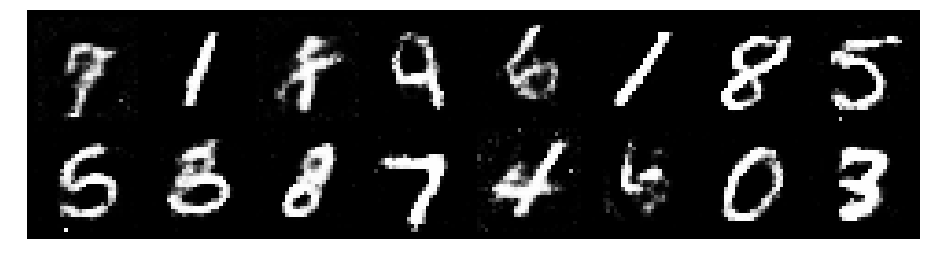

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3579, Generator Loss: 0.8753
D(x): 0.5484, D(G(z)): 0.4960


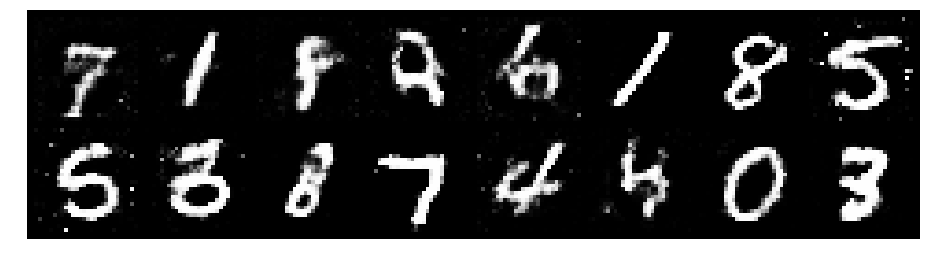

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.1796, Generator Loss: 0.8848
D(x): 0.5789, D(G(z)): 0.4337


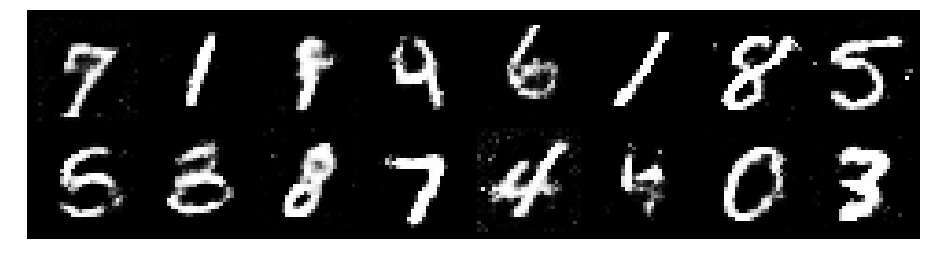

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3210, Generator Loss: 0.7595
D(x): 0.5557, D(G(z)): 0.4764


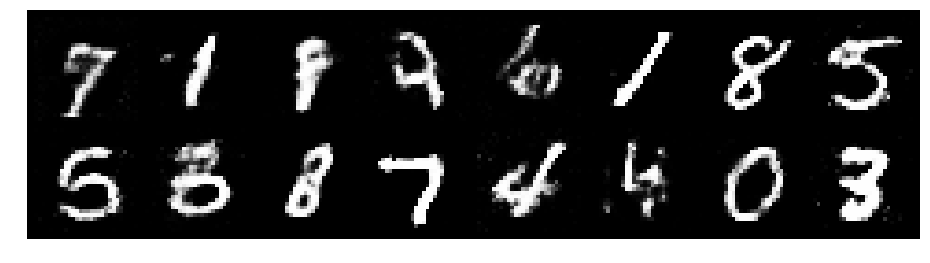

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8885
D(x): 0.5271, D(G(z)): 0.4375


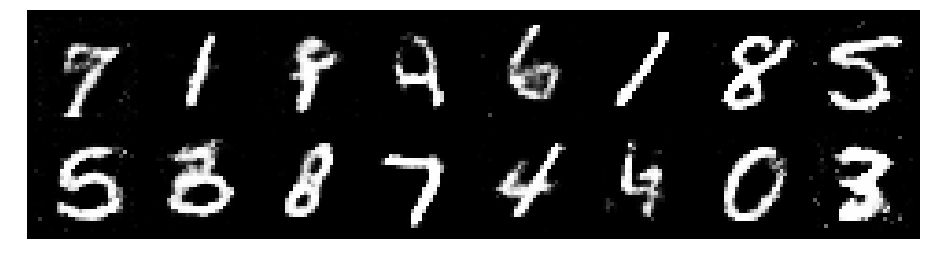

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3055, Generator Loss: 0.9361
D(x): 0.5229, D(G(z)): 0.4342


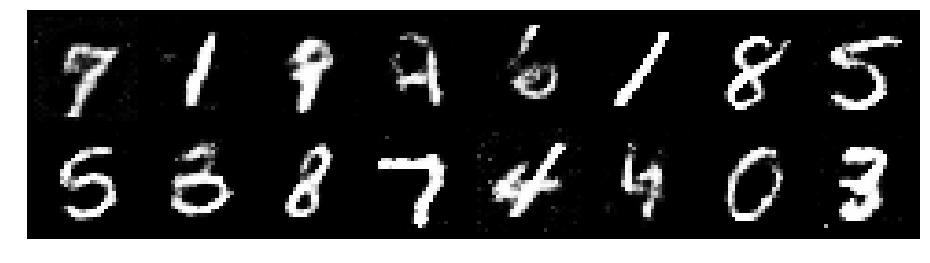

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.4007, Generator Loss: 0.9055
D(x): 0.5275, D(G(z)): 0.4805


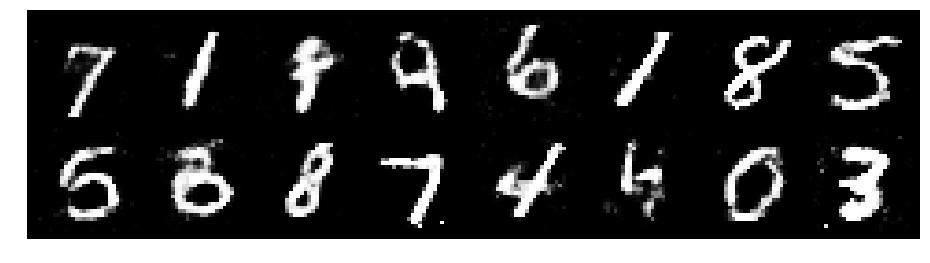

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.4328, Generator Loss: 0.7961
D(x): 0.5086, D(G(z)): 0.4765


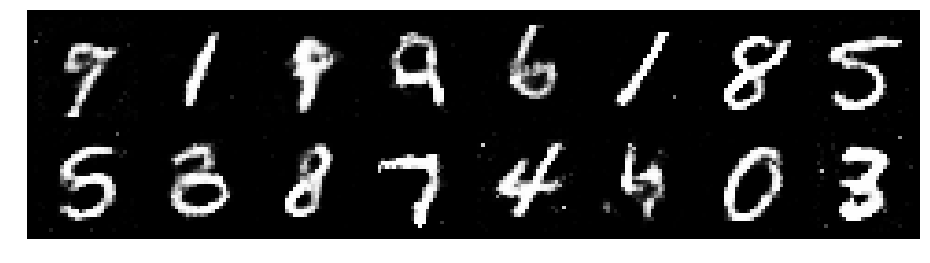

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.3220, Generator Loss: 0.9162
D(x): 0.5459, D(G(z)): 0.4503


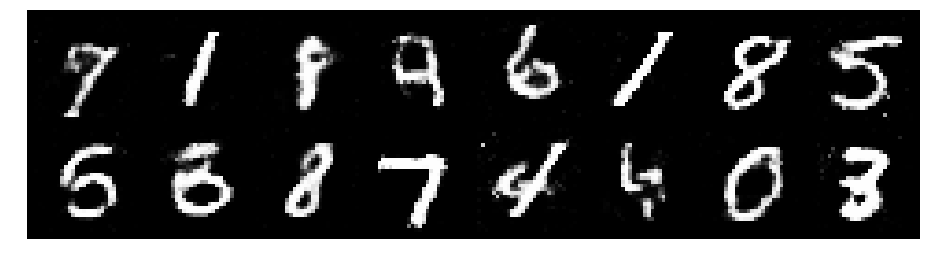

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.2290, Generator Loss: 0.9023
D(x): 0.5894, D(G(z)): 0.4337


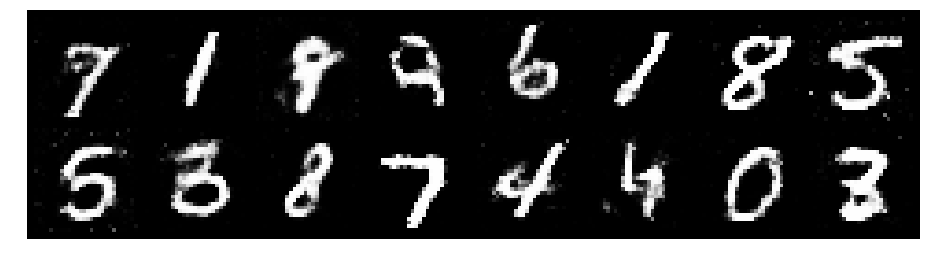

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3657, Generator Loss: 0.9033
D(x): 0.5732, D(G(z)): 0.4936


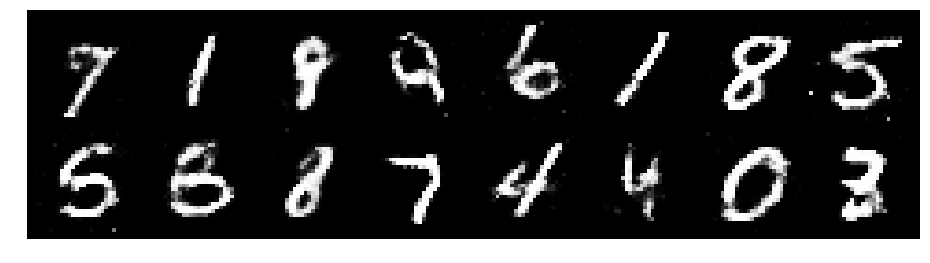

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3776, Generator Loss: 0.8964
D(x): 0.5538, D(G(z)): 0.4940


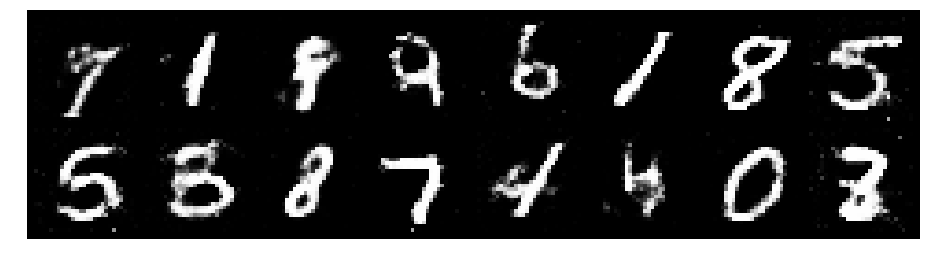

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.3739, Generator Loss: 0.9065
D(x): 0.5025, D(G(z)): 0.4623


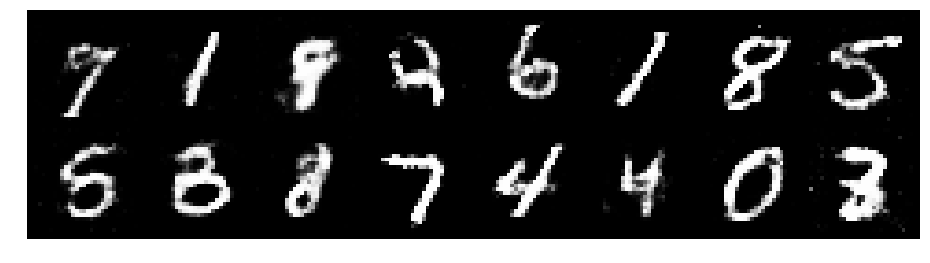

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2598, Generator Loss: 0.8480
D(x): 0.5369, D(G(z)): 0.4378


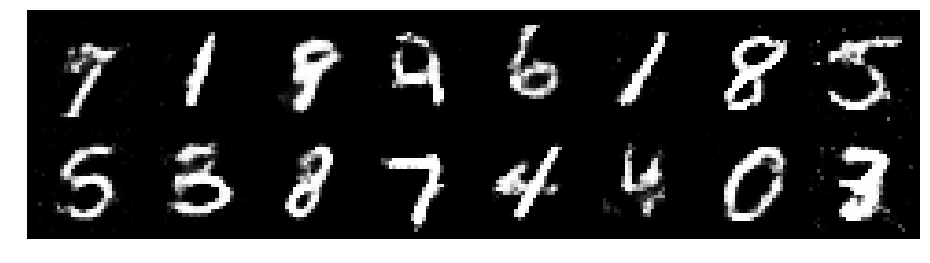

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.1460, Generator Loss: 1.0656
D(x): 0.5388, D(G(z)): 0.3523


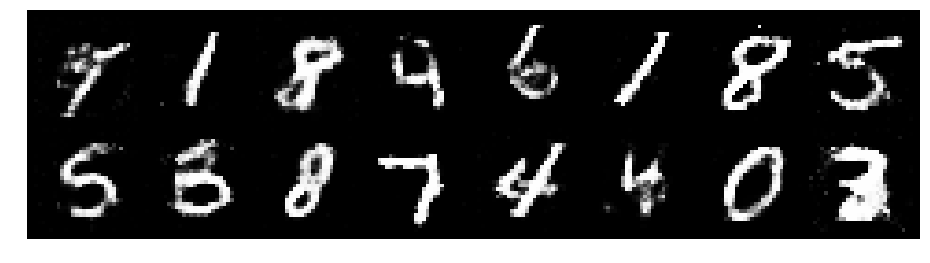

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2243, Generator Loss: 1.0692
D(x): 0.5248, D(G(z)): 0.3859


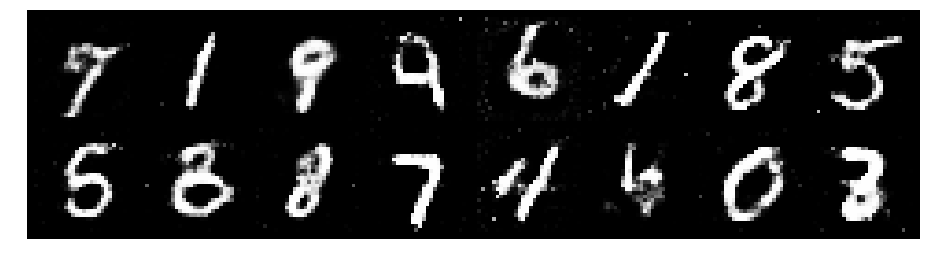

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2695, Generator Loss: 0.8950
D(x): 0.5376, D(G(z)): 0.4375


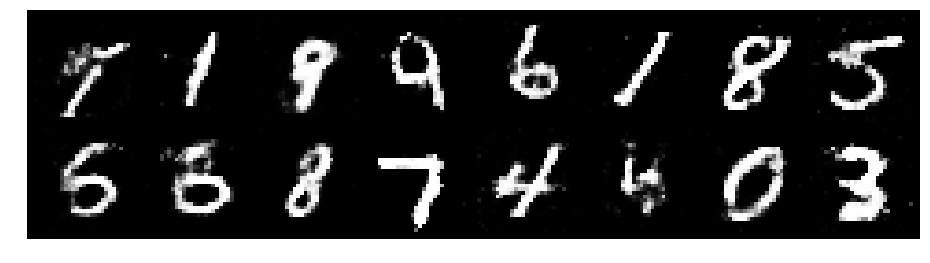

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.3062, Generator Loss: 0.9168
D(x): 0.5242, D(G(z)): 0.4411


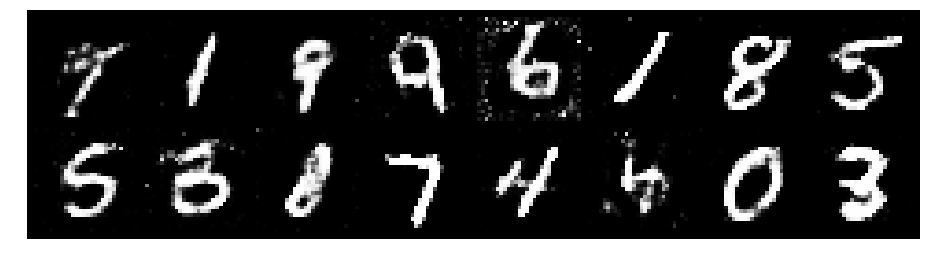

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2535, Generator Loss: 0.8575
D(x): 0.5332, D(G(z)): 0.4269


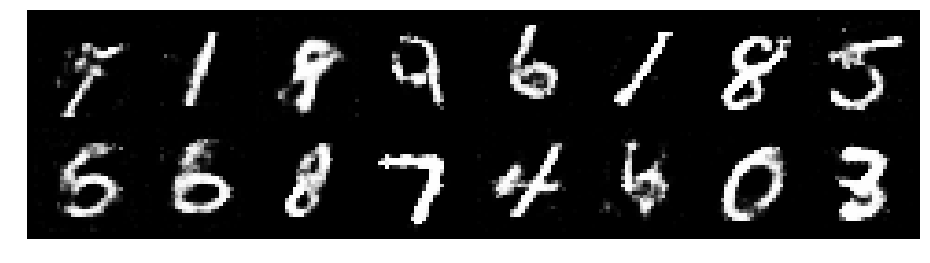

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8847
D(x): 0.5782, D(G(z)): 0.4762


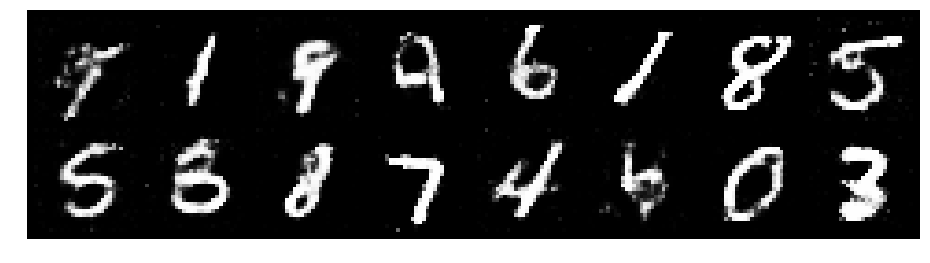

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.3308, Generator Loss: 0.8564
D(x): 0.5106, D(G(z)): 0.4247


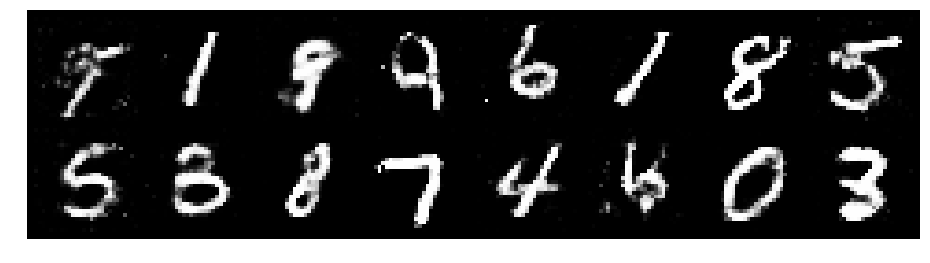

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2422, Generator Loss: 0.8689
D(x): 0.5533, D(G(z)): 0.4258


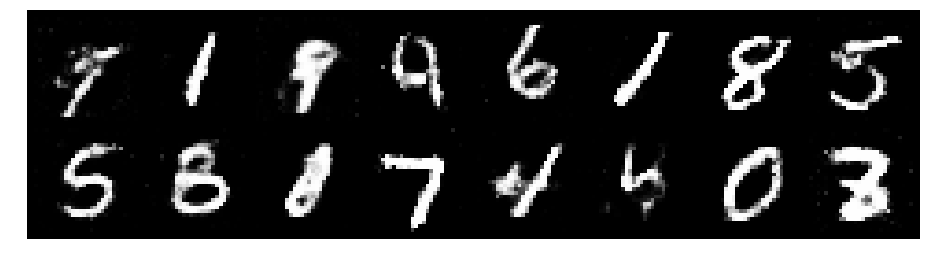

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2364, Generator Loss: 1.0030
D(x): 0.5435, D(G(z)): 0.4345


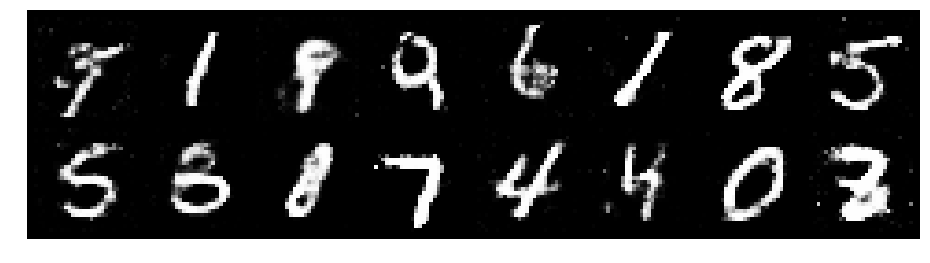

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.1976, Generator Loss: 1.0671
D(x): 0.5645, D(G(z)): 0.4174


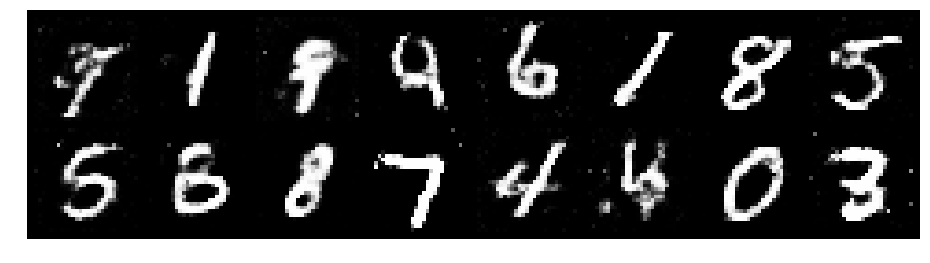

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.3581, Generator Loss: 0.7701
D(x): 0.5724, D(G(z)): 0.4883


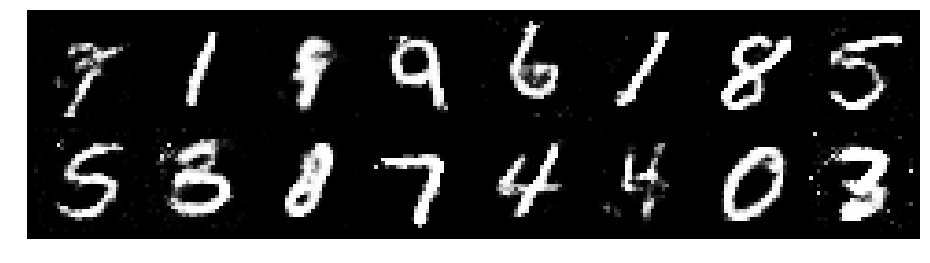

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.3315, Generator Loss: 0.7264
D(x): 0.5666, D(G(z)): 0.4805


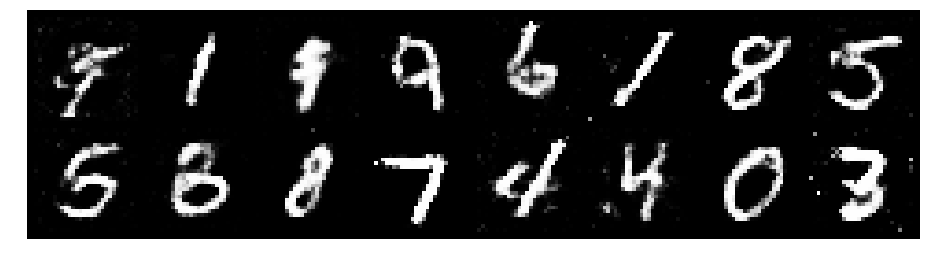

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.4363, Generator Loss: 0.8721
D(x): 0.5136, D(G(z)): 0.4827


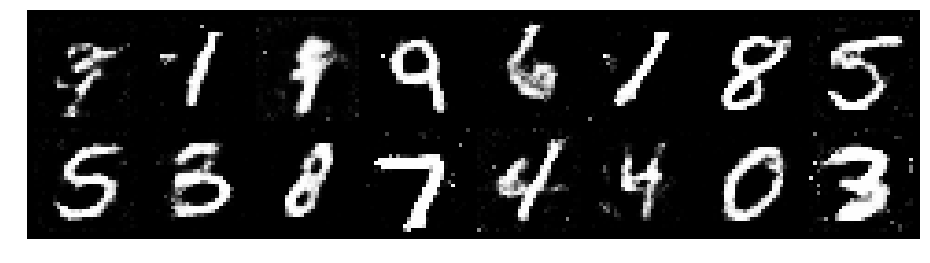

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.3470, Generator Loss: 0.8277
D(x): 0.5548, D(G(z)): 0.4845


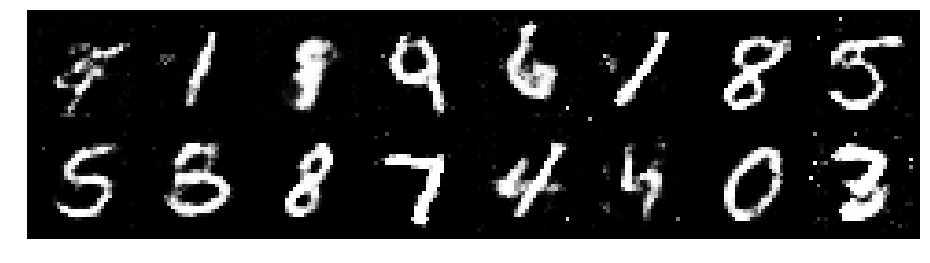

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3522, Generator Loss: 0.7932
D(x): 0.5422, D(G(z)): 0.4846


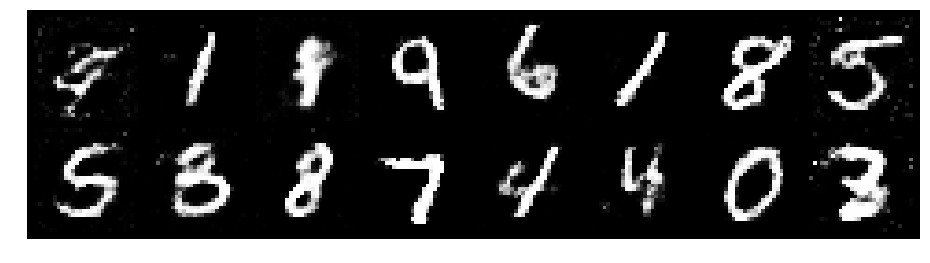

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3064, Generator Loss: 0.8585
D(x): 0.5475, D(G(z)): 0.4684


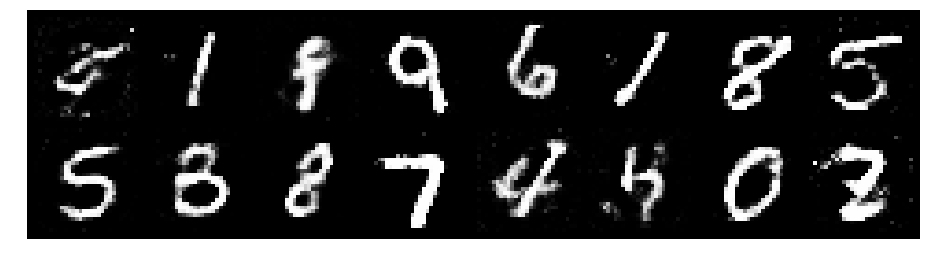

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.3820, Generator Loss: 0.8743
D(x): 0.4908, D(G(z)): 0.4399


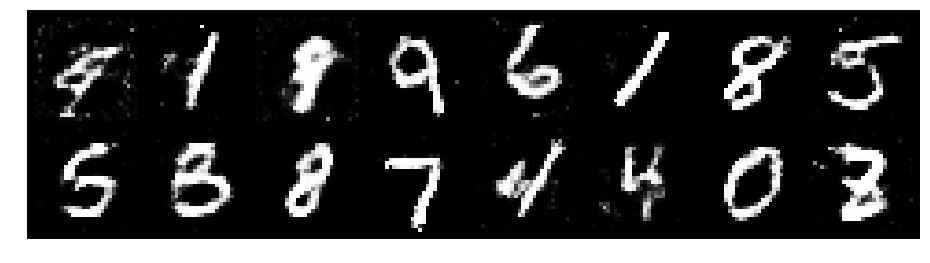

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2944, Generator Loss: 0.8044
D(x): 0.5737, D(G(z)): 0.4808


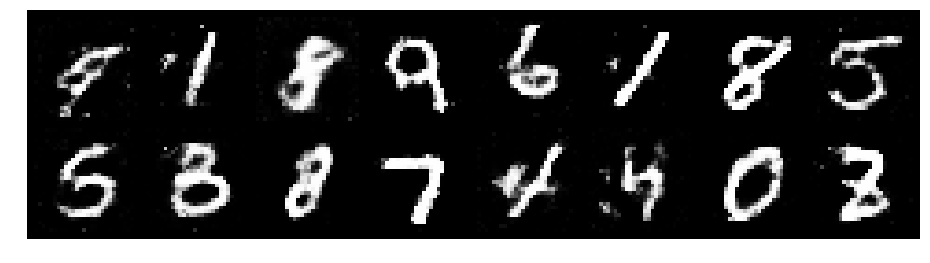

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3302, Generator Loss: 1.0599
D(x): 0.4942, D(G(z)): 0.3932


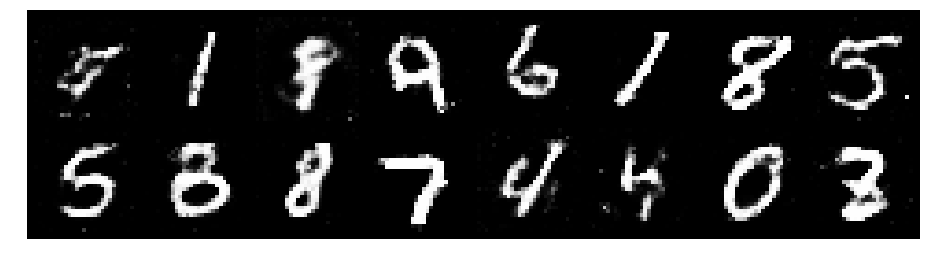

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3266, Generator Loss: 0.8705
D(x): 0.5322, D(G(z)): 0.4526


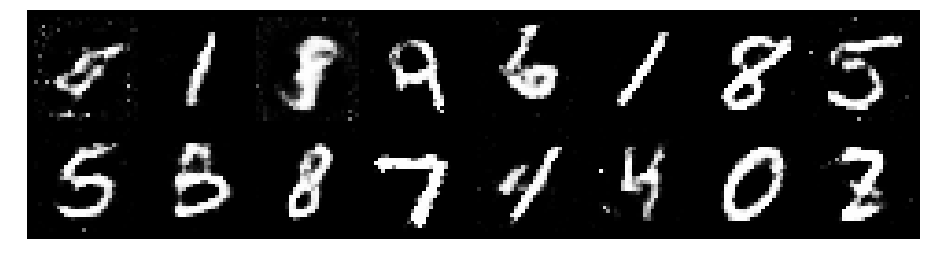

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.3607, Generator Loss: 0.8549
D(x): 0.5227, D(G(z)): 0.4700


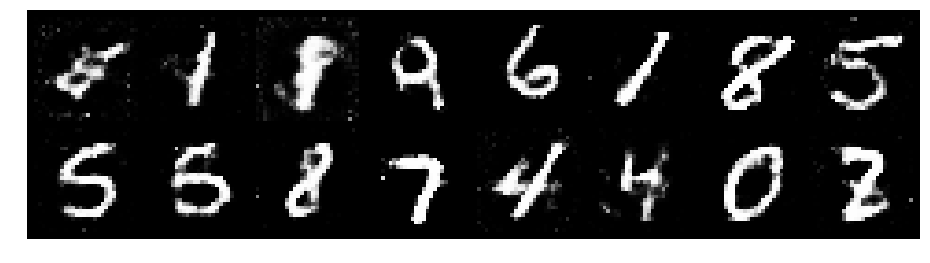

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2832, Generator Loss: 0.8318
D(x): 0.5349, D(G(z)): 0.4541


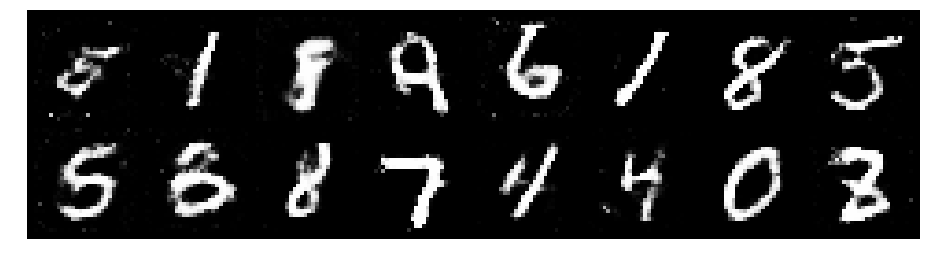

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2909, Generator Loss: 0.8892
D(x): 0.5539, D(G(z)): 0.4598


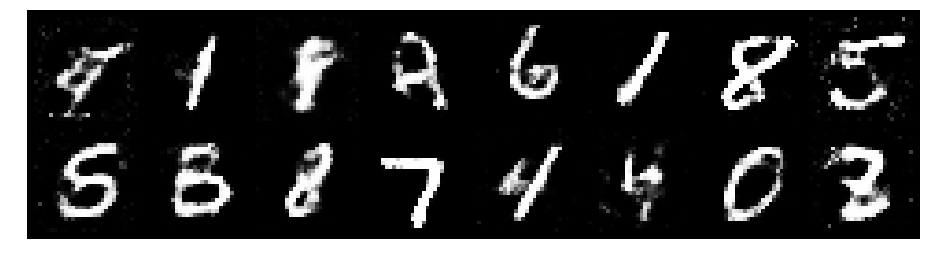

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2884, Generator Loss: 0.8653
D(x): 0.5211, D(G(z)): 0.4373


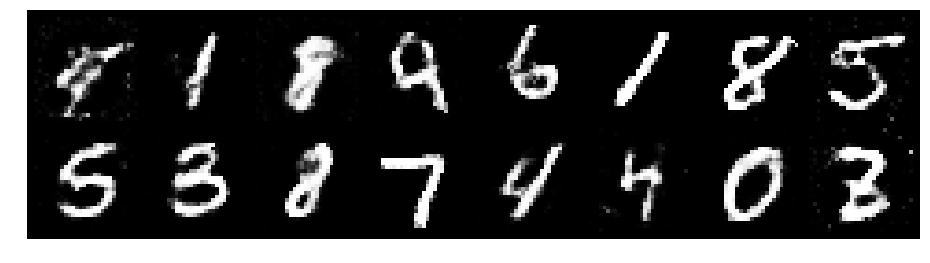

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.3285, Generator Loss: 0.8794
D(x): 0.5234, D(G(z)): 0.4436


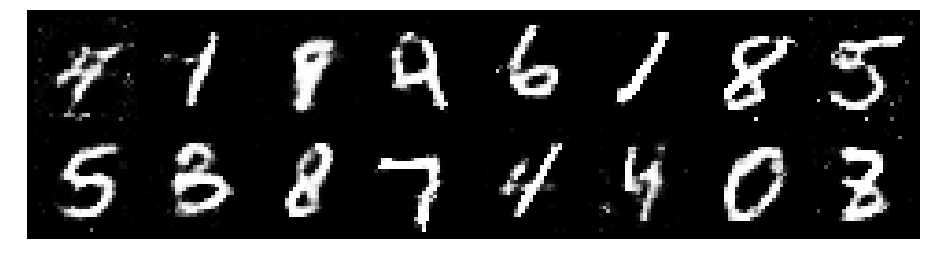

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.3790, Generator Loss: 0.9488
D(x): 0.5144, D(G(z)): 0.4549


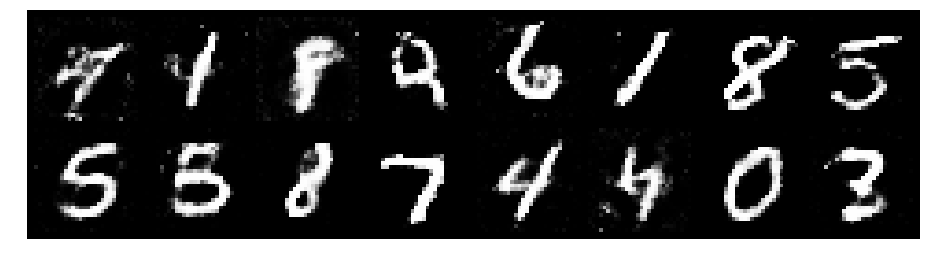

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.3805, Generator Loss: 0.8923
D(x): 0.5065, D(G(z)): 0.4492


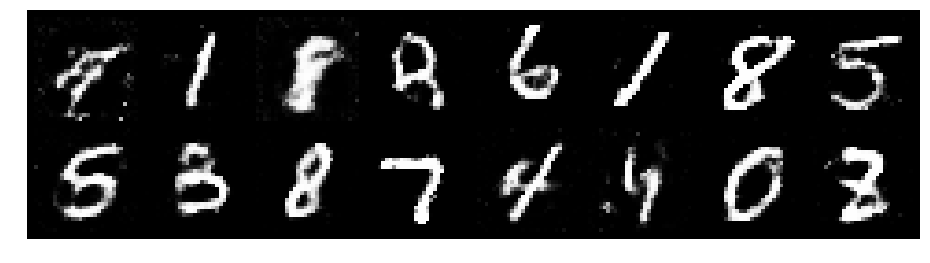

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.3304, Generator Loss: 0.8240
D(x): 0.5644, D(G(z)): 0.4872


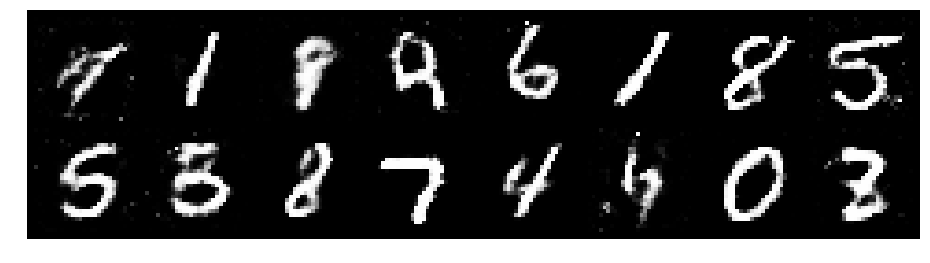

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.3138, Generator Loss: 0.8046
D(x): 0.5597, D(G(z)): 0.4803


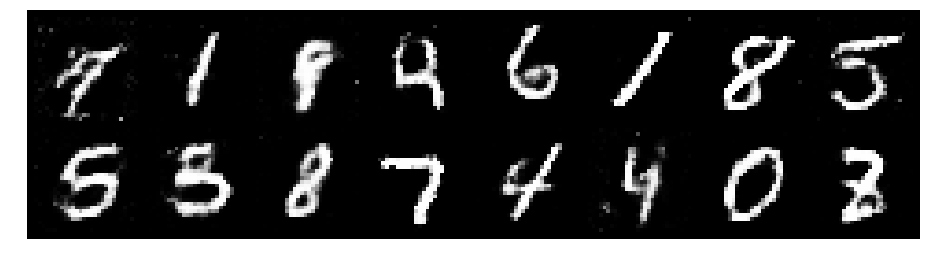

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.3623, Generator Loss: 0.8787
D(x): 0.5180, D(G(z)): 0.4491


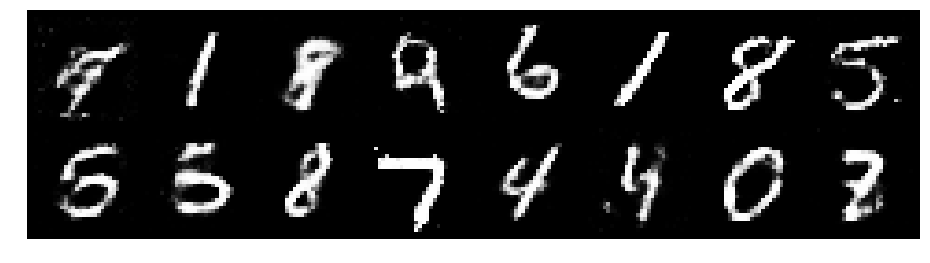

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2717, Generator Loss: 0.8354
D(x): 0.5787, D(G(z)): 0.4729


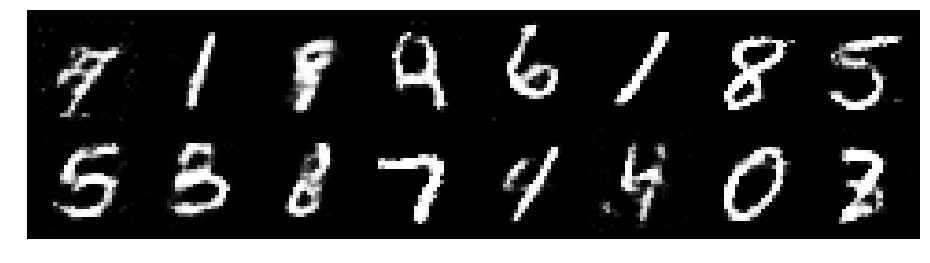

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8518
D(x): 0.5194, D(G(z)): 0.4572


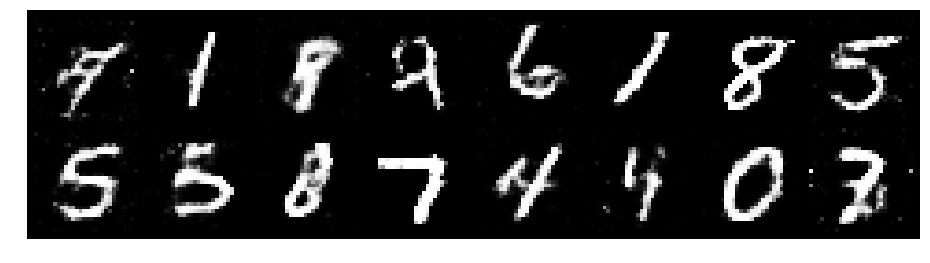

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.4164, Generator Loss: 0.8461
D(x): 0.5202, D(G(z)): 0.4918


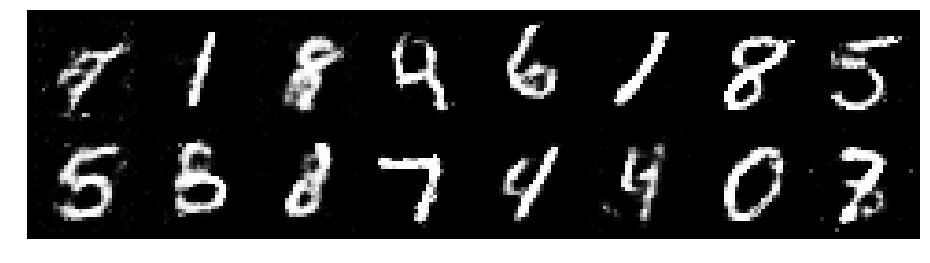

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.3322, Generator Loss: 0.7658
D(x): 0.5398, D(G(z)): 0.4795


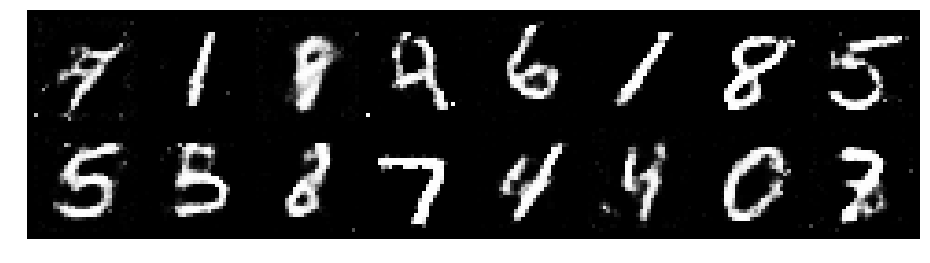

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.3007, Generator Loss: 0.8640
D(x): 0.5352, D(G(z)): 0.4381


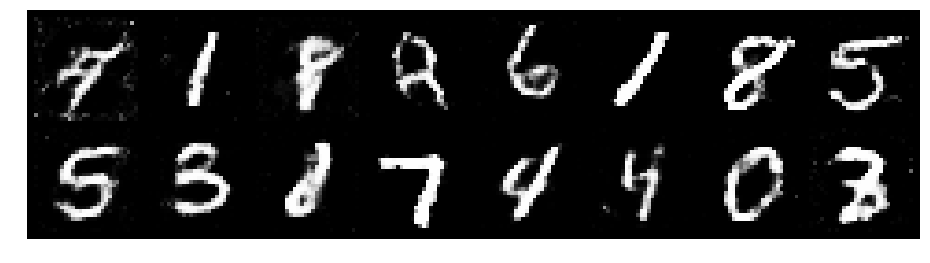

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.2780, Generator Loss: 0.9368
D(x): 0.5247, D(G(z)): 0.4154


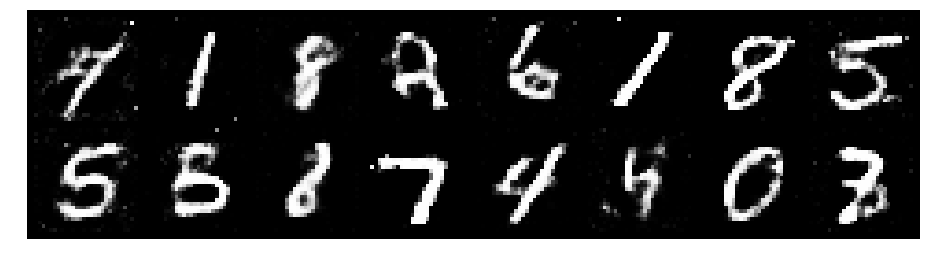

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2938, Generator Loss: 0.8577
D(x): 0.5372, D(G(z)): 0.4396


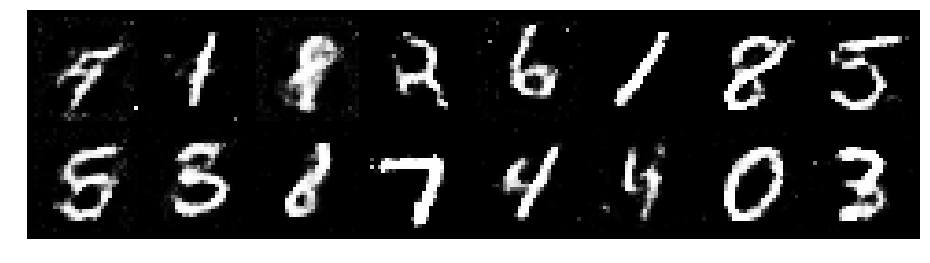

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.2105, Generator Loss: 0.9121
D(x): 0.5656, D(G(z)): 0.4230


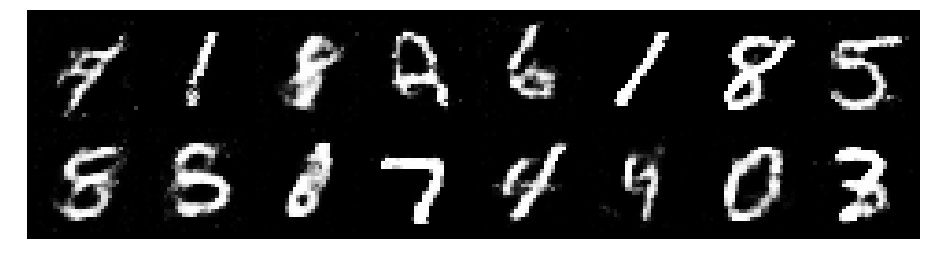

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9788
D(x): 0.5459, D(G(z)): 0.4073


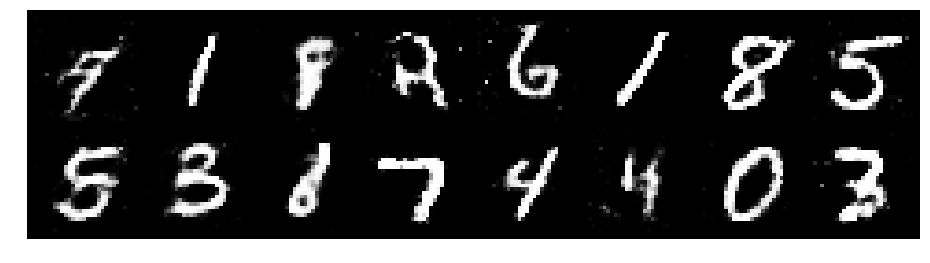

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.4016, Generator Loss: 0.8191
D(x): 0.5162, D(G(z)): 0.4723


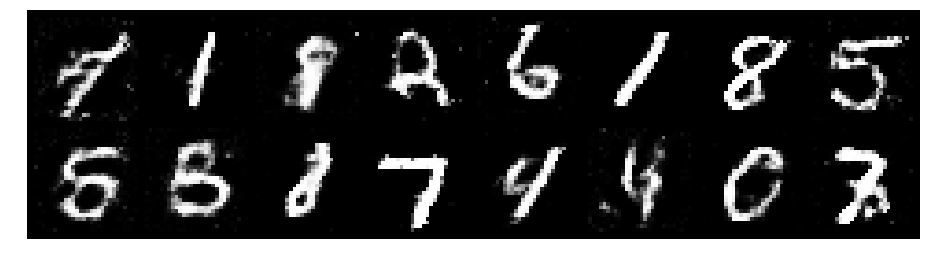

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3647, Generator Loss: 0.8132
D(x): 0.5239, D(G(z)): 0.4710


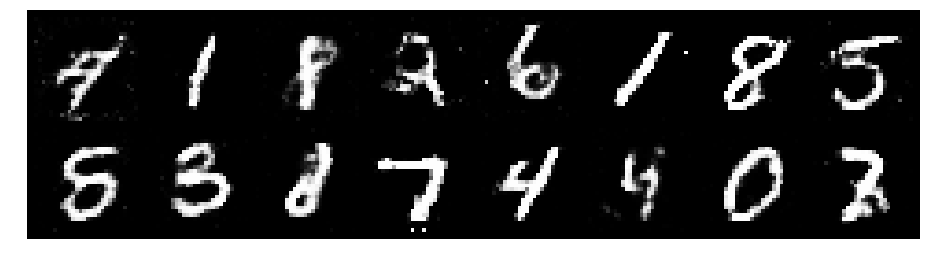

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2935, Generator Loss: 0.8870
D(x): 0.5351, D(G(z)): 0.4484


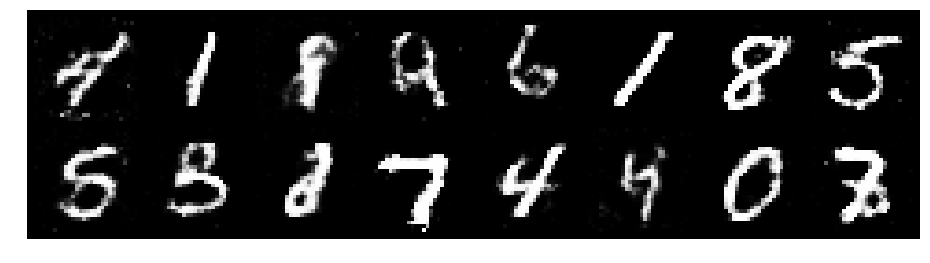

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8998
D(x): 0.5106, D(G(z)): 0.4174


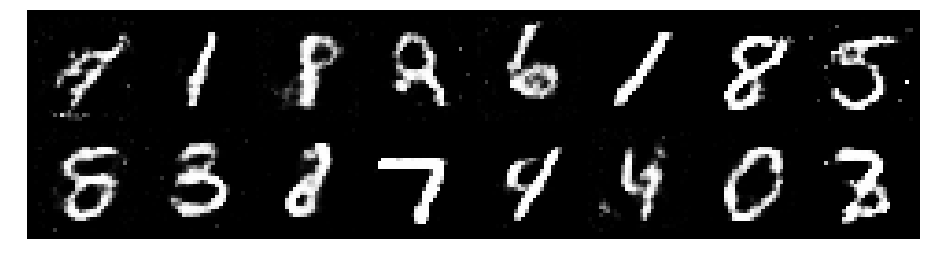

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9508
D(x): 0.5741, D(G(z)): 0.4293


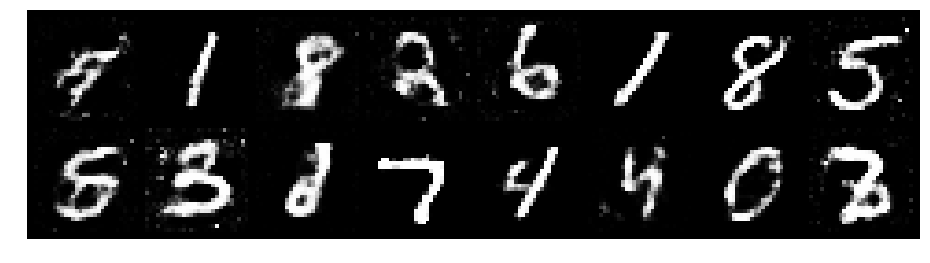

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.1946, Generator Loss: 1.0882
D(x): 0.5767, D(G(z)): 0.4084


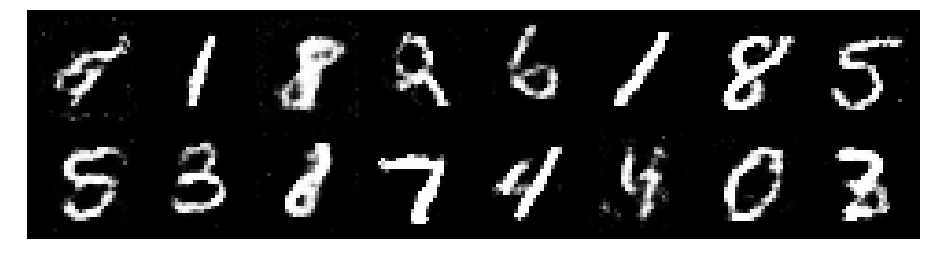

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2412, Generator Loss: 0.8055
D(x): 0.5780, D(G(z)): 0.4610


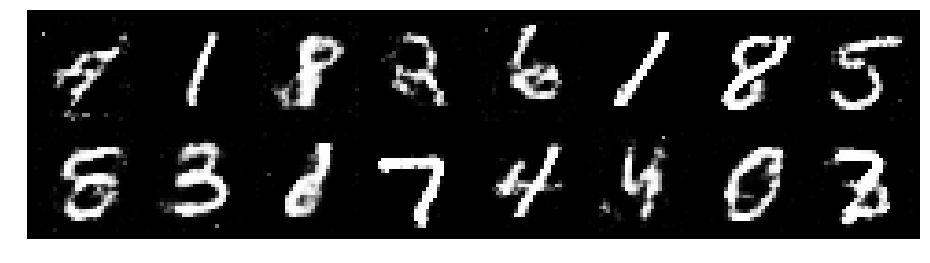

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2340, Generator Loss: 0.9079
D(x): 0.5660, D(G(z)): 0.4188


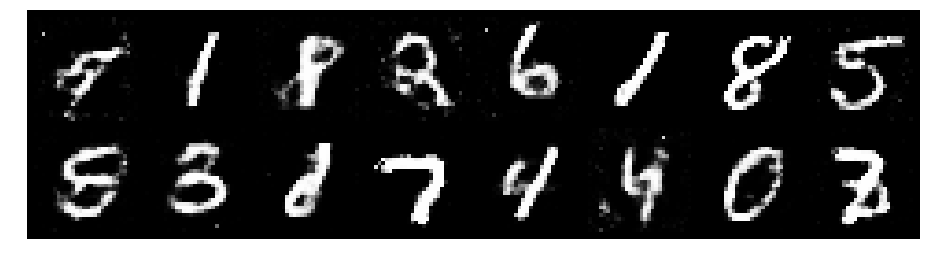

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.4326, Generator Loss: 0.8569
D(x): 0.5413, D(G(z)): 0.4892


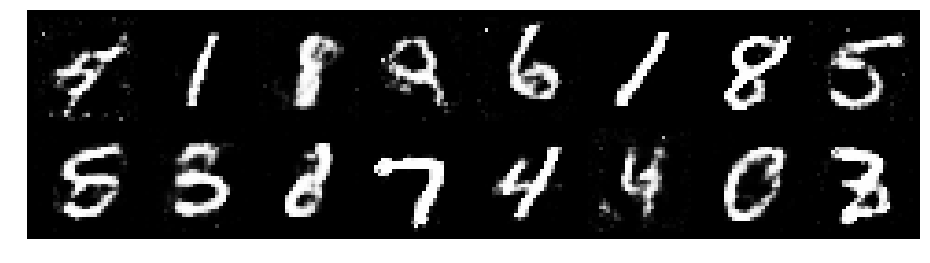

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3440, Generator Loss: 0.9433
D(x): 0.5265, D(G(z)): 0.4456


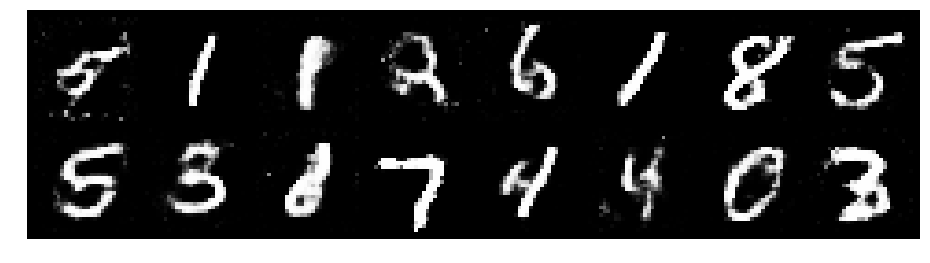

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.3184, Generator Loss: 0.9285
D(x): 0.5107, D(G(z)): 0.4235


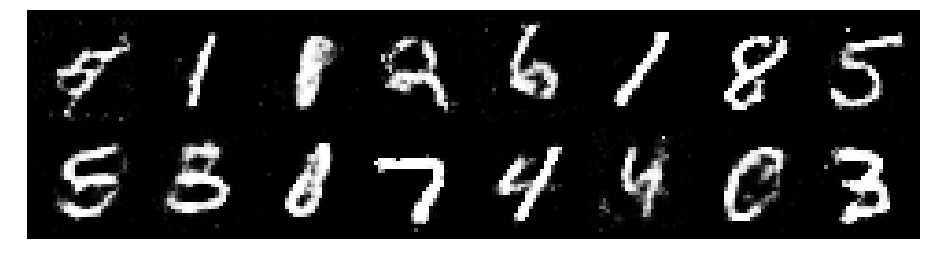

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.3044, Generator Loss: 0.9118
D(x): 0.5377, D(G(z)): 0.4420


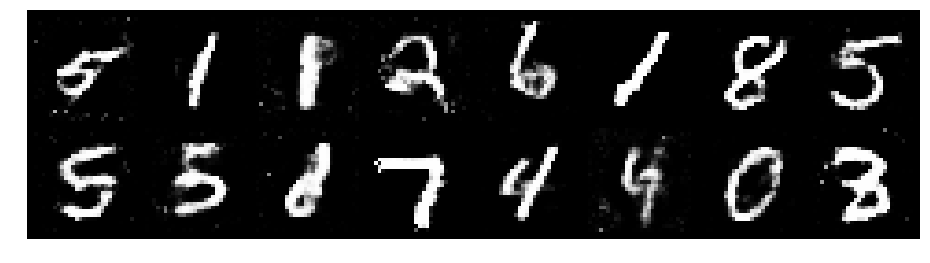

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2954, Generator Loss: 0.9462
D(x): 0.5212, D(G(z)): 0.4154


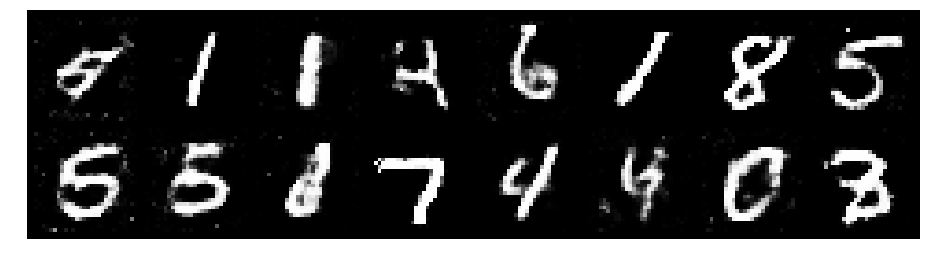

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.3246, Generator Loss: 0.9839
D(x): 0.5372, D(G(z)): 0.4363


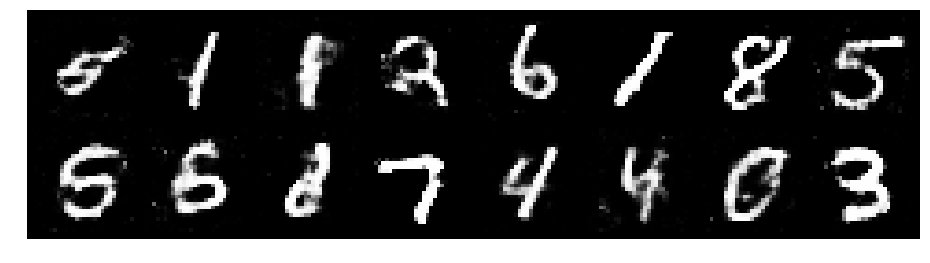

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.3412, Generator Loss: 0.8135
D(x): 0.5228, D(G(z)): 0.4410


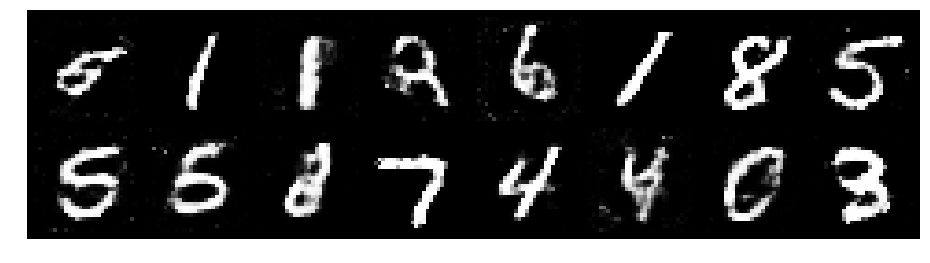

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.3748, Generator Loss: 0.7454
D(x): 0.5468, D(G(z)): 0.4990


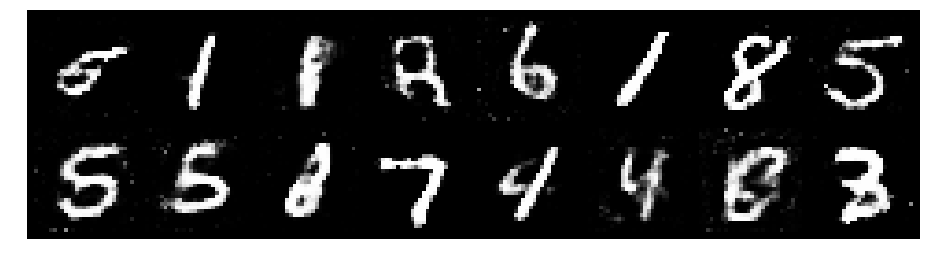

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2315, Generator Loss: 1.0026
D(x): 0.5385, D(G(z)): 0.4049


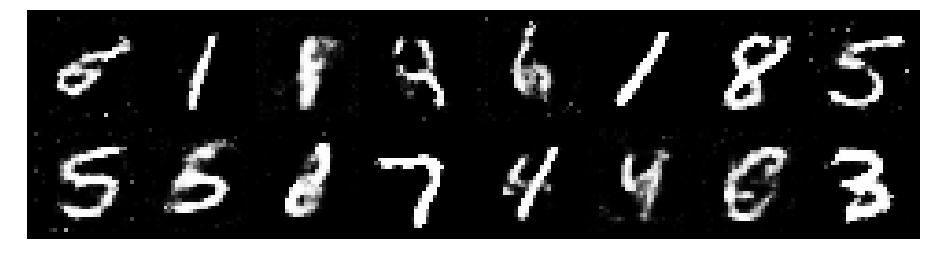

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3653, Generator Loss: 0.8579
D(x): 0.5016, D(G(z)): 0.4513


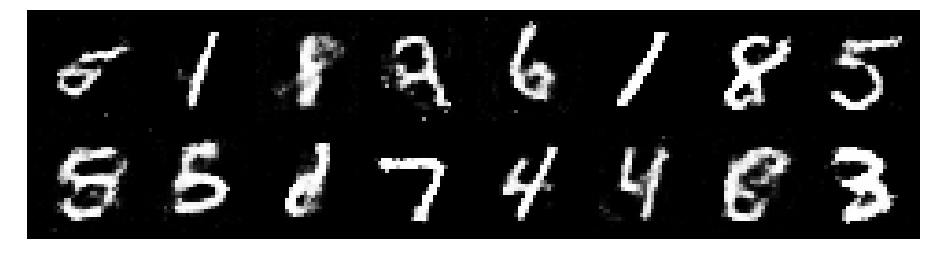

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.2805, Generator Loss: 0.7337
D(x): 0.5501, D(G(z)): 0.4674


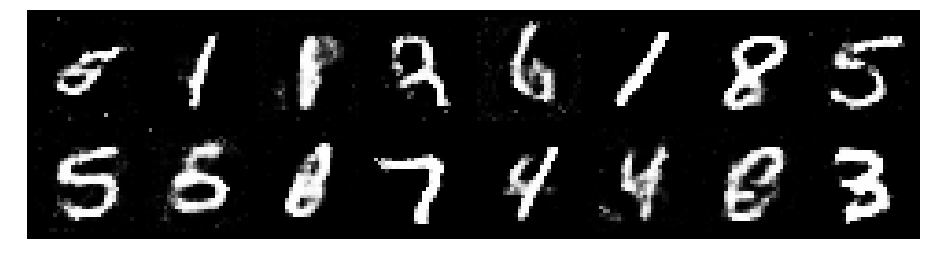

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3438, Generator Loss: 0.8571
D(x): 0.5304, D(G(z)): 0.4730


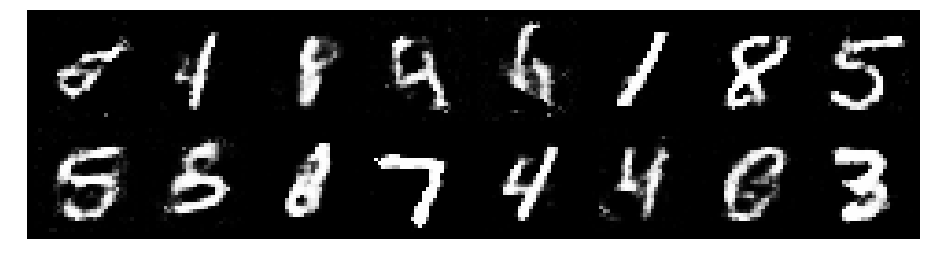

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2853, Generator Loss: 0.9317
D(x): 0.5311, D(G(z)): 0.4283


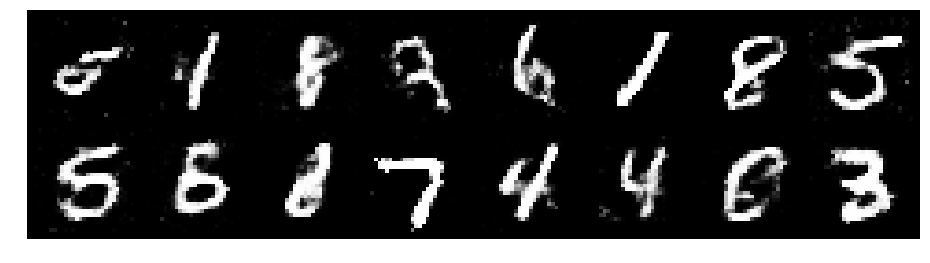

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2159, Generator Loss: 0.8989
D(x): 0.5366, D(G(z)): 0.3846


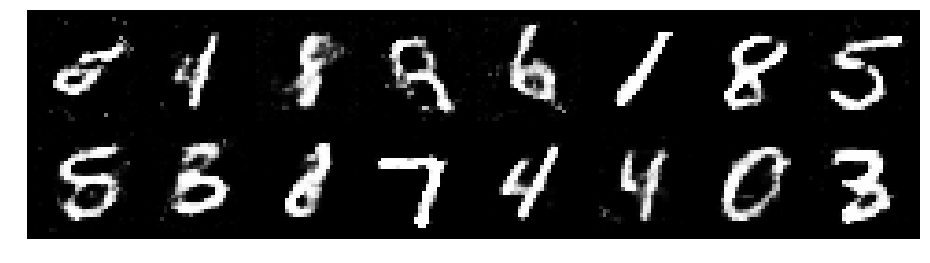

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.3997, Generator Loss: 0.8654
D(x): 0.5215, D(G(z)): 0.4529


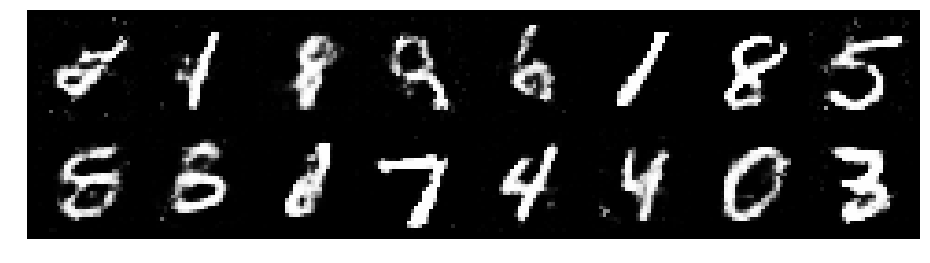

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3431, Generator Loss: 0.8746
D(x): 0.4883, D(G(z)): 0.4027


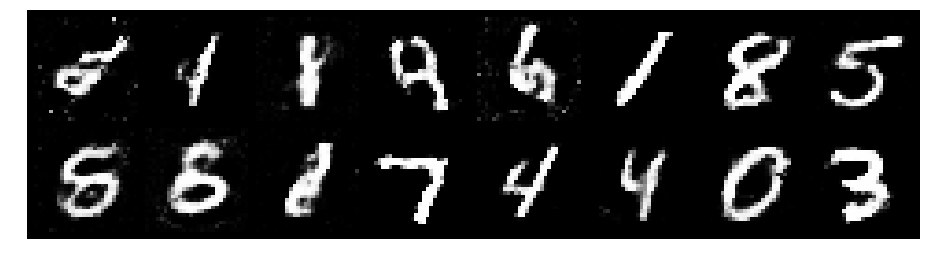

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.3303, Generator Loss: 0.9437
D(x): 0.5452, D(G(z)): 0.4543


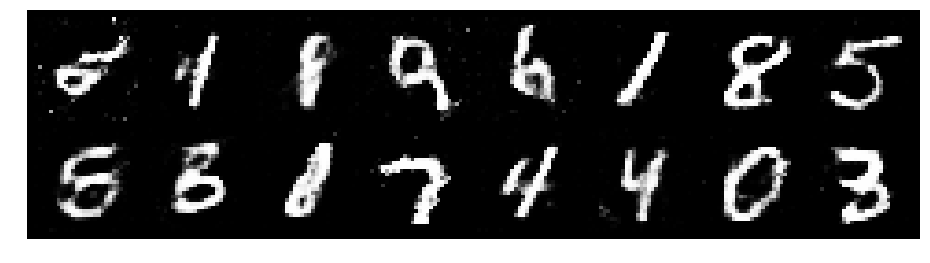

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9301
D(x): 0.5551, D(G(z)): 0.4198


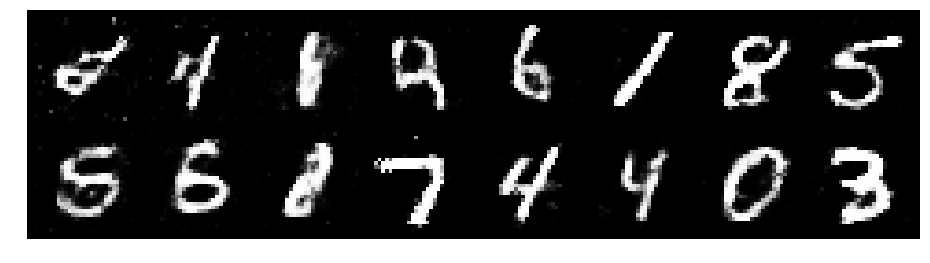

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2305, Generator Loss: 0.8680
D(x): 0.5824, D(G(z)): 0.4582


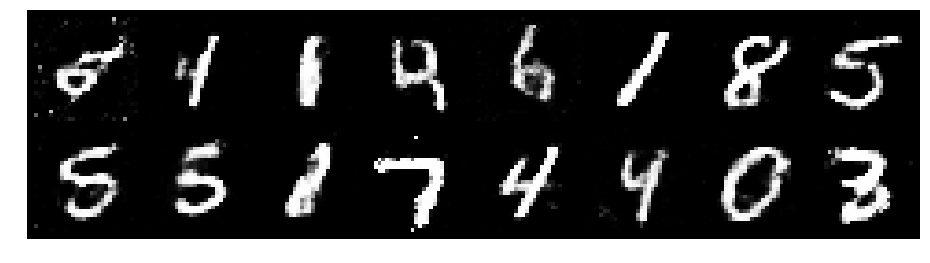

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2262, Generator Loss: 0.9607
D(x): 0.5520, D(G(z)): 0.3994


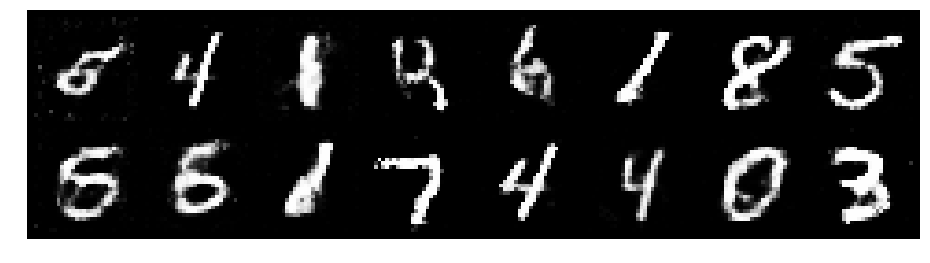

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.1794, Generator Loss: 1.1889
D(x): 0.5927, D(G(z)): 0.4175


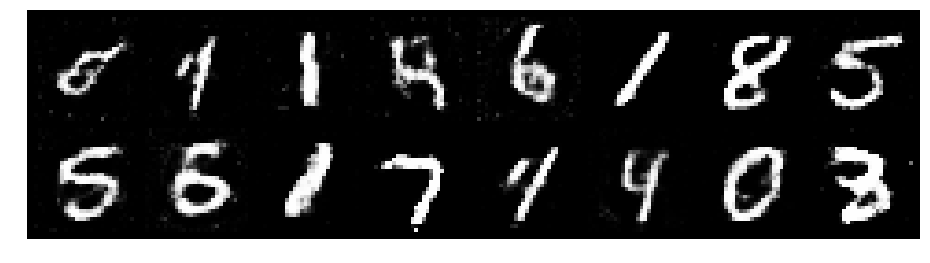

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.3950, Generator Loss: 0.8658
D(x): 0.5748, D(G(z)): 0.4944


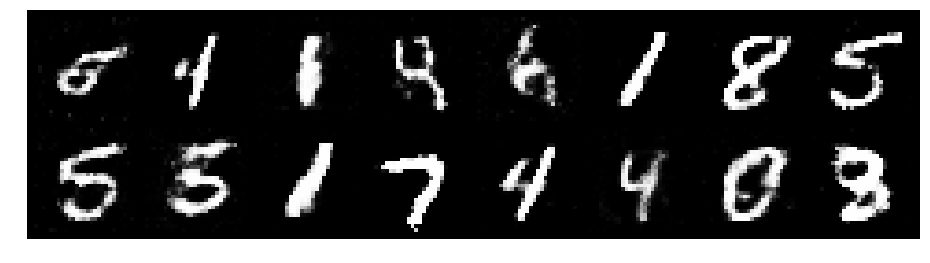

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.3808, Generator Loss: 0.8535
D(x): 0.5577, D(G(z)): 0.4840


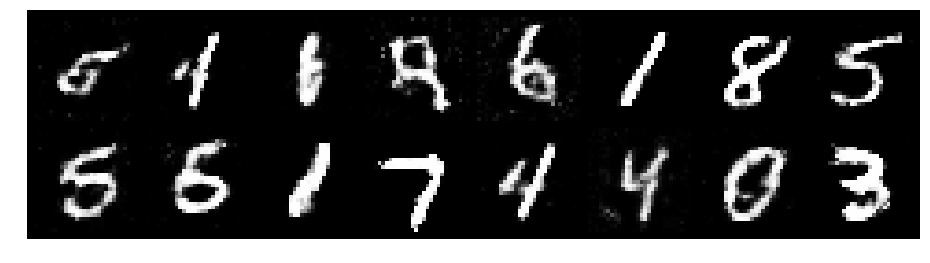

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.3155, Generator Loss: 0.7574
D(x): 0.5423, D(G(z)): 0.4728


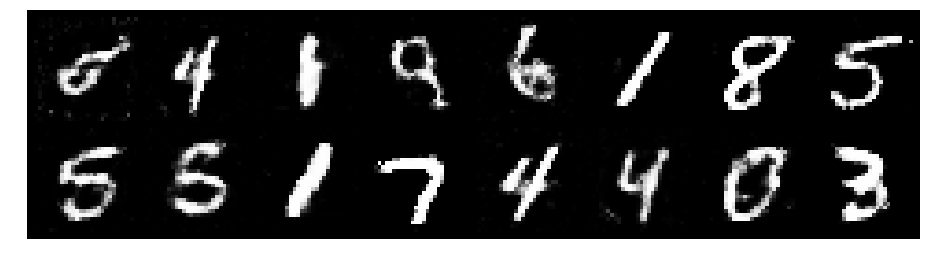

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2195, Generator Loss: 0.7900
D(x): 0.5779, D(G(z)): 0.4382


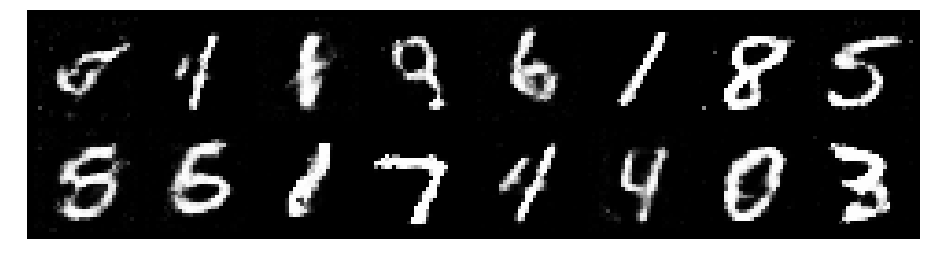

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.2631, Generator Loss: 0.8157
D(x): 0.5558, D(G(z)): 0.4495


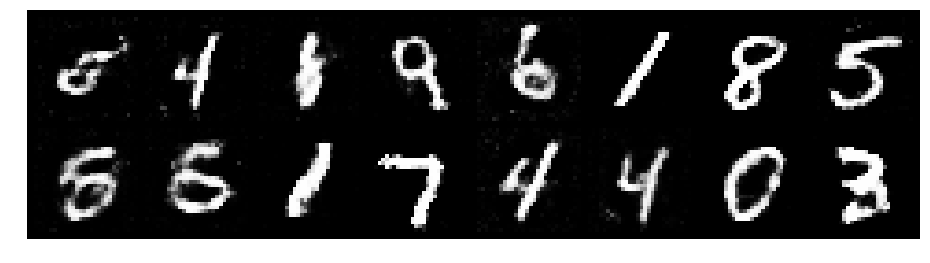

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.1982, Generator Loss: 0.8598
D(x): 0.5894, D(G(z)): 0.4443


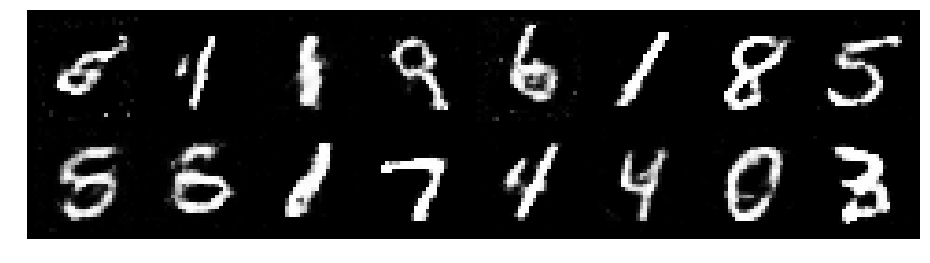

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2753, Generator Loss: 0.9343
D(x): 0.5601, D(G(z)): 0.4560


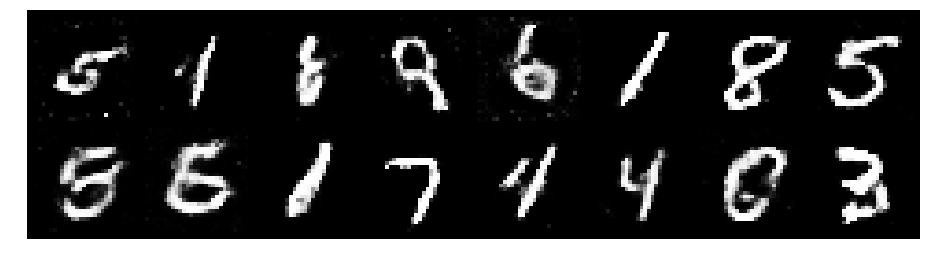

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.3821, Generator Loss: 0.7563
D(x): 0.5237, D(G(z)): 0.4828


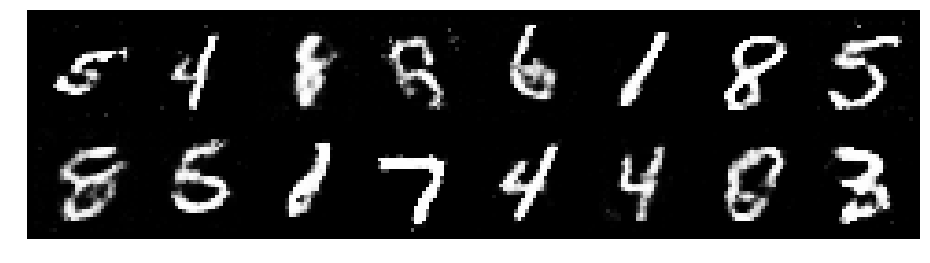

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.3082, Generator Loss: 0.8496
D(x): 0.5126, D(G(z)): 0.4337


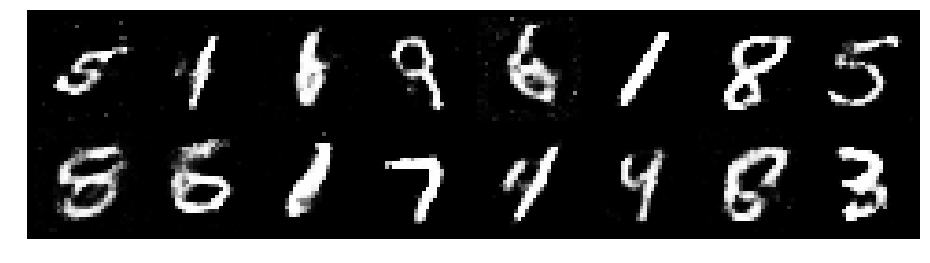

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2382, Generator Loss: 0.9940
D(x): 0.5305, D(G(z)): 0.4145


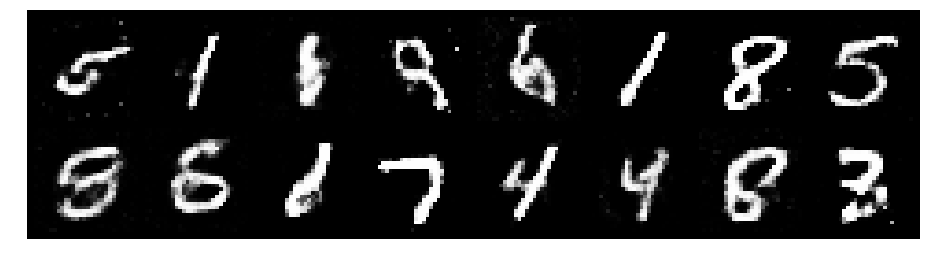

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2364, Generator Loss: 0.9712
D(x): 0.5516, D(G(z)): 0.4298


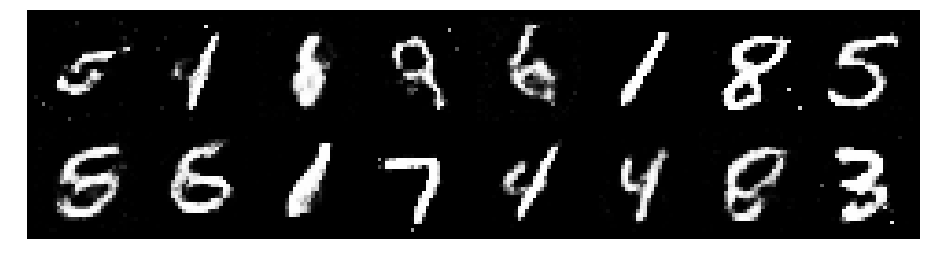

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.1862, Generator Loss: 0.8832
D(x): 0.5589, D(G(z)): 0.4282


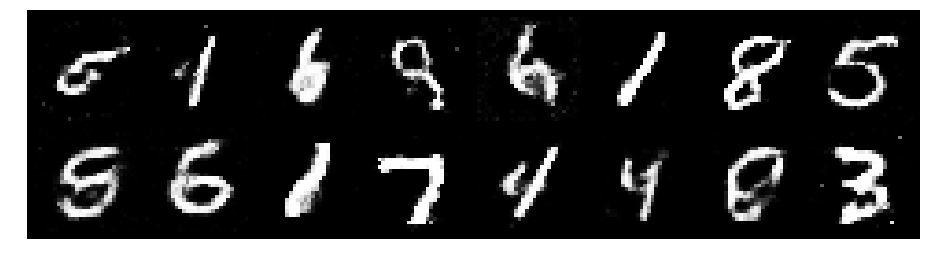

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2181, Generator Loss: 1.1459
D(x): 0.5498, D(G(z)): 0.4052


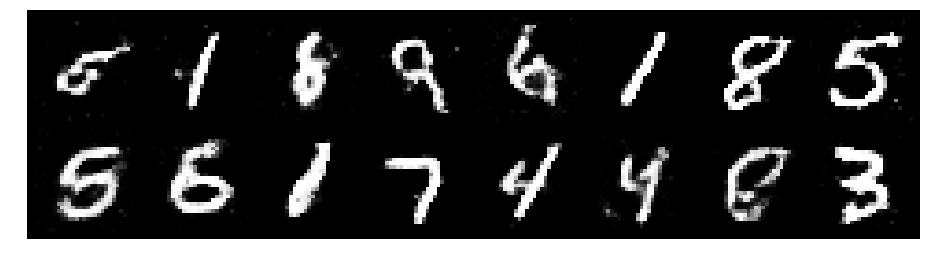

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.2899, Generator Loss: 0.8799
D(x): 0.5275, D(G(z)): 0.4447


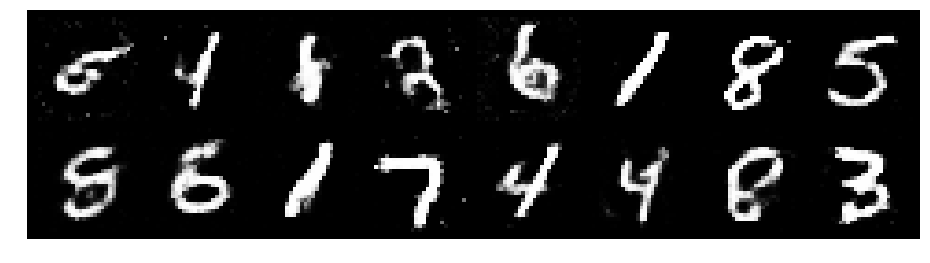

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.3169, Generator Loss: 0.8420
D(x): 0.5468, D(G(z)): 0.4561


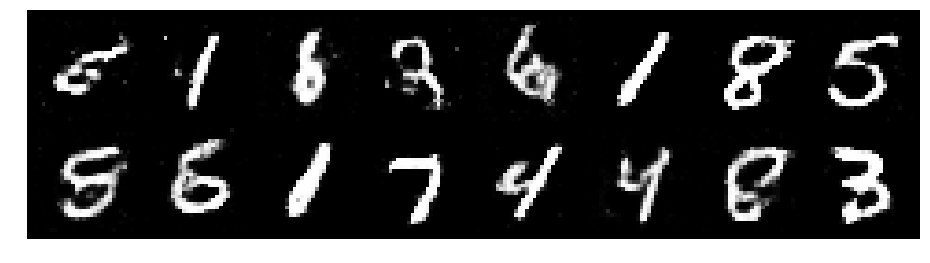

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3846, Generator Loss: 0.8428
D(x): 0.5574, D(G(z)): 0.4832


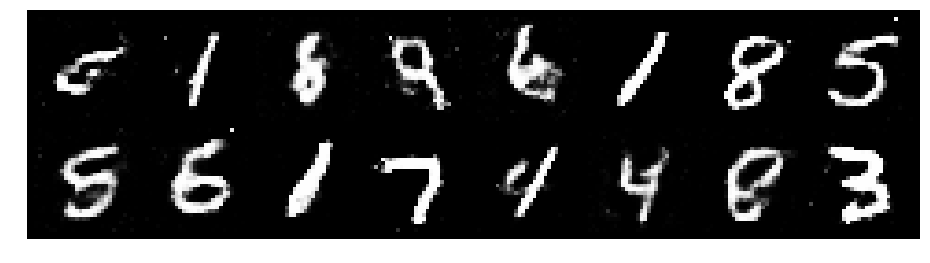

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3736, Generator Loss: 0.9741
D(x): 0.5173, D(G(z)): 0.4474


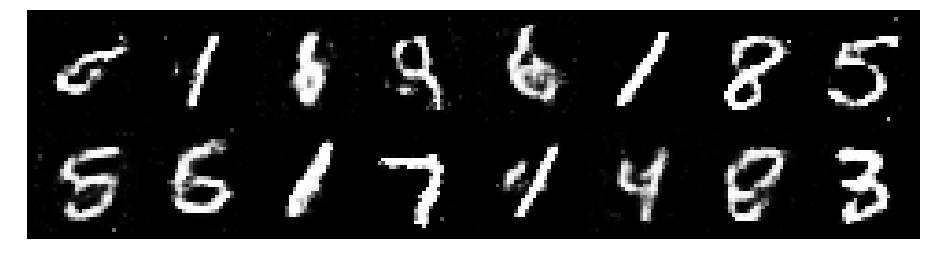

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.3957, Generator Loss: 0.8493
D(x): 0.5333, D(G(z)): 0.4945


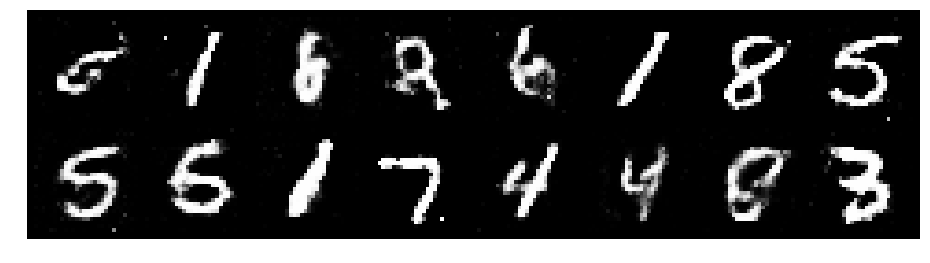

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2330, Generator Loss: 0.8716
D(x): 0.5556, D(G(z)): 0.4441


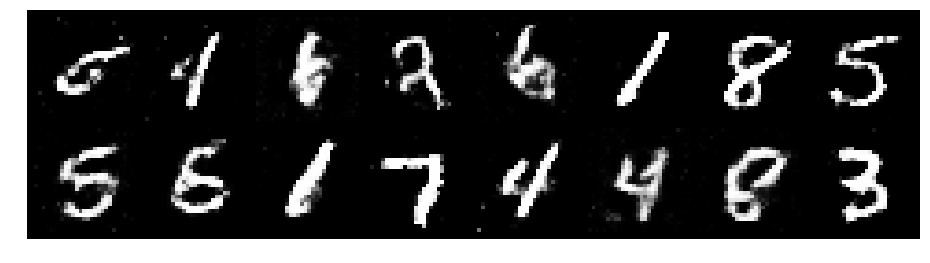

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2788, Generator Loss: 0.8131
D(x): 0.5284, D(G(z)): 0.4448


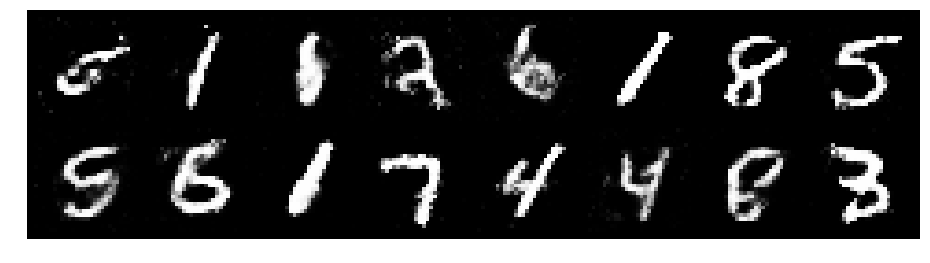

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2026, Generator Loss: 0.9179
D(x): 0.5370, D(G(z)): 0.3994


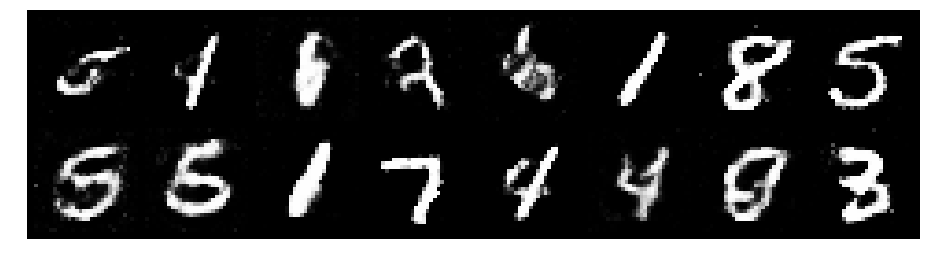

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9742
D(x): 0.5317, D(G(z)): 0.4049


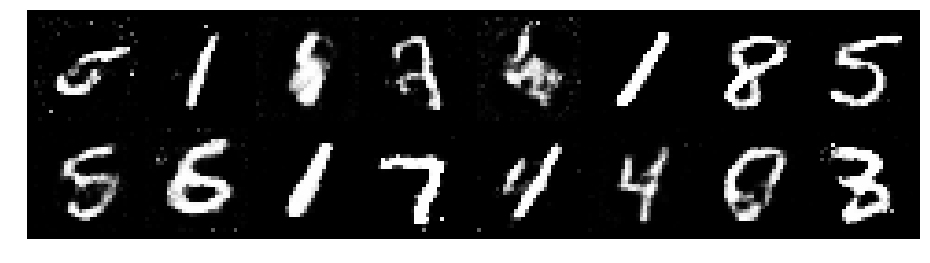

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2667, Generator Loss: 0.9830
D(x): 0.5447, D(G(z)): 0.4365


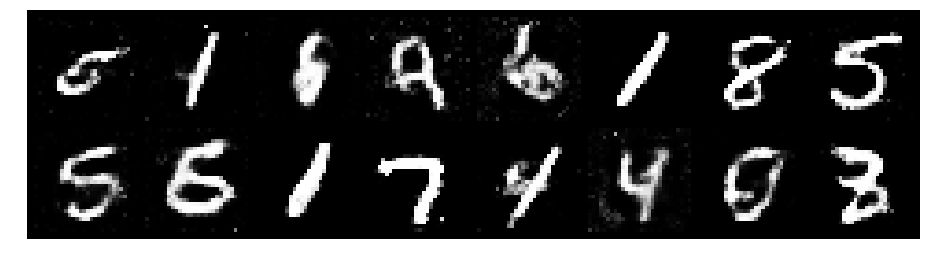

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.2453, Generator Loss: 0.9084
D(x): 0.5535, D(G(z)): 0.4340


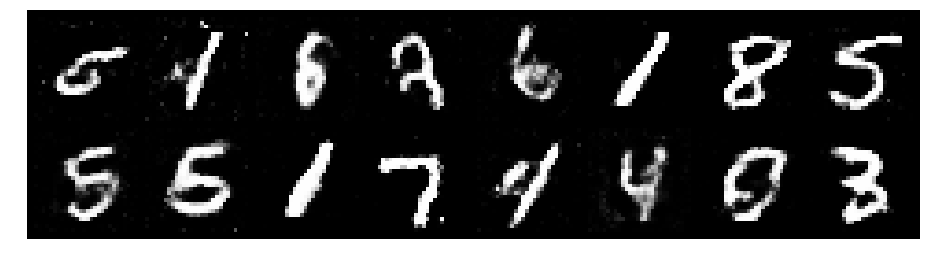

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2822, Generator Loss: 0.8480
D(x): 0.5738, D(G(z)): 0.4681


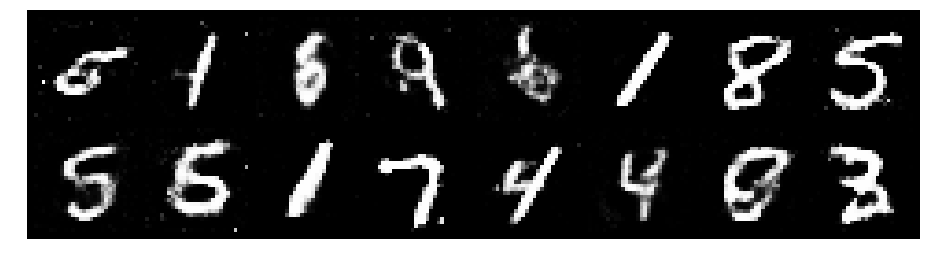

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3782, Generator Loss: 0.8028
D(x): 0.5563, D(G(z)): 0.4949


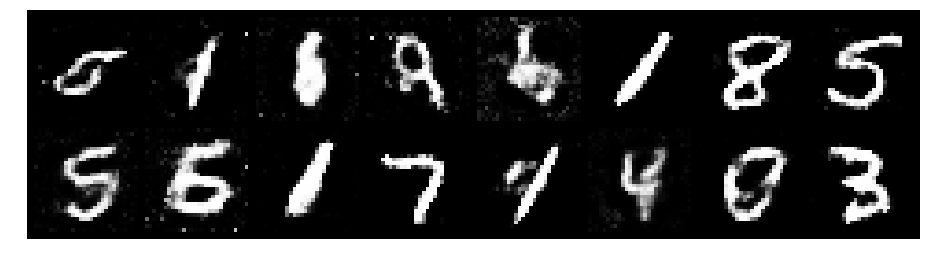

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.3651, Generator Loss: 0.8050
D(x): 0.5812, D(G(z)): 0.5138


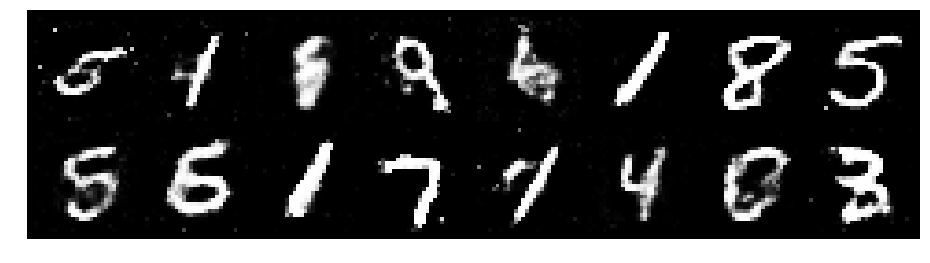

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.3534, Generator Loss: 0.9490
D(x): 0.4961, D(G(z)): 0.4099


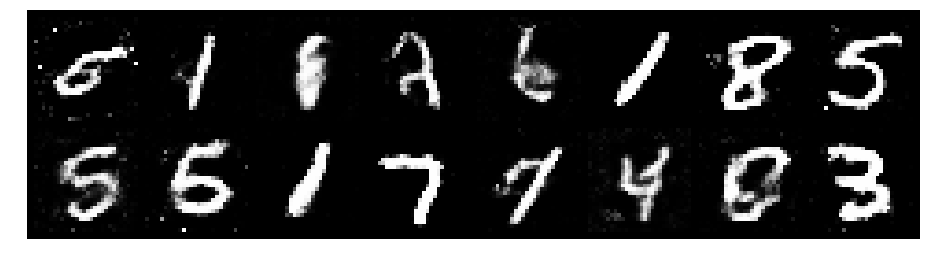

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2382, Generator Loss: 1.0766
D(x): 0.5586, D(G(z)): 0.4255


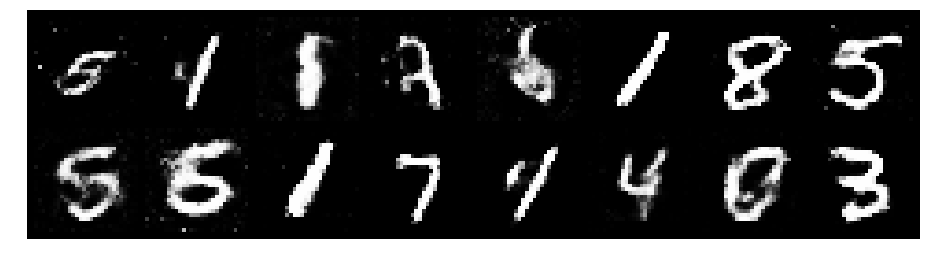

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2439, Generator Loss: 0.8273
D(x): 0.5757, D(G(z)): 0.4668


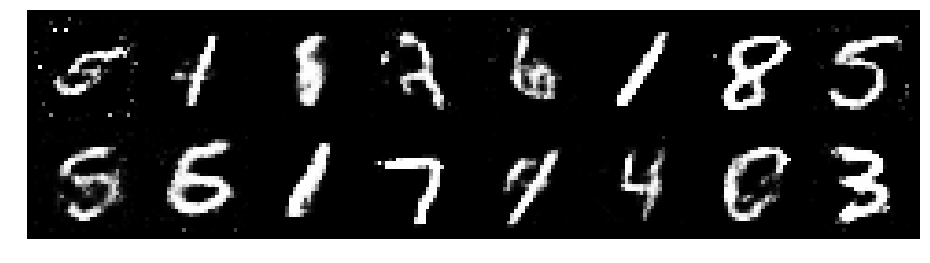

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.3084, Generator Loss: 1.0182
D(x): 0.5053, D(G(z)): 0.4098


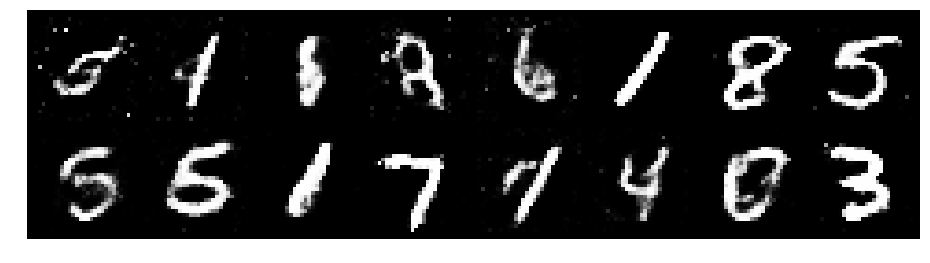

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2891, Generator Loss: 0.8614
D(x): 0.5518, D(G(z)): 0.4552


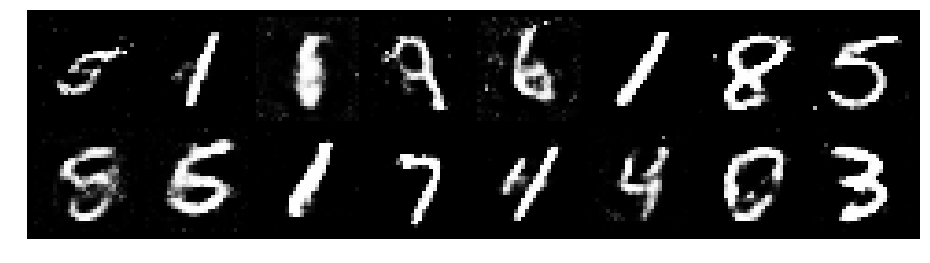

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.3138, Generator Loss: 0.9591
D(x): 0.5284, D(G(z)): 0.4186


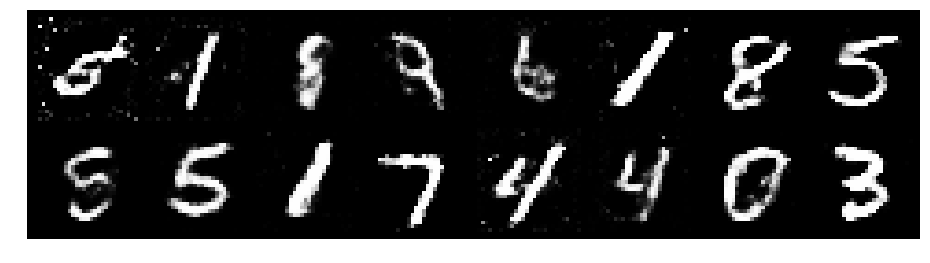

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3603, Generator Loss: 0.7917
D(x): 0.5308, D(G(z)): 0.4662


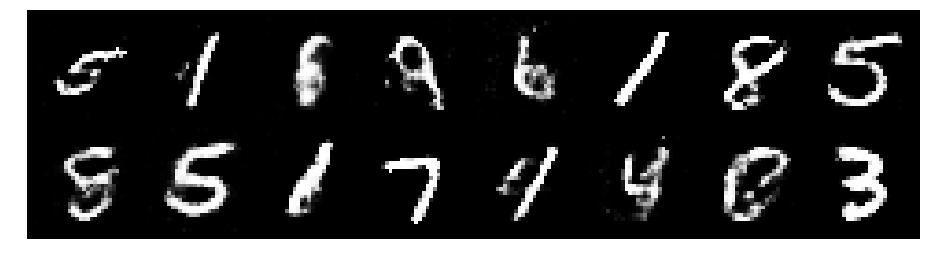

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.3610, Generator Loss: 0.8450
D(x): 0.5288, D(G(z)): 0.4660


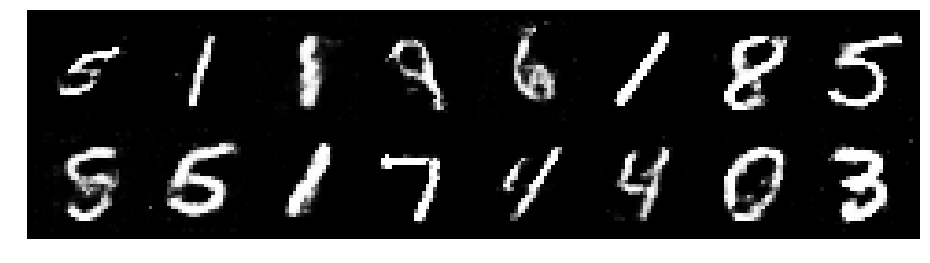

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.2505, Generator Loss: 0.9619
D(x): 0.5183, D(G(z)): 0.4038


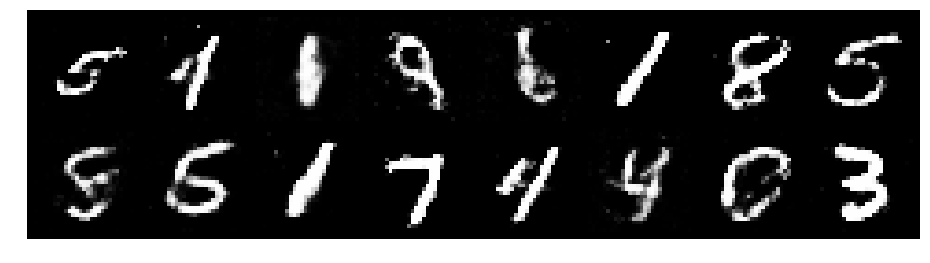

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.2212, Generator Loss: 0.8779
D(x): 0.5556, D(G(z)): 0.4313


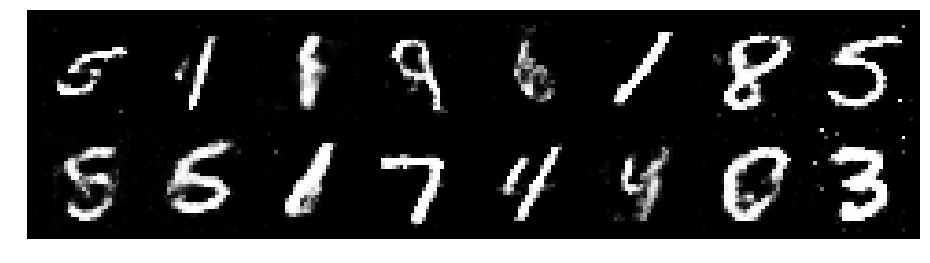

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.1904, Generator Loss: 0.9535
D(x): 0.5708, D(G(z)): 0.4156


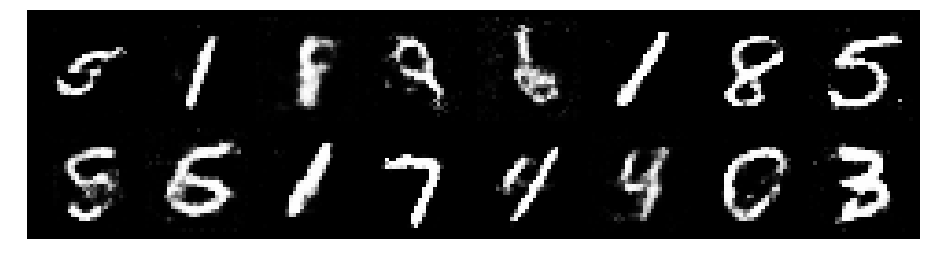

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.1644, Generator Loss: 0.9353
D(x): 0.5496, D(G(z)): 0.3938


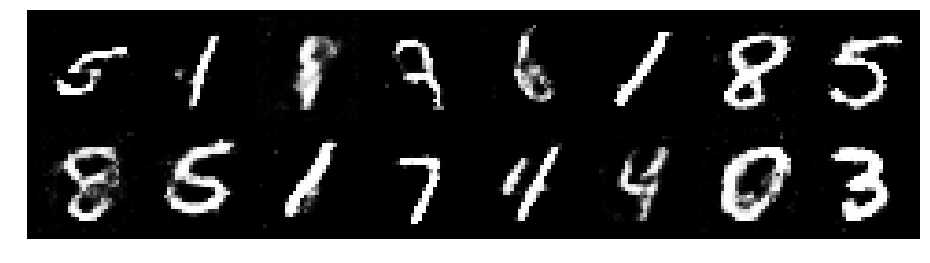

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.2322, Generator Loss: 0.8441
D(x): 0.5656, D(G(z)): 0.4539


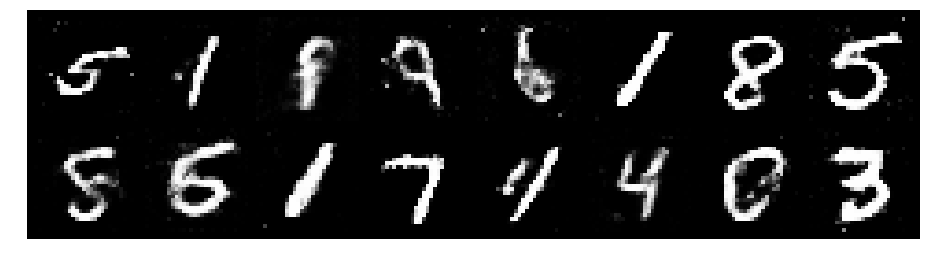

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2542, Generator Loss: 0.9251
D(x): 0.5273, D(G(z)): 0.4192


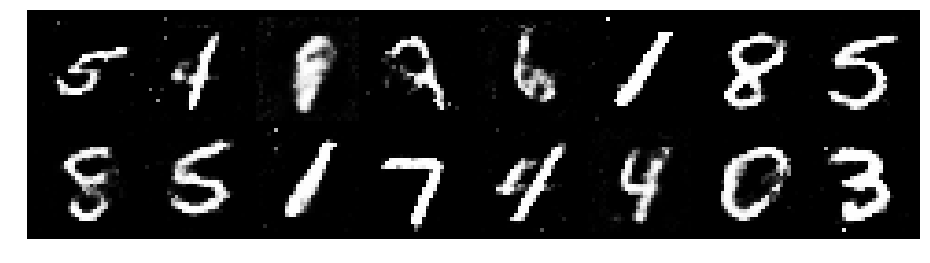

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2474, Generator Loss: 0.8724
D(x): 0.5655, D(G(z)): 0.4536


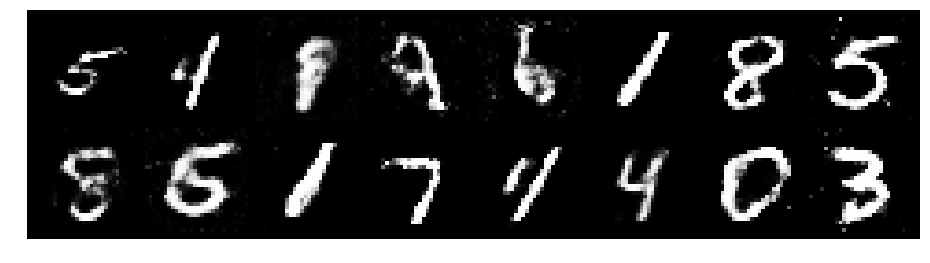

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.3033, Generator Loss: 0.9032
D(x): 0.5352, D(G(z)): 0.4459


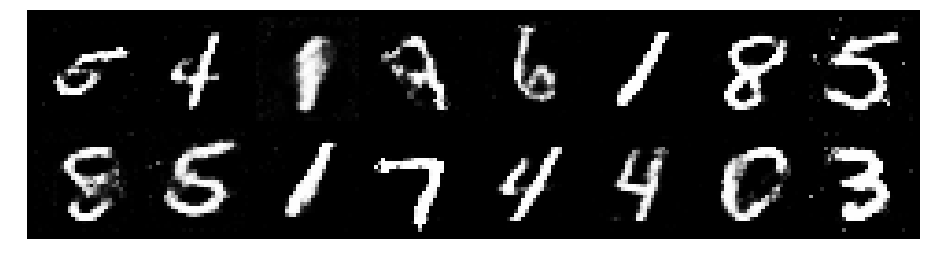

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2749, Generator Loss: 0.9109
D(x): 0.5424, D(G(z)): 0.4401


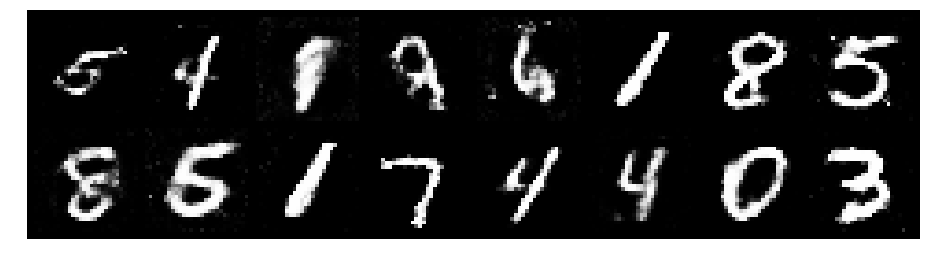

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2154, Generator Loss: 0.8426
D(x): 0.5269, D(G(z)): 0.3998


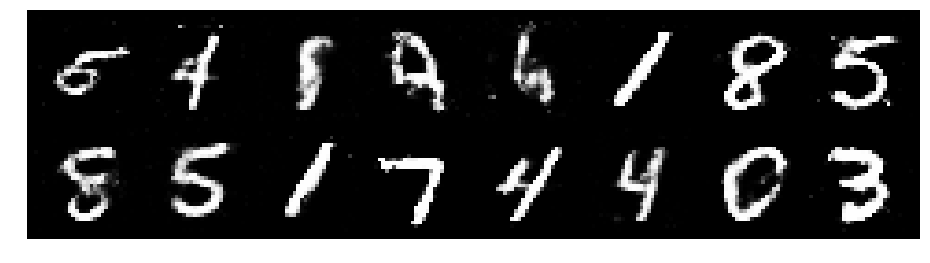

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.1461, Generator Loss: 0.8879
D(x): 0.5857, D(G(z)): 0.4211


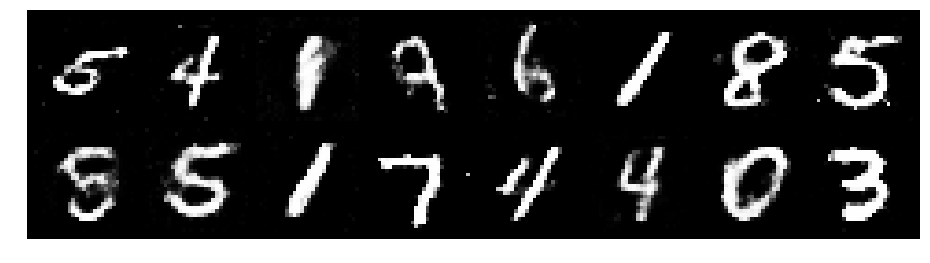

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2849, Generator Loss: 1.0110
D(x): 0.5976, D(G(z)): 0.4701


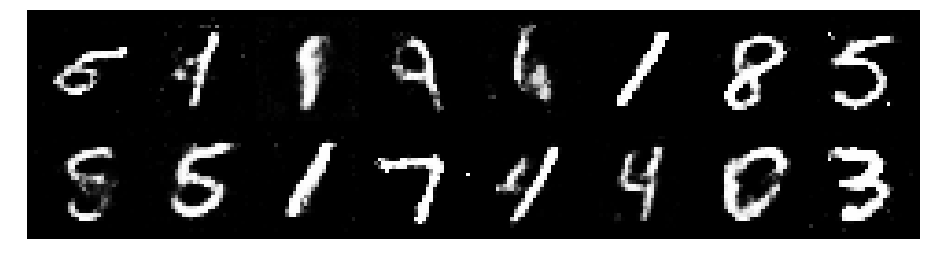

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.1830, Generator Loss: 0.8917
D(x): 0.5838, D(G(z)): 0.4379


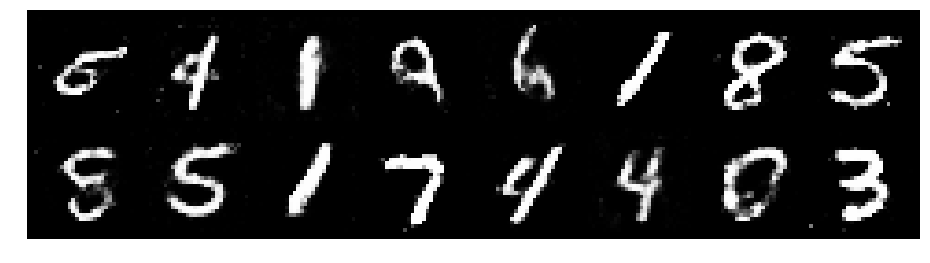

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2990, Generator Loss: 0.7832
D(x): 0.5751, D(G(z)): 0.4770


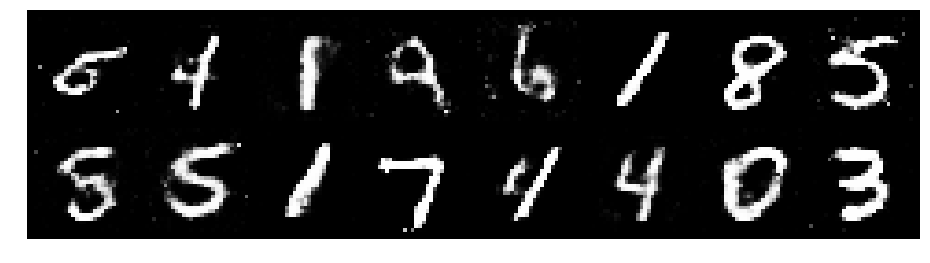

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2665, Generator Loss: 0.9084
D(x): 0.5563, D(G(z)): 0.4486


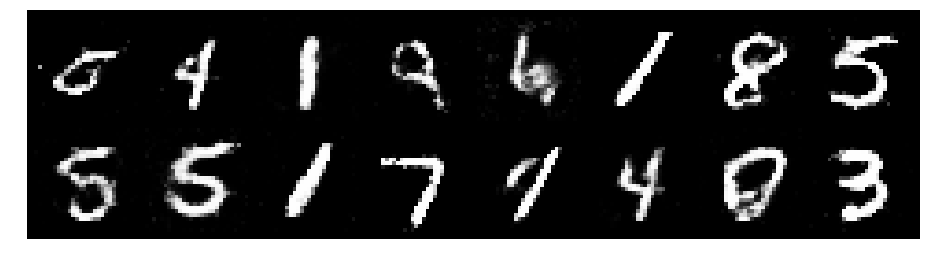

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2593, Generator Loss: 0.8374
D(x): 0.5562, D(G(z)): 0.4482


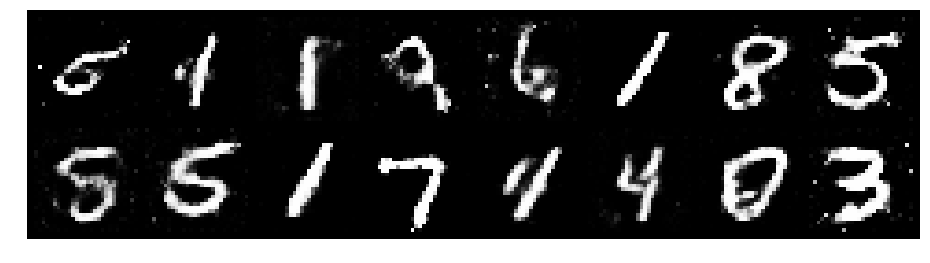

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2773, Generator Loss: 0.8906
D(x): 0.5670, D(G(z)): 0.4468


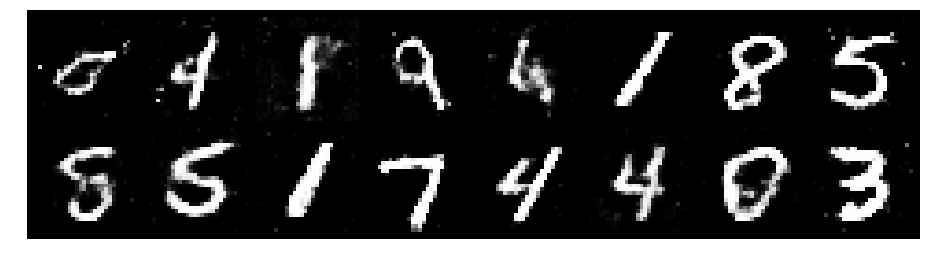

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.4518, Generator Loss: 0.6917
D(x): 0.5567, D(G(z)): 0.5255


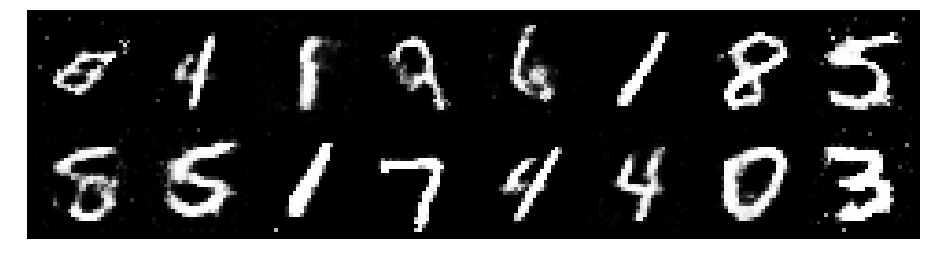

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.4109, Generator Loss: 0.8485
D(x): 0.5117, D(G(z)): 0.4738


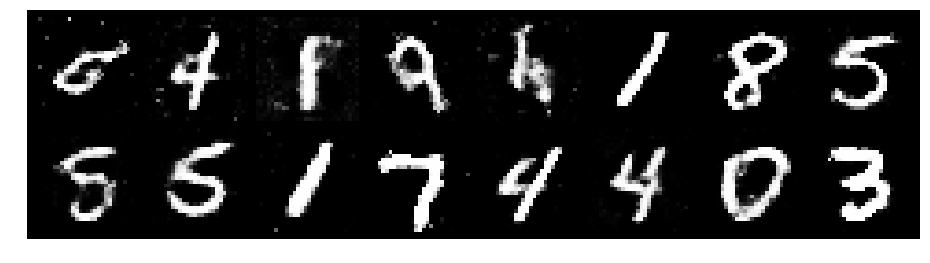

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.3531, Generator Loss: 0.8010
D(x): 0.5516, D(G(z)): 0.4852


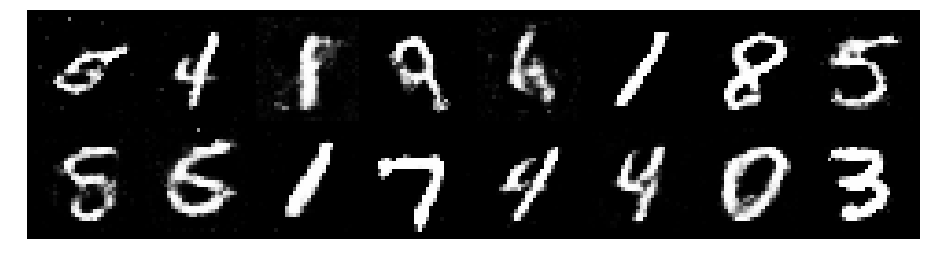

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2757, Generator Loss: 0.7590
D(x): 0.5702, D(G(z)): 0.4583


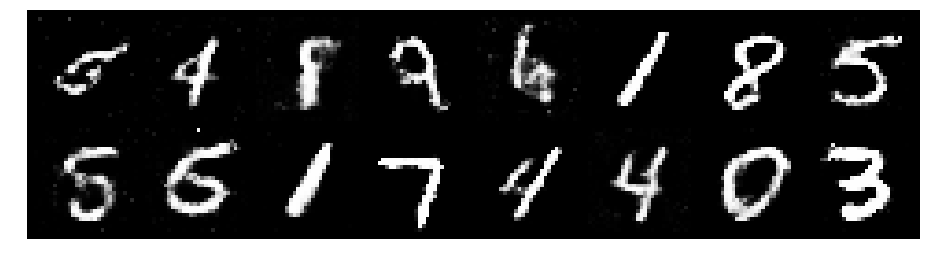

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3044, Generator Loss: 0.9506
D(x): 0.5446, D(G(z)): 0.4521


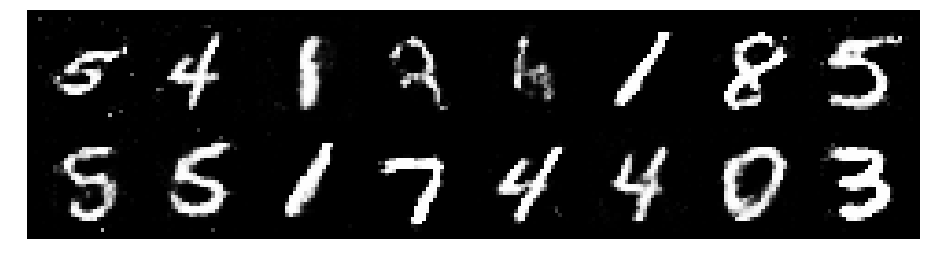

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2687, Generator Loss: 0.9142
D(x): 0.5790, D(G(z)): 0.4647


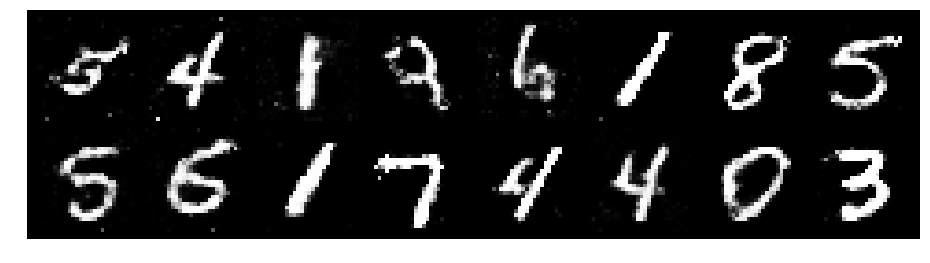

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.3131, Generator Loss: 0.8702
D(x): 0.5140, D(G(z)): 0.4339


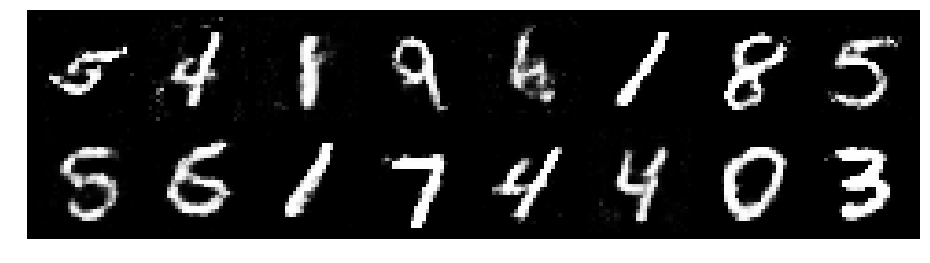

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2377, Generator Loss: 0.9683
D(x): 0.5838, D(G(z)): 0.4383


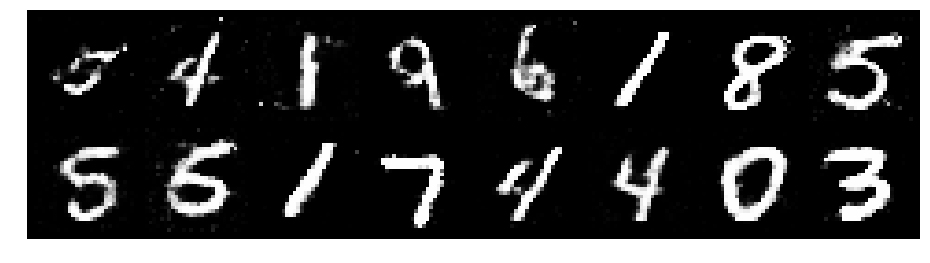

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2634, Generator Loss: 0.8836
D(x): 0.5716, D(G(z)): 0.4514


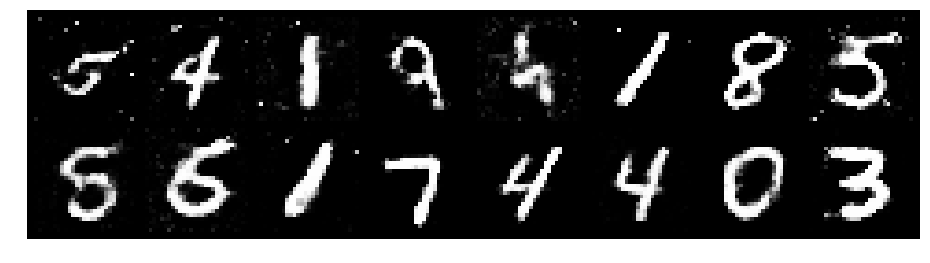

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2107, Generator Loss: 0.9789
D(x): 0.5672, D(G(z)): 0.4173


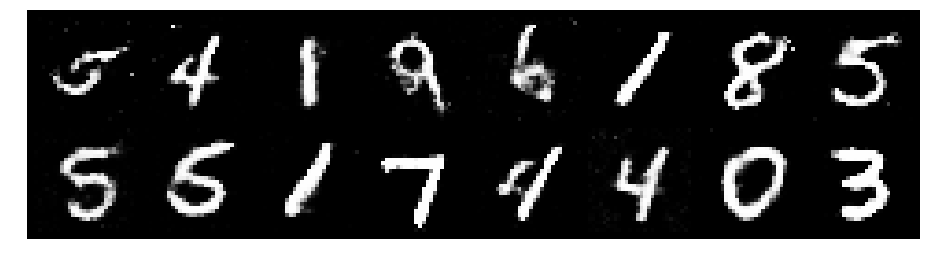

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2382, Generator Loss: 0.8483
D(x): 0.5630, D(G(z)): 0.4268


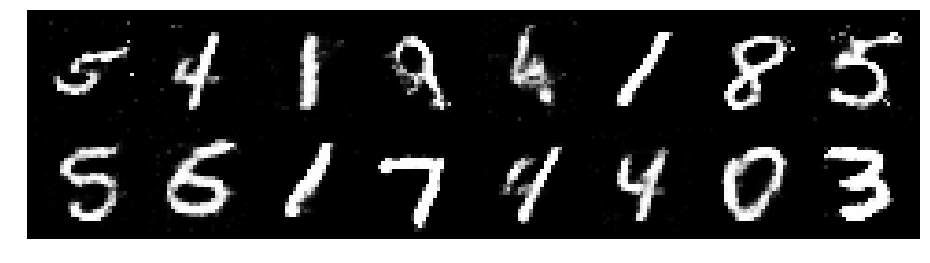

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2905, Generator Loss: 0.9128
D(x): 0.5746, D(G(z)): 0.4523


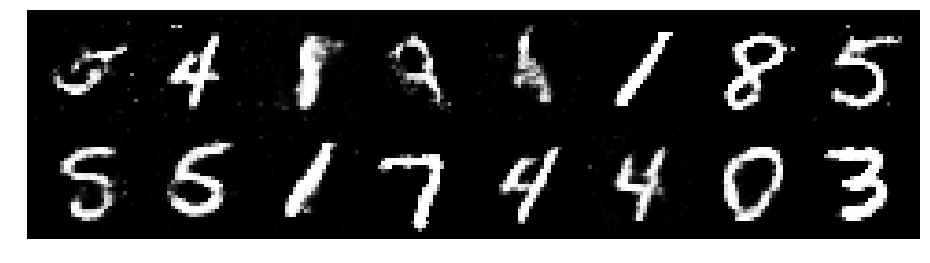

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8862
D(x): 0.5622, D(G(z)): 0.4559


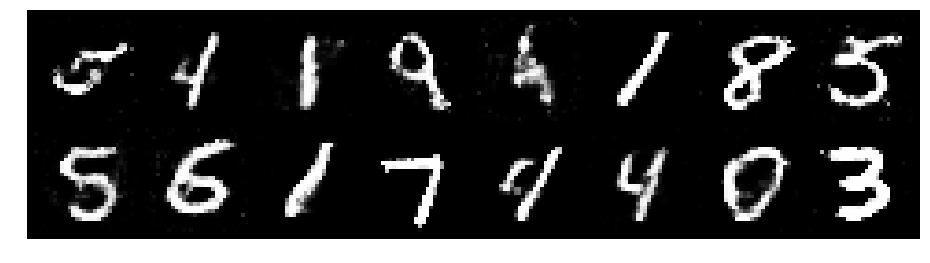

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8908
D(x): 0.5105, D(G(z)): 0.4222


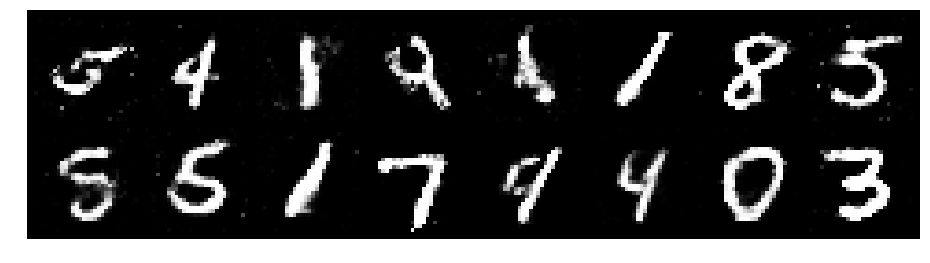

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2721, Generator Loss: 0.9717
D(x): 0.5181, D(G(z)): 0.4149


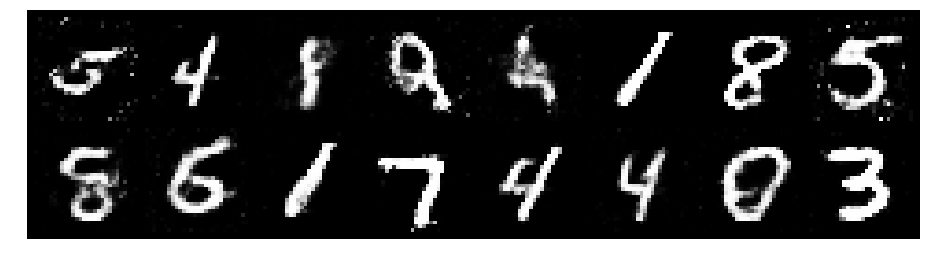

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2360, Generator Loss: 0.9263
D(x): 0.5495, D(G(z)): 0.4026


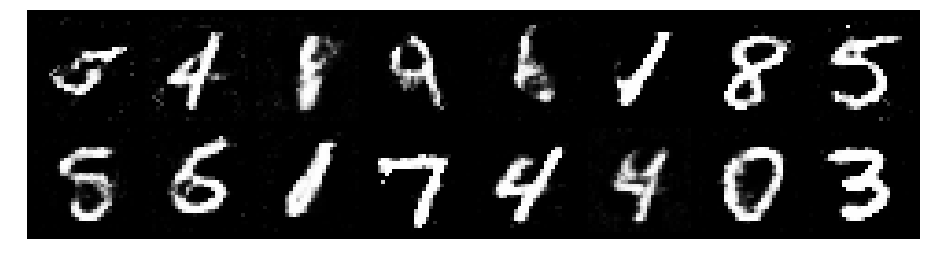

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2440, Generator Loss: 0.8179
D(x): 0.5394, D(G(z)): 0.4234


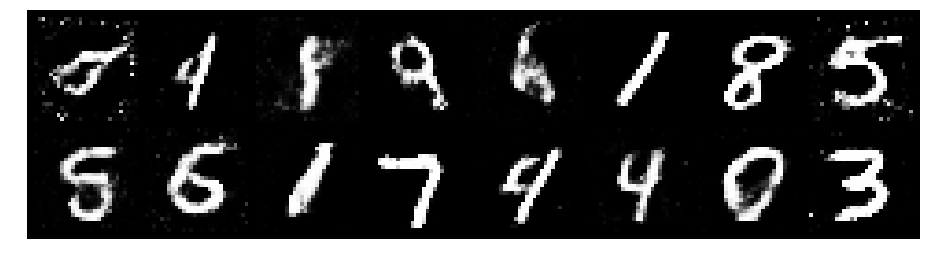

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.3928, Generator Loss: 0.8162
D(x): 0.5160, D(G(z)): 0.4595


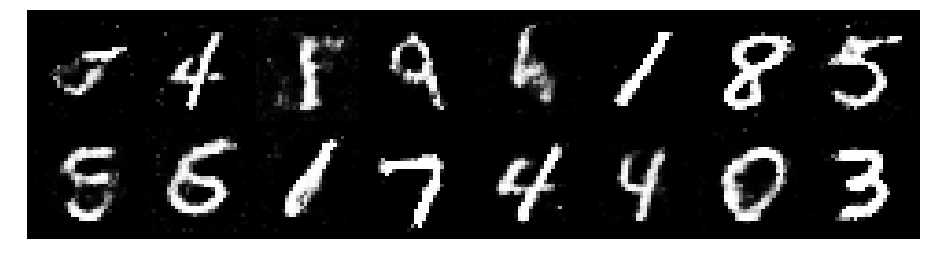

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2619, Generator Loss: 0.8872
D(x): 0.5203, D(G(z)): 0.4184


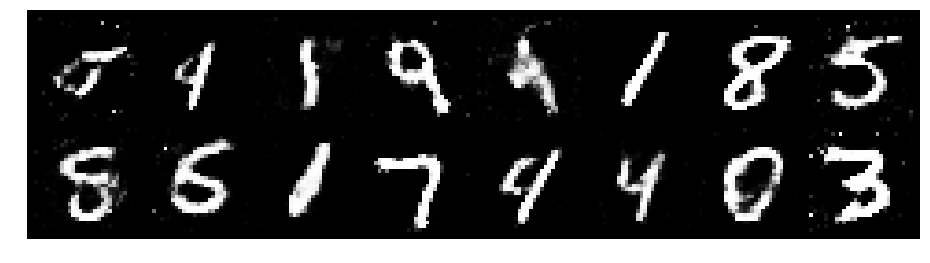

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2366, Generator Loss: 0.9931
D(x): 0.5775, D(G(z)): 0.4450


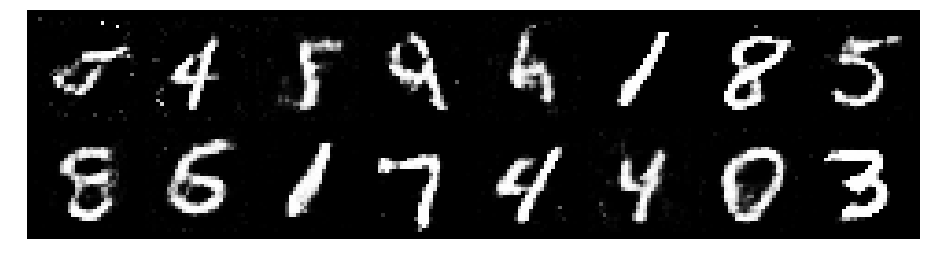

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9935
D(x): 0.5503, D(G(z)): 0.4169


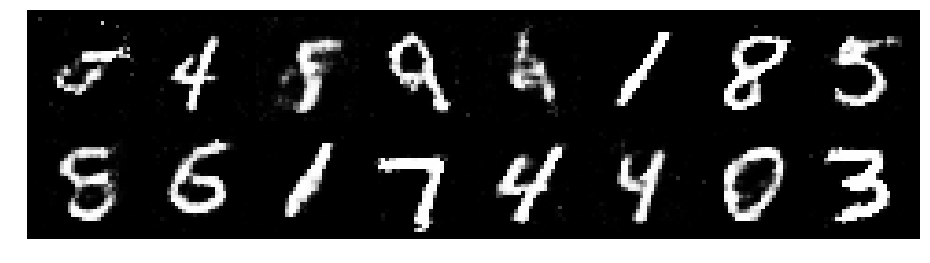

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2931, Generator Loss: 1.0616
D(x): 0.5326, D(G(z)): 0.4152


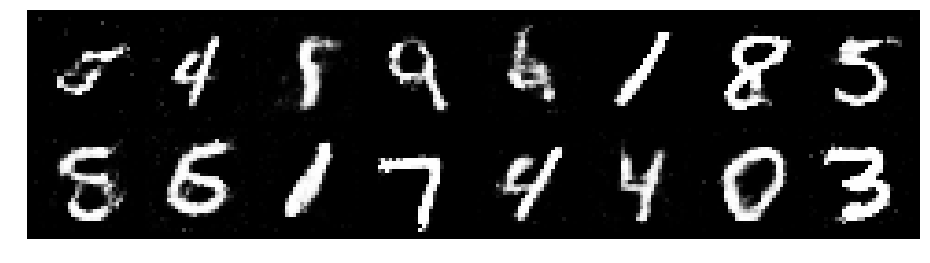

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.3499, Generator Loss: 0.7016
D(x): 0.5724, D(G(z)): 0.4964


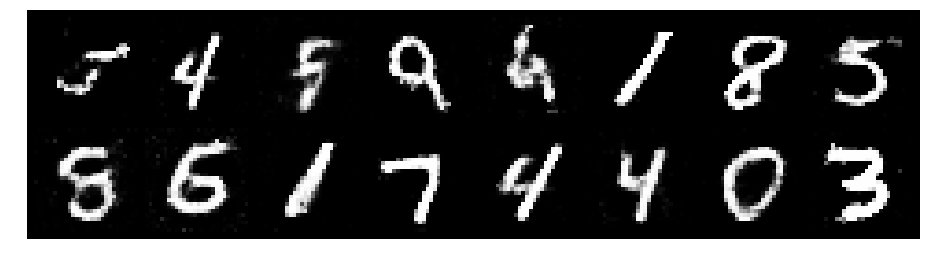

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2954, Generator Loss: 0.9502
D(x): 0.5310, D(G(z)): 0.4391


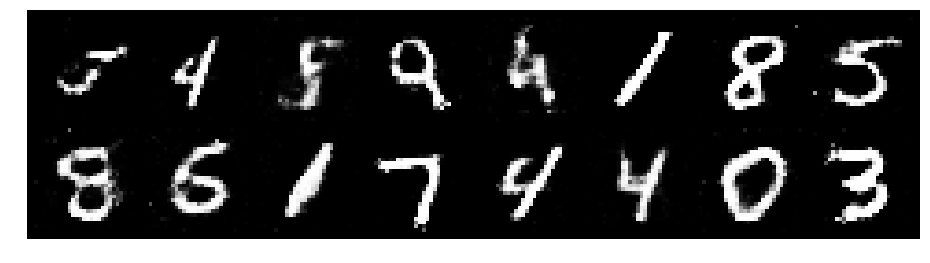

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2400, Generator Loss: 0.9304
D(x): 0.5439, D(G(z)): 0.4118


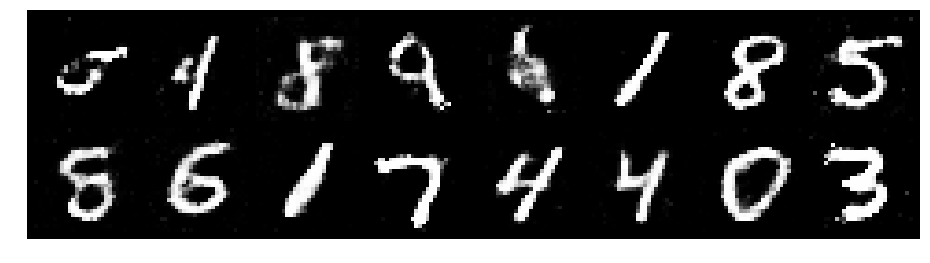

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3141, Generator Loss: 0.9606
D(x): 0.5181, D(G(z)): 0.4381


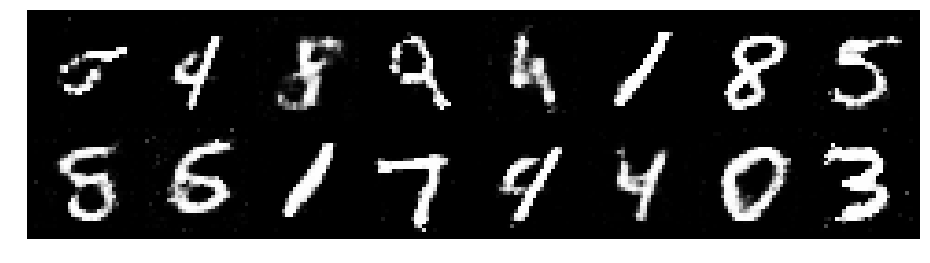

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.3858, Generator Loss: 0.8377
D(x): 0.5544, D(G(z)): 0.5008


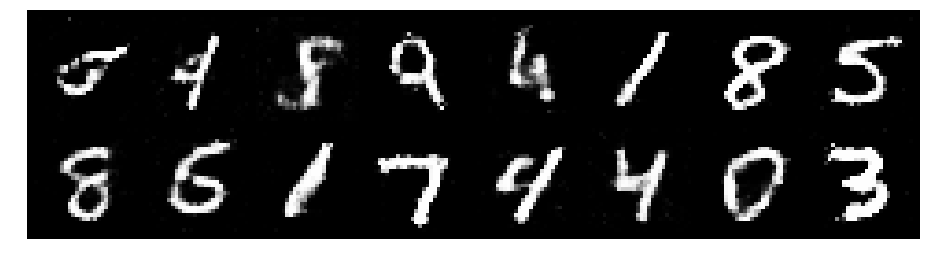

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2769, Generator Loss: 0.9097
D(x): 0.5561, D(G(z)): 0.4485


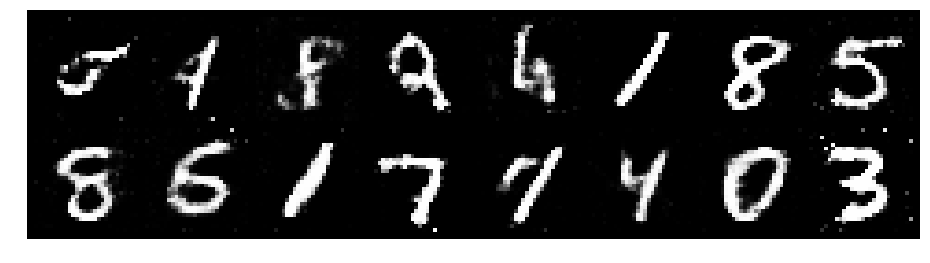

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8854
D(x): 0.5562, D(G(z)): 0.4382


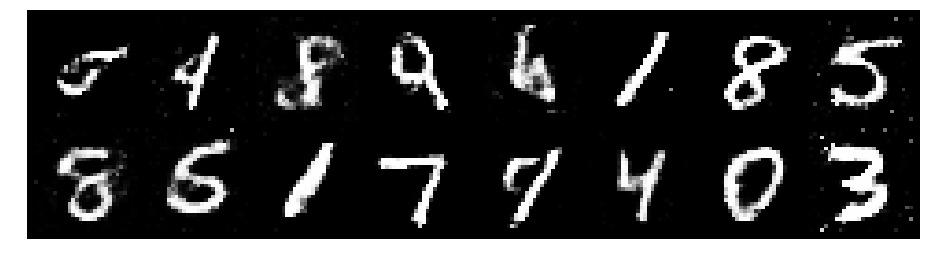

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2305, Generator Loss: 0.9002
D(x): 0.5494, D(G(z)): 0.4174


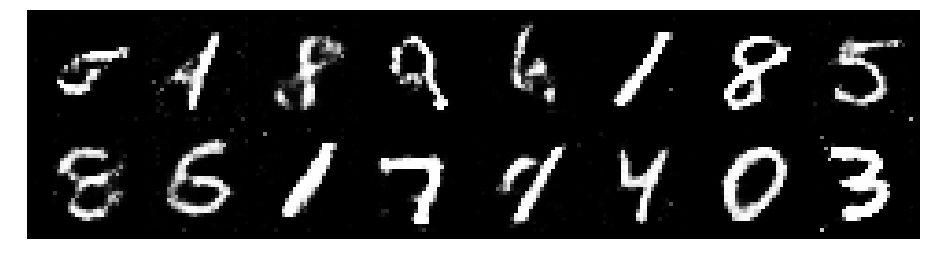

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.1588, Generator Loss: 0.9563
D(x): 0.5962, D(G(z)): 0.4311


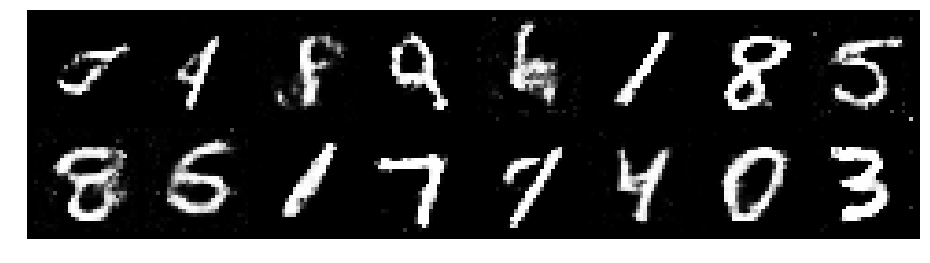

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2831, Generator Loss: 0.8650
D(x): 0.5435, D(G(z)): 0.4414


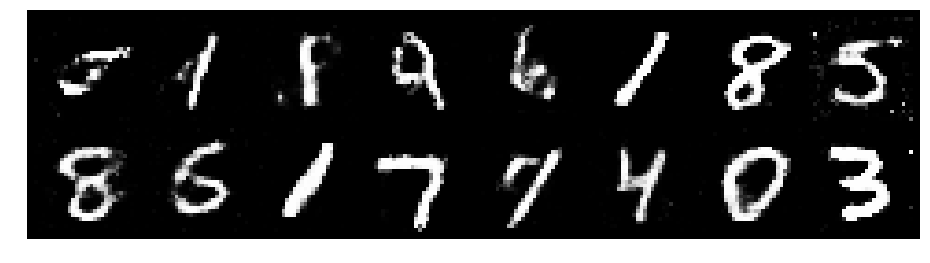

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2678, Generator Loss: 0.9246
D(x): 0.5552, D(G(z)): 0.4494


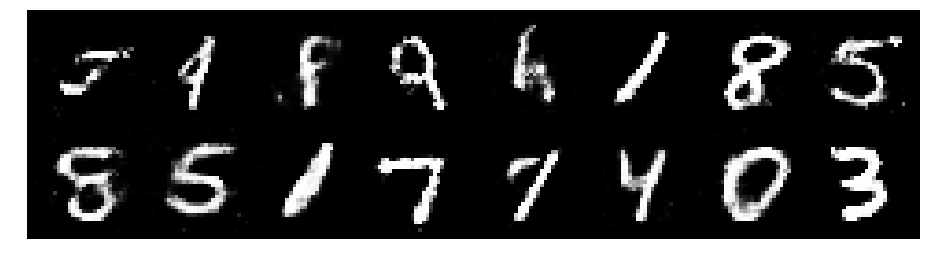

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.3601, Generator Loss: 0.8670
D(x): 0.4907, D(G(z)): 0.4459


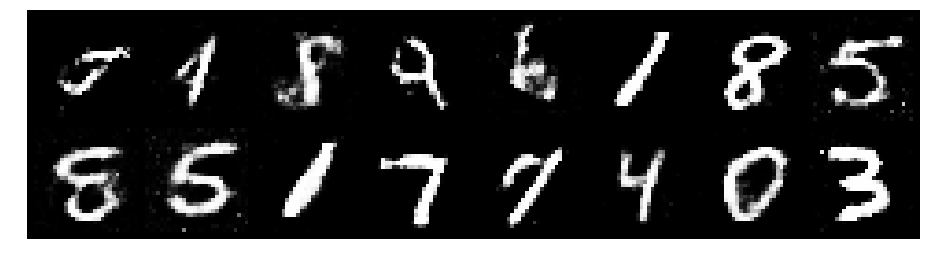

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3099, Generator Loss: 0.8950
D(x): 0.5712, D(G(z)): 0.4824


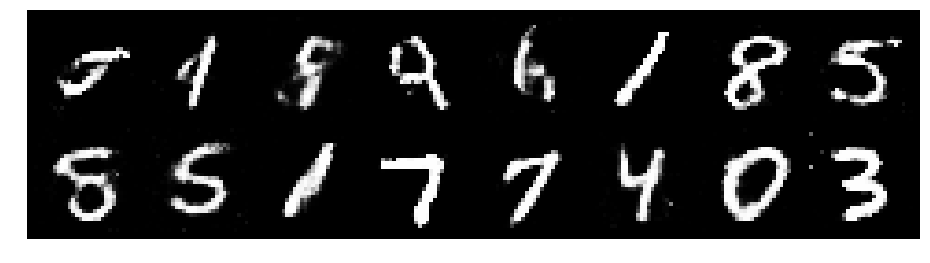

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.2068, Generator Loss: 0.9875
D(x): 0.5710, D(G(z)): 0.4309


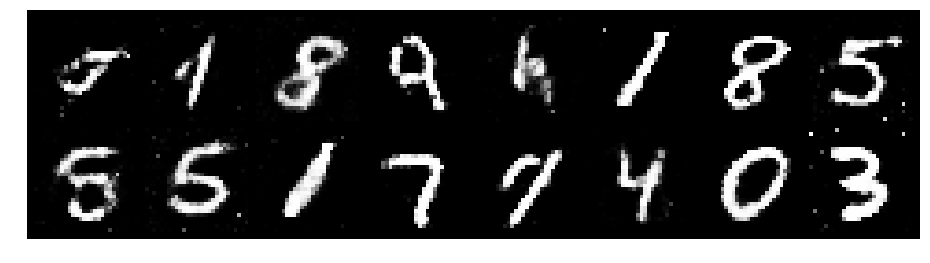

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.2741, Generator Loss: 0.8652
D(x): 0.5867, D(G(z)): 0.4454


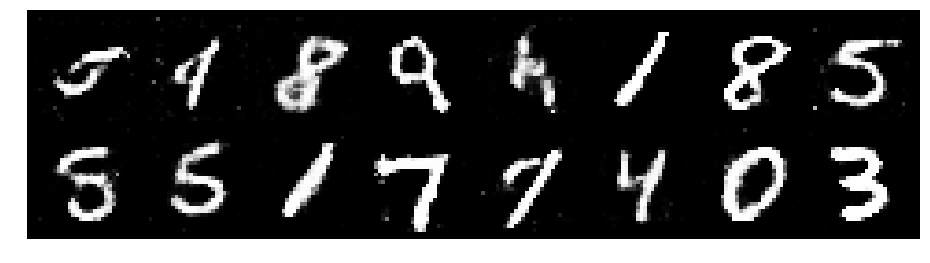

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.3393, Generator Loss: 0.8669
D(x): 0.5349, D(G(z)): 0.4587


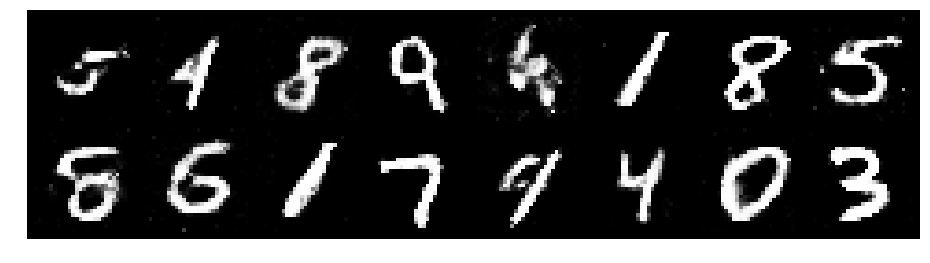

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2471, Generator Loss: 0.8871
D(x): 0.5545, D(G(z)): 0.4416


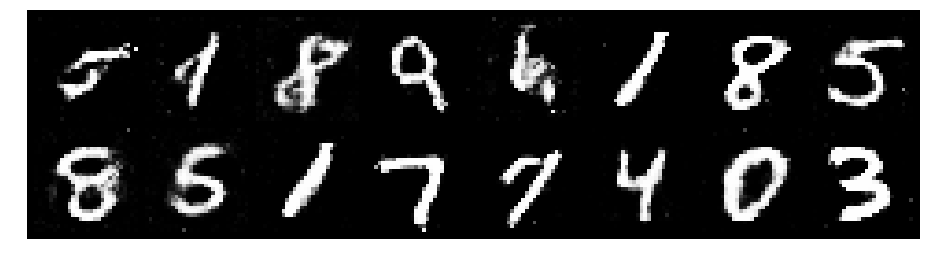

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8900
D(x): 0.5451, D(G(z)): 0.4451


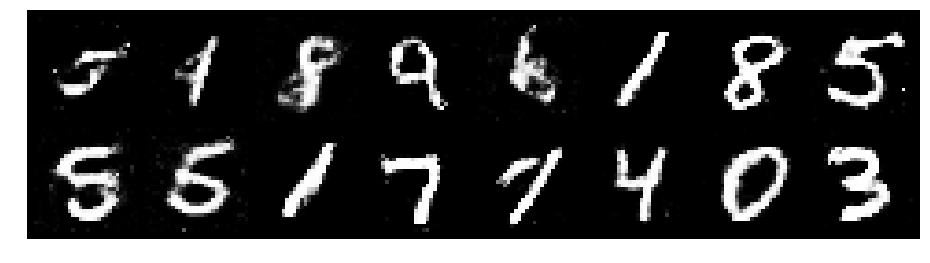

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8610
D(x): 0.5624, D(G(z)): 0.4736


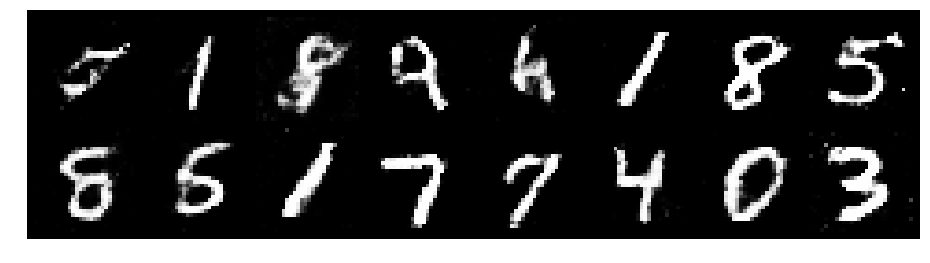

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.3142, Generator Loss: 0.9519
D(x): 0.5379, D(G(z)): 0.4462


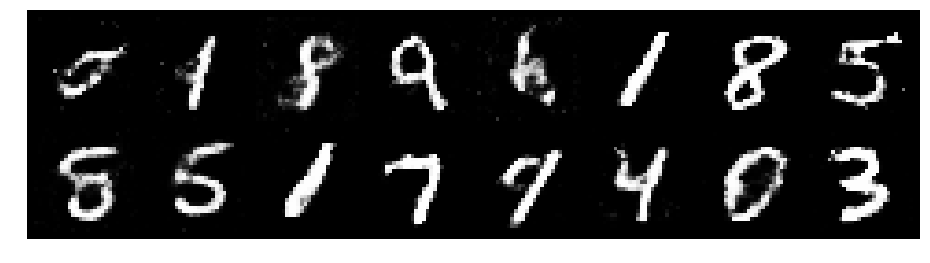

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2897, Generator Loss: 0.8550
D(x): 0.5487, D(G(z)): 0.4608


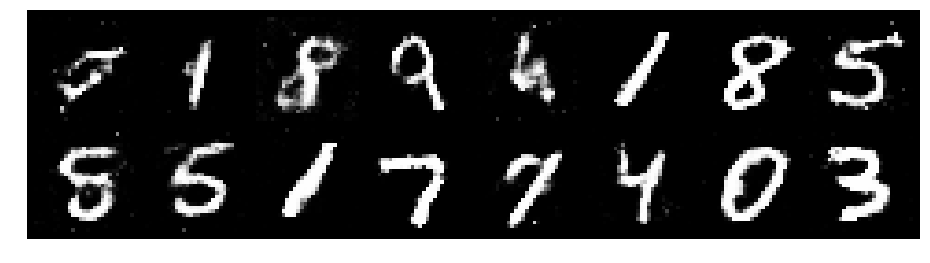

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.4706, Generator Loss: 0.8615
D(x): 0.4978, D(G(z)): 0.4537


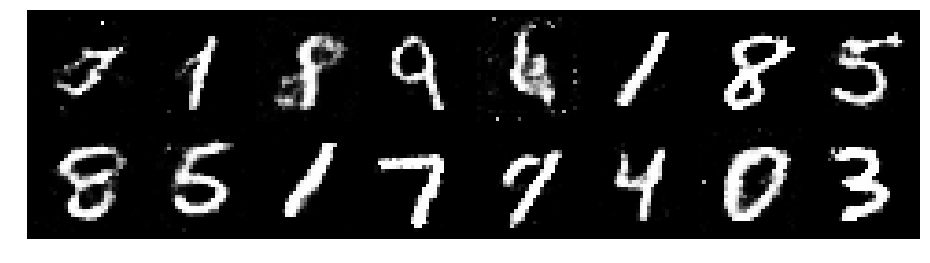

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2592, Generator Loss: 0.9796
D(x): 0.6123, D(G(z)): 0.4574


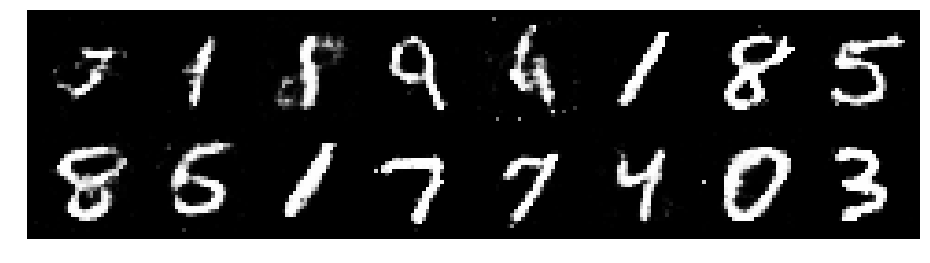

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2758, Generator Loss: 0.9433
D(x): 0.5866, D(G(z)): 0.4664


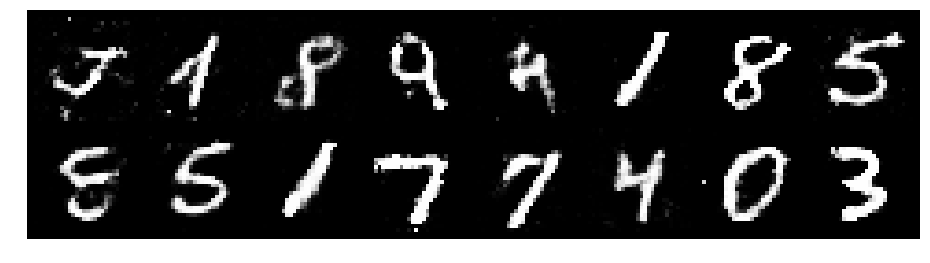

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3180, Generator Loss: 0.9542
D(x): 0.5254, D(G(z)): 0.4377


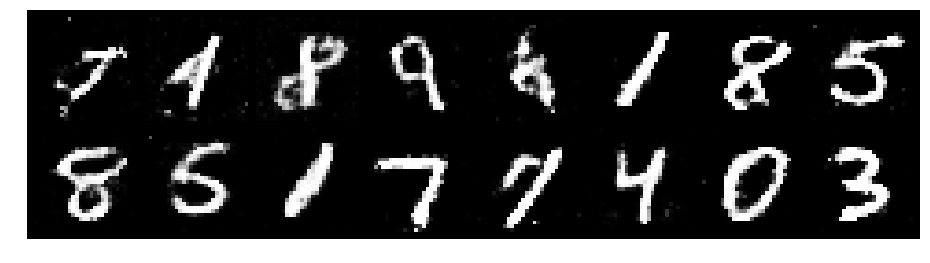

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8905
D(x): 0.5640, D(G(z)): 0.4277


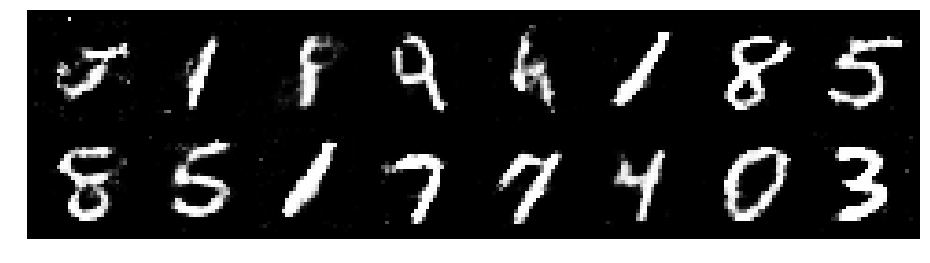

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3525, Generator Loss: 0.8087
D(x): 0.5620, D(G(z)): 0.4846


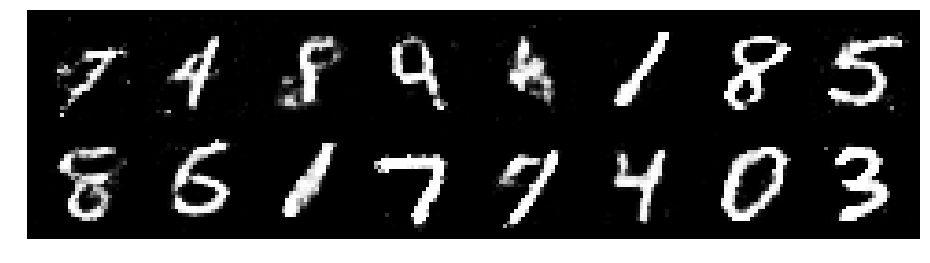

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.2633, Generator Loss: 0.8594
D(x): 0.5318, D(G(z)): 0.4337


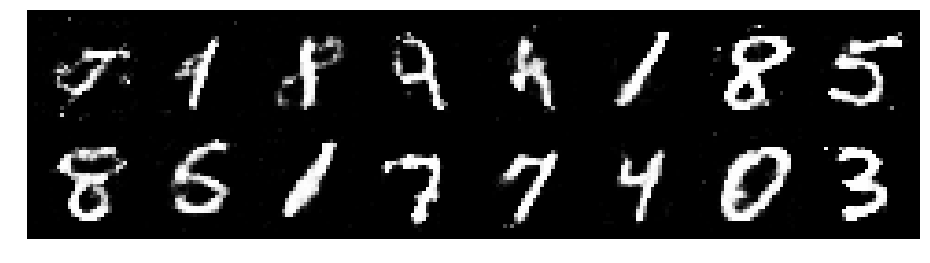

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2836, Generator Loss: 0.9911
D(x): 0.5363, D(G(z)): 0.4417


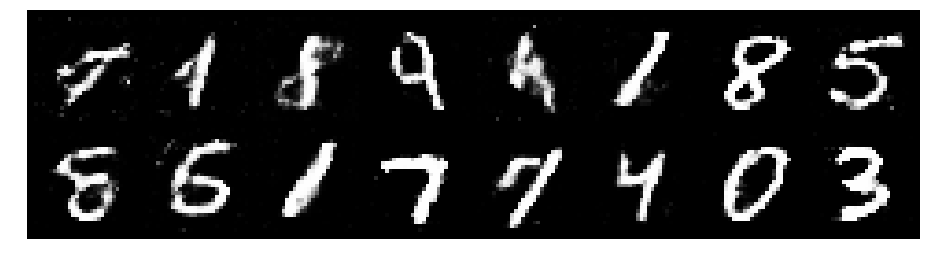

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8785
D(x): 0.5836, D(G(z)): 0.4640


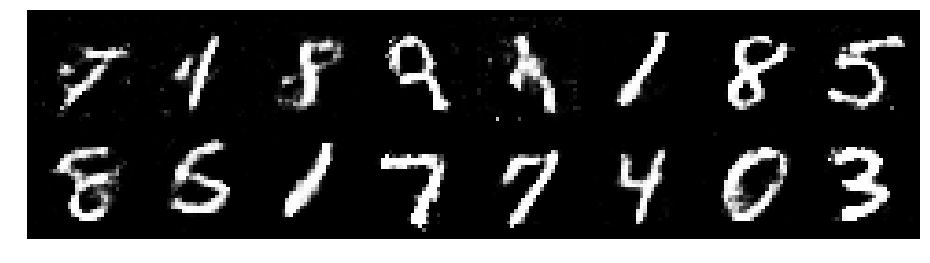

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.3371, Generator Loss: 0.7985
D(x): 0.5990, D(G(z)): 0.5066


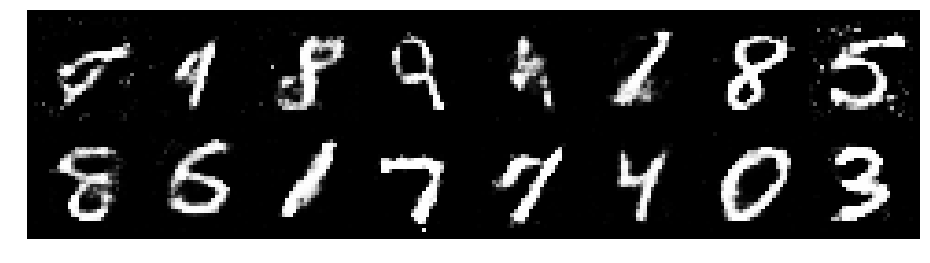

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.4036, Generator Loss: 0.8036
D(x): 0.5510, D(G(z)): 0.4600


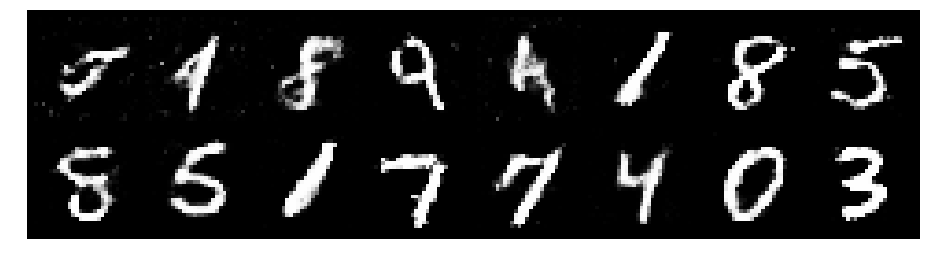

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.3036, Generator Loss: 0.8955
D(x): 0.5547, D(G(z)): 0.4452


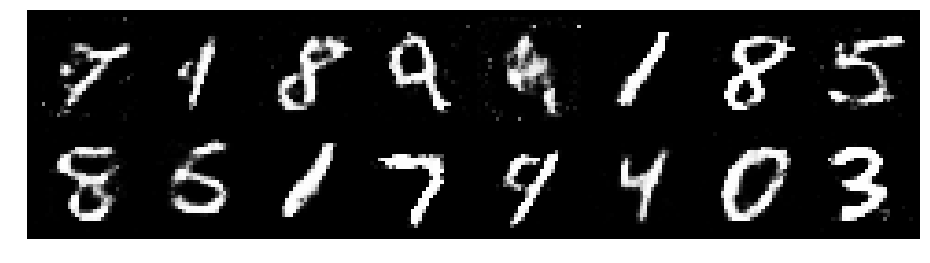

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.2546, Generator Loss: 0.9054
D(x): 0.5442, D(G(z)): 0.4346


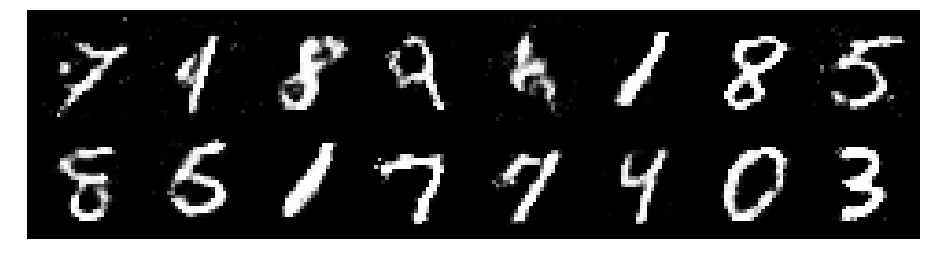

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2645, Generator Loss: 0.9558
D(x): 0.5183, D(G(z)): 0.4215


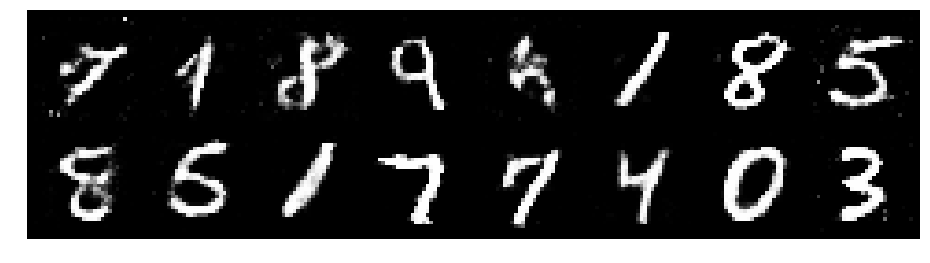

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.1717, Generator Loss: 0.9213
D(x): 0.5762, D(G(z)): 0.4212


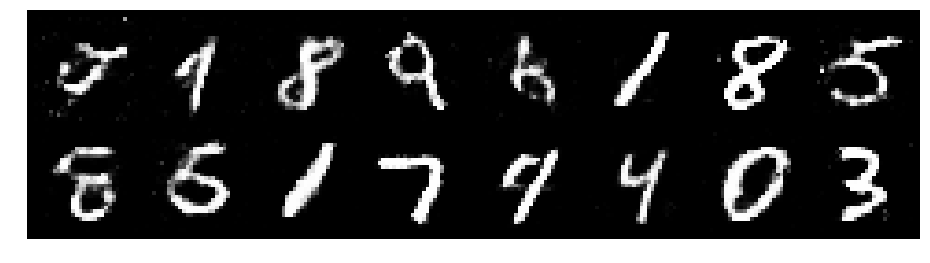

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.1685, Generator Loss: 1.0281
D(x): 0.5686, D(G(z)): 0.3947


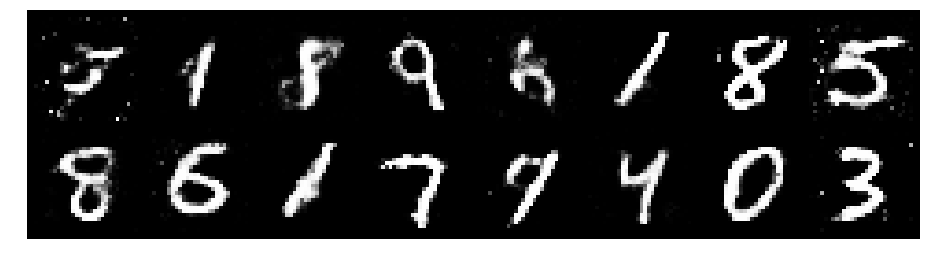

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2470, Generator Loss: 0.9067
D(x): 0.5849, D(G(z)): 0.4558


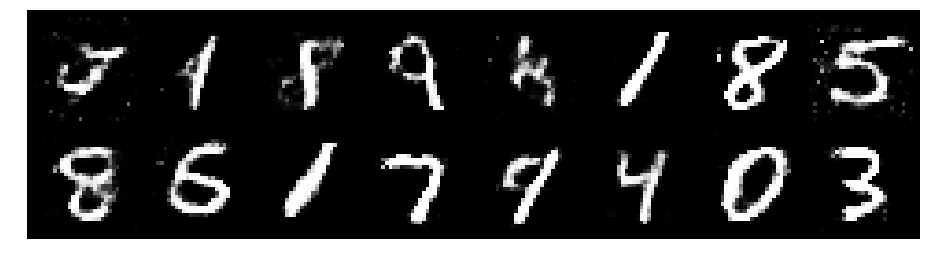

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3952, Generator Loss: 0.8417
D(x): 0.5425, D(G(z)): 0.4864


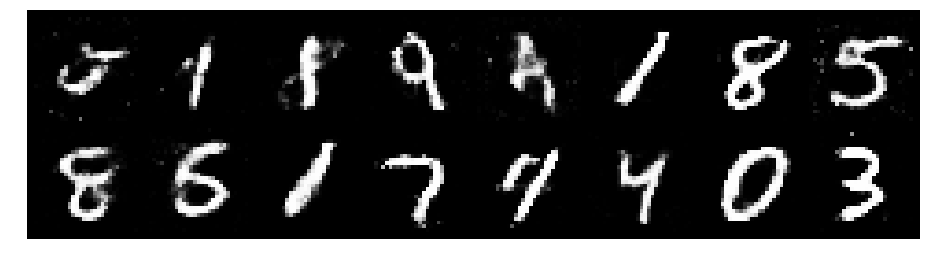

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3868, Generator Loss: 0.8550
D(x): 0.5176, D(G(z)): 0.4660


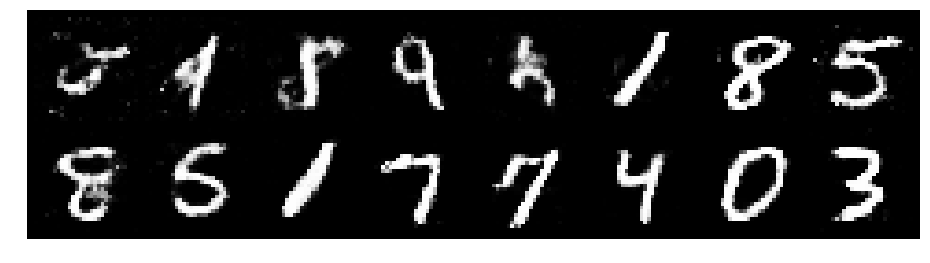

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3090, Generator Loss: 0.8646
D(x): 0.5485, D(G(z)): 0.4703


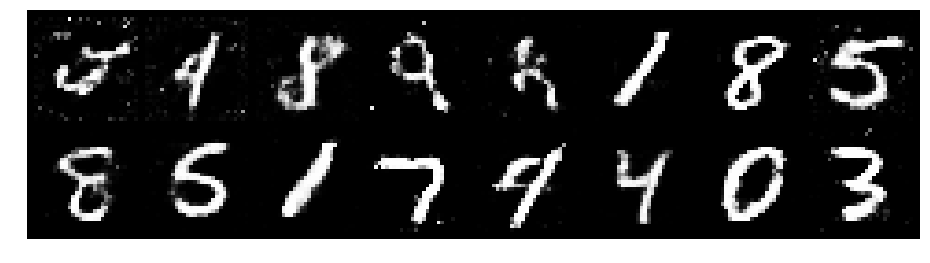

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2959, Generator Loss: 0.8650
D(x): 0.5285, D(G(z)): 0.4409


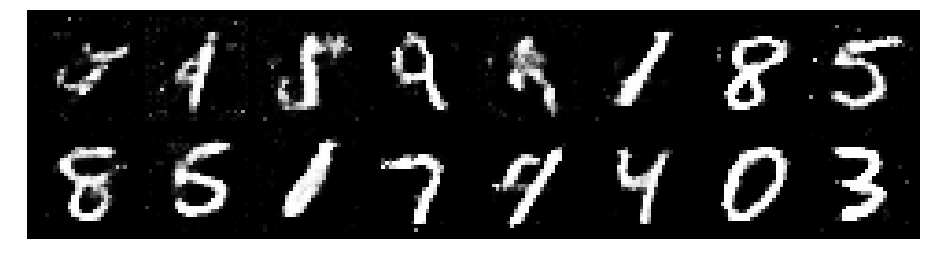

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.2210, Generator Loss: 0.8200
D(x): 0.5680, D(G(z)): 0.4398


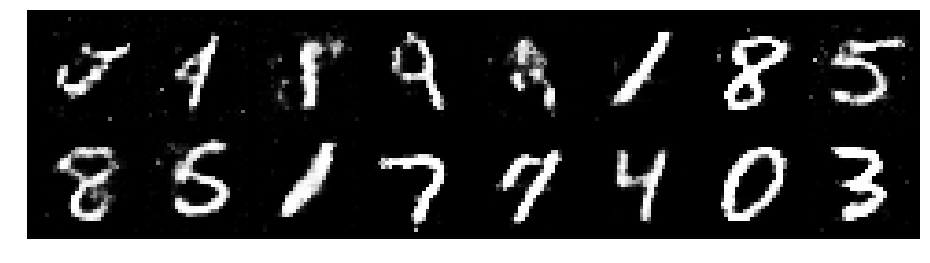

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.2750, Generator Loss: 0.7388
D(x): 0.5788, D(G(z)): 0.4582


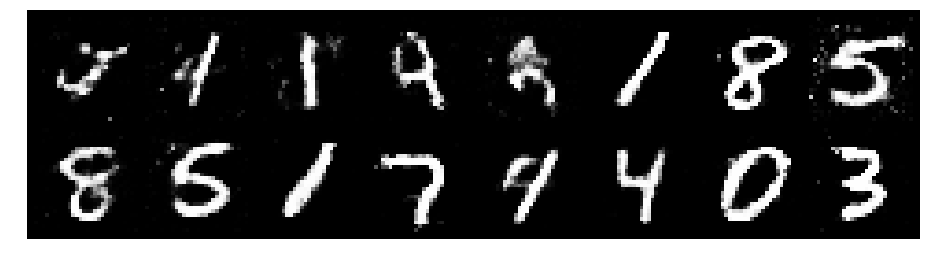

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2324, Generator Loss: 0.7958
D(x): 0.5689, D(G(z)): 0.4398


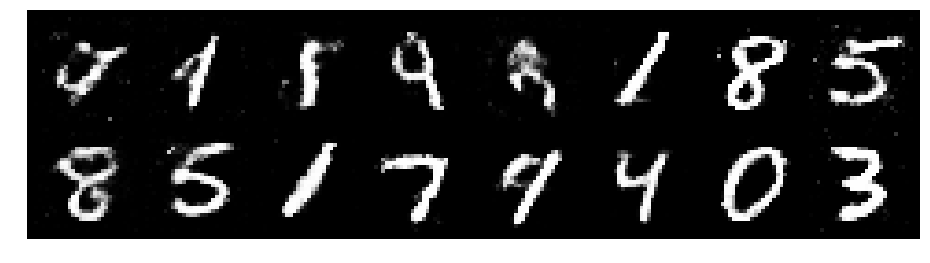

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2342, Generator Loss: 0.9095
D(x): 0.5699, D(G(z)): 0.4397


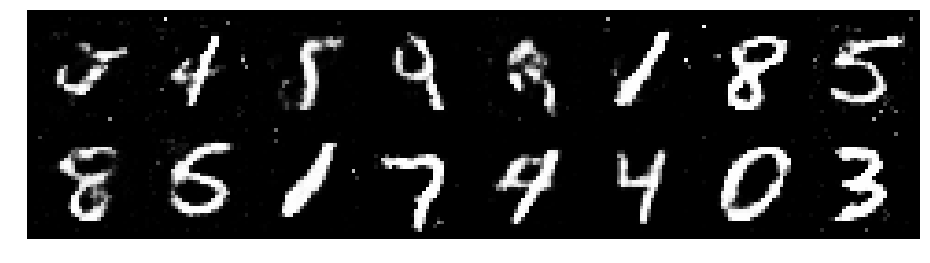

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2884, Generator Loss: 0.8397
D(x): 0.5591, D(G(z)): 0.4461


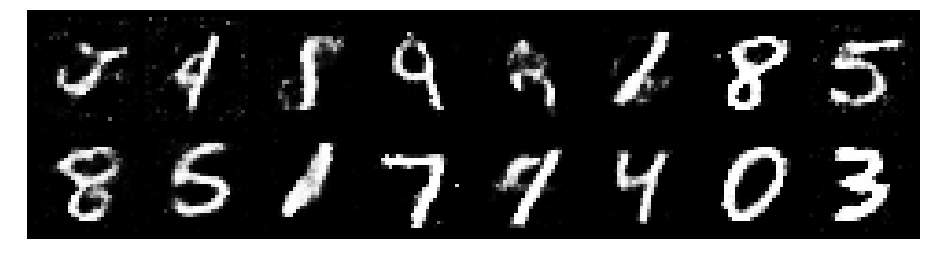

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8423
D(x): 0.5698, D(G(z)): 0.4740


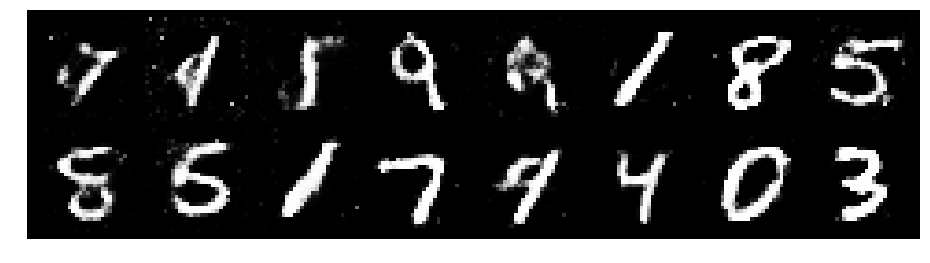

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2974, Generator Loss: 0.9741
D(x): 0.5130, D(G(z)): 0.4166


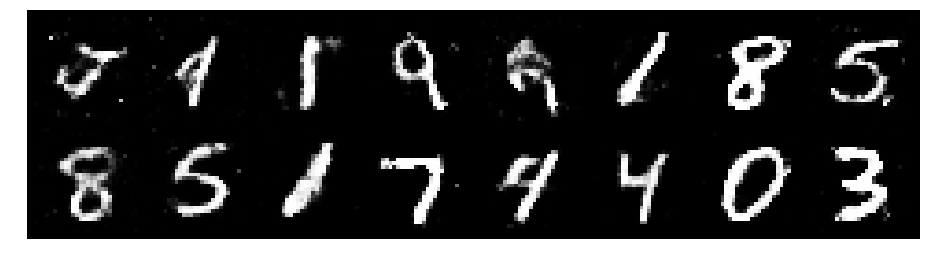

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2815, Generator Loss: 0.9168
D(x): 0.5880, D(G(z)): 0.4869


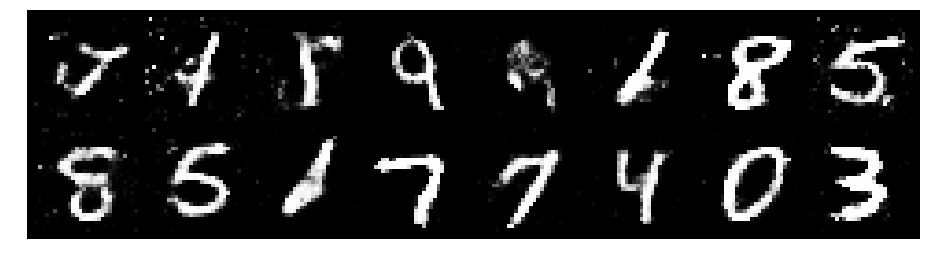

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8779
D(x): 0.5444, D(G(z)): 0.4297


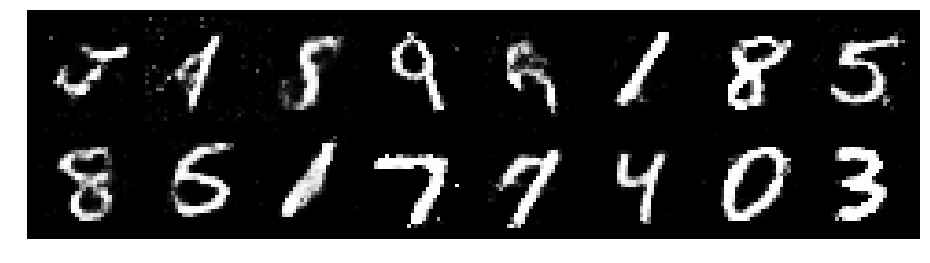

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2045, Generator Loss: 0.8611
D(x): 0.5568, D(G(z)): 0.4144


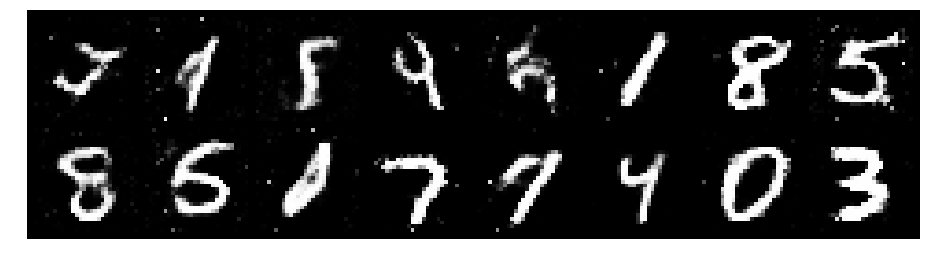

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.1473, Generator Loss: 1.0237
D(x): 0.5725, D(G(z)): 0.4100


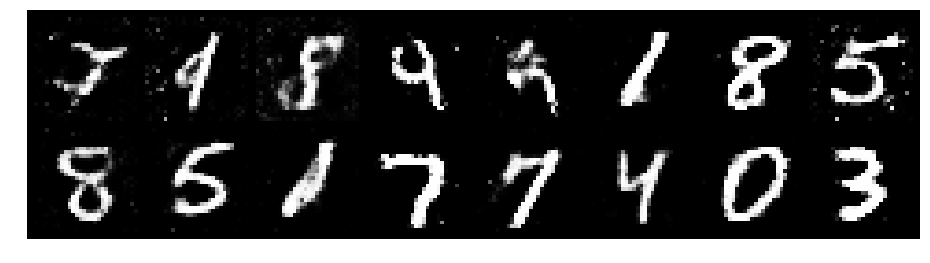

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2613, Generator Loss: 0.9217
D(x): 0.5523, D(G(z)): 0.4228


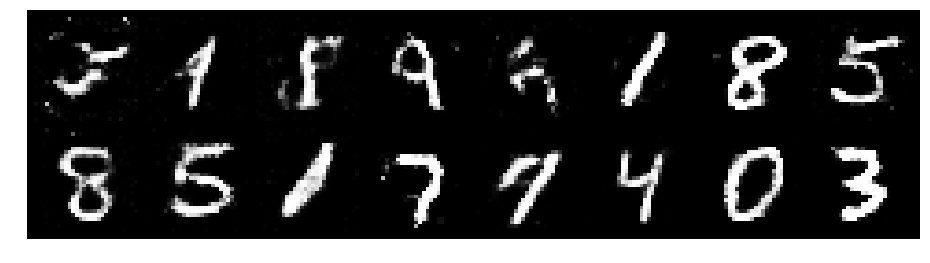

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2912, Generator Loss: 0.8924
D(x): 0.5320, D(G(z)): 0.4415


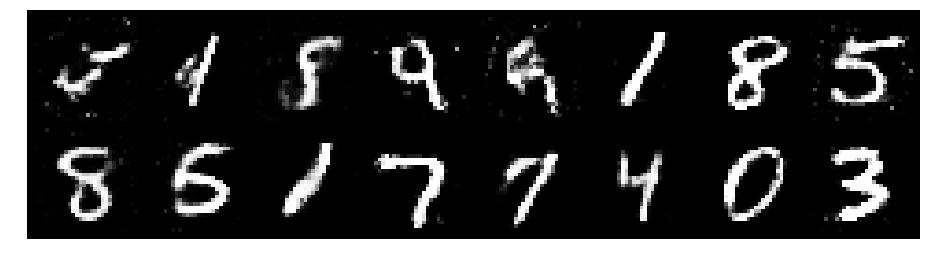

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8483
D(x): 0.5526, D(G(z)): 0.4561


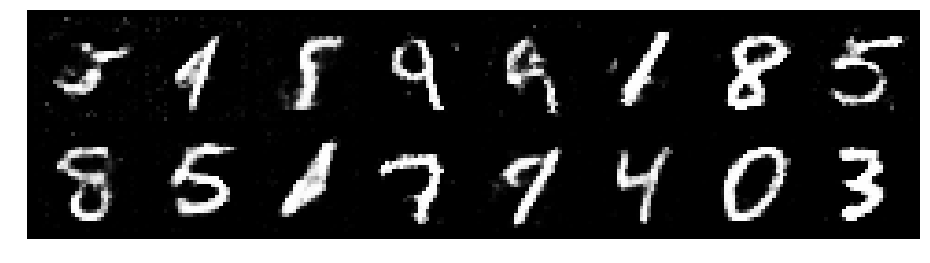

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2973, Generator Loss: 0.9427
D(x): 0.5527, D(G(z)): 0.4495


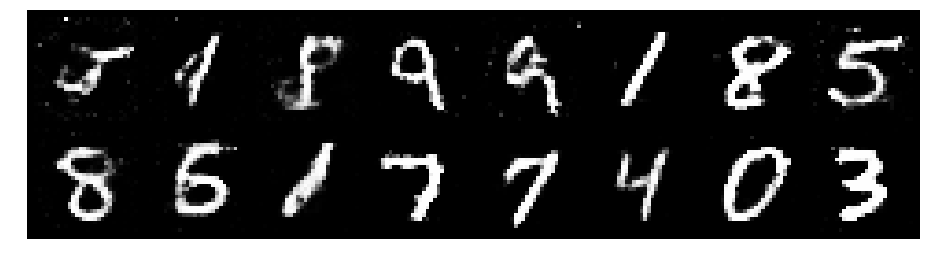

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3428, Generator Loss: 0.7741
D(x): 0.5438, D(G(z)): 0.4812


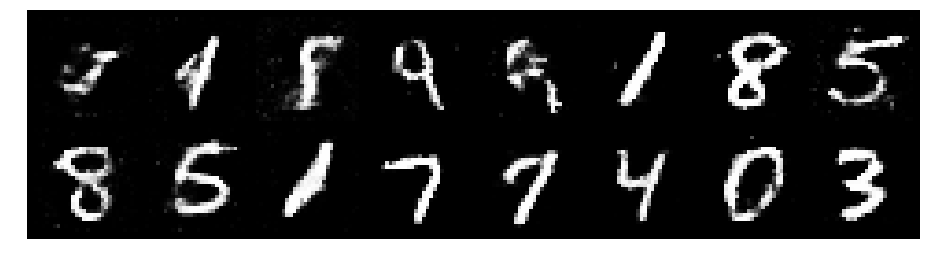

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3023, Generator Loss: 0.9014
D(x): 0.5527, D(G(z)): 0.4507


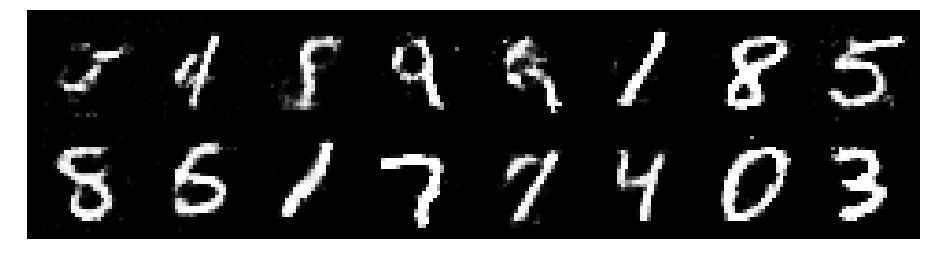

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2280, Generator Loss: 0.8988
D(x): 0.5486, D(G(z)): 0.4248


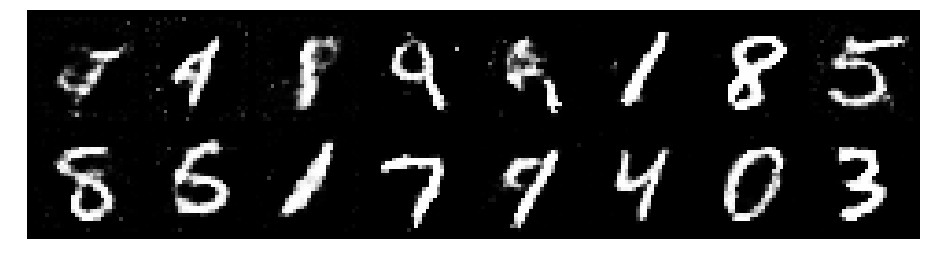

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3452, Generator Loss: 0.9863
D(x): 0.5416, D(G(z)): 0.4487


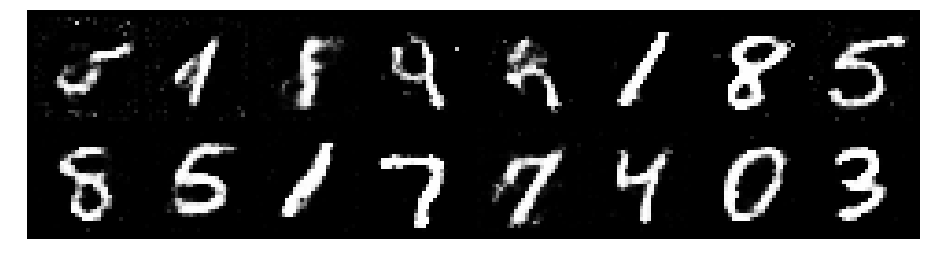

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3009, Generator Loss: 0.8566
D(x): 0.5628, D(G(z)): 0.4634


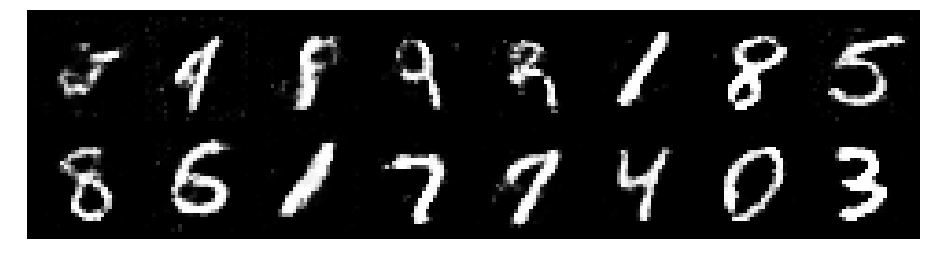

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3867, Generator Loss: 0.8623
D(x): 0.4799, D(G(z)): 0.4302


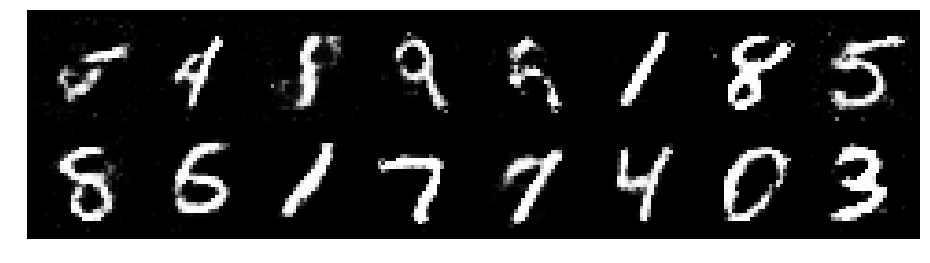

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8180
D(x): 0.5261, D(G(z)): 0.4399


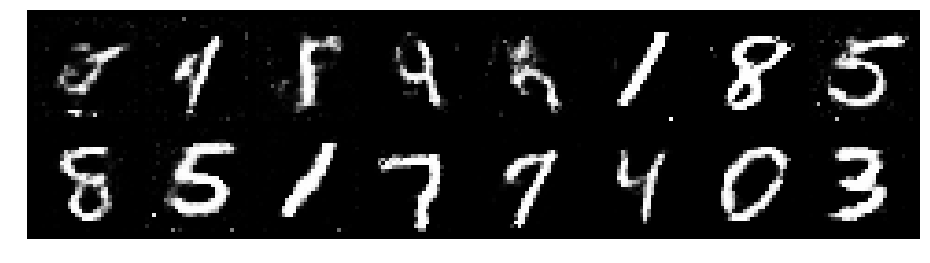

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2430, Generator Loss: 0.8852
D(x): 0.5685, D(G(z)): 0.4474


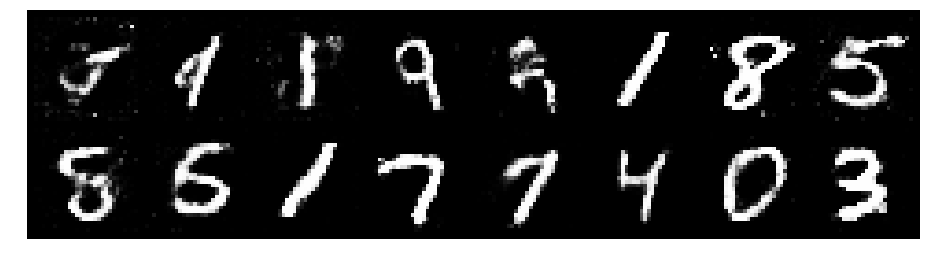

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.3111, Generator Loss: 0.8503
D(x): 0.6046, D(G(z)): 0.4871


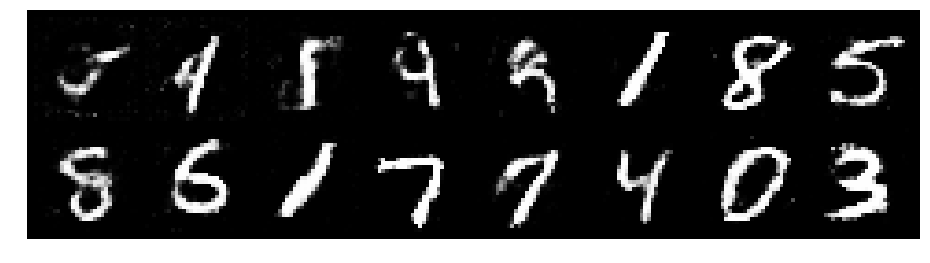

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2976, Generator Loss: 0.8870
D(x): 0.5563, D(G(z)): 0.4700


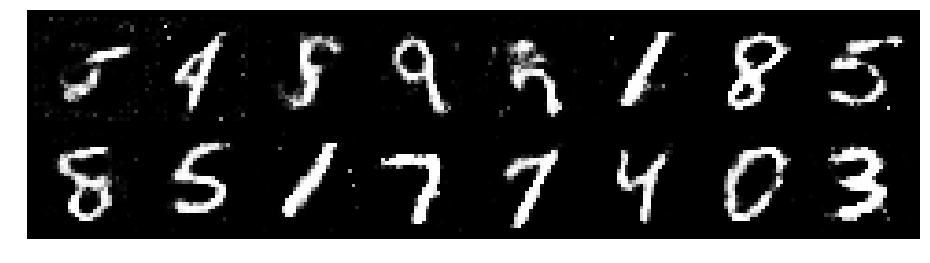

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3898, Generator Loss: 0.8187
D(x): 0.5413, D(G(z)): 0.4936


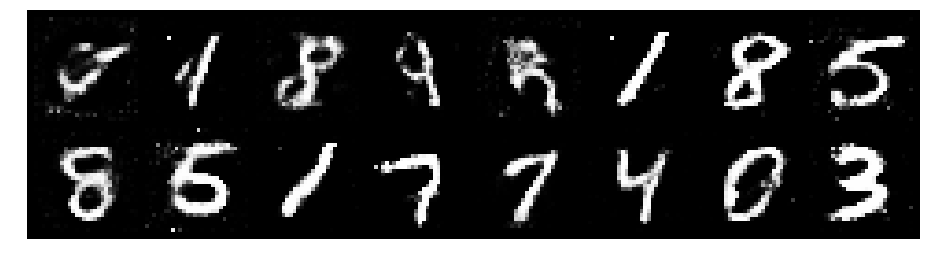

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2285, Generator Loss: 0.9685
D(x): 0.5519, D(G(z)): 0.3993


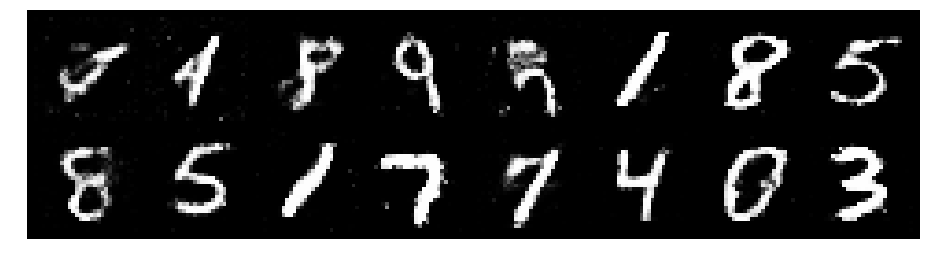

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2095, Generator Loss: 0.9564
D(x): 0.5697, D(G(z)): 0.4351


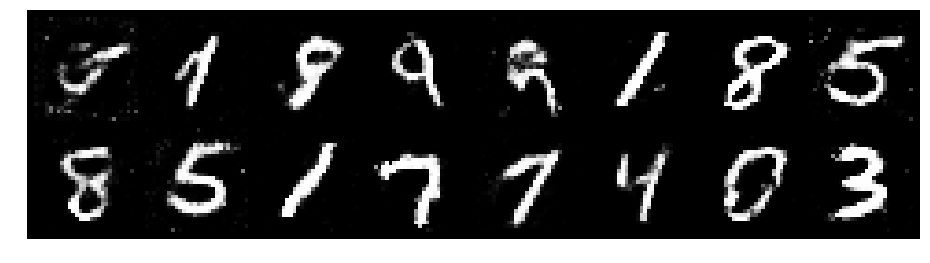

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.2067, Generator Loss: 0.8628
D(x): 0.5819, D(G(z)): 0.4332


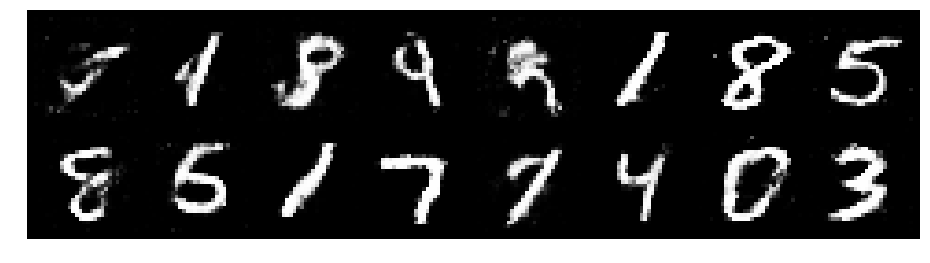

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2370, Generator Loss: 0.8738
D(x): 0.5520, D(G(z)): 0.4412


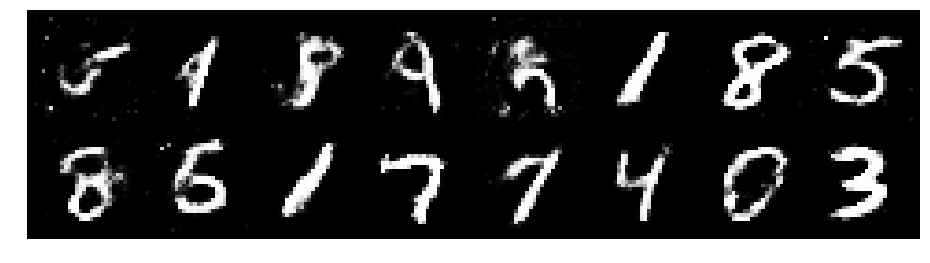

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.2618, Generator Loss: 0.7908
D(x): 0.5639, D(G(z)): 0.4484


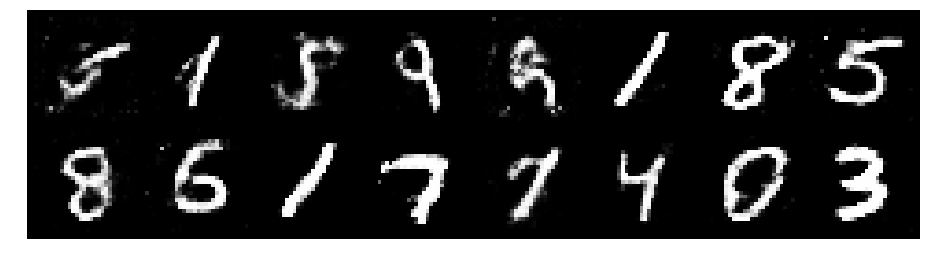

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2981, Generator Loss: 0.8268
D(x): 0.5337, D(G(z)): 0.4598


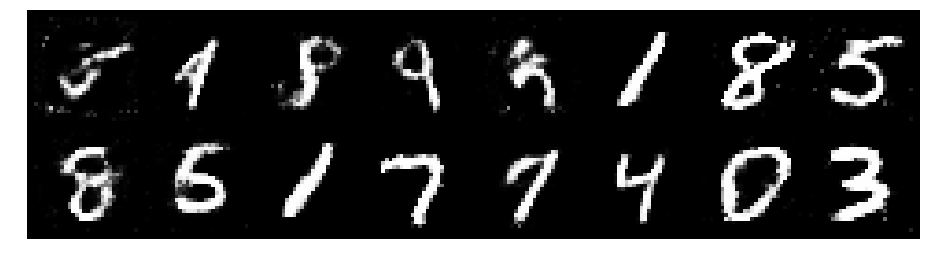

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2305, Generator Loss: 0.8506
D(x): 0.5824, D(G(z)): 0.4605


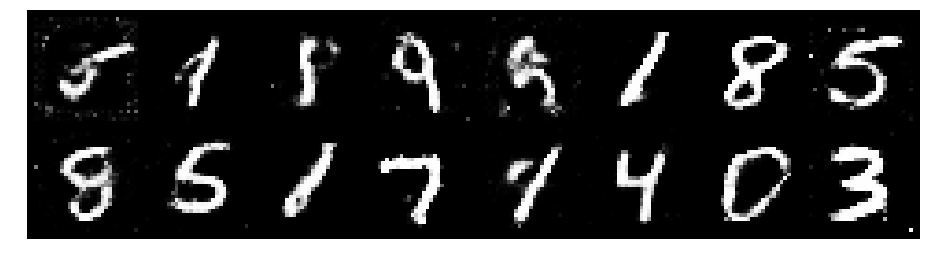

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2261, Generator Loss: 0.9606
D(x): 0.5735, D(G(z)): 0.4360


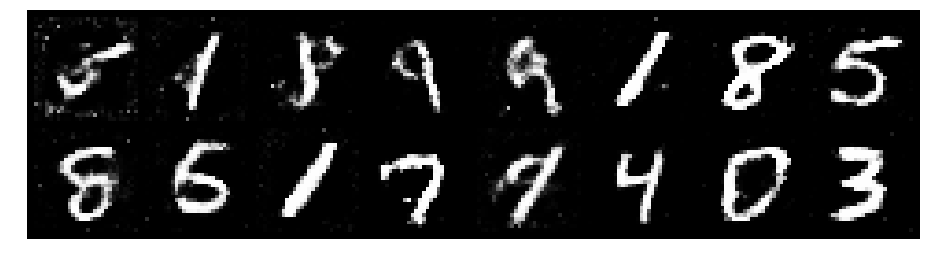

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2685, Generator Loss: 0.9892
D(x): 0.5716, D(G(z)): 0.4444


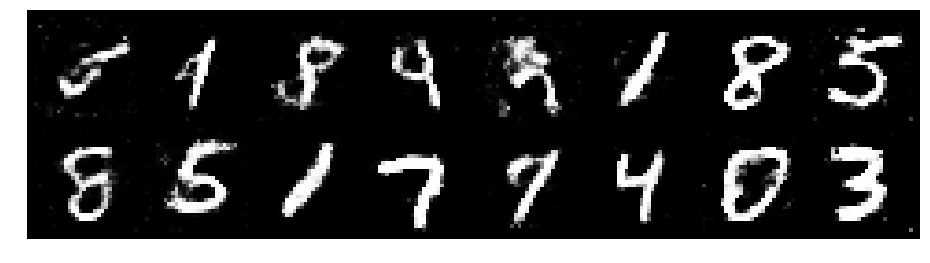

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.2119, Generator Loss: 0.8824
D(x): 0.5339, D(G(z)): 0.4154


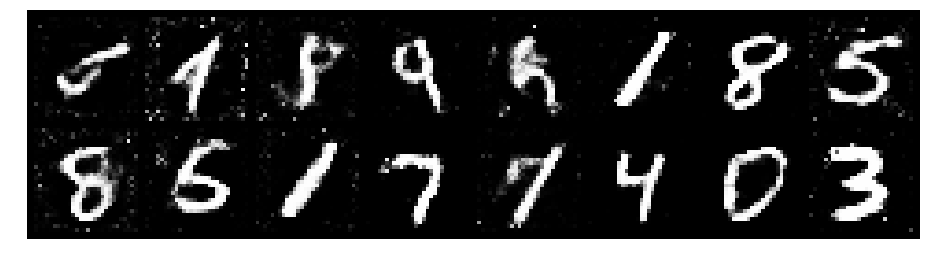

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2905, Generator Loss: 0.8275
D(x): 0.5764, D(G(z)): 0.4709


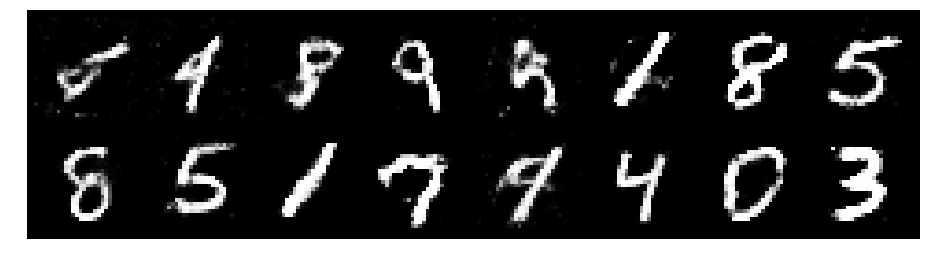

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.3424, Generator Loss: 0.9646
D(x): 0.5201, D(G(z)): 0.4371


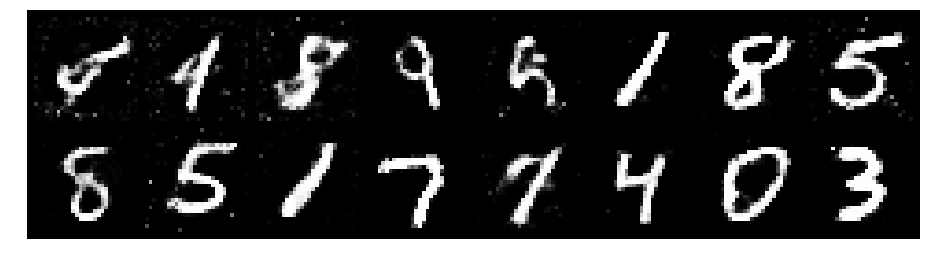

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.1719, Generator Loss: 0.8489
D(x): 0.5881, D(G(z)): 0.4240


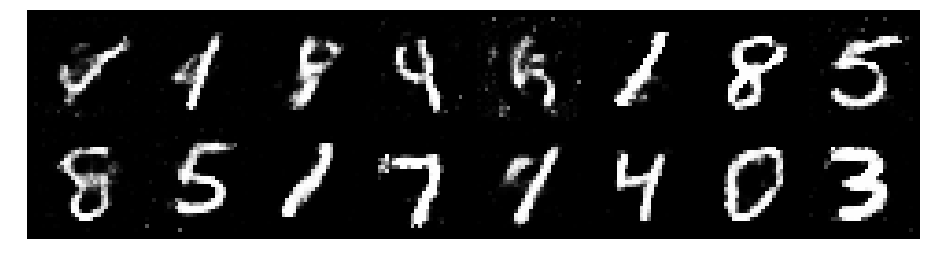

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8797
D(x): 0.5198, D(G(z)): 0.4080


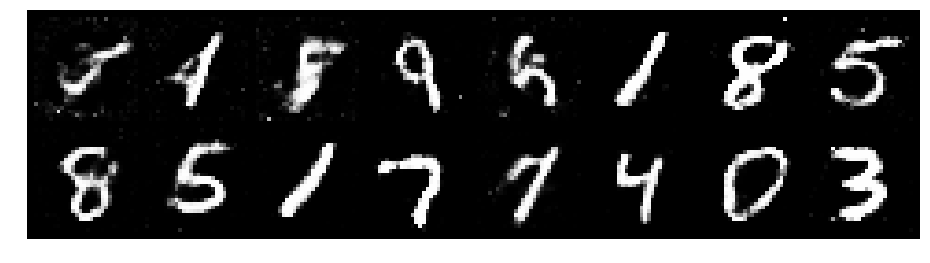

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.3663, Generator Loss: 0.9009
D(x): 0.5438, D(G(z)): 0.4853


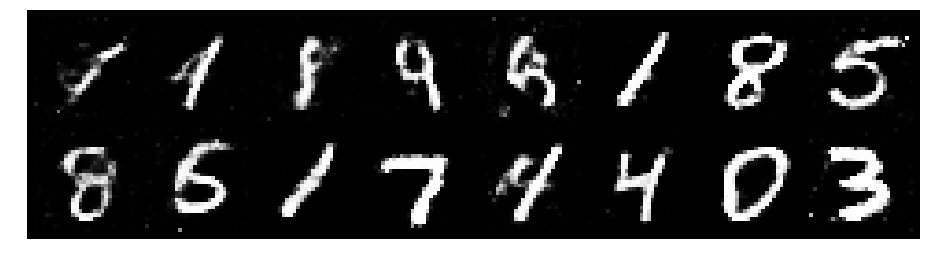

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.1457, Generator Loss: 0.9834
D(x): 0.6104, D(G(z)): 0.4233


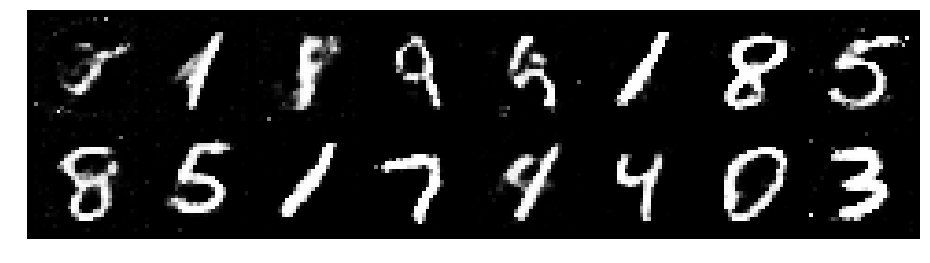

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2393, Generator Loss: 1.0068
D(x): 0.5324, D(G(z)): 0.4093


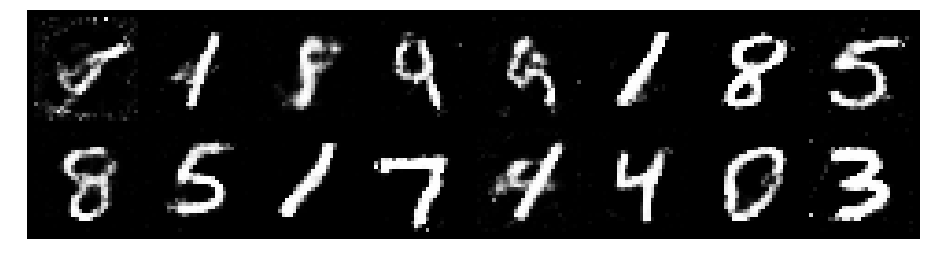

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.1818, Generator Loss: 1.1566
D(x): 0.5750, D(G(z)): 0.3991


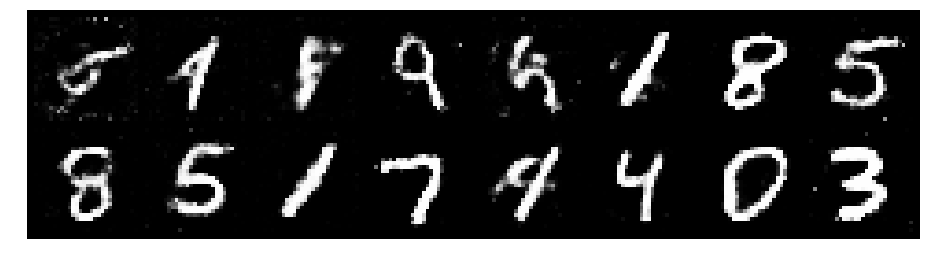

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.2164, Generator Loss: 0.9525
D(x): 0.6012, D(G(z)): 0.4587


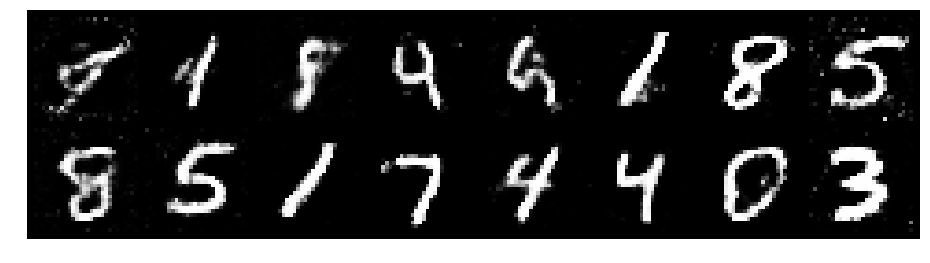

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2918, Generator Loss: 0.9440
D(x): 0.5336, D(G(z)): 0.4289


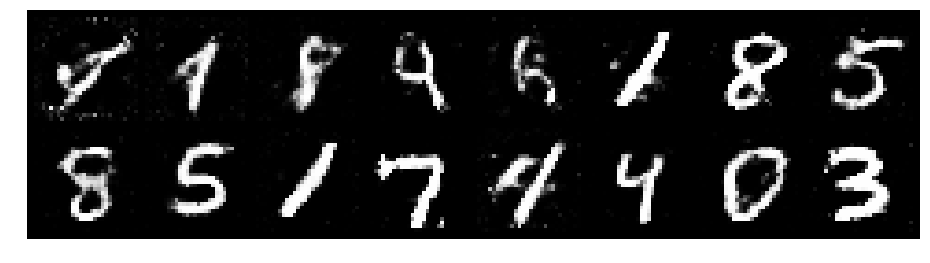

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2587, Generator Loss: 0.9334
D(x): 0.5364, D(G(z)): 0.4251


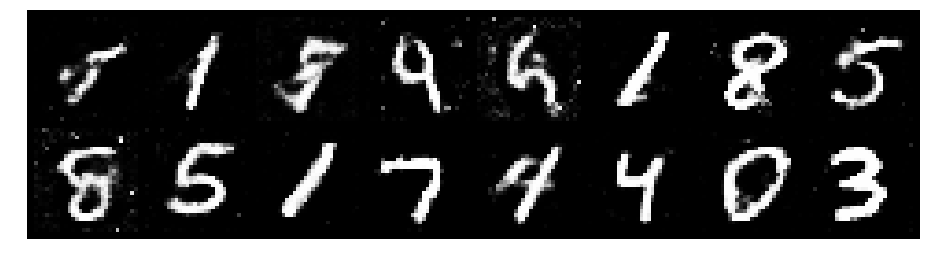

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2248, Generator Loss: 0.9876
D(x): 0.5857, D(G(z)): 0.4357


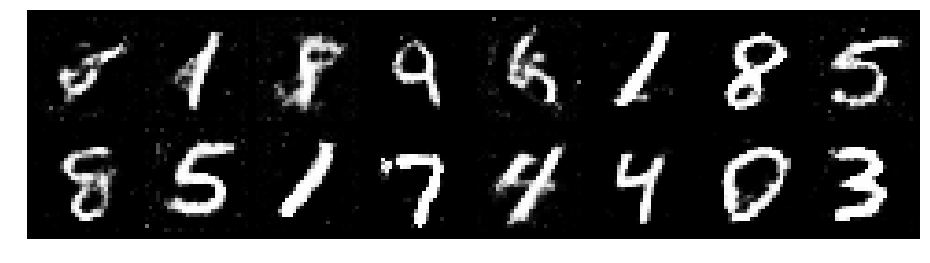

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2452, Generator Loss: 0.9880
D(x): 0.5597, D(G(z)): 0.4162


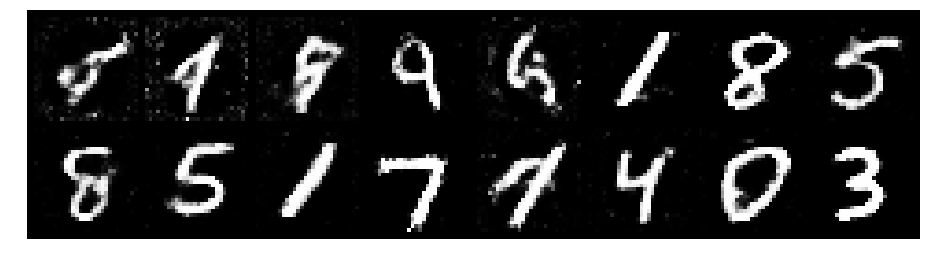

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2632, Generator Loss: 0.8401
D(x): 0.5801, D(G(z)): 0.4695


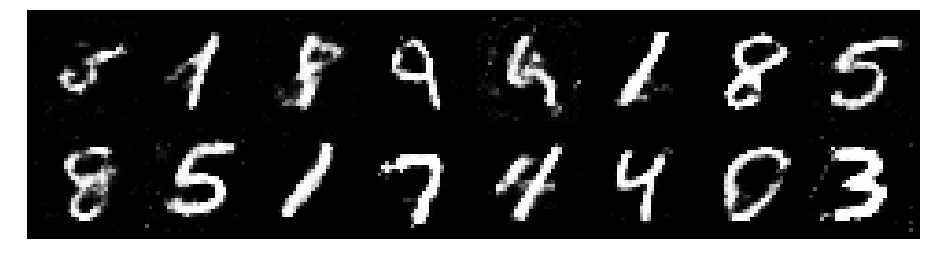

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.3336, Generator Loss: 0.8941
D(x): 0.5188, D(G(z)): 0.4421


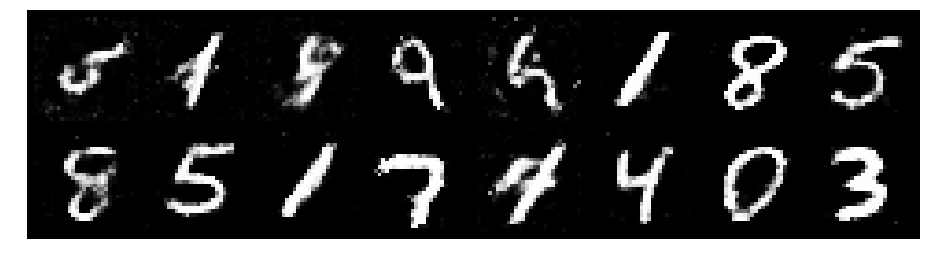

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.3032, Generator Loss: 0.9092
D(x): 0.5435, D(G(z)): 0.4517


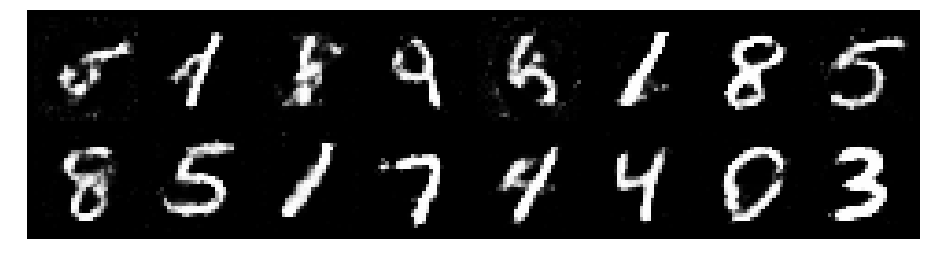

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.1989, Generator Loss: 0.9254
D(x): 0.5729, D(G(z)): 0.4304


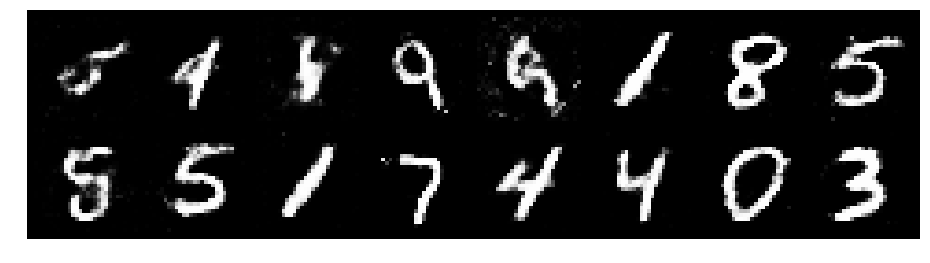

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2130, Generator Loss: 0.9480
D(x): 0.5703, D(G(z)): 0.4304


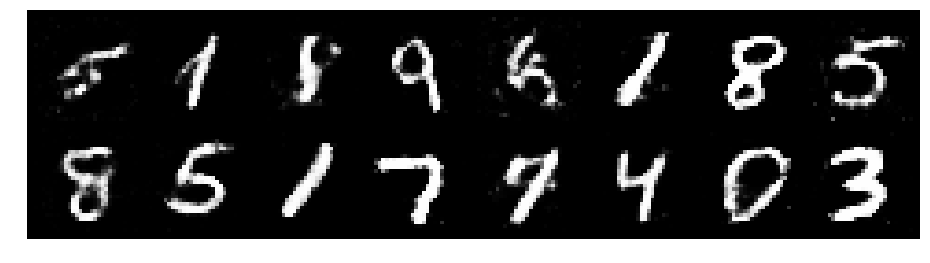

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2382, Generator Loss: 0.8107
D(x): 0.5571, D(G(z)): 0.4352


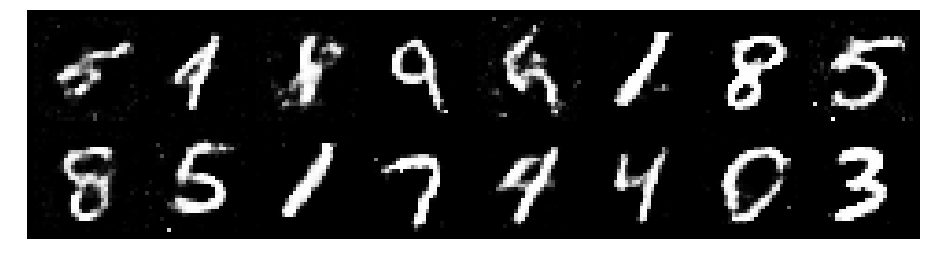

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2816, Generator Loss: 0.9278
D(x): 0.5612, D(G(z)): 0.4413


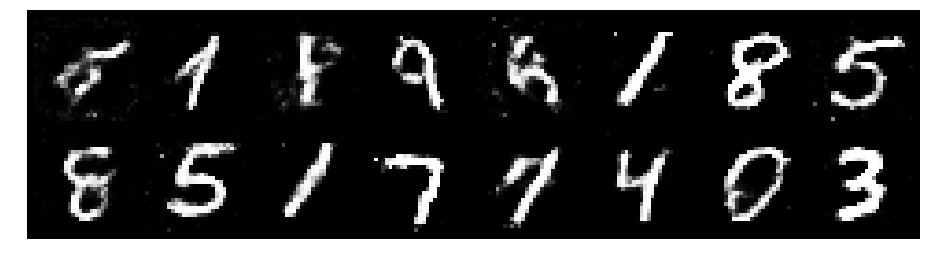

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3557, Generator Loss: 0.8888
D(x): 0.5276, D(G(z)): 0.4428


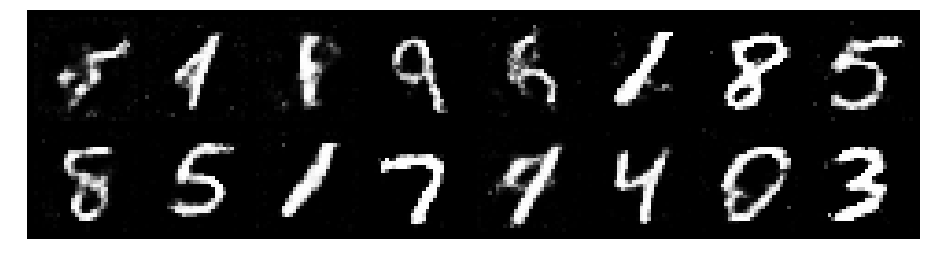

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2621, Generator Loss: 0.7870
D(x): 0.5432, D(G(z)): 0.4400


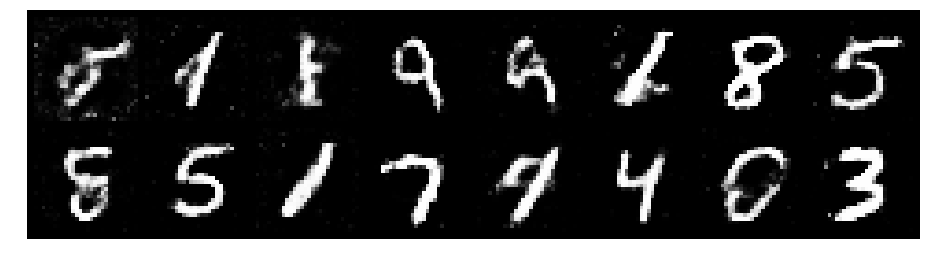

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.3030, Generator Loss: 0.8090
D(x): 0.5466, D(G(z)): 0.4592


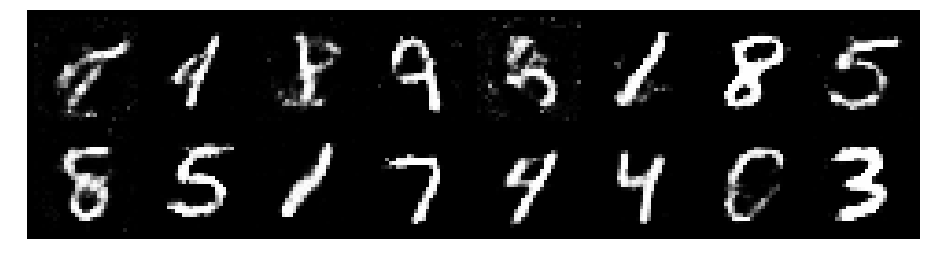

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.3436, Generator Loss: 0.7377
D(x): 0.5253, D(G(z)): 0.4845


In [59]:
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )
